In [1]:
import numpy as np
import sciris as sc
import random
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse
import pandas as pd
from scipy.linalg import lu, inv
from scipy.integrate import odeint, ODEintWarning
from scipy.interpolate import PchipInterpolator
import warnings
import seaborn as sns
from dataclasses import dataclass
from pyDOE import lhs

## Parameter Definitions and Initialization

Define and initialize the parameters for the agent-based model. Includes initial states, transition probabilities, and other parameters related to menstrual hygiene, sexual practices, birth control methods, antibiotic use, and menstrual cycle length.

In [2]:
@dataclass
class Par:
    data: dict

    def to_dict(self):
        return self.data

    def __repr__(self):
        return str(self.data)

#### Function to generate community compositions using both bayesian likelihood of specific bacterial dominance and Dirichlet distribution
Also include the absolute abundance of each bacteria based on the initial relative abundance proportions and total biomass of 1000

In [3]:
def generate_random_composition(bacteria_types, initial_biomass=1000, min_abundance=100):
    dominance_likelihoods = {
        'oLB': 0.10,
        'Li': 0.35,
        'nAB': 0.55,
    }

    # Ensure initial biomass is sufficient to meet minimum requirement for all bacteria
    total_min_abundance = min_abundance * len(bacteria_types)
    if initial_biomass < total_min_abundance:
        raise ValueError("Initial biomass is too low to meet the minimum abundance requirement for all bacteria.")

    # Choose a dominant bacterium based on likelihoods
    dominant_bacterium = np.random.choice(bacteria_types, p=[dominance_likelihoods[bt] for bt in bacteria_types])

    # Randomly assign a dominant proportion of remaining biomass
    dominant_proportion = np.random.uniform(0.6, 0.8)
    remaining_proportion = 1.0 - dominant_proportion

    # Allocate minimum abundance to each bacterium
    initial_allocations = {bt: min_abundance for bt in bacteria_types}
    remaining_biomass = initial_biomass - sum(initial_allocations.values())

    # Distribute remaining proportion among other bacteria
    other_bacteria = [bt for bt in bacteria_types if bt != dominant_bacterium]
    other_proportions = np.random.dirichlet(np.ones(len(other_bacteria))) * remaining_proportion

    # Adjust proportions to include minimum abundance
    proportions = {bt: initial_allocations[bt] / initial_biomass for bt in bacteria_types}
    proportions.update({bt: proportions[bt] + (prop * remaining_biomass / initial_biomass) for bt, prop in zip(other_bacteria, other_proportions)})
    proportions[dominant_bacterium] = (initial_allocations[dominant_bacterium] + (dominant_proportion * remaining_biomass)) / initial_biomass

    # Calculate absolute abundance
    absolute_abundance = {bt: proportions[bt] * initial_biomass for bt in bacteria_types}

    return proportions, absolute_abundance

#### Generate a random composition based on a selected CST

In [4]:
def generate_composition_from_CST(CST, bacteria_types, initial_biomass=1000):
    # Mapping CST to the dominant bacterium
    dominant_mapping = {
        'CST I': 'oLB',
        'CST III': 'Li',
        'CST IV': 'nAB',
    }

    # Validate CST
    if CST not in dominant_mapping:
        raise ValueError(f"Unknown CST: {CST}. Expected one of {list(dominant_mapping.keys())}.")

    dominant_bacterium = dominant_mapping[CST]

    # Ensure dominant bacterium exists in bacteria_types
    if dominant_bacterium not in bacteria_types:
        raise ValueError(f"Dominant bacterium '{dominant_bacterium}' not found in bacteria_types.")

    # Determine dominant bacterium's proportion
    dominant_proportion = np.random.uniform(0.6, 0.9)
    remaining_proportion = 1.0 - dominant_proportion

    # Generate random proportions for remaining bacteria
    other_bacteria = [bt for bt in bacteria_types if bt != dominant_bacterium]
    other_proportions = np.random.dirichlet(np.ones(len(other_bacteria))) * remaining_proportion

    # Create proportions dictionary
    proportions = {bt: float(prop) for bt, prop in zip(other_bacteria, other_proportions)}
    proportions[dominant_bacterium] = dominant_proportion

    # Calculate absolute abundance based on initial biomass
    absolute_abundance = {bt: proportions[bt] * initial_biomass for bt in bacteria_types}

    return proportions, absolute_abundance

#### External agent characteristics of interst

In [5]:
external_parameters_distribution = sc.objdict(
    menstrual_hygiene = sc.objdict(
        products = Par(data={'cup': 0.05, 'single_use': 0.4, 'reusable_homemade': 0.35, 'reusable_manufactured': 0.2}),  # could be adjusted for urbanicity/SES
        # Weighted likelihoods: if you use a reusable homemade product higher likelihood you have poor WASH access and are prone to overuse
        WASH = sc.objdict(
            cup = Par(data={'good': 0.6, 'medium': 0.3, 'poor': 0.1}),
            single_use = Par(data={'good': 0.7, 'medium': 0.2, 'poor': 0.1}),
            reusable_homemade = Par(data={'good': 0.1, 'medium': 0.3, 'poor': 0.6}),  # Higher likelihood of poor WASH access
            reusable_manufactured = Par(data={'good': 0.4, 'medium': 0.3, 'poor': 0.3})
        ),
        # normal = appropriate change rate, over = uLile to change at appropriate rate
        use = sc.objdict(
            cup = Par(data={'normal': 0.6, 'over': 0.4}),
            single_use = Par(data={'normal': 0.7, 'over': 0.3}),
            reusable_homemade = Par(data={'normal': 0.3, 'over': 0.7}),  # Higher likelihood of overuse
            reusable_manufactured = Par(data={'normal': 0.6, 'over': 0.4})
        ),
        # Borzutzky & Jaffray, 2019 2. CDC – Heavy Menstrual Bleeding 3. O'Brien et al., 2019; Vo et al., 2013 4. Sinharoy et al. 2024
        flow = Par(data={'light': 0.25, 'medium': 0.25, 'heavy': 0.5})
    ),
    sex_practices = sc.objdict(
        condom_use = Par(data={'yes': 0.39, 'no': 0.61}),
        circumcision_status = Par(data={'yes': 0.49, 'no': 0.51}),
    ),
    birth_control = Par(data={'iud': 0.1, 'DEPO': 0.2, 'pill': 0.15, 'condom': 0.25, 'none': 0.3}),  # rough estimates
    antibiotics = Par(data={'yes': 0.1}),  # Probability of taking antibiotics
    bacteria_types = ['nAB', 'Li', 'oLB']
)

#### Function to choose agent characteristics based on probabilities distribution

In [6]:
def choose(par):
    if isinstance(par, Par):
        par = par.to_dict()  # Convert Par object to dictionary if necessary with nested wash/use parameters

    a, p = zip(*par.items())  # Unpack keys and values
    p = np.array(p, dtype=float)
    p /= p.sum()  # Normalize to sum to 1

    if not np.isclose(p.sum(), 1.0):
        raise ValueError(f'Probabilities for {a} do not sum to 1: {p.sum()}')

    return np.random.choice(a, p=p)

## Penile Microbiome:
- circumcision reduces HIV risk by 50% in heterosexual men (https://www.cochranelibrary.com/cdsr/doi/10.1002/14651858.CD003362.pub2/full)
- uncircumcised = higher bacterial load, higher presence of anaerobes; circumcised = lower bacterial load, high presence of skin associated bacteria (ex corynebacteria and staphylococci) (https://journals.asm.org/doi/10.1128/mbio.00076-13)
- BASIC bacteria: P. bivia, P. disiens, Peptostreptococcus anaerobius, Dialister micraerophilus, Dialister 
propionicifacien, Dialister
succinatiphilu (https://doi.org/10.1172/jci.insight.147363)
- BASIC bacterial abundance associated with: inc. tissue density of CD4+ T cells, inc. IL-8 (chemoattractant cytokine), inc. IL-a/B (pro-inflammatory cytokine), inc. soluble E-cadeherin (epithelial disruption)  (https://doi.org/10.1111/aji.13674.)
- Topical clyndamycin significantly reduces BASIC abundance; Topical metronidazole reduces local immune impact being uncircumcised (https://doi.org/10.1016/j.xcrm.2024.101705))s)

In [7]:
def calculate_penile_abundance(agent):
    abundance = 100 # about 1/10 to 1/100 of VMB absolute abundance based on brief lit search

    # Adjust absolute abundance based on circumcision status
    if agent.circumcision_status == 'no':
        abundance *= 1.5  # Increase if uncircumcised

    # Adjust abundance based on WASH status
    wash_multiplier = {
        'poor': 1.5,  # Further increase if hygiene is poor
        'medium': 1.2,  # Moderate increase if hygiene is medium
        'good': 1.0  # No change if hygiene is good
    }
    abundance *= wash_multiplier.get(agent.WASH, 1.0)  # Default to 1.0 if WASH is not recognized
    #print(f"Penile abundance: {abundance}")
    return abundance

In [68]:
# From original LHS fRom Lee https://doi.org/10.1371/journal.pcbi.1011295
def generate_interaction_param():
    interaction_params = [
        np.random.uniform(0.1, 1),  # Growth rate of non-optimal bacteria (nAB)
        np.random.uniform(0.1, 1),  # Growth rate of Lactobacillus iners (Li)
        np.random.uniform(0.1, 1),  # Growth rate of Lactobacillus crispatus (oLB)
        np.random.uniform(-0.04, -0.004),  # Self-interaction of nAB (how it affects itself)
        np.random.uniform(-0.12, 0.12),    # Interaction of nAB on Li (how nAB affects Li)
        np.random.uniform(-0.12, 0.0),    # Interaction of nAB on oLB (how nAB affects oLB)
        np.random.uniform(-0.12, 0.12),    # Interaction of Li on nAB (how Li affects nAB)
        np.random.uniform(-0.04, -0.004),    # Self-interaction of Li (how Li affects itself) # changed to match the other self interaction terms
        np.random.uniform(-0.12, 0.12),    # Interaction of Li on oLB (how Li affects oLB)
        np.random.uniform(-0.12, 0.00),    # Interaction of oLB on nAB (how oLB affects nAB)
        np.random.uniform(-0.12, 0.12),    # Interaction of oLB on Li (how oLB affects Li)
        np.random.uniform(-0.04, -0.004)   # Self-interaction of oLB (how oLB affects itself)
    ]
    #print(f"Generated interaction parameters: {interaction_params}")  # print out interaction parameters
    return interaction_params

## Defining Rate Agent Class, Rates Adjustments

In [9]:
# Remove x values that are not increasing and corresponding y values
# Because of dynamic cycle eval points that are adjusted based on agent specific menstrual cycle, sometimes cycle eval points are not increasing
def remove_non_increasing_points(x, y):
    increasing_indices = np.where(np.diff(x) > 0)[0] + 1  # Identify strictly increasing points
    increasing_indices = np.insert(increasing_indices, 0, 0)  # Include the first point
    
    x_filtered = np.array(x)[increasing_indices]
    y_filtered = np.array(y)[increasing_indices]

    return x_filtered, y_filtered

In [10]:
class Agent:
    def __init__(self, external_parameters_distribution,
                 bacteria_types=None, 
                 CST=None, 
                 products='random', 
                 WASH='random', 
                 use='random', 
                 flow=None, 
                 condom_use='random', 
                 circumcision_status='random', 
                 birth_control='random', 
                 sexually_active='random', 
                 has_menstrual_cycle=True,
                 generate_interaction_params=True):
        self.external_parameters_distribution = external_parameters_distribution
        self.has_menstrual_cycle = has_menstrual_cycle
        self.menstruation_phase = None

        # Initialize interaction parameters
        self.interaction_params = generate_interaction_param() if generate_interaction_params else None

        # Initialize bacterial proportions and absolute abundance
        if CST:
            self.proportions, self.absolute_abundance = generate_composition_from_CST(CST, external_parameters_distribution['bacteria_types'])
        else:
            self.proportions, self.absolute_abundance = generate_random_composition(external_parameters_distribution['bacteria_types'])
            self.CST = self.assign_CST() 

        # Assign characteristics using the provided distributions or randomly
        self.products = self.assign_characteristic(products, external_parameters_distribution['menstrual_hygiene'].products.to_dict(), allow_none=True)
        self.WASH = self.assign_characteristic(WASH, external_parameters_distribution['menstrual_hygiene'].WASH[self.products].to_dict(), allow_none=True)
        self.use = self.assign_characteristic(use, external_parameters_distribution['menstrual_hygiene'].use[self.products].to_dict(), allow_none=True)
        self.flow = self.assign_characteristic(flow, external_parameters_distribution['menstrual_hygiene'].flow.to_dict(), allow_none=True)
        self.condom_use = self.assign_characteristic(condom_use, external_parameters_distribution['sex_practices'].condom_use.to_dict(), allow_none=True)
        self.circumcision_status = self.assign_characteristic(circumcision_status, external_parameters_distribution['sex_practices'].circumcision_status.to_dict(), allow_none=True)
        self.birth_control = self.assign_characteristic(birth_control, external_parameters_distribution['birth_control'].to_dict(), allow_none=True)
        self.sexually_active = self.assign_characteristic(sexually_active, {'yes': 0.8, 'no': 0.2}) if sexually_active == 'random' else sexually_active
        
        # Calculate penile abundance based on circumcision and WASH status
        self.penile_abundance = calculate_penile_abundance(self)
        
        # Initialize menstrual cycle and related events
        self.menstrual_day = 1
        self.menstruation_duration = random.randint(2, 7)
        self.ovulation_duration = 1

        # Ensure total cycle length is between 22 and 35 days
        min_total_cycle_length = 22
        max_total_cycle_length = 35
        min_remaining_days = min_total_cycle_length - (self.menstruation_duration + self.ovulation_duration)
        max_remaining_days = max_total_cycle_length - (self.menstruation_duration + self.ovulation_duration)

        # Assign days to follicular and luteal phases
        self.follicular_duration = random.randint(11, min(27, max_remaining_days - 11))
        self.luteal_duration = max_remaining_days - self.follicular_duration

        # Calculate total cycle length
        self.cycle_length = self.menstruation_duration + self.follicular_duration + self.ovulation_duration + self.luteal_duration

        # Initialize hormone levels
        self.estrogen_level = 0
        self.progesterone_level = 0
        
        # Precompute hormone levels for entire cycle
        self.precompute_hormone_levels()

        # Compute pH levels for entire cycle
        #self.vaginal_pH = 0
        self.precompute_vaginal_pH()

        self.sexual_events = self.generate_sexual_events()
        self.last_antibiotic_day = -15

    # Debugging: print cycle durations
    #print(f'Menstruation duration: {self.menstruation_duration}, Follicular duration: {self.follicular_duration}, Luteal duration: {self.luteal_duration}')

    def assign_characteristic(self, characteristic, distribution, allow_none=False):
        if characteristic == 'random':
            return np.random.choice(list(distribution.keys()), p=list(distribution.values()))
        if characteristic is None and allow_none:
            return None
        return characteristic

    def precompute_hormone_levels(self):
        # Define more key points in the cycle for better accuracy, including extra points for estrogen and progesterone
        cycle_eval_points = [
            1,  # Start of menstruation
            self.menstruation_duration,  # End of menstruation (Days 5-7)
            self.menstruation_duration + (self.follicular_duration / 6),  # Extra low point before estrogen climb
            self.menstruation_duration + (self.follicular_duration / 3),  # Extra point before estrogen climb
            self.menstruation_duration + (self.follicular_duration / 2),  # Mid-follicular phase
            self.menstruation_duration + self.follicular_duration - 1,  # End of follicular phase, just before ovulation
            self.menstruation_duration + self.follicular_duration + self.ovulation_duration,  # Ovulation
            self.menstruation_duration + self.follicular_duration + self.ovulation_duration + (self.luteal_duration / 6),  # Early luteal
            self.menstruation_duration + self.follicular_duration + self.ovulation_duration + (self.luteal_duration / 3),  # Mid-luteal (plateau start)
            self.menstruation_duration + self.follicular_duration + self.ovulation_duration + (self.luteal_duration / 2),  # Plateau 
            self.cycle_length  # End of luteal (End of cycle)
        ]
    
        # Fine-tune estrogen values based on lit search (dg/mL)
        estrogen_values = [
            2.0,   # Low during menstruation
            2.0,   # Low at end of menstruation
            2.0,   # Extra low point before the climb
            5.0,   # Extra point before the climb
            15.0,  # Late follicular (steep rise) peak
            35.0,  # Decline start ovulation
            10.0,  # Decline after ovulation
            10.0,  # Early luteal
            15.0,  # Mid-luteal decline
            15.0,   # Late luteal decline
            2.0    # End of luteal phase (back to low)
        ]

        # Fine-tune estrogen values based on lit search (ng/mL)       
        progesterone_values = [
            0.1,  # Low during menstruation and follicular
            0.1,  # Low end of menstruation
            0.1,  # Early follicular (remains low)
            0.1,  # Mid-follicular (still low)
            3.0,  # Ovulation
            5.0, # Early luteal sharp rise
            5.0, # Mid-luteal peak
            10.0, # Plateau at peak in luteal
            18.0, # Plateau at peak in luteal 
            18.0,  # Late luteal decline
            1.8   # End of luteal phase sharp drop
        ]

        # Ensure cycle_eval_points is strictly increasing
        cycle_eval_points, estrogen_values = remove_non_increasing_points(cycle_eval_points, estrogen_values)
        cycle_eval_points, progesterone_values = remove_non_increasing_points(cycle_eval_points, progesterone_values)
        
        # Use smoother curves
        estrogen_spline = PchipInterpolator(cycle_eval_points, estrogen_values)
        progesterone_spline = PchipInterpolator(cycle_eval_points, progesterone_values)

        self.days_full = np.arange(0, self.cycle_length)
        self.estrogen_levels = estrogen_spline(self.days_full)
        self.progesterone_levels = progesterone_spline(self.days_full)
    
        # Ensure no negative progesterone values
        self.progesterone_levels = np.clip(self.progesterone_levels, 0, None)

    def get_hormone_levels_for_day(self):
        # Retrieve the estrogen and progesterone levels for the current menstrual day directly.
        self.estrogen_level = self.estrogen_levels[self.menstrual_day - 1]
        self.progesterone_level = self.progesterone_levels[self.menstrual_day - 1]
        return self.estrogen_level, self.progesterone_level

    def precompute_vaginal_pH(self):
        # Define key points in the cycle based on the agent's menstrual phase durations
        cycle_eval_points = [
            1,  # Start of menstruation
            self.menstruation_duration / 2,  # mid menstruation peak
            self.menstruation_duration, # End of menstruation
            self.menstruation_duration + 1, # Beginning of follicular large drop
            self.menstruation_duration + (self.follicular_duration / 2),  # Extra point mid-follicular
            self.menstruation_duration + self.follicular_duration,  # Follicular
            self.menstruation_duration + self.follicular_duration + self.ovulation_duration,  # Ovulation 
            self.menstruation_duration + self.follicular_duration + self.ovulation_duration + (self.luteal_duration / 2),  # Mid-luteal 
            self.cycle_length  # End of luteal (End of cycle)
        ]

        # Define the corresponding vaginal pH values for these key points in the cycle
        pH_values = [
            6,  # High pH at the start of menstruation
            6.8,  # Peak pH mid menstruation
            5.5,  # Lowering pH by the end of menstruation
            4.4,  # Stable low pH in beginning of follicular phase
            4.0, # Stable low pH mid-follicular
            4.0,  # Stable low pH end of follicular phase
            3.9, # Stable low pH ovulation
            3.9, #Stable low pH mid-luteal
            3.8,  # Stable low rest of cycle
        ]
    
        # Ensure cycle_eval_points is strictly increasing
        cycle_eval_points, pH_values = remove_non_increasing_points(cycle_eval_points, pH_values)
        
        # Interpolate pH changes using cubic spline
        pH_spline = PchipInterpolator(cycle_eval_points, pH_values)
        
        # Generate smooth pH levels across entire cycle
        self.vaginal_pH = pH_spline(self.days_full)
        
        return self.vaginal_pH

    def get_pH_levels_for_day(self):
        # Retrieve the pH level for current menstrual day directly.
        self.vaginal_pH_day = self.vaginal_pH[self.menstrual_day - 1]
        return self.vaginal_pH_day

    def update_menstrual_phase(self):
        #Update the agent's menstrual phase and hormone levels based on the current day in the cycle.
        if not self.has_menstrual_cycle:
            self.menstruation_phase = 'no cycle'
            self.menstrual_day = 0
            return
            
        if self.menstrual_day < self.menstruation_duration:
            self.menstruation_phase = 'menstruation'
        elif self.menstrual_day < self.menstruation_duration + self.follicular_duration:
            self.menstruation_phase = 'follicular'
        elif self.menstrual_day < self.menstruation_duration + self.follicular_duration + self.ovulation_duration:
            self.menstruation_phase = 'ovulation'
        else:
            self.menstruation_phase = 'luteal'

        # Increment menstrual day
        self.menstrual_day += 1
    
        # Reset menstrual day if it exceeds the cycle length
        if self.menstrual_day > self.cycle_length:
            self.menstrual_day = 1

        # Update hormone levels for the current day
        self.get_hormone_levels_for_day()
        self.get_pH_levels_for_day()

    def generate_sexual_events(self):
        if self.sexually_active:
            num_events = random.randint(4, 15)
            return random.sample(range(1, 29), num_events)
        return []
    def random_sexual_event(self):
        return (self.menstrual_day % 28) in self.sexual_events

    def random_antibiotic_use(self):
        if self.menstrual_day - self.last_antibiotic_day >= 14:
            if random.random() < self.external_parameters_distribution['antibiotics'].to_dict()['yes']:
                self.last_antibiotic_day = self.menstrual_day
                #print(f'Antibiotic used on day {self.menstrual_day}, nAB set to 0.')
                return True
        return False

    def assign_CST(self):
        dominant_bacterium = max(self.proportions, key=self.proportions.get)
        self.CST = {
            'oLB': 'CST I',
            'Li': 'CST III',
            'nAB': 'CST IV',
        }.get(dominant_bacterium, 'Unknown CST')
        return self.CST

    def adjust_rates(self, time_step, external_parameters_distribution):
        adjust_rates(self, time_step, external_parameters_distribution)

    def __str__(self):
        return (f'Agent with CST: {self.CST}\n'
                f'Bacterial Composition: {self.proportions}\n'
                f'Menstrual Products: {self.products}\n'
                f'WASH: {self.WASH}\n'
                f'Use: {self.use}\n'
                f'Flow: {self.flow}\n'
                f'Condom Use: {self.condom_use}\n'
                f'Circumcision Status: {self.circumcision_status}\n'
                f'Birth Control: {self.birth_control}\n'
                f'Sexually Active: {self.sexually_active}\n'
                f'Menstrual Day: {self.menstrual_day}\n'
                f'Sexual Events: {self.sexual_events}\n'
                f'Estrogen Level: {self.estrogen_level}\n'
                f'Progesterone Level: {self.progesterone_level}\n'
                f'Has Menstrual Cycle: {self.has_menstrual_cycle}')
    def print_cycle_durations(self):
        print(f"Menstruation Duration: {self.menstruation_duration} days")
        print(f"Follicular Duration: {self.follicular_duration} days")
        print(f"Ovulation Duration: {self.ovulation_duration} days")
        print(f"Luteal Duration: {self.luteal_duration} days")
        print(f"Total Cycle Length: {self.cycle_length} days")

### Menstrual Cycle Rate adjustments: 
- impact of menses on VMB composition more prominent in women who are not on hormonal BC (https://doi.org/10.1093%2Fhumrep%2Fdeac094)

Estrogen Levels: https://emedicine.medscape.com/article/2089003-overview?form=fpf
Progesterone Levels: https://www.ucsfhealth.org/medical-tests/serum-progesterone; https://www.sciencedirect.com/science/book/9781455727582
25

#### Estrogen impact on Glycogen reserves
https://doi.org/10.1093%2Fhumrep%2Fdeac094
- Estrogen promotes epithelial cell proliferation = increased glycogen storage --> progesterone lyses vaginal epithelial cells = release glycogen
- r = 0.11 p < 0.001 relationship between estrogen and L crispatus/Lactobacillus genus
- COC group does not ovulate and has no large progesterone shifts prior to menstruation, indicating that the dysbiosis is not driven by progesterone dynamics
- estrogen increased biosurfactant production of L crispatus (https://www.ncbi.nlm.nih.gov/pmc/articles/PMC8010061/)

#### Progesterone impact on mucin
- Progesterone-treated mice showed significantly more mucin staining on the surface of the vaginal epithelium compared to other groups (https://www.ncbi.nlm.nih.gov/pmc/articles/PMC10753781/)
- Mucin is a common nutrient source for G. vaginalis (https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3636892/)
- Mucin is a preferred carbon source of L. iners (https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3448655/) (https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3063587/)
- Sialidase positive bacteria, such as Gardnerella vaginalis or Prevotella bivia, are able to catabolize sialic acid in the cervicovaginal mucins

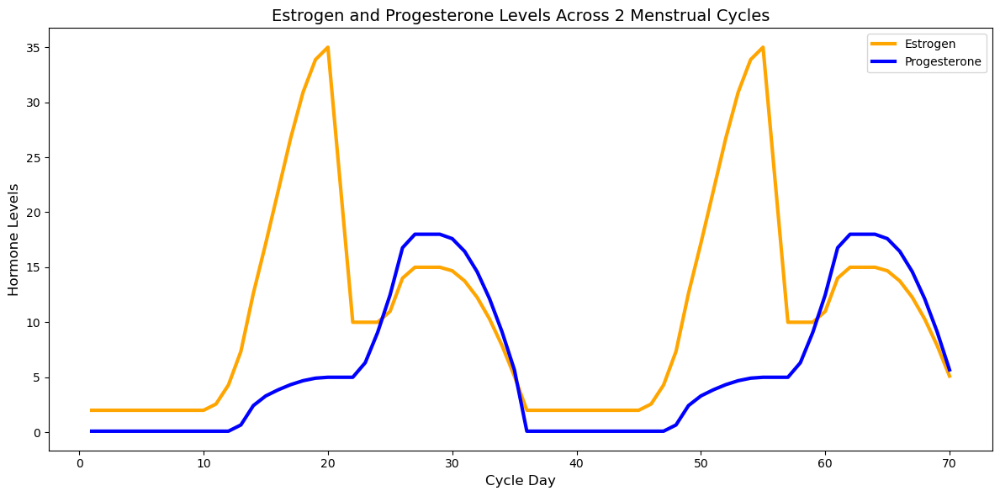

In [11]:
def plot_hormone_levels(agent, num_cycles):
    # Retrieve precomputed estrogen and progesterone levels for one cycle
    estrogen_levels_single_cycle = agent.estrogen_levels
    progesterone_levels_single_cycle = agent.progesterone_levels
    
    # Repeat the hormone levels across the number of cycles
    estrogen_levels = np.tile(estrogen_levels_single_cycle, num_cycles)
    progesterone_levels = np.tile(progesterone_levels_single_cycle, num_cycles)
    
    # Calculate the total number of days across all cycles
    total_days = agent.cycle_length * num_cycles
    cycle_eval_points = np.arange(1, total_days + 1)
    
    plt.figure(figsize=(12, 6))

    # Plot estrogen and progesterone levels
    plt.plot(cycle_eval_points, estrogen_levels, label='Estrogen', color='orange', linewidth=3)
    plt.plot(cycle_eval_points, progesterone_levels, label='Progesterone', color='blue', linewidth=3)

    plt.xlabel('Cycle Day', fontsize=12)
    plt.ylabel('Hormone Levels', fontsize=12)
    plt.title(f'Estrogen and Progesterone Levels Across {num_cycles} Menstrual Cycles', fontsize=14)
    plt.legend()

    plt.tight_layout()
    plt.show()

agent = Agent(external_parameters_distribution)

plot_hormone_levels(agent, num_cycles=2)

### pH changes throughout menstrual cycle
- Nugent score and vaginal pH were similar in FOL and LUT phases among healthy women (https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4892231/)
- The mean vaginal pH ( ± SE) was significantly higher on day 2 (6.6 ± 0.3) compared with day 4 (5.3 ± 0.3) and day 14 (4.2 ± 0.2). (https://www.acpjournals.org/doi/10.7326/0003-4819-96-6-921?url_ver=Z39.88-2003&rfr_id=ori:rid:crossref.org&rfr_dat=cr_pub%20%200pubmed)
- Relationship between pH and bacterial abundance fig 3: https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7078941/

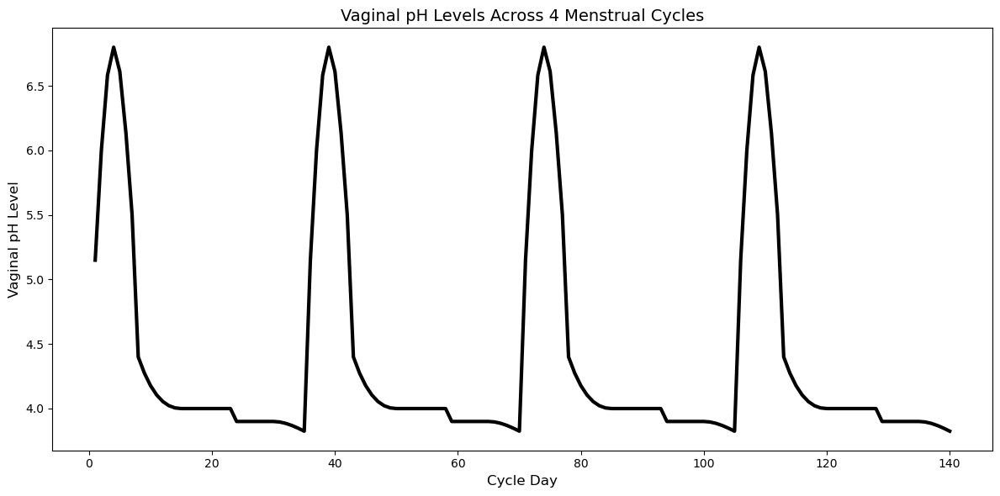

In [12]:
def plot_vaginal_pH(agent, num_cycles):
    # Retrieve precomputed vaginal pH levels for one cycle
    pH_levels_single_cycle = agent.vaginal_pH
    
    # Repeat the pH levels across the number of cycles
    pH_levels = np.tile(pH_levels_single_cycle, num_cycles)
    
    # Calculate the total number of days across all cycles
    total_days = agent.cycle_length * num_cycles
    cycle_eval_points = np.arange(1, total_days + 1)
    
    plt.figure(figsize=(12, 6))

    # Plot vaginal pH levels
    plt.plot(cycle_eval_points, pH_levels, label='Vaginal pH', color='black', linewidth=3)

    plt.xlabel('Cycle Day', fontsize=12)
    plt.ylabel('Vaginal pH Level', fontsize=12)
    plt.title(f'Vaginal pH Levels Across {num_cycles} Menstrual Cycles', fontsize=14)

    plt.tight_layout()
    plt.show()

agent = Agent(external_parameters_distribution)

# Plot vaginal pH levels across 2 menstrual cycles
plot_vaginal_pH(agent, num_cycles=4)

### Adjust rates function to dynamically impact the replication rate of bacteria based on exgenous factors impact

In [13]:
def adjust_rates(agent, time_step, external_parameters_distribution):
    # Extract bacteria types
    bacteria_types = external_parameters_distribution['bacteria_types']
    
    # Get current hormone levels and pH for agent
    estrogen_level, progesterone_level = agent.get_hormone_levels_for_day()
    vaginal_pH = agent.get_pH_levels_for_day()

    # Initialize replication adjustment dictionary
    replication_adjustment = {bacterium: 0 for bacterium in bacteria_types}
    
    # Hormone effects on bacterial growth
    # Positive correlation between estrogen and oLB (Lactobacillus crispatus) --> r value from Danish paper
    replication_adjustment['oLB'] = 0.11 * (estrogen_level - np.mean(agent.estrogen_levels)) / np.std(agent.estrogen_levels)

    # Progesterone impacts mucin production, which affects nAB and Li growth rates
    progesterone_scaling_factor = 0.05 * (progesterone_level - np.mean(agent.progesterone_levels)) / np.std(agent.progesterone_levels)
    replication_adjustment['nAB'] = progesterone_scaling_factor
    replication_adjustment['Li'] = progesterone_scaling_factor
    
    # pH impact on bacterial growth rates based on Spearman correlations
    # Lactobacillus crispatus (oLB) negatively correlated with pH (-0.307)
    replication_adjustment['oLB'] += -0.307 * (vaginal_pH - 4.0)
    
    # Non-Lactobacillus bacteria (Prevotella/Gardnerella - nAB) positively correlated with pH (0.274 and 0.272)
    replication_adjustment['nAB'] += 0.273 * (vaginal_pH - 4.0)

    # Max growth rate cap
    max_growth_rate = 2.5

    for i, bacterium in enumerate(['nAB', 'Li', 'oLB']):
        if isinstance(agent.interaction_params[i], np.ndarray):
            interaction_param = agent.interaction_params[i].item()
        else:
            interaction_param = agent.interaction_params[i]
        
        # Adjust growth rates by interaction params and replication adjustments from hormones and pH
        adjusted_growth_rate = interaction_param + replication_adjustment[bacterium]
        
        # Apply min() and max() to values
        agent.interaction_params[i] = min(max(adjusted_growth_rate, 0), max_growth_rate)

    return agent.interaction_params

### Running and viewing the gLV model

In [14]:
def sim_continuous(X0, t_span, agent, time_step=1):
    if np.isscalar(t_span):
        t_span = [0, t_span]

    def lotka_volterra(x, t):
        # Update interaction parameters dynamically
        interaction_matrix = np.array(agent.interaction_params[3:]).reshape(3, 3)
        adjusted_r = np.array(agent.interaction_params[:3])  # Only the first 3 for 3 species

        # Inversely scale the interaction matrix by the initial total biomass of the agent
        total_biomass = np.sum(X0)
        scaled_interaction_matrix = interaction_matrix / total_biomass
        
        return (adjusted_r * x) + np.dot(scaled_interaction_matrix, x) * x

    times = []
    results = []
    current_time = t_span[0]
    current_state = X0

    while current_time < t_span[1]:
        # Update the agent's menstrual phase
        agent.update_menstrual_phase()

        # External factors impact the abundance directly (before applying gLV dynamics)
        nAB, Li, oLB = current_state

        '''
        # Apply reduction in oLB only on the first day of menstruation
        if agent.menstruation_phase == 'menstruation' and agent.menstrual_day == 1:
            oLB *= 0.5  # Halve oLB abundance on the first day of menstruation

        if agent.random_antibiotic_use():
            nAB *= 0.05  # Drastic reduction in nAB due to antibiotic use

        # Sexual events introduce nAB biomass directly
        if agent.random_sexual_event():
            transfer_factor = 0.2 if agent.condom_use == 'no' else 0.1
            nAB += agent.penile_abundance * transfer_factor
        '''

        # Update the state after the direct modifications
        current_state = np.array([nAB, Li, oLB])
        
        # Simulate over one time step
        t_eval = [current_time, current_time + time_step]
        sol, infodict = odeint(lotka_volterra, current_state, t_eval, hmax=1e-3, full_output=1)  # hmax limits maximum step size
        '''
        # Debugging: Check for issues with the solver
        if infodict['message'] != 'Integration successful.':
            print(f"Integration issue at time {current_time}: {infodict['message']}")
        '''
        # Adjust growth rates and interaction parameters based on current physiology
        # Assumption there is delayed impact on growth instead of immediate
        agent.adjust_rates(time_step, agent.external_parameters_distribution)
        
        # Update time and state
        current_time += time_step
        current_state = sol[-1]  # Last row of the solution = updated state
        
        # Store results
        times.extend(t_eval)
        results.extend(sol)

    return np.array(times), np.array(results).T

In [15]:
def plot_basic(T, X, ax, title=None, **kwargs):
    species_labels = ['nAB', 'Li', 'oLB']  # Labels for the three species
    ax.set_prop_cycle(None)  # Reset color cycle
    for i, label in enumerate(species_labels):
        ax.plot(T, X[i], label=label, **kwargs)
    ax.set_xlabel('Time')
    ax.set_ylabel('Abundance')
    ax.set_title(title)
    ax.legend() 

Generated interaction parameters: [0.386335601524866, 0.5948805411277993, 0.8048508029332693, -0.02375106203460147, -0.03885691799225449, -0.09599672099041515, -0.09950496609691592, -0.013506575342048095, -0.026382553785462753, -0.0028260169394942053, 0.06624214480711499, -0.03698845105544466]


C:\Users\lilliandi\AppData\Local\Temp\ipykernel_8924\3137925064.py:47: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  sol, infodict = odeint(lotka_volterra, current_state, t_eval, hmax=1e-3, full_output=1)  # hmax limits maximum step size


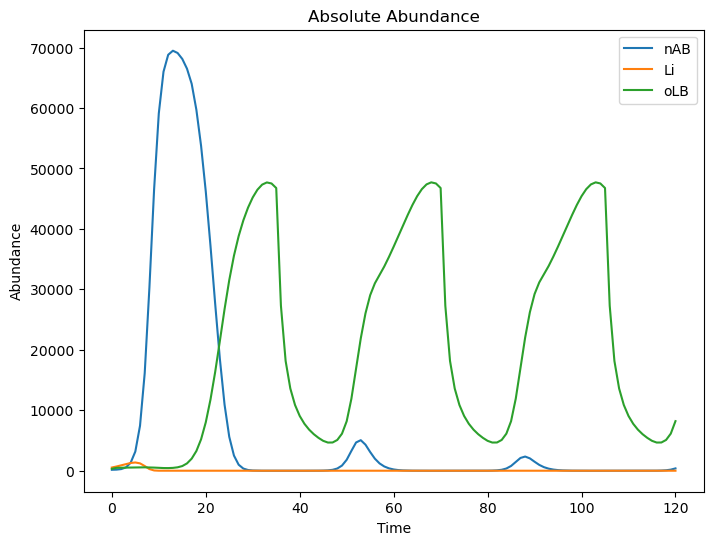

In [65]:
# Initialize agent
agent = Agent(external_parameters_distribution)

# Extract initial abundances from agent's absolute abundance dictionary
X0 = np.array([agent.absolute_abundance[species] for species in ['nAB', 'Li', 'oLB']])

# Simulate
T, X = sim_continuous(X0, t_span=120, agent=agent)

# Plot absolute abundance results
fig, ax = plt.subplots(figsize=(8, 6))
plot_basic(T, X, ax, title='Absolute Abundance')

plt.show()

### Plotting Relative Abundance & CST types

In [17]:
def calculate_relative_abundance(X):
    species_labels = ['nAB', 'Li', 'oLB']
    total_abundance = X.sum(axis=0)  # Sum abundances across species at each time point
    
    relative_abundance_dict = {}
    
    # Iterate over species calculate relative abundance
    for i, label in enumerate(species_labels):
        relative_abundance = X[i] / total_abundance  # Calculate relative abundance for each species
        relative_abundance_dict[label] = relative_abundance  # Store in dictionary
    
    return relative_abundance_dict

In [18]:
def plot_relative_abundance(T, X): 
    species_labels = ['nAB', 'Li', 'oLB']
    relative_abundance_dict = calculate_relative_abundance(X)
    
    # Plot relative abundances
    fig, ax = plt.subplots(figsize=(8, 6))
    
    # Debugging: Check lengths of time and relative abundances
    print(f"Length of T (time points): {len(T)}")
    
    # Iterate over species labels and plot corresponding relative abundances
    for species in species_labels:
        relative_abundance = relative_abundance_dict[species]
        print(f"Length of relative abundance for {species}: {len(relative_abundance)}")
        
        # Ensure relative abundance and time array lengths match
        if len(T) != len(relative_abundance):
            raise ValueError(f"Length mismatch: {species} relative abundance has length {len(relative_abundance)}, but T has length {len(T)}.")
        
        # Plot each species' relative abundance over time
        ax.plot(T, relative_abundance, label=species)
    
    ax.set_title('Relative Abundance Over Time')
    ax.set_xlabel('Time')
    ax.set_ylabel('Relative Abundance')
    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1))
    plt.show()

def assign_cst(T, X, thresholds):
    relative_abundance_dict = calculate_relative_abundance(X)

    nAB_abundance = relative_abundance_dict['nAB']
    Li_abundance = relative_abundance_dict['Li']
    oLB_abundance = relative_abundance_dict['oLB']

    csts = []
    
    # Iterate over each time point and assign CST based on abundance thresholds
    for i in range(len(T)):  # Loop over each time point
        if nAB_abundance[i] >= thresholds['nAB']:
            csts.append('CST IV')
        elif Li_abundance[i] >= thresholds['Li']:
            csts.append('CST III')
        elif oLB_abundance[i] >= thresholds['oLB']:
            csts.append('CST I')
        else:
            csts.append('No Dominant Bacterium')  
    return csts

# Plotting function for CST
def plot_cst(T, csts):
    fig, ax = plt.subplots(figsize=(8, 6))
    ax.plot(T, csts, marker='o', color = 'black')
    ax.set_title('CST Over Time')
    ax.set_xlabel('Time')
    ax.set_ylabel('CST')
    plt.xticks(rotation=90)
    plt.show()

# Bacterial thresholds for CSTs
thresholds = {
    'oLB': 0.6,
    'Li': 0.6,
    'nAB': 0.6
}

Length of T (time points): 240
Length of relative abundance for nAB: 240
Length of relative abundance for Li: 240
Length of relative abundance for oLB: 240


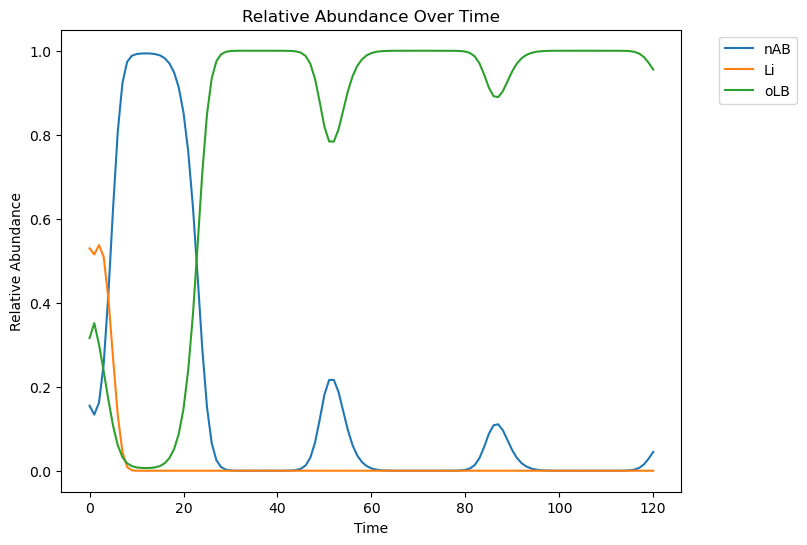

None


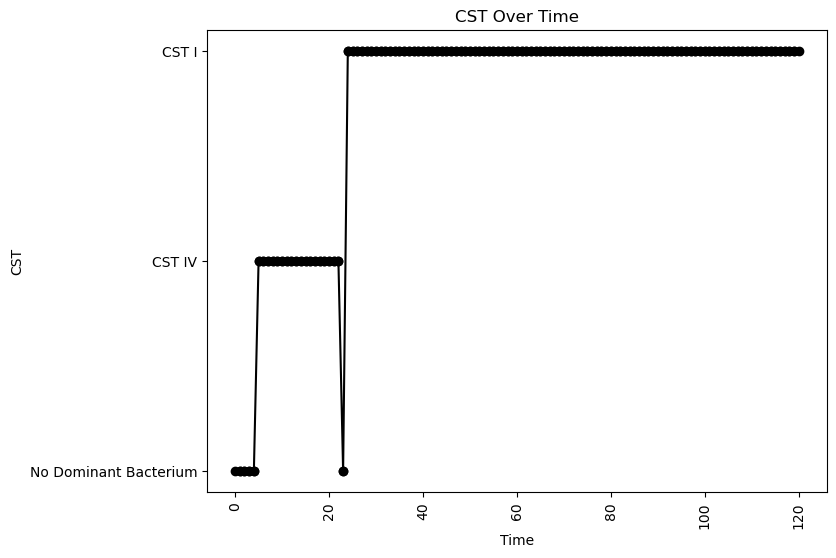

None


In [66]:
print(plot_relative_abundance(T, X))
csts = assign_cst(T, X, thresholds)
print(plot_cst(T, csts))

In [33]:
#Function to subsample CSTs every X number of days
def plot_cst_every_x_days(T, csts, x):
    # Subsample time points and CST values at intervals of x days
    T_subsampled = T[::x]
    csts_subsampled = csts[::x]
    
    # Plot the CST over subsampled time points
    fig, ax = plt.subplots(figsize=(8, 6))
    ax.plot(T_subsampled, csts_subsampled, marker='o', linestyle='-', color='black')
    ax.set_title(f'CST Every {x} Days')
    ax.set_xlabel('Time (days)')
    plt.xticks(rotation=90)
    plt.show()

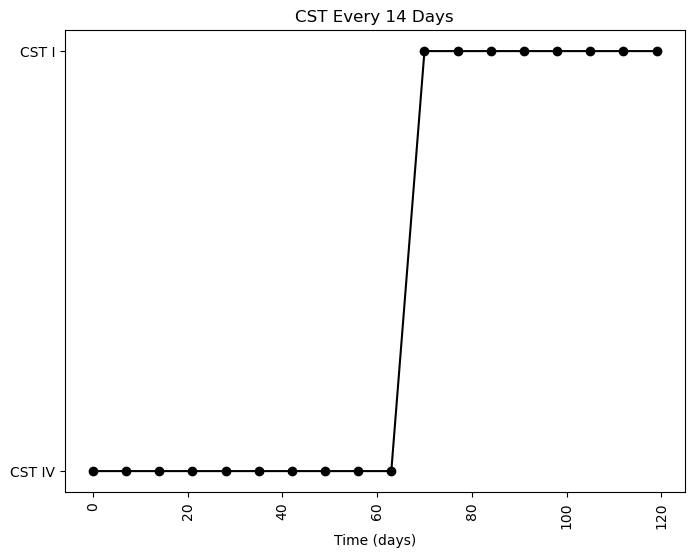

In [32]:
plot_cst_every_x_days(T, csts, x=14)

## LHS to figure out better parameters 
Original set not producing the make sense outcomes right now

In [74]:
def generate_lhs_samples(num_samples, num_params):
    # Define the new, highly refined parameter bounds based on  most successful simulations
    param_bounds = np.array([
        [0.1, 1],  # Growth rate of non-optimal bacteria (nAB)
        [0.1, 1],  # Growth rate of Lactobacillus iners (Li)
        [0.1, 1],  # Growth rate of Lactobacillus crispatus (oLB)
        [-0.1, -0.001],  # Self-interaction of nAB
        [-0.5, 0.5],    # Interaction of nAB on Li
        [-0.5, -0.001],    # Interaction of nAB on oLB (always negative)
        [-0.5, 0.5],    # Interaction of Li on nAB
        [-0.1, -0.001],  # Self-interaction of Li
        [-0.5, 0.5],    # Interaction of Li on oLB
        [-0.5, -0.001],    # Interaction of oLB on nAB
        [-0.5, 0.5],    # Interaction of oLB on Li
        [-0.1, -0.001]   # Self-interaction of oLB
    ])
    
    # Generate LHS samples
    lhs_samples = lhs(num_params, samples=num_samples)
    
    # Scale the samples to the parameter bounds
    param_sets = np.zeros_like(lhs_samples)
    for i in range(num_params):
        param_sets[:, i] = lhs_samples[:, i] * (param_bounds[i, 1] - param_bounds[i, 0]) + param_bounds[i, 0]
    
    return param_sets

# Function to run simulations for each parameter set
def run_lhs_simulations(X0, t_span, agent_class, num_samples, external_parameters_distribution):
    # Generate LHS samples
    num_params = 12  # Total number of parameters
    param_sets = generate_lhs_samples(num_samples, num_params)
    
    results = []
    for params in param_sets:
        # Create an agent with the current parameter set and required external parameters
        agent = agent_class(external_parameters_distribution)
        agent.interaction_params = params
        
        # Run the simulation
        times, abundances = sim_continuous(X0, t_span, agent)
        results.append((times, abundances, params))
    
    return results

In [69]:
X0 = np.array([1, 1, 1])  # Initial conditions
t_span = 120  # Time span for simulation
num_samples = 10000  # Number of parameter sets to sample

simulation_results = run_lhs_simulations(X0, t_span, Agent, num_samples, external_parameters_distribution)

C:\Users\lilliandi\AppData\Local\Temp\ipykernel_8924\3137925064.py:47: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  sol, infodict = odeint(lotka_volterra, current_state, t_eval, hmax=1e-3, full_output=1)  # hmax limits maximum step size
C:\Users\lilliandi\AppData\Local\Temp\ipykernel_8924\3137925064.py:14: RuntimeWarning: overflow encountered in multiply
  return (adjusted_r * x) + np.dot(scaled_interaction_matrix, x) * x
C:\Users\lilliandi\AppData\Local\Temp\ipykernel_8924\3137925064.py:14: RuntimeWarning: invalid value encountered in multiply
  return (adjusted_r * x) + np.dot(scaled_interaction_matrix, x) * x
C:\Users\lilliandi\AppData\Local\Temp\ipykernel_8924\3137925064.py:14: RuntimeWarning: invalid value encountered in add
  return (adjusted_r * x) + np.dot(scaled_interaction_matrix, x) * x
C:\Users\lilliandi\AppData\Local\Temp\ipykernel_8924\3137925064.py:47: ODEintWarning: Excess accuracy re

In [72]:
# Function to check if a simulation has at least CST III and CST IV
def has_required_csts(csts):
    required_csts = {'CST III', 'CST IV'}
    present_csts = set(csts)
    return required_csts.issubset(present_csts)

# Function to check if a simulation follows one of the required CST progressions when CSTs change
def check_cst_progression(csts):
    # Remove 'No Dominant Bacterium' entries
    filtered_csts = [cst for cst in csts if cst != 'No Dominant Bacterium']

    # Only keep CSTs where there is a change from the previous time point
    distinct_csts = [filtered_csts[0]] if filtered_csts else []
    for i in range(1, len(filtered_csts)):
        if filtered_csts[i] != filtered_csts[i-1]:
            distinct_csts.append(filtered_csts[i])

    # Define valid CST transitions
    valid_transitions = {
        'CST I': ['CST III', 'CST IV'],  # CST I can only go to CST III or CST IV
        'CST III': ['CST IV', 'CST I'],  # CST III can go to CST IV or back to CST I
        'CST IV': ['CST III'],  # CST IV can go to CST III 
    }

    # Check each consecutive transition in distinct_csts
    for i in range(1, len(distinct_csts)):
        prev_cst = distinct_csts[i-1]
        curr_cst = distinct_csts[i]
        if curr_cst not in valid_transitions.get(prev_cst, []):
            return False  # Return False if an invalid transition is found

    # If all transitions are valid, return True
    return True

# Function to plot CSTs and print interaction parameters
def plot_cst_and_print_interaction_params(T, csts, params):
    plot_cst(T, csts)
    param_labels = ['nAB Growth', 'Li Growth', 'oLB Growth', 'nAB Self', 'nAB->Li', 'nAB->oLB',
                    'Li->nAB', 'Li Self', 'Li->oLB', 'oLB->nAB', 'oLB->Li', 'oLB Self']

    print("\nInteraction Parameters:")
    for label, param in zip(param_labels, params):
        print(f"{label}: {param}")


Simulation 6 follows a valid CST progression:


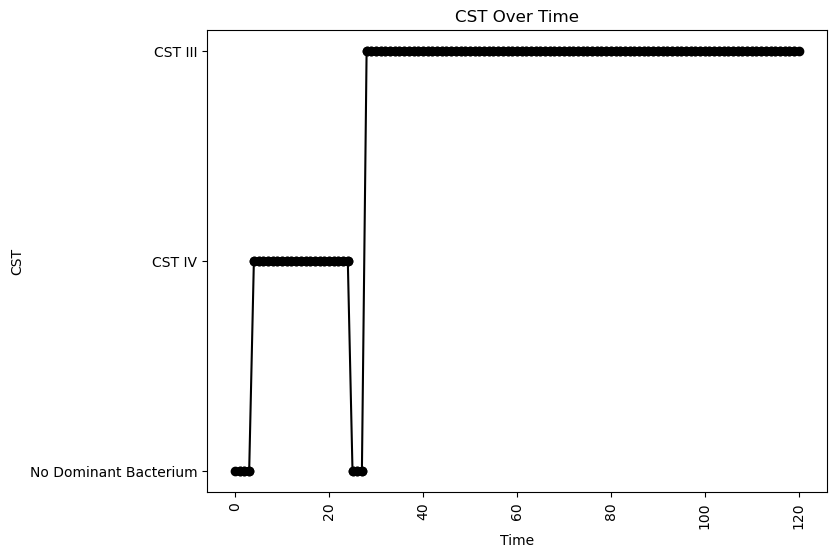


Interaction Parameters:
nAB Growth: 2.1964345031105657
Li Growth: 0.18389923923324605
oLB Growth: 1.2138354993931422
nAB Self: -0.018260305940909494
nAB->Li: -0.036368468472826265
nAB->oLB: -0.31116327738135213
Li->nAB: 0.0009749382399473205
Li Self: -0.006681908938835579
Li->oLB: 0.06560874513314463
oLB->nAB: -0.17919011701215537
oLB->Li: -0.406835599431157
oLB Self: -0.08122058362462588

Simulation 7 follows a valid CST progression:


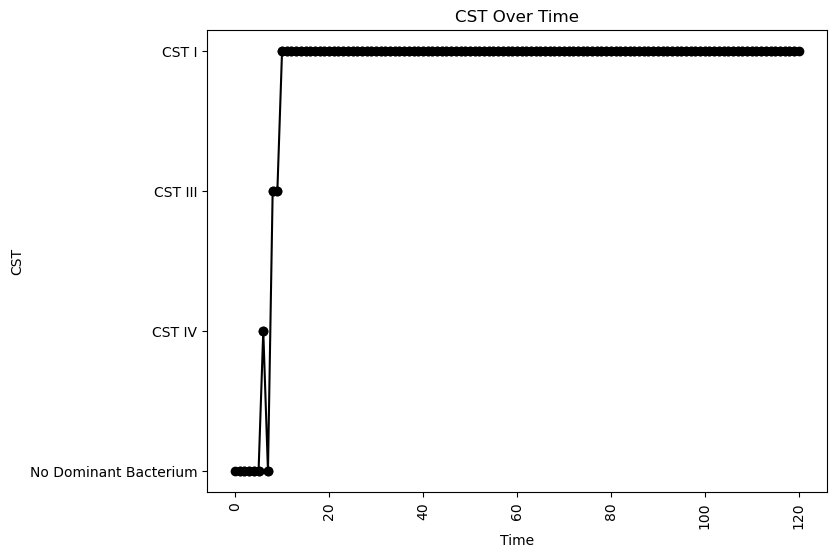


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.05739994626081137
oLB Growth: 0.11031283255203692
nAB Self: -0.07314535081148618
nAB->Li: -0.31167169733230893
nAB->oLB: -0.42442806233998076
Li->nAB: 0.27885126438946783
Li Self: -0.0069861837614629
Li->oLB: -0.07215702960753156
oLB->nAB: -0.12543088411697906
oLB->Li: 0.2493386893552123
oLB Self: -0.08879813541819412

Simulation 11 follows a valid CST progression:


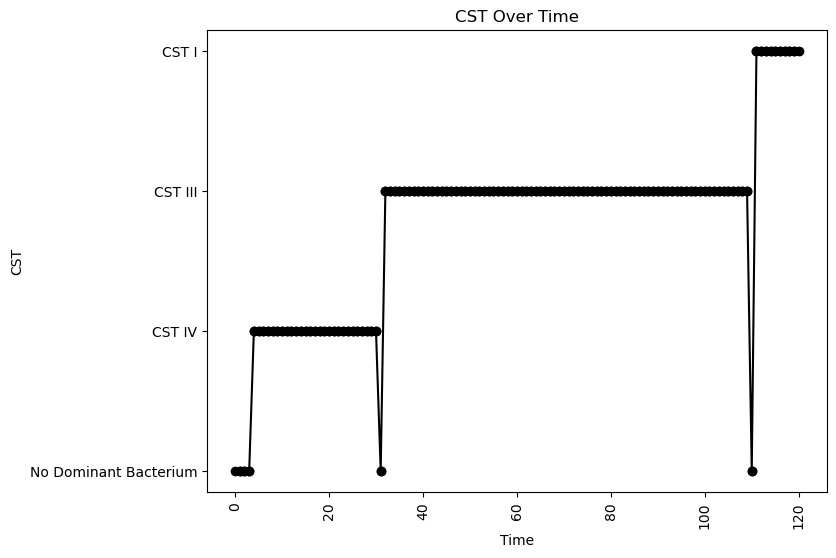


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.06588260315658048
oLB Growth: 0.21113539622386296
nAB Self: -0.01849289854749428
nAB->Li: -0.4823818632898649
nAB->oLB: -0.46641476283614525
Li->nAB: 0.0061536892462522585
Li Self: -0.04860028117624244
Li->oLB: -0.42810307900155364
oLB->nAB: -0.2376680889475285
oLB->Li: 0.29616061575247354
oLB Self: -0.054267489883588954

Simulation 14 follows a valid CST progression:


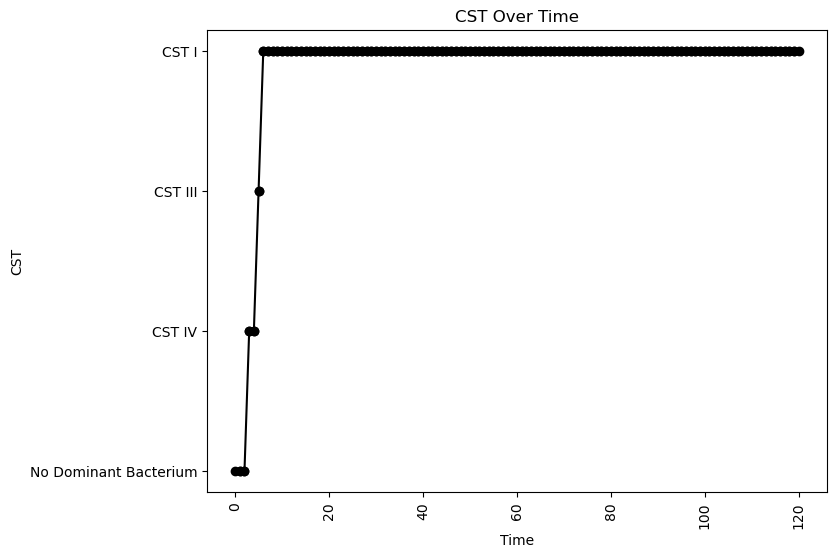


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.017561423520029956
nAB->Li: -0.126953429226502
nAB->oLB: -0.1871686991920271
Li->nAB: 0.3782281284223443
Li Self: -0.02963394573069736
Li->oLB: 0.21860490935348076
oLB->nAB: -0.42822875935561455
oLB->Li: 0.4236379629903678
oLB Self: -0.07715859083101749

Simulation 25 follows a valid CST progression:


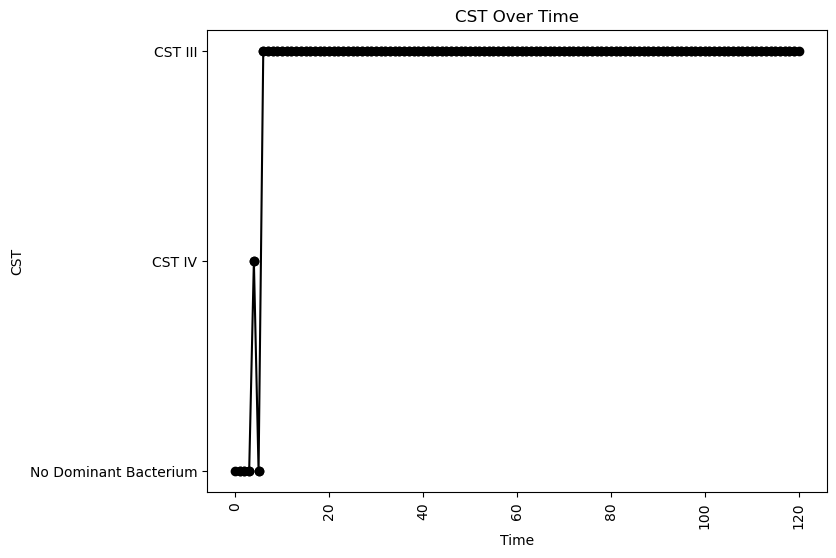


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.31465507187115427
oLB Growth: 0.46591620920123267
nAB Self: -0.03089297806804521
nAB->Li: 0.0815253765289462
nAB->oLB: -0.20467512803337895
Li->nAB: 0.2738380307564424
Li Self: -0.07703446041144522
Li->oLB: 0.2613513385836479
oLB->nAB: -0.42809520136379897
oLB->Li: 0.026985897374883328
oLB Self: -0.014059412749599681

Simulation 26 follows a valid CST progression:


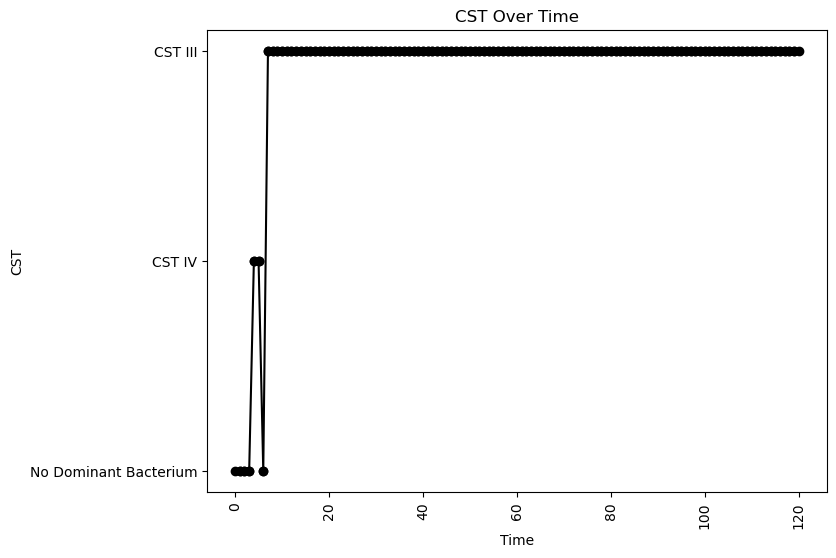


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.0685080271474922
nAB->Li: -0.009331361584855424
nAB->oLB: -0.47957220348090607
Li->nAB: 0.38820223888940397
Li Self: -0.061091320484518166
Li->oLB: -0.09897336397939333
oLB->nAB: -0.2535258937711933
oLB->Li: -0.44647397476219963
oLB Self: -0.030953729603206817

Simulation 27 follows a valid CST progression:


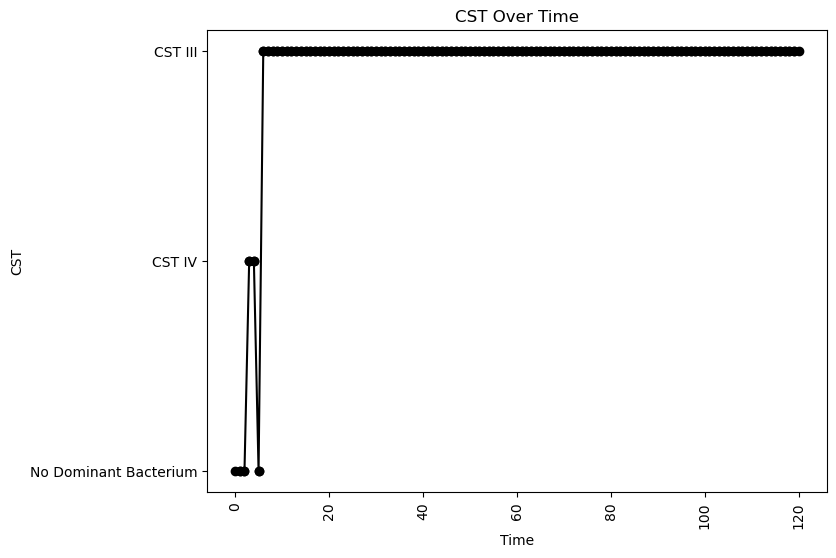


Interaction Parameters:
nAB Growth: 2.273308423784788
Li Growth: 0.06939466945066827
oLB Growth: 0.4879467602516997
nAB Self: -0.011764888145572888
nAB->Li: 0.07369315175966751
nAB->oLB: -0.20395146376099432
Li->nAB: 0.27449719730998945
Li Self: -0.0775736216432545
Li->oLB: 0.16425879128868126
oLB->nAB: -0.32868494424682193
oLB->Li: 0.05271123190412497
oLB Self: -0.034263162928340724

Simulation 30 follows a valid CST progression:


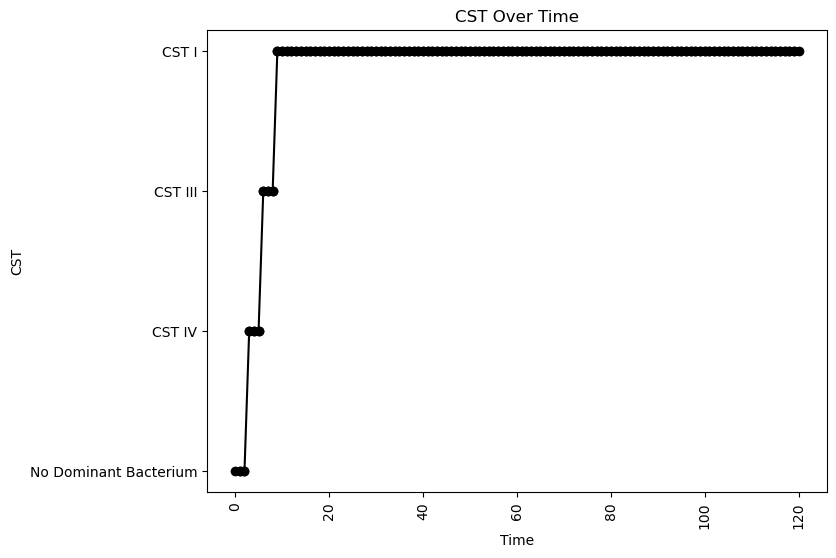


Interaction Parameters:
nAB Growth: 2.300652803872004
Li Growth: 0.06616501714537036
oLB Growth: 0.4369767544558836
nAB Self: -0.01133354700540852
nAB->Li: 0.09923135683070516
nAB->oLB: -0.31941984342743335
Li->nAB: 0.23298257082033302
Li Self: -0.011932333072164916
Li->oLB: -0.30072458111775857
oLB->nAB: -0.29891175808727455
oLB->Li: 0.2424183475326528
oLB Self: -0.012522555538630173

Simulation 33 follows a valid CST progression:


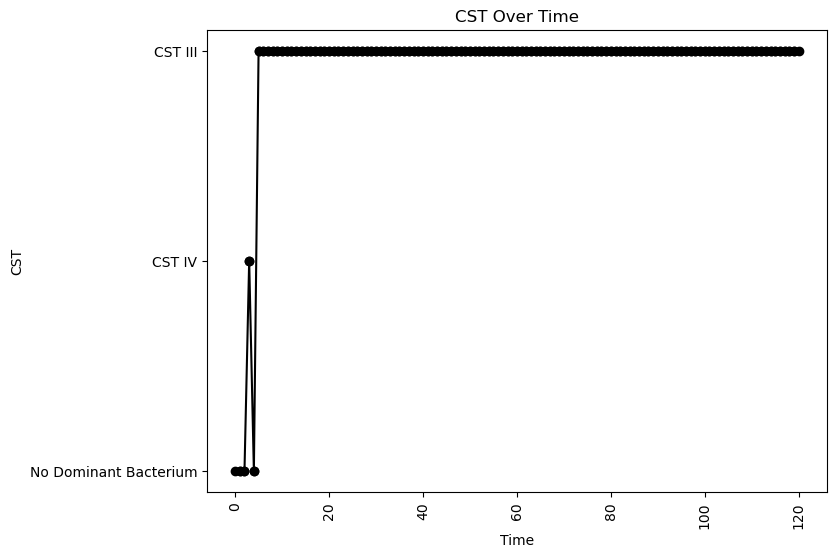


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.0982025936300399
oLB Growth: 0.03504834427483494
nAB Self: -0.06389591127372314
nAB->Li: 0.14124777136982614
nAB->oLB: -0.30531600391984026
Li->nAB: 0.4943859627116882
Li Self: -0.07463451205397544
Li->oLB: -0.17524069915210383
oLB->nAB: -0.18529710111286402
oLB->Li: -0.35603315662999235
oLB Self: -0.025473476099048875

Simulation 36 follows a valid CST progression:


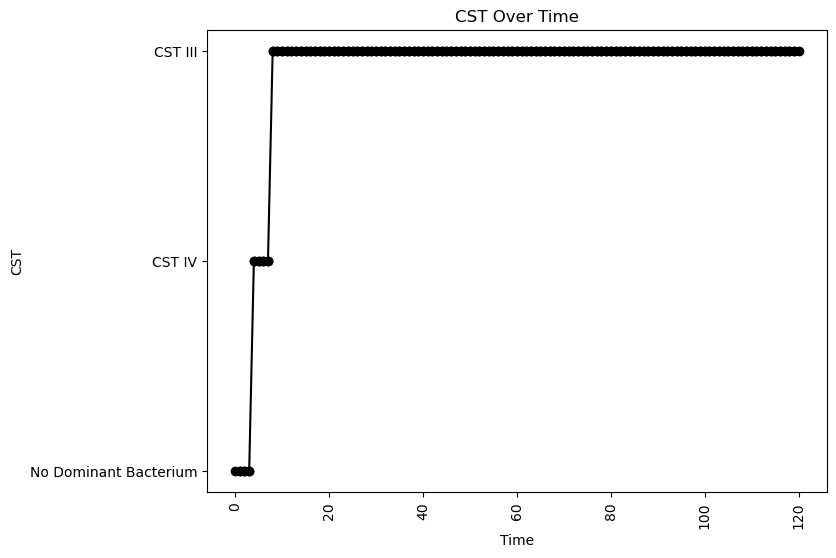


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.021827679732046038
nAB->Li: -0.4921666729812116
nAB->oLB: -0.40462248704723375
Li->nAB: 0.14011731018049434
Li Self: -0.023864756384795766
Li->oLB: 0.112775337336401
oLB->nAB: -0.4158199083023439
oLB->Li: -0.47441992638040376
oLB Self: -0.021344978091347305

Simulation 40 follows a valid CST progression:


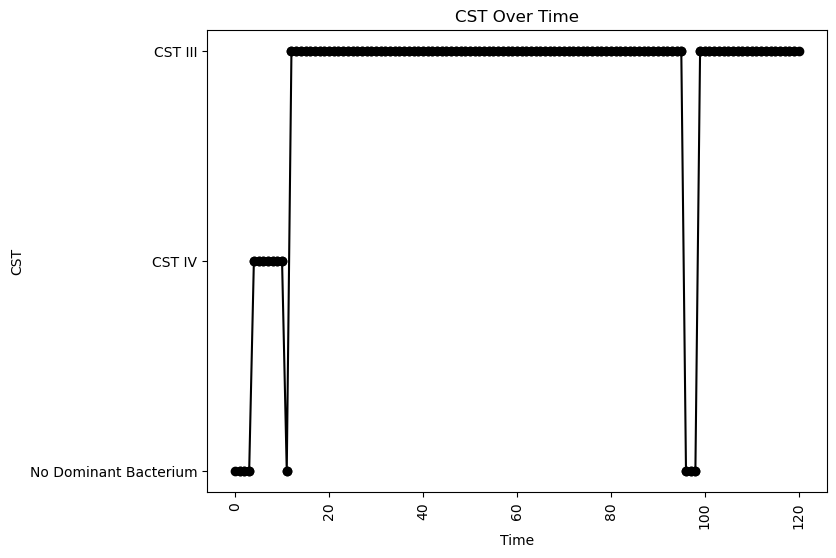


Interaction Parameters:
nAB Growth: 2.1964345031105657
Li Growth: 0.04025066595693835
oLB Growth: 1.2138354993931422
nAB Self: -0.012758637884414087
nAB->Li: -0.2650690807262198
nAB->oLB: -0.35384551120330177
Li->nAB: 0.056324739297928694
Li Self: -0.04535438550452953
Li->oLB: 0.4732524461946822
oLB->nAB: -0.2944166043445136
oLB->Li: -0.2586141318289902
oLB Self: -0.05527987338064796

Simulation 56 follows a valid CST progression:


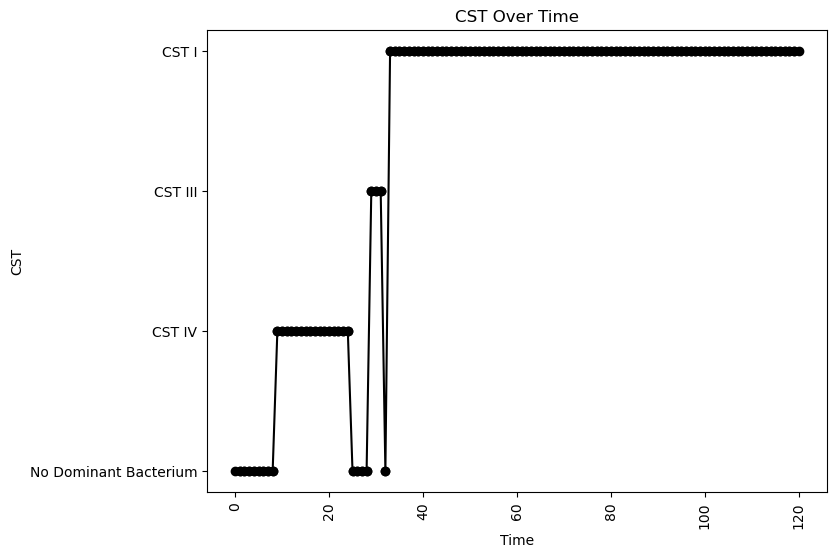


Interaction Parameters:
nAB Growth: 2.226251684223429
Li Growth: 0.0760937960697033
oLB Growth: 0.4505921706771102
nAB Self: -0.020592555505575025
nAB->Li: -0.21081271379722866
nAB->oLB: -0.30958733188716026
Li->nAB: 0.02860249458542996
Li Self: -0.045106426002915326
Li->oLB: -0.000817235603104427
oLB->nAB: -0.3501053193532263
oLB->Li: 0.34724507897105183
oLB Self: -0.024546289192679455

Simulation 73 follows a valid CST progression:


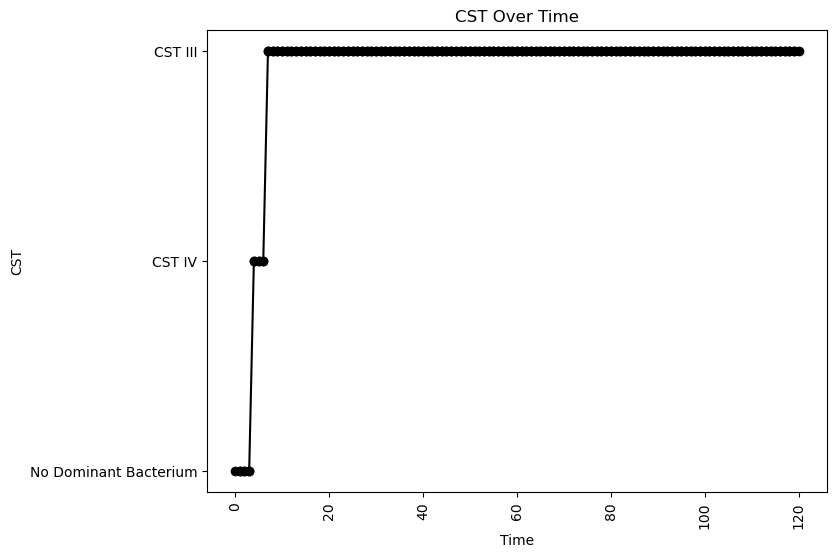


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.10653300861417082
oLB Growth: 0.08496126009849418
nAB Self: -0.031031573152230332
nAB->Li: -0.00968843785013257
nAB->oLB: -0.08485368625170697
Li->nAB: 0.09888701358845653
Li Self: -0.003278027529812641
Li->oLB: 0.029901204052089403
oLB->nAB: -0.25745879582541364
oLB->Li: -0.0335443542385358
oLB Self: -0.06045144569244292

Simulation 76 follows a valid CST progression:


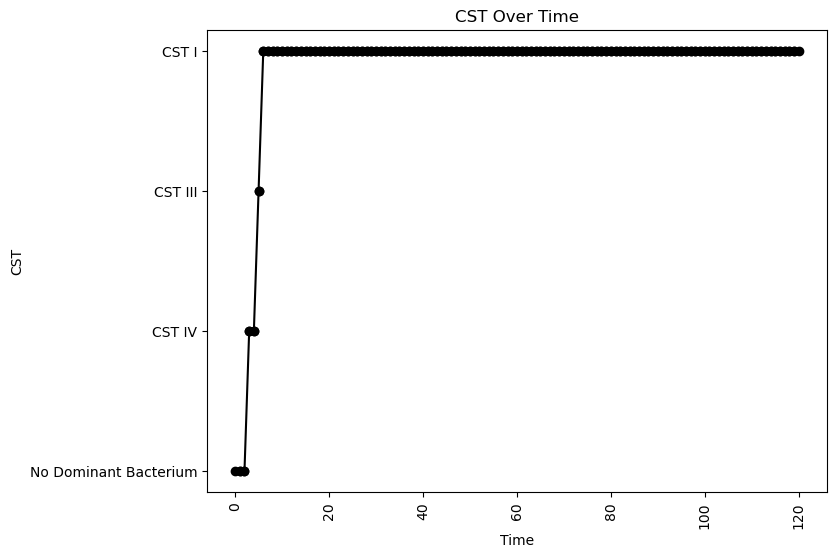


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.0791163852122763
nAB->Li: 0.17668392689871004
nAB->oLB: -0.038548011176559704
Li->nAB: 0.45857397763670926
Li Self: -0.005734043524956156
Li->oLB: -0.10008741837405627
oLB->nAB: -0.44280869644801074
oLB->Li: 0.47314918398561867
oLB Self: -0.04062384989190412

Simulation 93 follows a valid CST progression:


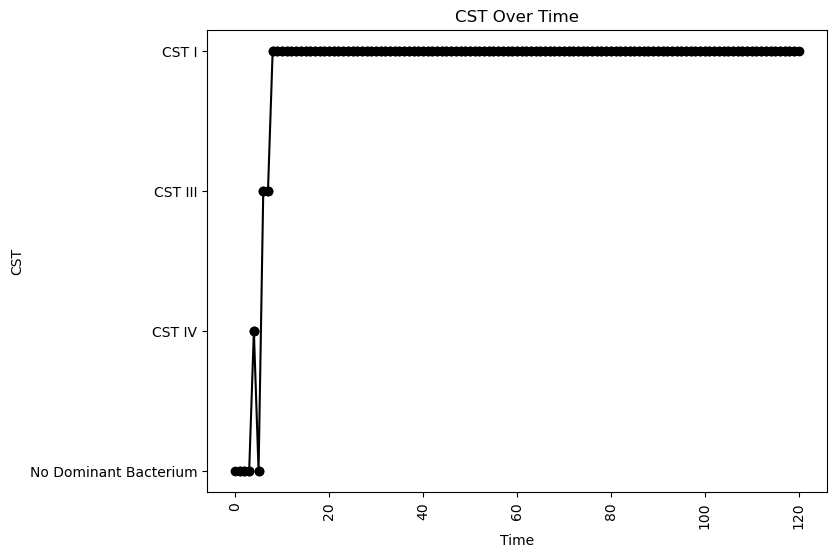


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.06309763455319839
oLB Growth: 0.9128027925042091
nAB Self: -0.08582643462866621
nAB->Li: -0.05072337588669362
nAB->oLB: -0.4625797138261131
Li->nAB: 0.43164784074444396
Li Self: -0.09645922174295364
Li->oLB: -0.3914782172008331
oLB->nAB: -0.26628740906364046
oLB->Li: 0.2211381295409105
oLB Self: -0.09144608334810503

Simulation 96 follows a valid CST progression:


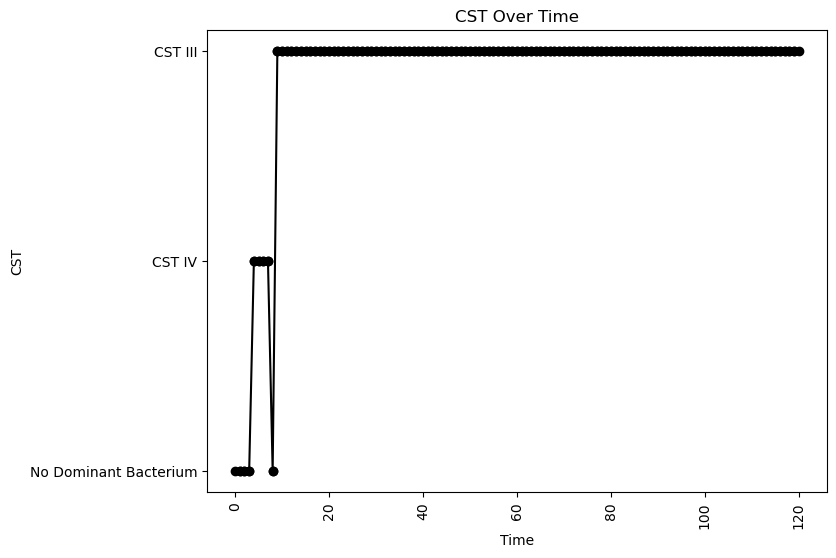


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.08300047407267977
nAB->Li: -0.16883313044441672
nAB->oLB: -0.24983491258312346
Li->nAB: 0.12149874784946679
Li Self: -0.06479772105134995
Li->oLB: -0.17271783451119138
oLB->nAB: -0.16263716048480675
oLB->Li: -0.02424221343443045
oLB Self: -0.015843744678323904

Simulation 98 follows a valid CST progression:


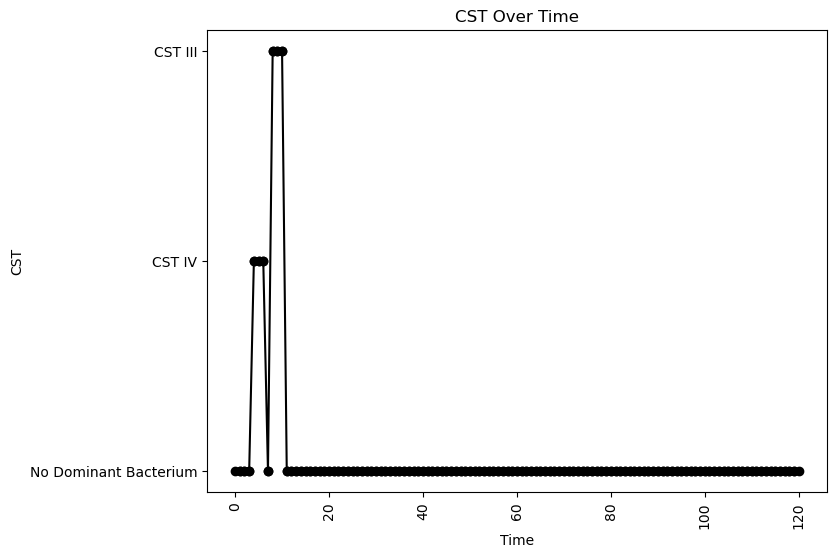


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.019145776359623334
nAB->Li: -0.16809582721272137
nAB->oLB: -0.34179059223467945
Li->nAB: 0.09183009420597121
Li Self: -0.0180784024636525
Li->oLB: 0.4241764274345755
oLB->nAB: -0.45561318431313597
oLB->Li: 0.353053560595013
oLB Self: -0.08767121003570214

Simulation 100 follows a valid CST progression:


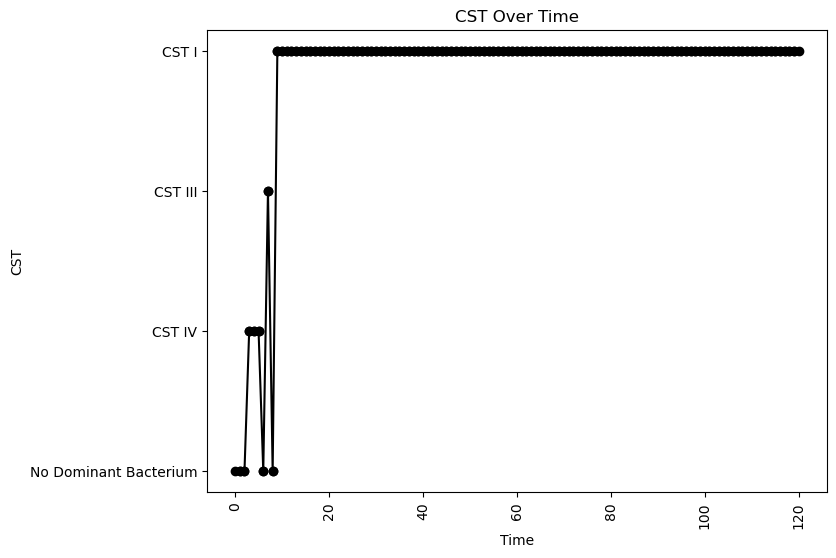


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.021178856920738592
nAB->Li: -0.3781056724463032
nAB->oLB: -0.3509105090381167
Li->nAB: 0.3321207178790906
Li Self: -0.09558782735610967
Li->oLB: 0.08961407485686246
oLB->nAB: -0.2829953530330639
oLB->Li: 0.40738344242901214
oLB Self: -0.08334800056879818

Simulation 111 follows a valid CST progression:


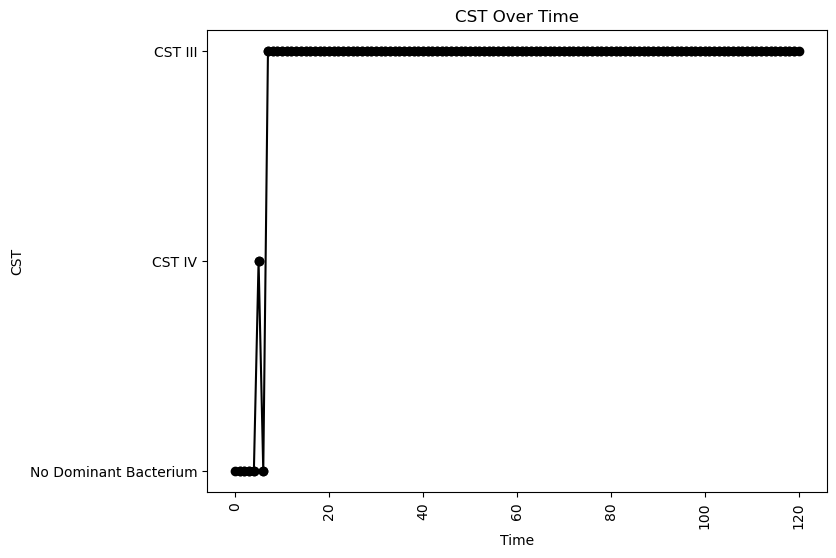


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.027768343152138428
nAB->Li: -0.2448055533058353
nAB->oLB: -0.10498034288865649
Li->nAB: 0.4466905698960143
Li Self: -0.0682470997715365
Li->oLB: -0.29562418543279506
oLB->nAB: -0.4718228676669647
oLB->Li: -0.22107646511253476
oLB Self: -0.07755969551695197

Simulation 112 follows a valid CST progression:


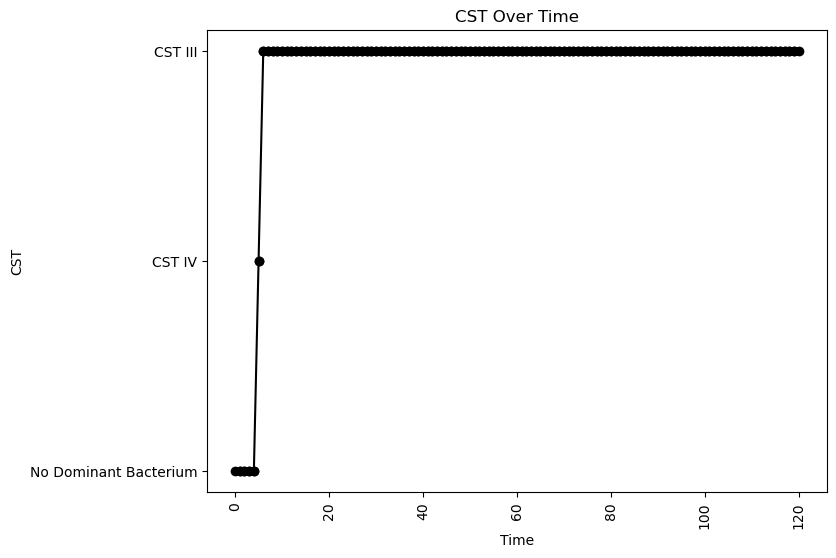


Interaction Parameters:
nAB Growth: 2.286323001067126
Li Growth: 0.060377934648291574
oLB Growth: 0.14091260068383374
nAB Self: -0.009411826895176958
nAB->Li: 0.09156479926438266
nAB->oLB: -0.10835636970064877
Li->nAB: 0.4643079883169311
Li Self: -0.0015745894338931726
Li->oLB: 0.011950279472860648
oLB->nAB: -0.42975903594866866
oLB->Li: -0.1005066830935229
oLB Self: -0.03069910601327487

Simulation 115 follows a valid CST progression:


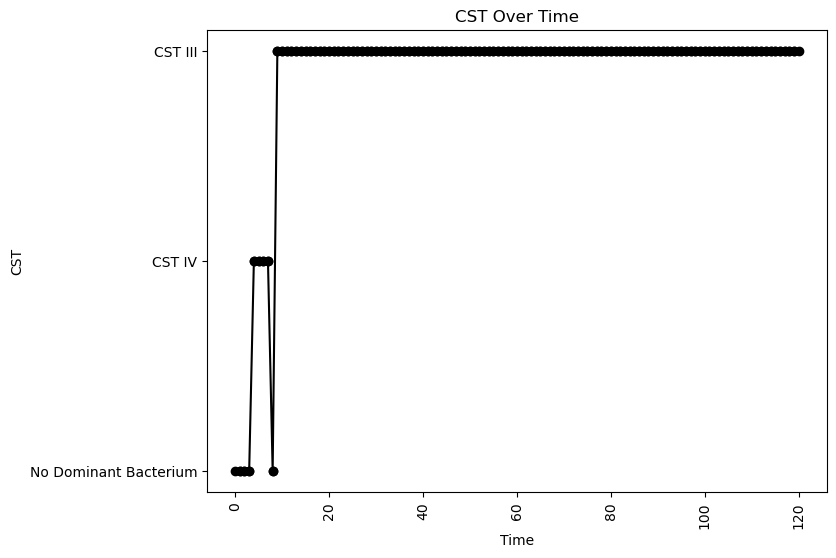


Interaction Parameters:
nAB Growth: 2.2609282147211935
Li Growth: 0.06381435834914458
oLB Growth: 0.1660151901294062
nAB Self: -0.08956797648022842
nAB->Li: 0.010012869542268321
nAB->oLB: -0.3263599685742886
Li->nAB: 0.2844710366381157
Li Self: -0.048092595241935605
Li->oLB: -0.45235504836548646
oLB->nAB: -0.475669496618421
oLB->Li: -0.47656992286580285
oLB Self: -0.006919397586330728

Simulation 117 follows a valid CST progression:


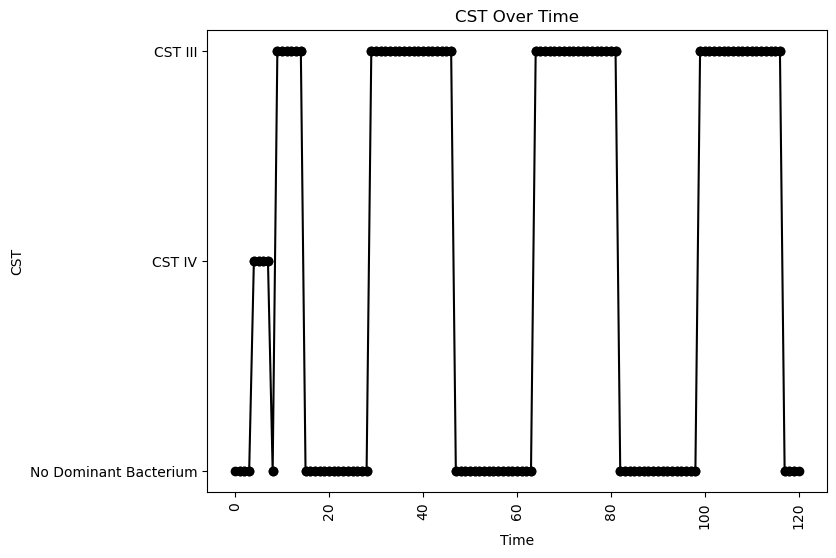


Interaction Parameters:
nAB Growth: 2.292952252819776
Li Growth: 0.13567315558199222
oLB Growth: 0.25066683866219575
nAB Self: -0.004772856566757369
nAB->Li: -0.26101428249768877
nAB->oLB: -0.10547183830255341
Li->nAB: 0.07008402128950642
Li Self: -0.08038781041803754
Li->oLB: -0.09060367429577493
oLB->nAB: -0.46676295949577296
oLB->Li: 0.1969195092935616
oLB Self: -0.025274968068051268

Simulation 120 follows a valid CST progression:


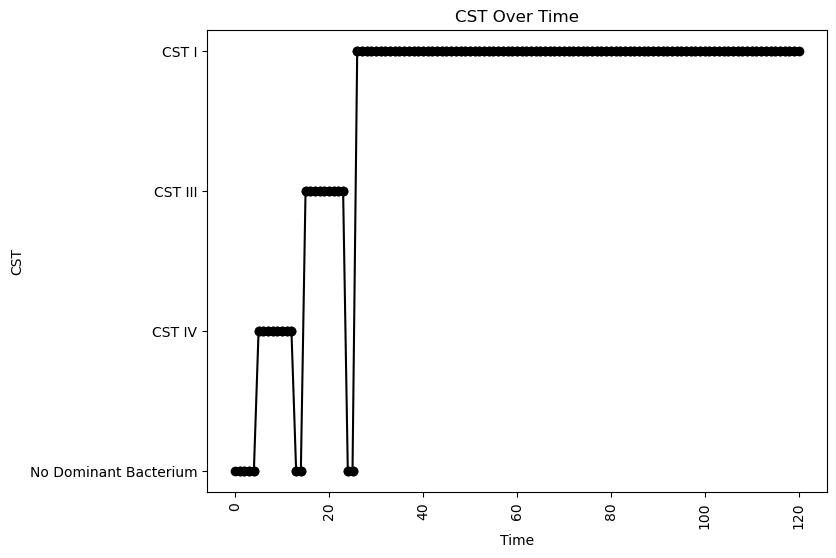


Interaction Parameters:
nAB Growth: 2.2002663828262317
Li Growth: 0.07280454274860512
oLB Growth: 0.7629459891785437
nAB Self: -0.05741601885054706
nAB->Li: -0.45791872345628515
nAB->oLB: -0.2587177164585396
Li->nAB: 0.10261786065072975
Li Self: -0.06725242116943522
Li->oLB: -0.050016425338647086
oLB->nAB: -0.26064202342496834
oLB->Li: 0.13981207308288546
oLB Self: -0.01805591087733338

Simulation 134 follows a valid CST progression:


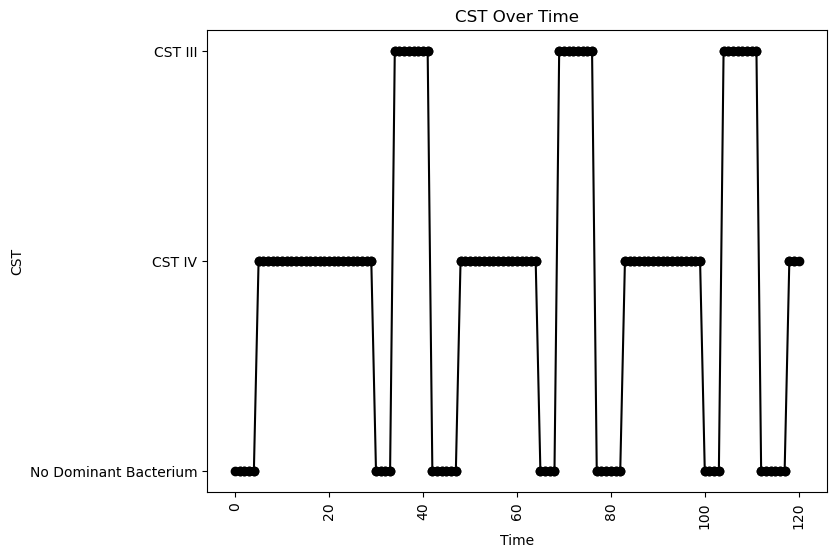


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.2605290790701611
oLB Growth: 0.1263134331844771
nAB Self: -0.0961185837700823
nAB->Li: -0.20317793868662776
nAB->oLB: -0.08532740969836528
Li->nAB: 0.025769334613324868
Li Self: -0.09871740069213886
Li->oLB: -0.06942750425681349
oLB->nAB: -0.13986742148903986
oLB->Li: 0.04504941305142762
oLB Self: -0.07788934697760772

Simulation 135 follows a valid CST progression:


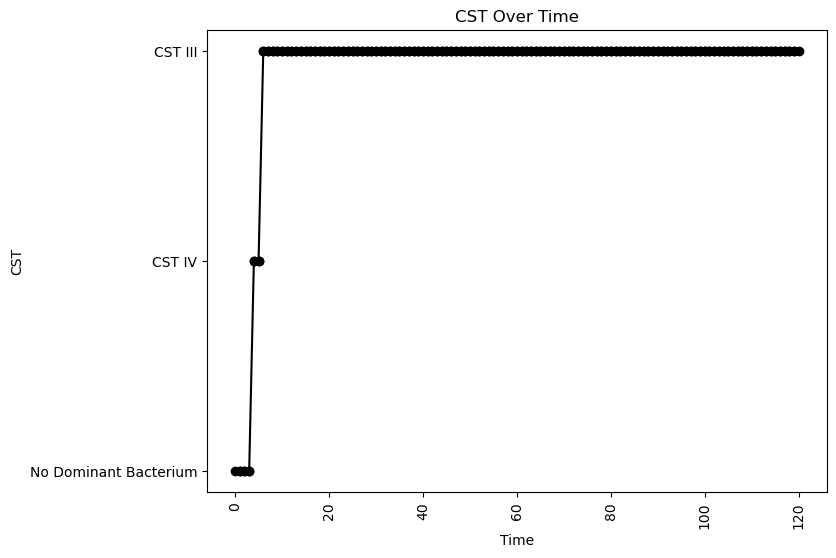


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.06588260315658048
oLB Growth: 0.21113539622386296
nAB Self: -0.09755443807981609
nAB->Li: 0.00416927642487086
nAB->oLB: -0.1677192242464169
Li->nAB: 0.32949433984813037
Li Self: -0.07078959196195113
Li->oLB: 0.4565368363385276
oLB->nAB: -0.14931632643718495
oLB->Li: 0.029884141958605337
oLB Self: -0.08526867711337496

Simulation 142 follows a valid CST progression:


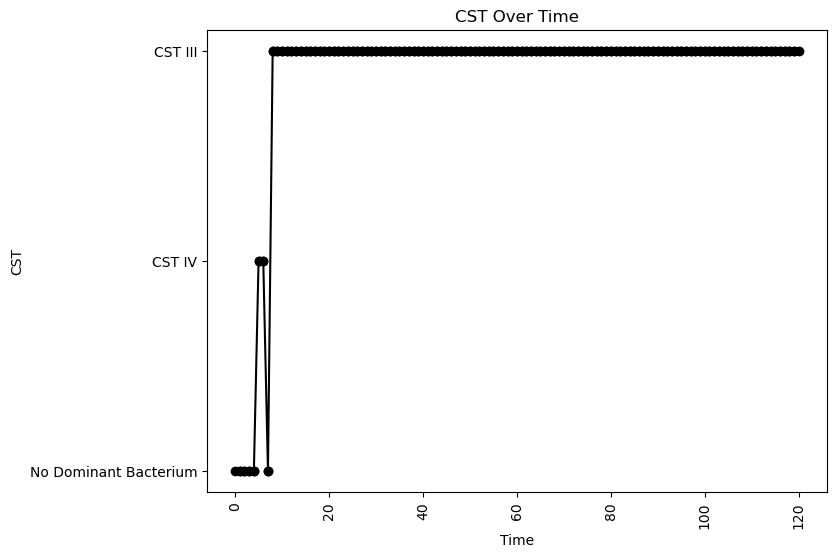


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.06309763455319839
oLB Growth: 0.9128027925042091
nAB Self: -0.03730401511967754
nAB->Li: -0.26762633891152243
nAB->oLB: -0.3636429817125252
Li->nAB: 0.2558125481527074
Li Self: -0.07415398753149349
Li->oLB: 0.1353260034472844
oLB->nAB: -0.41889305064570104
oLB->Li: -0.2720882329175858
oLB Self: -0.07098445253528382

Simulation 144 follows a valid CST progression:


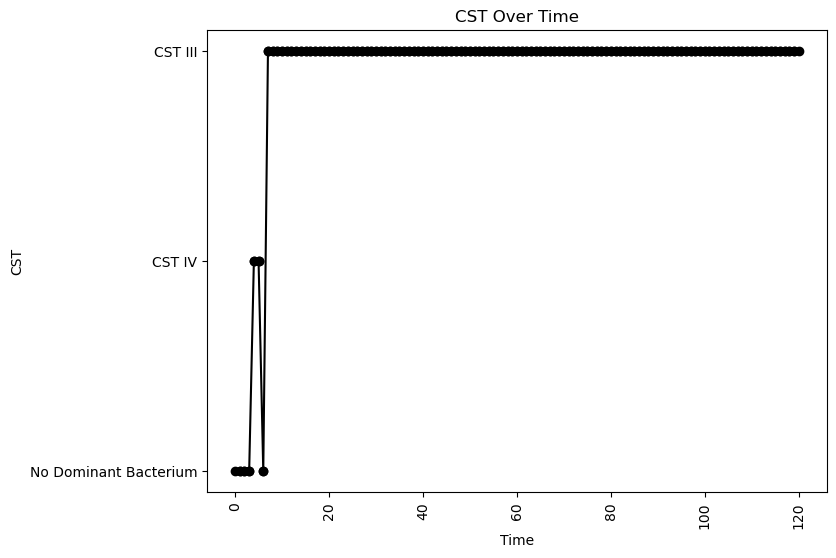


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.07152691384845643
nAB->Li: -0.17335685996808836
nAB->oLB: -0.24192809759028522
Li->nAB: 0.3815529377150495
Li Self: -0.09023466998314807
Li->oLB: 0.1105793182935727
oLB->nAB: -0.21555867402971074
oLB->Li: -0.4896000361022706
oLB Self: -0.06868682269767741

Simulation 146 follows a valid CST progression:


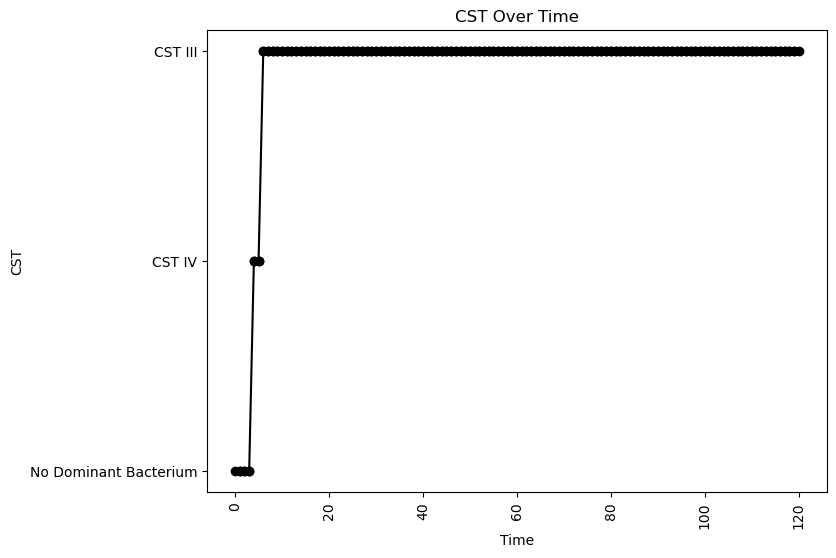


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.0017248985747833345
nAB->Li: 0.050856006131197895
nAB->oLB: -0.24187855651384071
Li->nAB: 0.4657645713403179
Li Self: -0.08872685573113306
Li->oLB: -0.14815550989818554
oLB->nAB: -0.3402740341963954
oLB->Li: -0.4121567143655511
oLB Self: -0.02487921334199597

Simulation 148 follows a valid CST progression:


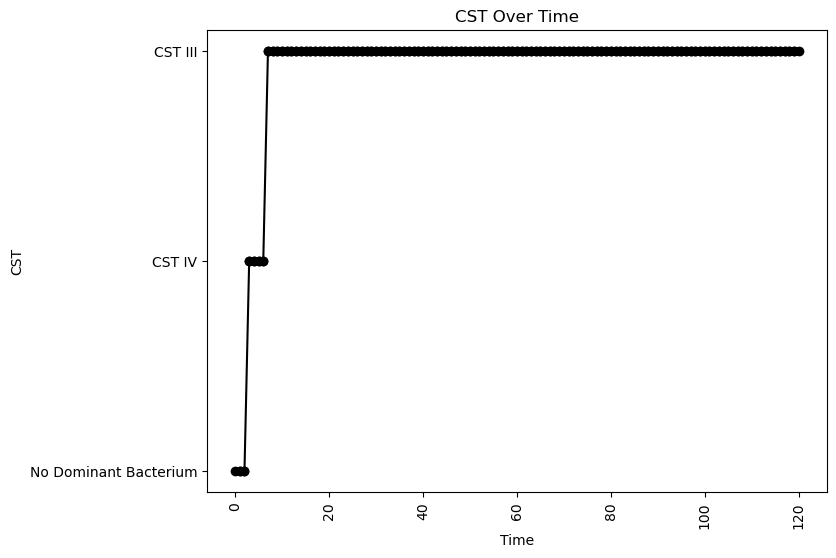


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.0308709154144976
nAB->Li: -0.03988765854281373
nAB->oLB: -0.28718892083099035
Li->nAB: 0.14785636760282028
Li Self: -0.055621590408592284
Li->oLB: -0.43248319668124324
oLB->nAB: -0.11178320639638728
oLB->Li: -0.13542217370938014
oLB Self: -0.08304905997198768

Simulation 149 follows a valid CST progression:


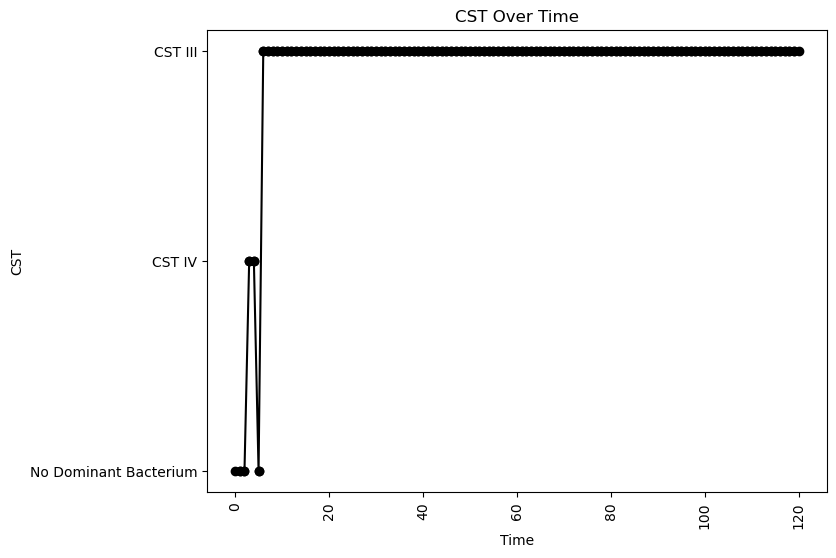


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.07336353829848645
nAB->Li: 0.09143160307675291
nAB->oLB: -0.16369037490005556
Li->nAB: 0.26937523836018895
Li Self: -0.04095926020065525
Li->oLB: 0.25825627560617637
oLB->nAB: -0.48047866254216437
oLB->Li: -0.2688881870096925
oLB Self: -0.03680303973076586

Simulation 152 follows a valid CST progression:


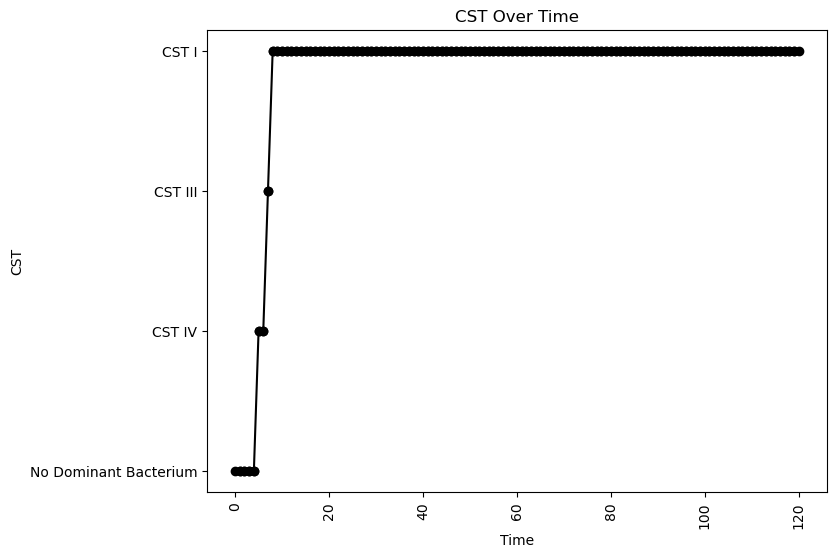


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.0862793191122654
nAB->Li: 0.11697114767842665
nAB->oLB: -0.28393742401149025
Li->nAB: 0.2325881658495026
Li Self: -0.05699918500597255
Li->oLB: -0.1800571720740693
oLB->nAB: -0.3054882463511383
oLB->Li: 0.2690991032459973
oLB Self: -0.0861511323056093

Simulation 155 follows a valid CST progression:


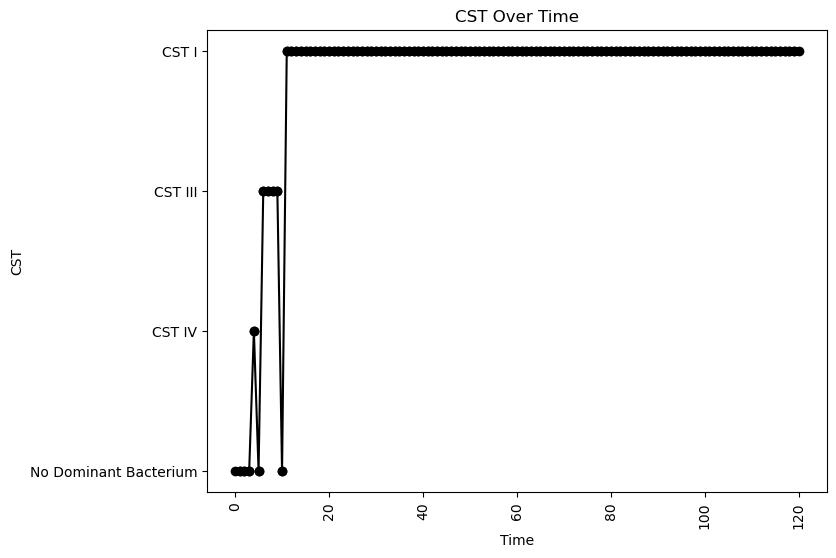


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.19322937033914125
oLB Growth: 1.155917868199191
nAB Self: -0.023854778789290876
nAB->Li: -0.3719939936079587
nAB->oLB: -0.35999776956883645
Li->nAB: 0.32248985890132187
Li Self: -0.08163301532434462
Li->oLB: -0.3062069523420241
oLB->nAB: -0.4157413496542524
oLB->Li: 0.21193931968669322
oLB Self: -0.03601657161040049

Simulation 160 follows a valid CST progression:


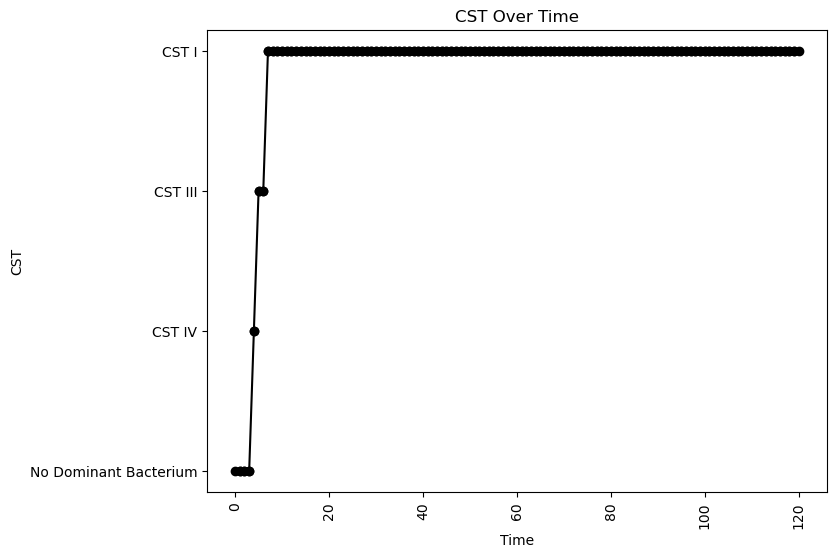


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.05577065598696034
nAB->Li: -0.03885563883713239
nAB->oLB: -0.473247325574987
Li->nAB: 0.43989198669180585
Li Self: -0.04159739961057991
Li->oLB: 0.004854483648611074
oLB->nAB: -0.11411180039239177
oLB->Li: 0.1587425672167252
oLB Self: -0.07586222360481

Simulation 163 follows a valid CST progression:


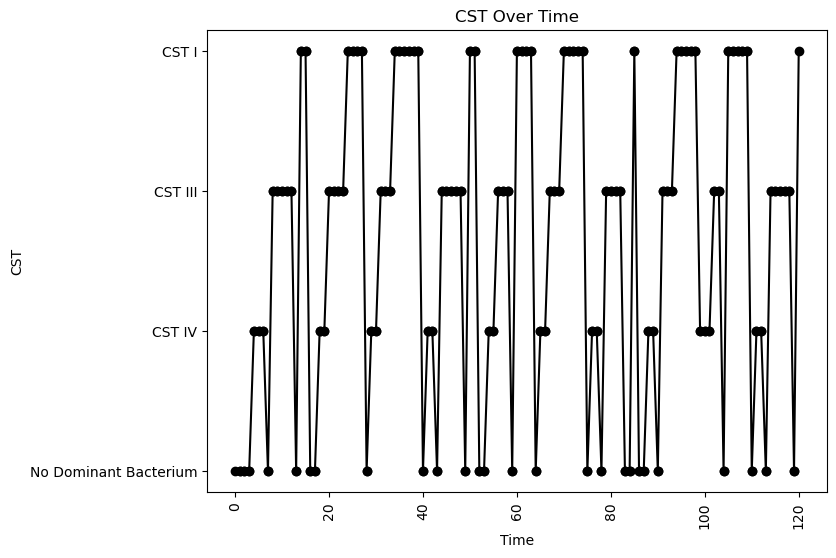


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.37121619526248467
oLB Growth: 0.058910478352813524
nAB Self: -0.009600566583761225
nAB->Li: -0.05670727905324985
nAB->oLB: -0.04395840533858897
Li->nAB: 0.059545626009584685
Li Self: -0.01569306232288395
Li->oLB: -0.07403886184713376
oLB->nAB: -0.1579522961809287
oLB->Li: 0.07053499699359955
oLB Self: -0.05109874087307725

Simulation 167 follows a valid CST progression:


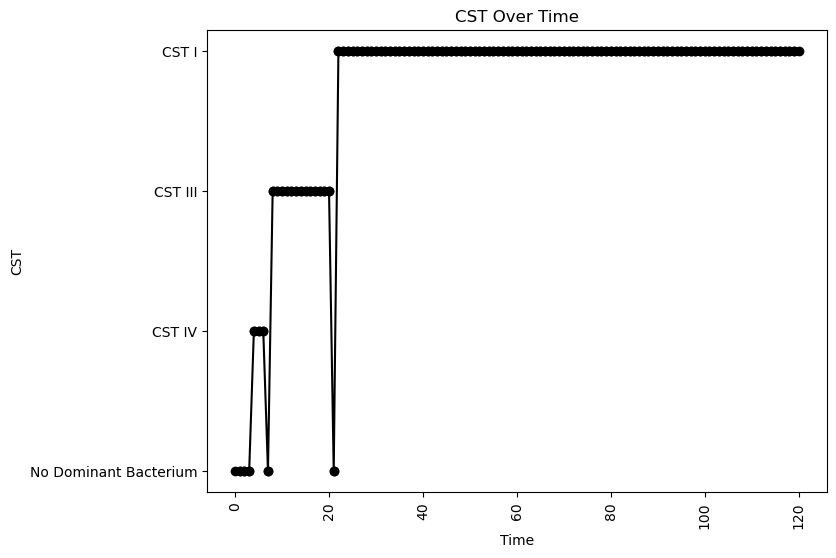


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.11183457292058224
oLB Growth: 1.156385115447748
nAB Self: -0.008270481310931652
nAB->Li: -0.4359881442464056
nAB->oLB: -0.32906625951510554
Li->nAB: 0.09157915202457922
Li Self: -0.015978259785210516
Li->oLB: 0.003973468829921445
oLB->nAB: -0.24031454932595336
oLB->Li: 0.02633890802131922
oLB Self: -0.012648267316389558

Simulation 170 follows a valid CST progression:


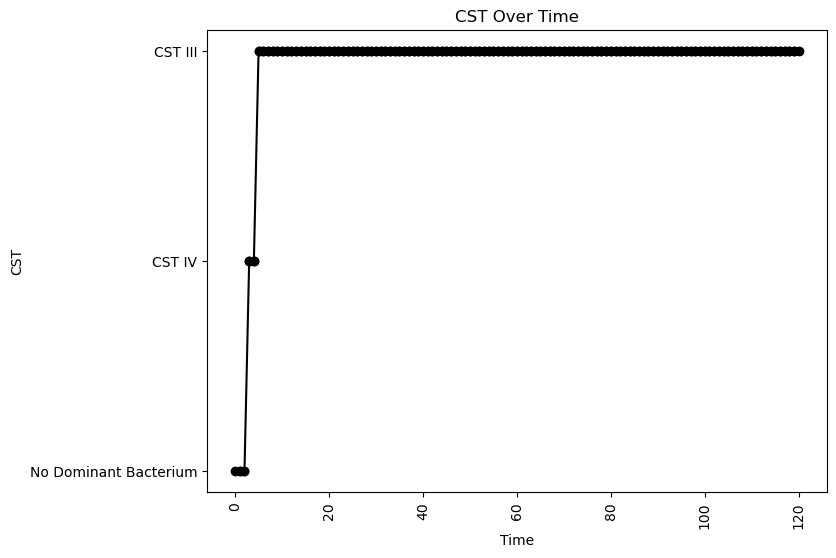


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.07743572724044748
nAB->Li: 0.28308744725157486
nAB->oLB: -0.026215967811419993
Li->nAB: 0.47066489377109955
Li Self: -0.07543663224703762
Li->oLB: 0.015752022067028748
oLB->nAB: -0.14513893875854983
oLB->Li: -0.06990207248778352
oLB Self: -0.029836525791020863

Simulation 172 follows a valid CST progression:


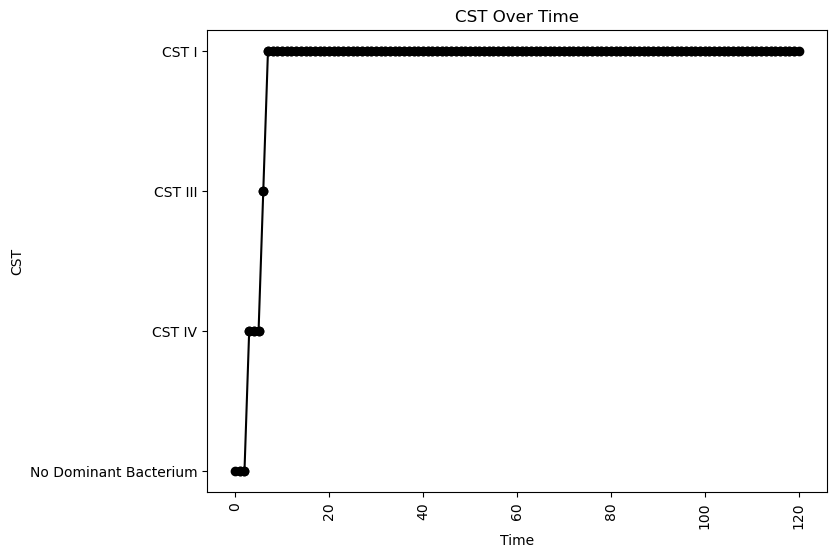


Interaction Parameters:
nAB Growth: 2.286323001067126
Li Growth: 0.060377934648291574
oLB Growth: 0.14091260068383374
nAB Self: -0.012859397170435924
nAB->Li: -0.1060761646094936
nAB->oLB: -0.2681067474401688
Li->nAB: 0.3971922172261385
Li Self: -0.07245157745196733
Li->oLB: 0.015600819838509361
oLB->nAB: -0.2583248564084728
oLB->Li: 0.41522074517647956
oLB Self: -0.060358858731757906

Simulation 174 follows a valid CST progression:


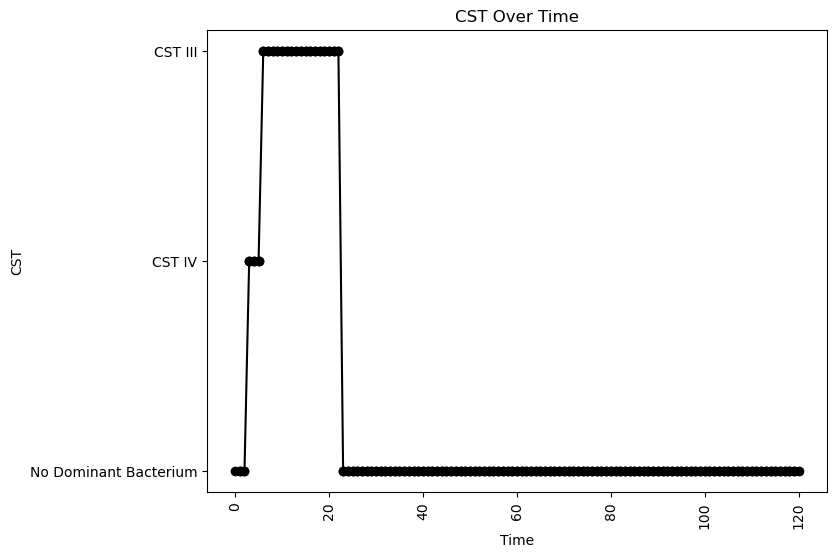


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.01555789683106347
nAB->Li: 0.05605406361609844
nAB->oLB: -0.1652983478239029
Li->nAB: 0.4162977276333649
Li Self: -0.003570819660481006
Li->oLB: -0.12877442872599443
oLB->nAB: -0.3405534122669907
oLB->Li: -0.35317637805157653
oLB Self: -0.034769420474091886

Simulation 175 follows a valid CST progression:


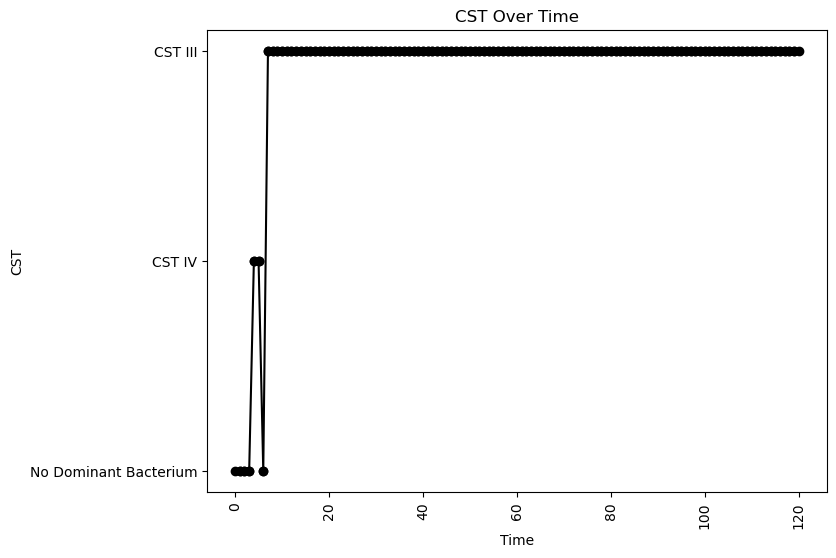


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.08204605404684745
nAB->Li: 0.12214576934837795
nAB->oLB: -0.33270453999814287
Li->nAB: 0.2728684458400099
Li Self: -0.08536908798114953
Li->oLB: -0.37935806692262297
oLB->nAB: -0.3154804937605696
oLB->Li: -0.0014865730919316755
oLB Self: -0.09126254873534095

Simulation 189 follows a valid CST progression:


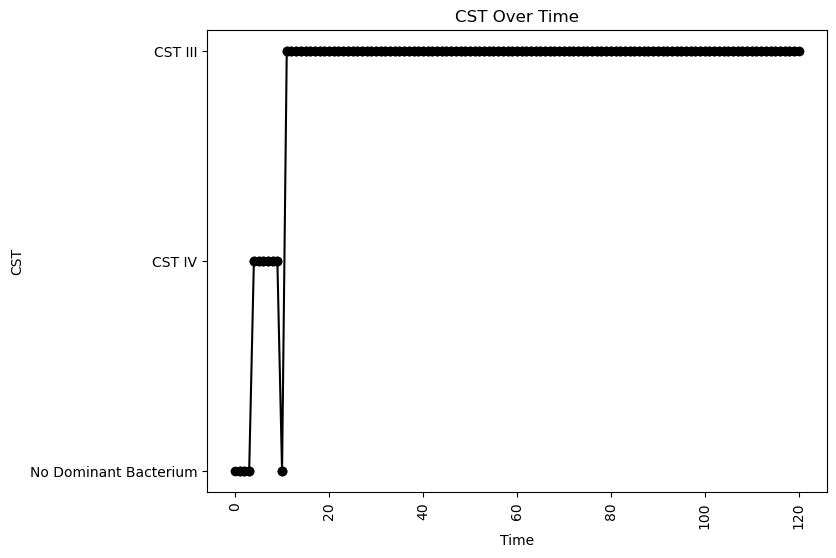


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.042671652310753275
nAB->Li: 0.02384354227204577
nAB->oLB: -0.2405115423617396
Li->nAB: 0.03437037040743407
Li Self: -0.01116949043693262
Li->oLB: 0.100367542038859
oLB->nAB: -0.4281293559209212
oLB->Li: 0.183217577324422
oLB Self: -0.08305634486351461

Simulation 193 follows a valid CST progression:


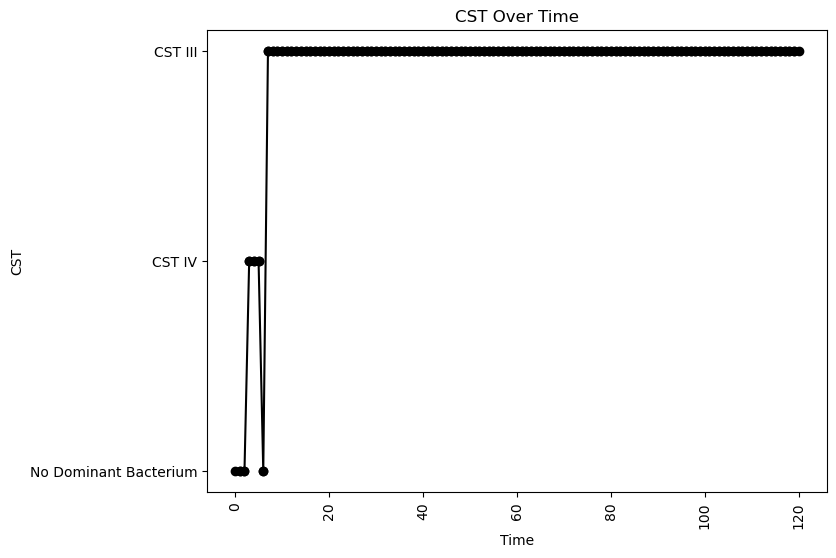


Interaction Parameters:
nAB Growth: 2.0745101401728236
Li Growth: 0.010341045972876578
oLB Growth: 1.1507970527071554
nAB Self: -0.018131319117033598
nAB->Li: -0.1711118198568713
nAB->oLB: -0.14500809742780763
Li->nAB: 0.18710836685879872
Li Self: -0.010788082877941224
Li->oLB: -0.08166811040735
oLB->nAB: -0.2464114011027937
oLB->Li: -0.1922450864402619
oLB Self: -0.05228537261770726

Simulation 194 follows a valid CST progression:


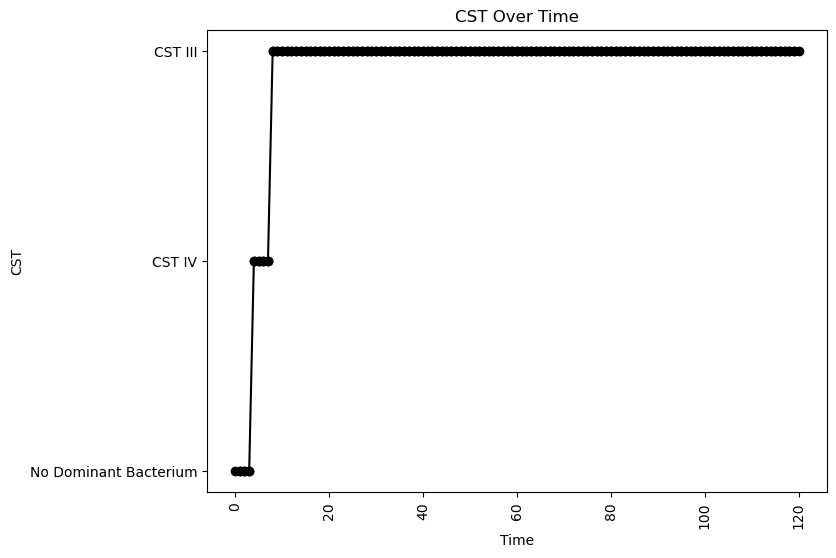


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.03837725110012093
oLB Growth: 1.155917868199191
nAB Self: -0.047718048775835
nAB->Li: -0.30950235274907933
nAB->oLB: -0.45478239474315724
Li->nAB: 0.16168445214710192
Li Self: -0.021083312434340834
Li->oLB: -0.29337844958509474
oLB->nAB: -0.40789049331093585
oLB->Li: -0.11846396101707335
oLB Self: -0.07321827966185514

Simulation 200 follows a valid CST progression:


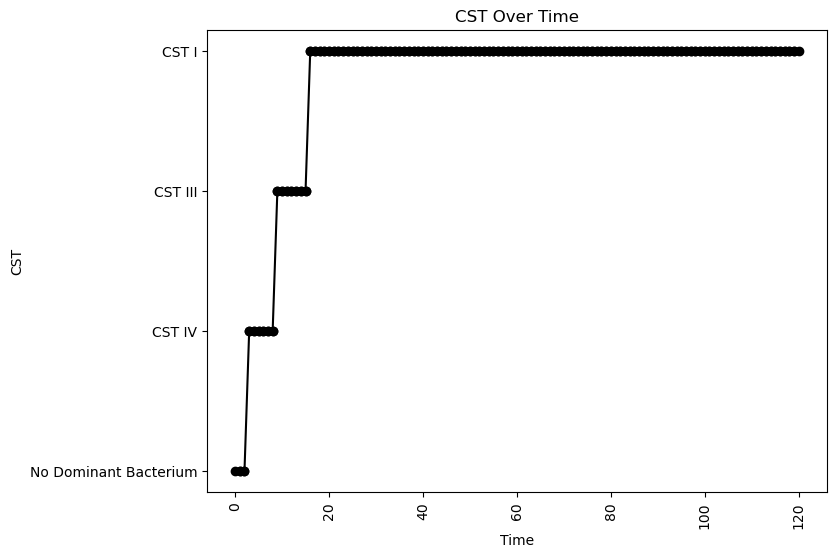


Interaction Parameters:
nAB Growth: 2.0745101401728236
Li Growth: 0.010341045972876578
oLB Growth: 1.1507970527071554
nAB Self: -0.021879586553261984
nAB->Li: -0.43177904132051165
nAB->oLB: -0.4273554352701777
Li->nAB: 0.17110162312185173
Li Self: -0.05655698646276134
Li->oLB: -0.3881125697568364
oLB->nAB: -0.22406063653810043
oLB->Li: 0.16963805687374978
oLB Self: -0.01769319726066057

Simulation 203 follows a valid CST progression:


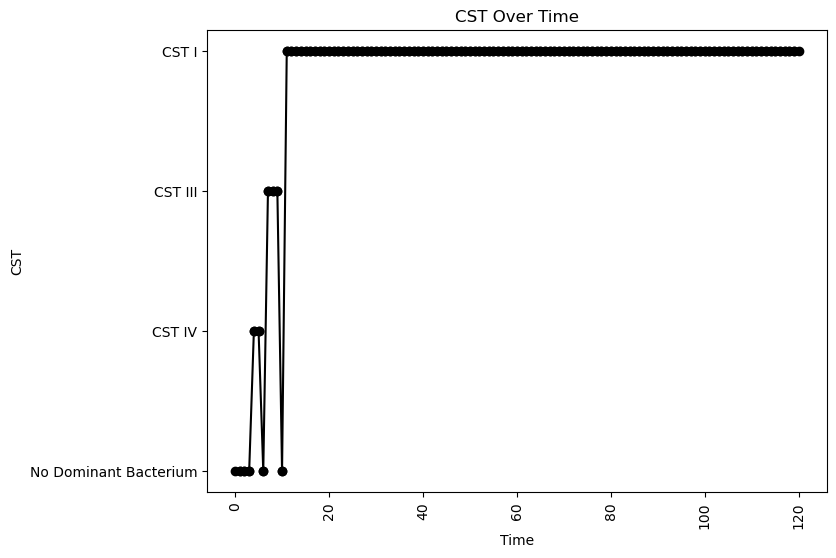


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.09662106860557675
oLB Growth: 0.595997418302585
nAB Self: -0.018872954794267885
nAB->Li: -0.41901617710667094
nAB->oLB: -0.0345188171291918
Li->nAB: 0.1833156900493329
Li Self: -0.07941896125588543
Li->oLB: 0.03514010854388916
oLB->nAB: -0.3412451942507121
oLB->Li: 0.34080663146970713
oLB Self: -0.001063872026974555

Simulation 206 follows a valid CST progression:


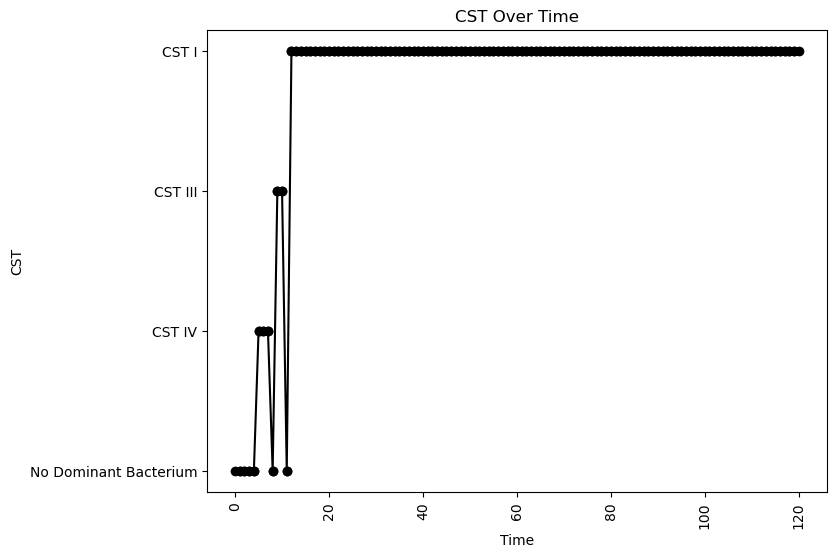


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.02722630277126782
nAB->Li: -0.2420993972292534
nAB->oLB: -0.453820754380094
Li->nAB: 0.12333279438200817
Li Self: -0.08200316590262814
Li->oLB: 0.06661931666224408
oLB->nAB: -0.09047125201279133
oLB->Li: 0.22065691929402043
oLB Self: -0.08360923718513545

Simulation 210 follows a valid CST progression:


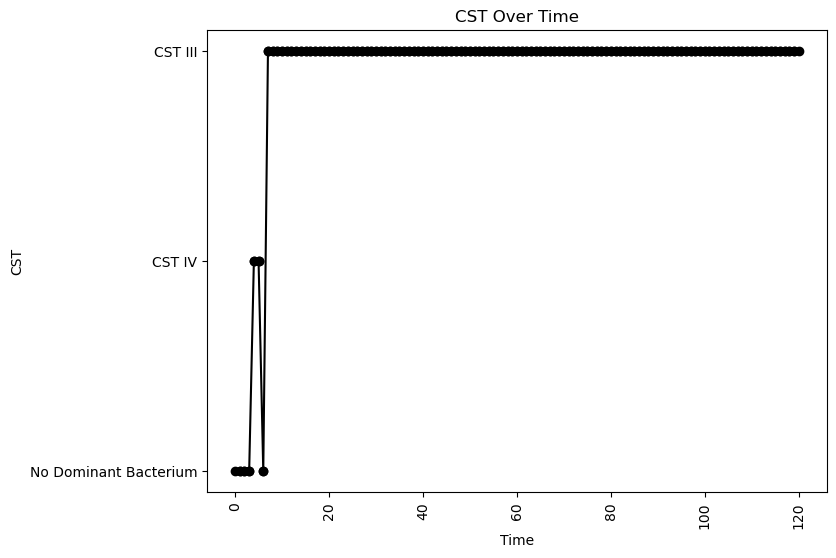


Interaction Parameters:
nAB Growth: 2.172057972480792
Li Growth: 0.05464936187495586
oLB Growth: 1.1816194682992254
nAB Self: -0.05013440160582452
nAB->Li: -0.4727539981717768
nAB->oLB: -0.03165420668180002
Li->nAB: 0.34005701021704415
Li Self: -0.06271496532382477
Li->oLB: 0.36662309448148866
oLB->nAB: -0.30609418989277265
oLB->Li: -0.46847431516682847
oLB Self: -0.03690656675105808

Simulation 212 follows a valid CST progression:


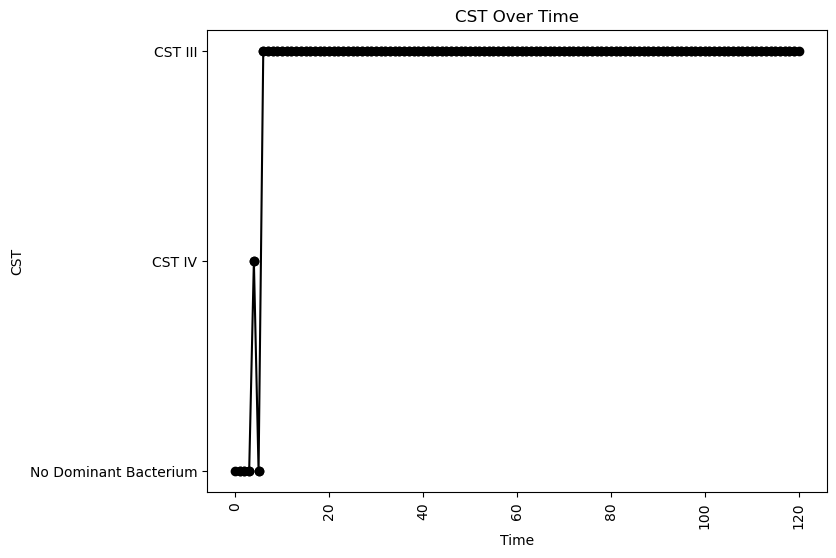


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.0692558790189321
nAB->Li: -0.23663782995695065
nAB->oLB: -0.2580354608371663
Li->nAB: 0.31949196131681146
Li Self: -0.033672806658981175
Li->oLB: 0.43379926787974643
oLB->nAB: -0.0513202410651426
oLB->Li: -0.1189169387682022
oLB Self: -0.09524470701186298

Simulation 214 follows a valid CST progression:


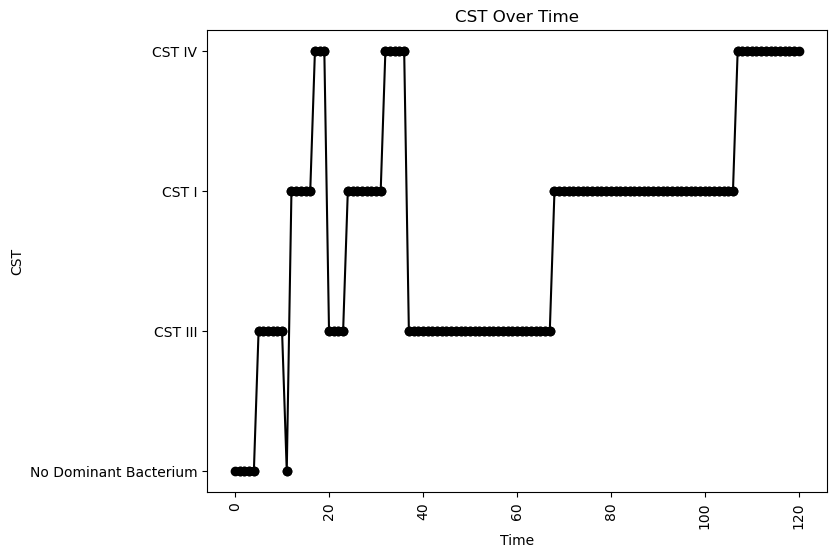


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.3888698227559293
oLB Growth: 0.08496126009849418
nAB Self: -0.05821510846730357
nAB->Li: -0.46632797330760795
nAB->oLB: -0.02534439663085042
Li->nAB: 0.4080172346092139
Li Self: -0.058280197190542365
Li->oLB: -0.48083898491815297
oLB->nAB: -0.48909948993602015
oLB->Li: 0.143062295152795
oLB Self: -0.04915054887247641

Simulation 216 follows a valid CST progression:


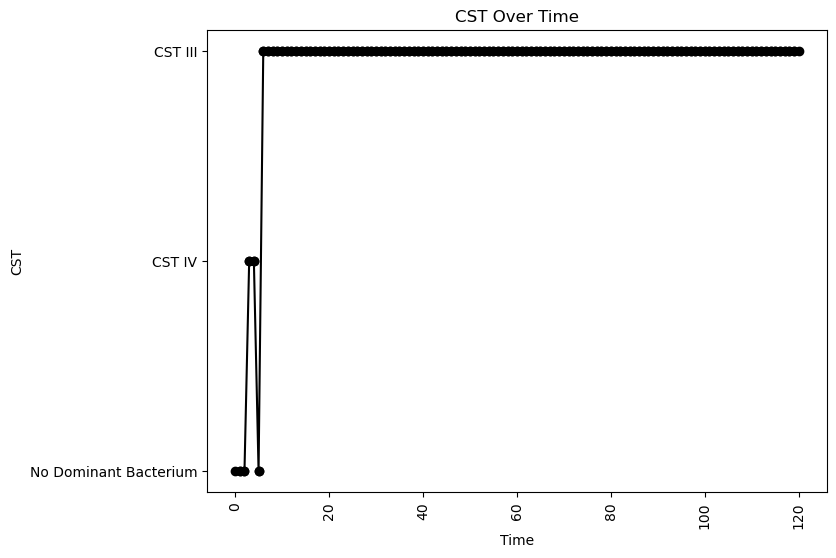


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.04195658296865661
nAB->Li: -0.07184429633691747
nAB->oLB: -0.2336796862260136
Li->nAB: 0.4279107850294217
Li Self: -0.07433777660080199
Li->oLB: -0.05308806005373978
oLB->nAB: -0.4303078211409512
oLB->Li: -0.16234020732324322
oLB Self: -0.02661358917527594

Simulation 220 follows a valid CST progression:


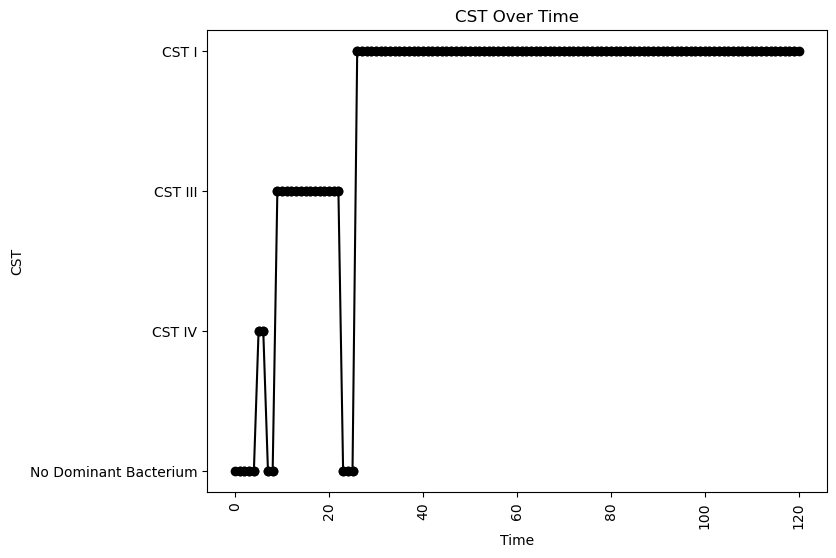


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.06309763455319839
oLB Growth: 0.9128027925042091
nAB Self: -0.09313815083959384
nAB->Li: -0.14041285223221922
nAB->oLB: -0.3239688721912051
Li->nAB: 0.19341111471046102
Li Self: -0.09203871202440318
Li->oLB: -0.16206214275898395
oLB->nAB: -0.3194827582739993
oLB->Li: 0.12611104968560805
oLB Self: -0.02312499858656175

Simulation 222 follows a valid CST progression:


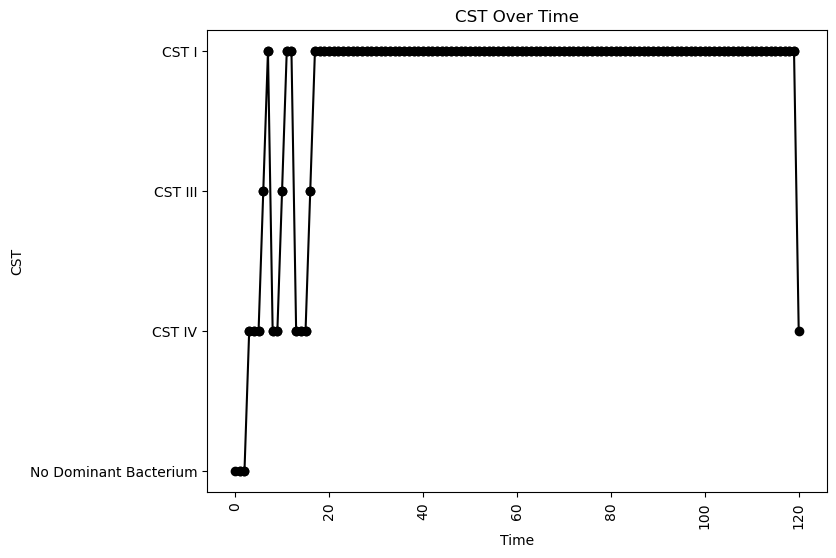


Interaction Parameters:
nAB Growth: 2.2489702826927647
Li Growth: 0.10624287251237467
oLB Growth: 0.24213610993368434
nAB Self: -0.006263584279589077
nAB->Li: -0.03754345482426369
nAB->oLB: -0.04636175969015788
Li->nAB: 0.23762607531234992
Li Self: -0.03268548341780084
Li->oLB: -0.23942786162447377
oLB->nAB: -0.44700598724544516
oLB->Li: 0.45968999843395597
oLB Self: -0.016838507198223857

Simulation 223 follows a valid CST progression:


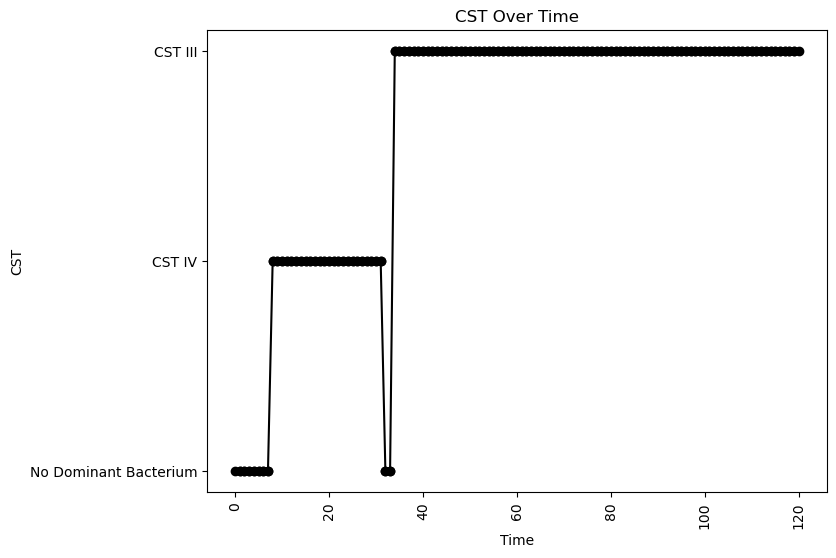


Interaction Parameters:
nAB Growth: 2.1573635369289432
Li Growth: 0.04215849674910016
oLB Growth: 1.2503024394854367
nAB Self: -0.05025912503650871
nAB->Li: -0.386649580536792
nAB->oLB: -0.39245899485401875
Li->nAB: -0.03458508058132592
Li Self: -0.09840057276301571
Li->oLB: 0.46958409956010383
oLB->nAB: -0.1382984623788806
oLB->Li: -0.14880817536028607
oLB Self: -0.07015170503791188

Simulation 227 follows a valid CST progression:


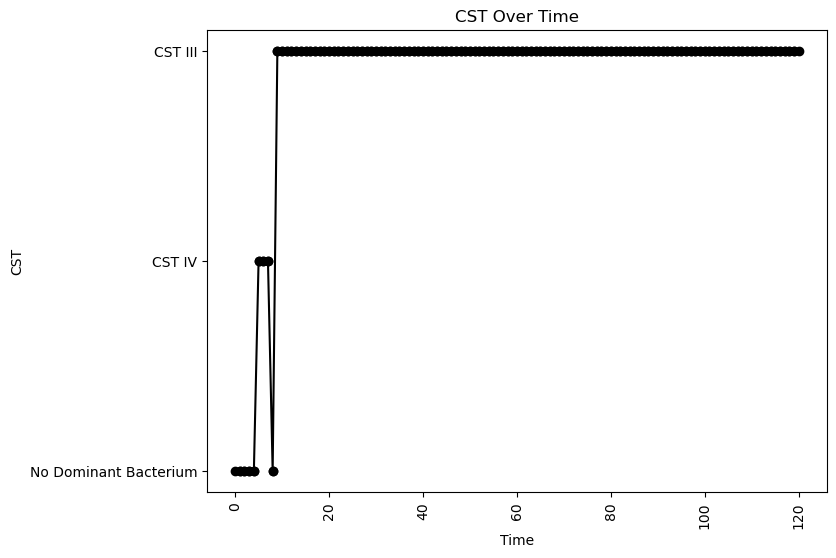


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.03873714597780806
nAB->Li: -0.3396593374572191
nAB->oLB: -0.21042486288819928
Li->nAB: 0.12947091326212945
Li Self: -0.02451874203689007
Li->oLB: 0.24190124457909523
oLB->nAB: -0.2382227458085281
oLB->Li: -0.3357035303087185
oLB Self: -0.0017796663057565443

Simulation 231 follows a valid CST progression:


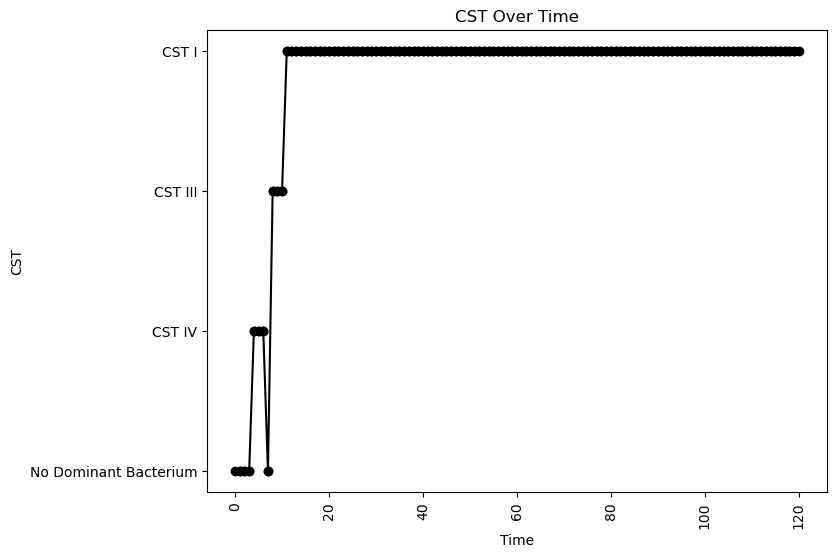


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.0649460037187935
oLB Growth: 0.46591620920123267
nAB Self: -0.09695498816242058
nAB->Li: 0.041848768887270404
nAB->oLB: -0.15733254913715267
Li->nAB: 0.15508091012864833
Li Self: -0.07248752083850254
Li->oLB: 0.19478604391965193
oLB->nAB: -0.4846676456523887
oLB->Li: 0.2859549058052232
oLB Self: -0.0020050825985578474

Simulation 234 follows a valid CST progression:


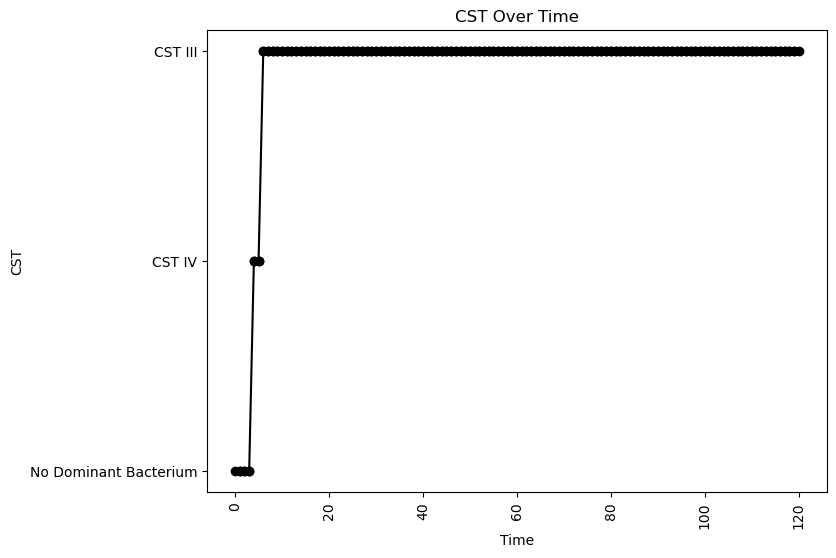


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.013316797989712734
nAB->Li: 0.008098373515550428
nAB->oLB: -0.2830966476307911
Li->nAB: 0.20904427094186784
Li Self: -0.008732916318929418
Li->oLB: 0.015071150816487466
oLB->nAB: -0.2388284298428563
oLB->Li: -0.3564117195847605
oLB Self: -0.06978366879251767

Simulation 238 follows a valid CST progression:


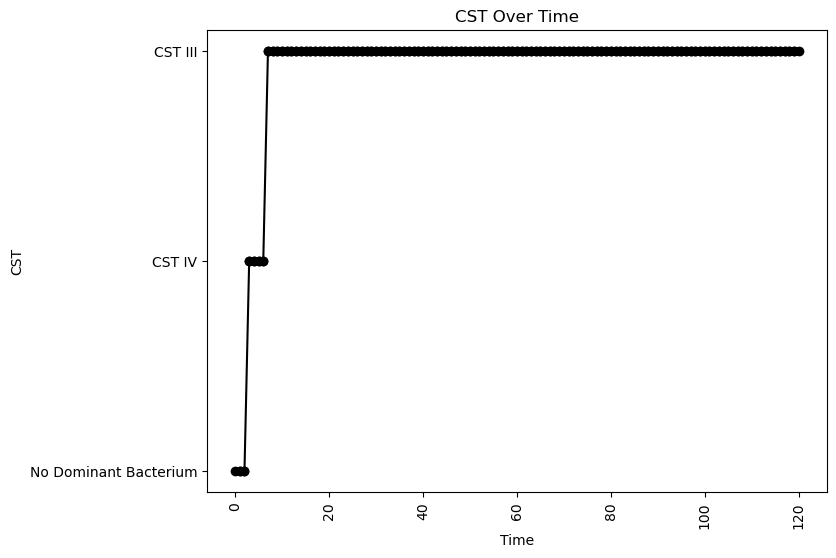


Interaction Parameters:
nAB Growth: 2.0745101401728236
Li Growth: 0.010341045972876578
oLB Growth: 1.1507970527071554
nAB Self: -0.034221736211407866
nAB->Li: -0.18868068237757496
nAB->oLB: -0.35887867178150634
Li->nAB: 0.303865169684562
Li Self: -0.05382307047175271
Li->oLB: -0.48701290296332744
oLB->nAB: -0.3768344021730953
oLB->Li: -0.4458988198491037
oLB Self: -0.08692485965735229

Simulation 239 follows a valid CST progression:


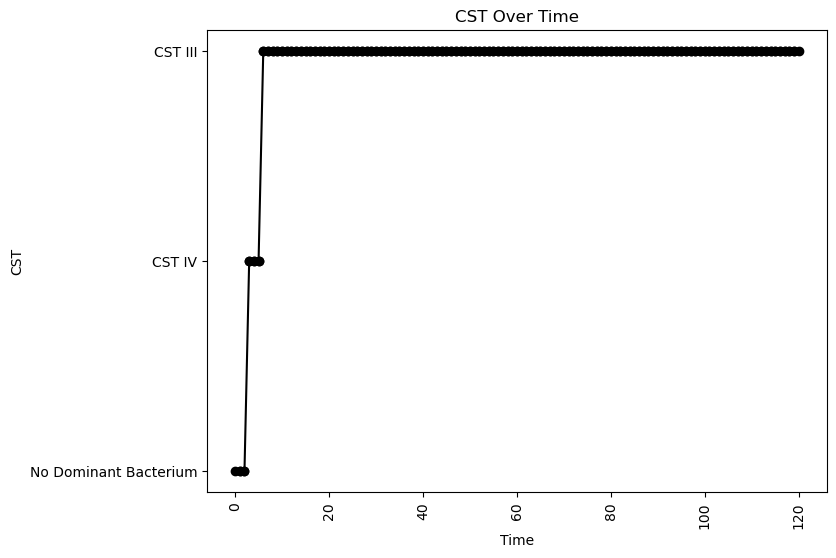


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.008685974850539985
nAB->Li: -0.2765223067057617
nAB->oLB: -0.07951610480711419
Li->nAB: 0.23120819767236533
Li Self: -0.019278675684381102
Li->oLB: 0.43605976215781883
oLB->nAB: -0.009293527518716316
oLB->Li: 0.14718126842964008
oLB Self: -0.05681211397969523

Simulation 241 follows a valid CST progression:


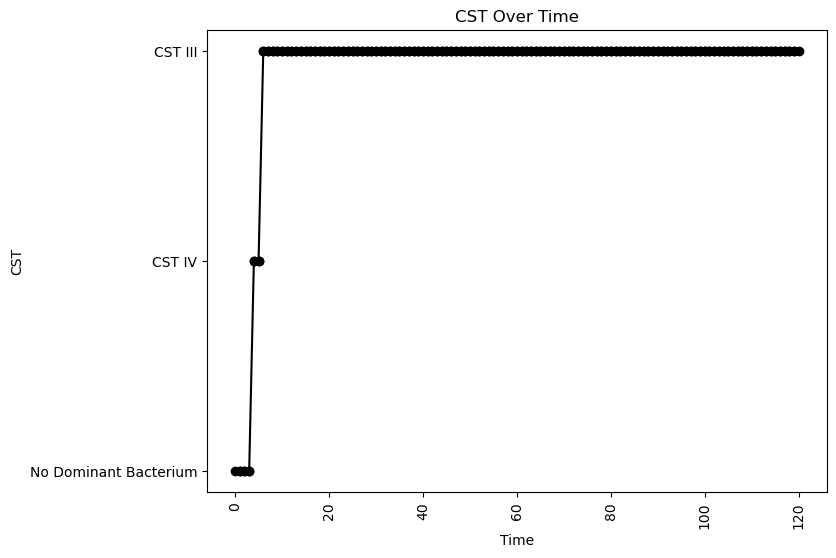


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.06806014290478743
oLB Growth: 0.20414555748463747
nAB Self: -0.006778915991128412
nAB->Li: -0.028864206289509975
nAB->oLB: -0.34520777235204925
Li->nAB: 0.46213500688720277
Li Self: -0.08684823431109097
Li->oLB: -0.3433023865245361
oLB->nAB: -0.403606350118686
oLB->Li: -0.4041036266297571
oLB Self: -0.04491582549068156

Simulation 245 follows a valid CST progression:


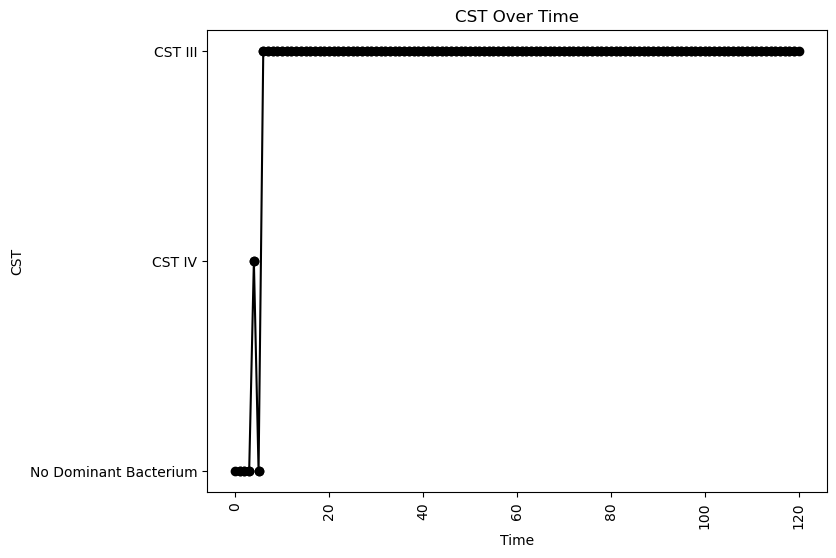


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.013688314792663192
nAB->Li: -0.12400637500350364
nAB->oLB: -0.06181450419030521
Li->nAB: 0.40616209989132257
Li Self: -0.04872395847832894
Li->oLB: -0.27608611749680095
oLB->nAB: -0.0010129061067380984
oLB->Li: -0.08766912801559085
oLB Self: -0.03452520460067321

Simulation 249 follows a valid CST progression:


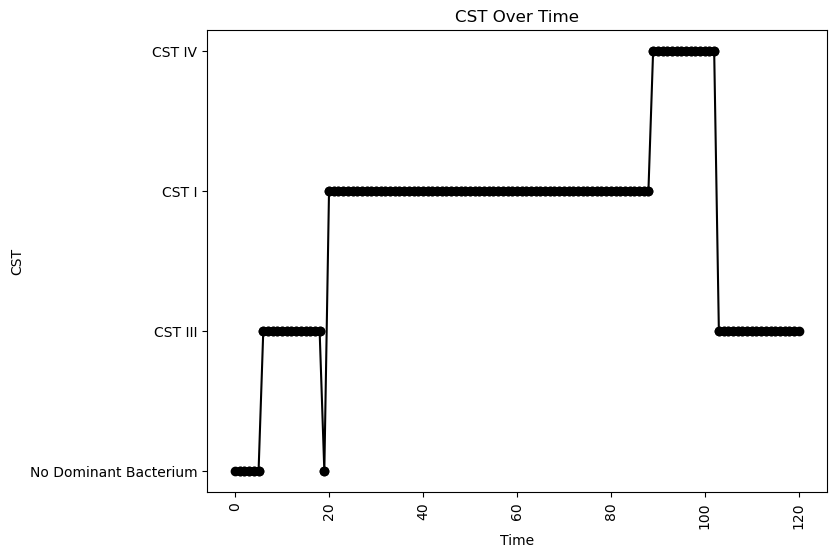


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.30125792820773856
oLB Growth: 0.1731103059651596
nAB Self: -0.04079357822315064
nAB->Li: -0.44442473651572834
nAB->oLB: -0.16877944205314088
Li->nAB: 0.2643790343115422
Li Self: -0.06498395575927335
Li->oLB: -0.22413863216296676
oLB->nAB: -0.38618735383852215
oLB->Li: 0.07877390497037029
oLB Self: -0.06131271179431056

Simulation 252 follows a valid CST progression:


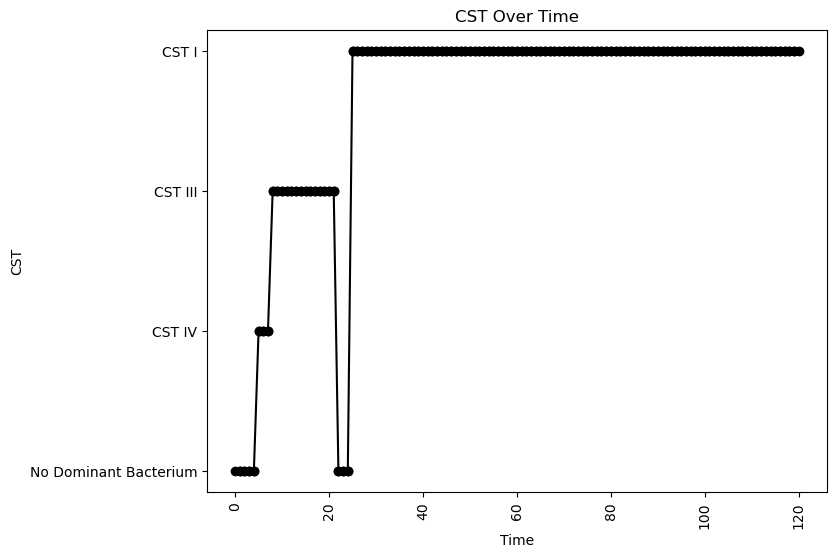


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.03466210805563448
nAB->Li: -0.4348126956330085
nAB->oLB: -0.24233995750137194
Li->nAB: 0.22470649525515007
Li Self: -0.08505677944333813
Li->oLB: -0.03841192357307499
oLB->nAB: -0.0865163098480134
oLB->Li: -0.016867345410018608
oLB Self: -0.049562832708660506

Simulation 254 follows a valid CST progression:


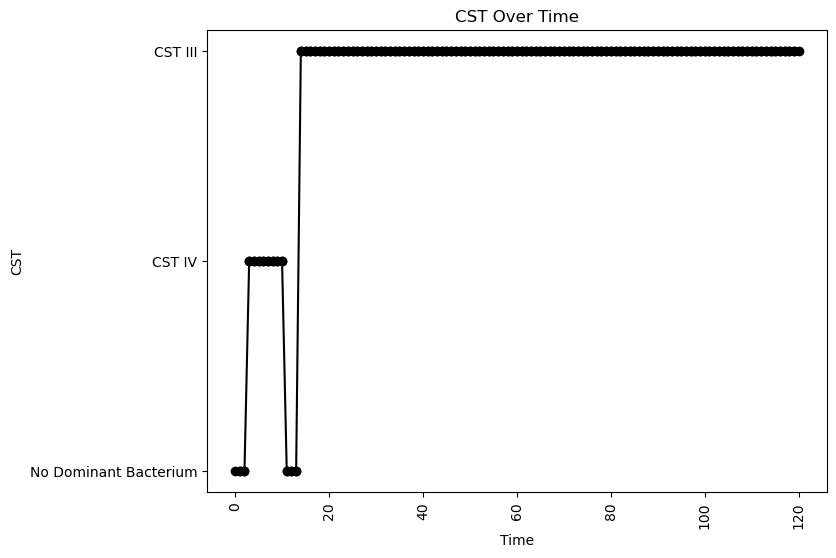


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.05186306872853323
nAB->Li: -0.15914343375469414
nAB->oLB: -0.17077212106716133
Li->nAB: 0.026741081342909645
Li Self: -0.01879403538115658
Li->oLB: 0.111248903807728
oLB->nAB: -0.3214912034291365
oLB->Li: -0.05338214130093849
oLB Self: -0.09108008263333642

Simulation 269 follows a valid CST progression:


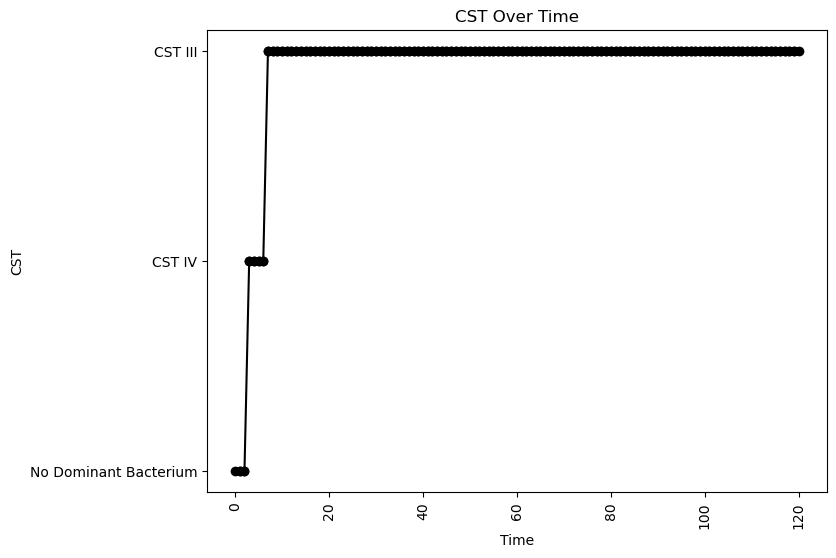


Interaction Parameters:
nAB Growth: 2.237390108639889
Li Growth: 0.07509700685781084
oLB Growth: 0.33048149496262014
nAB Self: -0.03625020471812715
nAB->Li: 0.056630473126560776
nAB->oLB: -0.3531278667800842
Li->nAB: 0.2759030550511188
Li Self: -0.0646680136733279
Li->oLB: -0.31279322105362056
oLB->nAB: -0.09450680824231361
oLB->Li: -0.2257615706783792
oLB Self: -0.07436725065793444

Simulation 276 follows a valid CST progression:


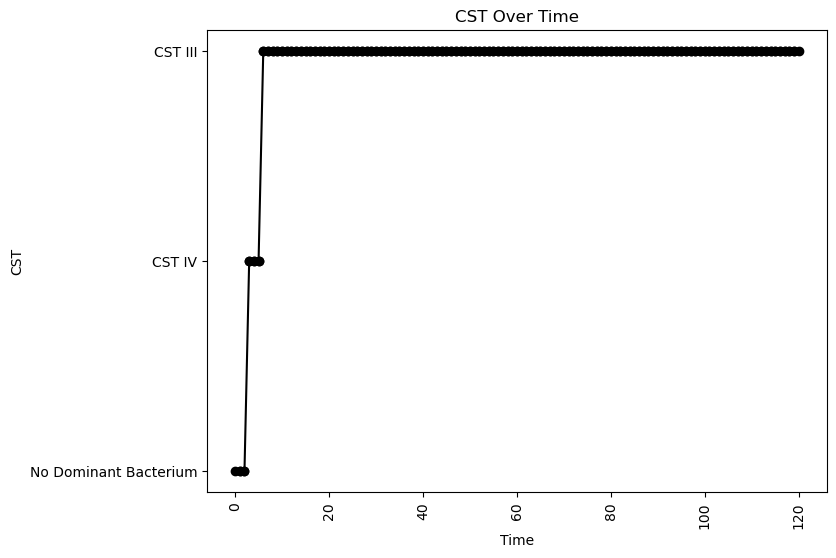


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.00828184266690847
nAB->Li: 0.05458615902967323
nAB->oLB: -0.008207165554114326
Li->nAB: 0.37270858795688533
Li Self: -0.03521819430614827
Li->oLB: 0.13311067177275737
oLB->nAB: -0.3549595001710497
oLB->Li: -0.12963103834320427
oLB Self: -0.04864653872492383

Simulation 288 follows a valid CST progression:


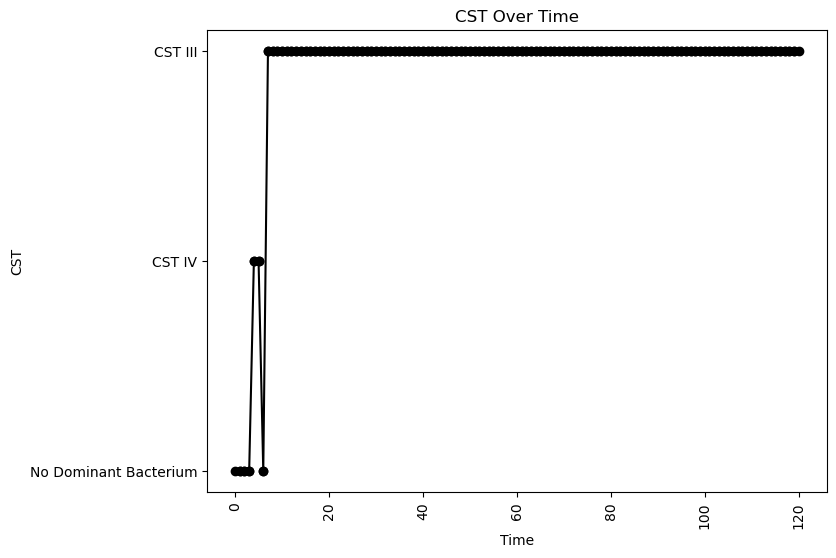


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.014087870480576387
nAB->Li: -0.2562791737980093
nAB->oLB: -0.08642275346019529
Li->nAB: 0.24346906779387734
Li Self: -0.05588271257396254
Li->oLB: 0.05262898166512475
oLB->nAB: -0.09298453133952261
oLB->Li: -0.31782730145691673
oLB Self: -0.07865435880379319

Simulation 309 follows a valid CST progression:


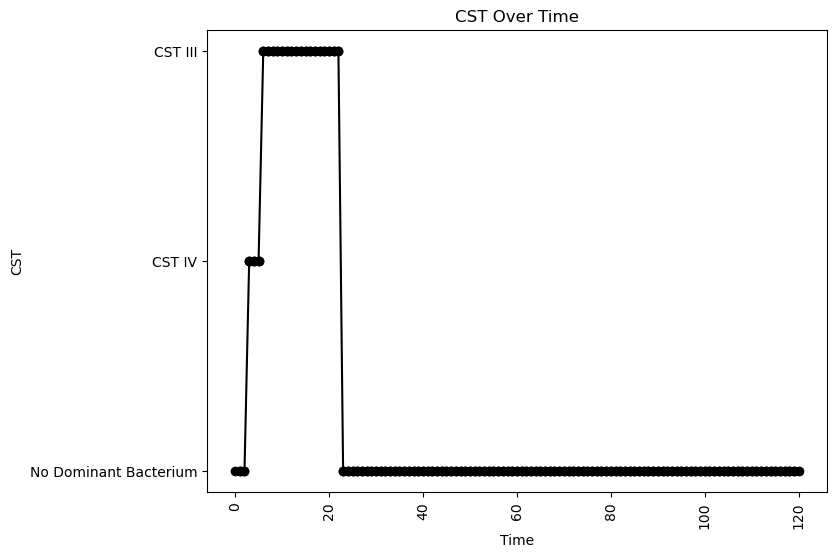


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.06309763455319839
oLB Growth: 0.9128027925042091
nAB Self: -0.09413213862243265
nAB->Li: 0.13484199517599882
nAB->oLB: -0.010397447462102083
Li->nAB: 0.1930917362338287
Li Self: -0.038247895519576705
Li->oLB: 0.31640033726772765
oLB->nAB: -0.02692991352078583
oLB->Li: -0.3791960248032825
oLB Self: -0.07335798438244603

Simulation 315 follows a valid CST progression:


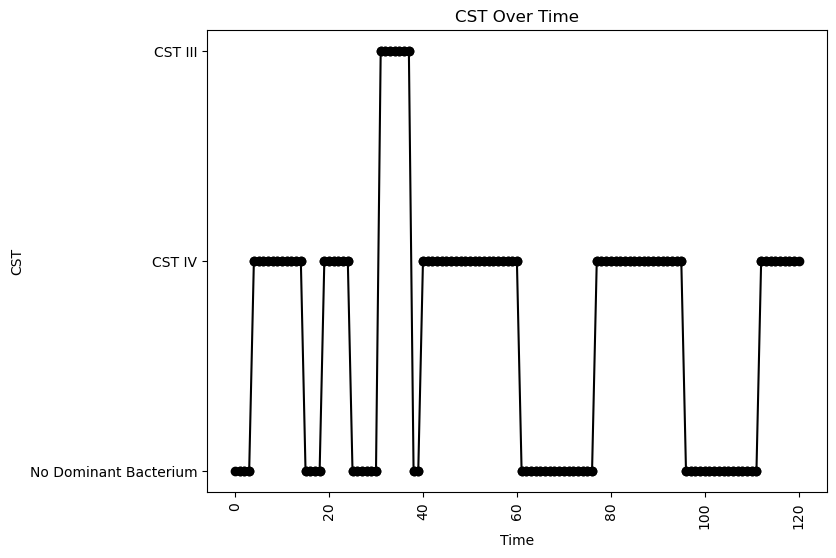


Interaction Parameters:
nAB Growth: 2.1573635369289432
Li Growth: 0.04215849674910016
oLB Growth: 1.2503024394854367
nAB Self: -0.01525692184243152
nAB->Li: -0.14480644279933824
nAB->oLB: -0.11460395215361507
Li->nAB: 0.04934833087840029
Li Self: -0.09858441370981791
Li->oLB: 0.3133997975515014
oLB->nAB: -0.32206487744671797
oLB->Li: 0.10978865164608553
oLB Self: -0.008201993057212642

Simulation 316 follows a valid CST progression:


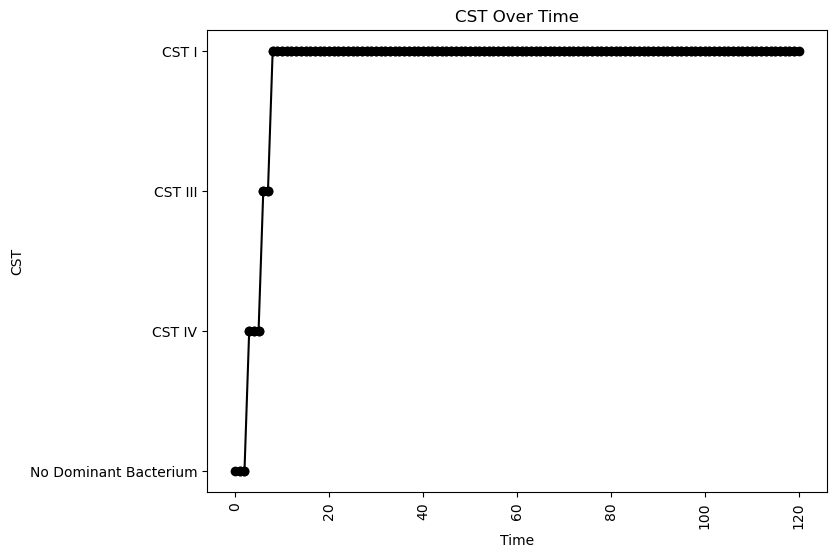


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.03854296791069035
nAB->Li: -0.3072971890196111
nAB->oLB: -0.2972056323830595
Li->nAB: 0.389340699719281
Li Self: -0.04815777264583145
Li->oLB: -0.17115227657919013
oLB->nAB: -0.03386003146129757
oLB->Li: 0.2038936556878327
oLB Self: -0.0140118107724541

Simulation 317 follows a valid CST progression:


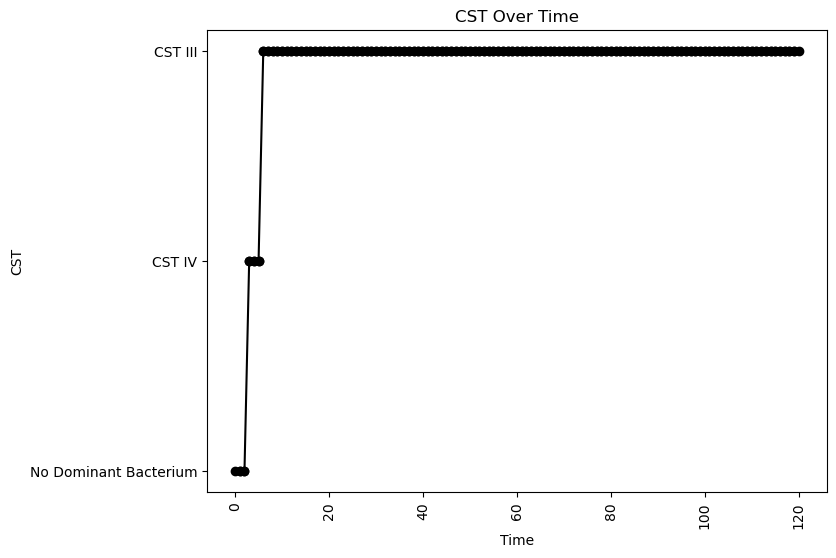


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.07169791450796581
nAB->Li: 0.179257818942812
nAB->oLB: -0.20538041989064781
Li->nAB: 0.35648101944987043
Li Self: -0.06908467365518618
Li->oLB: -0.4778418240330216
oLB->nAB: -0.48199018715831765
oLB->Li: 0.23524134320357448
oLB Self: -0.03607402022676093

Simulation 320 follows a valid CST progression:


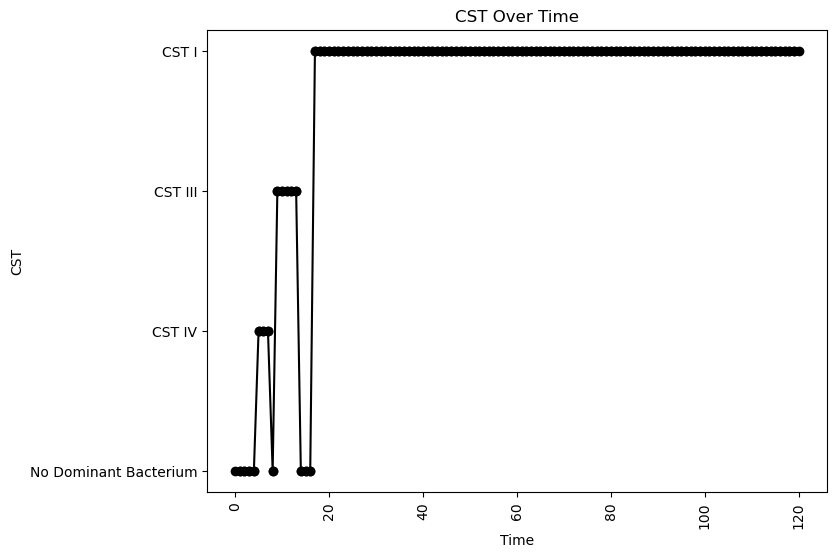


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.07005099689260363
oLB Growth: 0.20414555748463747
nAB Self: -0.05126200377193115
nAB->Li: -0.4019314576797508
nAB->oLB: -0.44889175422018235
Li->nAB: 0.13971908257246124
Li Self: -0.09703804764182741
Li->oLB: -0.2424937635017368
oLB->nAB: -0.22515820573413864
oLB->Li: 0.2664828088494605
oLB Self: -0.09431015080715462

Simulation 324 follows a valid CST progression:


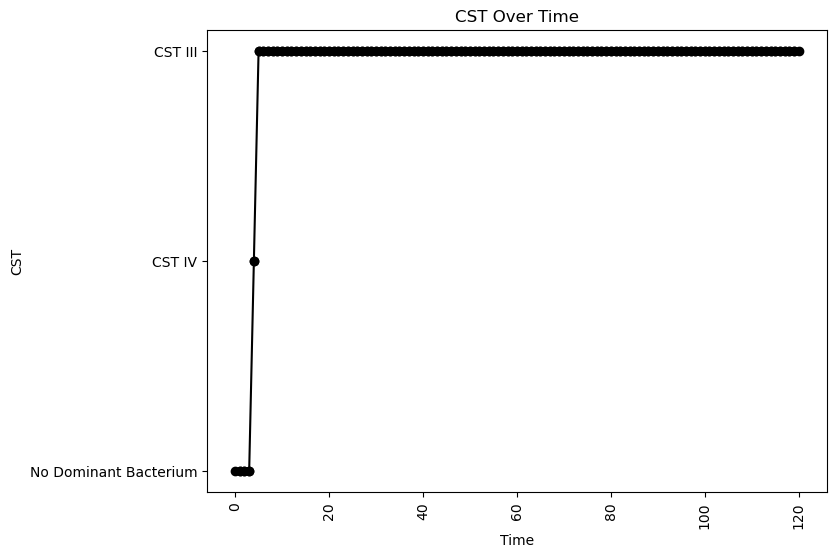


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.06338113107791749
oLB Growth: 0.8024693458968353
nAB Self: -0.06985934543237965
nAB->Li: 0.05212448685931548
nAB->oLB: -0.3070084771396079
Li->nAB: 0.45702757085819745
Li Self: -0.0861254623201133
Li->oLB: -0.03715450910898238
oLB->nAB: -0.46745267451371836
oLB->Li: -0.1534617766606191
oLB Self: -0.0645587864550986

Simulation 325 follows a valid CST progression:


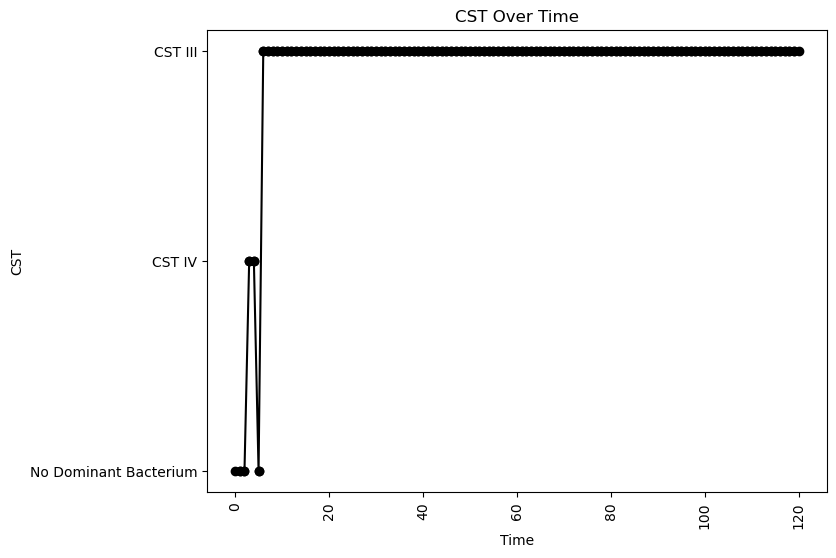


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.049598722897486104
nAB->Li: -0.22742244590437705
nAB->oLB: -0.29181493327449204
Li->nAB: 0.3477956159751705
Li Self: -0.0927599395190826
Li->oLB: 0.21549333126717418
oLB->nAB: -0.4277417911875487
oLB->Li: -0.42444689135263003
oLB Self: -0.029364912056108305

Simulation 328 follows a valid CST progression:


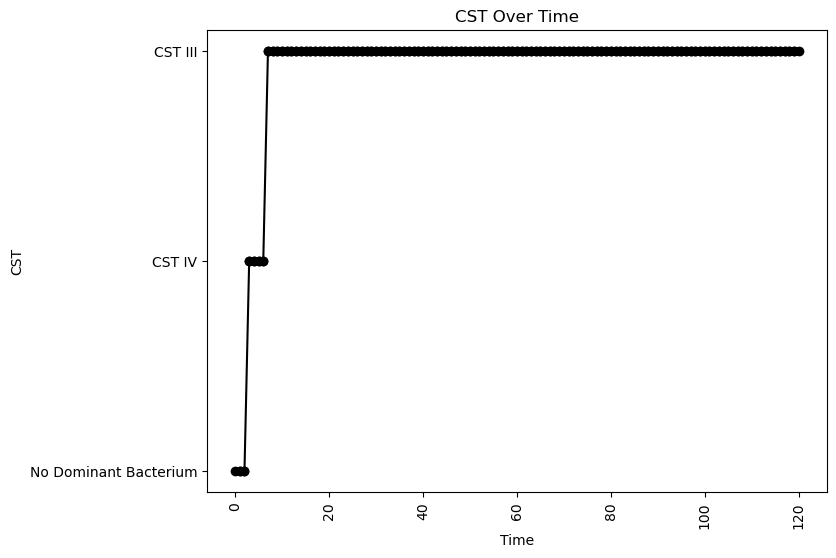


Interaction Parameters:
nAB Growth: 2.300652803872004
Li Growth: 0.06616501714537036
oLB Growth: 0.4369767544558836
nAB Self: -0.03335262214757559
nAB->Li: -0.035286275085833985
nAB->oLB: -0.42508420560968985
Li->nAB: 0.2397978931156316
Li Self: -0.05113110547611427
Li->oLB: -0.034641339452802955
oLB->nAB: -0.31809431440690505
oLB->Li: -0.42976765094888414
oLB Self: -0.07007673262967845

Simulation 330 follows a valid CST progression:


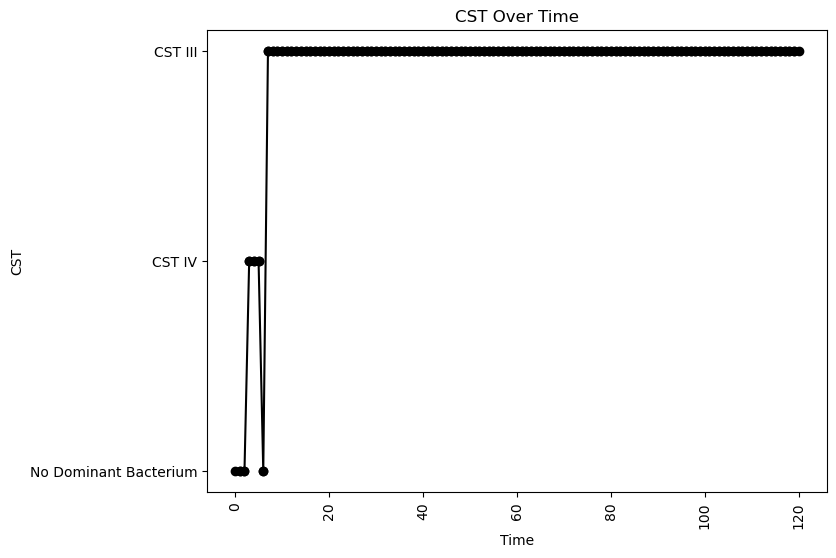


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.09637327361444242
nAB->Li: 0.09386018023248976
nAB->oLB: -0.27191758305791647
Li->nAB: 0.22008392011455602
Li Self: -0.09063100013325982
Li->oLB: -0.09757275253610759
oLB->nAB: -0.1343742689819895
oLB->Li: -0.3075240287649808
oLB Self: -0.021366968464210684

Simulation 332 follows a valid CST progression:


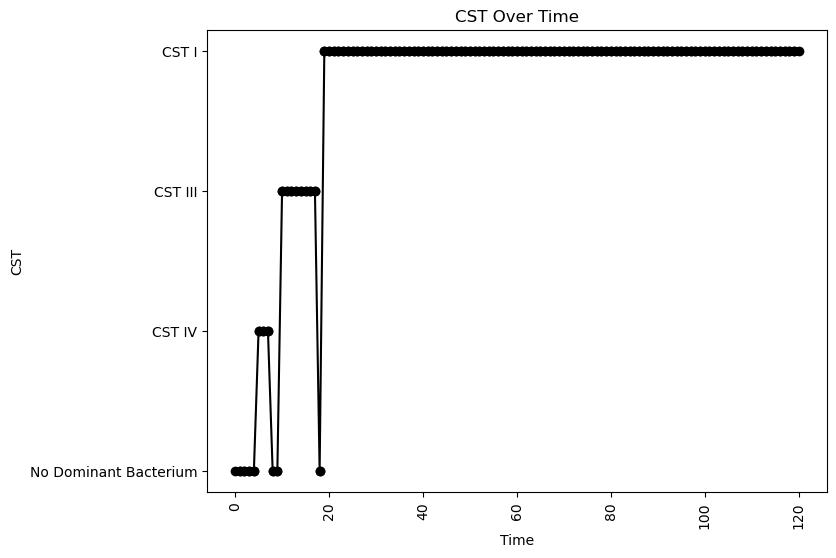


Interaction Parameters:
nAB Growth: 2.1573635369289432
Li Growth: 0.04215849674910016
oLB Growth: 1.2503024394854367
nAB Self: -0.05122507044789986
nAB->Li: -0.2937239149209606
nAB->oLB: -0.49534158393032396
Li->nAB: 0.19045116414847008
Li Self: -0.06533556145541666
Li->oLB: -0.36840391521622196
oLB->nAB: -0.3713924155552391
oLB->Li: 0.14115242848419662
oLB Self: -0.09279747478723187

Simulation 336 follows a valid CST progression:


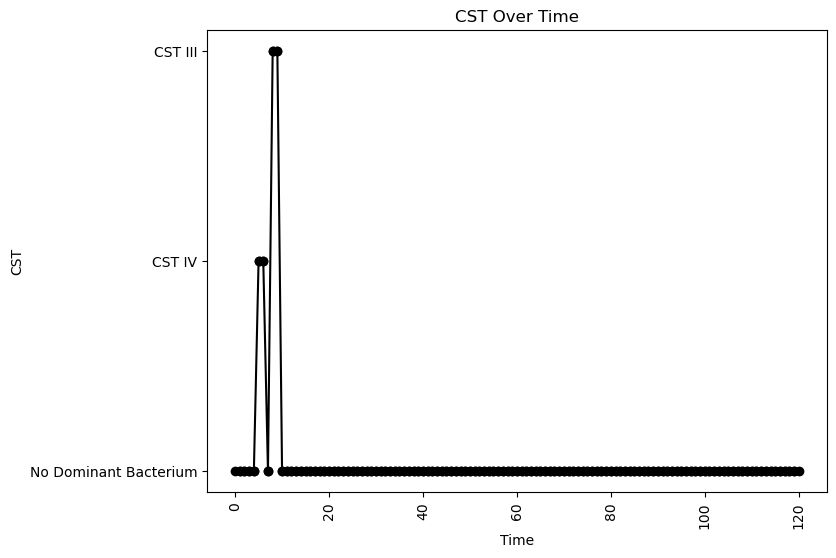


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.05072073600009906
oLB Growth: 1.0858755226067296
nAB Self: -0.04493464196407929
nAB->Li: -0.3029094472722221
nAB->oLB: -0.3213636446936231
Li->nAB: 0.1849630974021086
Li Self: -0.012155760847005884
Li->oLB: 0.2592911399994453
oLB->nAB: -0.2878329795008584
oLB->Li: 0.2809914214486562
oLB Self: -0.004606264752597969

Simulation 337 follows a valid CST progression:


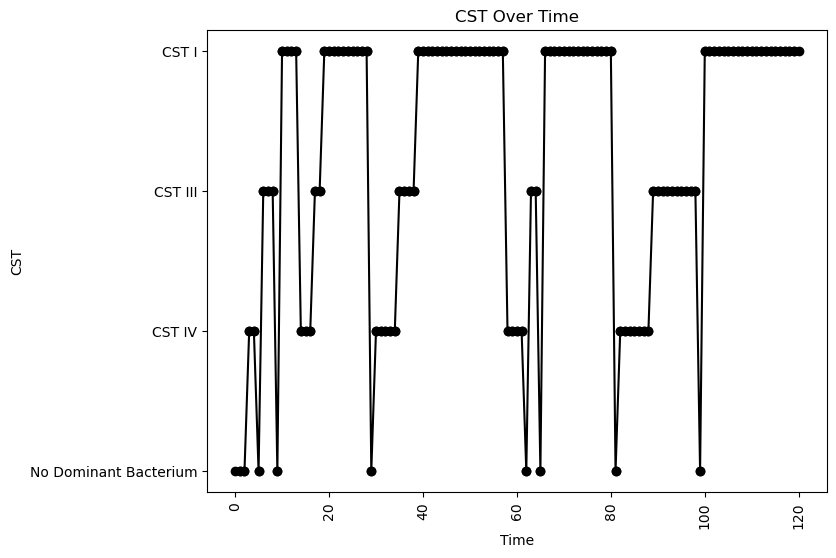


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.09671838122664213
nAB->Li: -0.3061965590744056
nAB->oLB: -0.10145986593617567
Li->nAB: 0.47268937246535825
Li Self: -0.018749636686505505
Li->oLB: -0.4059893459957031
oLB->nAB: -0.39731862194379874
oLB->Li: 0.19839375893185807
oLB Self: -0.09018092207650799

Simulation 344 follows a valid CST progression:


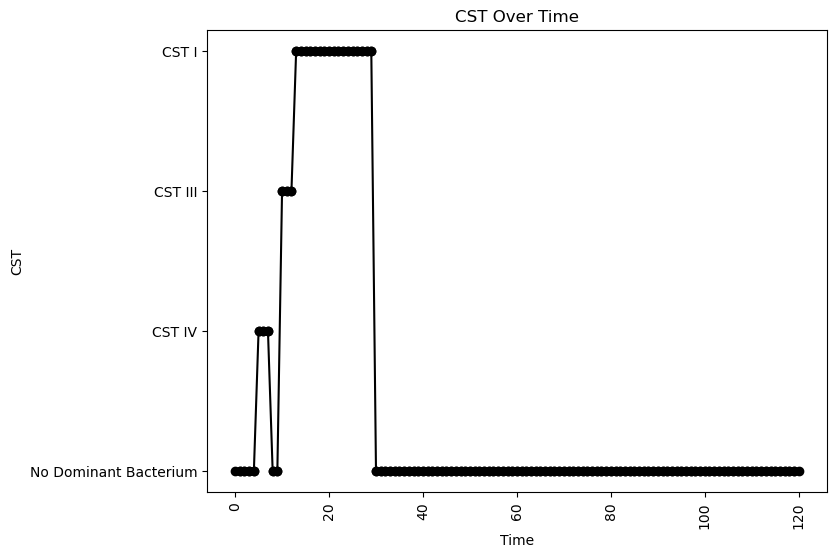


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.09453043138770835
oLB Growth: 0.595997418302585
nAB Self: -0.07748473318434505
nAB->Li: -0.24357938743073665
nAB->oLB: -0.2907824427633424
Li->nAB: 0.07467447142404249
Li Self: -0.05261097519956806
Li->oLB: 0.11552917490759185
oLB->nAB: -0.3947901583926643
oLB->Li: 0.46494171805853735
oLB Self: -0.015796463881445552

Simulation 350 follows a valid CST progression:


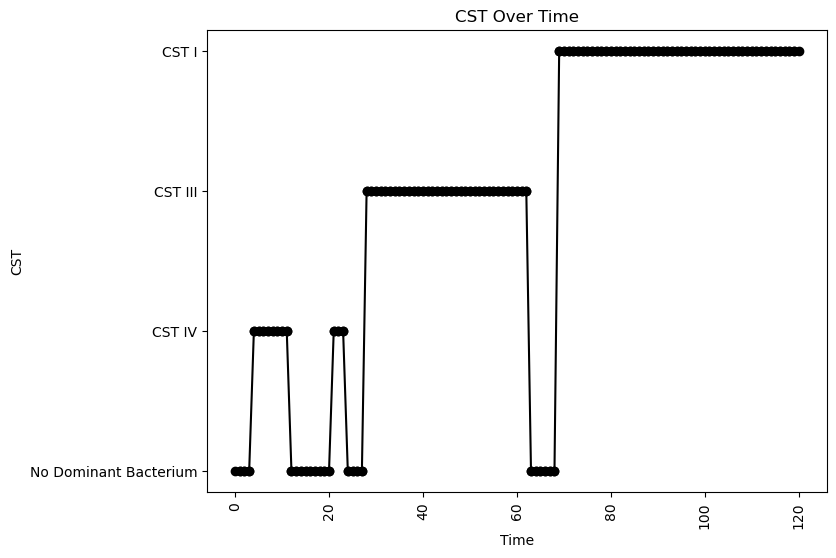


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.050474080346881334
nAB->Li: -0.42701792198303257
nAB->oLB: -0.41097490218098187
Li->nAB: 0.04718847555155903
Li Self: -0.07074455433365576
Li->oLB: -0.04850477812189152
oLB->nAB: -0.27752504472105405
oLB->Li: 0.06443937777253084
oLB Self: -0.018430869368235778

Simulation 354 follows a valid CST progression:


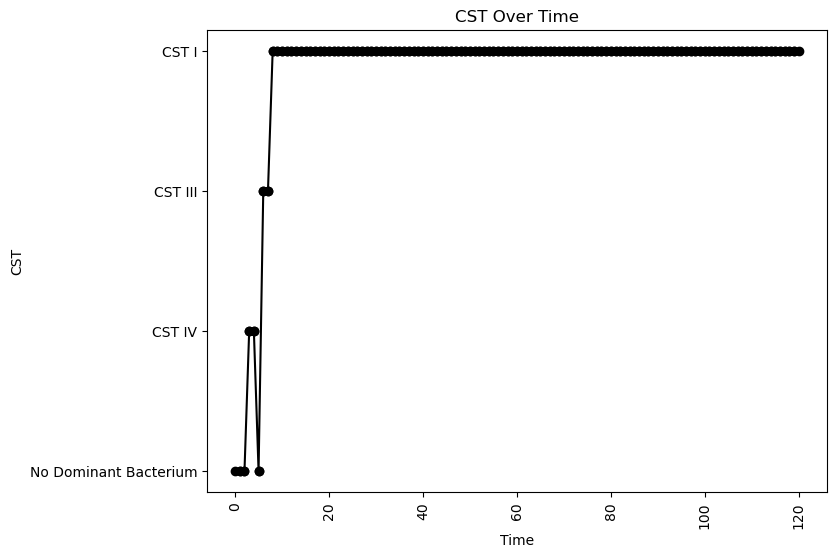


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.07671965720316815
nAB->Li: -0.11336955347816907
nAB->oLB: -0.27620742992460073
Li->nAB: 0.42450531306121797
Li Self: -0.041805942637386594
Li->oLB: -0.1658204324211397
oLB->nAB: -0.47628267515355216
oLB->Li: 0.2511299625451635
oLB Self: -0.06489327210229162

Simulation 357 follows a valid CST progression:


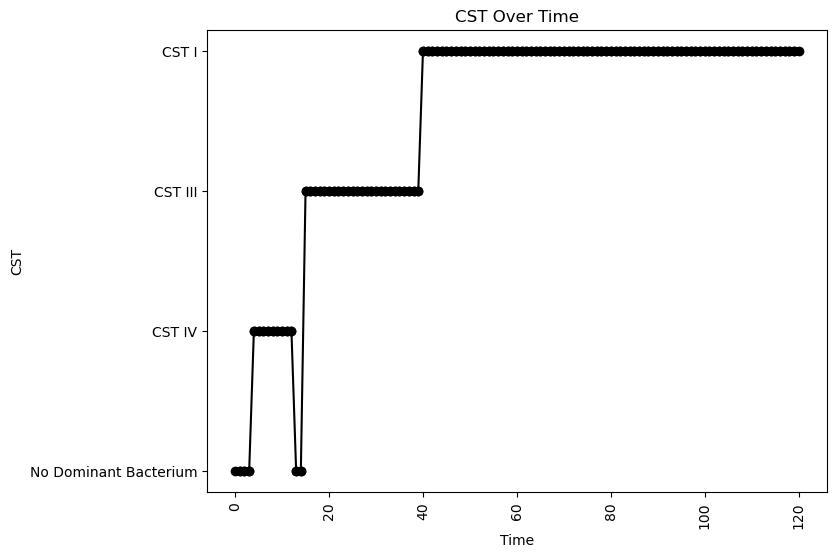


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.012992065855410281
nAB->Li: -0.41239408168572617
nAB->oLB: -0.12218527096111925
Li->nAB: 0.00953884823300577
Li Self: -0.013478476922528376
Li->oLB: -0.22048828520749097
oLB->nAB: -0.4063919355613827
oLB->Li: 0.2315676463875287
oLB Self: -0.06854732699334604

Simulation 358 follows a valid CST progression:


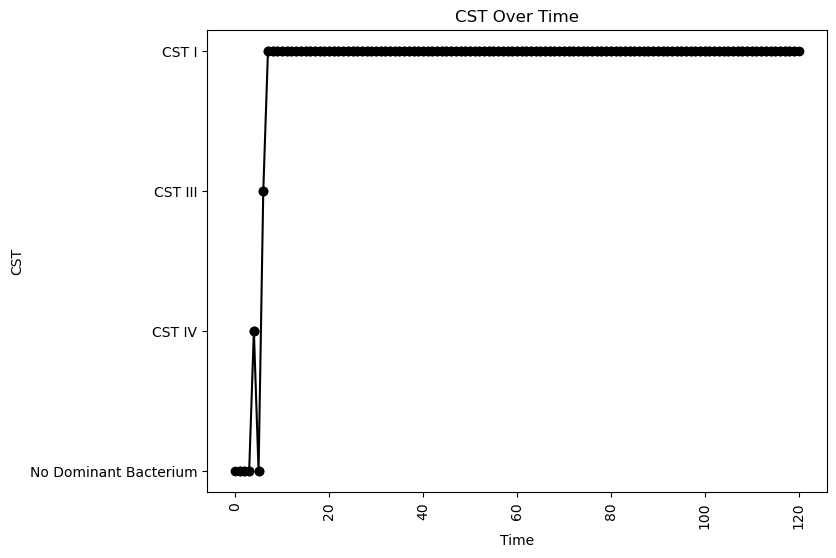


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.0781787892573398
nAB->Li: -0.12183923881492131
nAB->oLB: -0.11848854580770274
Li->nAB: 0.3115108029441829
Li Self: -0.04119584840753461
Li->oLB: 0.13774965058026878
oLB->nAB: -0.3054428612364508
oLB->Li: 0.3038874674689914
oLB Self: -0.07446888798968943

Simulation 366 follows a valid CST progression:


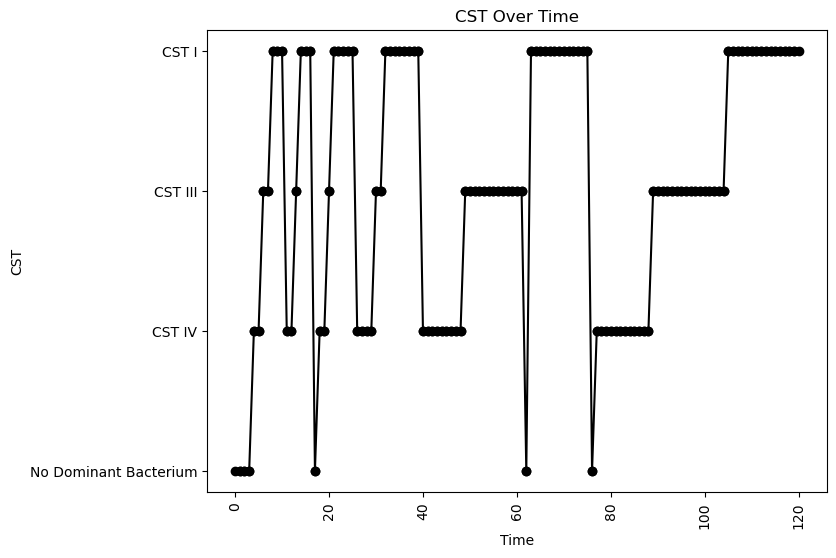


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.05902258125068206
nAB->Li: -0.420477243422543
nAB->oLB: -0.0056573877840293
Li->nAB: 0.41137074178259436
Li Self: -0.035067810741166314
Li->oLB: -0.39735828871031054
oLB->nAB: -0.2643378452569546
oLB->Li: 0.39218442983436386
oLB Self: -0.03229352466141683

Simulation 369 follows a valid CST progression:


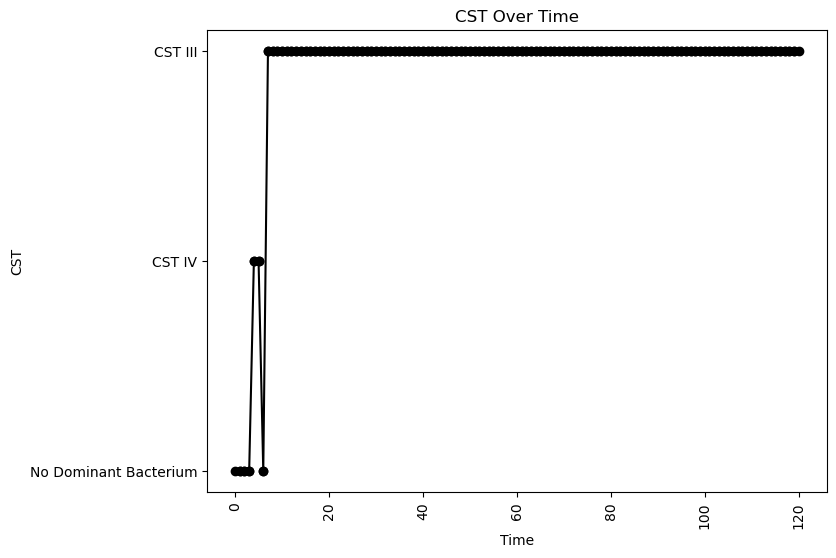


Interaction Parameters:
nAB Growth: 2.1147752631399044
Li Growth: 0.026128882742544723
oLB Growth: 1.2094391858973506
nAB Self: -0.002012428646565978
nAB->Li: -0.25211955423347354
nAB->oLB: -0.4655426891089277
Li->nAB: 0.31623214651894005
Li Self: -0.02032728233979625
Li->oLB: -0.44225211146979376
oLB->nAB: -0.19382566092184111
oLB->Li: -0.21983805632011494
oLB Self: -0.06557987249244962

Simulation 375 follows a valid CST progression:


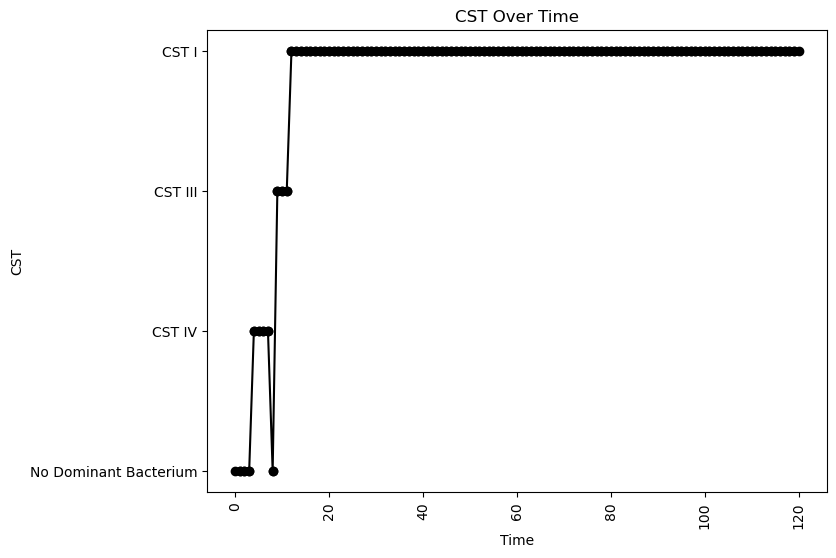


Interaction Parameters:
nAB Growth: 2.2657644953374403
Li Growth: 0.07173881162026666
oLB Growth: 0.2949021384914317
nAB Self: -0.03170830016367028
nAB->Li: -0.13428485137855062
nAB->oLB: -0.3419573804778129
Li->nAB: 0.12451576448941604
Li Self: -0.01769132686028249
Li->oLB: -0.3716584527292629
oLB->nAB: -0.33578392540036106
oLB->Li: 0.22957608107603866
oLB Self: -0.007944888423427512

Simulation 377 follows a valid CST progression:


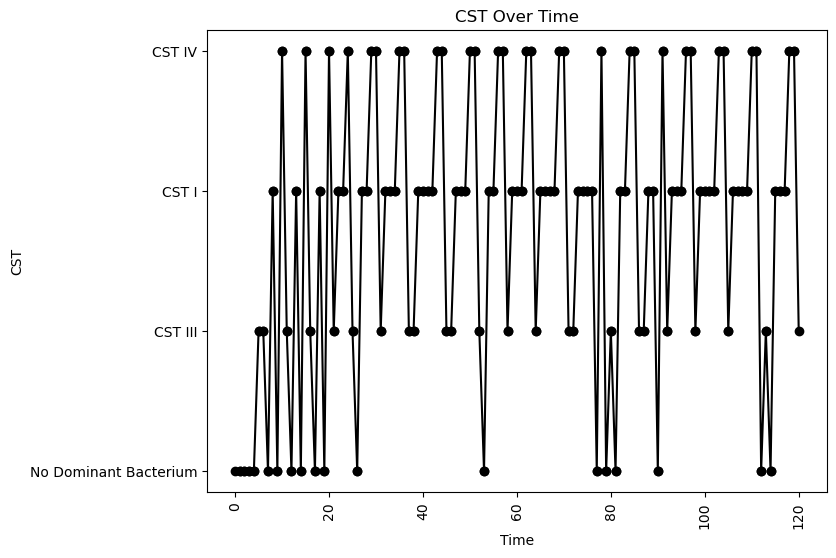


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.2594172328360016
oLB Growth: 0.16744057753178704
nAB Self: -0.026059355935801665
nAB->Li: -0.2476682234817898
nAB->oLB: -0.021292626141162174
Li->nAB: 0.4532339087938295
Li Self: -0.07150268939522222
Li->oLB: -0.39897665307780966
oLB->nAB: -0.34989149468476416
oLB->Li: 0.25962391203926927
oLB Self: -0.05875778394456129

Simulation 383 follows a valid CST progression:


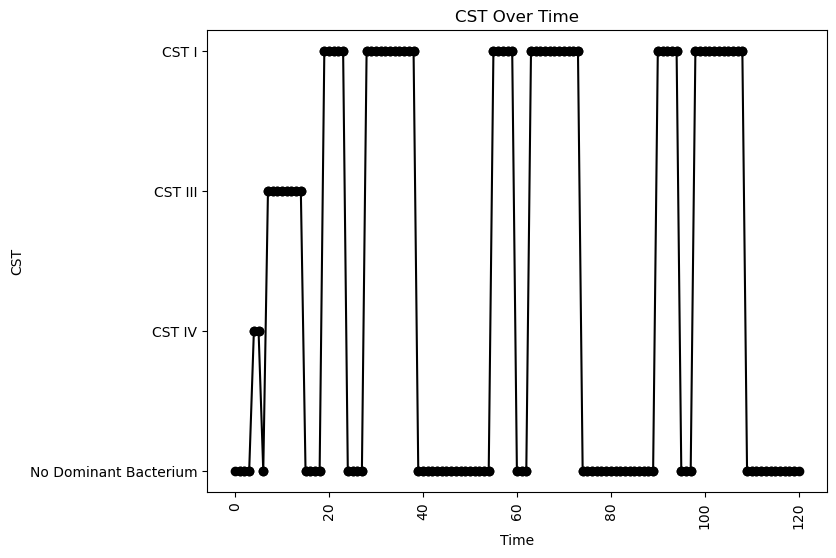


Interaction Parameters:
nAB Growth: 2.273308423784788
Li Growth: 0.19280420385920502
oLB Growth: 0.4879467602516997
nAB Self: -0.017545013865258238
nAB->Li: -0.0974446196714226
nAB->oLB: -0.037153187630046325
Li->nAB: 0.2240852298134094
Li Self: -0.07303118308380464
Li->oLB: -0.011808844933171303
oLB->nAB: -0.41747754930825115
oLB->Li: 0.17802696882446567
oLB Self: -0.0668118085492508

Simulation 402 follows a valid CST progression:


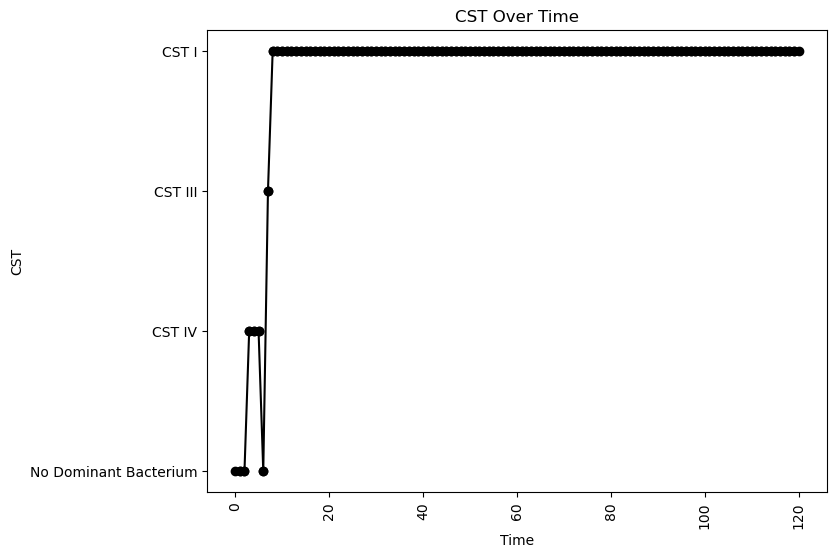


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.0840196629939906
nAB->Li: -0.22853618562200845
nAB->oLB: -0.0893971222928921
Li->nAB: 0.1582505828703018
Li Self: -0.030421738494262107
Li->oLB: 0.18731653728994202
oLB->nAB: -0.1296446124395294
oLB->Li: 0.41877449693178337
oLB Self: -0.005421552893919268

Simulation 404 follows a valid CST progression:


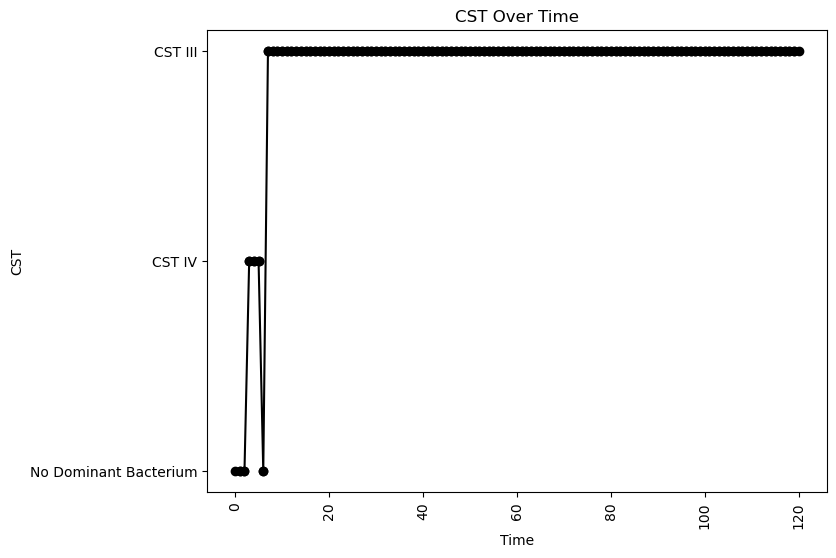


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.06726515272578022
nAB->Li: -0.16951257346677917
nAB->oLB: -0.43592350213450126
Li->nAB: 0.23621577322255205
Li Self: -0.01835796331246138
Li->oLB: 0.2318563105608359
oLB->nAB: -0.4141024913268382
oLB->Li: -0.39080508434776684
oLB Self: -0.09277825575850776

Simulation 409 follows a valid CST progression:


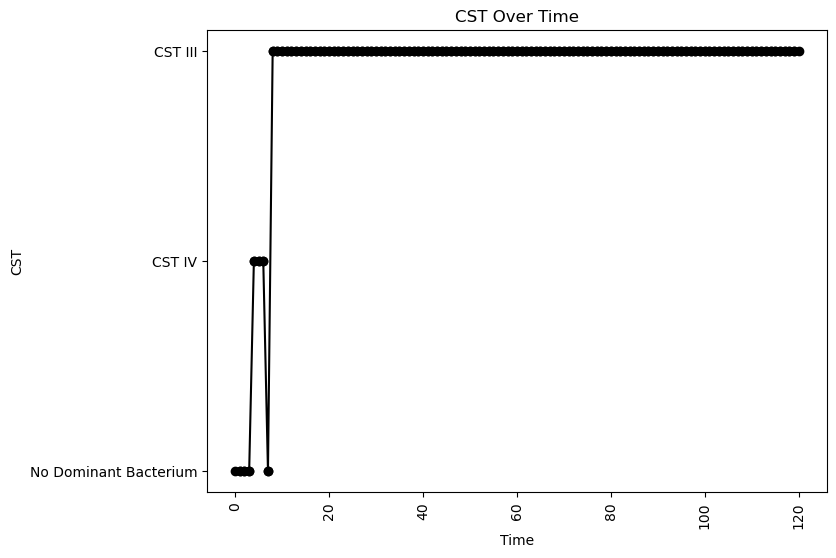


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.052028713716581104
nAB->Li: -0.37920048831269537
nAB->oLB: -0.3206090972102436
Li->nAB: 0.3967365411826893
Li Self: -0.07832496362339442
Li->oLB: -0.08564294625759045
oLB->nAB: -0.36799403841481515
oLB->Li: -0.2974181871694249
oLB Self: -0.05256275460844877

Simulation 413 follows a valid CST progression:


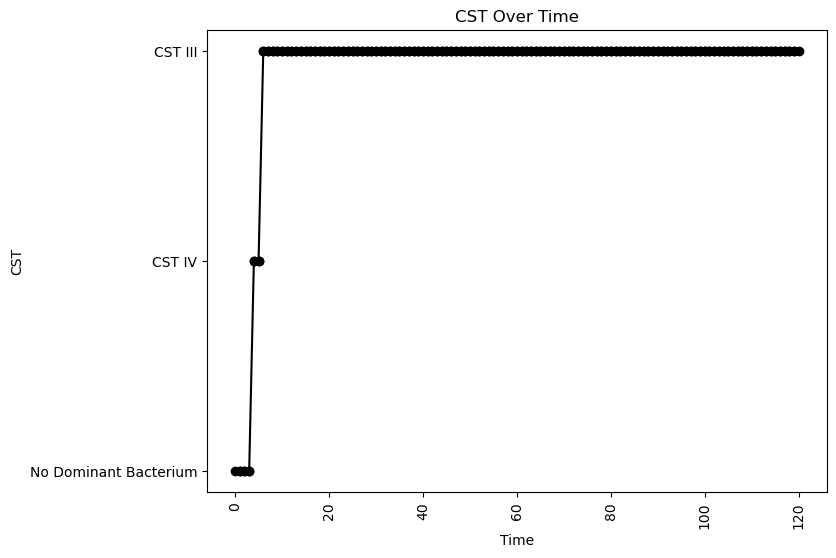


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.012250126142801507
nAB->Li: 0.21839392328332052
nAB->oLB: -0.4992991536720831
Li->nAB: 0.3539161303537228
Li Self: -0.01604800194584126
Li->oLB: -0.1364664799875041
oLB->nAB: -0.34015611092552445
oLB->Li: -0.015873491815534324
oLB Self: -0.0507340190029244

Simulation 426 follows a valid CST progression:


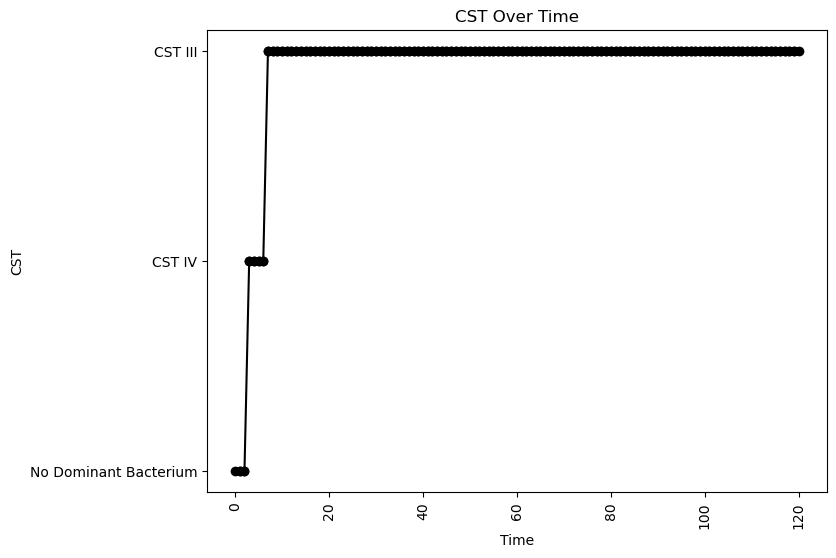


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.08625285656740095
nAB->Li: 0.19375038280612333
nAB->oLB: -0.2519814853956905
Li->nAB: 0.30482922988361927
Li Self: -0.03168636267434441
Li->oLB: 0.25364813862048785
oLB->nAB: -0.18895205004840898
oLB->Li: -0.14195902969658447
oLB Self: -0.08813962700859082

Simulation 432 follows a valid CST progression:


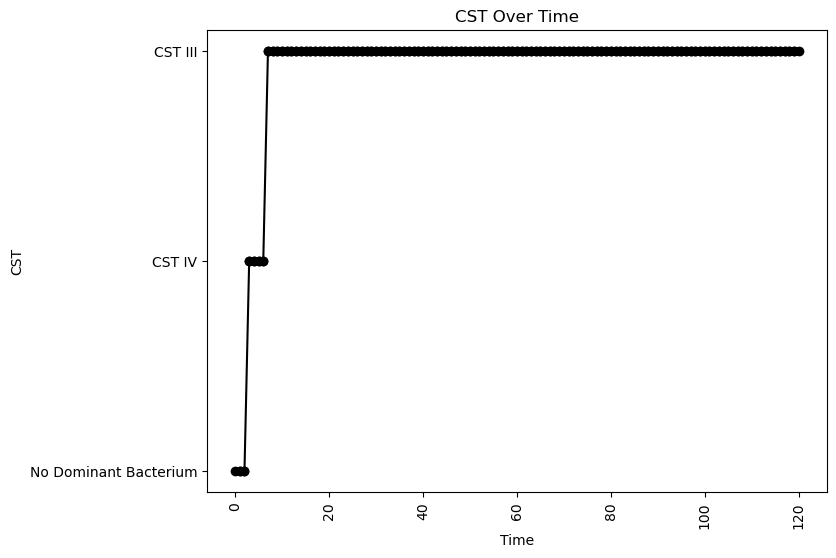


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.11037944382067183
oLB Growth: 0.058910478352813524
nAB Self: -0.07039303392414828
nAB->Li: 0.08261868433377828
nAB->oLB: -0.1132242547596341
Li->nAB: 0.08820241649439209
Li Self: -0.0024821400512220065
Li->oLB: 0.3345692345262625
oLB->nAB: -0.4330148313658127
oLB->Li: -0.049499919610733245
oLB Self: -0.06628592014072512

Simulation 441 follows a valid CST progression:


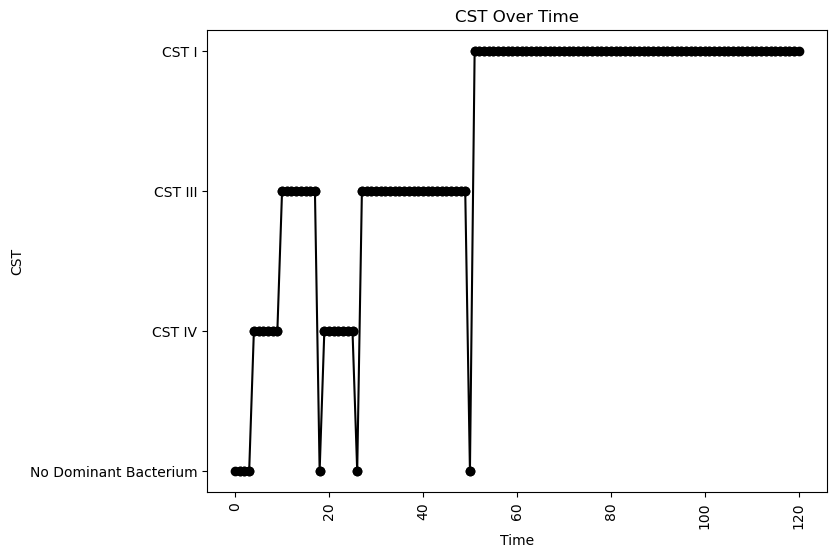


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.0011674867991510463
nAB->Li: -0.2542579699429923
nAB->oLB: -0.28249562291283614
Li->nAB: 0.024126185871574113
Li Self: -0.046796671264479
Li->oLB: -0.4882565230899335
oLB->nAB: -0.4628868236130573
oLB->Li: 0.4179826230432765
oLB Self: -0.0461875719718051

Simulation 442 follows a valid CST progression:


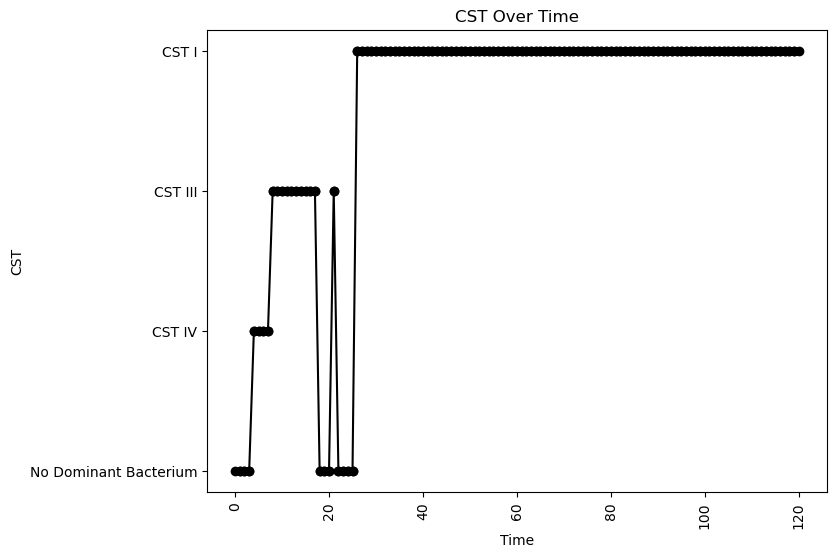


Interaction Parameters:
nAB Growth: 2.292952252819776
Li Growth: 0.06862578763464611
oLB Growth: 0.25066683866219575
nAB Self: -0.08933077054711194
nAB->Li: -0.44668081248794417
nAB->oLB: -0.4661472833565061
Li->nAB: 0.16850449670639311
Li Self: -0.08639893487040162
Li->oLB: -0.216868355627724
oLB->nAB: -0.30705521655091583
oLB->Li: 0.16606532889976555
oLB Self: -0.09843939829550702

Simulation 446 follows a valid CST progression:


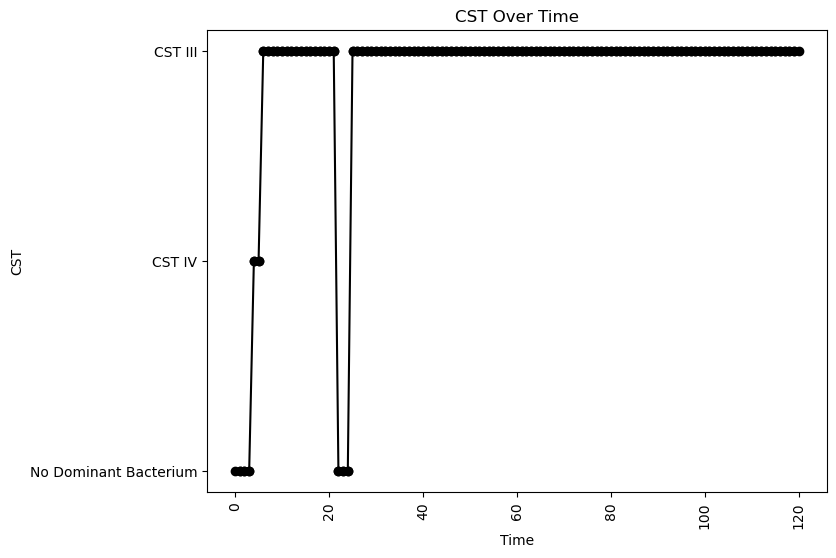


Interaction Parameters:
nAB Growth: 2.1964345031105657
Li Growth: 0.04025066595693835
oLB Growth: 1.2138354993931422
nAB Self: -0.07664158646140334
nAB->Li: -0.2107106991817831
nAB->oLB: -0.20969991214674044
Li->nAB: 0.47817818466040474
Li Self: -0.058759724806741485
Li->oLB: 0.12326843666619669
oLB->nAB: -0.48217573573896383
oLB->Li: 0.0621972717052649
oLB Self: -0.07859768849496816

Simulation 455 follows a valid CST progression:


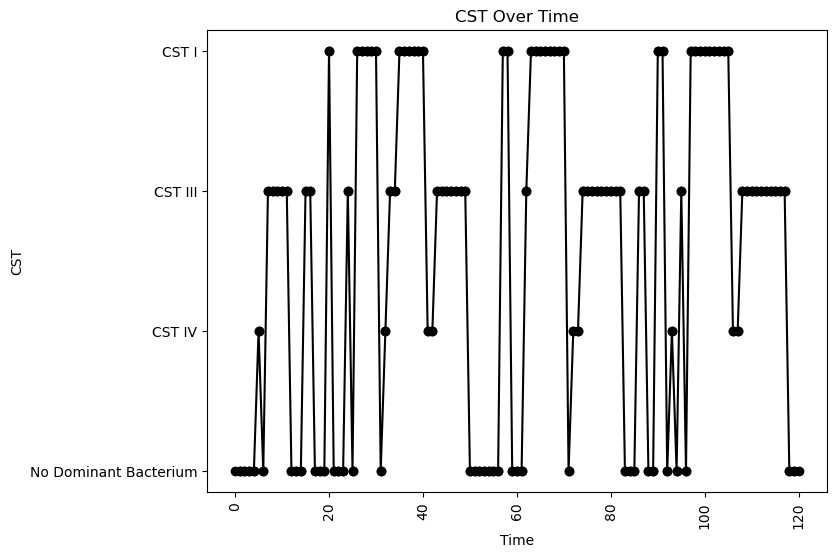


Interaction Parameters:
nAB Growth: 2.273308423784788
Li Growth: 0.06939466945066827
oLB Growth: 0.4879467602516997
nAB Self: -0.023760696834226852
nAB->Li: -0.2808526919246785
nAB->oLB: -0.1468923200530035
Li->nAB: 0.49558842796400626
Li Self: -0.0992611801226613
Li->oLB: -0.311818770113796
oLB->nAB: -0.37338814256955793
oLB->Li: 0.17102725242484984
oLB Self: -0.08459756447106824

Simulation 467 follows a valid CST progression:


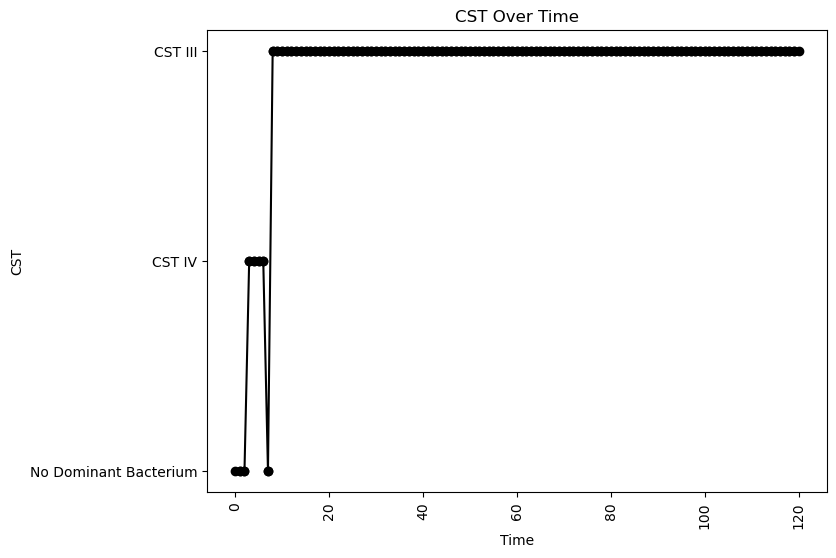


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.23003027208826307
oLB Growth: 0.3756702562538966
nAB Self: -0.07664734252704535
nAB->Li: 0.030058449574589363
nAB->oLB: -0.17538257409694508
Li->nAB: 0.10290862199029482
Li Self: -0.06143895171301329
Li->oLB: 0.1350047936086618
oLB->nAB: -0.1473902796793492
oLB->Li: -0.4623126432362855
oLB Self: -0.007000622927123848

Simulation 468 follows a valid CST progression:


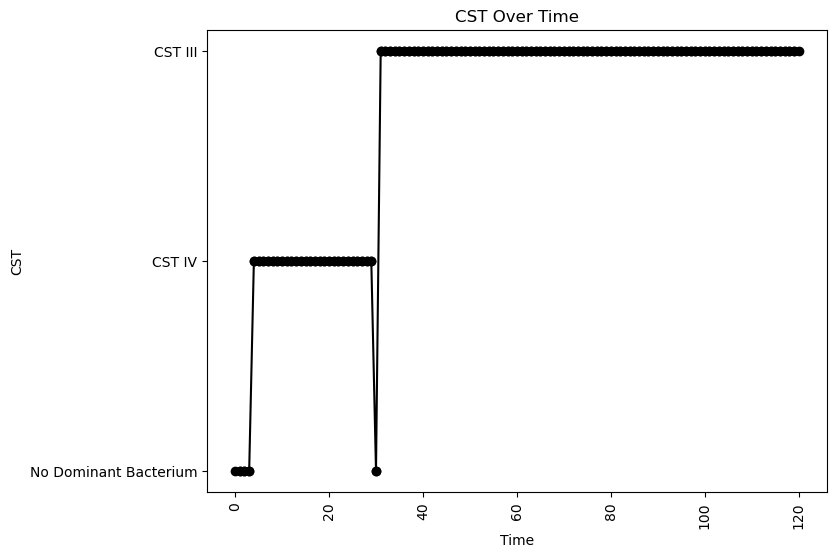


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.03721117563991143
nAB->Li: -0.3398440848638353
nAB->oLB: -0.47902311754523996
Li->nAB: 0.004690858757663063
Li Self: -0.010216548375623358
Li->oLB: -0.3125738317937762
oLB->nAB: -0.27302277609557
oLB->Li: -0.3678857783256777
oLB Self: -0.05566127642290897

Simulation 470 follows a valid CST progression:


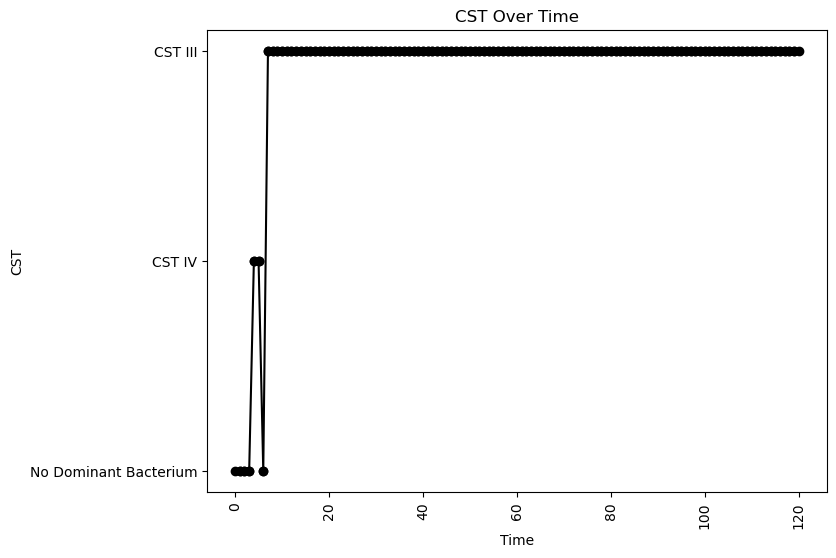


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.11133221641484946
oLB Growth: 0.1263134331844771
nAB Self: -0.08852675489432257
nAB->Li: 0.12437847746484165
nAB->oLB: -0.024940642985911254
Li->nAB: 0.2509905422454768
Li Self: -0.0719105820891032
Li->oLB: 0.44481746581944404
oLB->nAB: -0.2643502511329604
oLB->Li: -0.1030567348557378
oLB Self: -0.07774820461274713

Simulation 480 follows a valid CST progression:


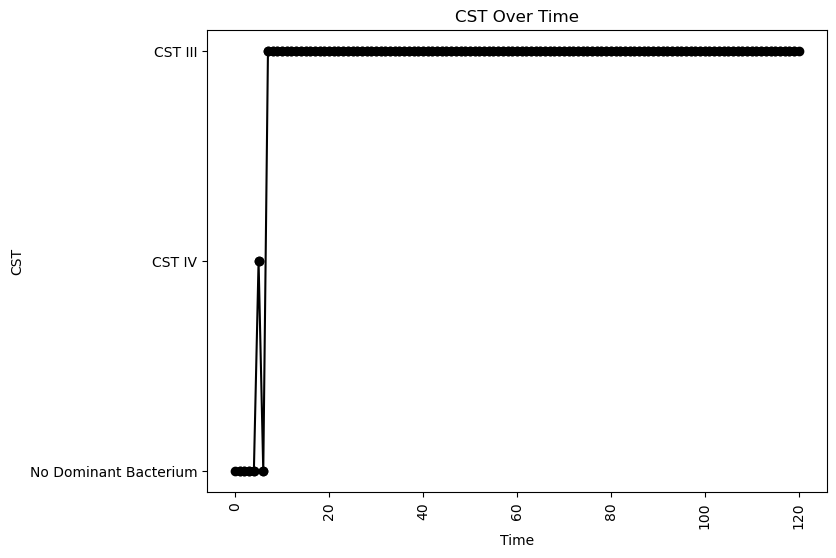


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.019160539883764607
nAB->Li: -0.29668595015022853
nAB->oLB: -0.017507107375769715
Li->nAB: 0.48925461923154034
Li Self: -0.07664140635483507
Li->oLB: 0.38600277800994
oLB->nAB: -0.49998193144482017
oLB->Li: -0.17545456147699
oLB Self: -0.04593896905788095

Simulation 481 follows a valid CST progression:


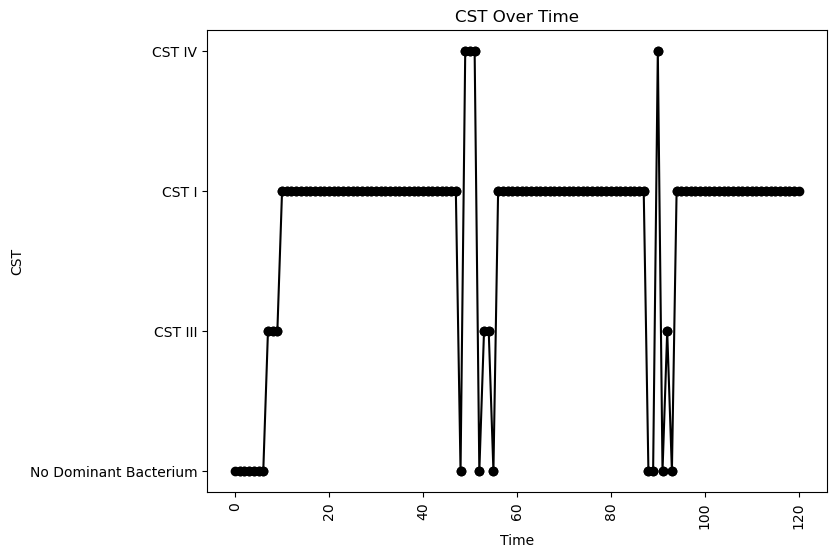


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.10388702015886205
oLB Growth: 0.16744057753178704
nAB Self: -0.09745347557401828
nAB->Li: -0.3006213541100165
nAB->oLB: -0.1522976339484246
Li->nAB: 0.2956569757291303
Li Self: -0.03531185983825391
Li->oLB: -0.03970144757019517
oLB->nAB: -0.34475243843265013
oLB->Li: 0.23611018922858729
oLB Self: -0.08427253703393806

Simulation 482 follows a valid CST progression:


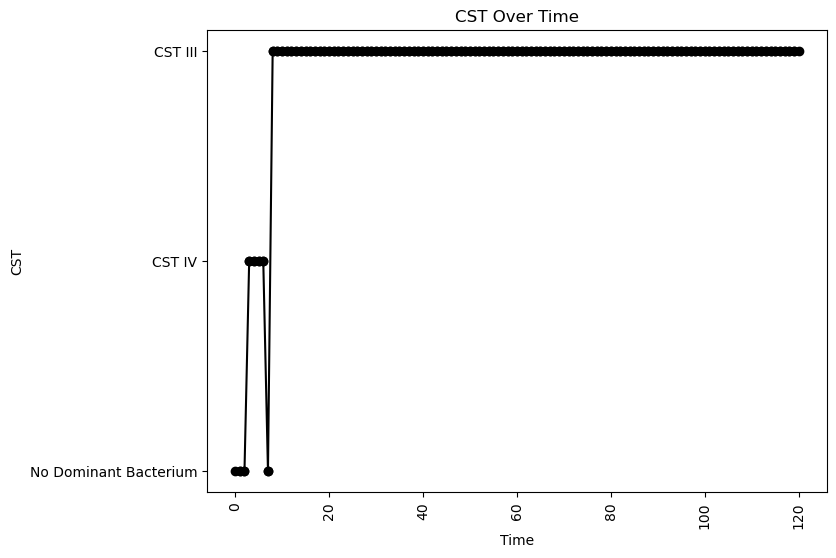


Interaction Parameters:
nAB Growth: 2.1573635369289432
Li Growth: 0.04215849674910016
oLB Growth: 1.2503024394854367
nAB Self: -0.038266234581881664
nAB->Li: -0.20954092842482858
nAB->oLB: -0.21927300852176268
Li->nAB: 0.2557448469664585
Li Self: -0.023966369185005304
Li->oLB: 0.22487315385706153
oLB->nAB: -0.013417499087275797
oLB->Li: -0.12380766059557846
oLB Self: -0.02524337182595883

Simulation 491 follows a valid CST progression:


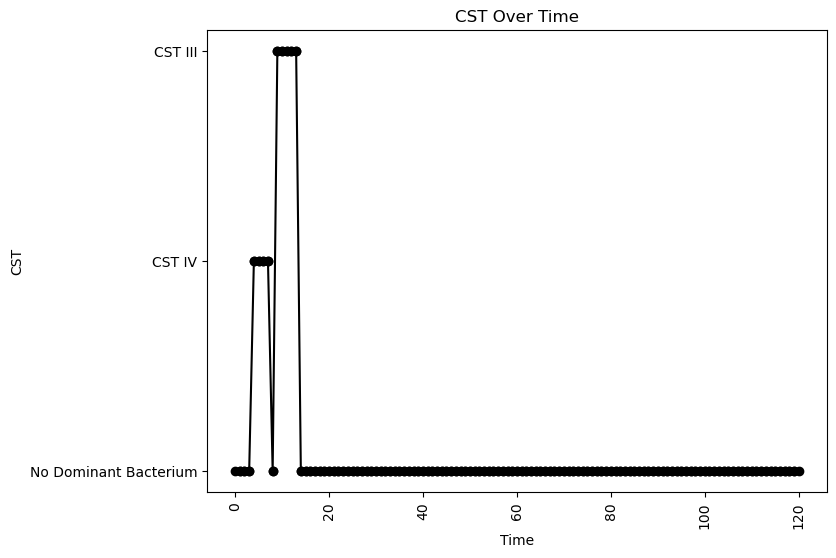


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.06664492138468138
oLB Growth: 0.6588037441195057
nAB Self: -0.040468805496021776
nAB->Li: -0.20607665221709137
nAB->oLB: -0.17075857989272242
Li->nAB: 0.06298157526649084
Li Self: -0.02214065275169272
Li->oLB: 0.28032396372581914
oLB->nAB: -0.37715004091545
oLB->Li: 0.4312315637566533
oLB Self: -0.07840741801837267

Simulation 492 follows a valid CST progression:


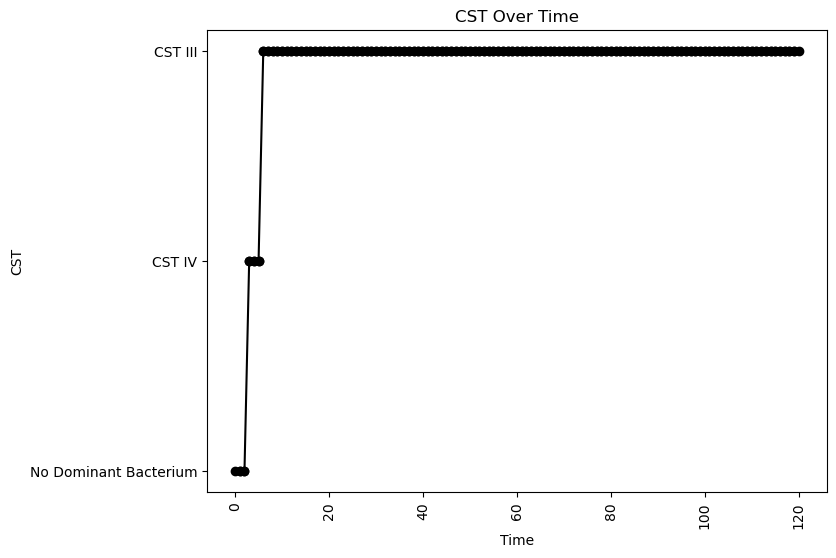


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.05739994626081137
oLB Growth: 0.11031283255203692
nAB Self: -0.06700388554311895
nAB->Li: 0.15422398204878096
nAB->oLB: -0.2395301344778547
Li->nAB: 0.4105247882735735
Li Self: -0.09049563977601793
Li->oLB: -0.14943215220090472
oLB->nAB: -0.47452415337575654
oLB->Li: 0.09156940755756515
oLB Self: -0.09835205877471359

Simulation 505 follows a valid CST progression:


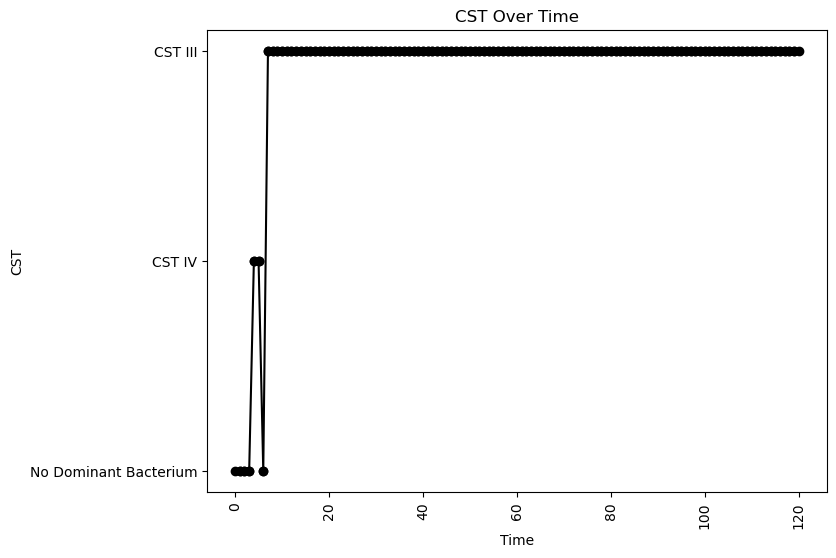


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.013739637636026189
nAB->Li: -0.397952160231779
nAB->oLB: -0.19753575477508672
Li->nAB: 0.3288576522417934
Li Self: -0.0687322395065489
Li->oLB: 0.12623623799891415
oLB->nAB: -0.23416757067143662
oLB->Li: -0.1924588883325894
oLB Self: -0.05385272870458371

Simulation 508 follows a valid CST progression:


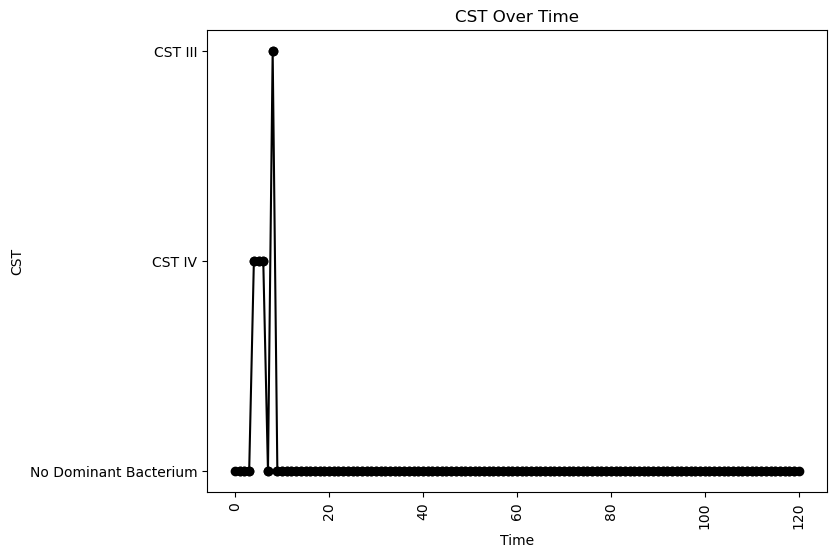


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.29896160475873046
oLB Growth: 1.155917868199191
nAB Self: -0.017535232822101066
nAB->Li: -0.11826941210650971
nAB->oLB: -0.20055353032062156
Li->nAB: 0.03578020754587419
Li Self: -0.011331038851272582
Li->oLB: 0.39926016232938233
oLB->nAB: -0.2678616909033107
oLB->Li: 0.38253210315733
oLB Self: -0.013346514542206672

Simulation 511 follows a valid CST progression:


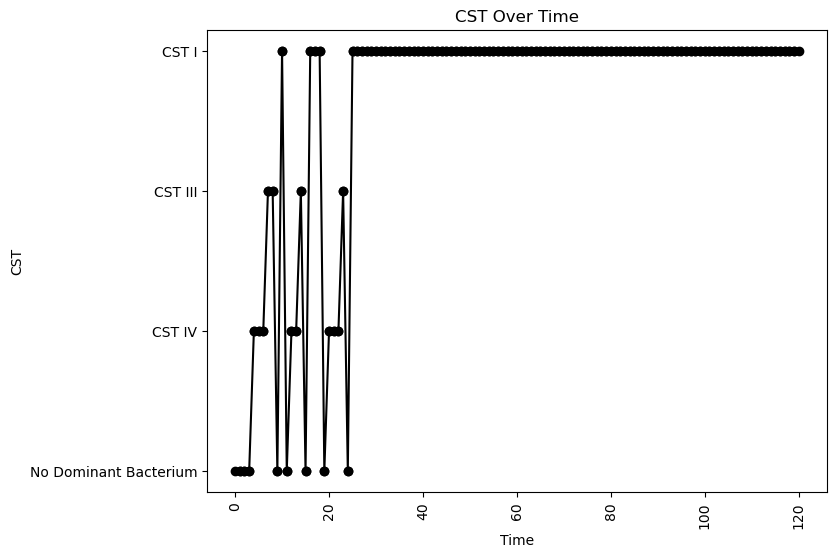


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.06690021993518994
nAB->Li: -0.17834387854724326
nAB->oLB: -0.1723480961110443
Li->nAB: 0.37143657199280267
Li Self: -0.08936997268362251
Li->oLB: -0.4925253675212521
oLB->nAB: -0.2837209843921161
oLB->Li: 0.2911615052869565
oLB Self: -0.014394937168888164

Simulation 513 follows a valid CST progression:


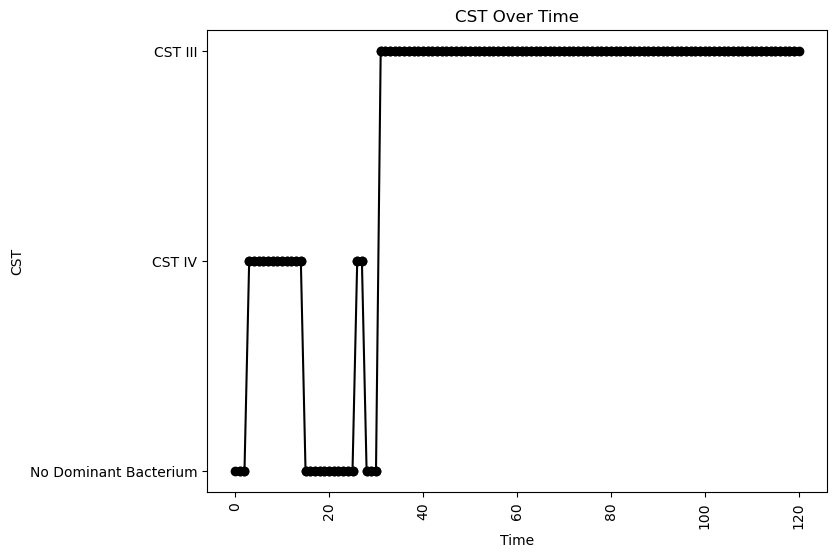


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.06806014290478743
oLB Growth: 0.20414555748463747
nAB Self: -0.02704204832470687
nAB->Li: -0.39467047371242303
nAB->oLB: -0.16432195250197196
Li->nAB: 0.015318151997182783
Li Self: -0.029320339372583326
Li->oLB: 0.021815606205073612
oLB->nAB: -0.30648142180463817
oLB->Li: -0.17528826796881808
oLB Self: -0.019349777291098644

Simulation 518 follows a valid CST progression:


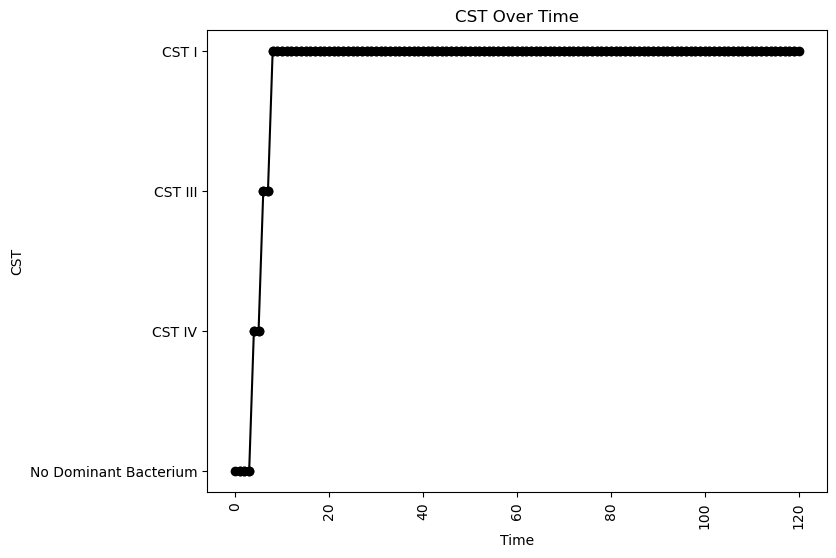


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.005231641351836805
nAB->Li: -0.18109266723116213
nAB->oLB: -0.4702155483324359
Li->nAB: 0.4381603303779006
Li Self: -0.016624570470661945
Li->oLB: -0.24150738585918075
oLB->nAB: -0.24024967400928288
oLB->Li: 0.25355107179712844
oLB Self: -0.06708787834504888

Simulation 520 follows a valid CST progression:


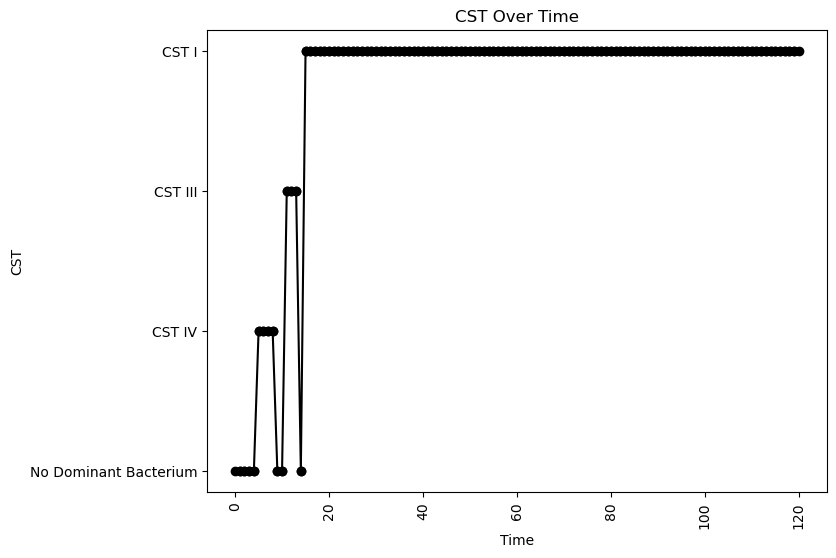


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.06382000810855068
nAB->Li: -0.27967103836570667
nAB->oLB: -0.3910531497374049
Li->nAB: 0.09283996153119622
Li Self: -0.061660632165376025
Li->oLB: 0.1400196716739901
oLB->nAB: -0.17835588042180683
oLB->Li: 0.32610270793893914
oLB Self: -0.012817531266053714

Simulation 522 follows a valid CST progression:


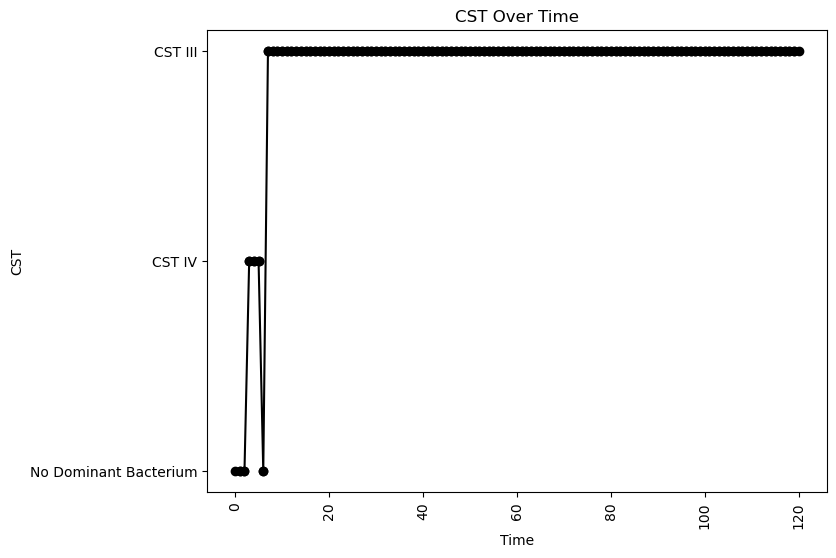


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.08772370836606053
nAB->Li: 0.1823041931039655
nAB->oLB: -0.08383902681901728
Li->nAB: 0.29177253671769665
Li Self: -0.010089408509599856
Li->oLB: 0.048982364647305654
oLB->nAB: -0.342418048111695
oLB->Li: 0.041227900012946295
oLB Self: -0.06618470901052025

Simulation 526 follows a valid CST progression:


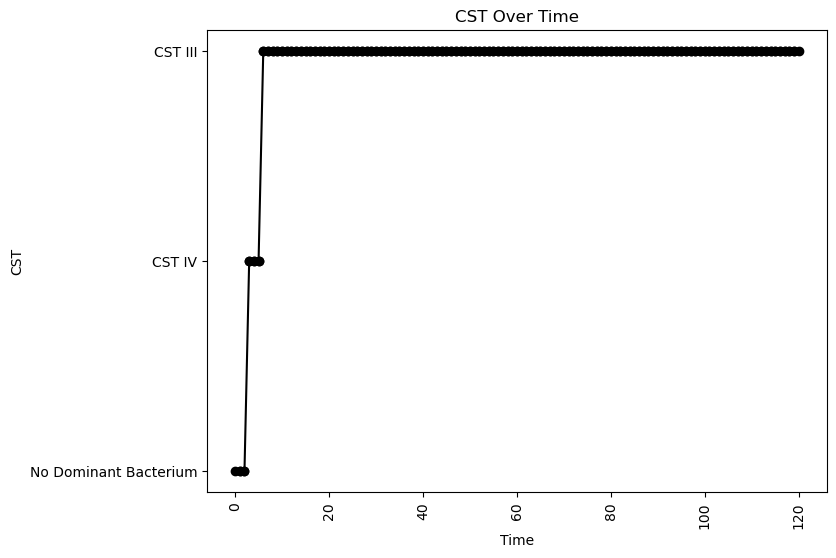


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.016545458347881056
nAB->Li: -0.4673498415313102
nAB->oLB: -0.33704312791318014
Li->nAB: 0.4710580259449084
Li Self: -0.07811786637775452
Li->oLB: -0.4475177779695748
oLB->nAB: -0.006022589668720324
oLB->Li: -0.45597623148929733
oLB Self: -0.09017073370945791

Simulation 527 follows a valid CST progression:


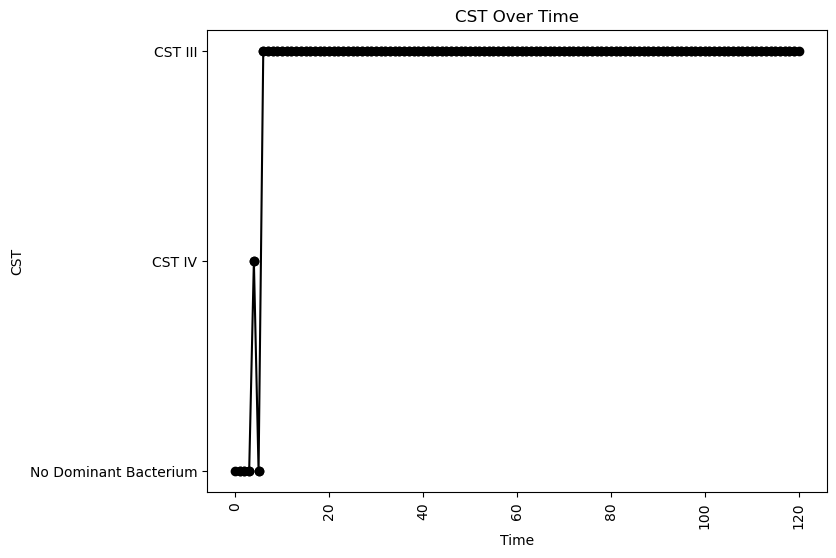


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.0904837863498239
nAB->Li: -0.07396983691158637
nAB->oLB: -0.018225790141117193
Li->nAB: 0.41770548060263635
Li Self: -0.038913100956103785
Li->oLB: -0.13343824475405752
oLB->nAB: -0.48733713843291104
oLB->Li: -0.37545221814759944
oLB Self: -0.001563869728353276

Simulation 531 follows a valid CST progression:


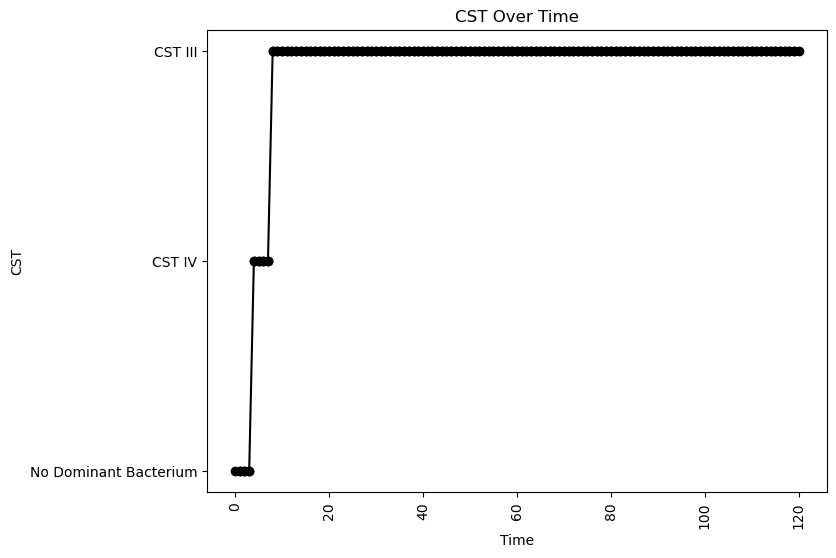


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.06588260315658048
oLB Growth: 0.21113539622386296
nAB Self: -0.08329632701958102
nAB->Li: -0.05981428395670896
nAB->oLB: -0.2687192570271966
Li->nAB: 0.19770312231105747
Li Self: -0.07043017030296983
Li->oLB: -0.4299134303710695
oLB->nAB: -0.257027809600813
oLB->Li: -0.20359120502938494
oLB Self: -0.05026776769088136

Simulation 532 follows a valid CST progression:


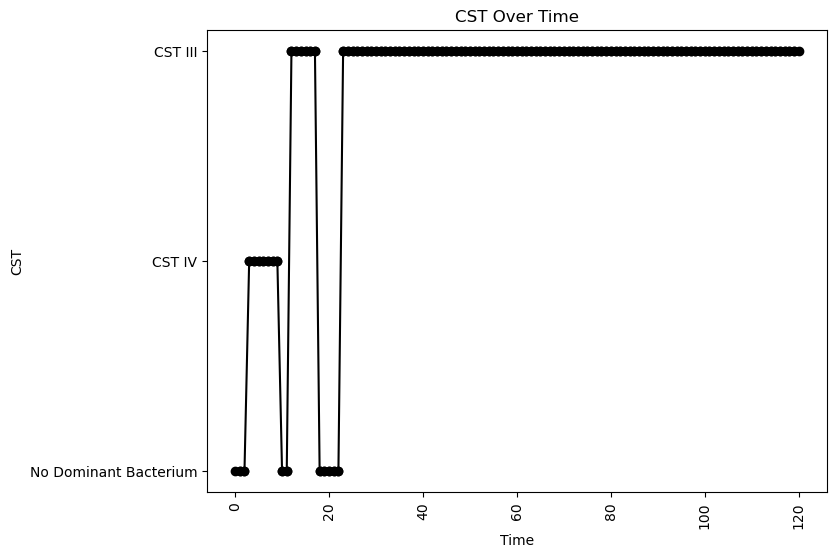


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.06495430992206574
oLB Growth: 0.1731103059651596
nAB Self: -0.07771998372848499
nAB->Li: -0.10418536717480148
nAB->oLB: -0.16797510245432018
Li->nAB: 0.07637095733519172
Li Self: -0.05122237893329079
Li->oLB: -0.34100446007850094
oLB->nAB: -0.18423768591573275
oLB->Li: -0.35669049622634585
oLB Self: -0.02807578542975389

Simulation 537 follows a valid CST progression:


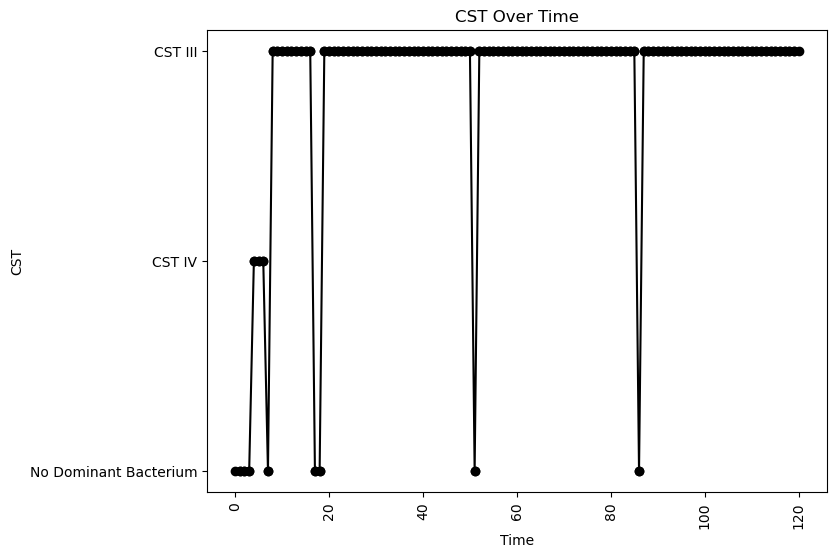


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.04930935729011439
nAB->Li: -0.3555510271816962
nAB->oLB: -0.09333340550789426
Li->nAB: 0.18799847106753043
Li Self: -0.09411007862924348
Li->oLB: -0.4256529965848928
oLB->nAB: -0.18804228600679324
oLB->Li: -0.1896899334308283
oLB Self: -0.05436061526853644

Simulation 542 follows a valid CST progression:


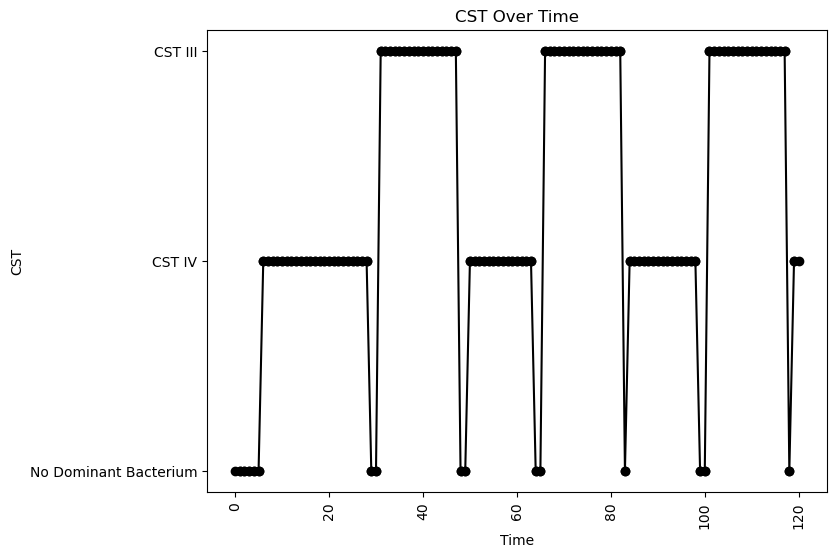


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.06967846000948563
oLB Growth: 0.7070472171500886
nAB Self: -0.03529133077404879
nAB->Li: -0.38469806082301106
nAB->oLB: -0.21282333864463682
Li->nAB: 0.026644786935313025
Li Self: -0.09455906937421825
Li->oLB: 0.4497035694711161
oLB->nAB: -0.2563827965097255
oLB->Li: -0.35324001843864516
oLB Self: -0.08684981547399961

Simulation 545 follows a valid CST progression:


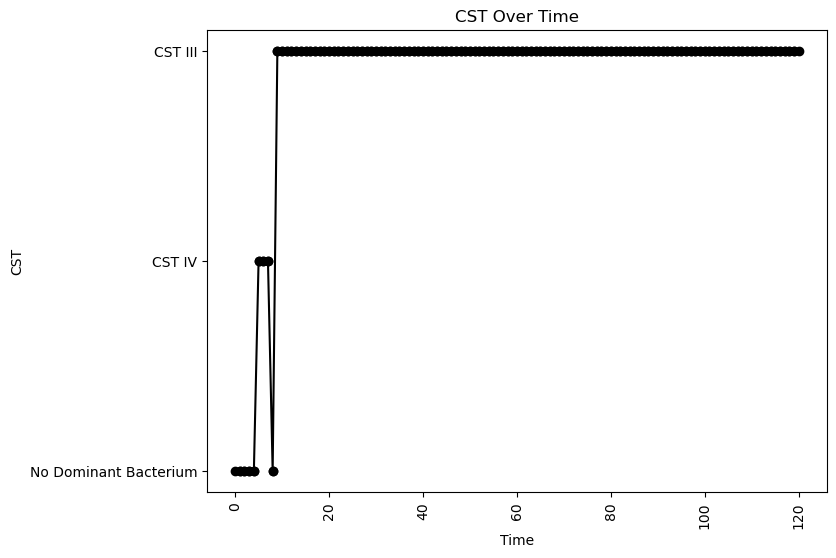


Interaction Parameters:
nAB Growth: 2.286323001067126
Li Growth: 0.19008485401214933
oLB Growth: 0.14091260068383374
nAB Self: -0.010668040657513742
nAB->Li: -0.3567464478548086
nAB->oLB: -0.10803232574073707
Li->nAB: 0.07408826968401394
Li Self: -0.03819060535719289
Li->oLB: 0.039391258652617944
oLB->nAB: -0.4204728799184859
oLB->Li: -0.16255687896068194
oLB Self: -0.06077426569148388

Simulation 561 follows a valid CST progression:


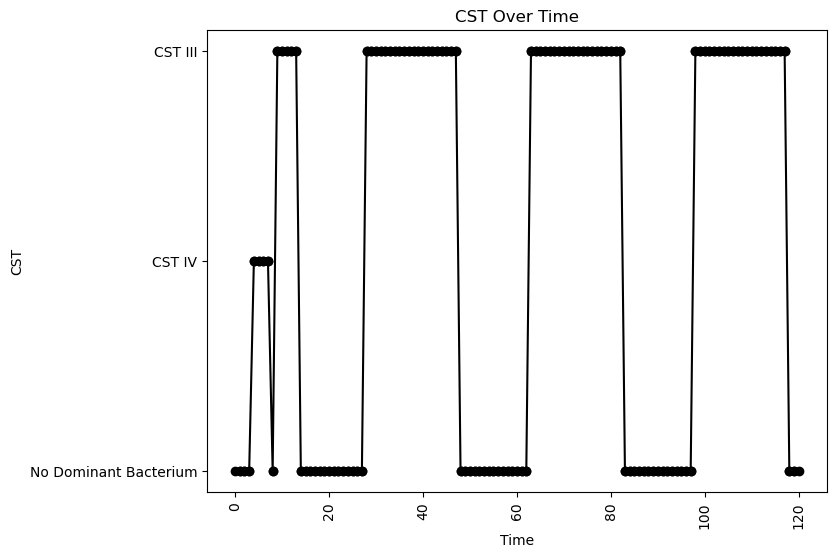


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.07155380750532123
nAB->Li: -0.3169479362954717
nAB->oLB: -0.2582355988078203
Li->nAB: 0.1166405177855131
Li Self: -0.0929484059706723
Li->oLB: -0.1303841052687545
oLB->nAB: -0.04303952626038049
oLB->Li: -0.2885754803995327
oLB Self: -0.01147105782931962

Simulation 564 follows a valid CST progression:


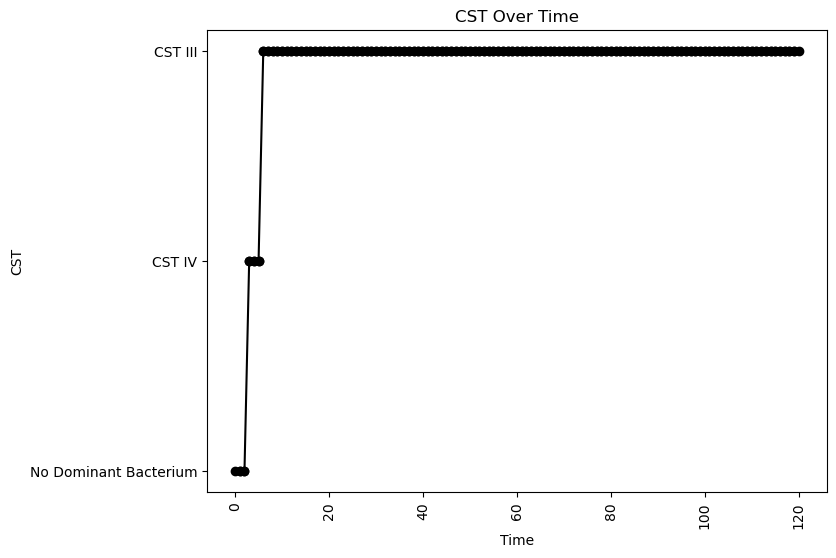


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.0514701395113967
nAB->Li: 0.141828863846041
nAB->oLB: -0.24149219818634948
Li->nAB: 0.28730108152626177
Li Self: -0.052007892786861104
Li->oLB: -0.1997844645528128
oLB->nAB: -0.49020727115908336
oLB->Li: -0.24737989971551477
oLB Self: -0.027795355578610348

Simulation 574 follows a valid CST progression:


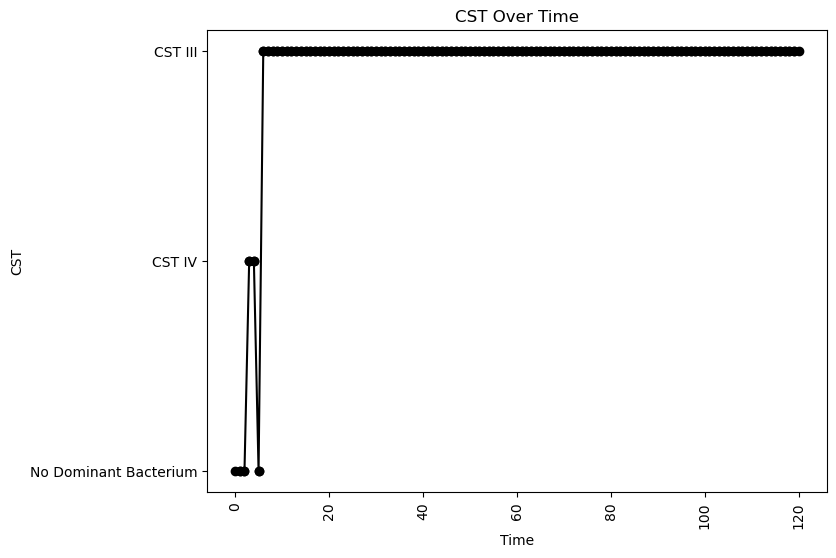


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.23402751637125146
oLB Growth: 0.08496126009849418
nAB Self: -0.01665343834022172
nAB->Li: 0.052813562055518126
nAB->oLB: -0.16595203650383583
Li->nAB: 0.1644687725304279
Li Self: -0.01798347002369191
Li->oLB: 0.25217222855318455
oLB->nAB: -0.0997910950000801
oLB->Li: -0.18220104404983073
oLB Self: -0.09788427147456936

Simulation 575 follows a valid CST progression:


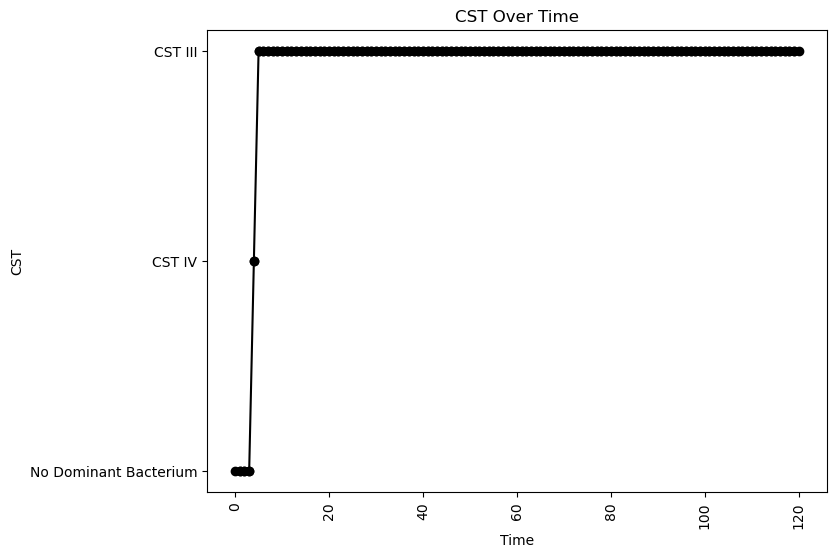


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.06588260315658048
oLB Growth: 0.21113539622386296
nAB Self: -0.0721769739743643
nAB->Li: -0.23072492904123076
nAB->oLB: -0.2609652106524972
Li->nAB: 0.4300918153231925
Li Self: -0.011445085580808506
Li->oLB: 0.4321826537529726
oLB->nAB: -0.3753016383415753
oLB->Li: -0.37877629687594655
oLB Self: -0.036181387683061284

Simulation 582 follows a valid CST progression:


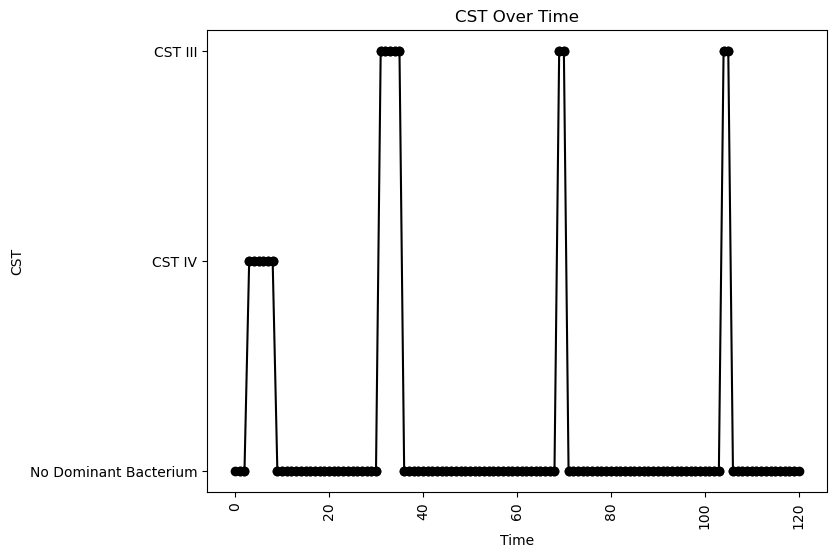


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.008249928704974693
nAB->Li: -0.11987617695558839
nAB->oLB: -0.33490009184488956
Li->nAB: 0.06838593540706528
Li Self: -0.08790734688400383
Li->oLB: 0.025064688609973684
oLB->nAB: -0.4830183647200975
oLB->Li: 0.3648644401801311
oLB Self: -0.060762147244479

Simulation 593 follows a valid CST progression:


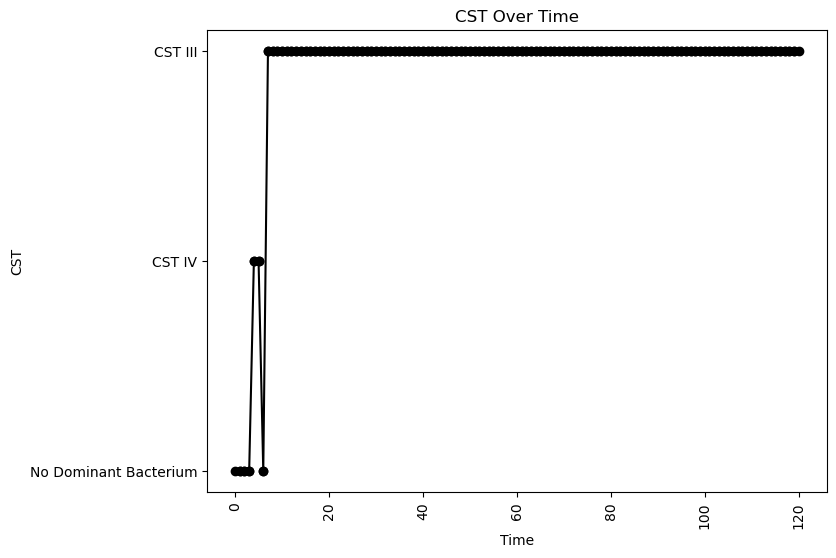


Interaction Parameters:
nAB Growth: 2.2609282147211935
Li Growth: 0.06381435834914458
oLB Growth: 0.1660151901294062
nAB Self: -0.006166209435679734
nAB->Li: 0.15049379402377705
nAB->oLB: -0.10859560951862418
Li->nAB: 0.30137287986047356
Li Self: -0.014465180529054433
Li->oLB: -0.046373517944998166
oLB->nAB: -0.4271762057353119
oLB->Li: 0.3014344928200926
oLB Self: -0.08569215324684738

Simulation 594 follows a valid CST progression:


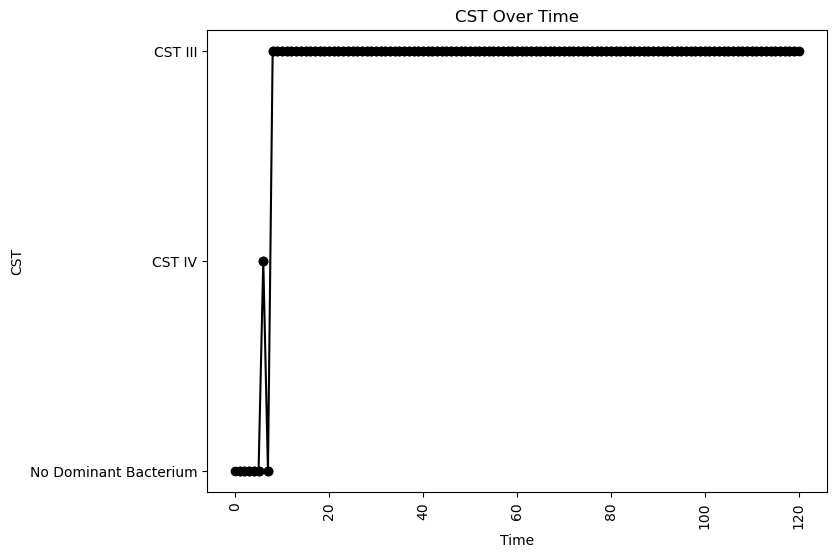


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.08667053937850897
nAB->Li: 0.20421498042208996
nAB->oLB: -0.2332071844787142
Li->nAB: 0.4369148793589219
Li Self: -0.07643528022946697
Li->oLB: 0.09738061550405497
oLB->nAB: -0.32173267267030803
oLB->Li: -0.12462240839519223
oLB Self: -0.053096451786733556

Simulation 595 follows a valid CST progression:


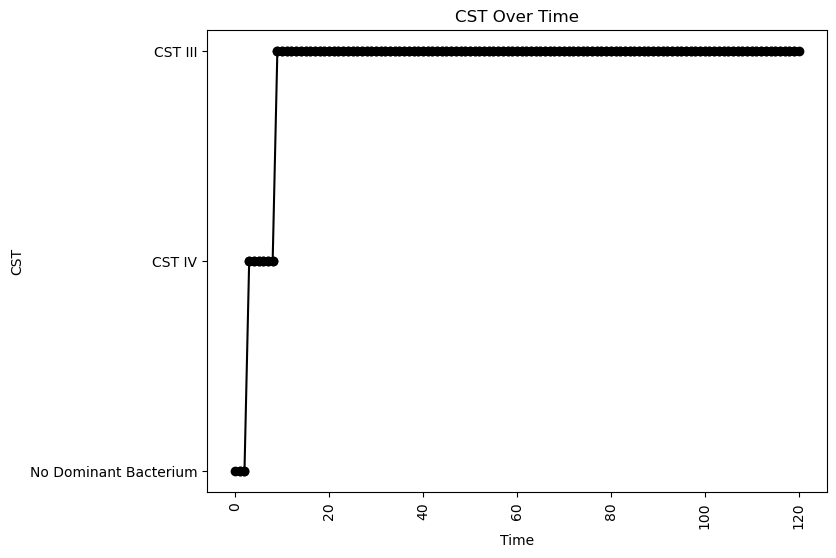


Interaction Parameters:
nAB Growth: 2.1573635369289432
Li Growth: 0.04215849674910016
oLB Growth: 1.2503024394854367
nAB Self: -0.03178506356785246
nAB->Li: -0.10959962500867221
nAB->oLB: -0.04621214301671034
Li->nAB: 0.16300710610763747
Li Self: -0.0626309711031096
Li->oLB: -0.29348095452045064
oLB->nAB: -0.3681150216818431
oLB->Li: -0.12353749090057664
oLB Self: -0.09502527916954388

Simulation 596 follows a valid CST progression:


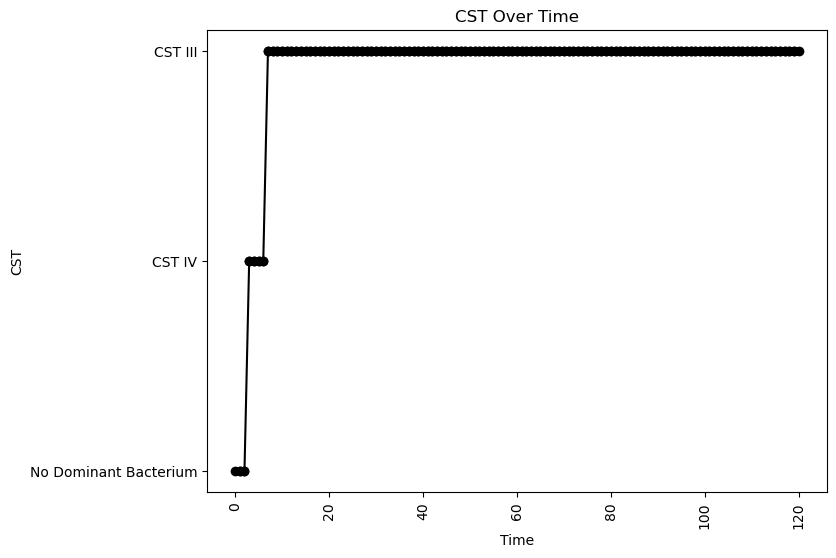


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.04325468535074536
nAB->Li: -0.2203230780240611
nAB->oLB: -0.4759684151228997
Li->nAB: 0.14452617778404853
Li Self: -0.04055043027739938
Li->oLB: 0.08959652114079963
oLB->nAB: -0.4595415466280194
oLB->Li: -0.26175661717488025
oLB Self: -0.0025302758620002613

Simulation 599 follows a valid CST progression:


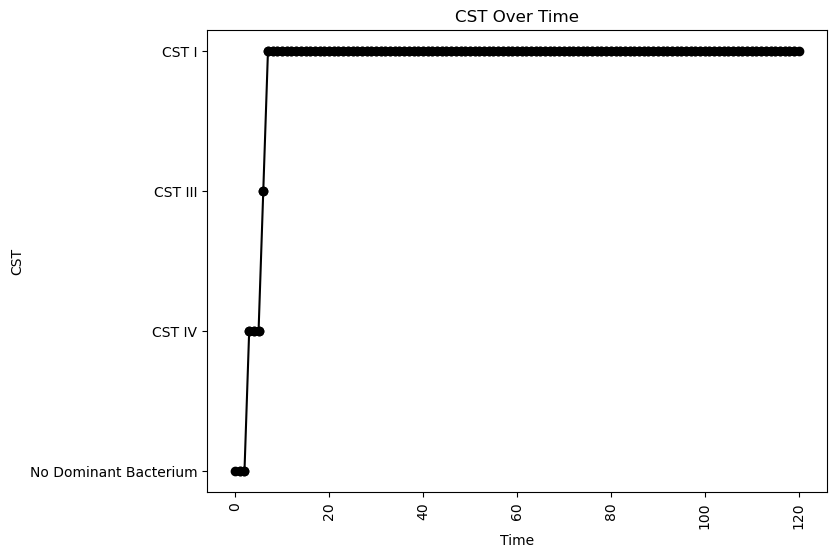


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.07662112779896857
nAB->Li: 0.11456651798888107
nAB->oLB: -0.12945668649522374
Li->nAB: 0.29918469892788246
Li Self: -0.07648388415806295
Li->oLB: 0.01621279987669655
oLB->nAB: -0.24926952998931995
oLB->Li: 0.225908807129383
oLB Self: -0.007970579339432127

Simulation 601 follows a valid CST progression:


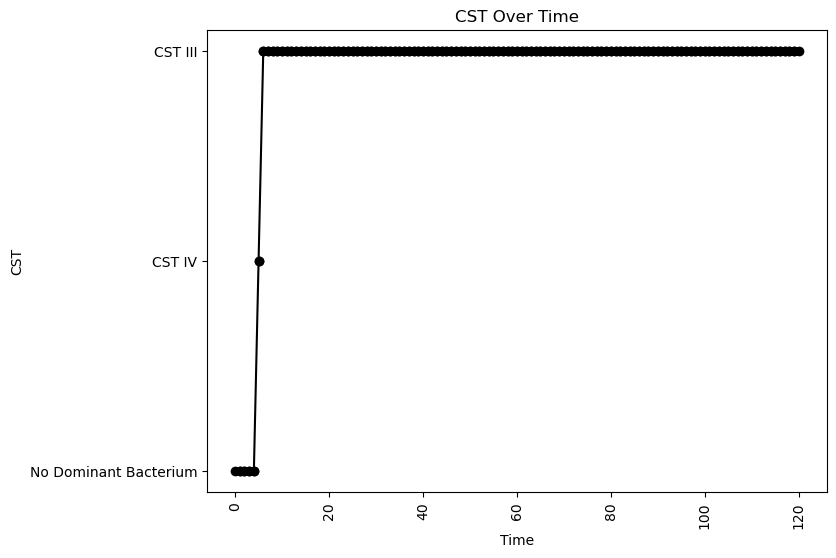


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.025523891394619233
nAB->Li: -0.33367999568928003
nAB->oLB: -0.27403948371187964
Li->nAB: 0.48880102381400303
Li Self: -0.05342172493343865
Li->oLB: 0.3234101288102528
oLB->nAB: -0.2618058529842181
oLB->Li: -0.17495925525743417
oLB Self: -0.017798597149032216

Simulation 608 follows a valid CST progression:


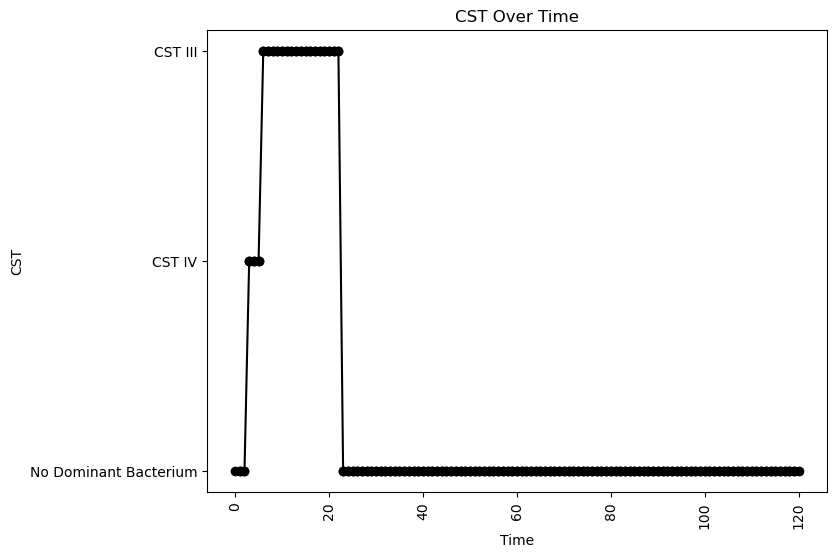


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.013902732323553685
nAB->Li: 0.04777981281238286
nAB->oLB: -0.32799287813169276
Li->nAB: 0.22029603792618058
Li Self: -0.0309666136429715
Li->oLB: 0.20908568172551945
oLB->nAB: -0.2975214366230712
oLB->Li: -0.23666005361347509
oLB Self: -0.09487041931320071

Simulation 612 follows a valid CST progression:


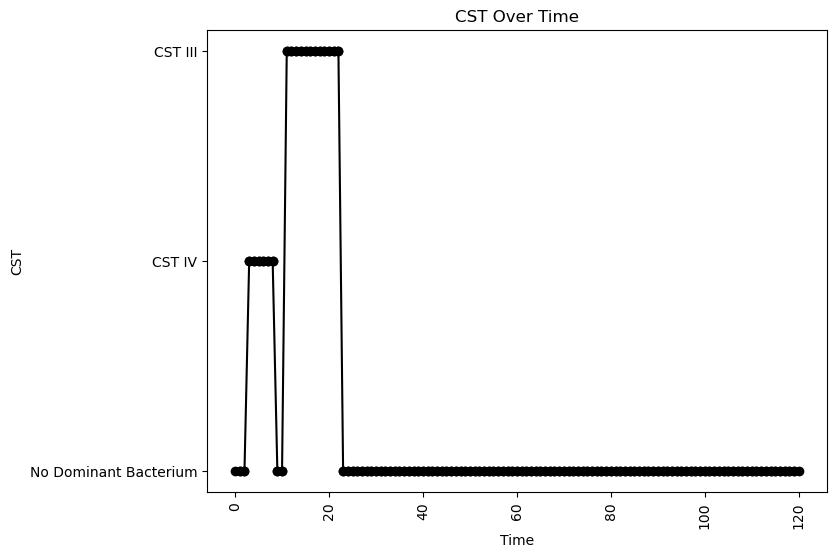


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.08214521428913413
nAB->Li: -0.28608803166614283
nAB->oLB: -0.04142820020564947
Li->nAB: 0.07418728154975074
Li Self: -0.03684400437374283
Li->oLB: 0.20545789932326097
oLB->nAB: -0.35927759287561967
oLB->Li: 0.27672107119089784
oLB Self: -0.05941974599009766

Simulation 615 follows a valid CST progression:


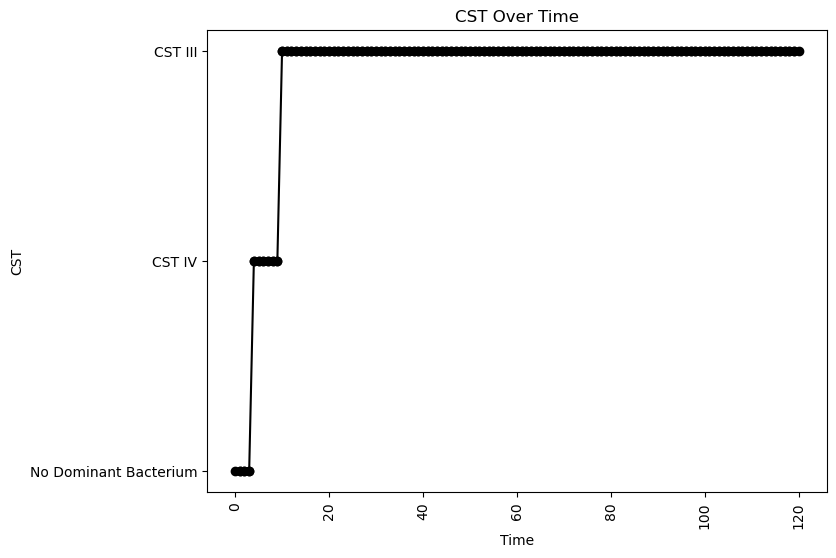


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.06588016524244639
nAB->Li: -0.48156295842152863
nAB->oLB: -0.27618562243400013
Li->nAB: 0.096469976696688
Li Self: -0.01954747671760959
Li->oLB: 0.07097467142694391
oLB->nAB: -0.018553711332387146
oLB->Li: -0.44963101045647846
oLB Self: -0.06412045611113365

Simulation 623 follows a valid CST progression:


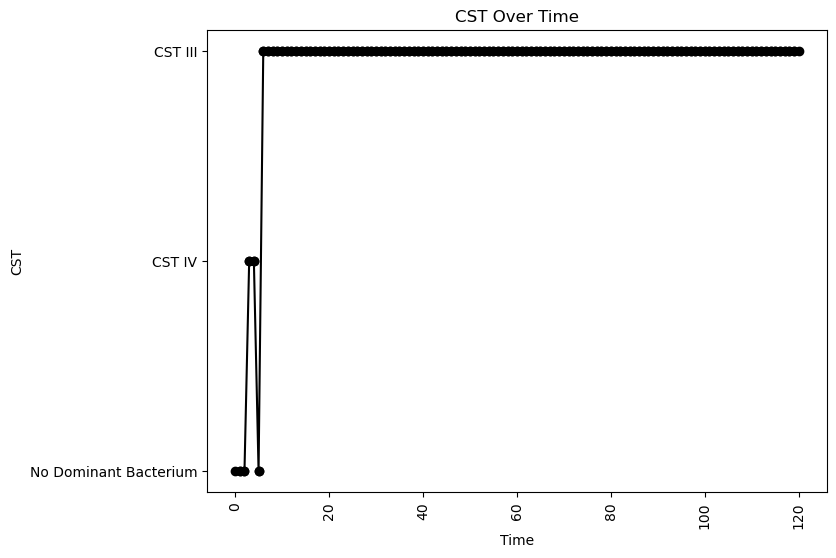


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.03787304337183172
nAB->Li: -0.12945481078879356
nAB->oLB: -0.3852203469714103
Li->nAB: 0.29778576748975905
Li Self: -0.04739949718941842
Li->oLB: 0.40314885818341295
oLB->nAB: -0.3635460767469638
oLB->Li: -0.15253462515413974
oLB Self: -0.09427729062836313

Simulation 631 follows a valid CST progression:


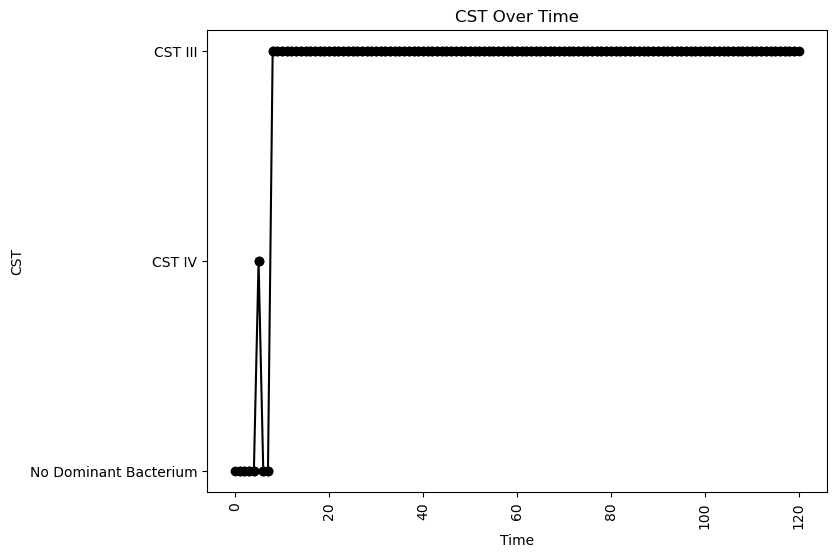


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.3511513632199777
oLB Growth: 0.5869968137568807
nAB Self: -0.03518690642644949
nAB->Li: 0.006960925610931867
nAB->oLB: -0.13799935055602097
Li->nAB: 0.18855474365537284
Li Self: -0.09831302794885384
Li->oLB: -0.45871665991534255
oLB->nAB: -0.4930967512040888
oLB->Li: -0.1505354679642712
oLB Self: -0.010027263426999236

Simulation 638 follows a valid CST progression:


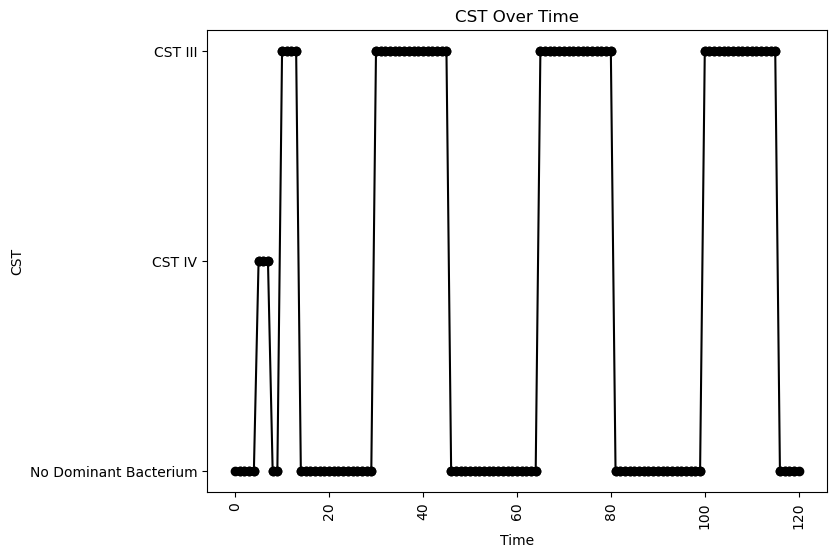


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.2402168577280491
oLB Growth: 0.1731103059651596
nAB Self: -0.03633514444077028
nAB->Li: -0.15796992055767972
nAB->oLB: -0.47581265281330243
Li->nAB: 0.08937611129775713
Li Self: -0.09084364148642278
Li->oLB: -0.4967880676685236
oLB->nAB: -0.38203772848901457
oLB->Li: -0.41071904293077177
oLB Self: -0.008770130699322004

Simulation 639 follows a valid CST progression:


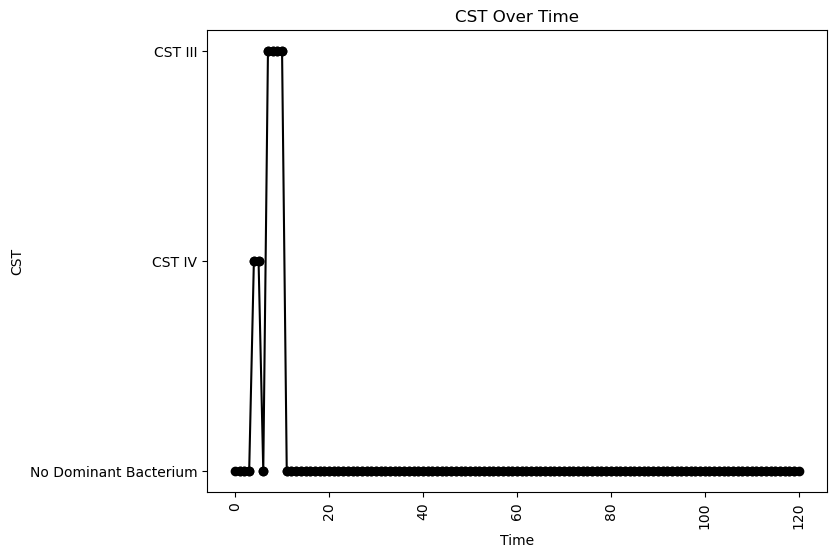


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.05153500791190812
nAB->Li: -0.26497494950903194
nAB->oLB: -0.005170307249669548
Li->nAB: 0.3446030004698153
Li Self: -0.04977852695726413
Li->oLB: 0.14914712854784684
oLB->nAB: -0.16493187898576323
oLB->Li: 0.13583916856802236
oLB Self: -0.07209341957585508

Simulation 641 follows a valid CST progression:


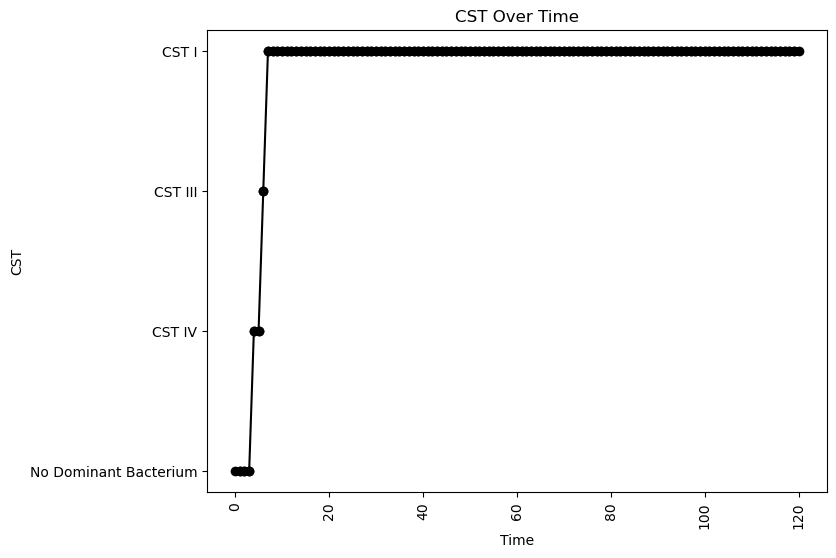


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.011303299063310165
nAB->Li: -0.014043224717198488
nAB->oLB: -0.10787638585471171
Li->nAB: 0.38328591466723383
Li Self: -0.01639753951682736
Li->oLB: -0.003748871156506961
oLB->nAB: -0.3280499818915197
oLB->Li: 0.47991146247080296
oLB Self: -0.08616700893323512

Simulation 646 follows a valid CST progression:


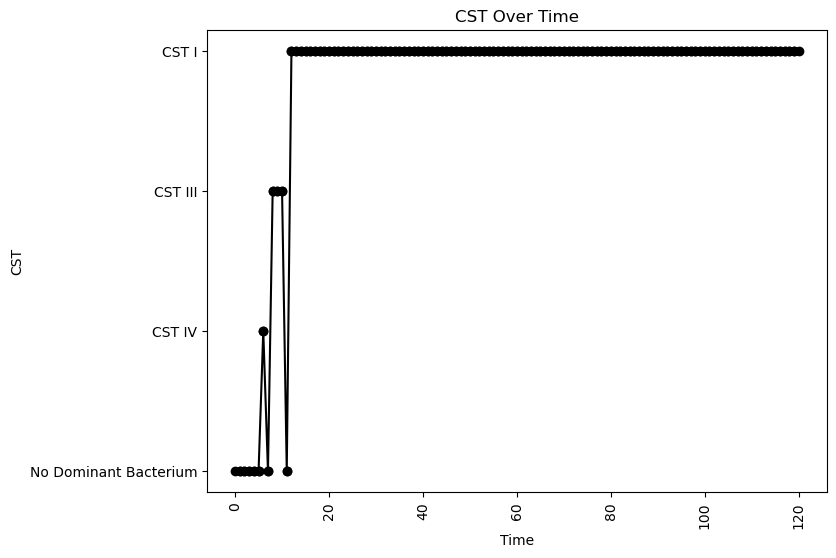


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.08806297407447466
oLB Growth: 0.1039349296945926
nAB Self: -0.0747754788637495
nAB->Li: -0.3649014231388333
nAB->oLB: -0.3094282457229792
Li->nAB: 0.20062910745426654
Li Self: -0.03839972656175921
Li->oLB: -0.20331888493979589
oLB->nAB: -0.16440003786599727
oLB->Li: 0.20564474009425948
oLB Self: -0.07293407294553975

Simulation 650 follows a valid CST progression:


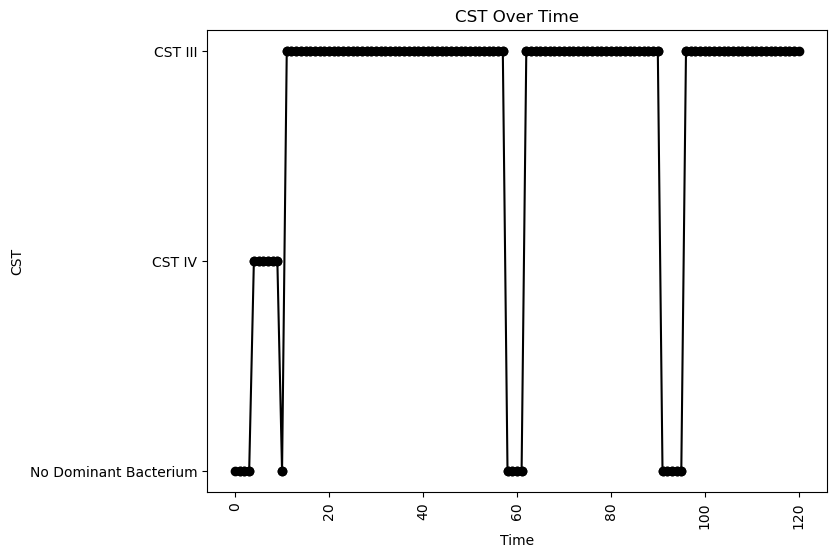


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.0962663871549598
nAB->Li: -0.411734732449253
nAB->oLB: -0.04125328837171677
Li->nAB: 0.15960156860951924
Li Self: -0.08663411835076645
Li->oLB: -0.14021083493250674
oLB->nAB: -0.18673676721723032
oLB->Li: -0.4271034602098119
oLB Self: -0.060939181776602194

Simulation 655 follows a valid CST progression:


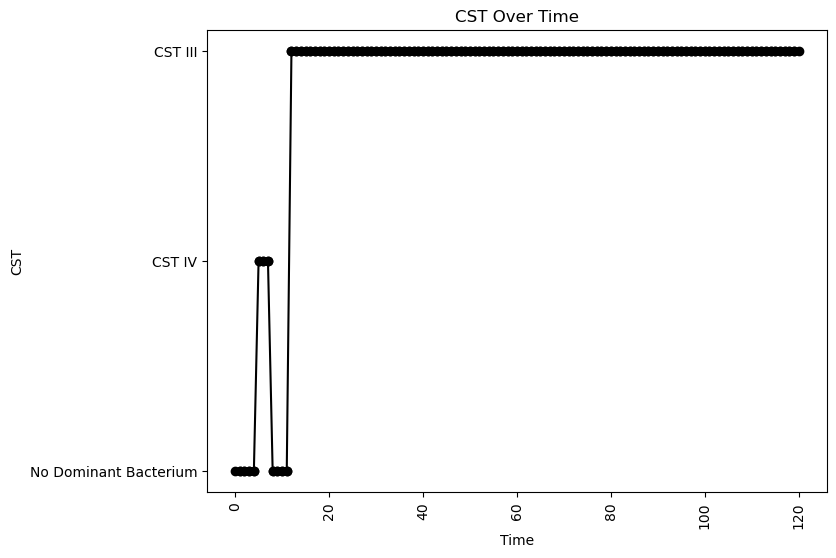


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.14758049831591902
oLB Growth: 0.20431222189445272
nAB Self: -0.09089537368186977
nAB->Li: -0.24912743747664823
nAB->oLB: -0.31521693981114896
Li->nAB: 0.028448859850004005
Li Self: -0.09318022730185255
Li->oLB: 0.4773407706373214
oLB->nAB: -0.01830431730922516
oLB->Li: 0.05891070064472215
oLB Self: -0.03374986985761713

Simulation 659 follows a valid CST progression:


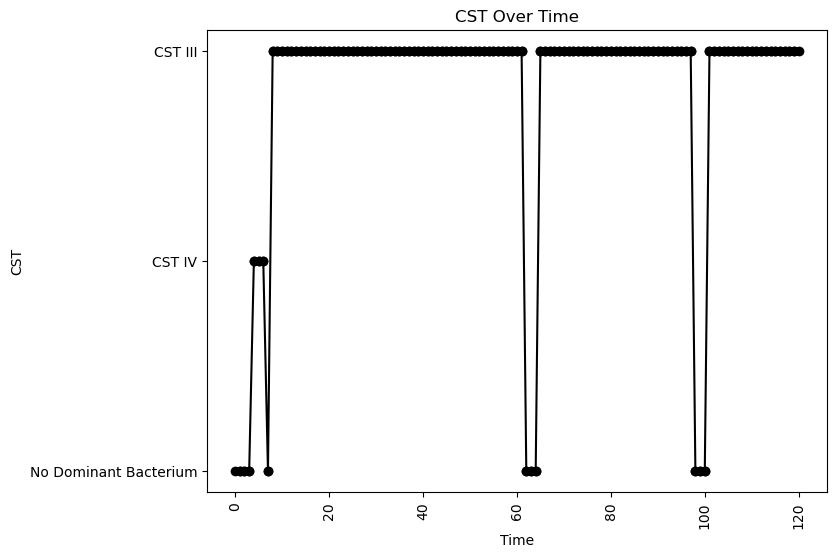


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.06656912646676387
nAB->Li: -0.4137804574647242
nAB->oLB: -0.10810150465085655
Li->nAB: 0.1859466480774652
Li Self: -0.06478110085913136
Li->oLB: 0.3506387238728633
oLB->nAB: -0.15239488235981646
oLB->Li: -0.4471284234937776
oLB Self: -0.07422615569841404

Simulation 667 follows a valid CST progression:


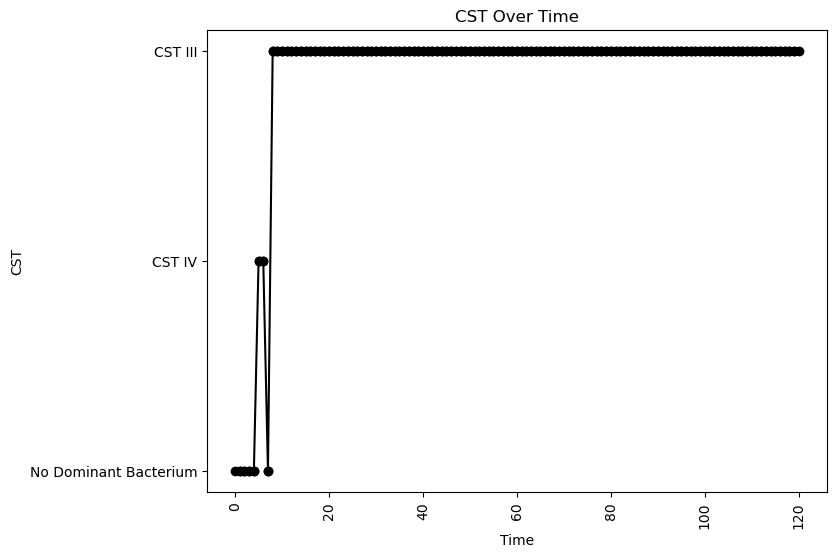


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.24534196178297013
oLB Growth: 0.16744057753178704
nAB Self: -0.02721314387358595
nAB->Li: -0.12152683917638035
nAB->oLB: -0.3685723082741592
Li->nAB: 0.16868932804063674
Li Self: -0.07530505411963082
Li->oLB: 0.1602422035463955
oLB->nAB: -0.24762400746235835
oLB->Li: -0.4250106648216828
oLB Self: -0.04554710280685699

Simulation 680 follows a valid CST progression:


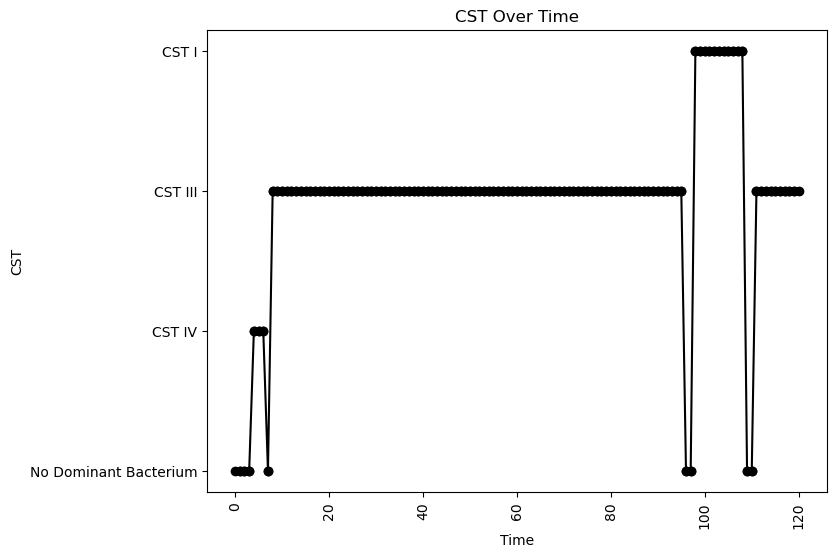


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.09960692830066677
nAB->Li: -0.33945615254249084
nAB->oLB: -0.07469429177082776
Li->nAB: 0.30426080086780194
Li Self: -0.042387112250416574
Li->oLB: -0.04444694125369547
oLB->nAB: -0.2090544974210552
oLB->Li: -0.0880086213935855
oLB Self: -0.08800833686015123

Simulation 681 follows a valid CST progression:


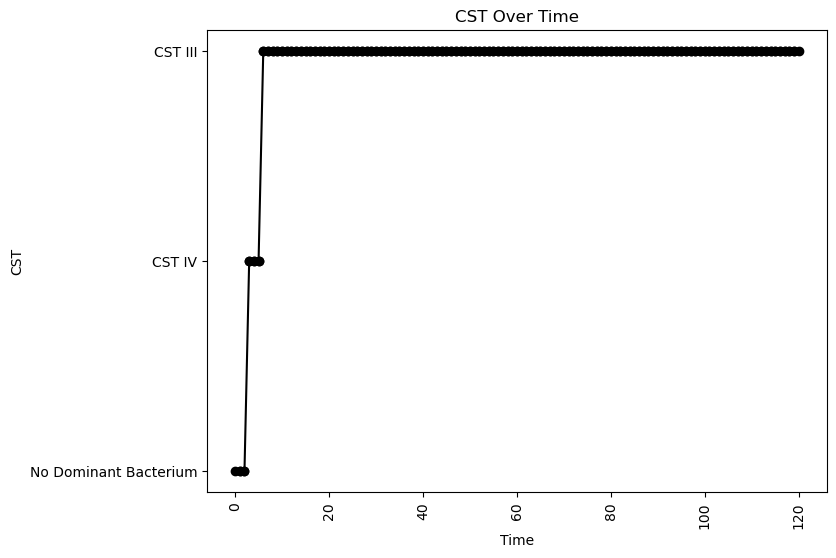


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.017981315773062098
nAB->Li: -0.09594167171838092
nAB->oLB: -0.3441649097335422
Li->nAB: 0.2532186518636682
Li Self: -0.05094931682992221
Li->oLB: 0.21719760902508733
oLB->nAB: -0.38542343492108594
oLB->Li: -0.029100635207137515
oLB Self: -0.04138675649353746

Simulation 690 follows a valid CST progression:


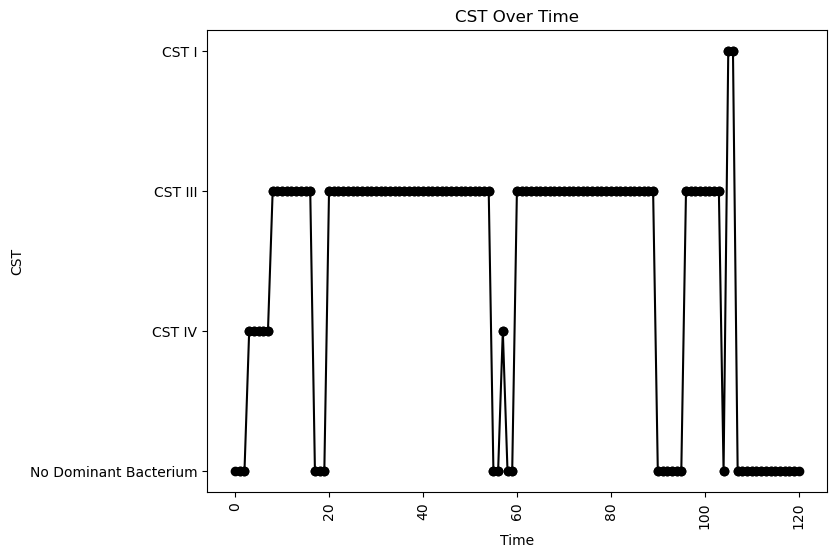


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.05793821476496831
nAB->Li: -0.43809294660018416
nAB->oLB: -0.02879505835216023
Li->nAB: 0.1622152879477209
Li Self: -0.08954876398403032
Li->oLB: 0.026580684802007704
oLB->nAB: -0.49355047425573767
oLB->Li: 0.017203317085864422
oLB Self: -0.056966226446657366

Simulation 694 follows a valid CST progression:


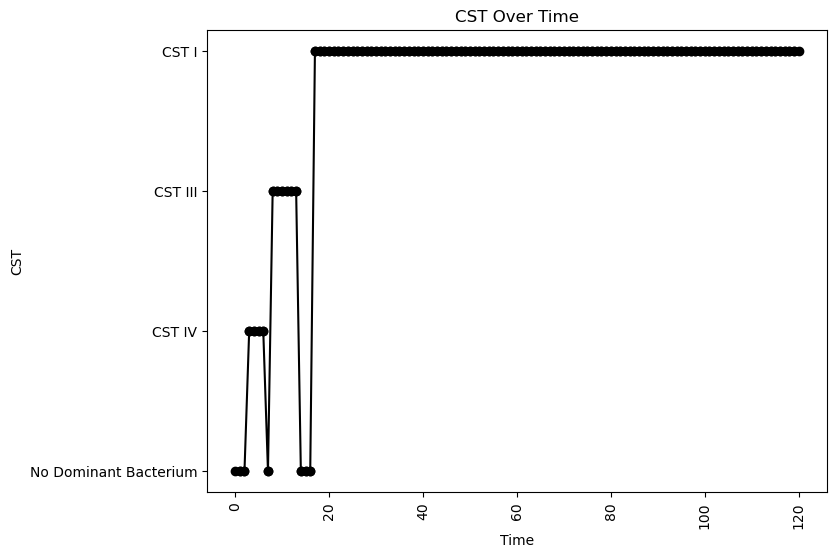


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.04673537687600939
nAB->Li: -0.22916156272137667
nAB->oLB: -0.22515567340865267
Li->nAB: 0.29718978765397597
Li Self: -0.09156389855207989
Li->oLB: -0.3334295709620964
oLB->nAB: -0.3887928695412938
oLB->Li: 0.26099983066744503
oLB Self: -0.01768058714723461

Simulation 702 follows a valid CST progression:


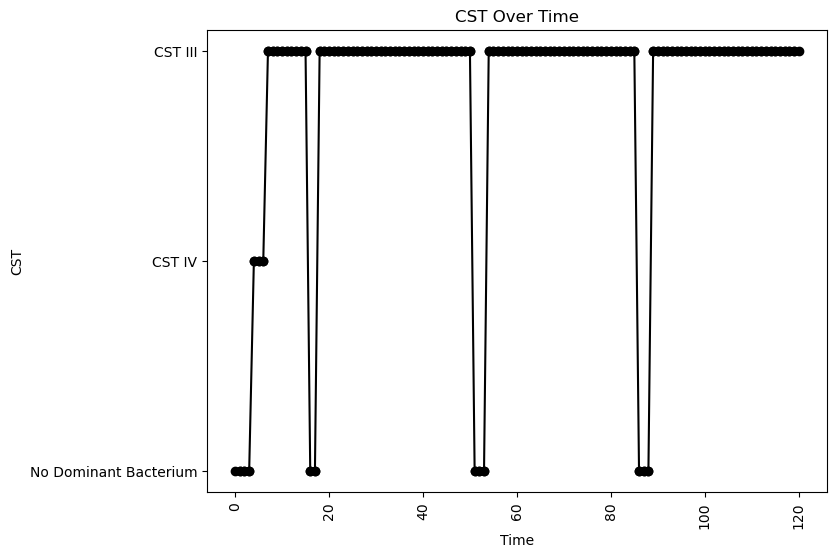


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.003257396994318068
nAB->Li: -0.37260605614764375
nAB->oLB: -0.43840952066047095
Li->nAB: 0.20894788889677363
Li Self: -0.09482521994004066
Li->oLB: 0.24400300668774078
oLB->nAB: -0.32386857269359204
oLB->Li: -0.32997645893786387
oLB Self: -0.02471481439718015

Simulation 704 follows a valid CST progression:


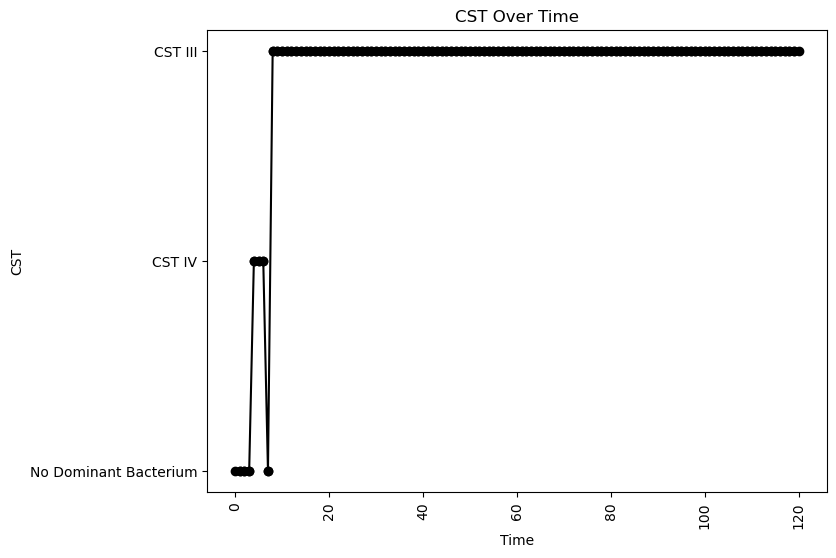


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.07008682220369516
nAB->Li: -0.02259972935970772
nAB->oLB: -0.37544959857121496
Li->nAB: 0.24306133429538135
Li Self: -0.06205381951230789
Li->oLB: 0.009186005165186306
oLB->nAB: -0.3669430853407618
oLB->Li: -0.48903220817042026
oLB Self: -0.05911810242706673

Simulation 709 follows a valid CST progression:


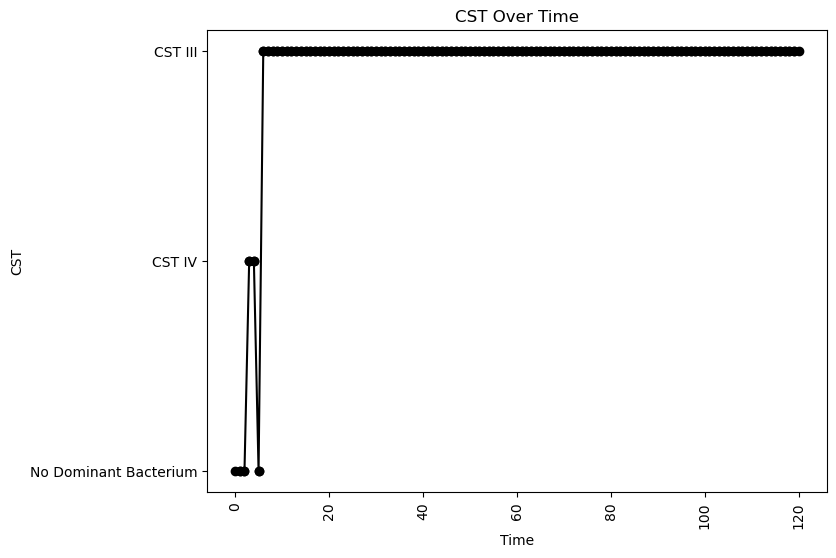


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.011590607527919572
nAB->Li: 0.029240168219784812
nAB->oLB: -0.03347583691270706
Li->nAB: 0.276776861216783
Li Self: -0.048924128800656705
Li->oLB: 0.07352887202163161
oLB->nAB: -0.06184618374930606
oLB->Li: -0.47919458687425703
oLB Self: -0.0986979896257201

Simulation 710 follows a valid CST progression:


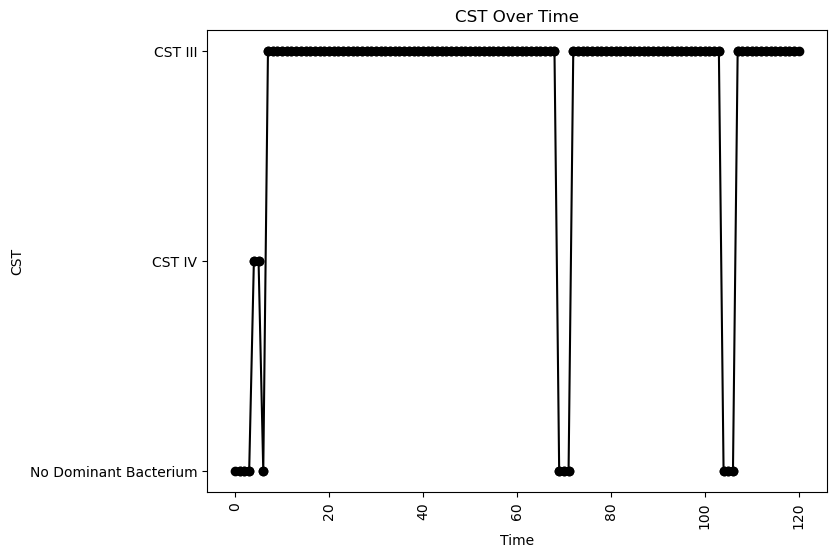


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.0086809672667085
nAB->Li: -0.16992126989469675
nAB->oLB: -0.0449960727388965
Li->nAB: 0.3441789124091025
Li Self: -0.08136608874555813
Li->oLB: -0.3757572361649566
oLB->nAB: -0.47134248311508703
oLB->Li: 0.04204196854843467
oLB Self: -0.05924238239536781

Simulation 713 follows a valid CST progression:


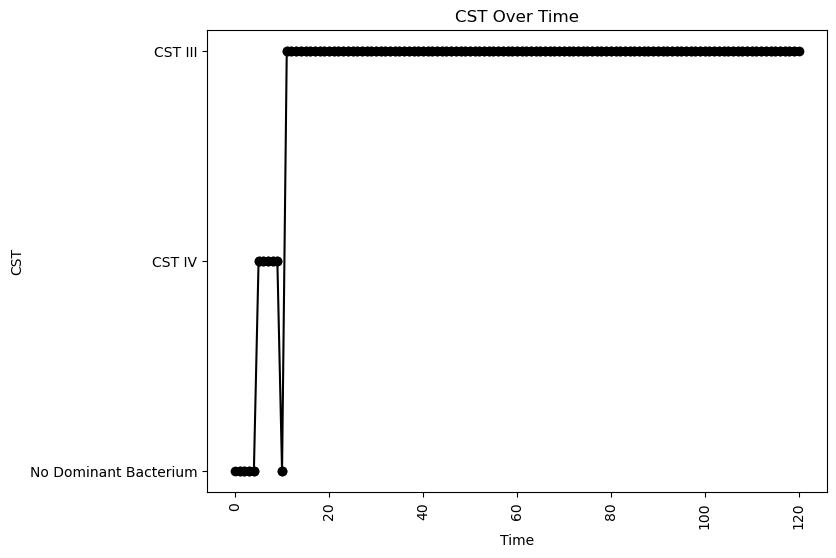


Interaction Parameters:
nAB Growth: 2.2489702826927647
Li Growth: 0.07143879299629578
oLB Growth: 0.24213610993368434
nAB Self: -0.003929792090896209
nAB->Li: -0.27435124563022417
nAB->oLB: -0.41202472532265855
Li->nAB: 0.22165920727066968
Li Self: -0.07908680679832229
Li->oLB: -0.45103723914688204
oLB->nAB: -0.026876674211099905
oLB->Li: -0.31997319720592227
oLB Self: -0.018747701818539575

Simulation 724 follows a valid CST progression:


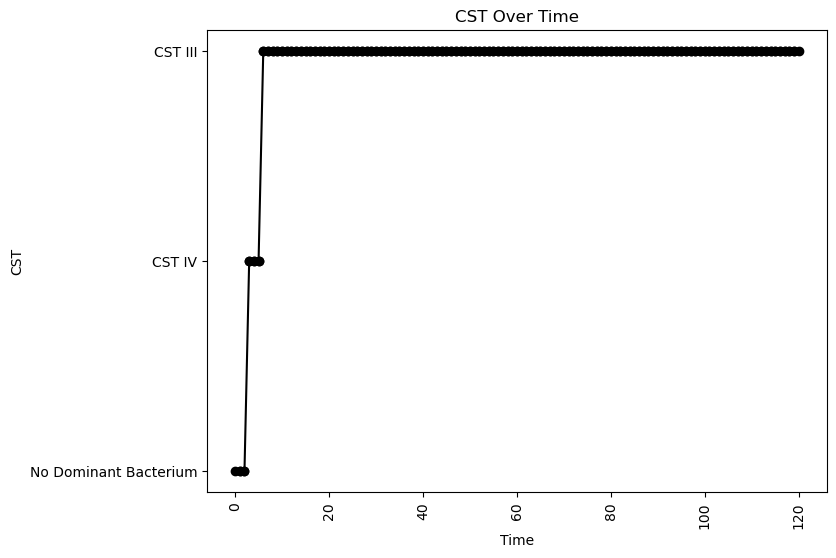


Interaction Parameters:
nAB Growth: 2.300652803872004
Li Growth: 0.06616501714537036
oLB Growth: 0.4369767544558836
nAB Self: -0.01652483992467324
nAB->Li: -0.4772232504108916
nAB->oLB: -0.47682619504364937
Li->nAB: 0.35730629754759113
Li Self: -0.01232944007633155
Li->oLB: 0.40619774209039383
oLB->nAB: -0.24610431912663827
oLB->Li: -0.45749380862486966
oLB Self: -0.005281990879815984

Simulation 726 follows a valid CST progression:


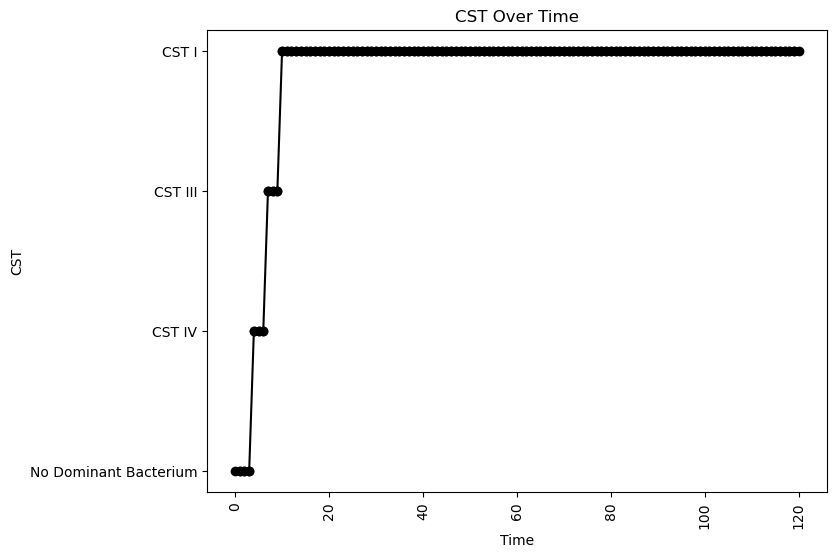


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.03136853206226507
nAB->Li: -0.4462325312381295
nAB->oLB: -0.24498109078894947
Li->nAB: 0.3057832744435731
Li Self: -0.04444676352867226
Li->oLB: -0.3403266565444172
oLB->nAB: -0.29193169368332794
oLB->Li: 0.34131349445072734
oLB Self: -0.03675873706244595

Simulation 727 follows a valid CST progression:


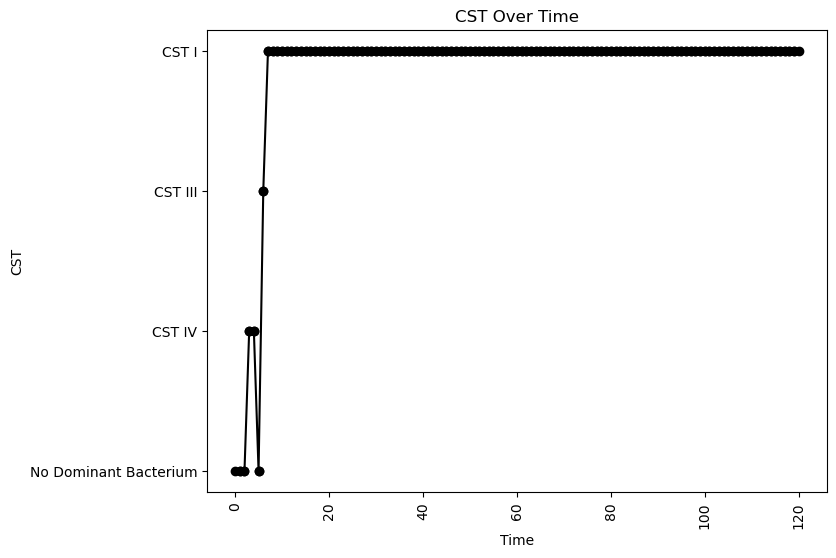


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.06309763455319839
oLB Growth: 0.9128027925042091
nAB Self: -0.06507120670845849
nAB->Li: -0.08831492063382973
nAB->oLB: -0.06845376927045993
Li->nAB: 0.42999532241202454
Li Self: -0.024851245220296594
Li->oLB: -0.01971467326444315
oLB->nAB: -0.1430998602904996
oLB->Li: 0.21395801715241147
oLB Self: -0.07705212347219104

Simulation 730 follows a valid CST progression:


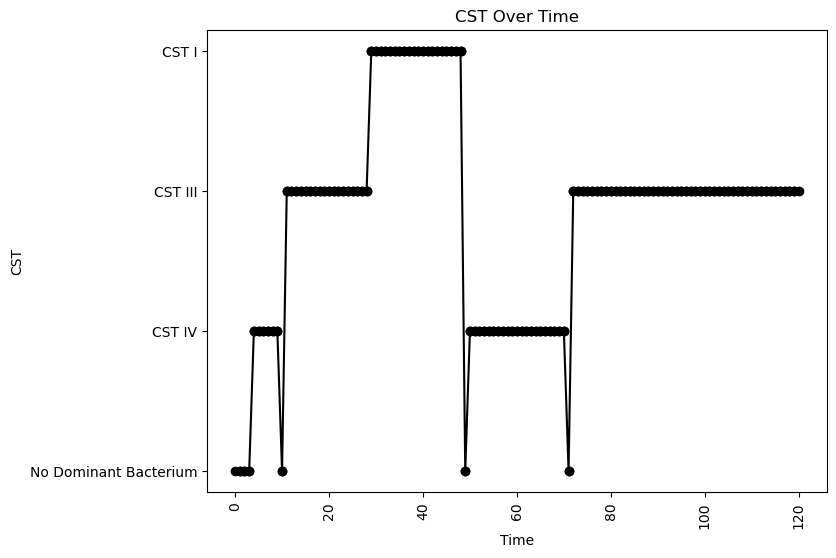


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.10991064156276614
oLB Growth: 0.16744057753178704
nAB Self: -0.03490375760292083
nAB->Li: -0.2505446868079295
nAB->oLB: -0.10465979405730735
Li->nAB: 0.02288104222591658
Li Self: -0.011717921429425363
Li->oLB: -0.14258733524319595
oLB->nAB: -0.4640062017922451
oLB->Li: 0.2046827059878915
oLB Self: -0.05711895728034462

Simulation 731 follows a valid CST progression:


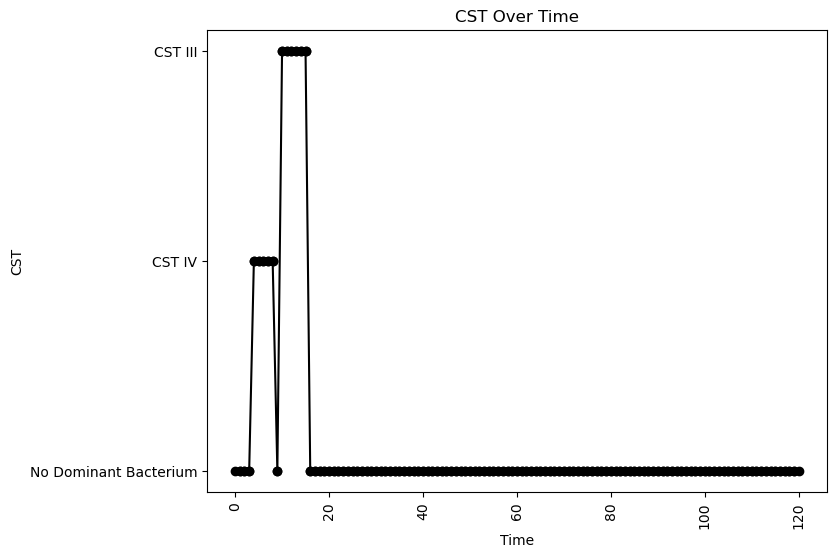


Interaction Parameters:
nAB Growth: 2.2446146183745257
Li Growth: 0.07278030322941353
oLB Growth: 0.5438660619757455
nAB Self: -0.047089699870780696
nAB->Li: -0.12720375195792716
nAB->oLB: -0.038625765826606095
Li->nAB: 0.08727026778979274
Li Self: -0.06236102584570687
Li->oLB: 0.42298765077751155
oLB->nAB: -0.4521149570635493
oLB->Li: 0.48223913975601596
oLB Self: -0.047478945741529166

Simulation 751 follows a valid CST progression:


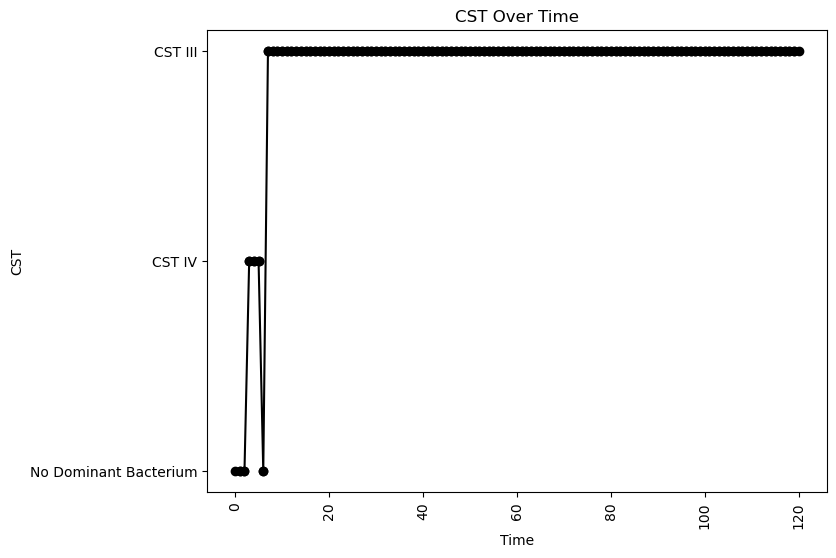


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.06588260315658048
oLB Growth: 0.21113539622386296
nAB Self: -0.04821562357872123
nAB->Li: -0.3847091639704579
nAB->oLB: -0.34026673351252645
Li->nAB: 0.26057727729459135
Li Self: -0.011571501301466156
Li->oLB: 0.06106800730181006
oLB->nAB: -0.2284903440434966
oLB->Li: -0.42819879648683534
oLB Self: -0.018350338642238867

Simulation 755 follows a valid CST progression:


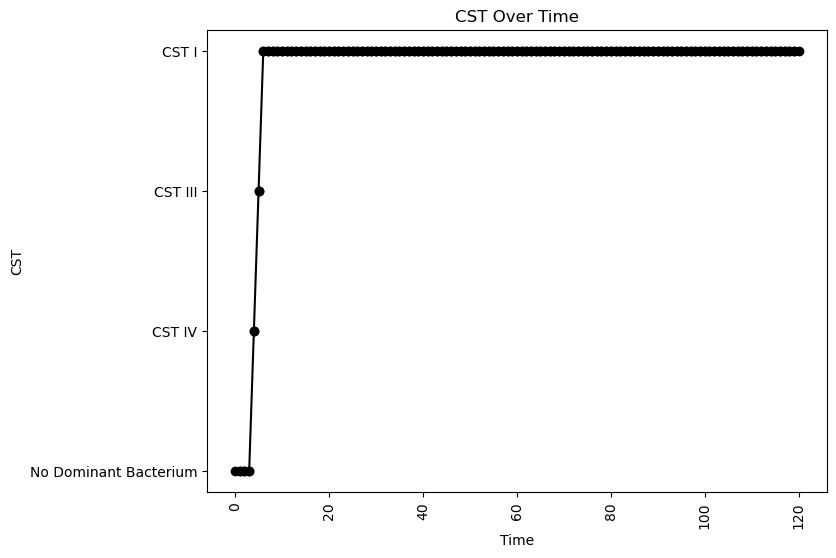


Interaction Parameters:
nAB Growth: 2.286323001067126
Li Growth: 0.16026244710704726
oLB Growth: 0.14091260068383374
nAB Self: -0.027620585330601105
nAB->Li: -0.006798088765604338
nAB->oLB: -0.13291989493562179
Li->nAB: 0.34438651539539666
Li Self: -0.052677744621698795
Li->oLB: 0.056549363269673525
oLB->nAB: -0.11618366671470848
oLB->Li: 0.20525086936674686
oLB Self: -0.07493498326048506

Simulation 764 follows a valid CST progression:


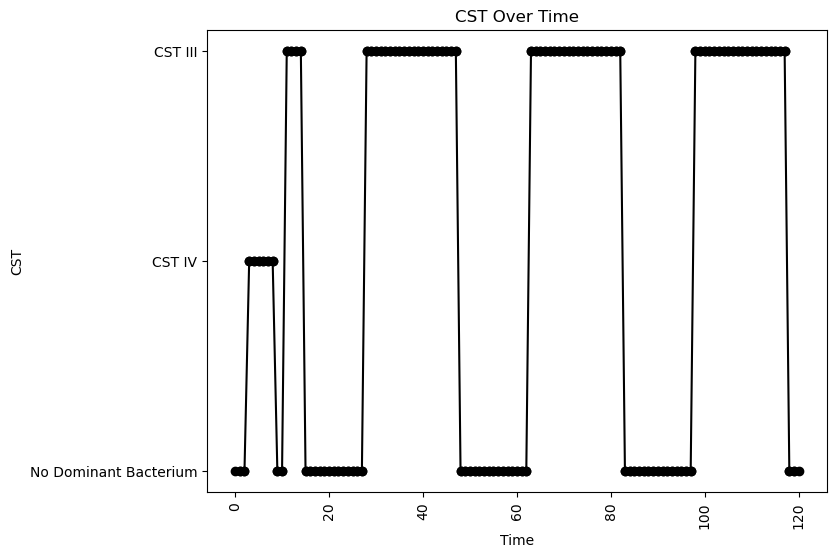


Interaction Parameters:
nAB Growth: 2.2657644953374403
Li Growth: 0.07173881162026666
oLB Growth: 0.2949021384914317
nAB Self: -0.0955229197170106
nAB->Li: -0.3434932406760204
nAB->oLB: -0.36488211065321274
Li->nAB: 0.11641977681105675
Li Self: -0.09714240614676196
Li->oLB: -0.39799356684920073
oLB->nAB: -0.24182541803121027
oLB->Li: -0.3283865453049851
oLB Self: -0.03920536004734662

Simulation 768 follows a valid CST progression:


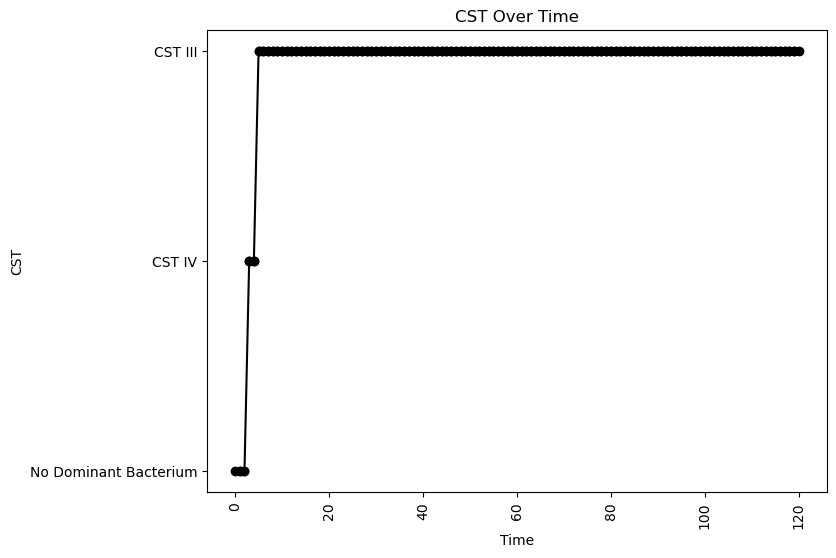


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.12336392117650052
oLB Growth: 0.1731103059651596
nAB Self: -0.03172349218416004
nAB->Li: -0.39900651407496573
nAB->oLB: -0.1326153698630284
Li->nAB: 0.3545814608036678
Li Self: -0.01402845848583291
Li->oLB: -0.4382525814449671
oLB->nAB: -0.43513234546517443
oLB->Li: -0.22360306047767553
oLB Self: -0.05349418506833797

Simulation 788 follows a valid CST progression:


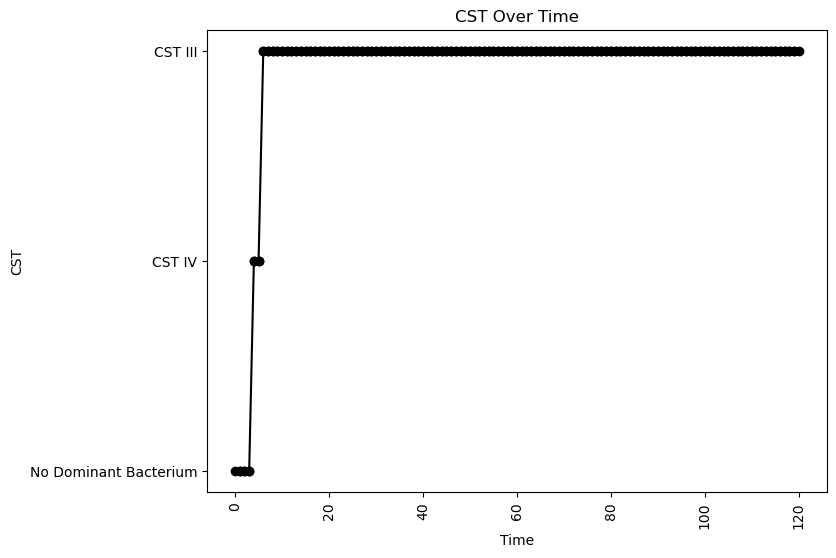


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.2064938861261019
oLB Growth: 0.1039349296945926
nAB Self: -0.03519847735174389
nAB->Li: -0.17956955503445404
nAB->oLB: -0.14136358405296467
Li->nAB: 0.17290302593770002
Li Self: -0.011085462369349736
Li->oLB: 0.03315933562088169
oLB->nAB: -0.07099628100717337
oLB->Li: -0.46241761425159533
oLB Self: -0.01857234028943036

Simulation 789 follows a valid CST progression:


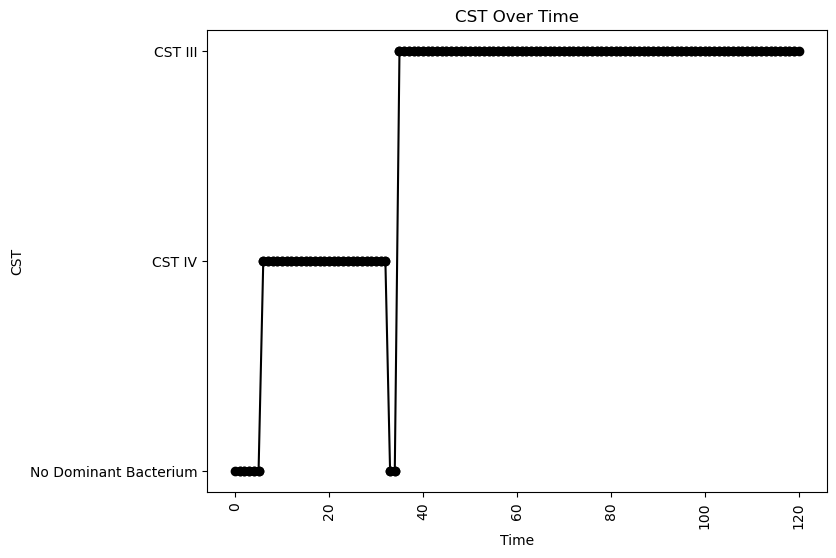


Interaction Parameters:
nAB Growth: 2.0745101401728236
Li Growth: 0.010341045972876578
oLB Growth: 1.1507970527071554
nAB Self: -0.0539392416071411
nAB->Li: 0.0682622670237496
nAB->oLB: -0.22236770968701325
Li->nAB: -0.03379890914094935
Li Self: -0.03315464450405434
Li->oLB: 0.32210608394077256
oLB->nAB: -0.07897654179470659
oLB->Li: 0.10597792391059846
oLB Self: -0.03924842558217734

Simulation 798 follows a valid CST progression:


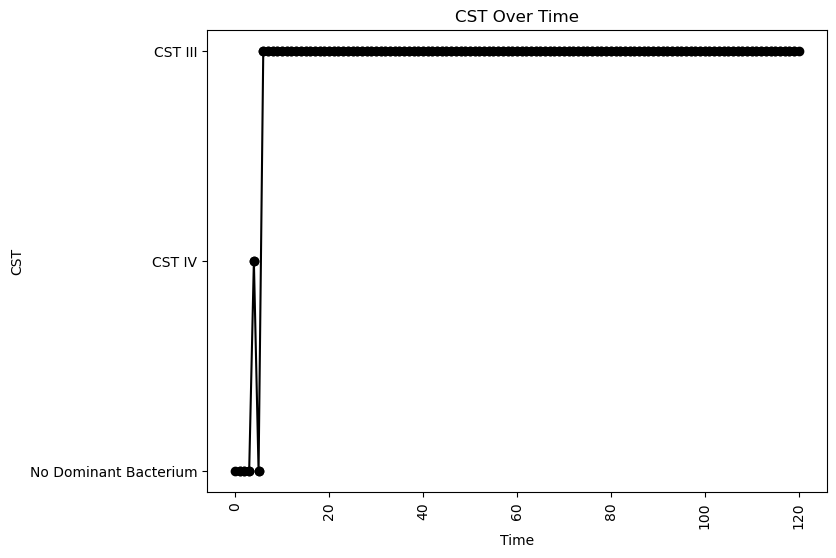


Interaction Parameters:
nAB Growth: 2.2609282147211935
Li Growth: 0.06381435834914458
oLB Growth: 0.1660151901294062
nAB Self: -0.0864525891556614
nAB->Li: 0.24230403245035004
nAB->oLB: -0.1921673679122236
Li->nAB: 0.4077839477425609
Li Self: -0.019347601946723483
Li->oLB: -0.14501593394487666
oLB->nAB: -0.17473128325476223
oLB->Li: -0.1080247355495978
oLB Self: -0.04355929542460577

Simulation 815 follows a valid CST progression:


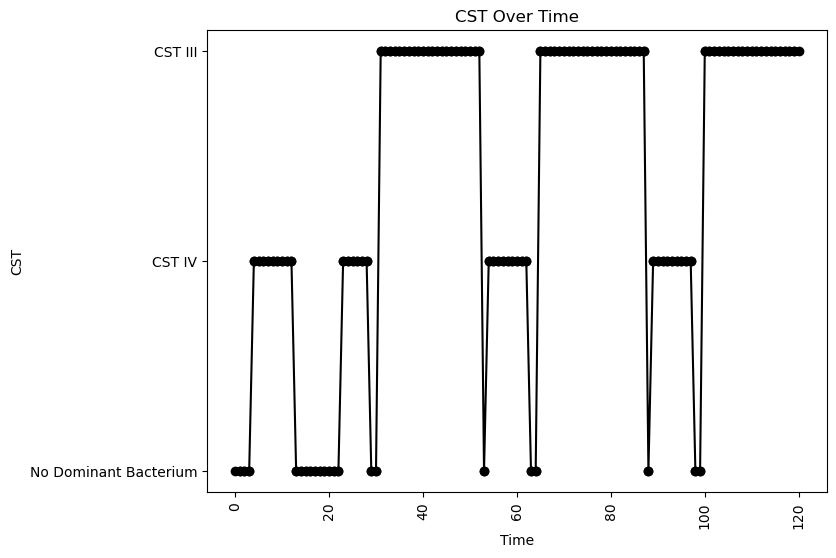


Interaction Parameters:
nAB Growth: 2.226251684223429
Li Growth: 0.0760937960697033
oLB Growth: 0.4505921706771102
nAB Self: -0.03349643322169418
nAB->Li: -0.4837590686716316
nAB->oLB: -0.4087011529322054
Li->nAB: 0.0426030158897589
Li Self: -0.09898565456213516
Li->oLB: -0.3204898813851056
oLB->nAB: -0.44341073242386075
oLB->Li: -0.4187913270221334
oLB Self: -0.04429760589126222

Simulation 820 follows a valid CST progression:


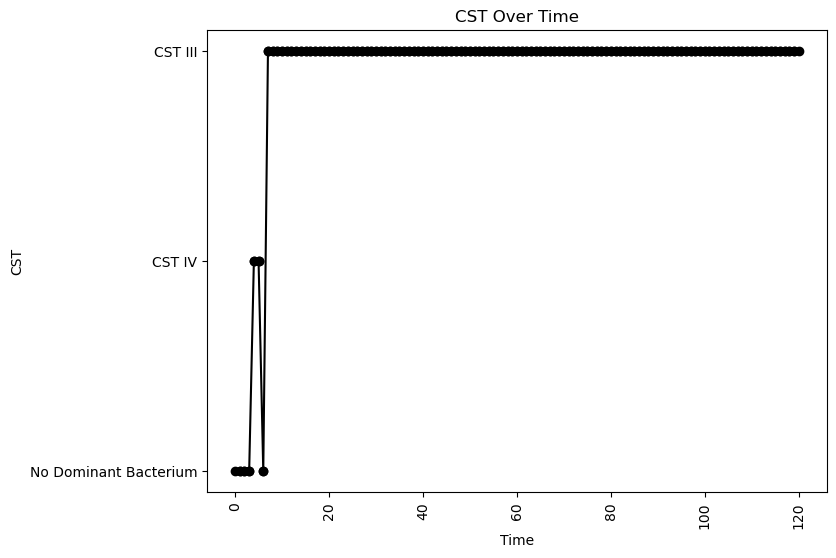


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.04312630193800883
nAB->Li: -0.42782377686901707
nAB->oLB: -0.2678483502917838
Li->nAB: 0.1599760181826423
Li Self: -0.02740797306329991
Li->oLB: 0.19451912309821906
oLB->nAB: -0.013013984232851106
oLB->Li: -0.12295379110865678
oLB Self: -0.008782200154326944

Simulation 837 follows a valid CST progression:


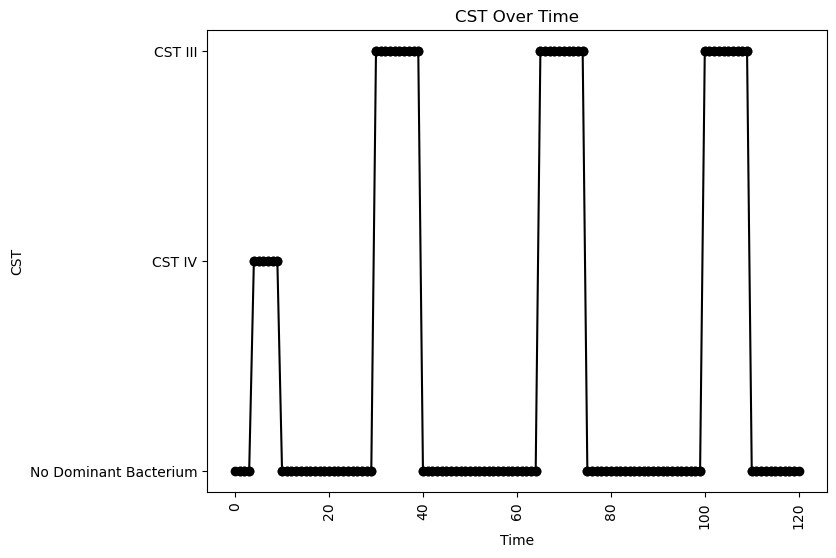


Interaction Parameters:
nAB Growth: 2.2446146183745257
Li Growth: 0.07278030322941353
oLB Growth: 0.5438660619757455
nAB Self: -0.07189659748180771
nAB->Li: -0.018672311278555564
nAB->oLB: -0.348910320199532
Li->nAB: 0.07154351547863524
Li Self: -0.06093498526362187
Li->oLB: 0.34286790125441235
oLB->nAB: -0.04178259862174116
oLB->Li: -0.2424144049758178
oLB Self: -0.04310306396205694

Simulation 838 follows a valid CST progression:


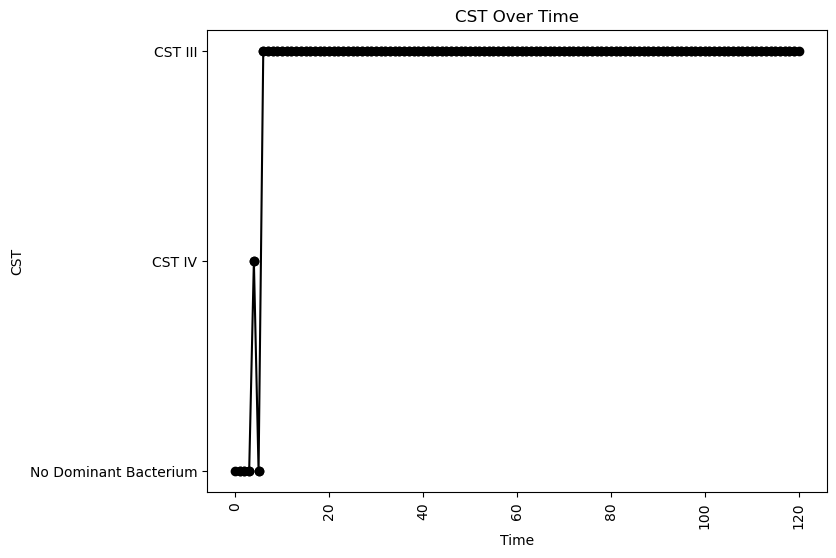


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.08327379305217275
nAB->Li: 0.15261860388420068
nAB->oLB: -0.4158646514259947
Li->nAB: 0.3643682977752922
Li Self: -0.09254292680944627
Li->oLB: 0.19082802577008706
oLB->nAB: -0.15999947695591
oLB->Li: -0.40031863068969087
oLB Self: -0.01924704288391753

Simulation 841 follows a valid CST progression:


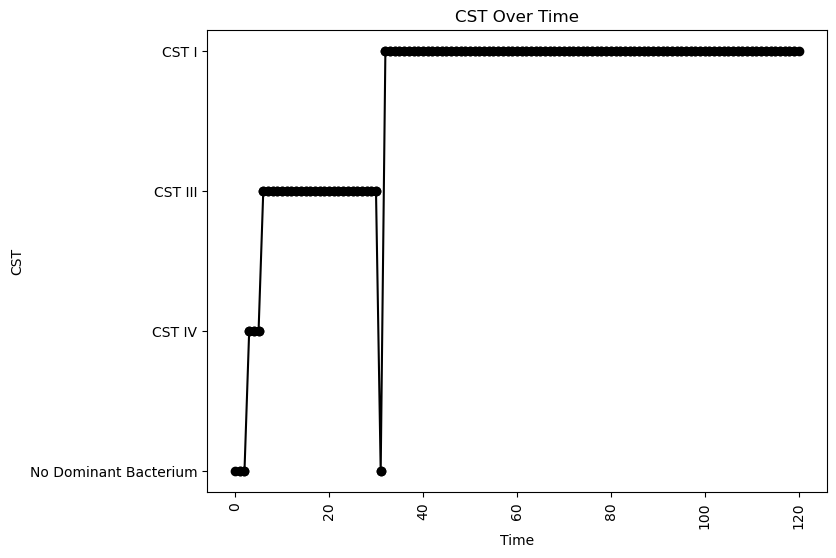


Interaction Parameters:
nAB Growth: 2.292952252819776
Li Growth: 0.06862578763464611
oLB Growth: 0.25066683866219575
nAB Self: -0.028892031129047174
nAB->Li: -0.2876990273349711
nAB->oLB: -0.394387265817678
Li->nAB: 0.41918554840823974
Li Self: -0.02080203906663973
Li->oLB: -0.44339097452207027
oLB->nAB: -0.14231176134299106
oLB->Li: -0.05001656521874315
oLB Self: -0.07513187065419376

Simulation 848 follows a valid CST progression:


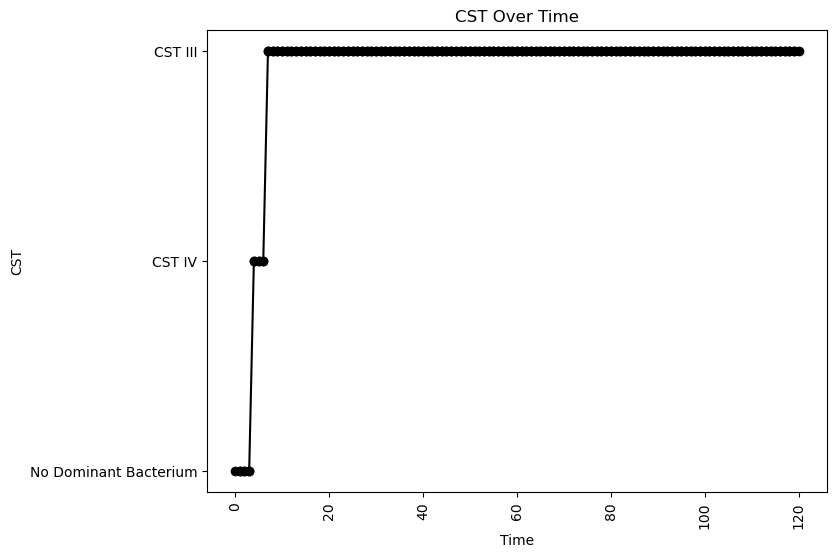


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.05739994626081137
oLB Growth: 0.11031283255203692
nAB Self: -0.011600371792904476
nAB->Li: -0.06822486308003683
nAB->oLB: -0.26764495485316897
Li->nAB: 0.10959946672210397
Li Self: -0.01724646756226525
Li->oLB: -0.2779857863040168
oLB->nAB: -0.24460460608602808
oLB->Li: -0.3501208173222994
oLB Self: -0.03958340693584583

Simulation 855 follows a valid CST progression:


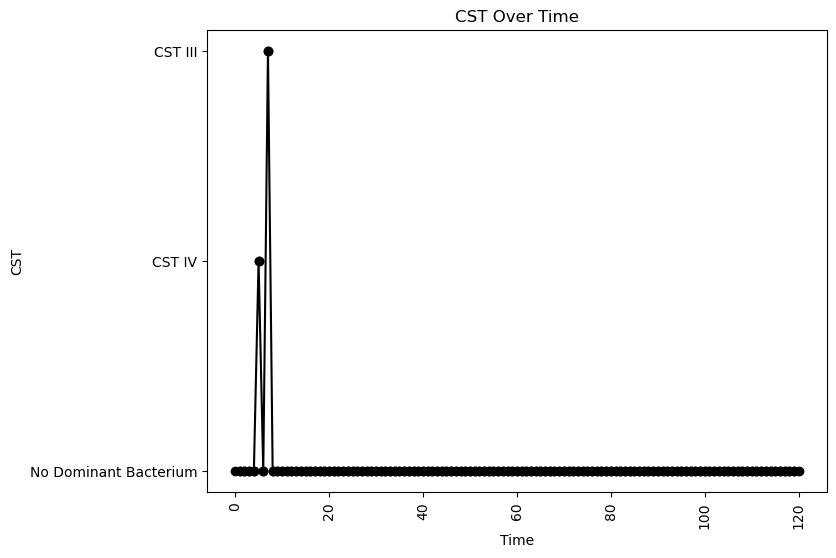


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.06773397359010037
nAB->Li: -0.1487153880253163
nAB->oLB: -0.33623268279614754
Li->nAB: 0.18426556499746383
Li Self: -0.04698461284946238
Li->oLB: 0.14615966609498066
oLB->nAB: -0.0384987192891339
oLB->Li: 0.2548994232461894
oLB Self: -0.06374257208393266

Simulation 856 follows a valid CST progression:


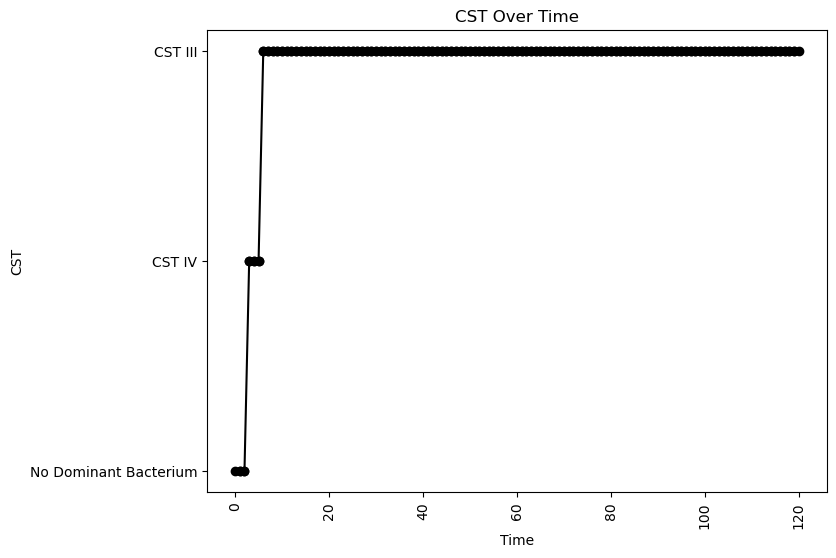


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.02699001098389288
nAB->Li: -0.17466123041570325
nAB->oLB: -0.13741291973584813
Li->nAB: 0.27439755291313406
Li Self: -0.02904273744297703
Li->oLB: 0.1905080531754204
oLB->nAB: -0.440415206729796
oLB->Li: 0.03704040668311215
oLB Self: -0.008526699725041012

Simulation 859 follows a valid CST progression:


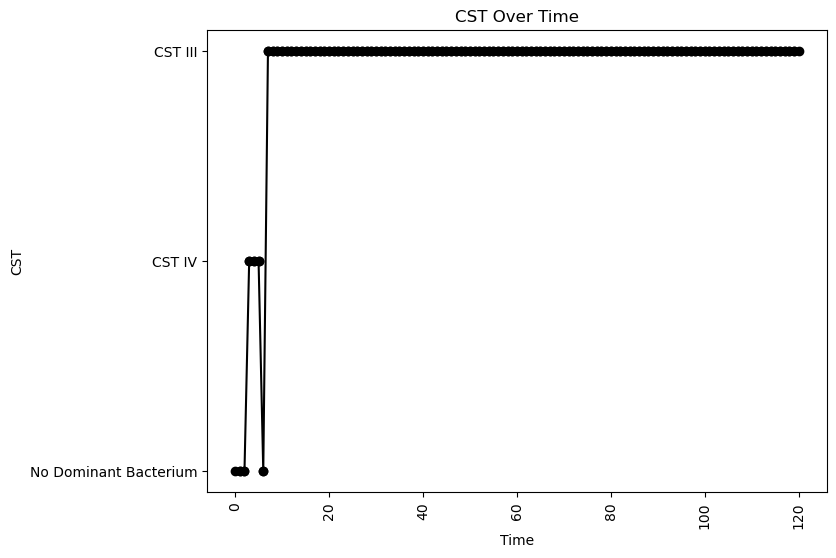


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.06967846000948563
oLB Growth: 0.7070472171500886
nAB Self: -0.04500653446878981
nAB->Li: -0.012736595104811788
nAB->oLB: -0.1746391193378634
Li->nAB: 0.1952644302889921
Li Self: -0.09744608807178005
Li->oLB: -0.17238744281946677
oLB->nAB: -0.14921934668783987
oLB->Li: -0.3761577339014988
oLB Self: -0.018187669230122924

Simulation 869 follows a valid CST progression:


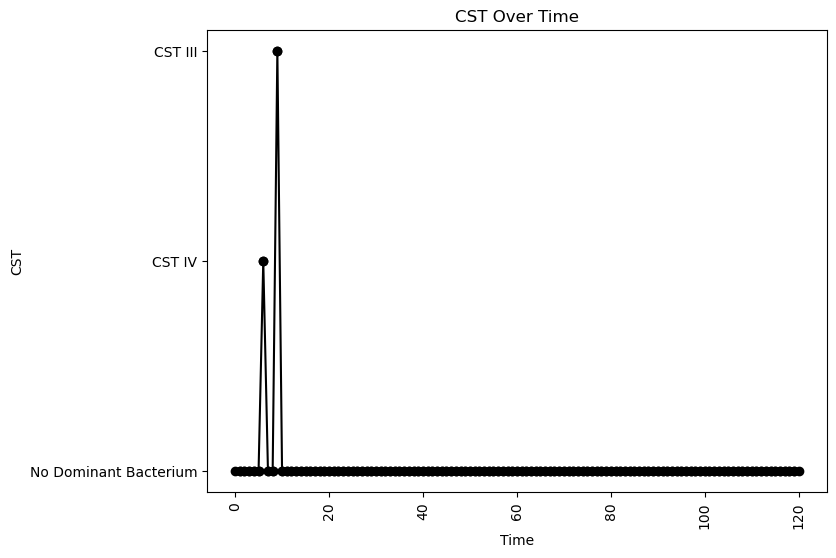


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.10162297193303492
oLB Growth: 0.07204856104631488
nAB Self: -0.002369064552569758
nAB->Li: -0.3160012417355028
nAB->oLB: -0.3074171153680574
Li->nAB: 0.07197901662349648
Li Self: -0.011150619322355282
Li->oLB: 0.2105950062792774
oLB->nAB: -0.123293075763249
oLB->Li: 0.2441296926587322
oLB Self: -0.05945840959177852

Simulation 875 follows a valid CST progression:


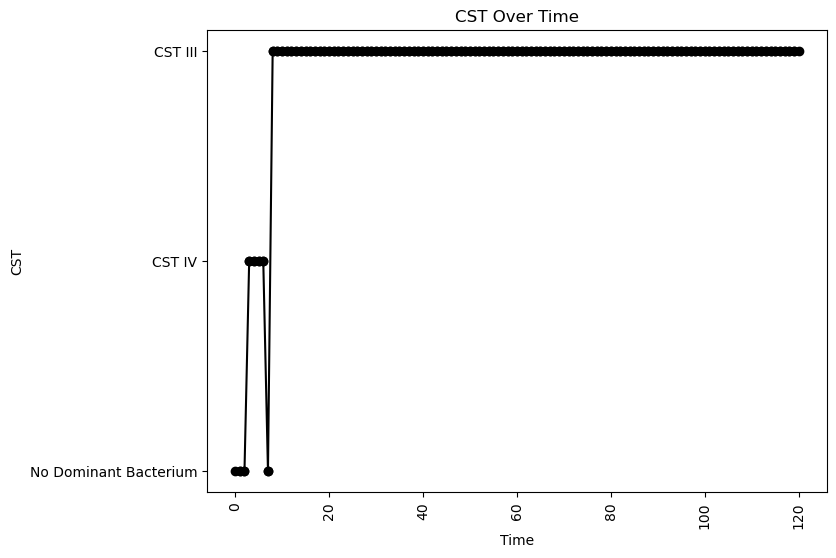


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.04399010965666821
nAB->Li: -0.02450495382197937
nAB->oLB: -0.19343059321306216
Li->nAB: 0.16193396017582362
Li Self: -0.07087888993697584
Li->oLB: -0.33904965744005866
oLB->nAB: -0.2011712162940379
oLB->Li: -0.12103552962996478
oLB Self: -0.06495198124695775

Simulation 876 follows a valid CST progression:


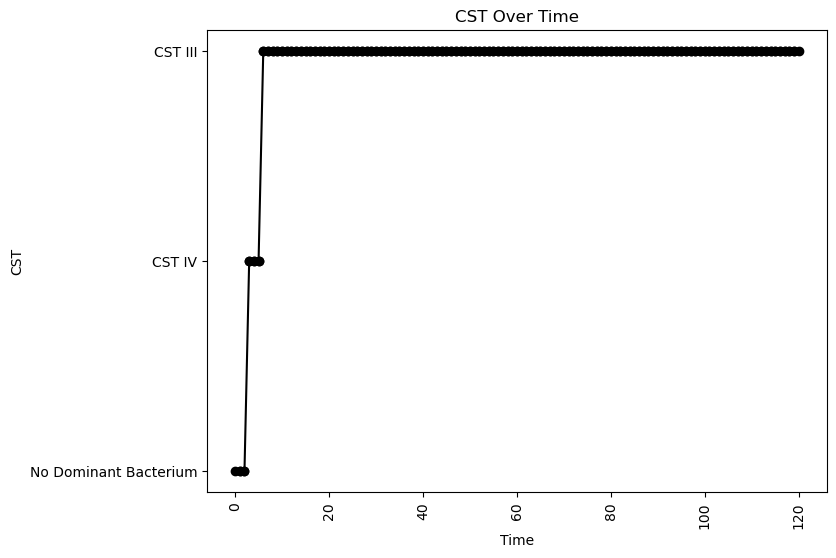


Interaction Parameters:
nAB Growth: 2.300652803872004
Li Growth: 0.06616501714537036
oLB Growth: 0.4369767544558836
nAB Self: -0.01521039598207749
nAB->Li: -0.2058865875292893
nAB->oLB: -0.10574897713394499
Li->nAB: 0.20143275793088822
Li Self: -0.055086529327646745
Li->oLB: 0.42793231781173724
oLB->nAB: -0.37837795590500983
oLB->Li: 0.007906139489318176
oLB Self: -0.05565229986887367

Simulation 884 follows a valid CST progression:


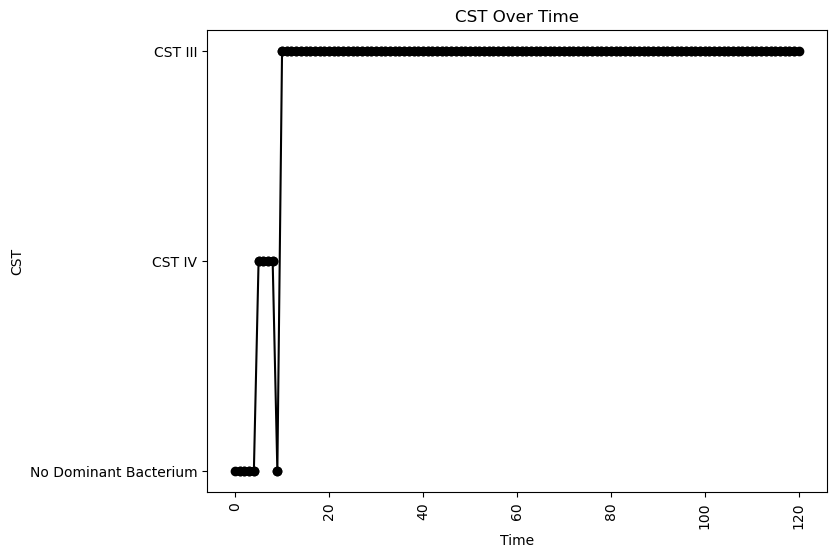


Interaction Parameters:
nAB Growth: 2.172057972480792
Li Growth: 0.05464936187495586
oLB Growth: 1.1816194682992254
nAB Self: -0.06721185817845238
nAB->Li: 0.0725722825459445
nAB->oLB: -0.4357180942000792
Li->nAB: 0.32020843323788606
Li Self: -0.04989171064715516
Li->oLB: -0.3547562133180997
oLB->nAB: -0.3416437368650234
oLB->Li: -0.11711421339015343
oLB Self: -0.06867293431965785

Simulation 895 follows a valid CST progression:


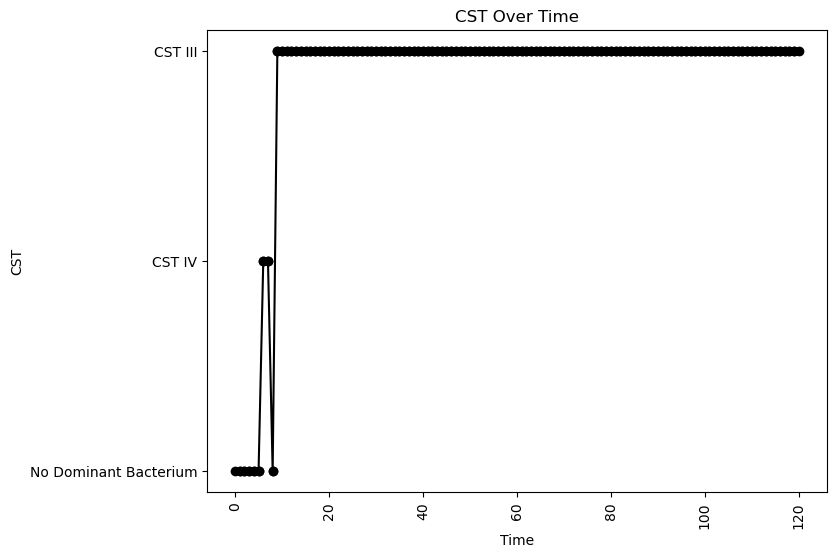


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.006357589725264776
nAB->Li: 0.07129801830734228
nAB->oLB: -0.23938735335275302
Li->nAB: 0.187067351828913
Li Self: -0.024347474270139238
Li->oLB: -0.3190367095594229
oLB->nAB: -0.17842748901590827
oLB->Li: 0.09273432625510392
oLB Self: -0.04040619398567789

Simulation 898 follows a valid CST progression:


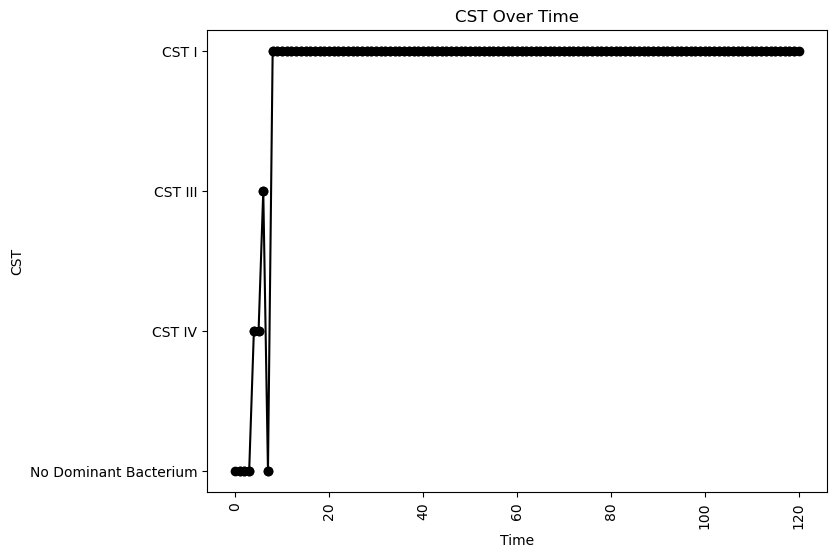


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.05739994626081137
oLB Growth: 0.11031283255203692
nAB Self: -0.02557356115419092
nAB->Li: -0.37167794674886206
nAB->oLB: -0.4550852742901163
Li->nAB: 0.36342308990690864
Li Self: -0.008257858199566606
Li->oLB: -0.3092684718838161
oLB->nAB: -0.16850709312132028
oLB->Li: 0.3505504815749607
oLB Self: -0.06588961167122656

Simulation 903 follows a valid CST progression:


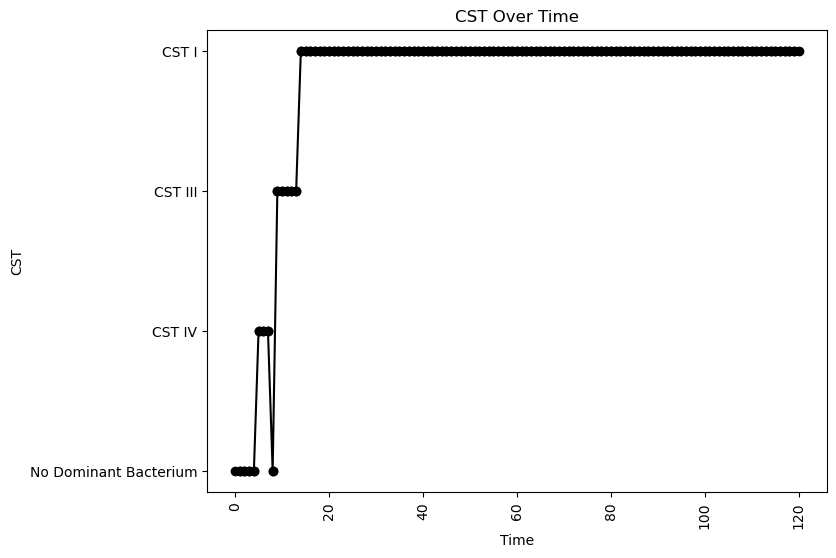


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.008215609768162227
nAB->Li: -0.14253367653698845
nAB->oLB: -0.4693519320744347
Li->nAB: 0.07928812784507455
Li Self: -0.0047339384589071415
Li->oLB: -0.05336999593092512
oLB->nAB: -0.47886115165565546
oLB->Li: 0.17911228964920323
oLB Self: -0.015928513766682653

Simulation 904 follows a valid CST progression:


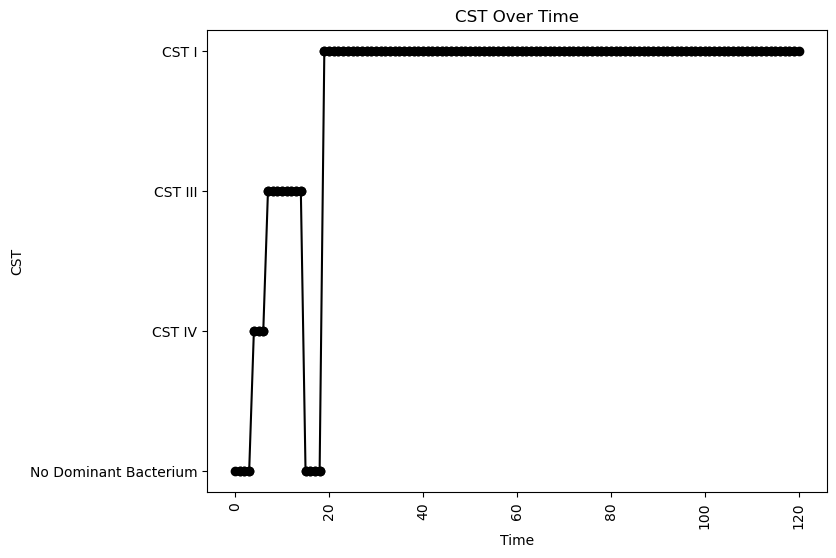


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.06967846000948563
oLB Growth: 0.7070472171500886
nAB Self: -0.020287953582246027
nAB->Li: -0.2625593352400726
nAB->oLB: -0.25586737805605275
Li->nAB: 0.23612226525269886
Li Self: -0.08195186318645468
Li->oLB: -0.09615624907714859
oLB->nAB: -0.056652939666006485
oLB->Li: 0.041832562615320756
oLB Self: -0.006737423783641297

Simulation 912 follows a valid CST progression:


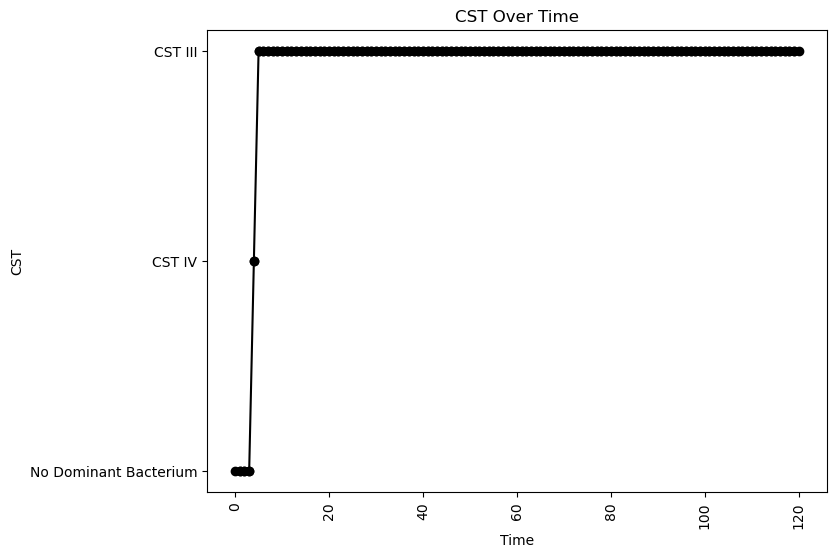


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.14222073438592472
oLB Growth: 0.3756702562538966
nAB Self: -0.02341494752040317
nAB->Li: 0.17402580619120578
nAB->oLB: -0.362114916432695
Li->nAB: 0.33039143863794573
Li Self: -0.012318289029331284
Li->oLB: -0.12185863069412411
oLB->nAB: -0.35284426858364826
oLB->Li: 0.13432577694715753
oLB Self: -0.035303891321251085

Simulation 914 follows a valid CST progression:


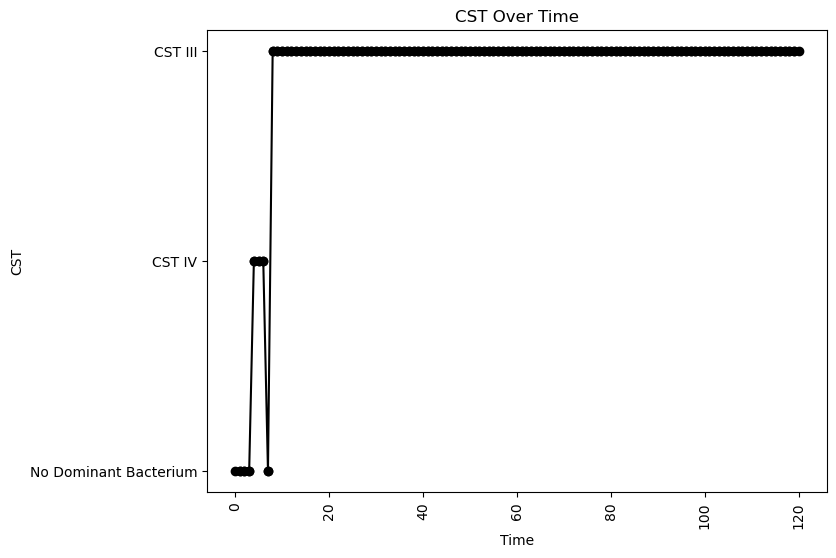


Interaction Parameters:
nAB Growth: 2.292952252819776
Li Growth: 0.06862578763464611
oLB Growth: 0.25066683866219575
nAB Self: -0.01043678884868425
nAB->Li: -0.18075413457341322
nAB->oLB: -0.4466651801142729
Li->nAB: 0.18833834898348478
Li Self: -0.038238597797971785
Li->oLB: 0.06649858671075837
oLB->nAB: -0.4864217104553319
oLB->Li: -0.05025817833153923
oLB Self: -0.024979684883713354

Simulation 921 follows a valid CST progression:


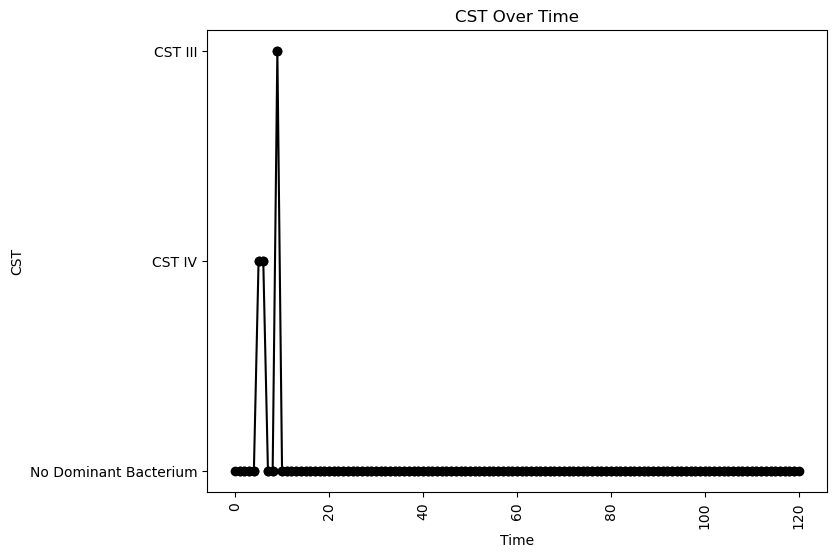


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.09209462390299608
nAB->Li: -0.25567108620596324
nAB->oLB: -0.3674560093482414
Li->nAB: 0.156613014663899
Li Self: -0.08697383979016296
Li->oLB: 0.2994652225225003
oLB->nAB: -0.20509280583628686
oLB->Li: 0.4125925191308244
oLB Self: -0.09478885779891838

Simulation 924 follows a valid CST progression:


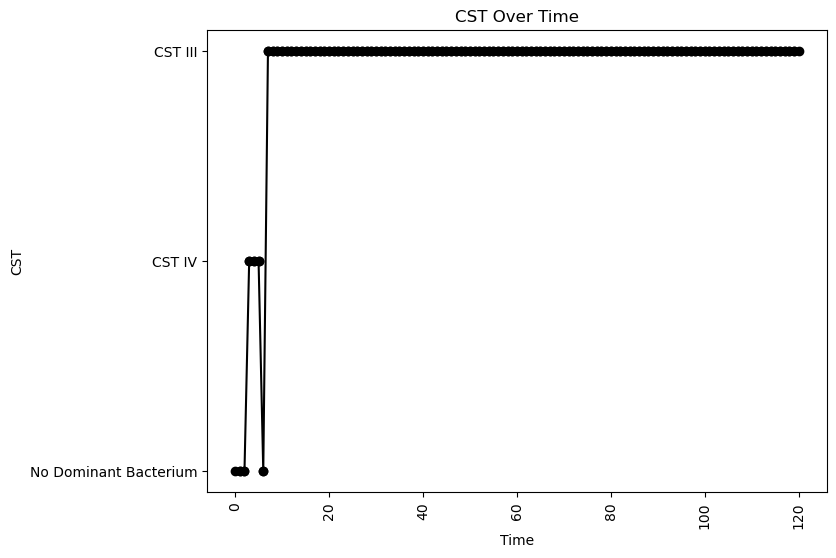


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.05730955304055496
nAB->Li: 0.1441867182902158
nAB->oLB: -0.4350009001185069
Li->nAB: 0.43372598229716197
Li Self: -0.0870171114163513
Li->oLB: -0.26984418742085864
oLB->nAB: -0.32189890247117187
oLB->Li: -0.3567809097707482
oLB Self: -0.04211287839355882

Simulation 928 follows a valid CST progression:


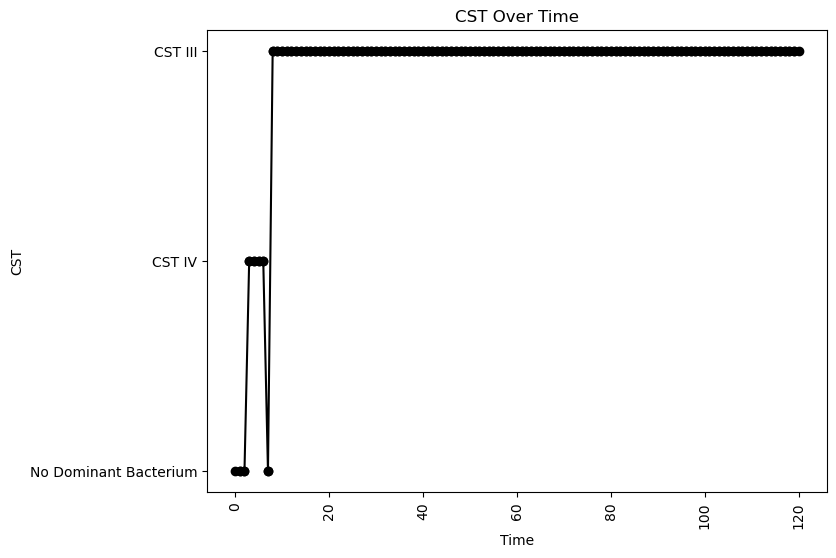


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.09331283732557231
nAB->Li: -0.02833997836470631
nAB->oLB: -0.23536212491958391
Li->nAB: 0.23435490955286997
Li Self: -0.08879861447404505
Li->oLB: 0.22988160428714144
oLB->nAB: -0.42393056633484083
oLB->Li: 0.037476047245248556
oLB Self: -0.02134211255590633

Simulation 934 follows a valid CST progression:


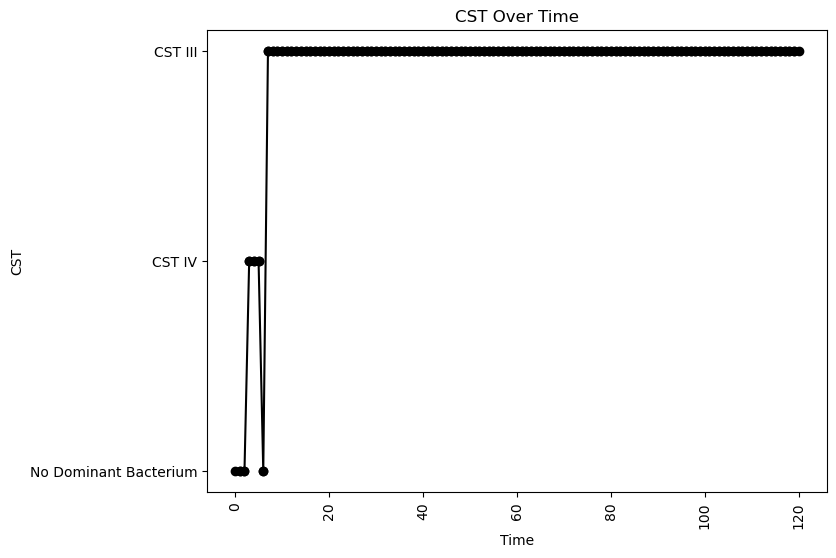


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.022741755983823525
nAB->Li: -0.4120428549356886
nAB->oLB: -0.29290565927431056
Li->nAB: 0.2978678593185514
Li Self: -0.013154231284975934
Li->oLB: -0.3203304574871274
oLB->nAB: -0.1315715816060966
oLB->Li: -0.41334061862418986
oLB Self: -0.0011492214091135544

Simulation 948 follows a valid CST progression:


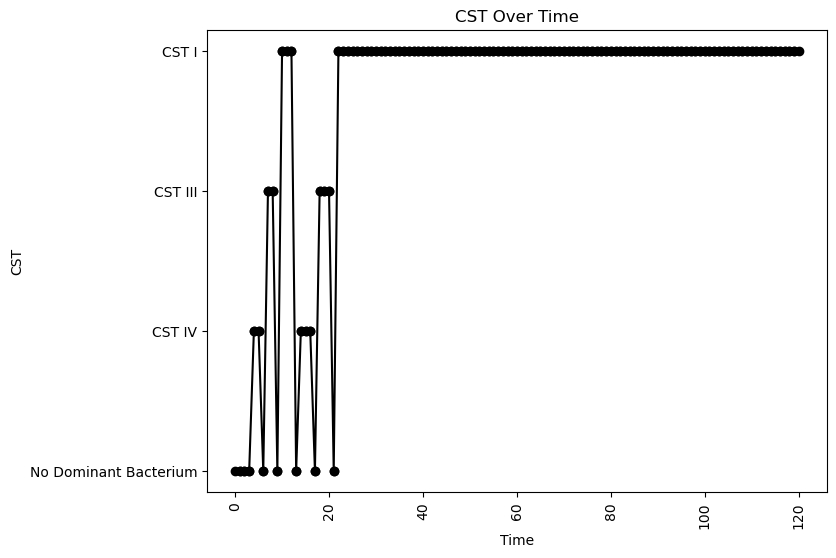


Interaction Parameters:
nAB Growth: 2.273308423784788
Li Growth: 0.12445646827659038
oLB Growth: 0.4879467602516997
nAB Self: -0.07960737794090011
nAB->Li: -0.4737061337854434
nAB->oLB: -0.20789764277737072
Li->nAB: 0.23007837554885135
Li Self: -0.09154872889347818
Li->oLB: -0.4781699483139044
oLB->nAB: -0.42875773489685887
oLB->Li: 0.47466113531834964
oLB Self: -0.019150406477781004

Simulation 952 follows a valid CST progression:


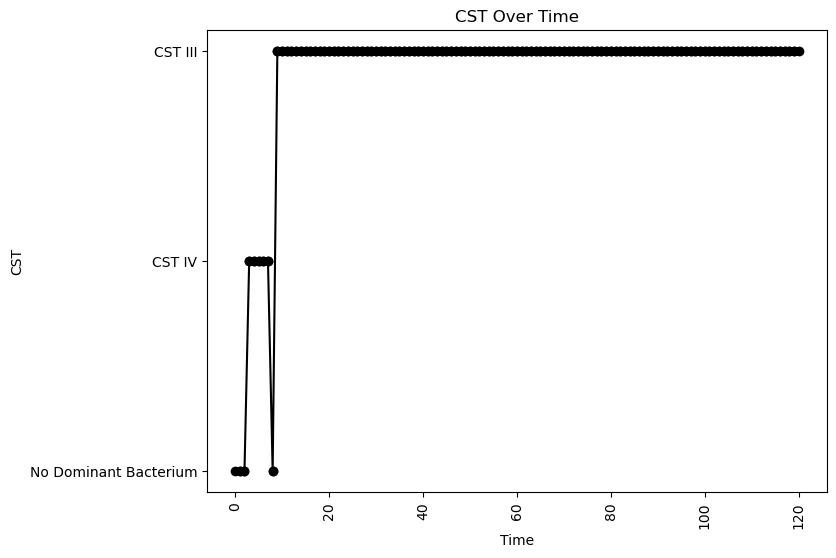


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.04251945765739626
nAB->Li: -0.22754218099692314
nAB->oLB: -0.15647923177139528
Li->nAB: 0.06988767791006056
Li Self: -0.03086859455659341
Li->oLB: -0.15264473878108137
oLB->nAB: -0.20558573803442853
oLB->Li: -0.2873345762323506
oLB Self: -0.026594178183526745

Simulation 957 follows a valid CST progression:


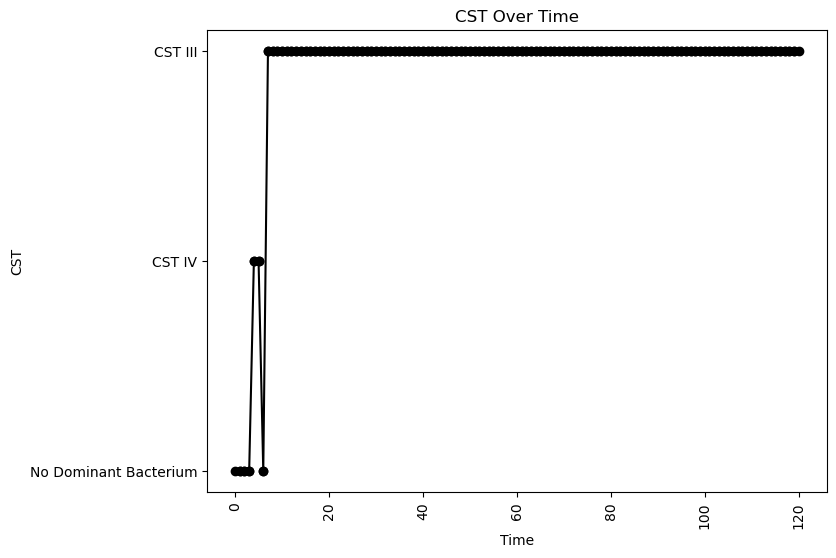


Interaction Parameters:
nAB Growth: 2.284416841880324
Li Growth: 0.06886020002136616
oLB Growth: 0.35838896078112936
nAB Self: -0.0895562763241291
nAB->Li: -0.37084181008033135
nAB->oLB: -0.00990247496153368
Li->nAB: 0.3279509563003522
Li Self: -0.07824989836948623
Li->oLB: 0.39077426242308033
oLB->nAB: -0.4050801862299458
oLB->Li: -0.4236722049116383
oLB Self: -0.009503291827402782

Simulation 974 follows a valid CST progression:


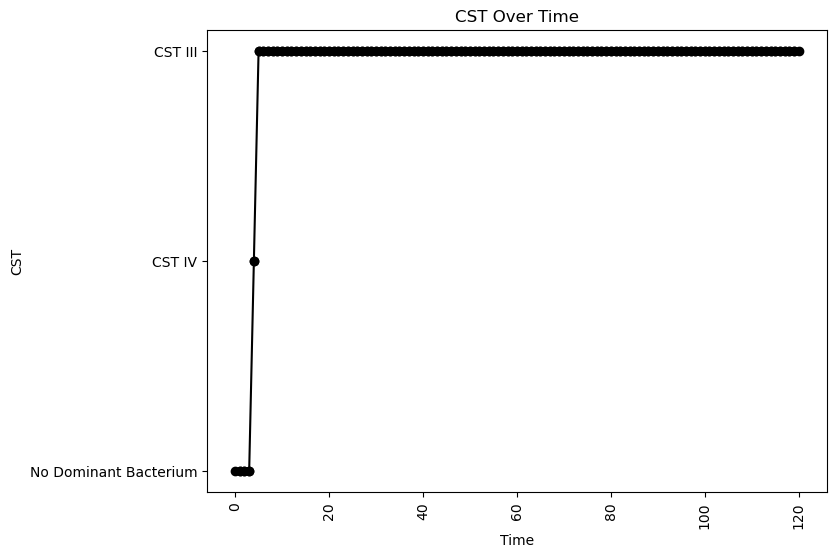


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.07246701083264269
oLB Growth: 0.7334429546888279
nAB Self: -0.010507064642024472
nAB->Li: 0.056315610682139194
nAB->oLB: -0.4869653540246507
Li->nAB: 0.43720826111796707
Li Self: -0.039857252242666494
Li->oLB: 0.0067058391350312
oLB->nAB: -0.45009775801518814
oLB->Li: -0.15593810385106216
oLB Self: -0.006853798988925186

Simulation 975 follows a valid CST progression:


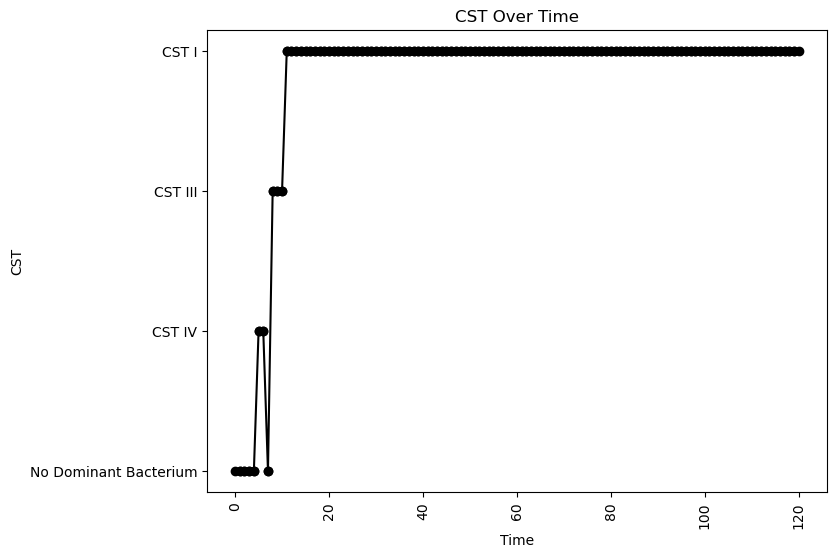


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.06664492138468138
oLB Growth: 0.6588037441195057
nAB Self: -0.08110359729139685
nAB->Li: -0.4484252136316494
nAB->oLB: -0.43220225628230646
Li->nAB: 0.3213290843737697
Li Self: -0.012413039773494769
Li->oLB: -0.22794098977117444
oLB->nAB: -0.35328165725196026
oLB->Li: 0.28485022853813846
oLB Self: -0.03414095005056954

Simulation 977 follows a valid CST progression:


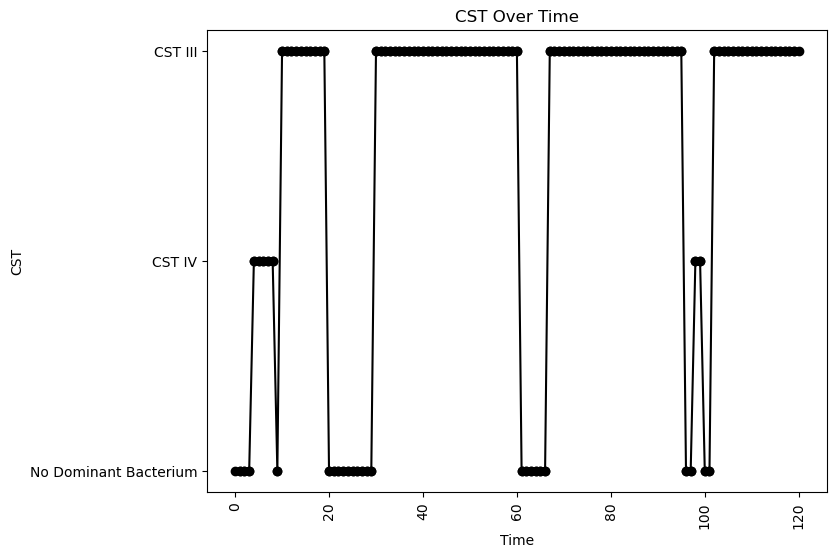


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.17442670128326354
oLB Growth: 0.1731103059651596
nAB Self: -0.08546483334570988
nAB->Li: -0.44372859810391807
nAB->oLB: -0.42080925496588756
Li->nAB: 0.06105929458525361
Li Self: -0.08707686391147154
Li->oLB: -0.28140551785689505
oLB->nAB: -0.40594834451353684
oLB->Li: -0.25944611460104505
oLB Self: -0.004870701129086885

Simulation 978 follows a valid CST progression:


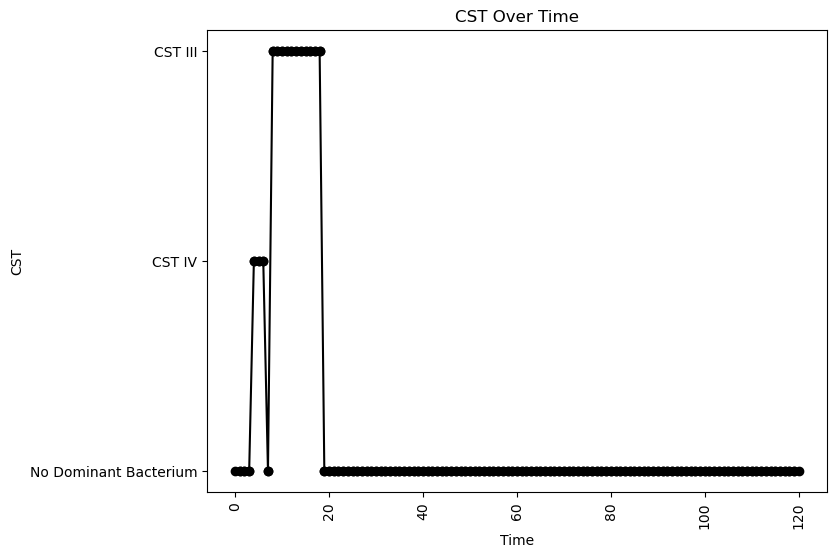


Interaction Parameters:
nAB Growth: 2.284416841880324
Li Growth: 0.06886020002136616
oLB Growth: 0.35838896078112936
nAB Self: -0.0995240670133239
nAB->Li: 0.011204840639555291
nAB->oLB: -0.1754095110068037
Li->nAB: 0.13578744717551383
Li Self: -0.06003676876717196
Li->oLB: 0.12654068288911635
oLB->nAB: -0.4057187933809133
oLB->Li: 0.20600090419102912
oLB Self: -0.0788804511650581

Simulation 980 follows a valid CST progression:


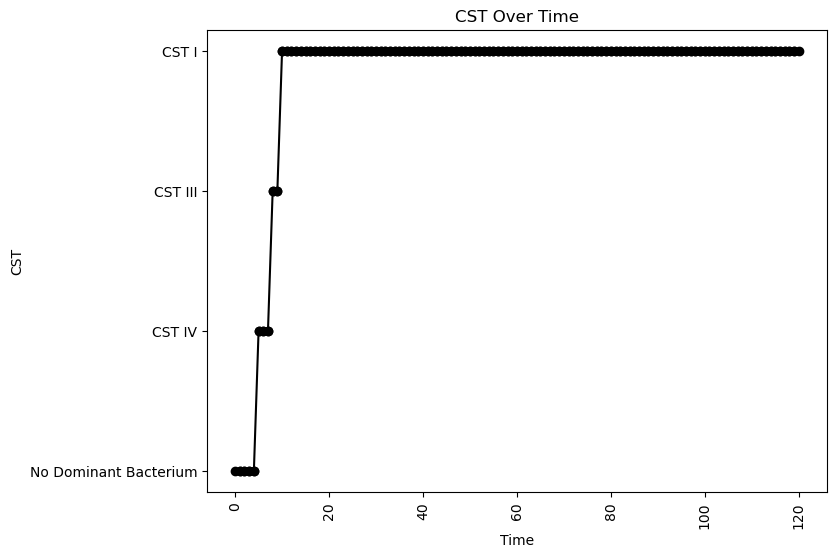


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.1604990807856213
oLB Growth: 0.7334429546888279
nAB Self: -0.030460102940449138
nAB->Li: -0.12130298052700556
nAB->oLB: -0.420325595726891
Li->nAB: 0.09446468391493279
Li Self: -0.003201333400978723
Li->oLB: -0.19286225812966507
oLB->nAB: -0.30257547338043217
oLB->Li: 0.28255384765116387
oLB Self: -0.07387029054610819

Simulation 985 follows a valid CST progression:


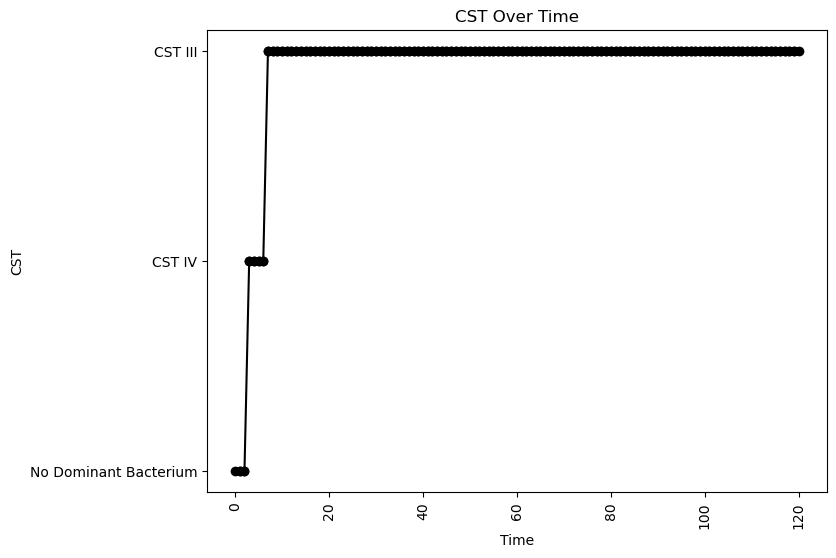


Interaction Parameters:
nAB Growth: 2.1573635369289432
Li Growth: 0.04215849674910016
oLB Growth: 1.2503024394854367
nAB Self: -0.04852637347028217
nAB->Li: -0.3360314829272374
nAB->oLB: -0.11286588494243915
Li->nAB: 0.36673072711173826
Li Self: -0.03304872526965612
Li->oLB: -0.3449080257017749
oLB->nAB: -0.4267770660119952
oLB->Li: -0.40435646612200327
oLB Self: -0.043934220629849995

Simulation 1008 follows a valid CST progression:


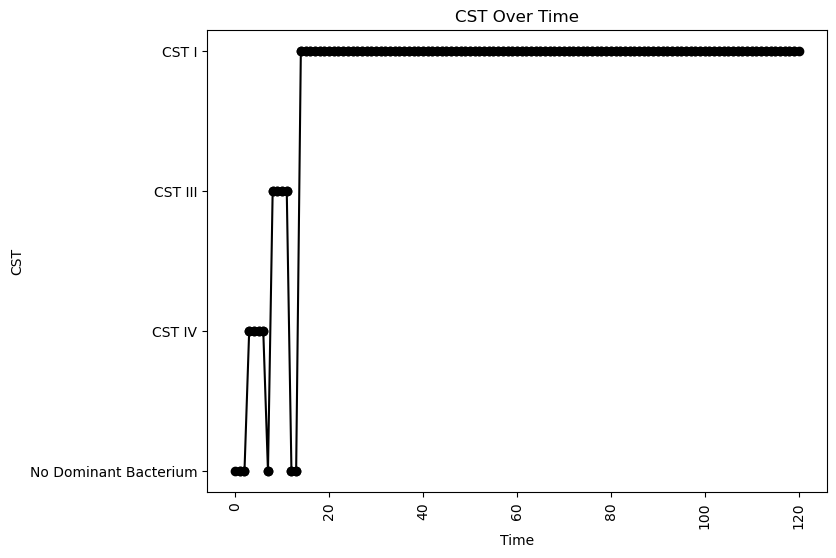


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.0848410270900884
nAB->Li: -0.08657312497062825
nAB->oLB: -0.3104909676428245
Li->nAB: 0.18646289826333462
Li Self: -0.04580746153536942
Li->oLB: -0.4552301288811288
oLB->nAB: -0.23674849257871683
oLB->Li: 0.17250144104829246
oLB Self: -0.010725642473646935

Simulation 1018 follows a valid CST progression:


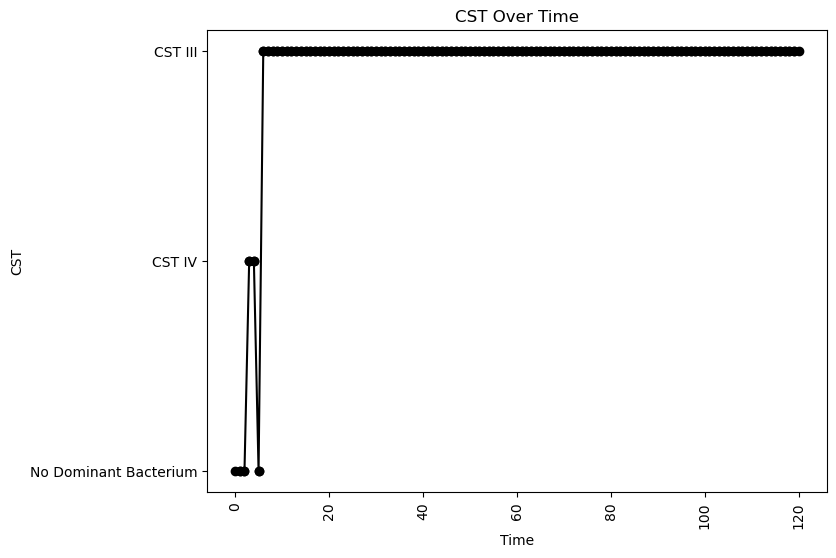


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.06309763455319839
oLB Growth: 0.9128027925042091
nAB Self: -0.022946238981767828
nAB->Li: 0.07456412873127005
nAB->oLB: -0.013882815577037189
Li->nAB: 0.25698674412617284
Li Self: -0.036815375841736414
Li->oLB: 0.3369072434304168
oLB->nAB: -0.11018286251117981
oLB->Li: -0.3169708138619898
oLB Self: -0.04962473776167172

Simulation 1027 follows a valid CST progression:


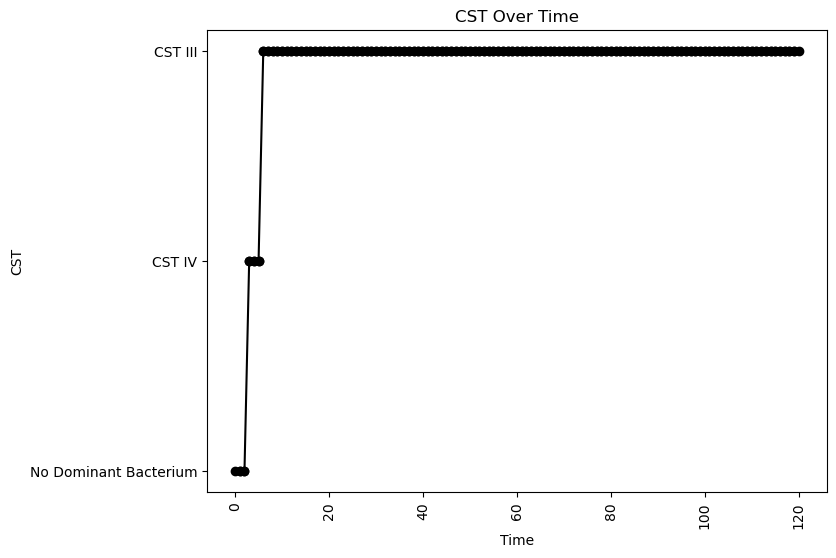


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.008387314880497682
nAB->Li: 0.056999290200230535
nAB->oLB: -0.24416790109681824
Li->nAB: 0.25660345332576884
Li Self: -0.08675874069232373
Li->oLB: 0.42874716971913573
oLB->nAB: -0.14439516004199654
oLB->Li: -0.4923753788198735
oLB Self: -0.05958870000426422

Simulation 1030 follows a valid CST progression:


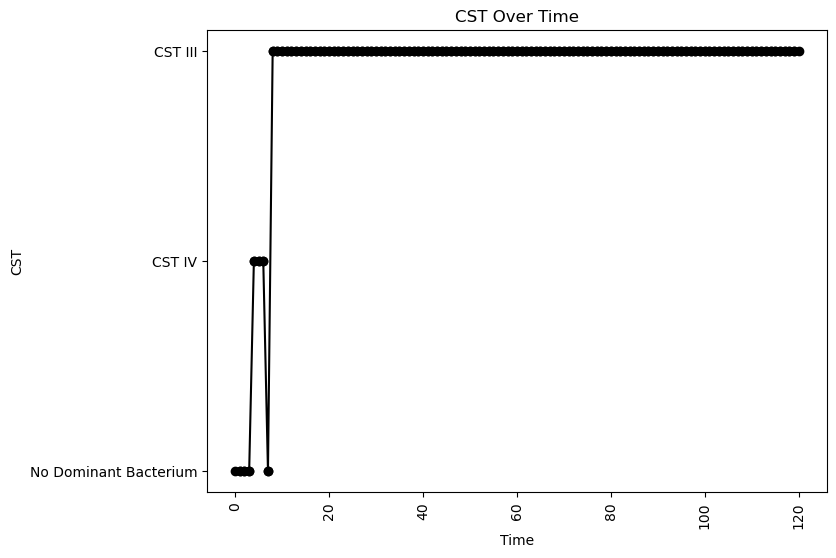


Interaction Parameters:
nAB Growth: 2.286323001067126
Li Growth: 0.060377934648291574
oLB Growth: 0.14091260068383374
nAB Self: -0.011537394357913386
nAB->Li: 0.06658984083306074
nAB->oLB: -0.34700142342458073
Li->nAB: 0.22866524341974115
Li Self: -0.06681079585323346
Li->oLB: -0.09607247281935616
oLB->nAB: -0.033576469447065715
oLB->Li: 0.018892549303837547
oLB Self: -0.0346353396936271

Simulation 1033 follows a valid CST progression:


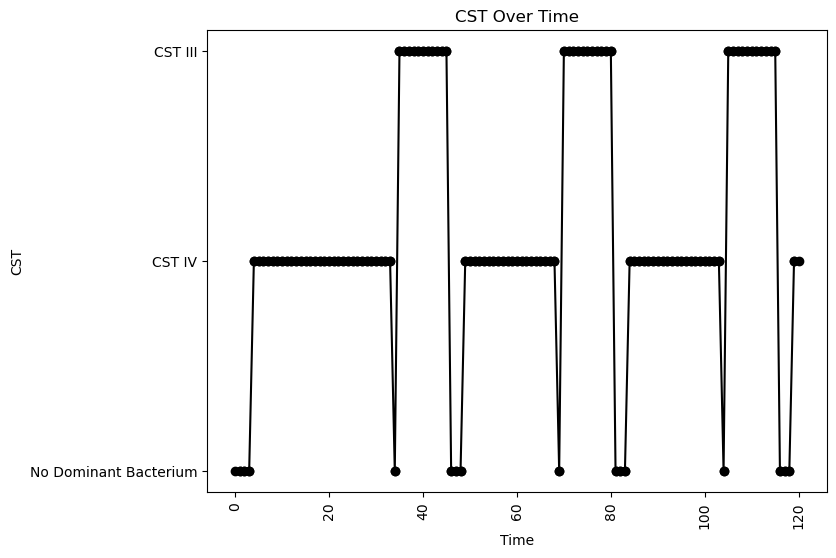


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.07292250195564778
nAB->Li: -0.3994754668962654
nAB->oLB: -0.4005997670110457
Li->nAB: 0.015215030355980264
Li Self: -0.09054662623762522
Li->oLB: -0.04508476340496609
oLB->nAB: -0.15719587787967293
oLB->Li: 0.11115672435033297
oLB Self: -0.06000286185832049

Simulation 1037 follows a valid CST progression:


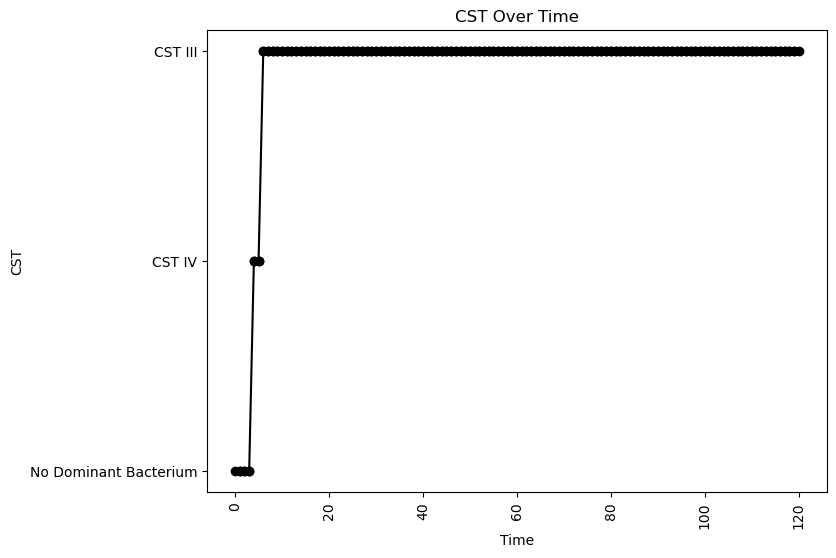


Interaction Parameters:
nAB Growth: 2.1147752631399044
Li Growth: 0.026128882742544723
oLB Growth: 1.2094391858973506
nAB Self: -0.0835700441173143
nAB->Li: 0.0033103552675415315
nAB->oLB: -0.40864835782604103
Li->nAB: 0.46151098347167174
Li Self: -0.005768779267972771
Li->oLB: -0.24777910839365241
oLB->nAB: -0.18571865228460938
oLB->Li: -0.3596727895311673
oLB Self: -0.014125562641004716

Simulation 1045 follows a valid CST progression:


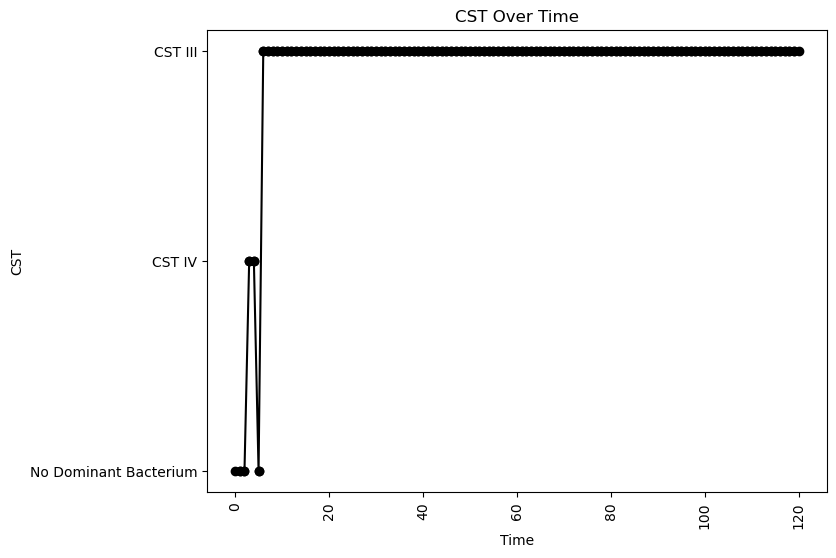


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.06967846000948563
oLB Growth: 0.7070472171500886
nAB Self: -0.013211012213548812
nAB->Li: -0.39543645739238065
nAB->oLB: -0.3920267356880795
Li->nAB: 0.41643993868870544
Li Self: -0.0220782348313293
Li->oLB: 0.2061675418788096
oLB->nAB: -0.11110768442307056
oLB->Li: -0.296042863232053
oLB Self: -0.06163436695725616

Simulation 1047 follows a valid CST progression:


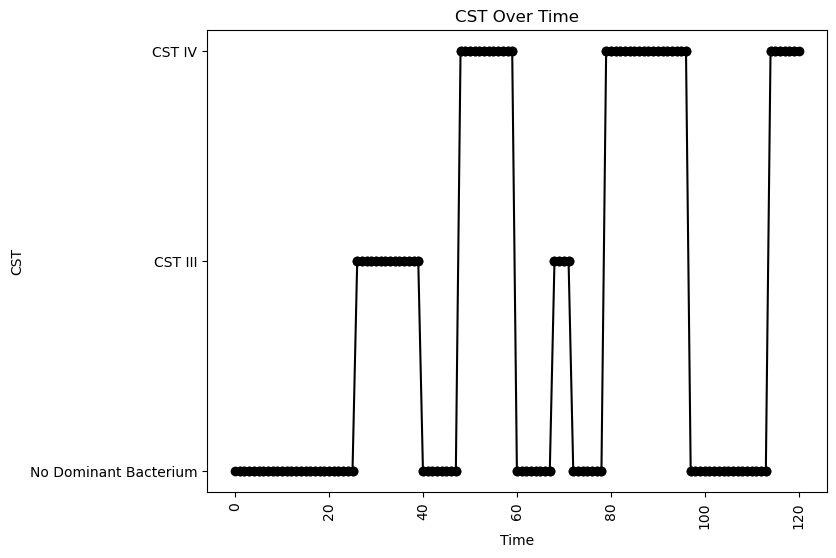


Interaction Parameters:
nAB Growth: 2.0745101401728236
Li Growth: 0.15405107427816345
oLB Growth: 1.1507970527071554
nAB Self: -0.09861197192051267
nAB->Li: -0.04052206660977009
nAB->oLB: -0.41678970148162925
Li->nAB: 0.011622320059306523
Li Self: -0.056480896925174856
Li->oLB: -0.1608922477600917
oLB->nAB: -0.29236485518116545
oLB->Li: -0.23383178643090247
oLB Self: -0.031176031242664465

Simulation 1051 follows a valid CST progression:


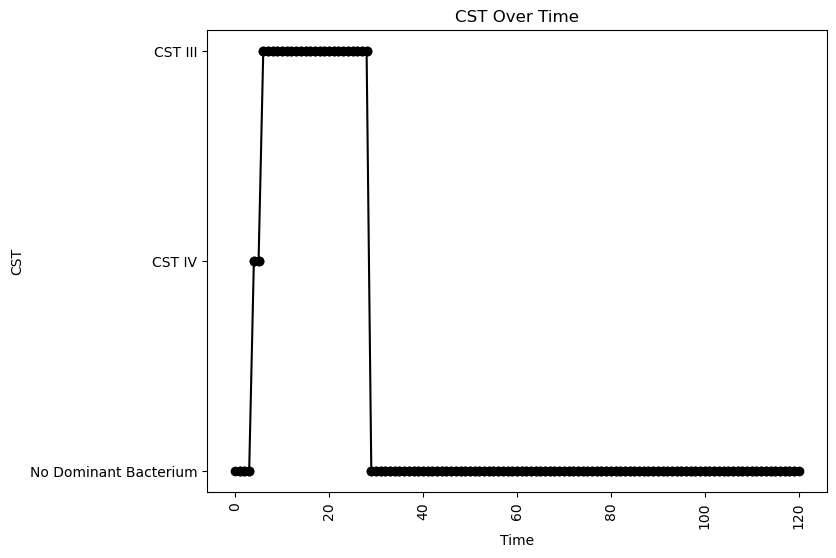


Interaction Parameters:
nAB Growth: 2.300652803872004
Li Growth: 0.06616501714537036
oLB Growth: 0.4369767544558836
nAB Self: -0.010865557549024157
nAB->Li: -0.1633299656212222
nAB->oLB: -0.16557433113609504
Li->nAB: 0.38449530961226
Li Self: -0.08530470818788816
Li->oLB: 0.10077874660223574
oLB->nAB: -0.4988266563280459
oLB->Li: 0.09413219272160289
oLB Self: -0.044984001628078384

Simulation 1055 follows a valid CST progression:


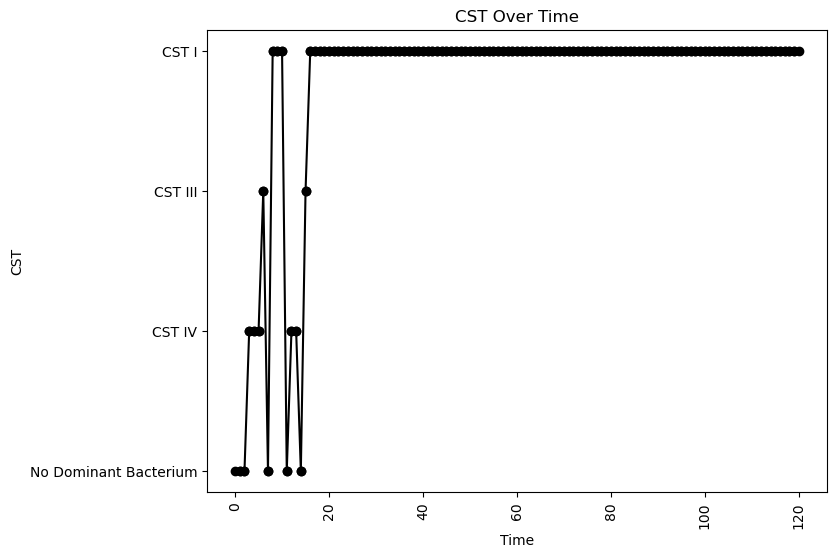


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.03837725110012093
oLB Growth: 1.155917868199191
nAB Self: -0.06283809755247513
nAB->Li: -0.2374125458216575
nAB->oLB: -0.1534786047943389
Li->nAB: 0.3784173777418348
Li Self: -0.06124353587087229
Li->oLB: -0.3696491744626837
oLB->nAB: -0.4139200753327912
oLB->Li: 0.4165082121032124
oLB Self: -0.04719452057019326

Simulation 1059 follows a valid CST progression:


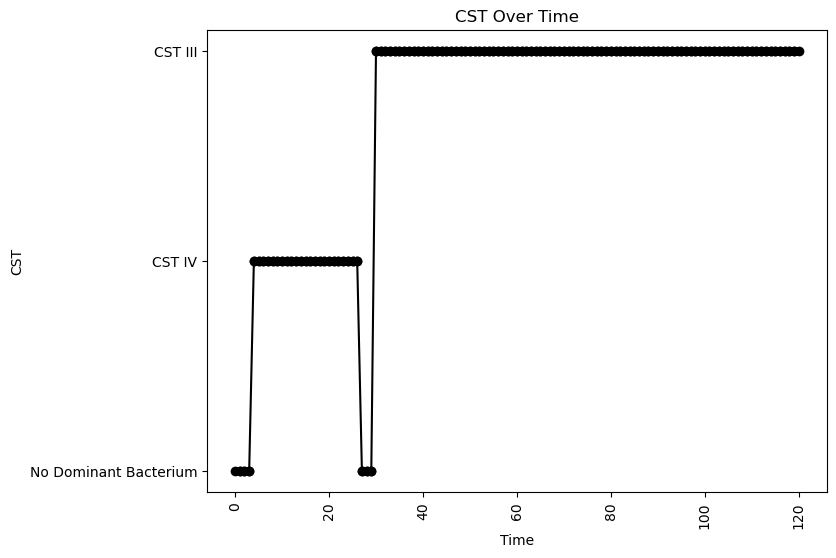


Interaction Parameters:
nAB Growth: 2.273308423784788
Li Growth: 0.2056759464302362
oLB Growth: 0.4879467602516997
nAB Self: -0.039148248986495215
nAB->Li: -0.1657605180480839
nAB->oLB: -0.24168805152037243
Li->nAB: 0.005614021092688604
Li Self: -0.030349579238870106
Li->oLB: -0.25457678471543654
oLB->nAB: -0.024995989964096688
oLB->Li: -0.3797565173832697
oLB Self: -0.012532945590919081

Simulation 1060 follows a valid CST progression:


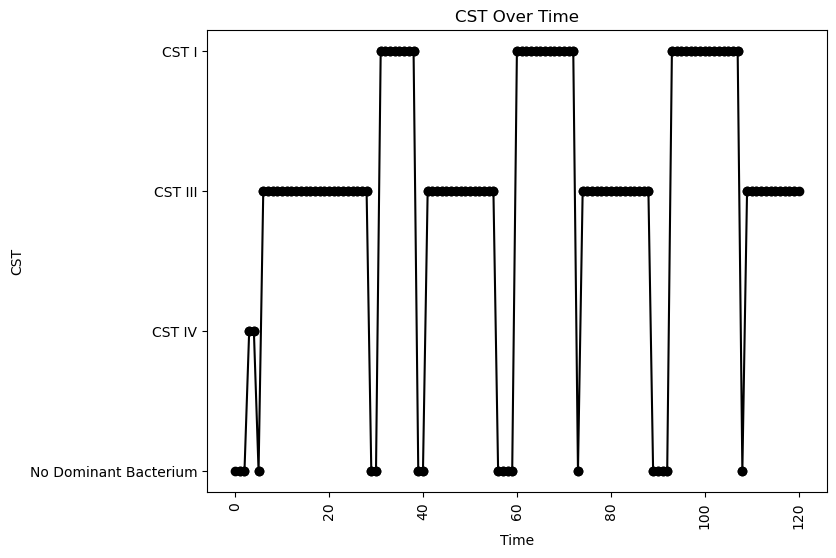


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.023362157675947626
nAB->Li: -0.18334572324384252
nAB->oLB: -0.04108867024791335
Li->nAB: 0.37333202005895716
Li Self: -0.06300438141004426
Li->oLB: -0.037731492240137776
oLB->nAB: -0.336256288954577
oLB->Li: 0.02853756353744019
oLB Self: -0.0365016319937666

Simulation 1065 follows a valid CST progression:


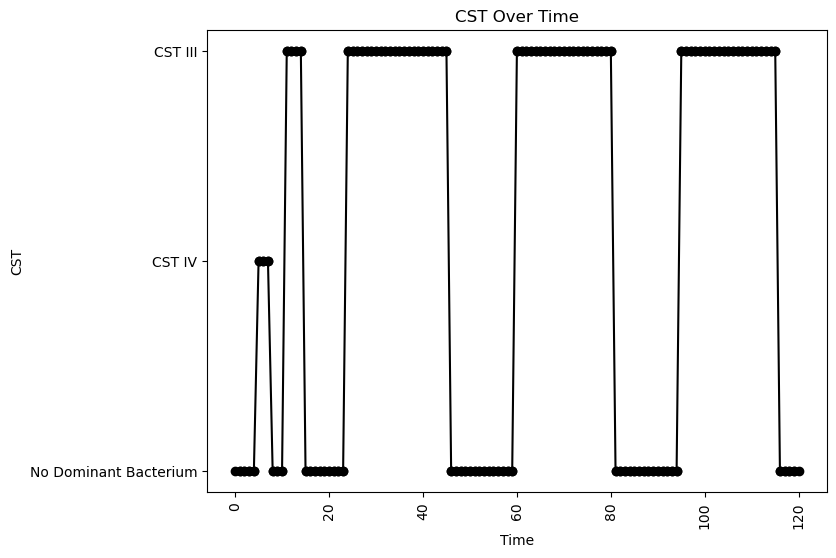


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.17532415079713548
oLB Growth: 0.9128027925042091
nAB Self: -0.04005861756754003
nAB->Li: -0.007478577354903537
nAB->oLB: -0.394643732223024
Li->nAB: 0.12862812792088485
Li Self: -0.09034893367562848
Li->oLB: -0.07952404706860478
oLB->nAB: -0.35795500817942094
oLB->Li: 0.11724545124913144
oLB Self: -0.026708874647683983

Simulation 1079 follows a valid CST progression:


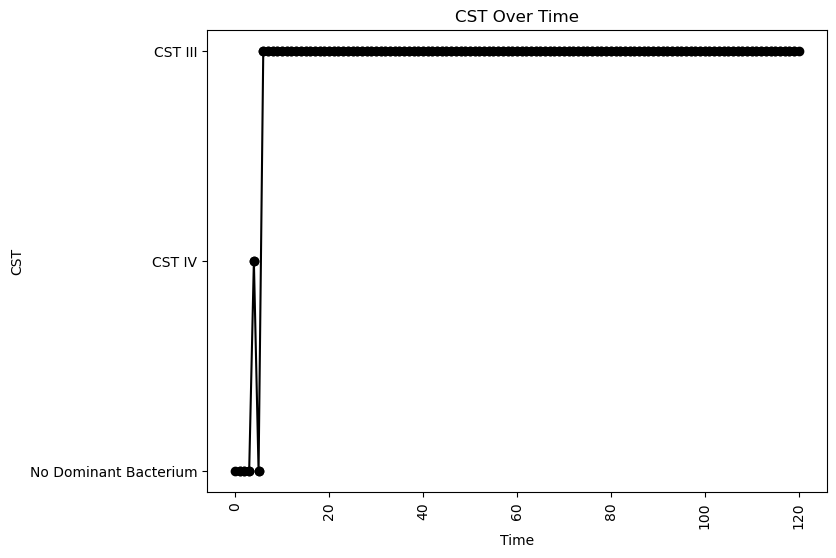


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.06674637767386951
nAB->Li: 0.039484262228053346
nAB->oLB: -0.2841463796285658
Li->nAB: 0.3360459367500569
Li Self: -0.05963256289201703
Li->oLB: 0.20492335840976494
oLB->nAB: -0.18561493874805485
oLB->Li: -0.20168497473641106
oLB Self: -0.07926669612721914

Simulation 1085 follows a valid CST progression:


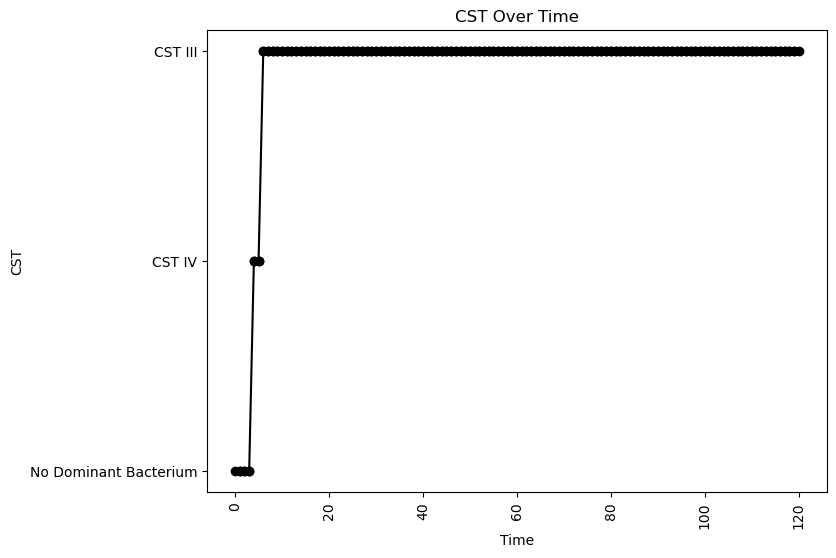


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.06537690177521169
nAB->Li: 0.2910239978619046
nAB->oLB: -0.25240873191949503
Li->nAB: 0.4482116440995543
Li Self: -0.018935292097630452
Li->oLB: 0.08333636575562975
oLB->nAB: -0.4476721162427389
oLB->Li: -0.0680701823794313
oLB Self: -0.06511586973325424

Simulation 1098 follows a valid CST progression:


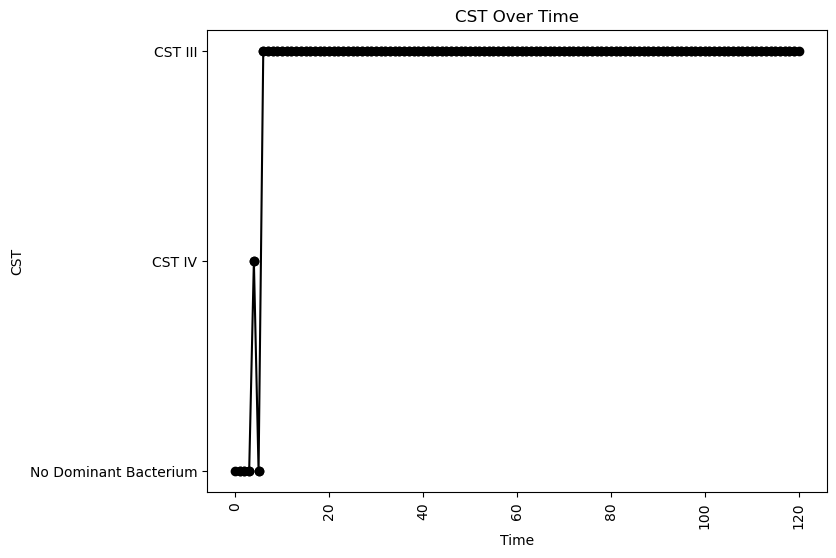


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.05003941755570818
nAB->Li: -0.053309239759502025
nAB->oLB: -0.07229304044568824
Li->nAB: 0.36182744572383596
Li Self: -0.05032909862953442
Li->oLB: 0.41498158551378794
oLB->nAB: -0.25473978864770097
oLB->Li: -0.2122417829135792
oLB Self: -0.03972117130329099

Simulation 1103 follows a valid CST progression:


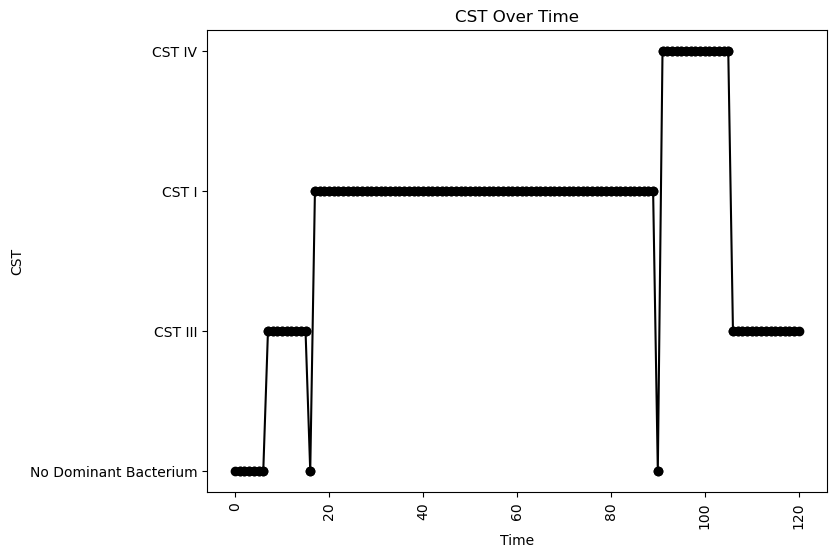


Interaction Parameters:
nAB Growth: 2.300652803872004
Li Growth: 0.31307280229336665
oLB Growth: 0.4369767544558836
nAB Self: -0.022464833354581326
nAB->Li: -0.35327609438004337
nAB->oLB: -0.1765035410915921
Li->nAB: 0.2840733091938301
Li Self: -0.055832571925482744
Li->oLB: -0.43725548081272014
oLB->nAB: -0.36494772995239444
oLB->Li: 0.09676316598555157
oLB Self: -0.061819354389470706

Simulation 1105 follows a valid CST progression:


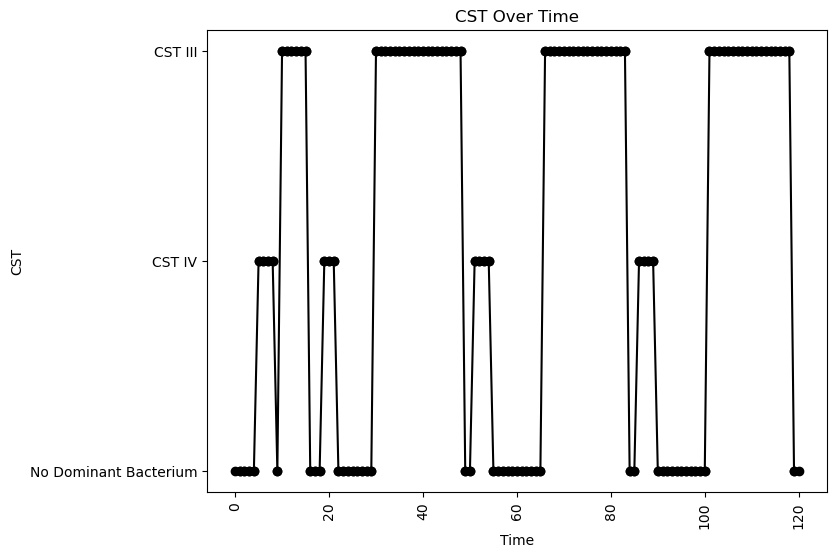


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.0717031703601867
oLB Growth: 0.1039349296945926
nAB Self: -0.021127698278538623
nAB->Li: -0.38858348138723864
nAB->oLB: -0.40537860470594256
Li->nAB: 0.0726945424581742
Li Self: -0.09367028460818927
Li->oLB: -0.011666503378635451
oLB->nAB: -0.43529601528845374
oLB->Li: -0.3907900892592926
oLB Self: -0.057823864094306905

Simulation 1108 follows a valid CST progression:


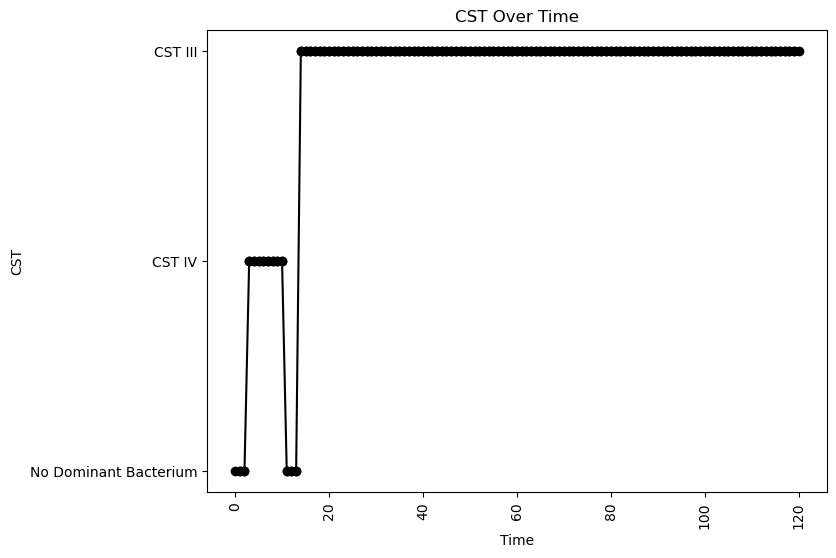


Interaction Parameters:
nAB Growth: 2.237390108639889
Li Growth: 0.07509700685781084
oLB Growth: 0.33048149496262014
nAB Self: -0.0972010277615771
nAB->Li: -0.029089025092259246
nAB->oLB: -0.3226239694016596
Li->nAB: 0.11774552498561541
Li Self: -0.07142982955688643
Li->oLB: -0.29529298125489867
oLB->nAB: -0.4320163513405547
oLB->Li: -0.24360628414512592
oLB Self: -0.07575161219832671

Simulation 1116 follows a valid CST progression:


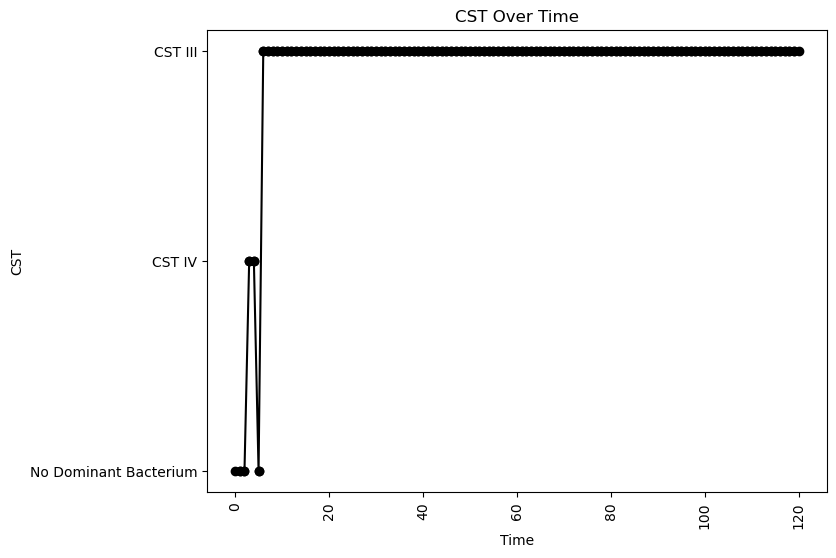


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.06544485568670996
nAB->Li: 0.19415216610621355
nAB->oLB: -0.08783719479982183
Li->nAB: 0.411962008488833
Li Self: -0.011275456927041377
Li->oLB: -0.32416950819188506
oLB->nAB: -0.263595986925808
oLB->Li: -0.12487704126063592
oLB Self: -0.09079496792223214

Simulation 1117 follows a valid CST progression:


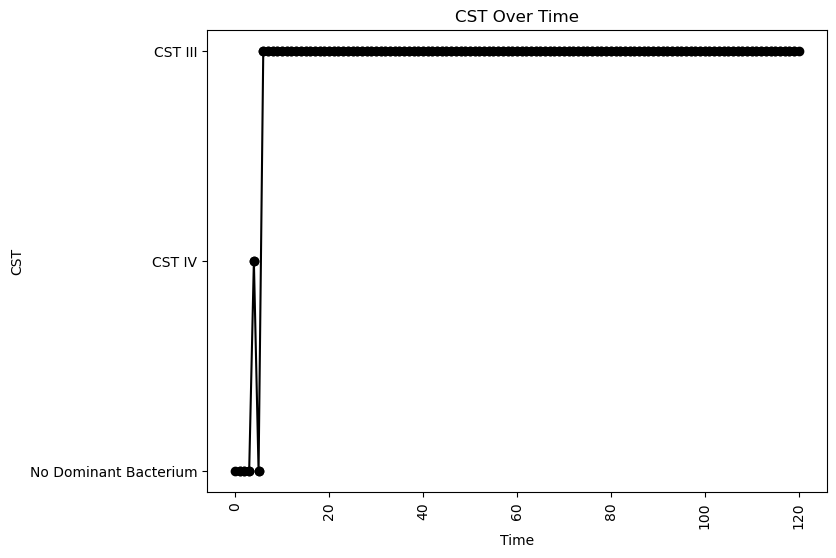


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.03456735716518844
nAB->Li: -0.137317525549619
nAB->oLB: -0.04846712801311587
Li->nAB: 0.4088004604878108
Li Self: -0.08251678294893192
Li->oLB: -0.017467118708089202
oLB->nAB: -0.4490956728909087
oLB->Li: -0.13320610320710552
oLB Self: -0.06535818370224908

Simulation 1118 follows a valid CST progression:


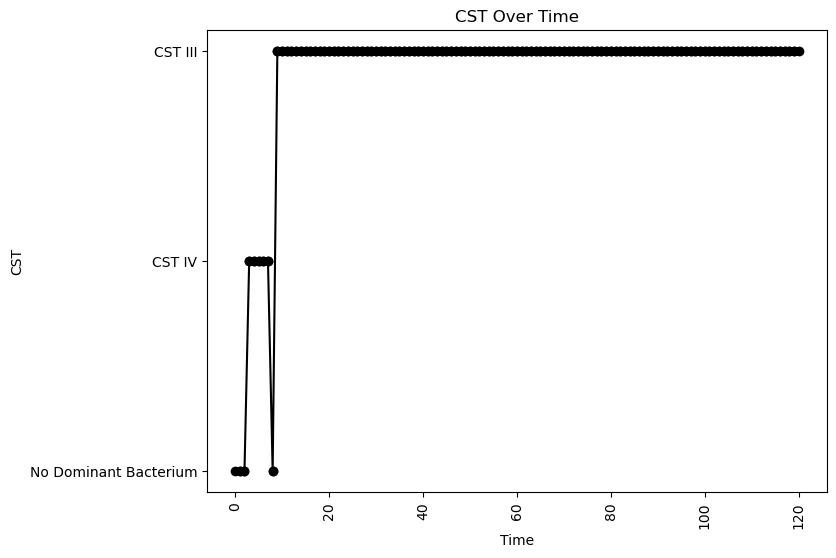


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.06588260315658048
oLB Growth: 0.21113539622386296
nAB Self: -0.058015267595408246
nAB->Li: -0.0025926605038298356
nAB->oLB: -0.23177867803701152
Li->nAB: 0.08695449359182994
Li Self: -0.035969368082389847
Li->oLB: 0.42665806355299396
oLB->nAB: -0.36027730170861716
oLB->Li: -0.4687189498290244
oLB Self: -0.015660277261717356

Simulation 1121 follows a valid CST progression:


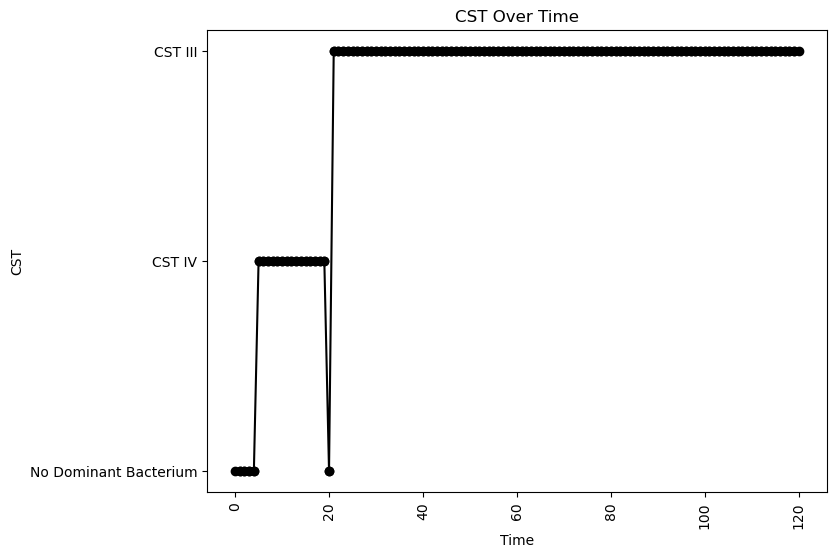


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.03477373258019545
nAB->Li: -0.09030773714606977
nAB->oLB: -0.3143856106234556
Li->nAB: 0.0070036605260402895
Li Self: -0.012511194340510623
Li->oLB: 0.452432839260162
oLB->nAB: -0.02175953117144036
oLB->Li: 0.13452309513121896
oLB Self: -0.04688842083565475

Simulation 1128 follows a valid CST progression:


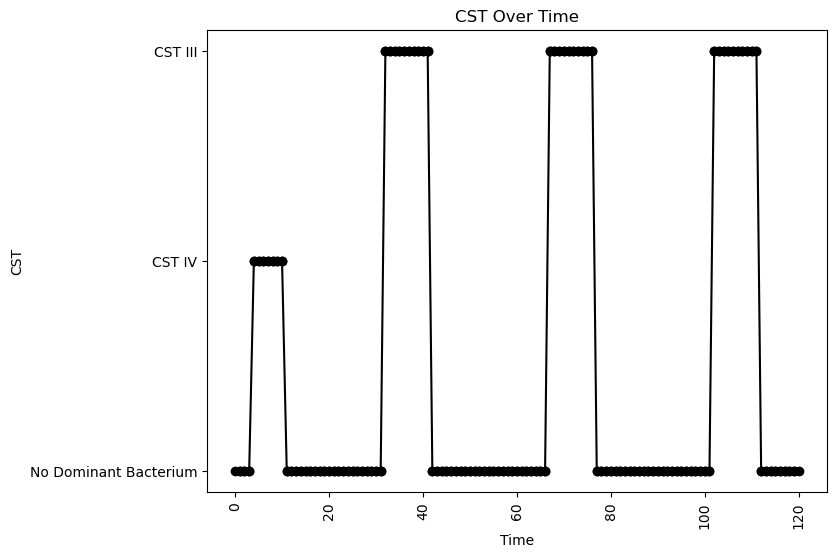


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.10019775947441673
oLB Growth: 0.20414555748463747
nAB Self: -0.08193852079171039
nAB->Li: -0.12801277845209252
nAB->oLB: -0.23443492431941781
Li->nAB: 0.04444315702016266
Li Self: -0.06523347174098099
Li->oLB: 0.03804255830212888
oLB->nAB: -0.26334854353060755
oLB->Li: -0.4551643209390922
oLB Self: -0.03644432577545685

Simulation 1137 follows a valid CST progression:


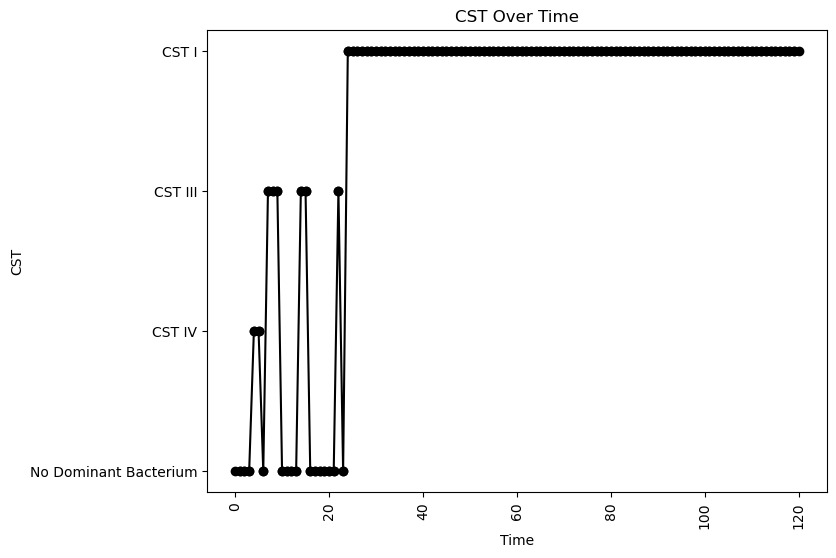


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.0703616806488323
nAB->Li: -0.04357909509212404
nAB->oLB: -0.35765026111457404
Li->nAB: 0.48007606294565186
Li Self: -0.0906021261506092
Li->oLB: -0.45278347598075125
oLB->nAB: -0.41667636913245026
oLB->Li: 0.16892868034966257
oLB Self: -0.052937598743562124

Simulation 1141 follows a valid CST progression:


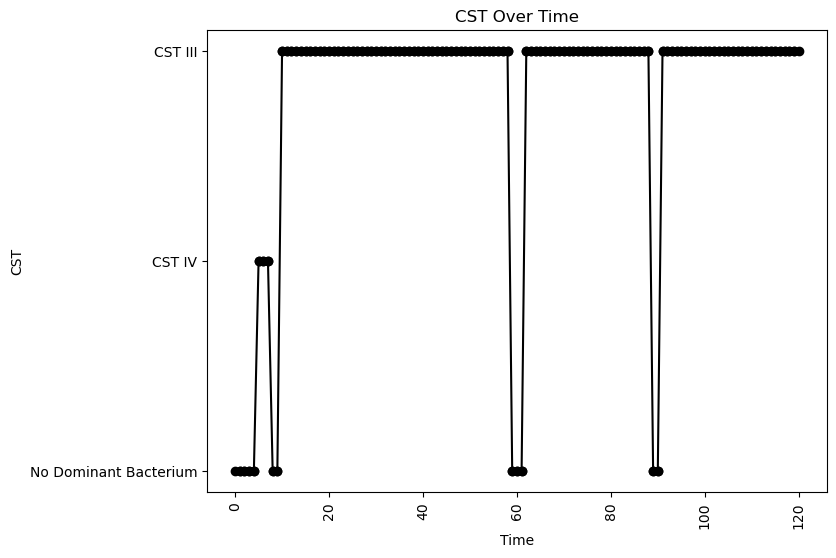


Interaction Parameters:
nAB Growth: 2.226251684223429
Li Growth: 0.0760937960697033
oLB Growth: 0.4505921706771102
nAB Self: -0.07806128445589246
nAB->Li: -0.14262277094518183
nAB->oLB: -0.28235957654674926
Li->nAB: 0.1733908480631523
Li Self: -0.059931604134875104
Li->oLB: 0.2906333461012742
oLB->nAB: -0.0002703044433059465
oLB->Li: -0.07016334591542844
oLB Self: -0.0249664170003049

Simulation 1144 follows a valid CST progression:


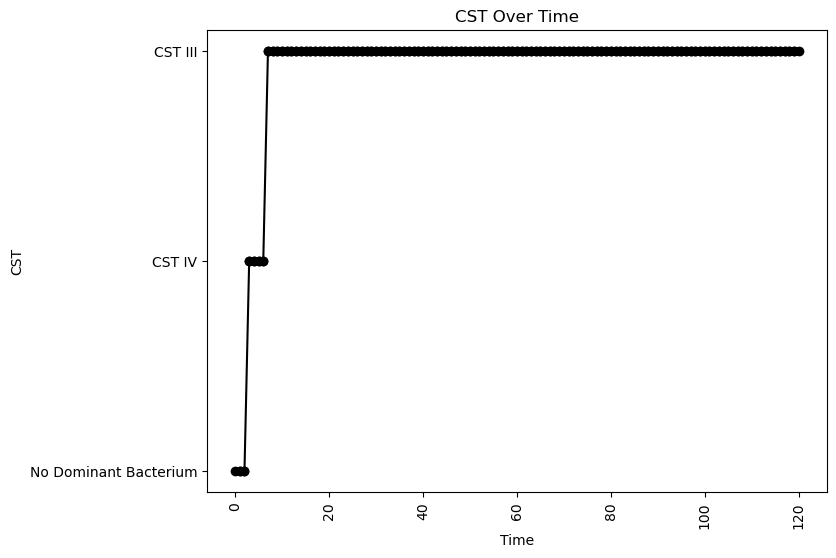


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.03837725110012093
oLB Growth: 1.155917868199191
nAB Self: -0.08170588829901992
nAB->Li: -0.2137923049337359
nAB->oLB: -0.4721279493324168
Li->nAB: 0.27542731912448204
Li Self: -0.026091867430962798
Li->oLB: -0.17907695894575365
oLB->nAB: -0.3672710320571566
oLB->Li: -0.42601209452479993
oLB Self: -0.07483244330570443

Simulation 1162 follows a valid CST progression:


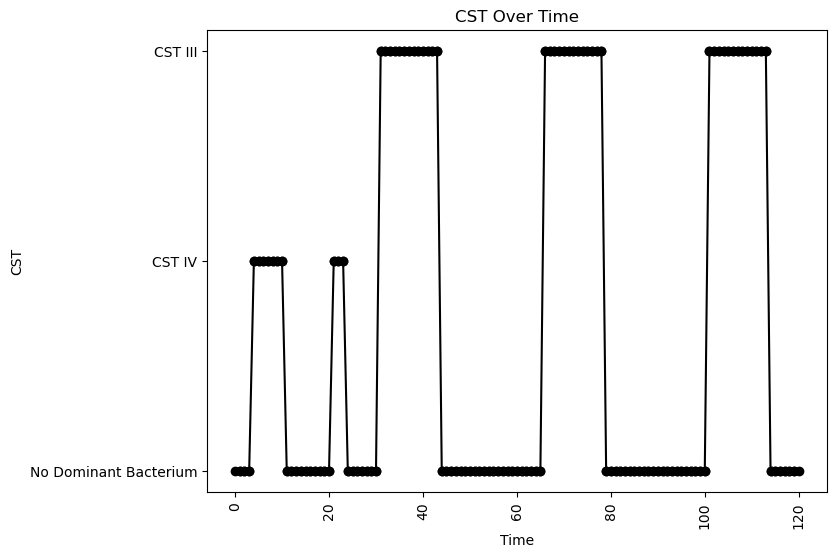


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.06588260315658048
oLB Growth: 0.21113539622386296
nAB Self: -0.07965726357352003
nAB->Li: -0.19141446918827493
nAB->oLB: -0.03535539512017655
Li->nAB: 0.04465257591281202
Li Self: -0.06774704201322956
Li->oLB: 0.13861736522348345
oLB->nAB: -0.28676437650503145
oLB->Li: -0.364326819096743
oLB Self: -0.04650690960516754

Simulation 1168 follows a valid CST progression:


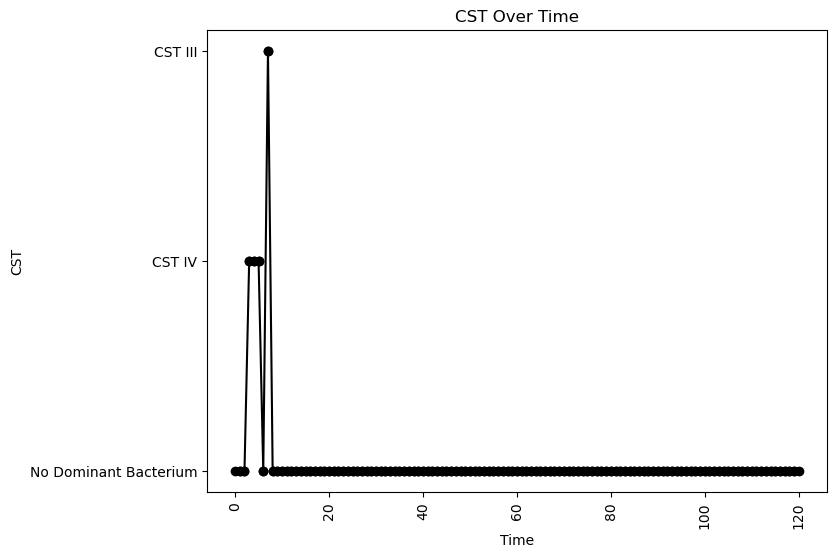


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.03442715452283063
nAB->Li: -0.2620325751811393
nAB->oLB: -0.19581189180265662
Li->nAB: 0.19357746092584338
Li Self: -0.001774919530685884
Li->oLB: 0.2731449247323394
oLB->nAB: -0.22200810862915804
oLB->Li: 0.44773370005601987
oLB Self: -0.09306145128086916

Simulation 1170 follows a valid CST progression:


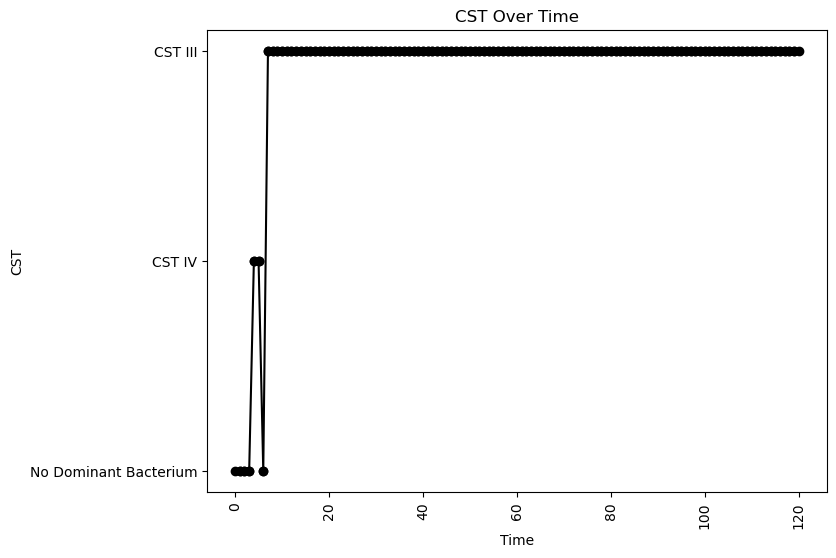


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.3330655996265943
oLB Growth: 0.7070472171500886
nAB Self: -0.016003286040051315
nAB->Li: -0.049404225053053585
nAB->oLB: -0.032936504120937016
Li->nAB: 0.07072553438173357
Li Self: -0.012003940252305306
Li->oLB: 0.37570740037104766
oLB->nAB: -0.17490824025884688
oLB->Li: -0.06214669710687337
oLB Self: -0.024364793537864388

Simulation 1177 follows a valid CST progression:


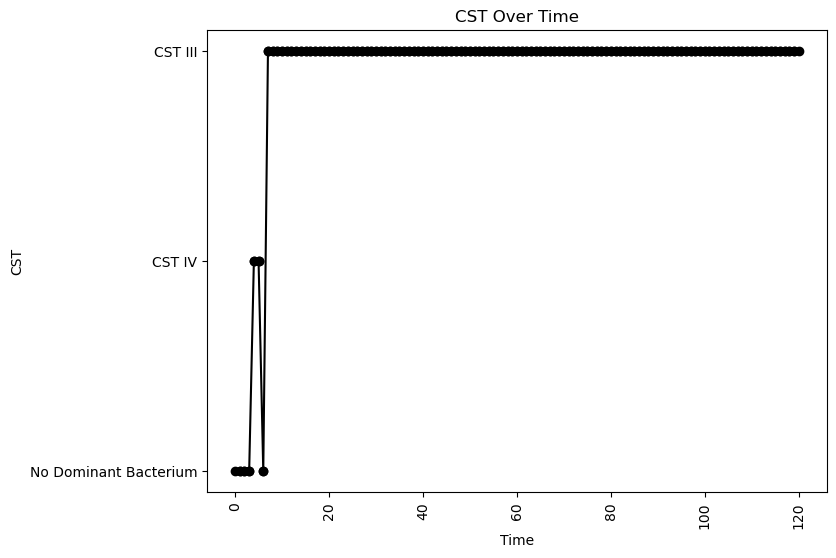


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.054814109774542735
nAB->Li: -0.2934361469671213
nAB->oLB: -0.056222982897498386
Li->nAB: 0.38222006913141815
Li Self: -0.056560278111337604
Li->oLB: -0.042886227051676995
oLB->nAB: -0.04883372026444671
oLB->Li: -0.13930258372714638
oLB Self: -0.09660027268883742

Simulation 1180 follows a valid CST progression:


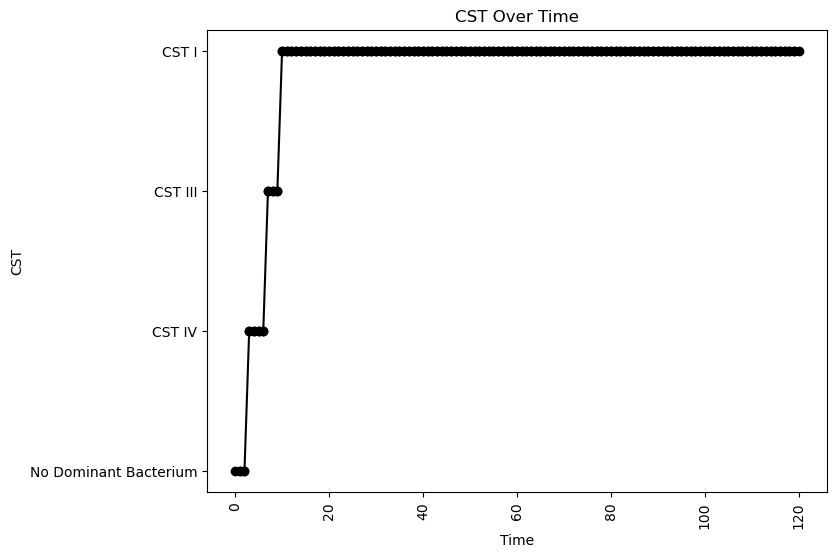


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.06034497634587039
nAB->Li: -0.2755011343555448
nAB->oLB: -0.3725165798326695
Li->nAB: 0.22114853827906855
Li Self: -0.02900754776235788
Li->oLB: -0.17224964309930524
oLB->nAB: -0.43376142159773434
oLB->Li: 0.3800242341252722
oLB Self: -0.06683846277763518

Simulation 1182 follows a valid CST progression:


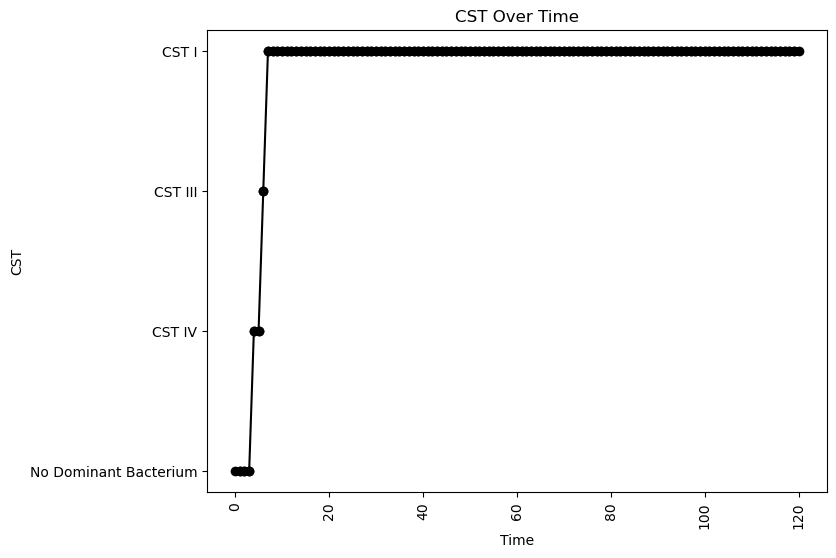


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.007837891560749086
nAB->Li: 0.00749379055365984
nAB->oLB: -0.4943171030930078
Li->nAB: 0.42609706553220983
Li Self: -0.002343536351961273
Li->oLB: -0.3666518283766275
oLB->nAB: -0.2924873531507452
oLB->Li: 0.12278278862067726
oLB Self: -0.005259979674764714

Simulation 1183 follows a valid CST progression:


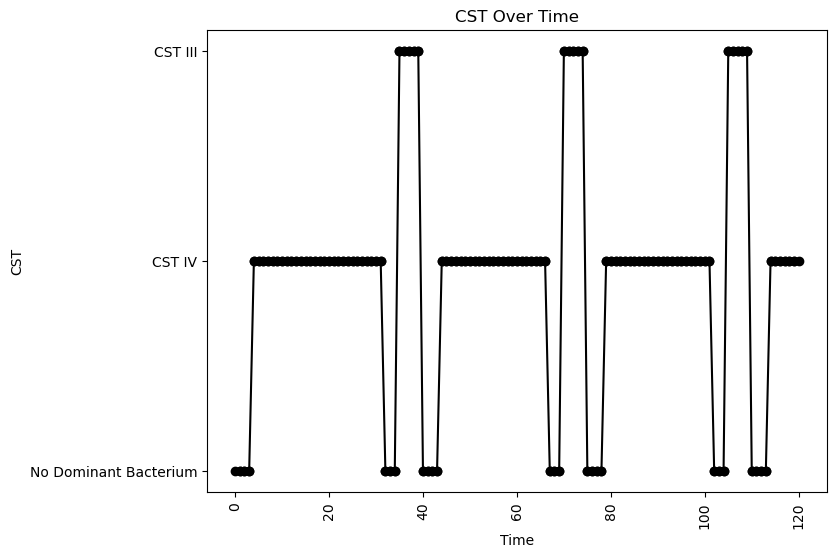


Interaction Parameters:
nAB Growth: 2.284416841880324
Li Growth: 0.06886020002136616
oLB Growth: 0.35838896078112936
nAB Self: -0.024246060406230077
nAB->Li: -0.25574704559137834
nAB->oLB: -0.26865280594615426
Li->nAB: 0.020165244514814495
Li Self: -0.08407522226007286
Li->oLB: -0.4495591085211108
oLB->nAB: -0.4905630245201009
oLB->Li: 0.2578488211586486
oLB Self: -0.03536434301264768

Simulation 1189 follows a valid CST progression:


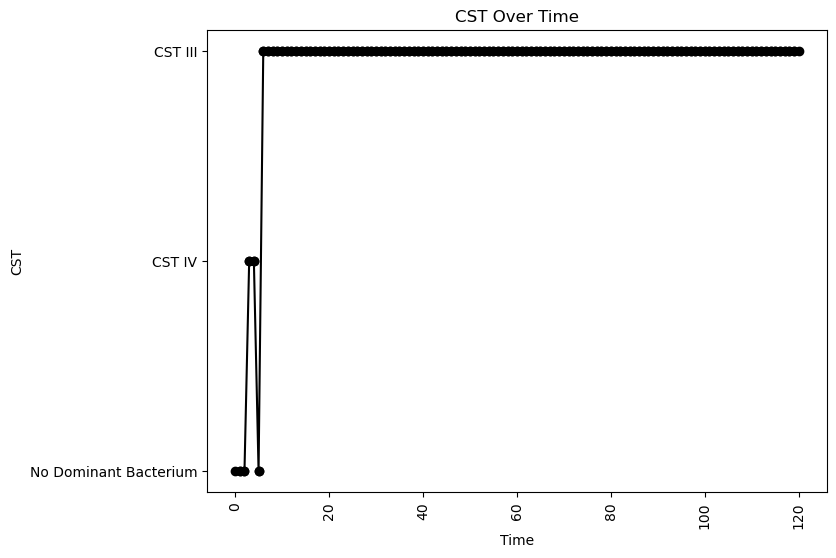


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.08840518497319445
nAB->Li: -0.33569010973404967
nAB->oLB: -0.04223009734229438
Li->nAB: 0.37983987931108854
Li Self: -0.008776754332669737
Li->oLB: 0.2679504813172754
oLB->nAB: -0.438294437509333
oLB->Li: 0.12878427915107904
oLB Self: -0.0444217113446439

Simulation 1190 follows a valid CST progression:


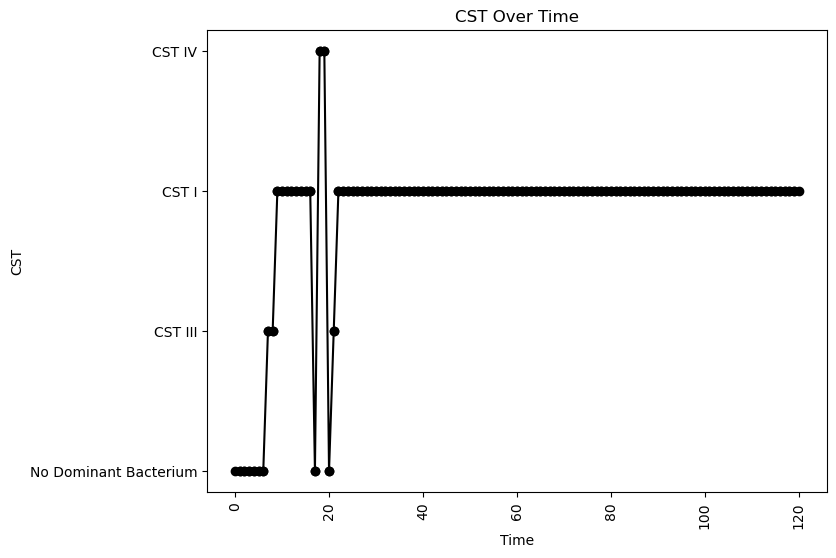


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.047348982759924454
nAB->Li: -0.4189005065781794
nAB->oLB: -0.24447437748269069
Li->nAB: 0.40851318126736424
Li Self: -0.09932855478163964
Li->oLB: -0.22569945288937004
oLB->nAB: -0.3247905360976918
oLB->Li: 0.4106215696643625
oLB Self: -0.053878761267097224

Simulation 1192 follows a valid CST progression:


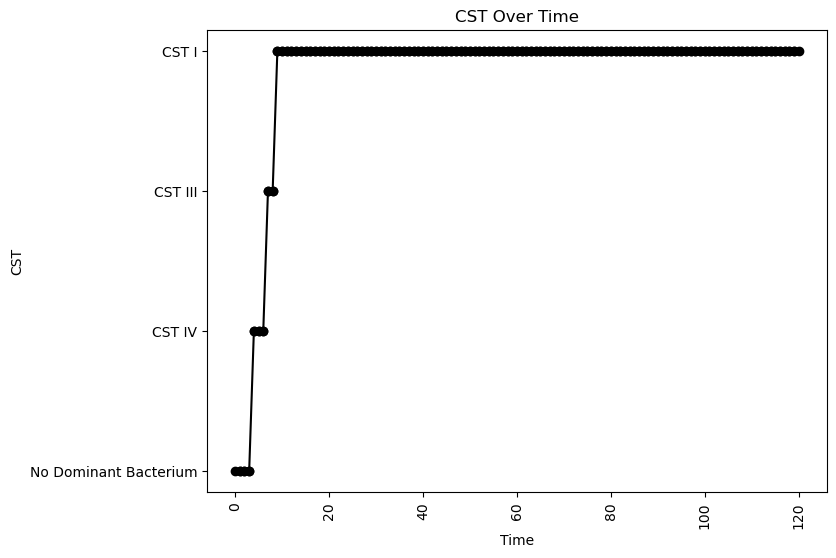


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.33068120480496993
oLB Growth: 0.08496126009849418
nAB Self: -0.08071266587210764
nAB->Li: -0.2705771369367318
nAB->oLB: -0.30932202800205344
Li->nAB: 0.11100312206461649
Li Self: -0.006438114314190474
Li->oLB: -0.48583403742378584
oLB->nAB: -0.41557645928438247
oLB->Li: 0.45199893759987375
oLB Self: -0.006907734834930346

Simulation 1196 follows a valid CST progression:


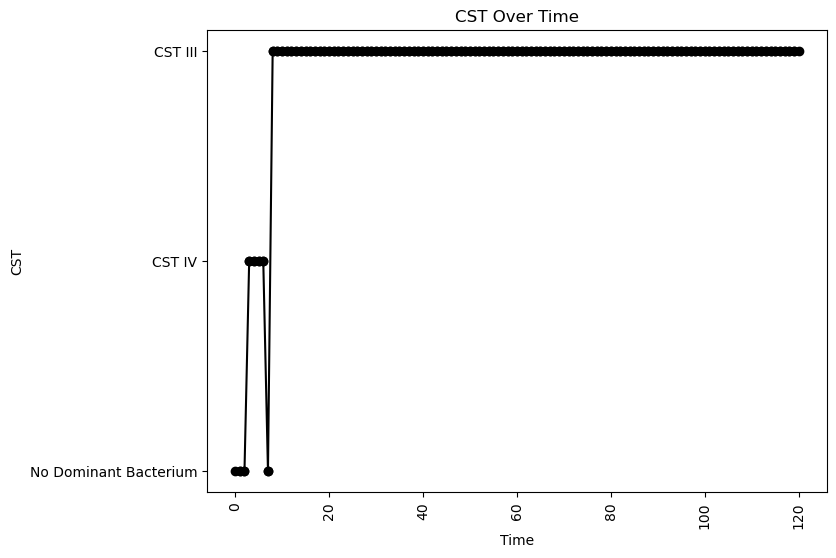


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.29583610747637507
oLB Growth: 0.058910478352813524
nAB Self: -0.0385305880895276
nAB->Li: -0.058745626782343185
nAB->oLB: -0.013612704866626246
Li->nAB: 0.06691745173920904
Li Self: -0.04192165083131217
Li->oLB: -0.4213520421154862
oLB->nAB: -0.41922477601098695
oLB->Li: -0.06788795747895959
oLB Self: -0.07974559116264678

Simulation 1205 follows a valid CST progression:


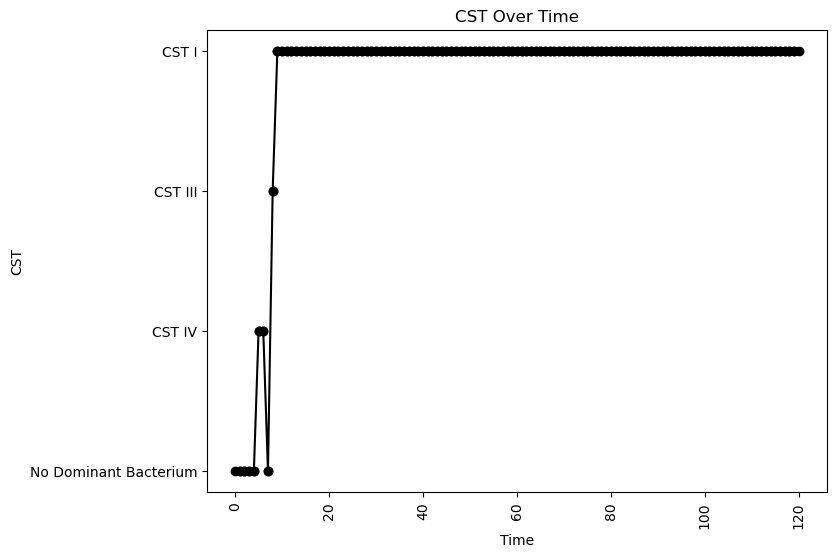


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.07248117756697481
nAB->Li: -0.1273535880489568
nAB->oLB: -0.2808158314365638
Li->nAB: 0.23805106752408178
Li Self: -0.008807146643620659
Li->oLB: -0.2987870017871195
oLB->nAB: -0.23644795895935394
oLB->Li: 0.3266978815444993
oLB Self: -0.06474315356579083

Simulation 1213 follows a valid CST progression:


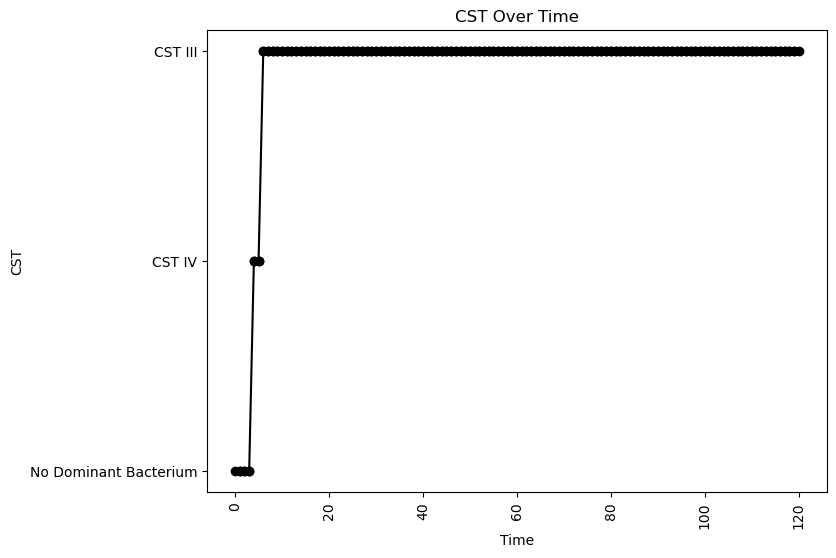


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.06495430992206574
oLB Growth: 0.1731103059651596
nAB Self: -0.044693235532787964
nAB->Li: 0.1391115360093116
nAB->oLB: -0.3794401202727945
Li->nAB: 0.48523366697021586
Li Self: -0.09319199570042665
Li->oLB: -0.14392161993028862
oLB->nAB: -0.12633849322320723
oLB->Li: 0.10654153322262061
oLB Self: -0.0323967182514454

Simulation 1221 follows a valid CST progression:


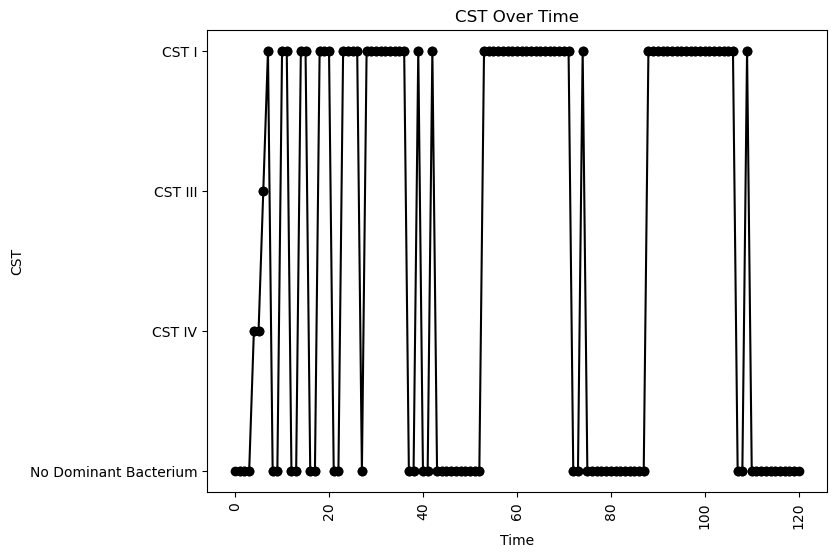


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.09505219287789413
nAB->Li: 0.1518271650125005
nAB->oLB: -0.076644616395314
Li->nAB: 0.31865867492046773
Li Self: -0.0600504594741597
Li->oLB: -0.09515612552512948
oLB->nAB: -0.17922799537638062
oLB->Li: 0.3605588002368486
oLB Self: -0.08193100809526888

Simulation 1222 follows a valid CST progression:


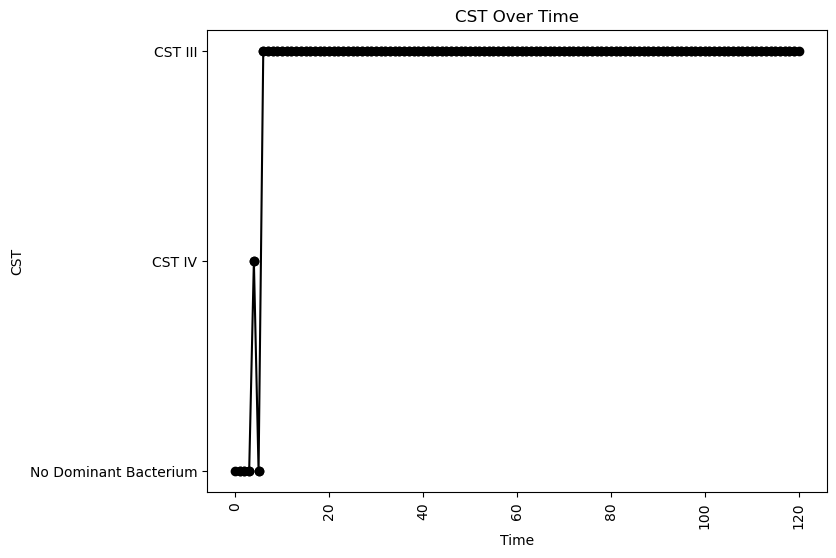


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.13476288784481574
oLB Growth: 0.46591620920123267
nAB Self: -0.056089742240167696
nAB->Li: -0.4286536819917346
nAB->oLB: -0.11469180860734957
Li->nAB: 0.2147155600812919
Li Self: -0.07798386111953995
Li->oLB: 0.21135616730892193
oLB->nAB: -0.07122290440789286
oLB->Li: -0.3212576144176962
oLB Self: -0.054021547515956385

Simulation 1223 follows a valid CST progression:


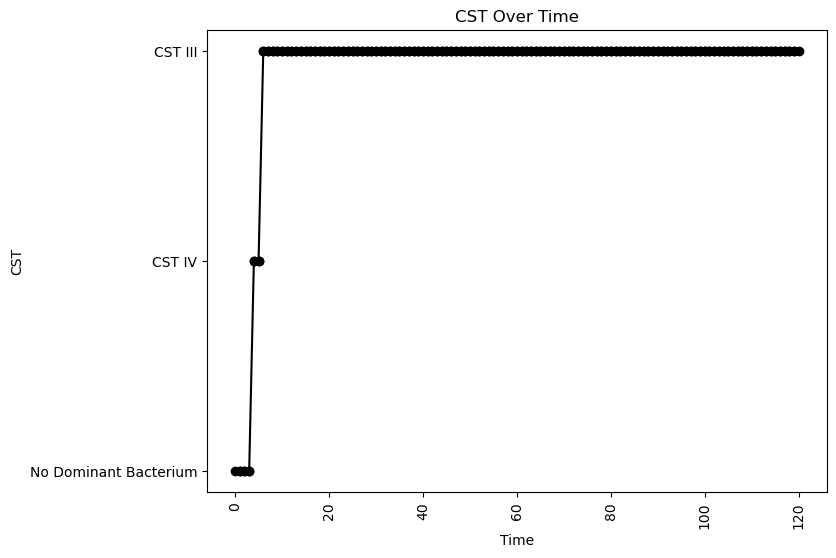


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.04590309028676679
nAB->Li: -0.2524138290925215
nAB->oLB: -0.37330051516583307
Li->nAB: 0.4221653951956419
Li Self: -0.00493930325477604
Li->oLB: 0.1764589244063135
oLB->nAB: -0.15828313907950597
oLB->Li: -0.25654609242473336
oLB Self: -0.03558570535188123

Simulation 1227 follows a valid CST progression:


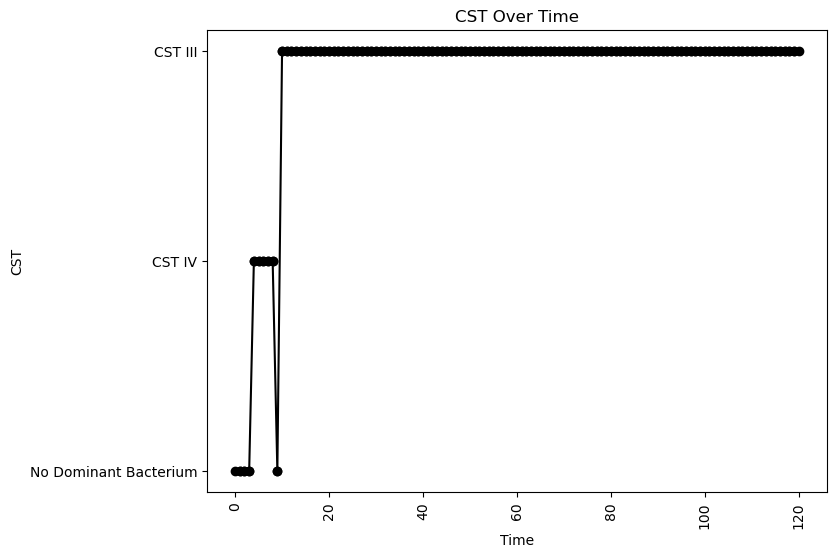


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.06276501980909559
oLB Growth: 0.08496126009849418
nAB Self: -0.06318741168739664
nAB->Li: -0.29925122393868264
nAB->oLB: -0.3252425559599632
Li->nAB: 0.05161997052371314
Li Self: -0.02594842589815148
Li->oLB: 0.2558011604578969
oLB->nAB: -0.2516331170210503
oLB->Li: -0.16311418913601772
oLB Self: -0.041289845255822036

Simulation 1228 follows a valid CST progression:


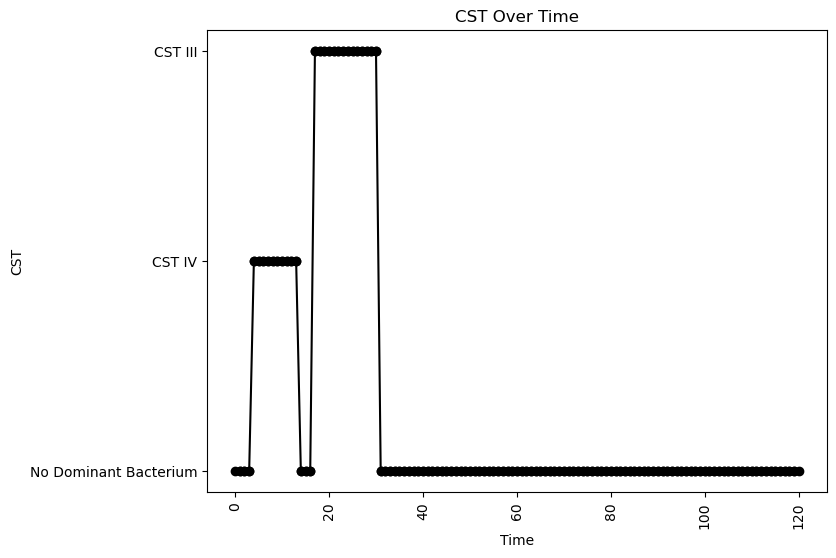


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.08708940844905931
nAB->Li: -0.3514634962850467
nAB->oLB: -0.10112195446220734
Li->nAB: 0.027160312169844048
Li Self: -0.011010891268197293
Li->oLB: 0.33133822929404966
oLB->nAB: -0.3456915168573446
oLB->Li: 0.33731326610265766
oLB Self: -0.05226672192460172

Simulation 1231 follows a valid CST progression:


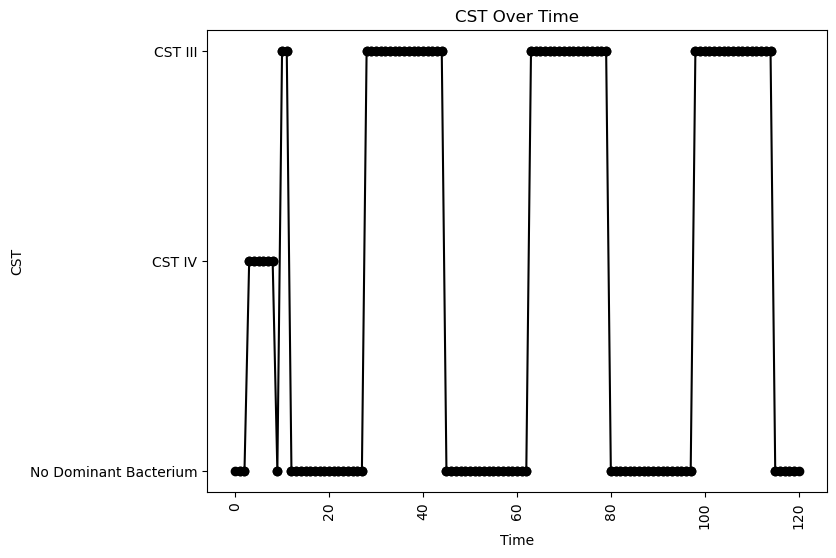


Interaction Parameters:
nAB Growth: 2.300652803872004
Li Growth: 0.06616501714537036
oLB Growth: 0.4369767544558836
nAB Self: -0.03167607468984411
nAB->Li: -0.28139164321594373
nAB->oLB: -0.02825194932914643
Li->nAB: 0.08450724521682307
Li Self: -0.09120646305380022
Li->oLB: 0.16003792997260002
oLB->nAB: -0.26055168238555715
oLB->Li: -0.01953617574700417
oLB Self: -0.058840537937528706

Simulation 1237 follows a valid CST progression:


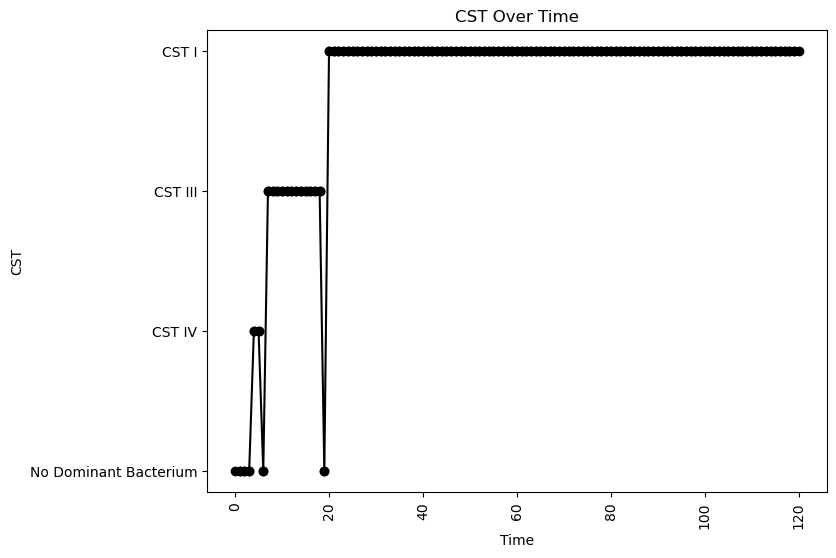


Interaction Parameters:
nAB Growth: 2.2563448832512942
Li Growth: 0.07234741829114298
oLB Growth: 0.40127498600949585
nAB Self: -0.0067010582141393965
nAB->Li: -0.25819088833158155
nAB->oLB: -0.34666259143692046
Li->nAB: 0.24325571939590096
Li Self: -0.03905508960010076
Li->oLB: -0.05267364046383405
oLB->nAB: -0.33411844267144974
oLB->Li: 0.08121738311707638
oLB Self: -0.002780653813186734

Simulation 1238 follows a valid CST progression:


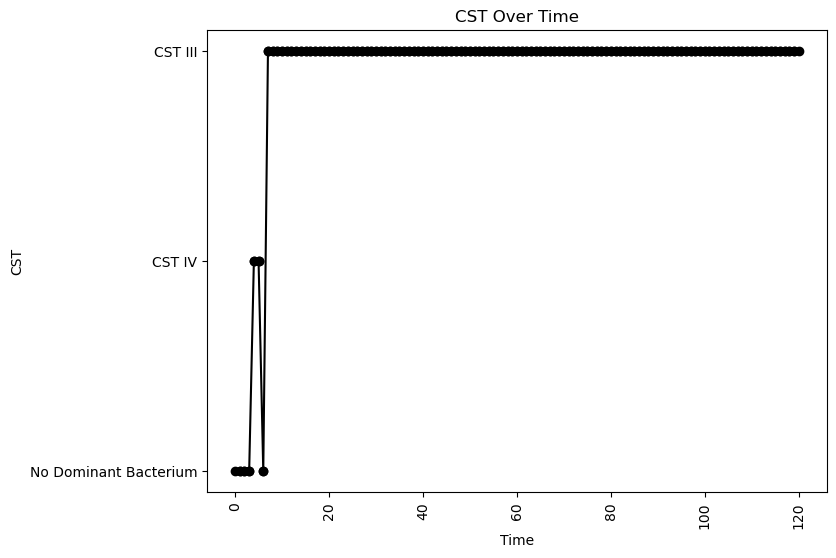


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.062174431992543966
nAB->Li: -0.3199319446888287
nAB->oLB: -0.288642076652989
Li->nAB: 0.35912540666865045
Li Self: -0.09344891464575956
Li->oLB: -0.38529723557682916
oLB->nAB: -0.29787833458346114
oLB->Li: -0.40786108481738426
oLB Self: -0.07572052541434707

Simulation 1247 follows a valid CST progression:


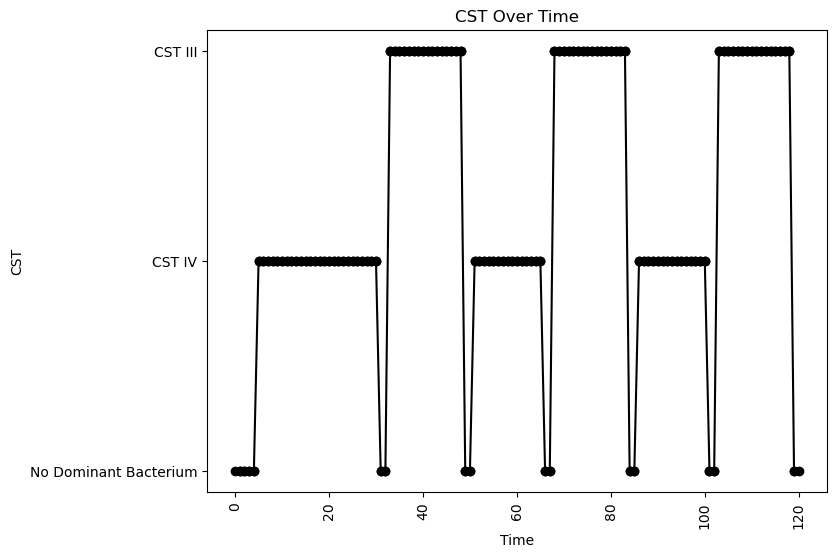


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.0996584499234928
oLB Growth: 0.08496126009849418
nAB Self: -0.03098459912607268
nAB->Li: -0.36502928049692085
nAB->oLB: -0.2155710631808449
Li->nAB: 0.02504960772051401
Li Self: -0.08318678331697113
Li->oLB: 0.2662425509011789
oLB->nAB: -0.26537493712730253
oLB->Li: 0.16224151874341475
oLB Self: -0.018538545227862704

Simulation 1256 follows a valid CST progression:


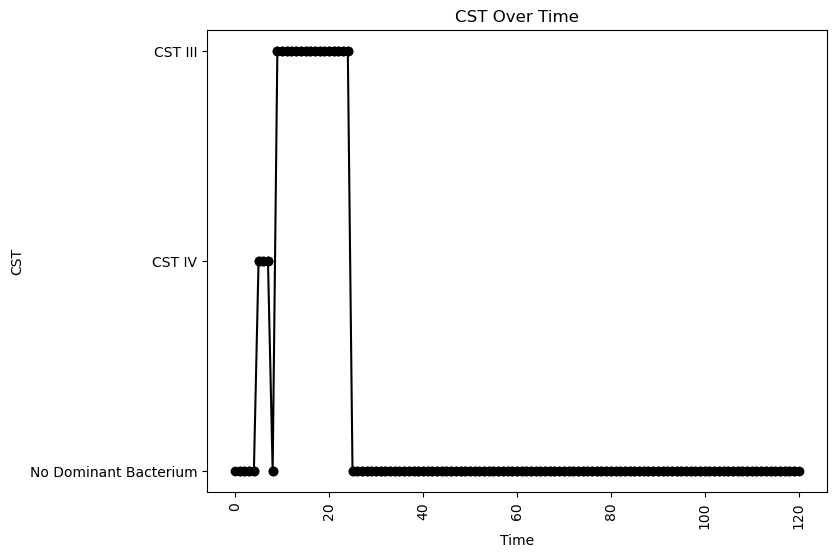


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.097047260632867
nAB->Li: -0.4685772375171121
nAB->oLB: -0.15785222662241516
Li->nAB: 0.16831595768246688
Li Self: -0.09139878050729193
Li->oLB: 0.3067960153402228
oLB->nAB: -0.43581320730646755
oLB->Li: 0.22190483532621008
oLB Self: -0.09302868073653826

Simulation 1259 follows a valid CST progression:


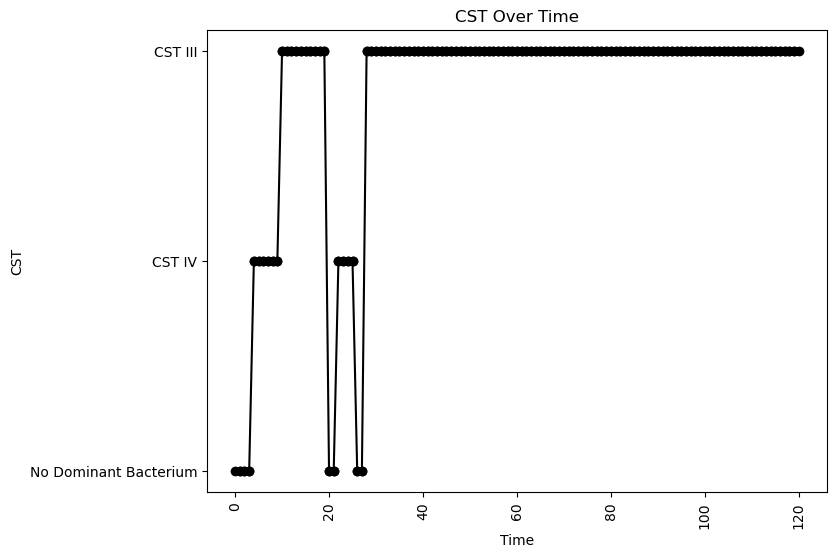


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.01797671934746324
nAB->Li: -0.4910722403183752
nAB->oLB: -0.15072265661359646
Li->nAB: 0.06191713136819921
Li Self: -0.0634603665035462
Li->oLB: -0.24569587596767423
oLB->nAB: -0.3644008589048212
oLB->Li: -0.21042089851066414
oLB Self: -0.026714650066987228

Simulation 1262 follows a valid CST progression:


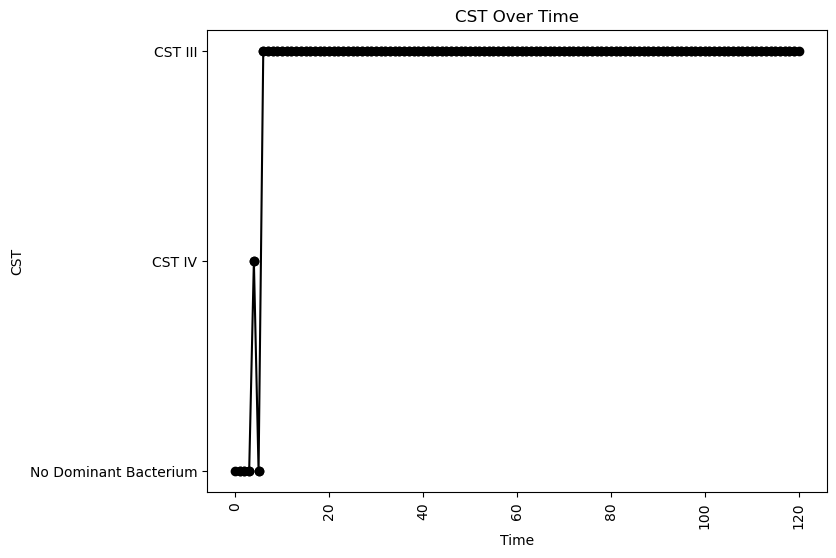


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.13883074455502276
oLB Growth: 0.20431222189445272
nAB Self: -0.04466332229911914
nAB->Li: 0.08961276147533837
nAB->oLB: -0.36055696565056766
Li->nAB: 0.301162754633728
Li Self: -0.01630898805403984
Li->oLB: 0.10530087164351265
oLB->nAB: -0.15824710233318623
oLB->Li: -0.2611033233459558
oLB Self: -0.027269742692165838

Simulation 1264 follows a valid CST progression:


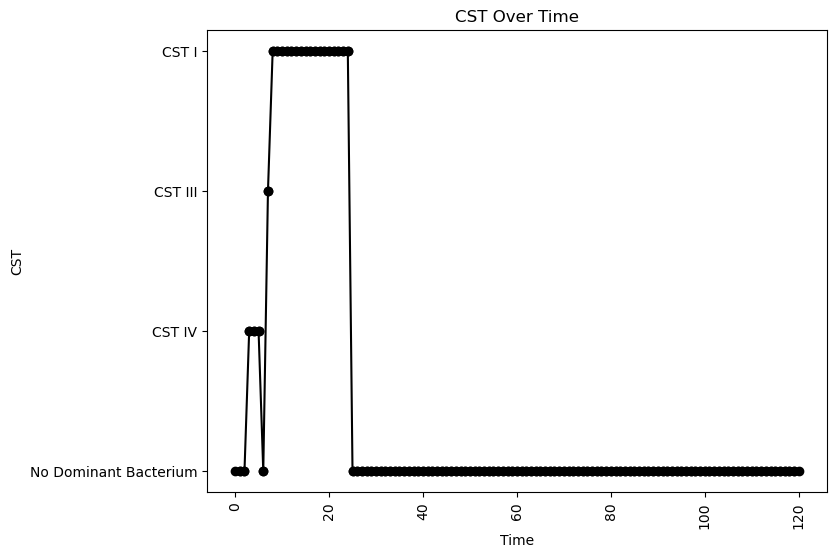


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.04919416371162814
nAB->Li: -0.38719034369997796
nAB->oLB: -0.2670625996182667
Li->nAB: 0.3347329344978668
Li Self: -0.06615916703626634
Li->oLB: 0.12038991998398263
oLB->nAB: -0.08003574242951939
oLB->Li: 0.36383654460946513
oLB Self: -0.07685118888357162

Simulation 1266 follows a valid CST progression:


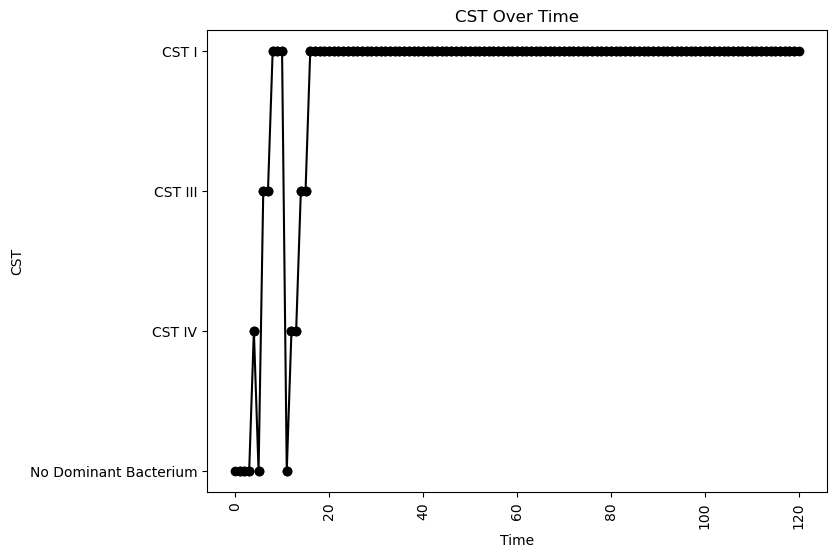


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.29929978140411273
oLB Growth: 0.11031283255203692
nAB Self: -0.023078749166334733
nAB->Li: -0.21536349954199174
nAB->oLB: -0.1622252752044835
Li->nAB: 0.2974443502049269
Li Self: -0.0608692546003114
Li->oLB: -0.4321361519055486
oLB->nAB: -0.377399323066013
oLB->Li: 0.36359823398142455
oLB Self: -0.02344435339328292

Simulation 1267 follows a valid CST progression:


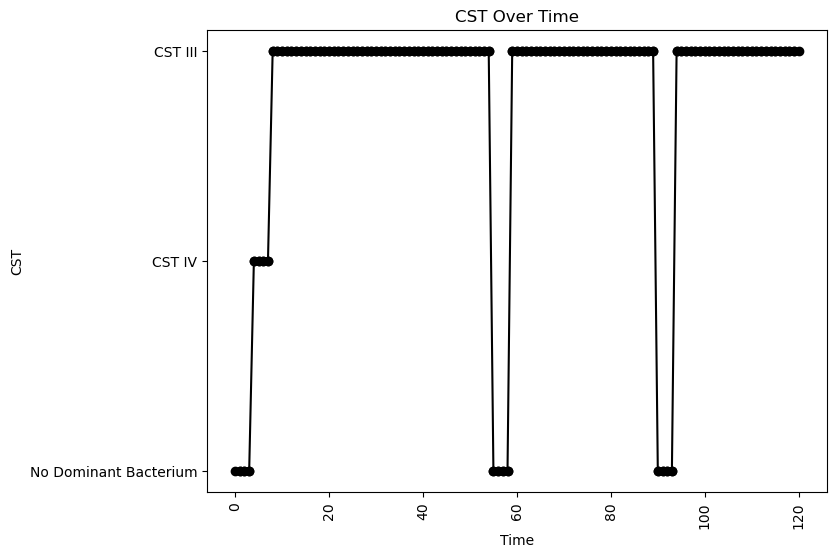


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.06806014290478743
oLB Growth: 0.20414555748463747
nAB Self: -0.06014358695911211
nAB->Li: -0.46362258917039934
nAB->oLB: -0.43877515936222433
Li->nAB: 0.2155316240754338
Li Self: -0.09406922717127543
Li->oLB: -0.2807162942834862
oLB->nAB: -0.4389289145877707
oLB->Li: -0.14236294191975735
oLB Self: -0.05186994477447044

Simulation 1270 follows a valid CST progression:


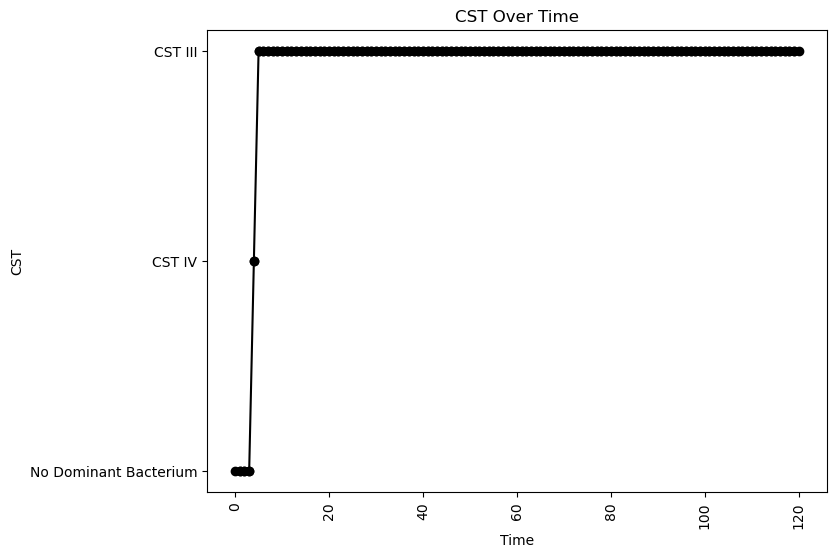


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.15808169479149298
oLB Growth: 0.30646751991446597
nAB Self: -0.07507622772364433
nAB->Li: 0.19176234877829013
nAB->oLB: -0.037582471814047114
Li->nAB: 0.4421375402268789
Li Self: -0.04358284072154072
Li->oLB: -0.25203201864462377
oLB->nAB: -0.2901351241360074
oLB->Li: -0.4425046077393533
oLB Self: -0.07641607185685567

Simulation 1278 follows a valid CST progression:


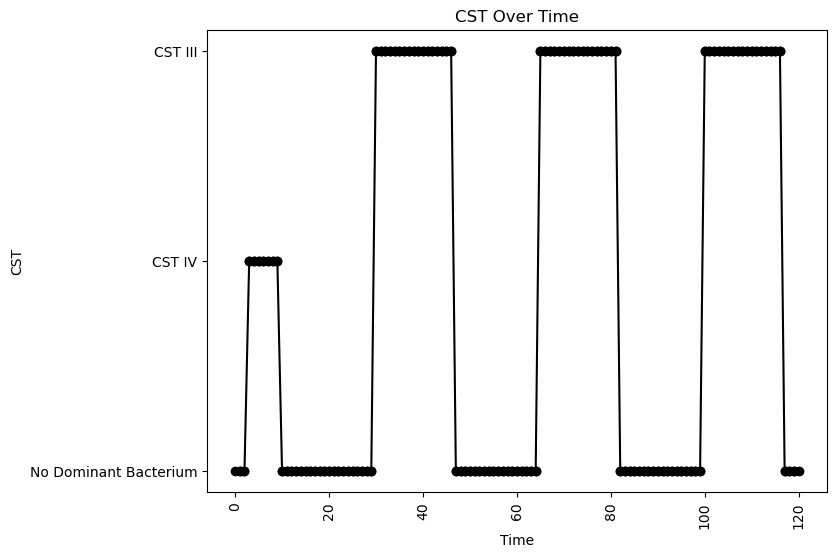


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.0722927887206575
nAB->Li: -0.09541424690646821
nAB->oLB: -0.12828422312844984
Li->nAB: 0.06335934846048141
Li Self: -0.05624863439219575
Li->oLB: 0.239452207019068
oLB->nAB: -0.29453658018432904
oLB->Li: 0.08437099773271184
oLB Self: -0.02587142323442773

Simulation 1286 follows a valid CST progression:


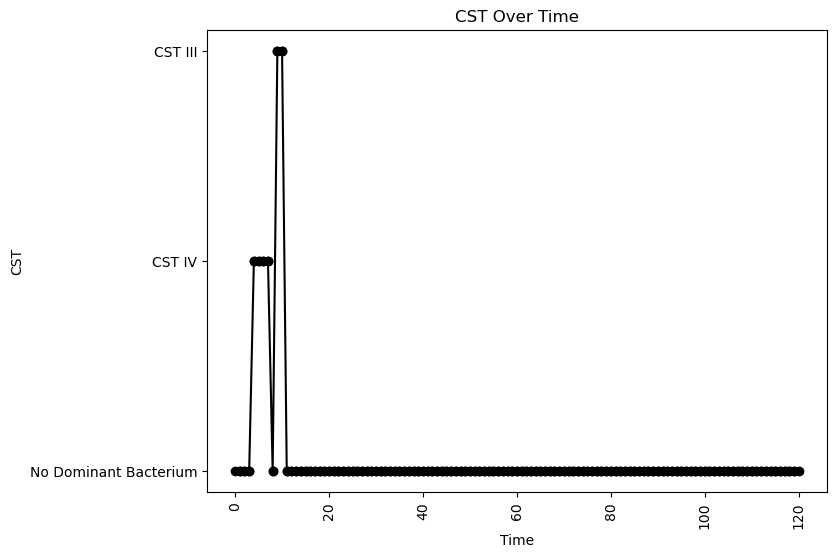


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.05951292516161872
nAB->Li: -0.17124411265068978
nAB->oLB: -0.027948830217797815
Li->nAB: 0.11335187069124453
Li Self: -0.01855655805792218
Li->oLB: 0.3589154218853624
oLB->nAB: -0.16384756228142078
oLB->Li: 0.3073168649144614
oLB Self: -0.039283111380293036

Simulation 1306 follows a valid CST progression:


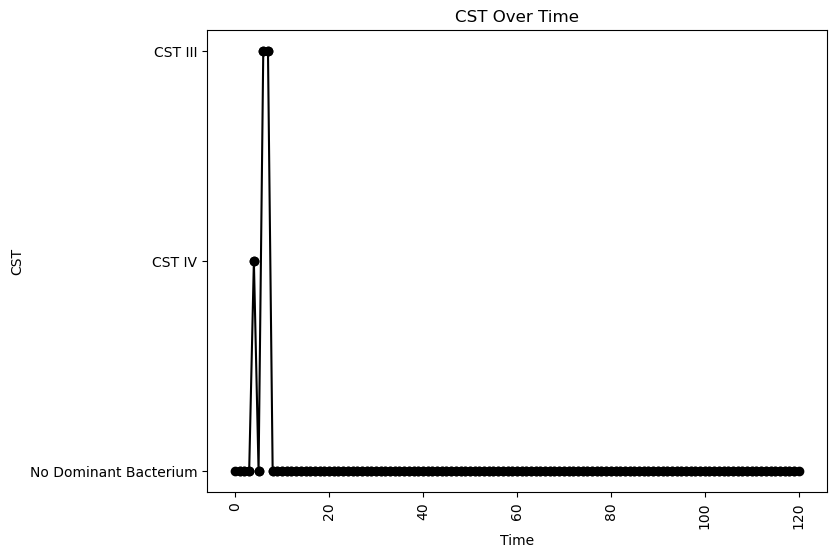


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.06806014290478743
oLB Growth: 0.20414555748463747
nAB Self: -0.03806648931106673
nAB->Li: -0.43558895178393847
nAB->oLB: -0.03971771561519827
Li->nAB: 0.48314572861677785
Li Self: -0.06174916974155899
Li->oLB: 0.4364365834435787
oLB->nAB: -0.4563771549423327
oLB->Li: 0.36462461878595376
oLB Self: -0.004575983455372815

Simulation 1309 follows a valid CST progression:


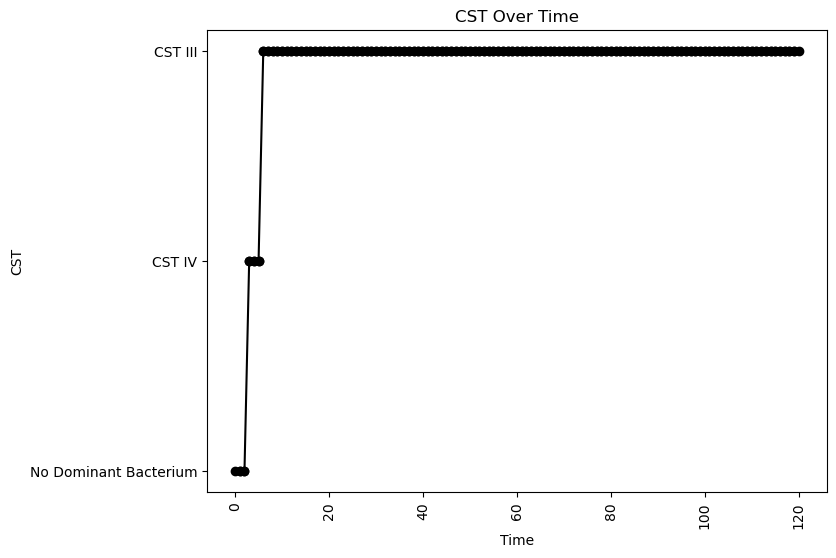


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.06588260315658048
oLB Growth: 0.21113539622386296
nAB Self: -0.05522498323128053
nAB->Li: -0.07515005161380345
nAB->oLB: -0.20816424864553967
Li->nAB: 0.4097897484497659
Li Self: -0.084147371211133
Li->oLB: -0.26110816911479956
oLB->nAB: -0.038712418247364766
oLB->Li: -0.025451722940386057
oLB Self: -0.053514228652589875

Simulation 1310 follows a valid CST progression:


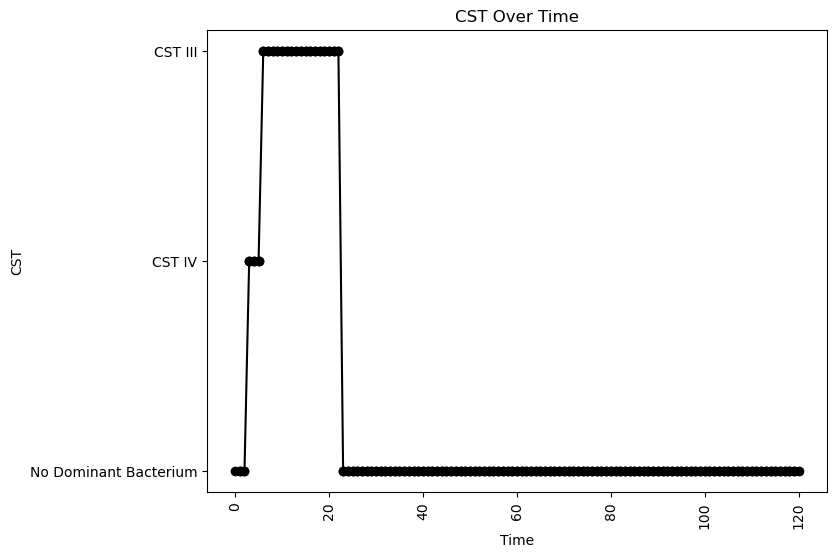


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.03944178966810265
nAB->Li: 0.04163441607226692
nAB->oLB: -0.4073591137162872
Li->nAB: 0.21728370128689778
Li Self: -0.018433934567549312
Li->oLB: -0.46424177743918627
oLB->nAB: -0.44695262878929776
oLB->Li: -0.14018960041388984
oLB Self: -0.020481651741585005

Simulation 1311 follows a valid CST progression:


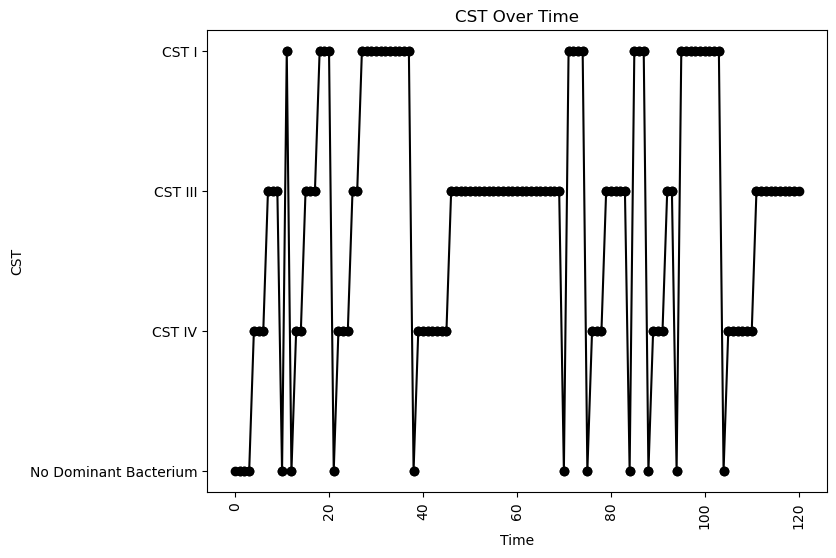


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.06495430992206574
oLB Growth: 0.1731103059651596
nAB Self: -0.03498954508960893
nAB->Li: -0.23244225282930264
nAB->oLB: -0.12242500648757332
Li->nAB: 0.23689836458893865
Li Self: -0.048613814669945805
Li->oLB: -0.4939917328609416
oLB->nAB: -0.24892132136314704
oLB->Li: 0.22386293351662545
oLB Self: -0.0804981456803789

Simulation 1321 follows a valid CST progression:


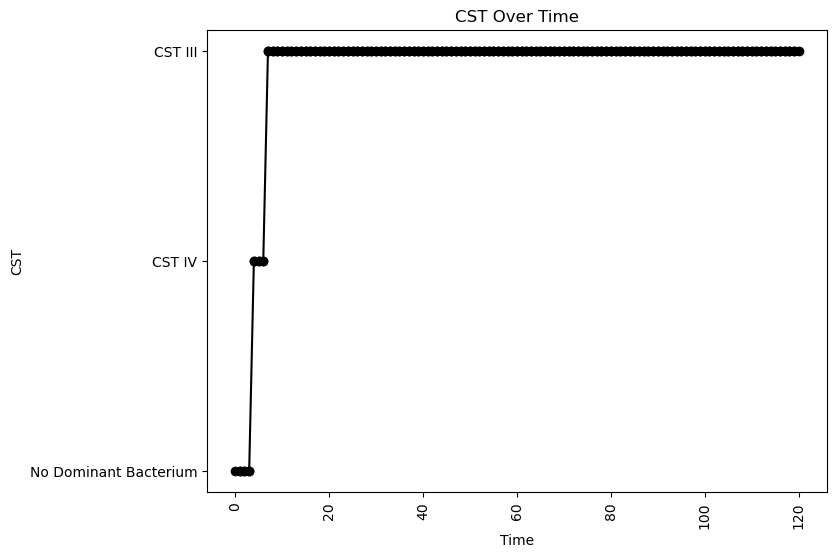


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.06664492138468138
oLB Growth: 0.6588037441195057
nAB Self: -0.020482551698670706
nAB->Li: -0.4185709424417569
nAB->oLB: -0.30956683220439307
Li->nAB: 0.15318482462840366
Li Self: -0.02481129221793603
Li->oLB: -0.20418971330337343
oLB->nAB: -0.15914737702960768
oLB->Li: -0.2464115367747285
oLB Self: -0.030395132079458903

Simulation 1327 follows a valid CST progression:


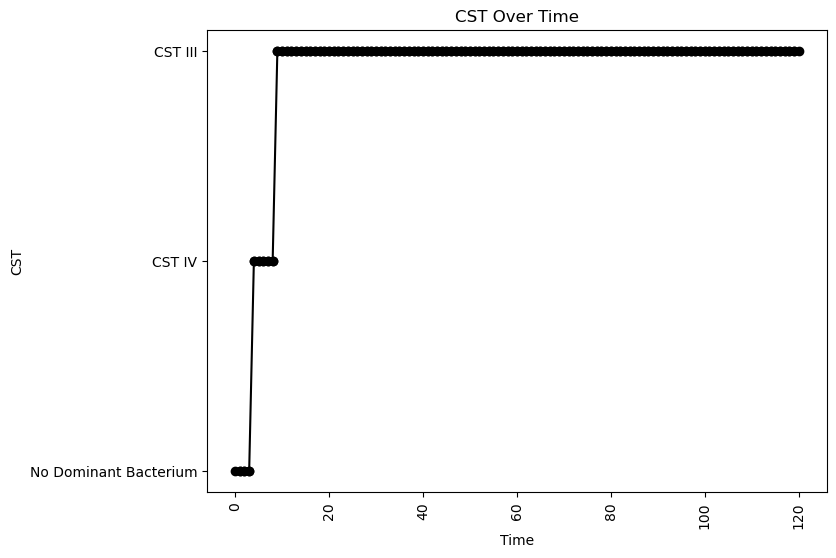


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.09410531222884488
nAB->Li: -0.4844133076693776
nAB->oLB: -0.4963374209251675
Li->nAB: 0.18581641745402588
Li Self: -0.03787235657635146
Li->oLB: -0.35222533235099873
oLB->nAB: -0.48419205428576245
oLB->Li: -0.47215758515549155
oLB Self: -0.03113474344730395

Simulation 1337 follows a valid CST progression:


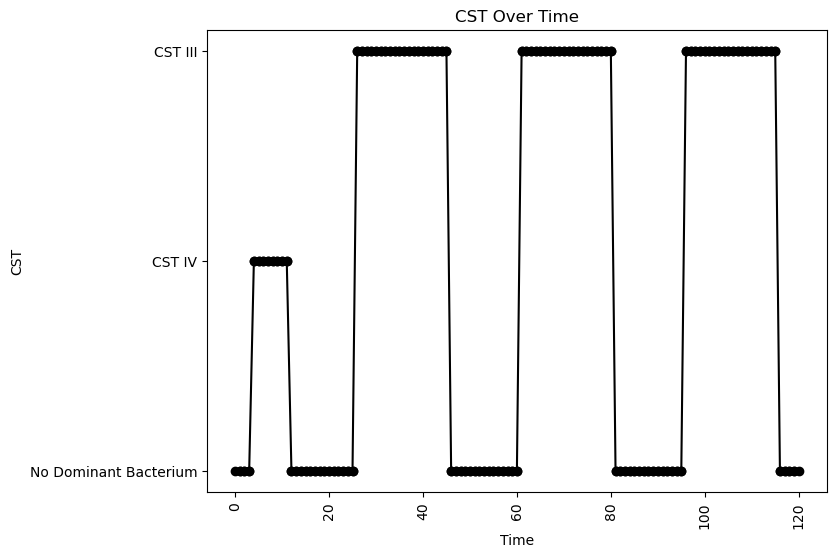


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.05072073600009906
oLB Growth: 1.0858755226067296
nAB Self: -0.06884743292851067
nAB->Li: -0.08239788409370069
nAB->oLB: -0.22759049490943517
Li->nAB: 0.038141531130256534
Li Self: -0.03739683823830908
Li->oLB: 0.27346278055427686
oLB->nAB: -0.060032515759659066
oLB->Li: -0.20579712792149024
oLB Self: -0.09866893049037252

Simulation 1344 follows a valid CST progression:


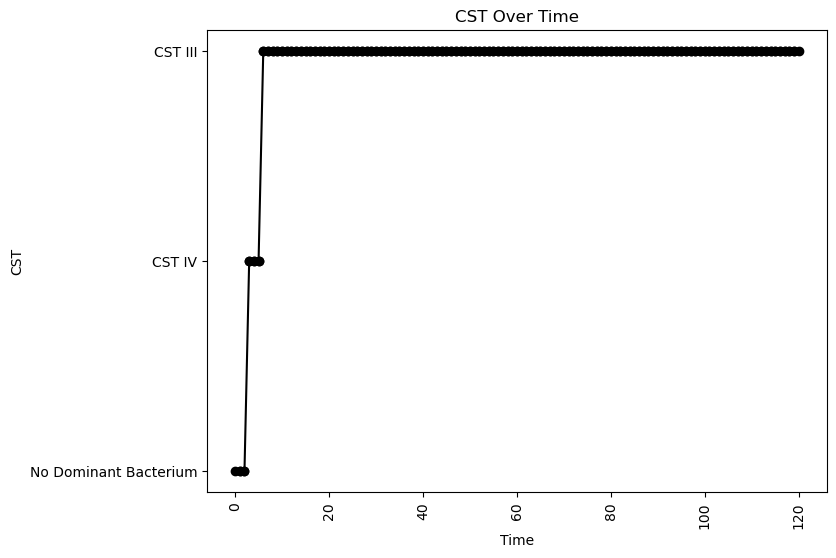


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.06495430992206574
oLB Growth: 0.1731103059651596
nAB Self: -0.029221074326717805
nAB->Li: 0.11340972474362987
nAB->oLB: -0.35333857936960694
Li->nAB: 0.39539109409110695
Li Self: -0.05556985749817603
Li->oLB: -0.041231798696730326
oLB->nAB: -0.15476729368079467
oLB->Li: -0.3051401203126112
oLB Self: -0.03819989747114642

Simulation 1351 follows a valid CST progression:


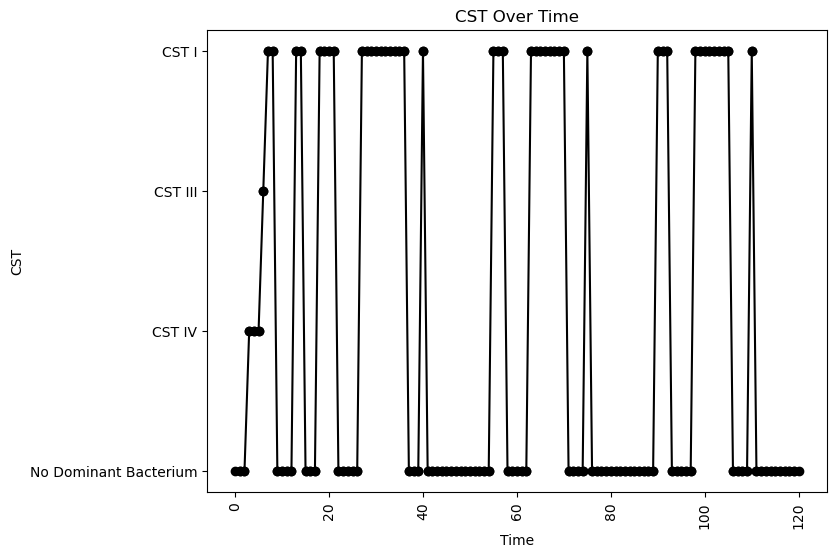


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.08647418489182424
nAB->Li: -0.14734689165833031
nAB->oLB: -0.09232042604856566
Li->nAB: 0.39110962950618167
Li Self: -0.05607718663094503
Li->oLB: -0.23996490395106101
oLB->nAB: -0.05722816994528085
oLB->Li: 0.3577571510371548
oLB Self: -0.0938371891208544

Simulation 1361 follows a valid CST progression:


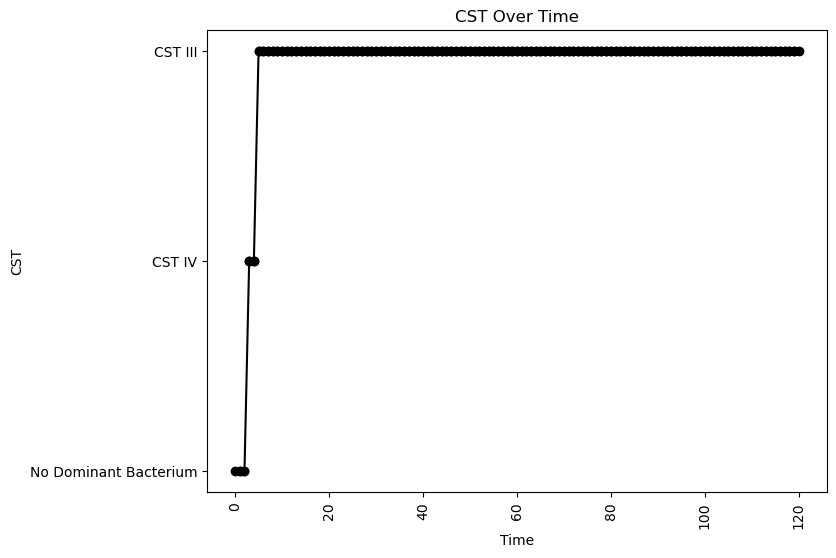


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.06495430992206574
oLB Growth: 0.1731103059651596
nAB Self: -0.08897992688138809
nAB->Li: 0.03276133815340598
nAB->oLB: -0.3789867680015273
Li->nAB: 0.4540382551551835
Li Self: -0.06029143215178052
Li->oLB: -0.2702172058194481
oLB->nAB: -0.4986304818531764
oLB->Li: -0.20537693291831088
oLB Self: -0.03317160300541329

Simulation 1387 follows a valid CST progression:


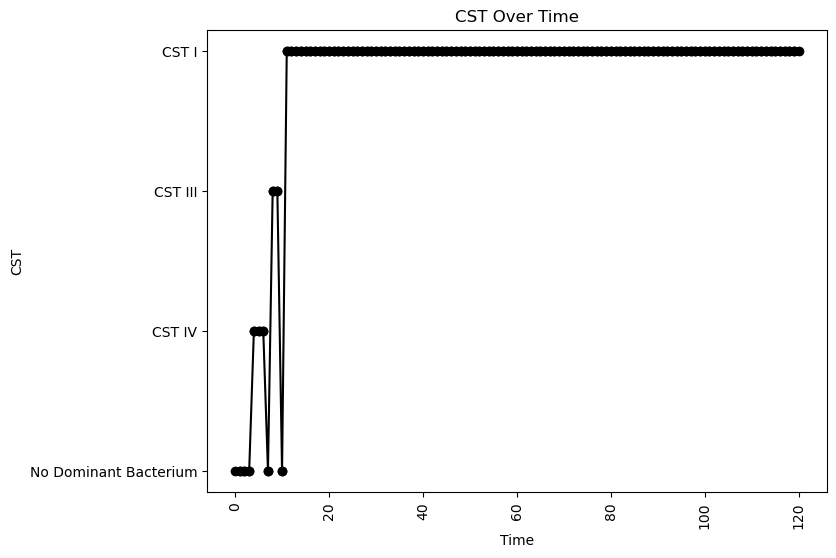


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.06557027835368562
nAB->Li: -0.3287153803030814
nAB->oLB: -0.38063571277280783
Li->nAB: 0.19451548650495598
Li Self: -0.05806808113032069
Li->oLB: -0.28642649919611135
oLB->nAB: -0.34450228608601197
oLB->Li: 0.33986222870453064
oLB Self: -0.01397574062244522

Simulation 1390 follows a valid CST progression:


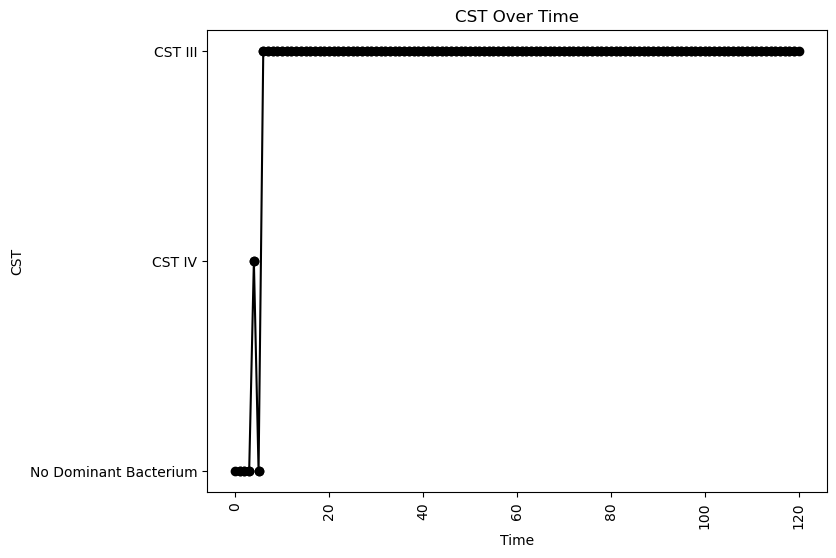


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.015527747718987656
nAB->Li: 0.24516278440390338
nAB->oLB: -0.12123671207713776
Li->nAB: 0.49889732557269684
Li Self: -0.036970042334826064
Li->oLB: -0.014954290511691726
oLB->nAB: -0.04145700276243658
oLB->Li: 0.2524921517519133
oLB Self: -0.05618780906566831

Simulation 1392 follows a valid CST progression:


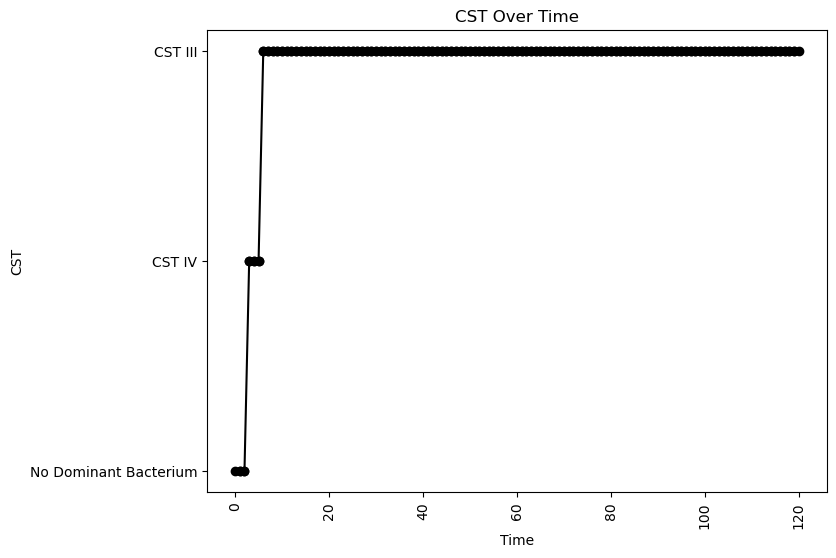


Interaction Parameters:
nAB Growth: 2.2088016144568243
Li Growth: 0.05268768924856952
oLB Growth: 1.1274304047774089
nAB Self: -0.08105357643889702
nAB->Li: -0.17144825430803956
nAB->oLB: -0.011196904601019964
Li->nAB: 0.20601779079915306
Li Self: -0.002941418572016033
Li->oLB: -0.25734460216766786
oLB->nAB: -0.46545227473151507
oLB->Li: -0.01523390213096143
oLB Self: -0.0025049005095240245

Simulation 1401 follows a valid CST progression:


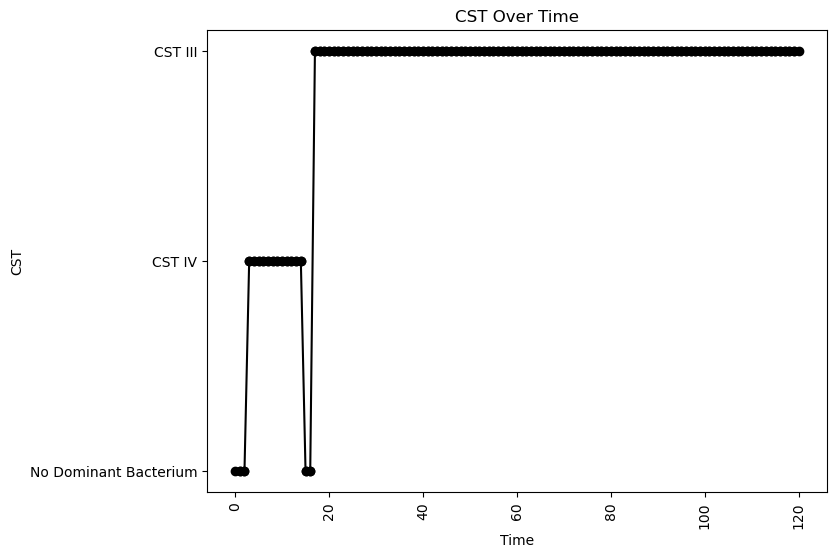


Interaction Parameters:
nAB Growth: 2.226251684223429
Li Growth: 0.0760937960697033
oLB Growth: 0.4505921706771102
nAB Self: -0.01963980162318521
nAB->Li: -0.4818010124606742
nAB->oLB: -0.014256710115173932
Li->nAB: 0.017540394230749157
Li Self: -0.014778444011926545
Li->oLB: -0.47888917717198853
oLB->nAB: -0.30422873159744296
oLB->Li: -0.2845676700851303
oLB Self: -0.08956826704899144

Simulation 1404 follows a valid CST progression:


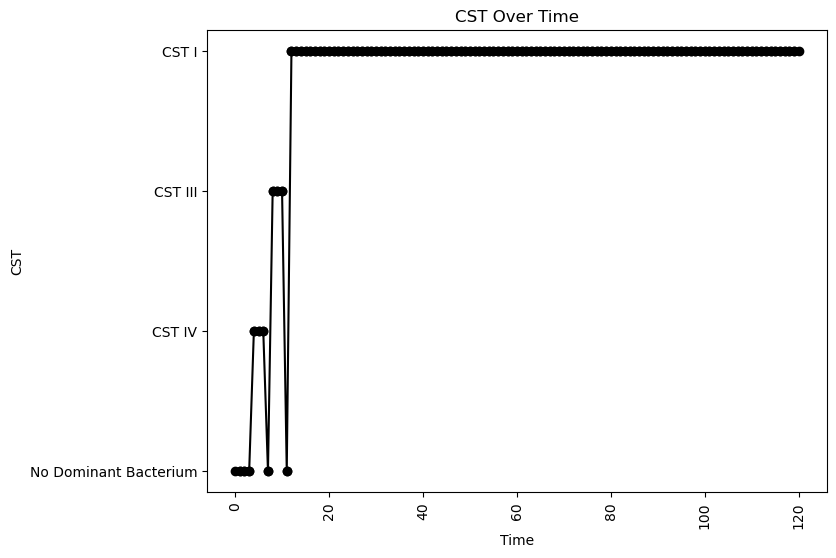


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.11674923860776064
oLB Growth: 0.03504834427483494
nAB Self: -0.020856545737184706
nAB->Li: -0.033747576275069135
nAB->oLB: -0.16414594450858766
Li->nAB: 0.10699240267554688
Li Self: -0.04795523376067773
Li->oLB: 0.07146743221689367
oLB->nAB: -0.3649962431953913
oLB->Li: 0.24499509398239705
oLB Self: -0.06859212164926917

Simulation 1415 follows a valid CST progression:


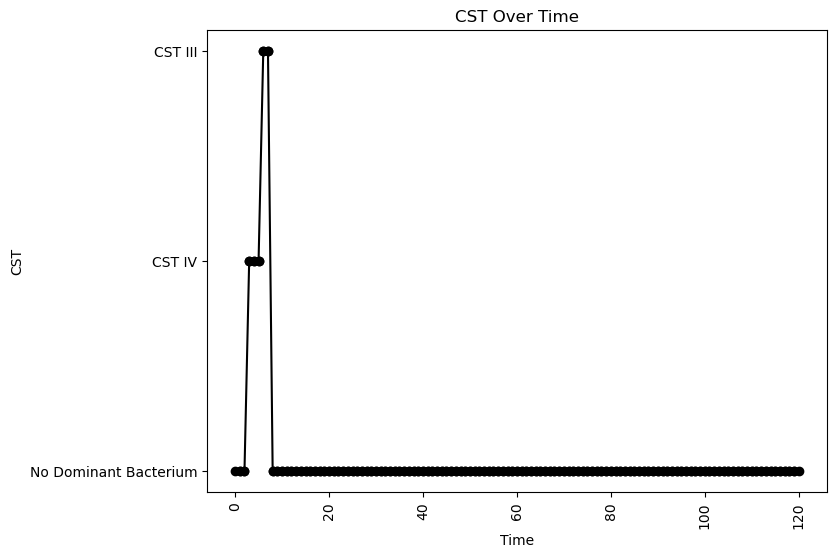


Interaction Parameters:
nAB Growth: 2.300652803872004
Li Growth: 0.06616501714537036
oLB Growth: 0.4369767544558836
nAB Self: -0.021223519962330545
nAB->Li: -0.08604661406806818
nAB->oLB: -0.001795899382455446
Li->nAB: 0.22911104180511432
Li Self: -0.07745223248940893
Li->oLB: 0.2921882383513219
oLB->nAB: -0.2016553505384533
oLB->Li: 0.244657579437211
oLB Self: -0.06931691718795702

Simulation 1416 follows a valid CST progression:


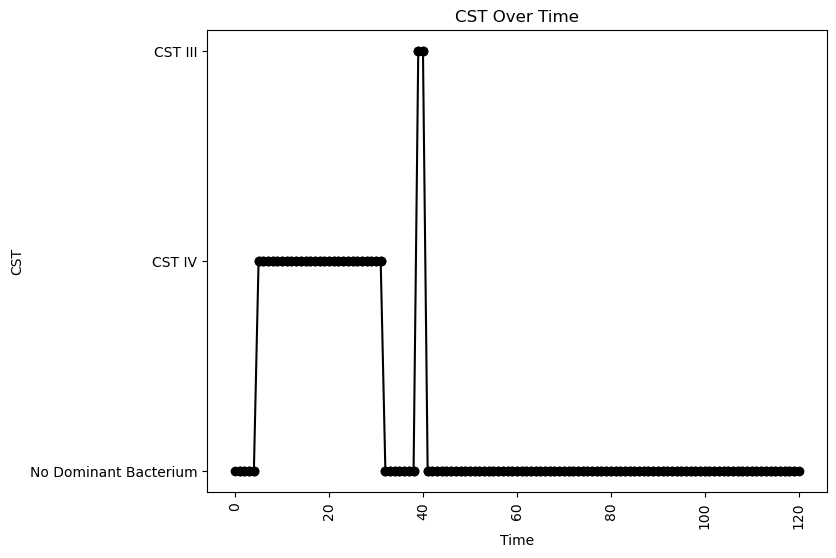


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.20995575415997986
oLB Growth: 0.30646751991446597
nAB Self: -0.09453846921302551
nAB->Li: -0.14397464752618433
nAB->oLB: -0.3627066752060957
Li->nAB: 0.016165733327633824
Li Self: -0.08658386836039435
Li->oLB: 0.23929793868480198
oLB->nAB: -0.1600529619339527
oLB->Li: 0.2172943469942592
oLB Self: -0.06768907114270445

Simulation 1418 follows a valid CST progression:


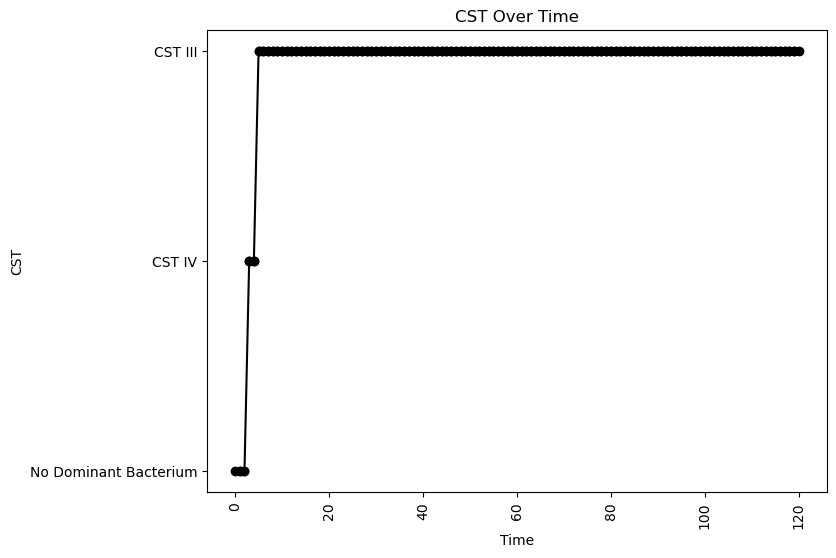


Interaction Parameters:
nAB Growth: 2.2657644953374403
Li Growth: 0.19910945398948152
oLB Growth: 0.2949021384914317
nAB Self: -0.06154398614551948
nAB->Li: -0.15822521002830586
nAB->oLB: -0.1260825092084495
Li->nAB: 0.35636543129119125
Li Self: -0.01920693317087606
Li->oLB: -0.32884112176375757
oLB->nAB: -0.4437457368140631
oLB->Li: -0.4431694540322402
oLB Self: -0.05089448241226652

Simulation 1423 follows a valid CST progression:


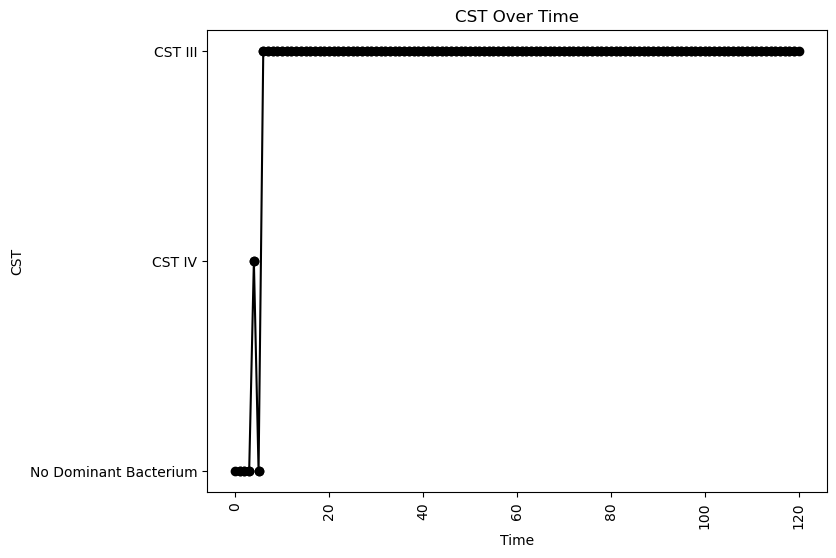


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.08264740347155916
nAB->Li: 0.03307377478041673
nAB->oLB: -0.0659947508271565
Li->nAB: 0.3416553027865856
Li Self: -0.04599698261838077
Li->oLB: 0.054927995653081485
oLB->nAB: -0.11451832204331164
oLB->Li: -0.28086021881655654
oLB Self: -0.04482243586234145

Simulation 1425 follows a valid CST progression:


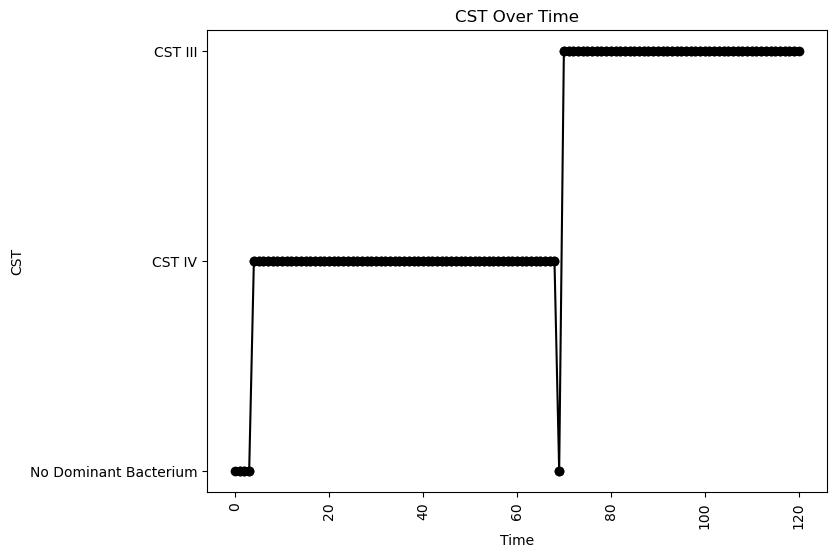


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.050931285768070114
nAB->Li: -0.3375875076841489
nAB->oLB: -0.4299128137887786
Li->nAB: -0.0014298283365185571
Li Self: -0.024694455097945073
Li->oLB: 0.012100402108444097
oLB->nAB: -0.26261184418470723
oLB->Li: 0.265957693925595
oLB Self: -0.0682212644327439

Simulation 1429 follows a valid CST progression:


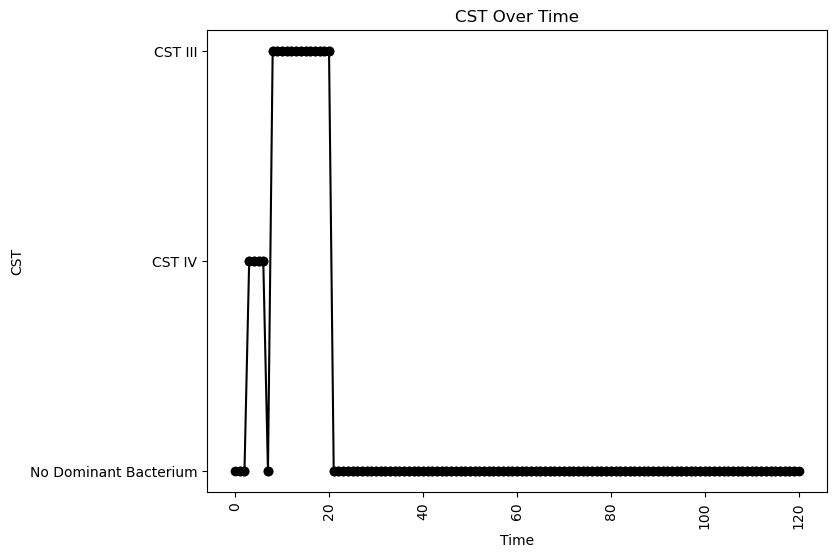


Interaction Parameters:
nAB Growth: 2.1573635369289432
Li Growth: 0.04215849674910016
oLB Growth: 1.2503024394854367
nAB Self: -0.03089964486657848
nAB->Li: -0.16877177285496003
nAB->oLB: -0.3136568780432524
Li->nAB: 0.1969823458288108
Li Self: -0.08129393862007825
Li->oLB: 0.2600982179181779
oLB->nAB: -0.4660238233887308
oLB->Li: 0.24768872061194802
oLB Self: -0.014470202172201088

Simulation 1437 follows a valid CST progression:


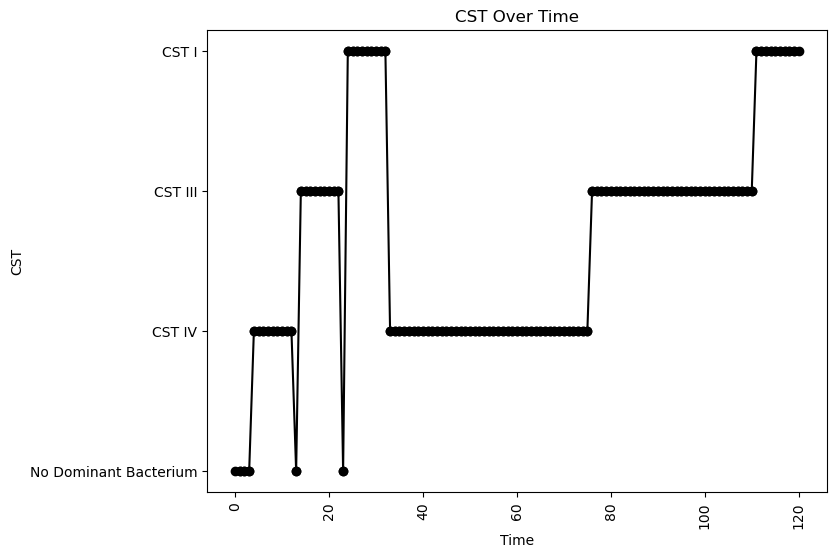


Interaction Parameters:
nAB Growth: 2.2088016144568243
Li Growth: 0.05268768924856952
oLB Growth: 1.1274304047774089
nAB Self: -0.027282827516842245
nAB->Li: -0.3839058293210921
nAB->oLB: -0.0048738407485725
Li->nAB: 0.017415077573946558
Li Self: -0.0029222907642018903
Li->oLB: -0.2683674751545416
oLB->nAB: -0.28111481507409997
oLB->Li: 0.36064179714787326
oLB Self: -0.03593619662194765

Simulation 1448 follows a valid CST progression:


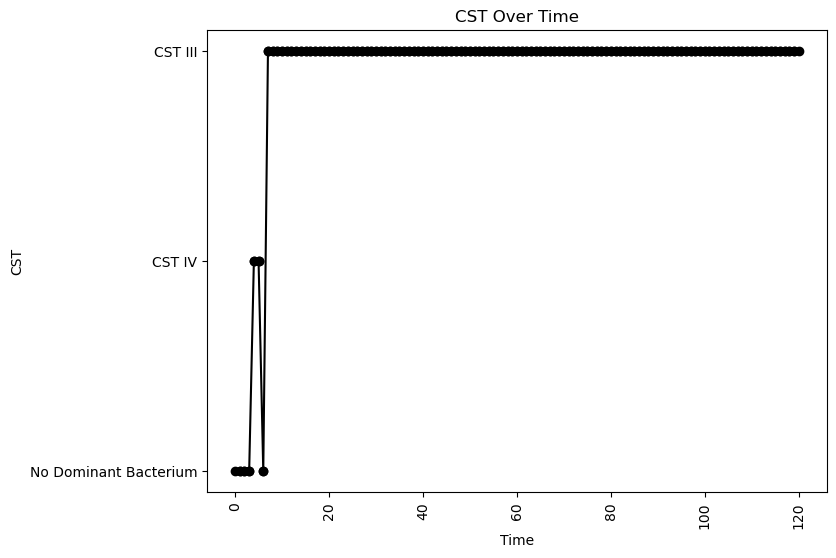


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.06697480659623029
nAB->Li: -0.3358770717384866
nAB->oLB: -0.055230629467510006
Li->nAB: 0.26839962408588347
Li Self: -0.0573041596803715
Li->oLB: -0.08536586759400222
oLB->nAB: -0.15345821941098736
oLB->Li: -0.3090584673153177
oLB Self: -0.08268143379743391

Simulation 1455 follows a valid CST progression:


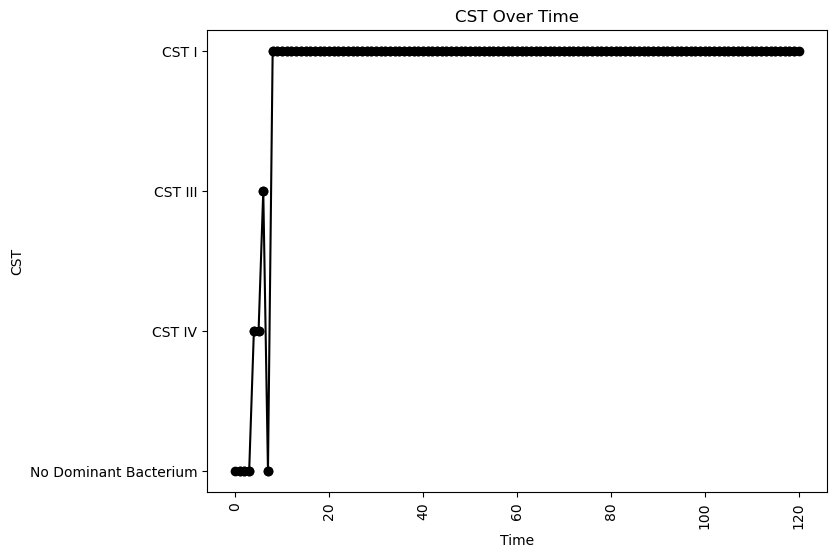


Interaction Parameters:
nAB Growth: 2.172057972480792
Li Growth: 0.05464936187495586
oLB Growth: 1.1816194682992254
nAB Self: -0.03875349630539166
nAB->Li: 0.18424303160472033
nAB->oLB: -0.16915185759229767
Li->nAB: 0.364614519477235
Li Self: -0.043400713540742916
Li->oLB: 0.22516639515700132
oLB->nAB: -0.47240041573612324
oLB->Li: 0.4785188121457784
oLB Self: -0.09507669198825516

Simulation 1457 follows a valid CST progression:


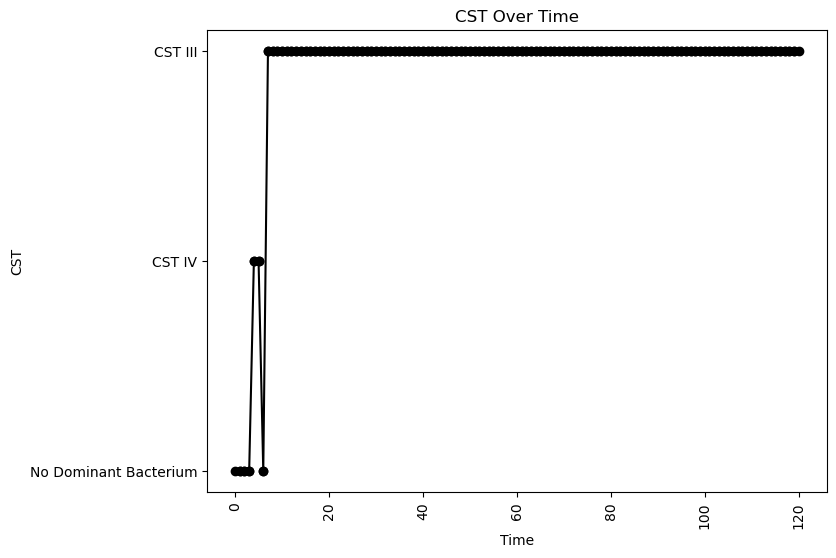


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.32835496577758816
oLB Growth: 0.46591620920123267
nAB Self: -0.03862734808179231
nAB->Li: -0.03231141602418758
nAB->oLB: -0.10747819828952737
Li->nAB: 0.1803626628429852
Li Self: -0.08999171167041074
Li->oLB: -0.42606687606805566
oLB->nAB: -0.4401769303838797
oLB->Li: -0.10436663712569316
oLB Self: -0.03454880453709376

Simulation 1463 follows a valid CST progression:


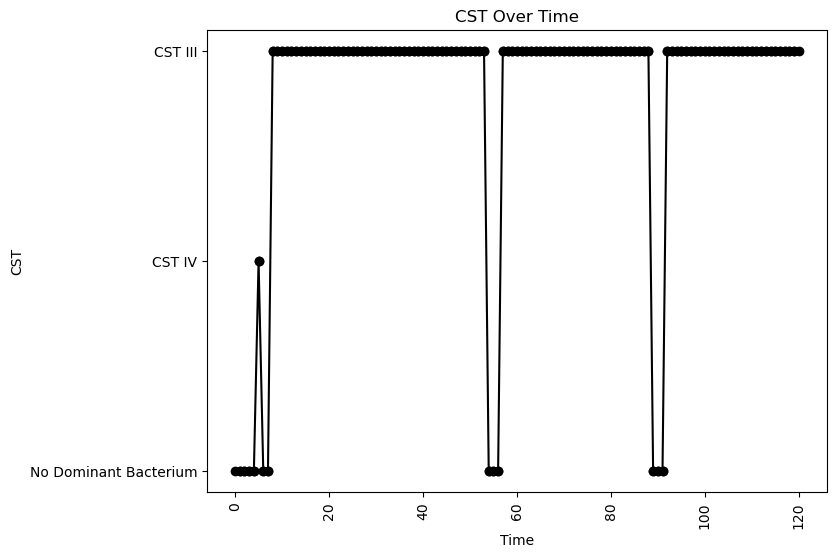


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.052617498644289565
oLB Growth: 0.03504834427483494
nAB Self: -0.08521077692030693
nAB->Li: -0.4630076643276248
nAB->oLB: -0.2212547692620805
Li->nAB: 0.22155522300822672
Li Self: -0.09663598628345615
Li->oLB: 0.04864377030713751
oLB->nAB: -0.19551170986484162
oLB->Li: -0.2710066474367201
oLB Self: -0.05051863452580891

Simulation 1472 follows a valid CST progression:


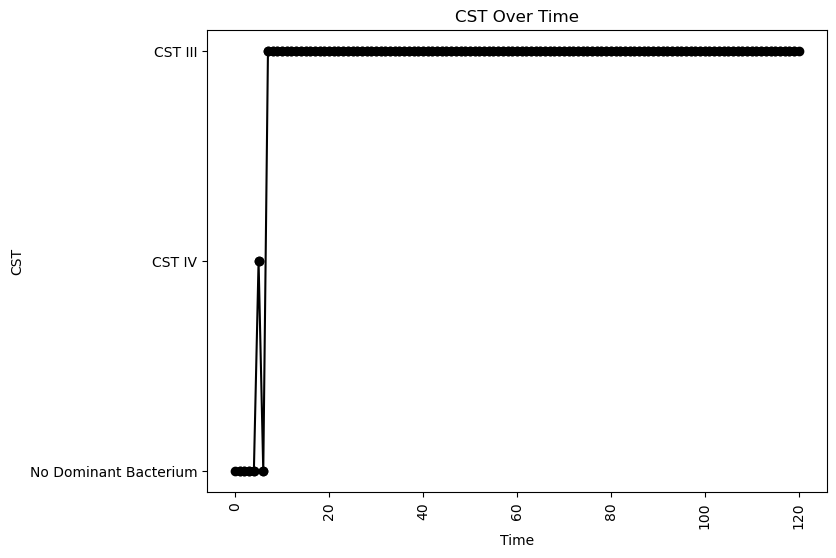


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.025609906522337827
nAB->Li: -0.4144666240588919
nAB->oLB: -0.2734040733799639
Li->nAB: 0.3136361945564039
Li Self: -0.04607770198077173
Li->oLB: 0.08780061647398063
oLB->nAB: -0.28509494515877953
oLB->Li: -0.3993521537388356
oLB Self: -0.09275451963489502

Simulation 1473 follows a valid CST progression:


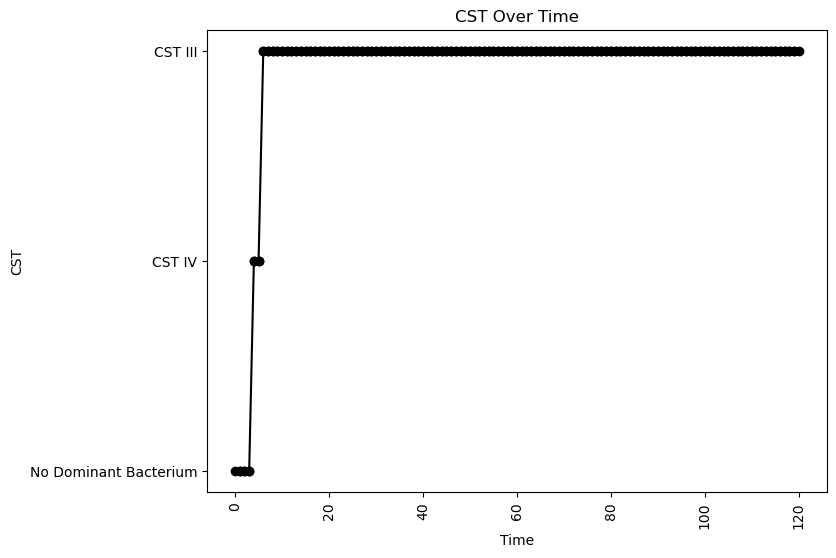


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.04988445575806925
nAB->Li: 0.02712940759515614
nAB->oLB: -0.19882357256457245
Li->nAB: 0.3527435985567904
Li Self: -0.07025356712043285
Li->oLB: -0.08674495825998157
oLB->nAB: -0.36651274038553905
oLB->Li: -0.21745210829943906
oLB Self: -0.0954546672771749

Simulation 1479 follows a valid CST progression:


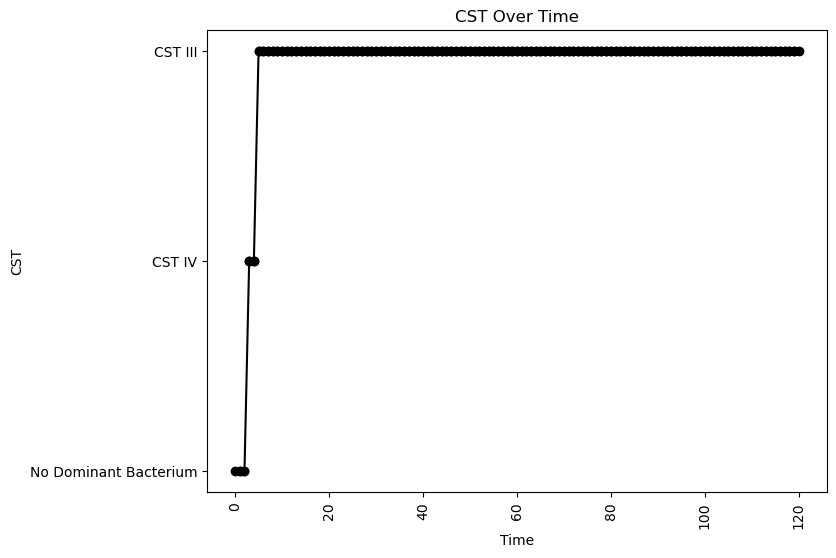


Interaction Parameters:
nAB Growth: 2.2088016144568243
Li Growth: 0.05268768924856952
oLB Growth: 1.1274304047774089
nAB Self: -0.04018691253068424
nAB->Li: 0.28160458540646116
nAB->oLB: -0.0061464504283169075
Li->nAB: 0.4628789182704163
Li Self: -0.013055456545339114
Li->oLB: -0.29001667564336325
oLB->nAB: -0.24128916356292646
oLB->Li: -0.13868549836710592
oLB Self: -0.04651262044141808

Simulation 1493 follows a valid CST progression:


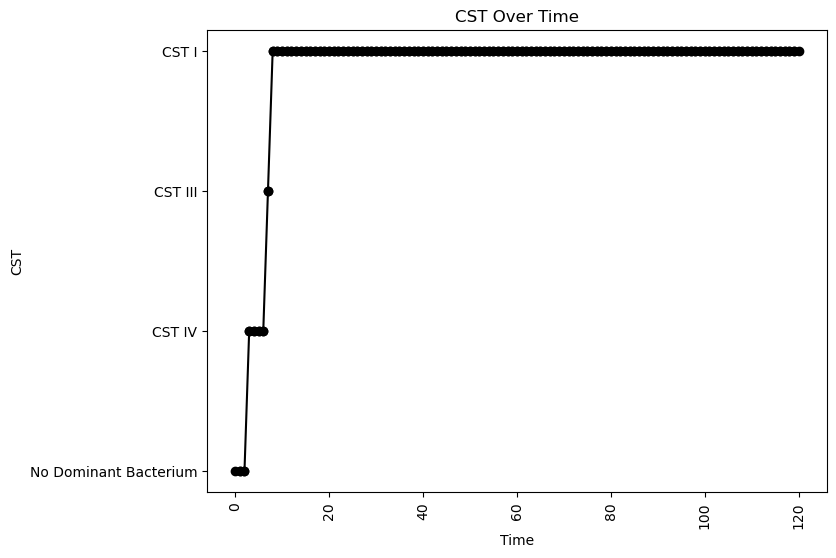


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.06588260315658048
oLB Growth: 0.21113539622386296
nAB Self: -0.0019461529484342543
nAB->Li: -0.06593882234761456
nAB->oLB: -0.19862215644311831
Li->nAB: 0.1264150028153227
Li Self: -0.06136222452267596
Li->oLB: -0.13488895048055172
oLB->nAB: -0.3626070237855531
oLB->Li: 0.4891531518696465
oLB Self: -0.03610483500086391

Simulation 1506 follows a valid CST progression:


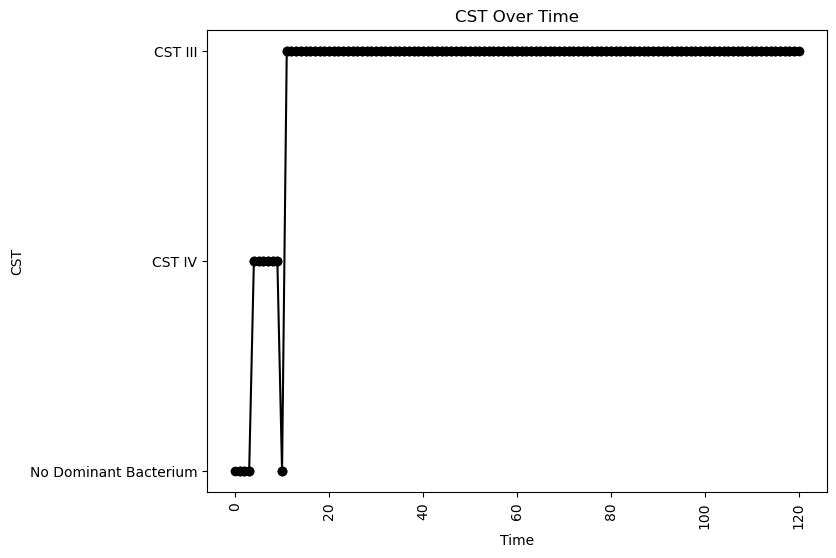


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.07691480795519255
nAB->Li: -0.23547603876236695
nAB->oLB: -0.2930119472293261
Li->nAB: 0.0718093562562413
Li Self: -0.017860374370247484
Li->oLB: 0.36066100459003025
oLB->nAB: -0.13185398957173372
oLB->Li: -0.47603518718665067
oLB Self: -0.007919999639455721

Simulation 1512 follows a valid CST progression:


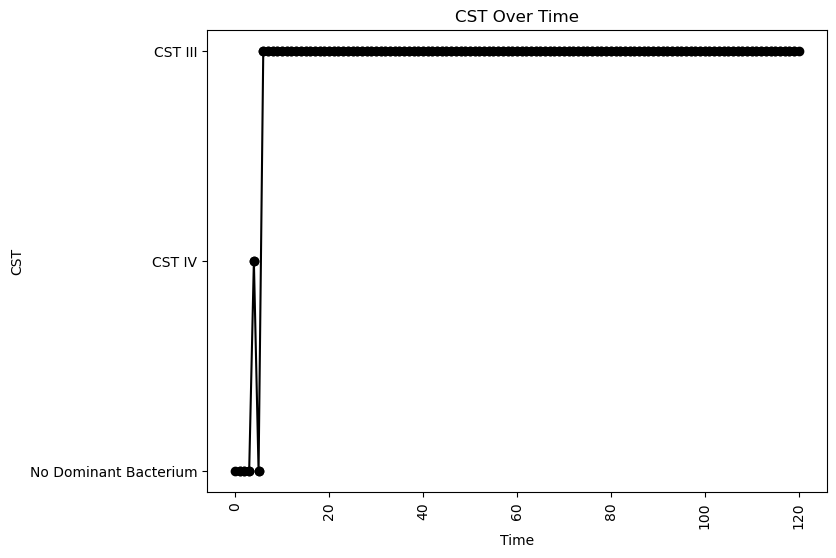


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.059318958189377394
nAB->Li: -0.11859856976653
nAB->oLB: -0.26637753020609684
Li->nAB: 0.4436138509027585
Li Self: -0.027884203793410875
Li->oLB: -0.20601101200244415
oLB->nAB: -0.14337357123906053
oLB->Li: -0.1579461015556638
oLB Self: -0.022168606607834568

Simulation 1515 follows a valid CST progression:


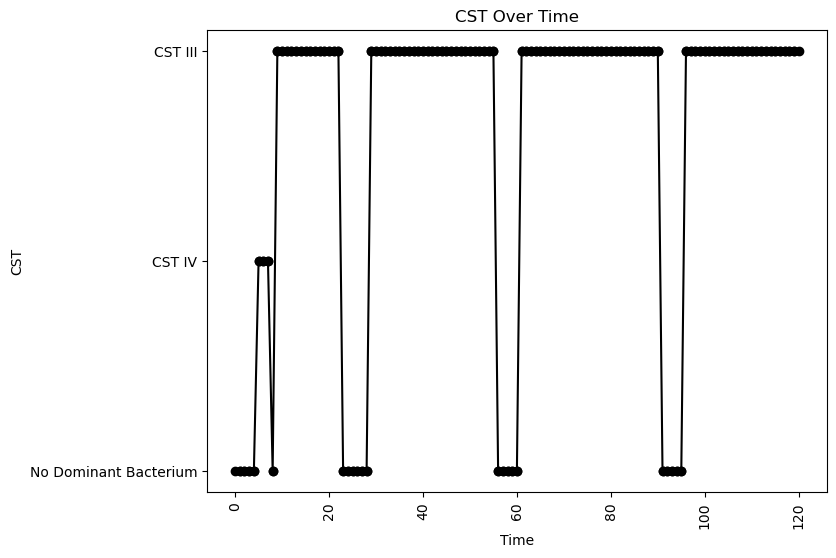


Interaction Parameters:
nAB Growth: 2.2657644953374403
Li Growth: 0.07173881162026666
oLB Growth: 0.2949021384914317
nAB Self: -0.01412044550281856
nAB->Li: -0.495775111351424
nAB->oLB: -0.28013394028861277
Li->nAB: 0.3544055284164268
Li Self: -0.08985291369520684
Li->oLB: 0.1871636559612928
oLB->nAB: -0.16573617899915027
oLB->Li: -0.036887023963205645
oLB Self: -0.032919662297000774

Simulation 1518 follows a valid CST progression:


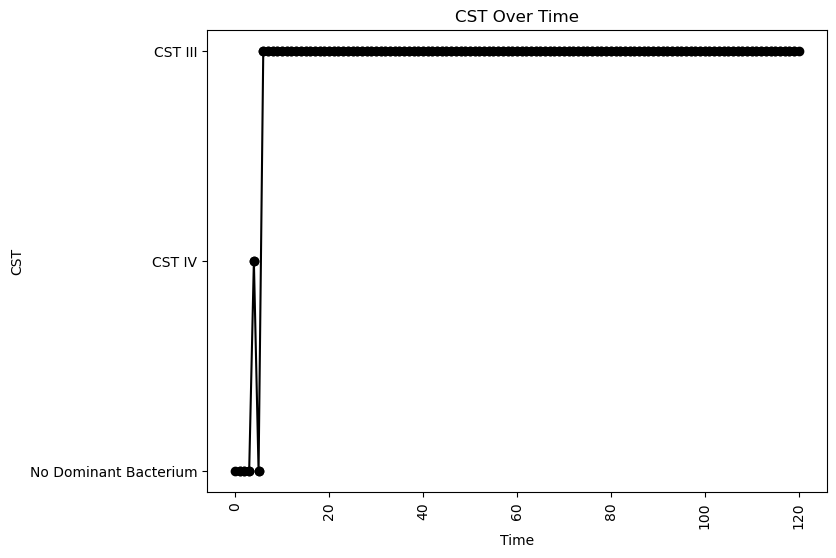


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.3512635332305946
oLB Growth: 0.3756702562538966
nAB Self: -0.06994186643677747
nAB->Li: 0.11752763125565868
nAB->oLB: -0.3566405602843896
Li->nAB: 0.2614979615554427
Li Self: -0.01932894658241885
Li->oLB: -0.14468457542922436
oLB->nAB: -0.2681408652273345
oLB->Li: 0.04330344158728727
oLB Self: -0.0018631512621112983

Simulation 1521 follows a valid CST progression:


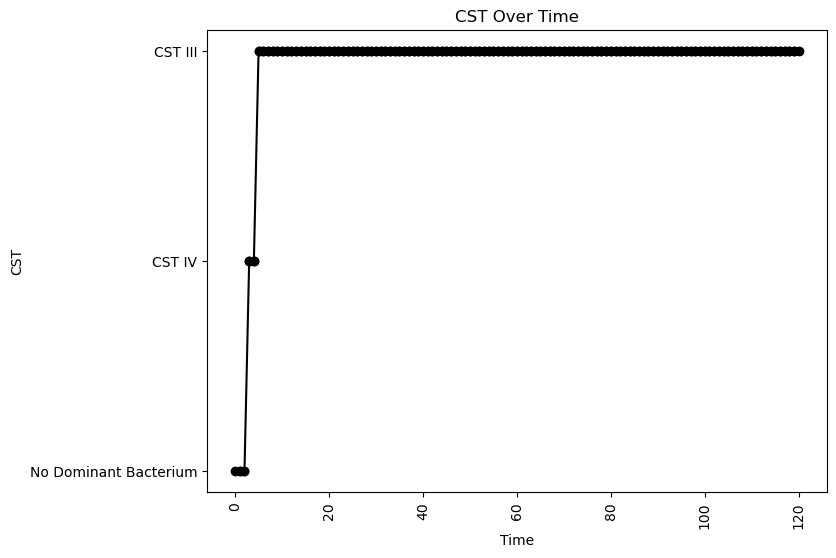


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.022588250136109836
nAB->Li: 0.035948232118923173
nAB->oLB: -0.003930712127519831
Li->nAB: 0.3903106138154063
Li Self: -0.07252936956657619
Li->oLB: 0.023402927453808564
oLB->nAB: -0.269204370773806
oLB->Li: -0.12712615145860046
oLB Self: -0.08877026813575462

Simulation 1523 follows a valid CST progression:


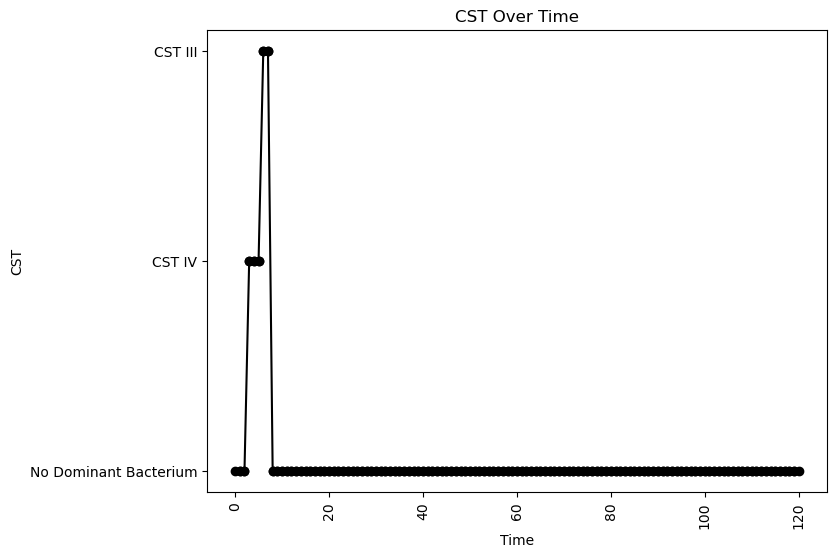


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.06664492138468138
oLB Growth: 0.6588037441195057
nAB Self: -0.010657361700892626
nAB->Li: -0.1204646558603541
nAB->oLB: -0.42559858175769333
Li->nAB: 0.26863659824501185
Li Self: -0.05208788870425338
Li->oLB: 0.48624912447777524
oLB->nAB: -0.4958336305632634
oLB->Li: 0.3636845750535269
oLB Self: -0.04999096551190546

Simulation 1531 follows a valid CST progression:


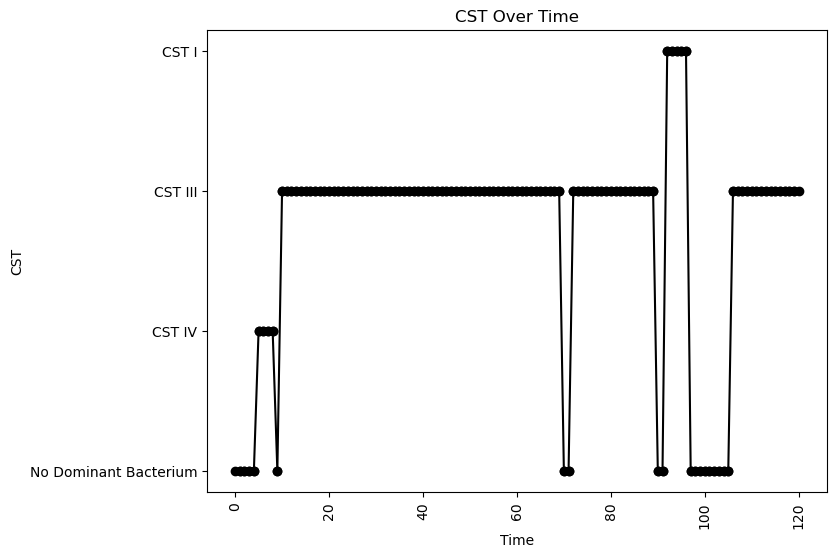


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.2010852583858578
oLB Growth: 0.46591620920123267
nAB Self: -0.050177546538303204
nAB->Li: -0.27334943749019963
nAB->oLB: -0.09569941047557329
Li->nAB: 0.04436349487181168
Li Self: -0.04914505433326381
Li->oLB: 0.032468817945889406
oLB->nAB: -0.3193493252419517
oLB->Li: -0.0183669199244495
oLB Self: -0.048253534548881434

Simulation 1533 follows a valid CST progression:


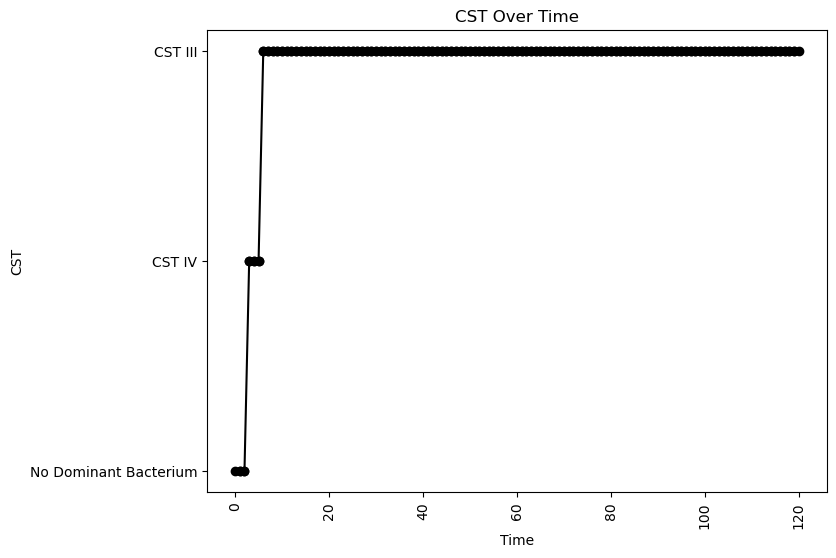


Interaction Parameters:
nAB Growth: 2.2563448832512942
Li Growth: 0.07234741829114298
oLB Growth: 0.40127498600949585
nAB Self: -0.018076927791565306
nAB->Li: -0.013792549452180558
nAB->oLB: -0.06829234667318762
Li->nAB: 0.19389675955047558
Li Self: -0.006556317734489364
Li->oLB: -0.20196541472764545
oLB->nAB: -0.13991077063484347
oLB->Li: -0.08142057556546378
oLB Self: -0.02219152314335461

Simulation 1536 follows a valid CST progression:


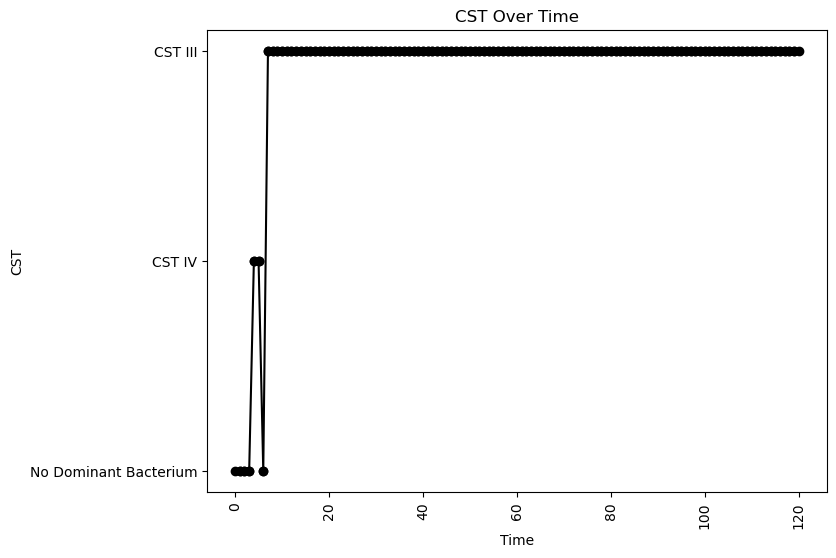


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.029849222148658816
nAB->Li: 0.06260109272661551
nAB->oLB: -0.22686409851657235
Li->nAB: 0.2511437214284269
Li Self: -0.06082002108934656
Li->oLB: 0.4379119597724126
oLB->nAB: -0.33455582219342234
oLB->Li: -0.2806064881236149
oLB Self: -0.039811104801645986

Simulation 1543 follows a valid CST progression:


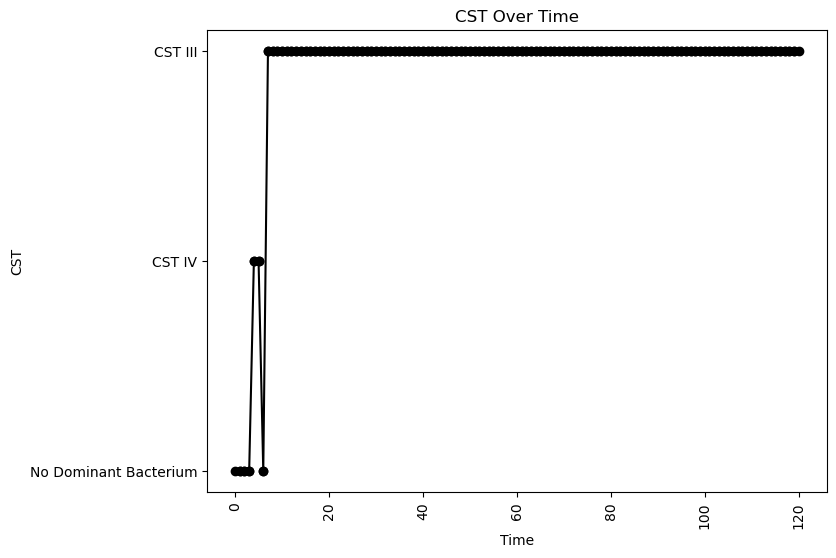


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.06967846000948563
oLB Growth: 0.7070472171500886
nAB Self: -0.033519847981354
nAB->Li: -0.08856655108289835
nAB->oLB: -0.3712730773503201
Li->nAB: 0.3062555328366766
Li Self: -0.053879485015507295
Li->oLB: 0.14772482546584498
oLB->nAB: -0.14316414510903436
oLB->Li: -0.17289161945018267
oLB Self: -0.09308068564887523

Simulation 1550 follows a valid CST progression:


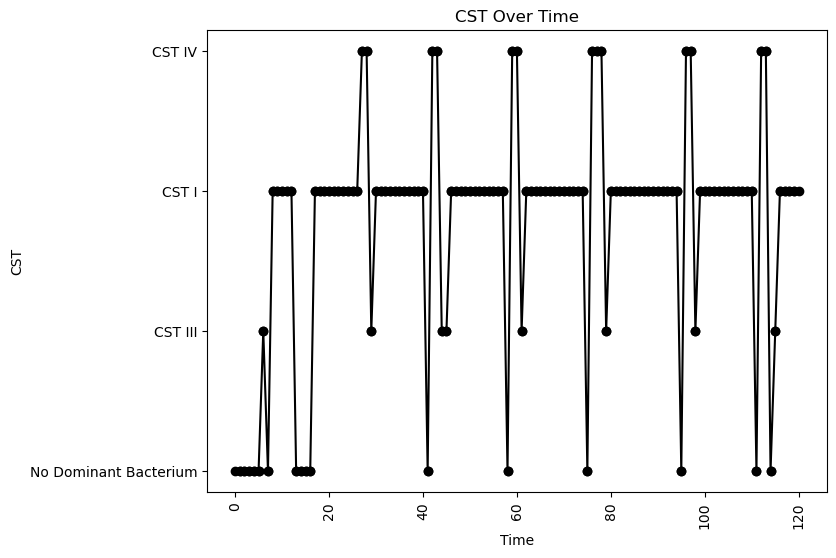


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.33011302525239994
oLB Growth: 1.0858755226067296
nAB Self: -0.061607401102090564
nAB->Li: -0.19251573918047787
nAB->oLB: -0.09159604247895642
Li->nAB: 0.40407210887234546
Li Self: -0.02260623615664531
Li->oLB: -0.11343095756785337
oLB->nAB: -0.4506777271909713
oLB->Li: 0.34847385968673283
oLB Self: -0.0822659458124709

Simulation 1553 follows a valid CST progression:


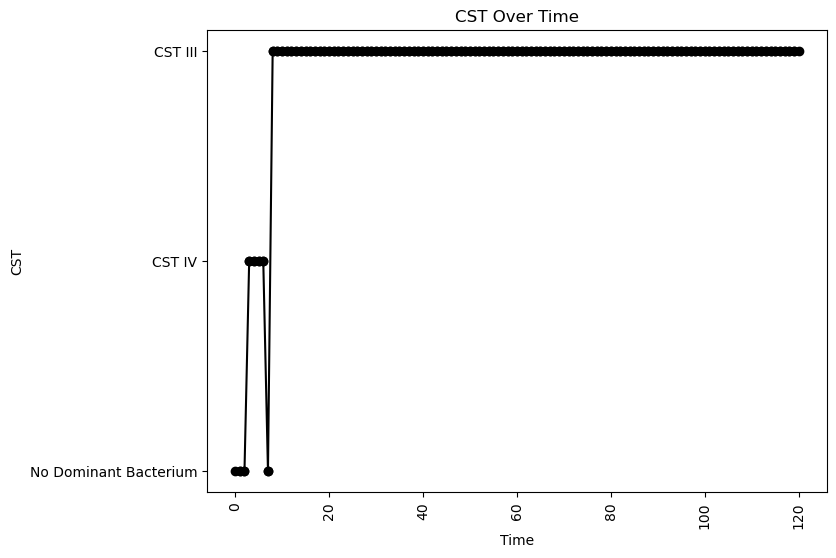


Interaction Parameters:
nAB Growth: 2.2088016144568243
Li Growth: 0.05268768924856952
oLB Growth: 1.1274304047774089
nAB Self: -0.027837878074246564
nAB->Li: -0.05896524890462013
nAB->oLB: -0.4742467759781948
Li->nAB: 0.1499116211554138
Li Self: -0.0691283642624457
Li->oLB: -0.14191102496018826
oLB->nAB: -0.26985262072035476
oLB->Li: 0.08001807112370629
oLB Self: -0.06772953943944149

Simulation 1571 follows a valid CST progression:


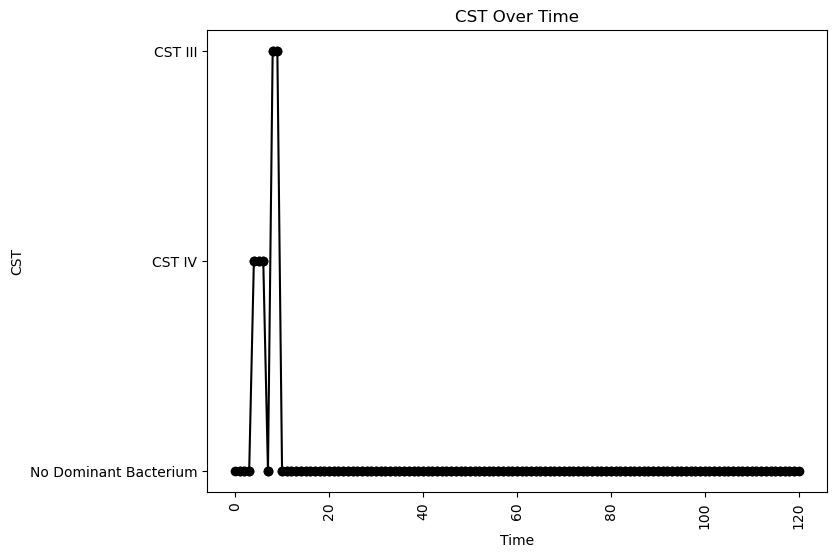


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.09821250088291186
nAB->Li: 0.03449018203051046
nAB->oLB: -0.14335835914784323
Li->nAB: 0.0951092764375071
Li Self: -0.02390320003247974
Li->oLB: 0.17163134783576695
oLB->nAB: -0.4134217163090615
oLB->Li: 0.24740144957122434
oLB Self: -0.046416079095464004

Simulation 1577 follows a valid CST progression:


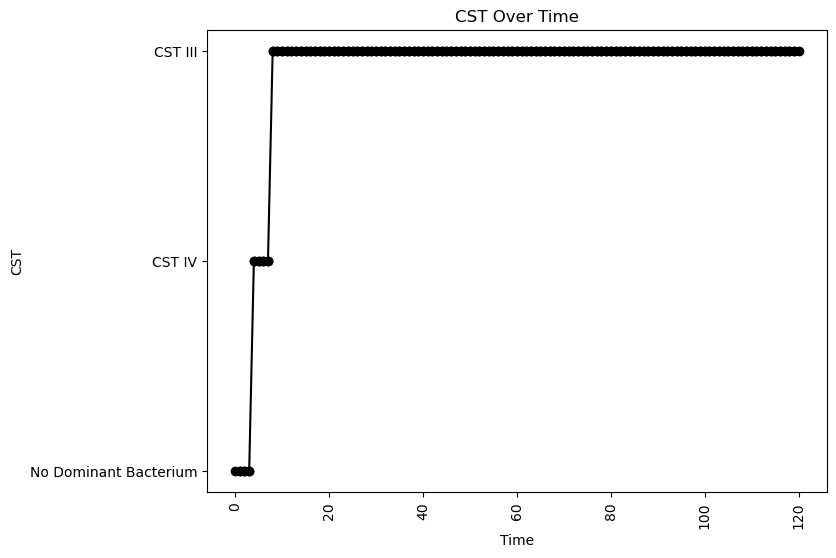


Interaction Parameters:
nAB Growth: 2.2489702826927647
Li Growth: 0.07143879299629578
oLB Growth: 0.24213610993368434
nAB Self: -0.007169022736477432
nAB->Li: 0.08707288156295523
nAB->oLB: -0.22405892779127212
Li->nAB: 0.37358647479868445
Li Self: -0.07266224254180528
Li->oLB: -0.3570877033100053
oLB->nAB: -0.40390903787395616
oLB->Li: -0.47622049612409084
oLB Self: -0.07150299921640645

Simulation 1578 follows a valid CST progression:


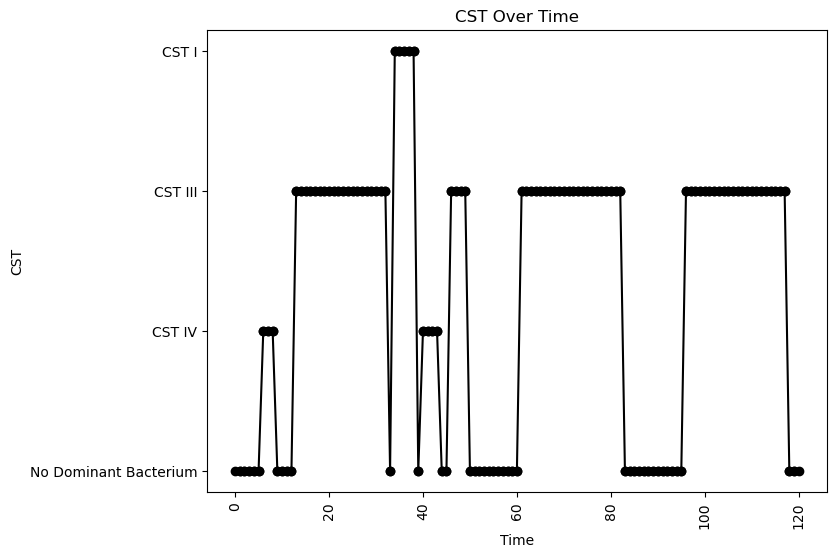


Interaction Parameters:
nAB Growth: 2.2088016144568243
Li Growth: 0.29459234658024386
oLB Growth: 1.1274304047774089
nAB Self: -0.036402424855575474
nAB->Li: -0.20888117743342266
nAB->oLB: -0.05669416687301976
Li->nAB: 0.04789131522665835
Li Self: -0.07824240916049109
Li->oLB: -0.09199903132447879
oLB->nAB: -0.4831155571496133
oLB->Li: 0.1535135786637415
oLB Self: -0.09209932614332902

Simulation 1580 follows a valid CST progression:


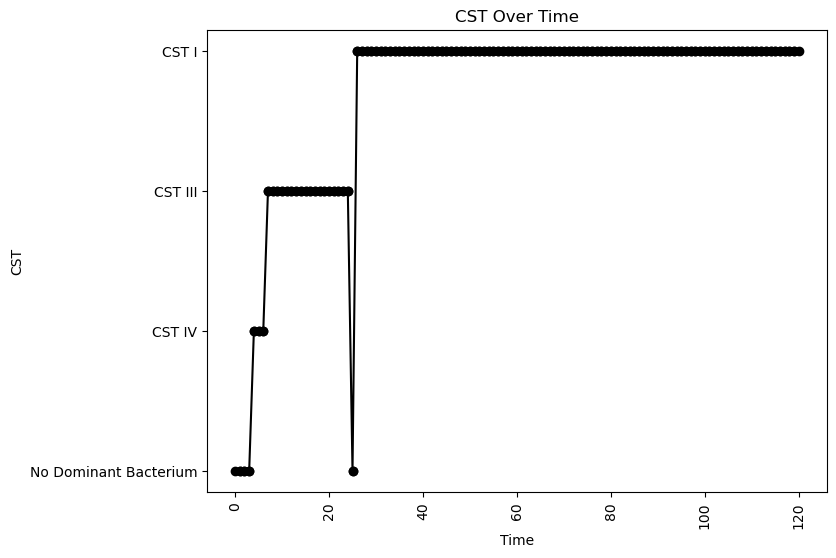


Interaction Parameters:
nAB Growth: 2.292952252819776
Li Growth: 0.06862578763464611
oLB Growth: 0.25066683866219575
nAB Self: -0.0012610207246030736
nAB->Li: -0.49037674640158113
nAB->oLB: -0.4225620104171134
Li->nAB: 0.2452472194129547
Li Self: -0.0347818570691332
Li->oLB: -0.3854089349437546
oLB->nAB: -0.26983711093041785
oLB->Li: 0.02723960849945728
oLB Self: -0.07410464378225687

Simulation 1600 follows a valid CST progression:


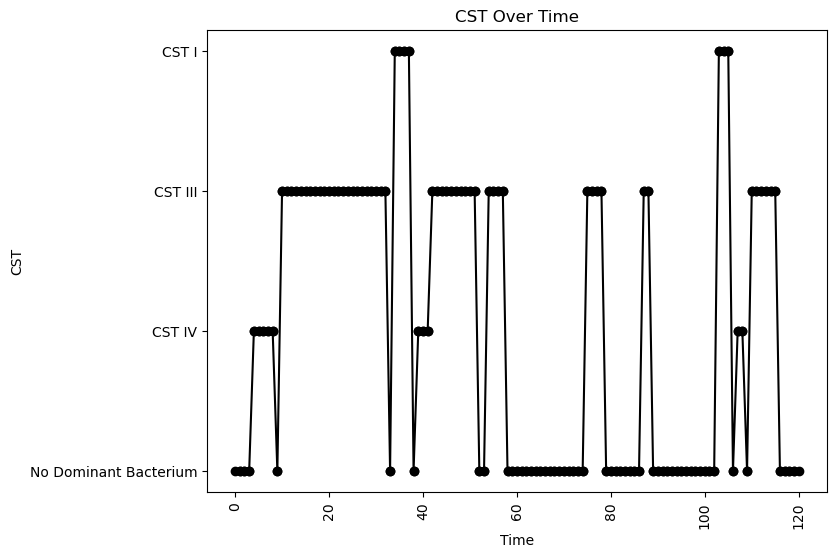


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.08075533553225388
nAB->Li: -0.2773532087684615
nAB->oLB: -0.08337263752117802
Li->nAB: 0.1396746380339482
Li Self: -0.08328198086608982
Li->oLB: -0.12988239961850917
oLB->nAB: -0.29128941507888584
oLB->Li: 0.14030544539059142
oLB Self: -0.06964441289097786

Simulation 1607 follows a valid CST progression:


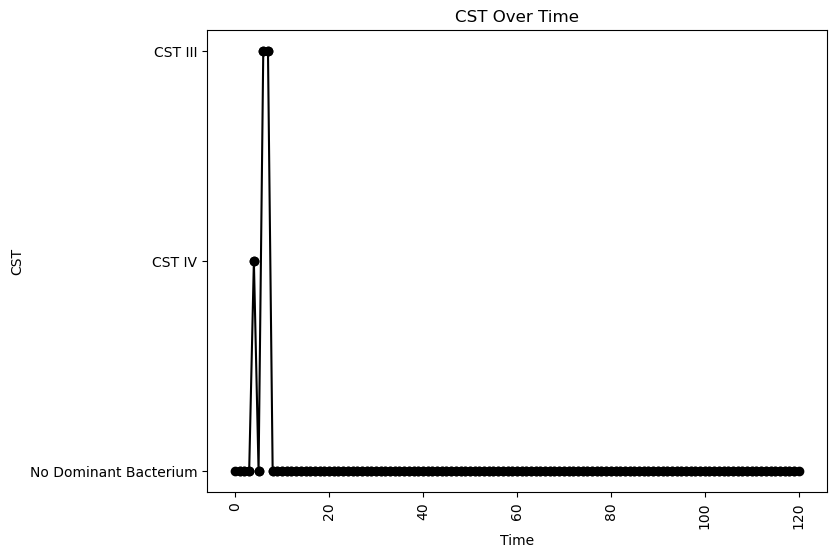


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.0890116019678183
nAB->Li: -0.3342675952519558
nAB->oLB: -0.3635562664301945
Li->nAB: 0.32859247215781184
Li Self: -0.021301060027329496
Li->oLB: 0.25170942110848404
oLB->nAB: -0.4932591909130809
oLB->Li: 0.4575750168930143
oLB Self: -0.09458491574083305

Simulation 1621 follows a valid CST progression:


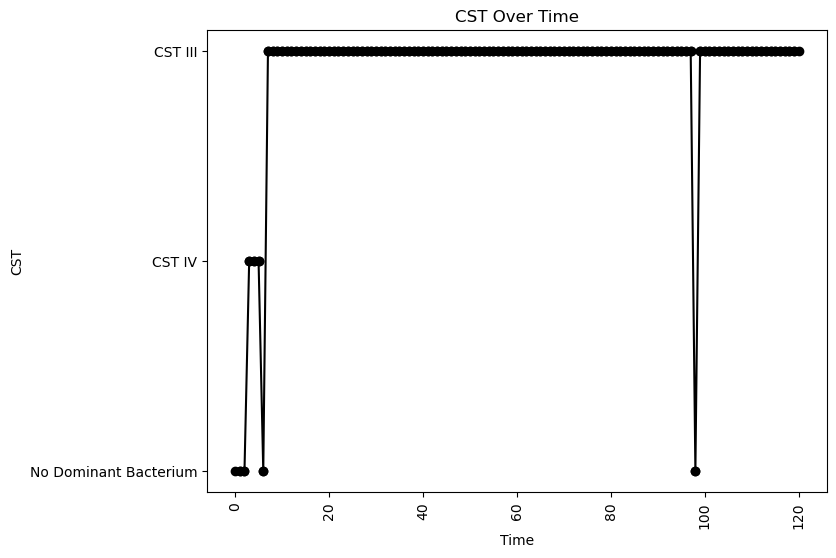


Interaction Parameters:
nAB Growth: 2.292952252819776
Li Growth: 0.06862578763464611
oLB Growth: 0.25066683866219575
nAB Self: -0.09456564335351693
nAB->Li: -0.34455123820779043
nAB->oLB: -0.058618964399621276
Li->nAB: 0.17982924675444567
Li Self: -0.05129048720129721
Li->oLB: 0.323021026324797
oLB->nAB: -0.4128491037982262
oLB->Li: -0.27630147993121745
oLB Self: -0.021613467853711293

Simulation 1624 follows a valid CST progression:


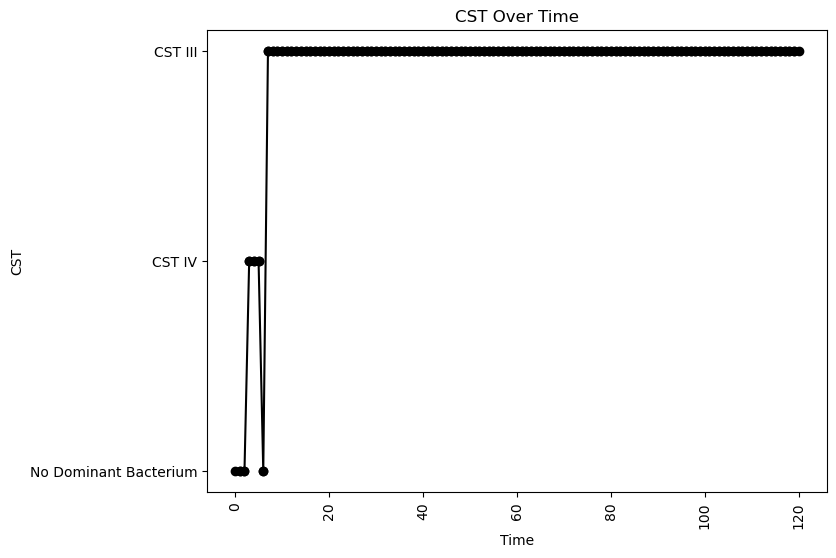


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.03312138476985278
nAB->Li: -0.05799263546127603
nAB->oLB: -0.11519041998747387
Li->nAB: 0.15059431937948675
Li Self: -0.05969088300602136
Li->oLB: 0.031904426120864304
oLB->nAB: -0.29686898842938725
oLB->Li: -0.10796941835437318
oLB Self: -0.028271833348761127

Simulation 1625 follows a valid CST progression:


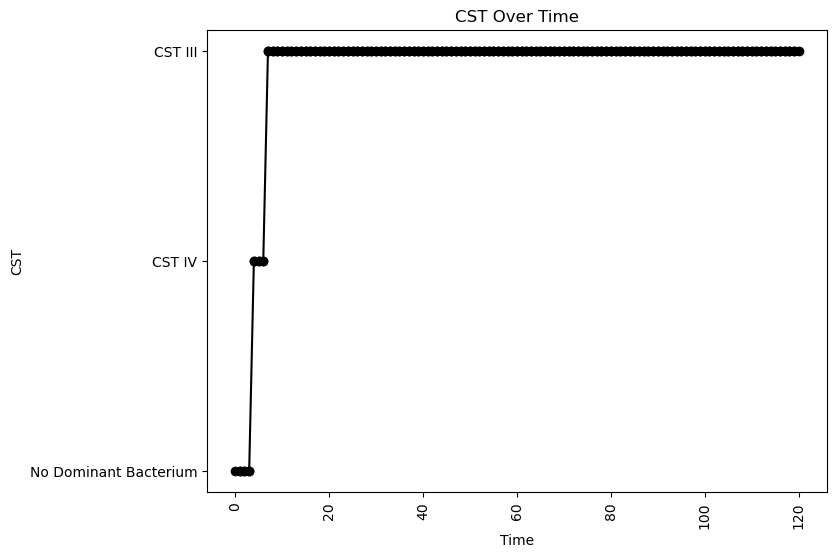


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.14368632486241736
oLB Growth: 0.03504834427483494
nAB Self: -0.08147656560087964
nAB->Li: 0.1231466279318818
nAB->oLB: -0.007874110723489425
Li->nAB: 0.26453200201399985
Li Self: -0.0965635846606044
Li->oLB: -0.47352773785076996
oLB->nAB: -0.0689084721987328
oLB->Li: 0.04797094761816412
oLB Self: -0.0042239771552423505

Simulation 1630 follows a valid CST progression:


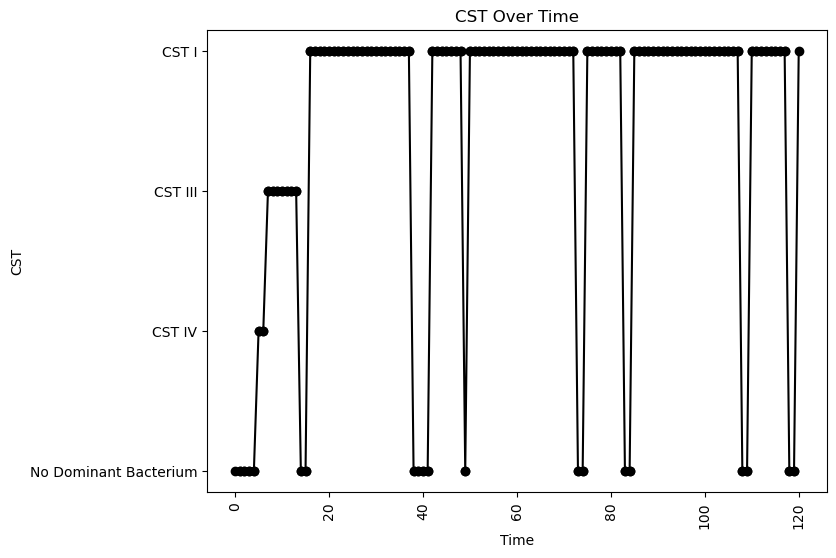


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.03837725110012093
oLB Growth: 1.155917868199191
nAB Self: -0.07057385339043637
nAB->Li: -0.41933392360555183
nAB->oLB: -0.017540164695184657
Li->nAB: 0.38968187970681634
Li Self: -0.07355065498137743
Li->oLB: -0.04756270972667531
oLB->nAB: -0.17752696212103763
oLB->Li: 0.10023782444702112
oLB Self: -0.024757350705600978

Simulation 1631 follows a valid CST progression:


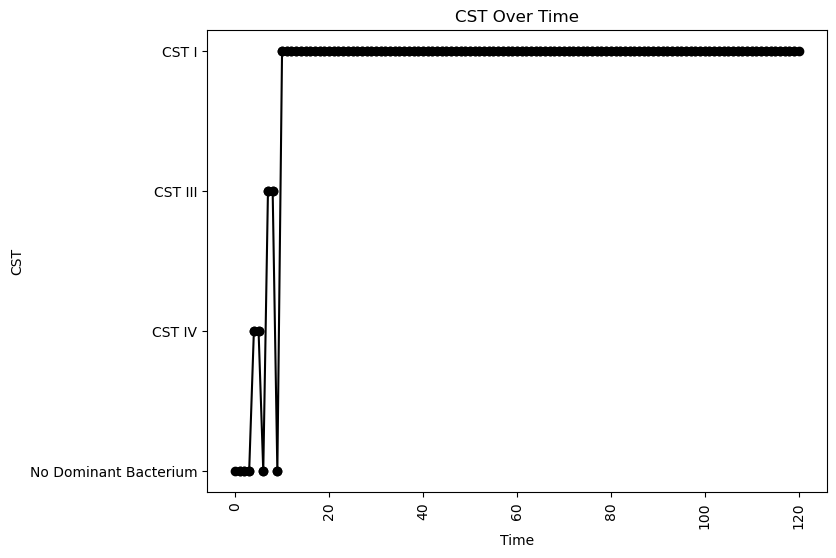


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.14515671562080384
oLB Growth: 0.595997418302585
nAB Self: -0.013570063119939704
nAB->Li: -0.3905901624644274
nAB->oLB: -0.05119331983347686
Li->nAB: 0.1485598622822376
Li Self: -0.09293170322703612
Li->oLB: 0.25103551443761607
oLB->nAB: -0.26532560151684936
oLB->Li: 0.36448690515761795
oLB Self: -0.038810584806422375

Simulation 1632 follows a valid CST progression:


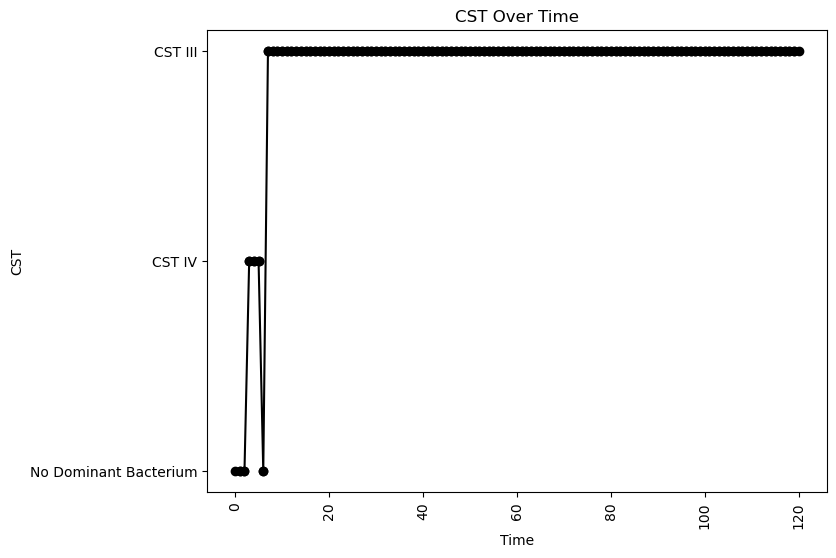


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.05036723666209505
nAB->Li: -0.12468676663312428
nAB->oLB: -0.3259226574144587
Li->nAB: 0.2192574723602424
Li Self: -0.07340636069783962
Li->oLB: 0.2595211674386443
oLB->nAB: -0.025980607424099633
oLB->Li: -0.31515258909958943
oLB Self: -0.04861048425074347

Simulation 1640 follows a valid CST progression:


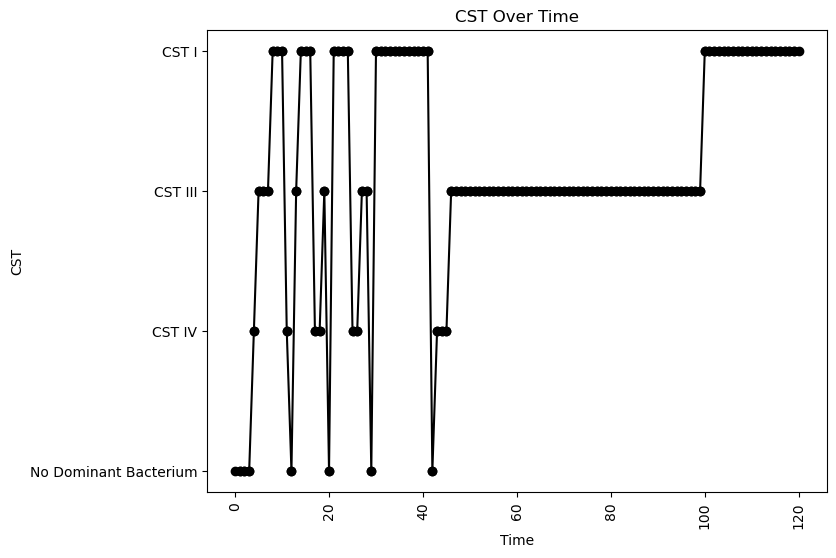


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.0021956264886220656
nAB->Li: -0.3060008853251334
nAB->oLB: -0.02253645592141551
Li->nAB: 0.46119401238500934
Li Self: -0.07388498968846295
Li->oLB: -0.2709243744543226
oLB->nAB: -0.3993453210718758
oLB->Li: 0.26704591093123764
oLB Self: -0.013533042859115496

Simulation 1646 follows a valid CST progression:


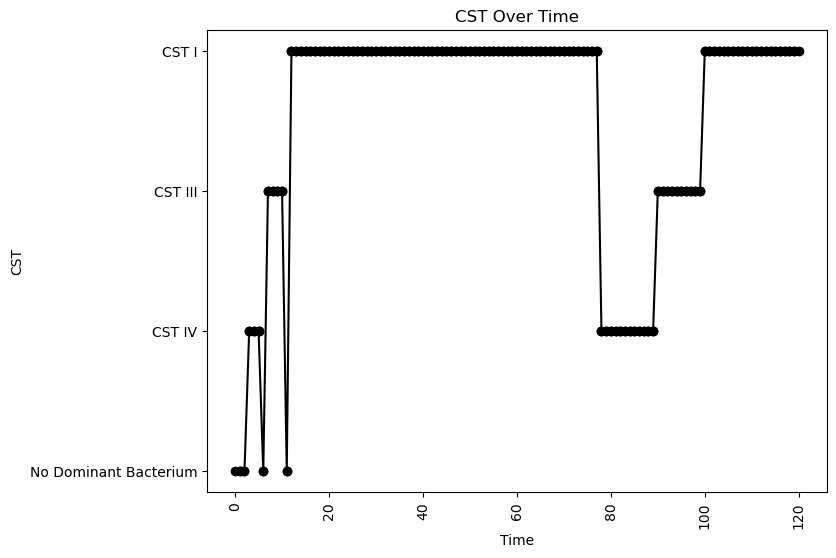


Interaction Parameters:
nAB Growth: 2.0745101401728236
Li Growth: 0.010341045972876578
oLB Growth: 1.1507970527071554
nAB Self: -0.08112701282951423
nAB->Li: -0.3812087647585242
nAB->oLB: -0.09942239431231381
Li->nAB: 0.3292374126788573
Li Self: -0.029017946683943557
Li->oLB: -0.09217302858182502
oLB->nAB: -0.23331120813816641
oLB->Li: 0.23675481155156852
oLB Self: -0.05960848428523477

Simulation 1648 follows a valid CST progression:


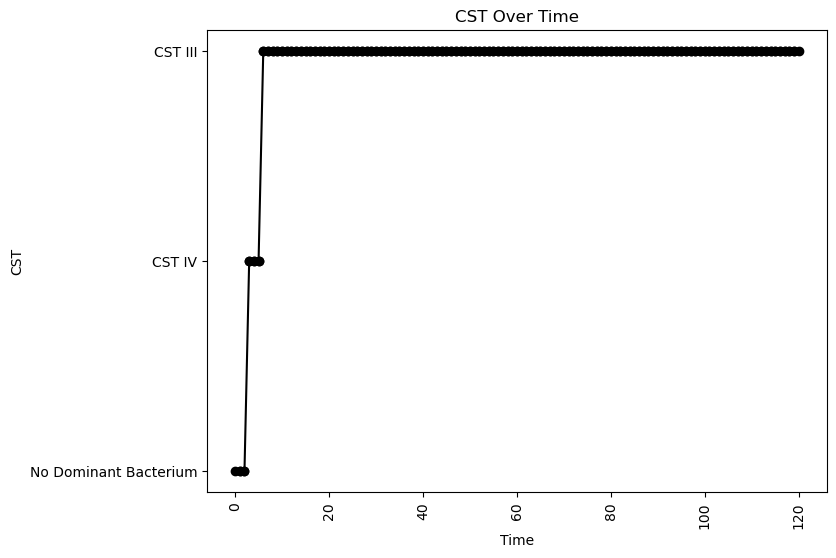


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.06821292168472717
nAB->Li: -0.11043941533952445
nAB->oLB: -0.16445260934330796
Li->nAB: 0.31526795838481814
Li Self: -0.05787667731631575
Li->oLB: 0.13528412788427735
oLB->nAB: -0.4340874821329638
oLB->Li: -0.3264767071681381
oLB Self: -0.05393113555154218

Simulation 1658 follows a valid CST progression:


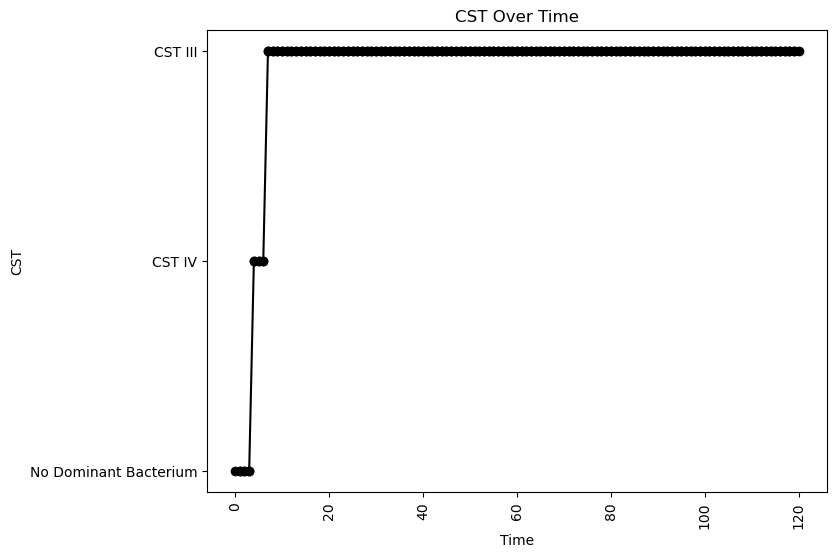


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.04632105509676055
nAB->Li: -0.4005199850659918
nAB->oLB: -0.30491624109410487
Li->nAB: 0.38339470224693906
Li Self: -0.047784019985768394
Li->oLB: 0.49313996263719384
oLB->nAB: -0.44457514354725497
oLB->Li: -0.17769557719307405
oLB Self: -0.011872314589632046

Simulation 1661 follows a valid CST progression:


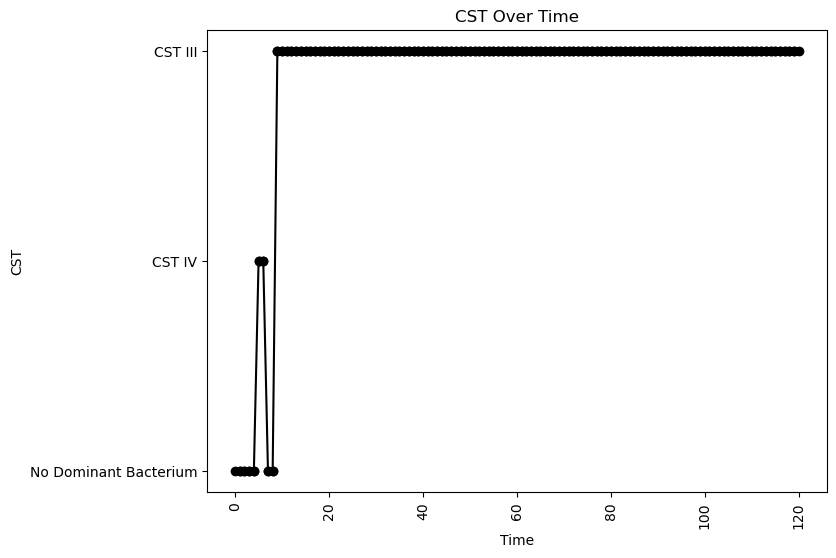


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.2863620498548374
oLB Growth: 1.0858755226067296
nAB Self: -0.09276029935352742
nAB->Li: -0.32638101190838387
nAB->oLB: -0.28921297785714317
Li->nAB: 0.05386937753298515
Li Self: -0.016304017318362368
Li->oLB: -0.2513135319232999
oLB->nAB: -0.2419158422853503
oLB->Li: -0.2059949522541173
oLB Self: -0.041795420465042254

Simulation 1664 follows a valid CST progression:


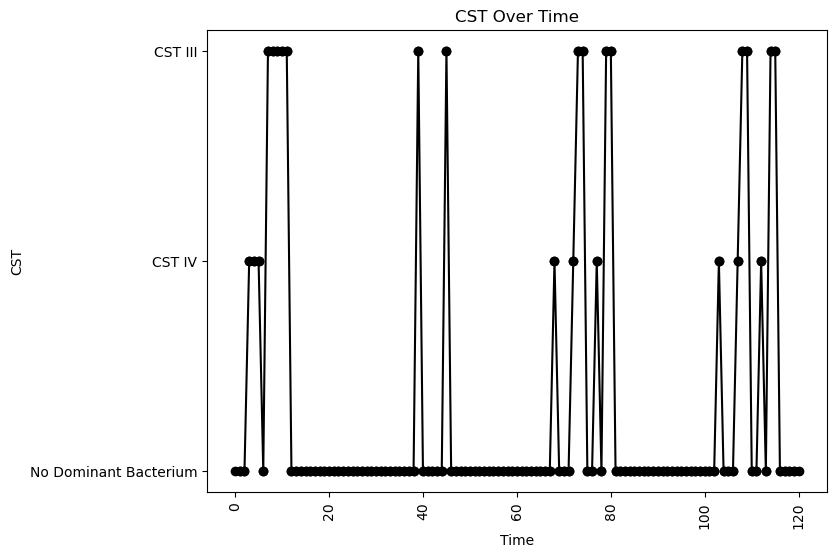


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.013080094154858293
nAB->Li: -0.23912530108443314
nAB->oLB: -0.022808913471103642
Li->nAB: 0.1921280639384232
Li Self: -0.09124815471061717
Li->oLB: -0.43007089115957725
oLB->nAB: -0.22628737833239998
oLB->Li: 0.19288258244892176
oLB Self: -0.0735439403868299

Simulation 1671 follows a valid CST progression:


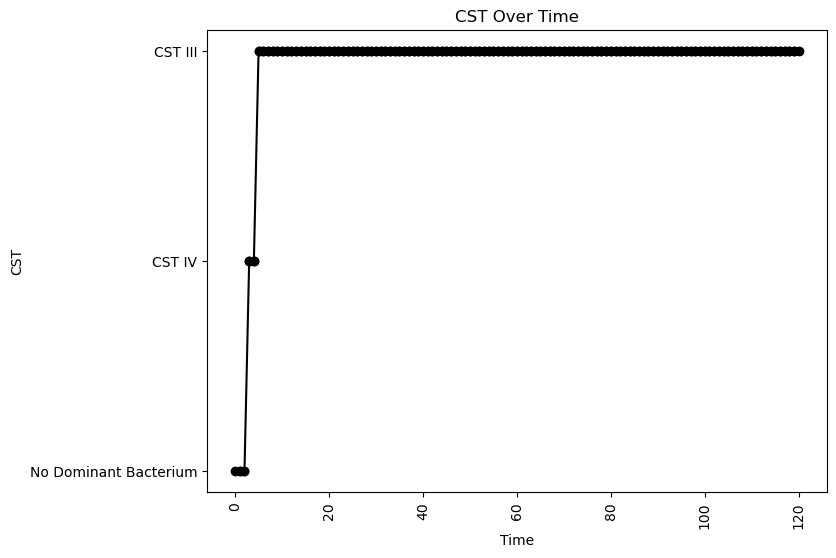


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.07634216444816658
nAB->Li: 0.20512457231369896
nAB->oLB: -0.027524531238302175
Li->nAB: 0.482235213774036
Li Self: -0.0969561986848604
Li->oLB: -0.1907051062088495
oLB->nAB: -0.07409399261730143
oLB->Li: -0.04331342736430116
oLB Self: -0.0703467342330302

Simulation 1673 follows a valid CST progression:


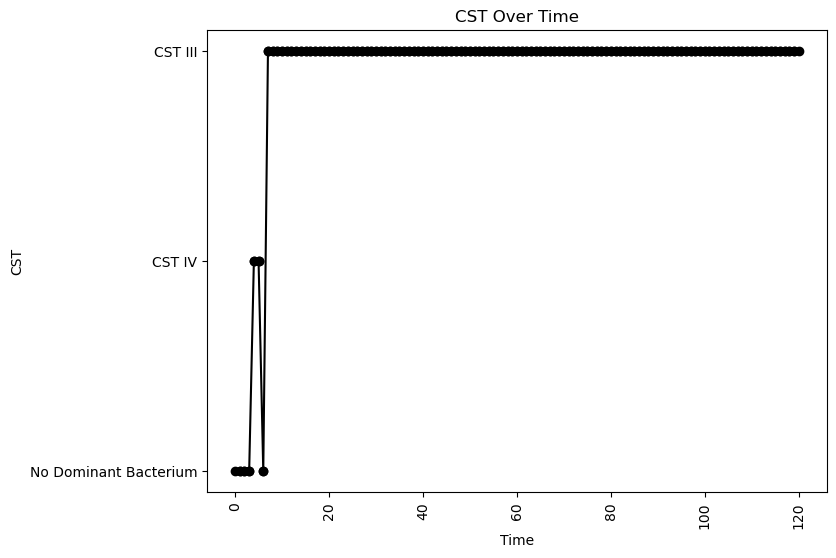


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.07622095254369247
nAB->Li: -0.16170889326846455
nAB->oLB: -0.3620556876911012
Li->nAB: 0.2925943428726432
Li Self: -0.08584891304137086
Li->oLB: -0.35659782498891457
oLB->nAB: -0.21462977448067522
oLB->Li: -0.043989685292047054
oLB Self: -0.02538784116150533

Simulation 1687 follows a valid CST progression:


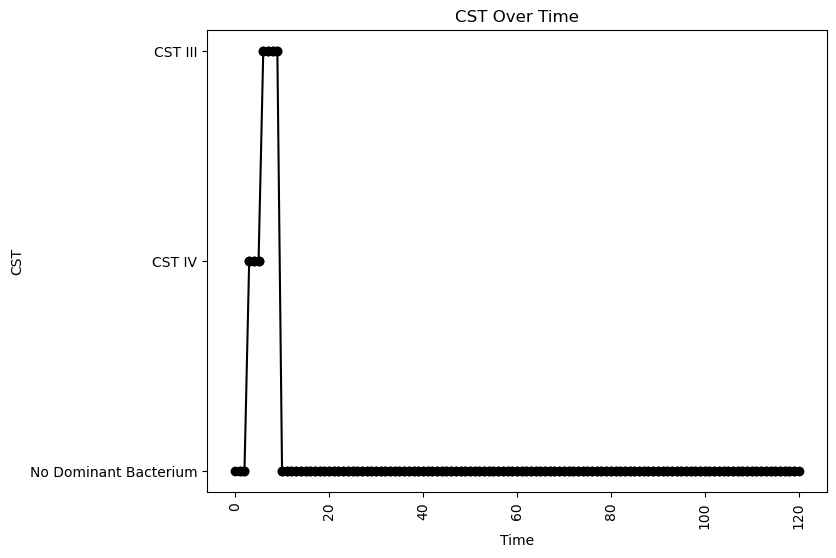


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.02728572754169989
nAB->Li: -0.49754057878216235
nAB->oLB: -0.098004281535366
Li->nAB: 0.30662260736388525
Li Self: -0.019962425485637952
Li->oLB: 0.3441109802233654
oLB->nAB: -0.4940114539706596
oLB->Li: 0.27998863173669264
oLB Self: -0.05764445467208713

Simulation 1688 follows a valid CST progression:


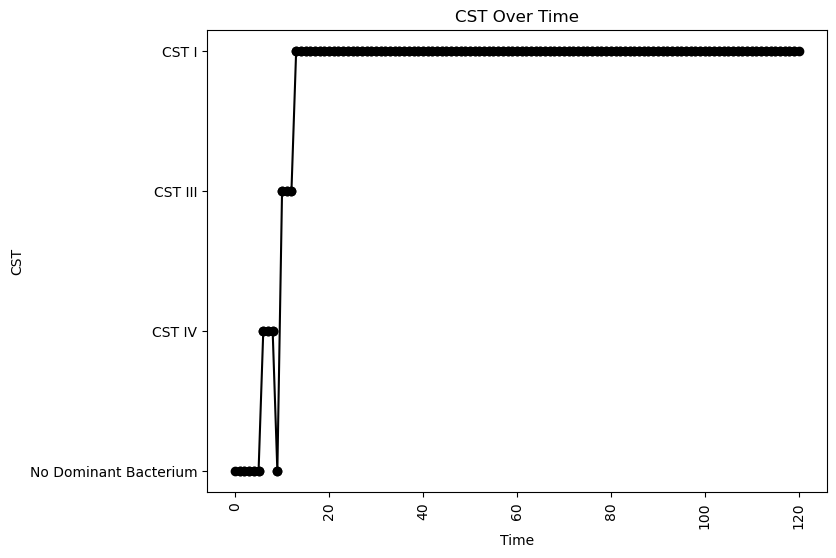


Interaction Parameters:
nAB Growth: 2.186256611128965
Li Growth: 0.06569643521101441
oLB Growth: 0.9552867864056962
nAB Self: -0.026053909020350402
nAB->Li: -0.2030059208875042
nAB->oLB: -0.2861479871811463
Li->nAB: 0.29340016965306615
Li Self: -0.06536952628827092
Li->oLB: 0.06001212455556548
oLB->nAB: -0.40003431890841845
oLB->Li: 0.4713934448963706
oLB Self: -0.08179494872914089

Simulation 1689 follows a valid CST progression:


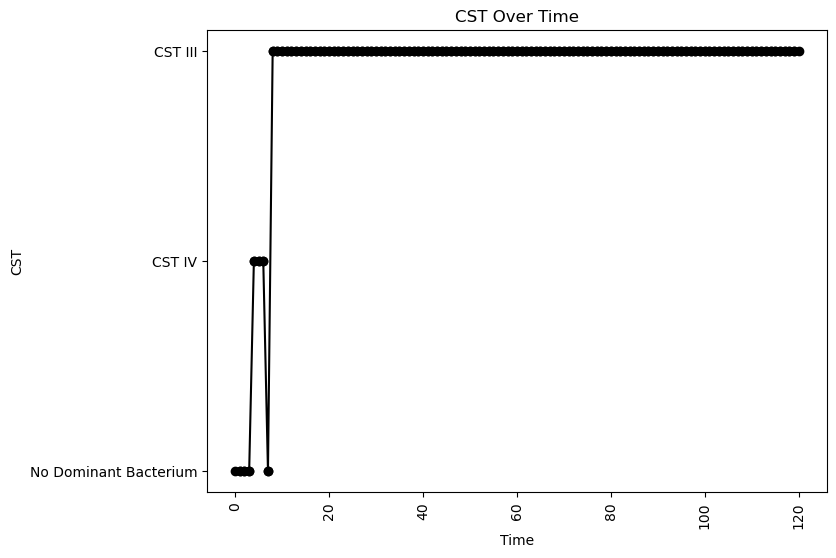


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.04246693343709601
nAB->Li: -0.13614432785088193
nAB->oLB: -0.12061504179673027
Li->nAB: 0.26000157567085913
Li Self: -0.08800023874819159
Li->oLB: -0.12076656220623516
oLB->nAB: -0.4835453944399812
oLB->Li: -0.3066542574226758
oLB Self: -0.07874156215601906

Simulation 1691 follows a valid CST progression:


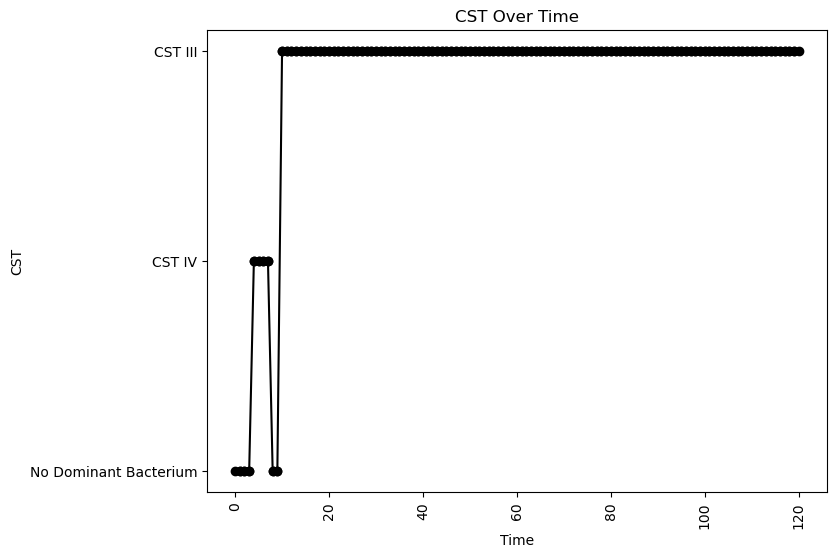


Interaction Parameters:
nAB Growth: 2.2446146183745257
Li Growth: 0.07278030322941353
oLB Growth: 0.5438660619757455
nAB Self: -0.09108622816335446
nAB->Li: 0.08664950338883437
nAB->oLB: -0.2901371416770343
Li->nAB: 0.19057860340478738
Li Self: -0.09208881511713148
Li->oLB: -0.2422251967694764
oLB->nAB: -0.33537638710617634
oLB->Li: -0.35127955430292623
oLB Self: -0.04685945336474106

Simulation 1692 follows a valid CST progression:


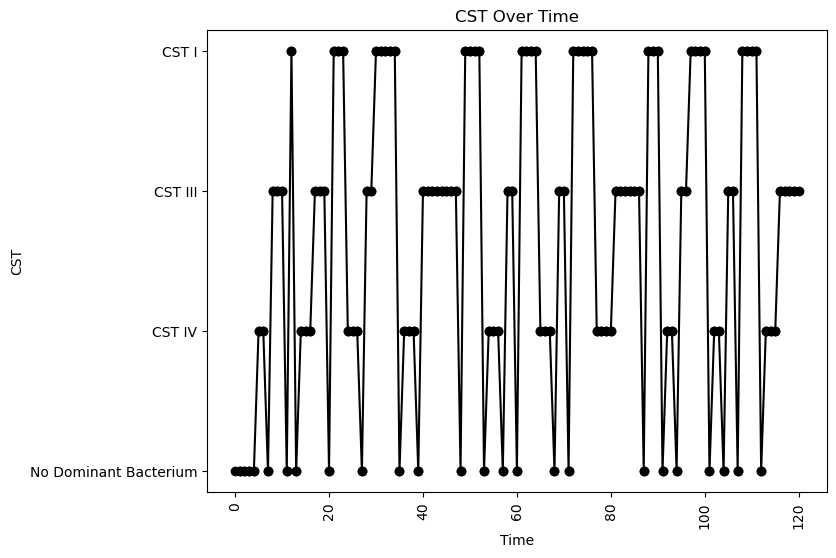


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.10935565577825926
oLB Growth: 0.11031283255203692
nAB Self: -0.08121945668713074
nAB->Li: -0.4284077039934685
nAB->oLB: -0.08575025599971742
Li->nAB: 0.24421941819787285
Li Self: -0.08428450786735575
Li->oLB: -0.3262099345960017
oLB->nAB: -0.48225667381186105
oLB->Li: 0.42321762597122115
oLB Self: -0.09460755601819365

Simulation 1695 follows a valid CST progression:


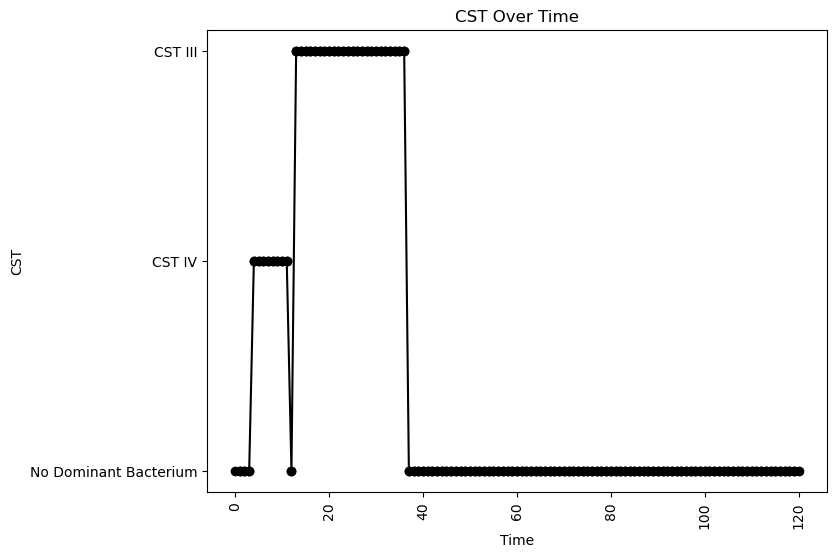


Interaction Parameters:
nAB Growth: 2.300652803872004
Li Growth: 0.06616501714537036
oLB Growth: 0.4369767544558836
nAB Self: -0.061725926740954944
nAB->Li: -0.27813235814814985
nAB->oLB: -0.18469526395604208
Li->nAB: 0.04498990123505742
Li Self: -0.021369020748717146
Li->oLB: 0.06867636737656524
oLB->nAB: -0.4818981643103203
oLB->Li: 0.2229796566603568
oLB Self: -0.09691146776450818

Simulation 1696 follows a valid CST progression:


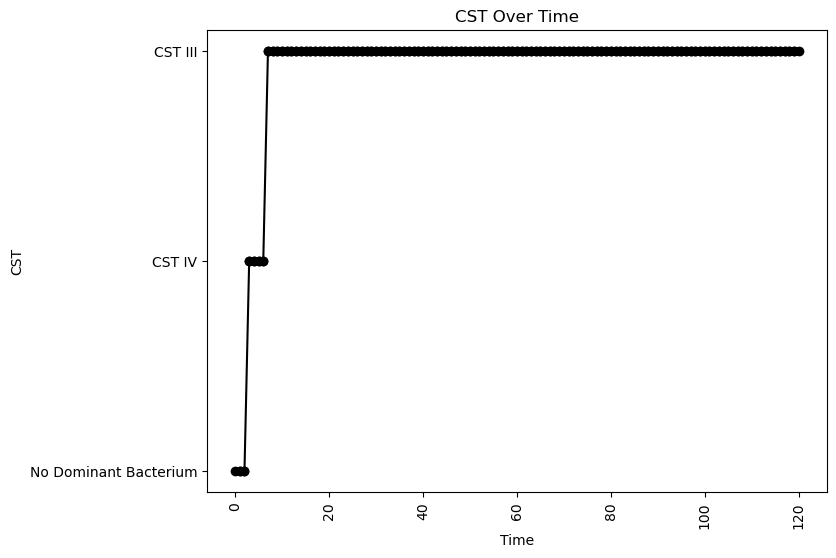


Interaction Parameters:
nAB Growth: 2.1573635369289432
Li Growth: 0.04215849674910016
oLB Growth: 1.2503024394854367
nAB Self: -0.010756148372310065
nAB->Li: 0.10817268414733916
nAB->oLB: -0.3410817234763558
Li->nAB: 0.2500361883806319
Li Self: -0.01611934331912547
Li->oLB: -0.40646317101811313
oLB->nAB: -0.37734741987301457
oLB->Li: -0.2871902391098251
oLB Self: -0.016612621395879573

Simulation 1705 follows a valid CST progression:


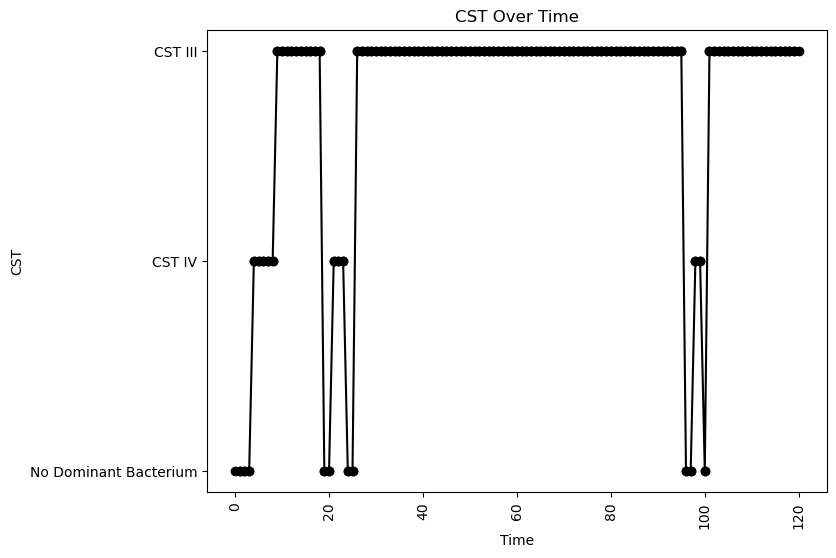


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.010587782309433358
nAB->Li: -0.4878796692382342
nAB->oLB: -0.17613213411268563
Li->nAB: 0.08900376670405796
Li Self: -0.07484364577046018
Li->oLB: -0.44975275871809933
oLB->nAB: -0.3305077944424614
oLB->Li: -0.4570429331540594
oLB Self: -0.02114320599863892

Simulation 1709 follows a valid CST progression:


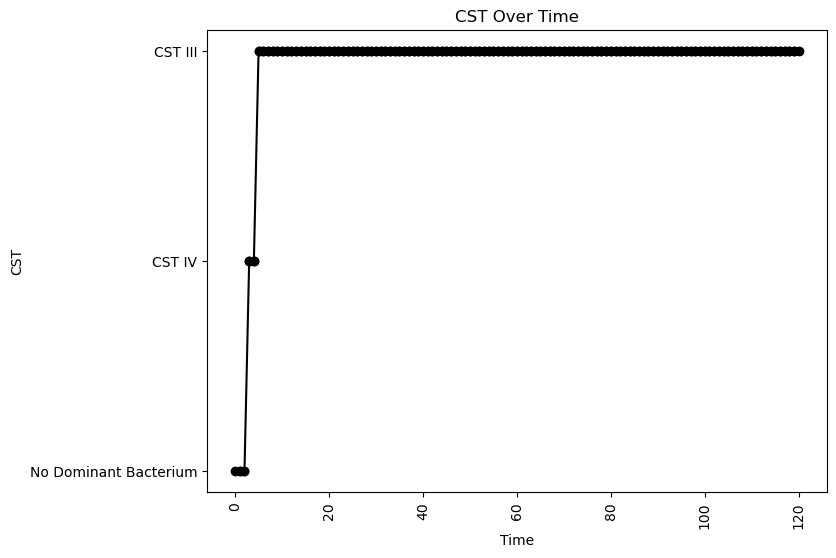


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.09907414831961743
nAB->Li: -0.22583159126769825
nAB->oLB: -0.05933451345999835
Li->nAB: 0.46938953486806523
Li Self: -0.09308197801579729
Li->oLB: -0.214957517601234
oLB->nAB: -0.2826583253792327
oLB->Li: -0.18027128464401704
oLB Self: -0.0814911747376843

Simulation 1712 follows a valid CST progression:


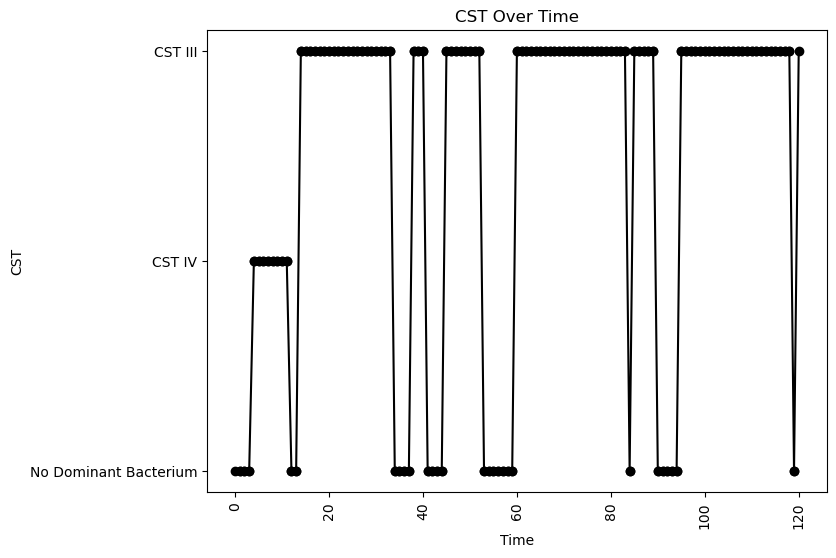


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.05863692754805046
nAB->Li: -0.30704217514171384
nAB->oLB: -0.15388041329654245
Li->nAB: 0.1367199449304206
Li Self: -0.09908879328217433
Li->oLB: -0.13916576921216667
oLB->nAB: -0.07854695483000323
oLB->Li: -0.17985783557331242
oLB Self: -0.0881527277962401

Simulation 1715 follows a valid CST progression:


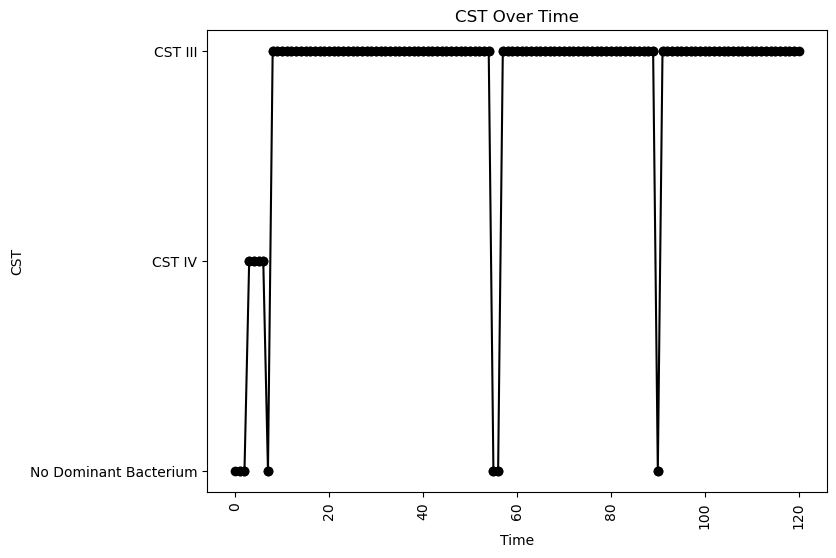


Interaction Parameters:
nAB Growth: 2.2489702826927647
Li Growth: 0.07143879299629578
oLB Growth: 0.24213610993368434
nAB Self: -0.03238002087575763
nAB->Li: -0.22714214198281063
nAB->oLB: -0.0803763004052842
Li->nAB: 0.13903953600124164
Li Self: -0.04789920561685229
Li->oLB: -0.2840521615162782
oLB->nAB: -0.2886130808345453
oLB->Li: -0.4488461403210915
oLB Self: -0.05541861945639751

Simulation 1722 follows a valid CST progression:


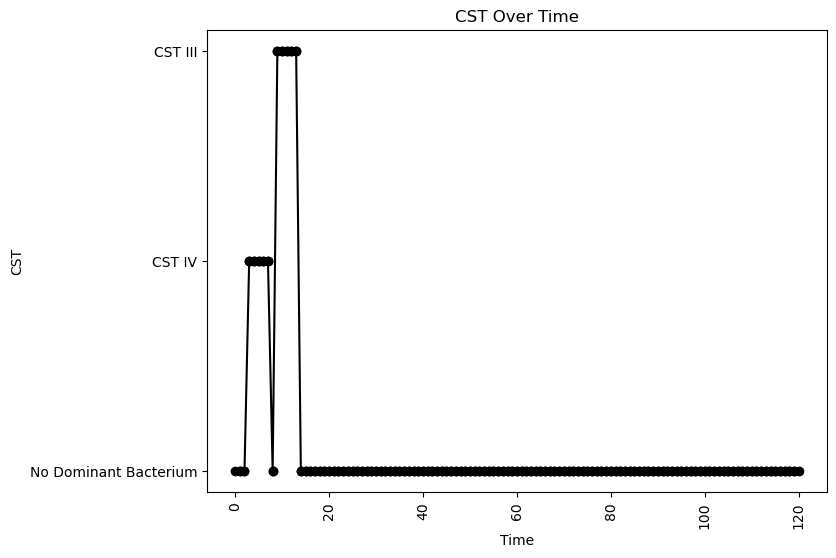


Interaction Parameters:
nAB Growth: 2.1147752631399044
Li Growth: 0.026128882742544723
oLB Growth: 1.2094391858973506
nAB Self: -0.05737007909453783
nAB->Li: -0.4537037739287615
nAB->oLB: -0.0738028280777378
Li->nAB: 0.17484047509042688
Li Self: -0.02618009281503486
Li->oLB: 0.2779164549739357
oLB->nAB: -0.23691411815717545
oLB->Li: 0.23384725187304833
oLB Self: -0.04787242587520282

Simulation 1726 follows a valid CST progression:


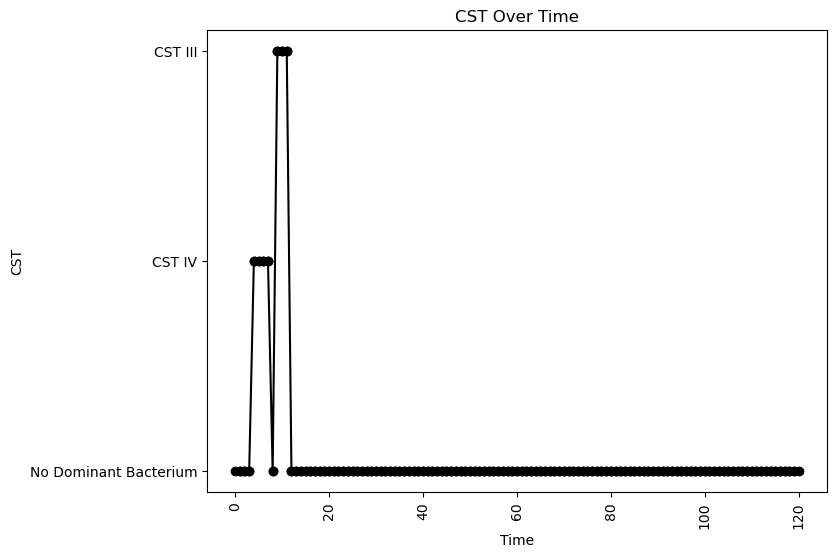


Interaction Parameters:
nAB Growth: 2.2446146183745257
Li Growth: 0.07278030322941353
oLB Growth: 0.5438660619757455
nAB Self: -0.09991595882003436
nAB->Li: -0.4561985721271479
nAB->oLB: -0.15952675565410857
Li->nAB: 0.1816838324859934
Li Self: -0.06210933268771342
Li->oLB: 0.41476029449315943
oLB->nAB: -0.2713638463572962
oLB->Li: 0.38054260145111307
oLB Self: -0.08889510741402228

Simulation 1733 follows a valid CST progression:


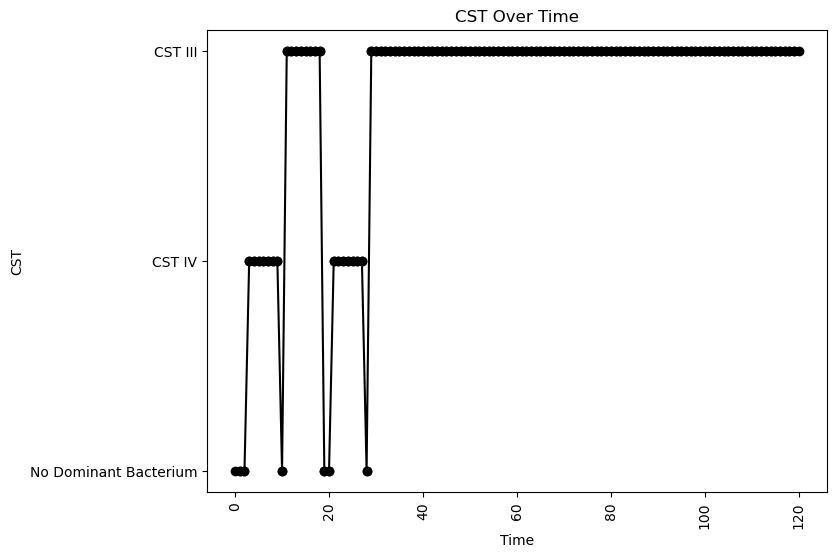


Interaction Parameters:
nAB Growth: 2.273308423784788
Li Growth: 0.06939466945066827
oLB Growth: 0.4879467602516997
nAB Self: -0.003970193872673292
nAB->Li: -0.18455860417764436
nAB->oLB: -0.2593043263359037
Li->nAB: 0.013522339153057561
Li Self: -0.023923824938101565
Li->oLB: -0.1453840470346105
oLB->nAB: -0.2922236191195561
oLB->Li: -0.3513130507351197
oLB Self: -0.0020342101907636356

Simulation 1734 follows a valid CST progression:


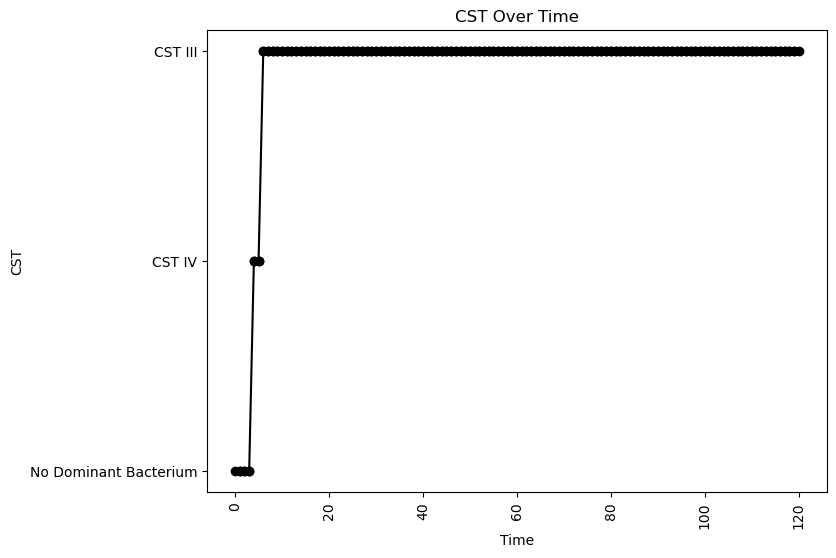


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.04033974348530591
nAB->Li: 0.07603753555268988
nAB->oLB: -0.03070030880126018
Li->nAB: 0.3132817971282722
Li Self: -0.05247093676717537
Li->oLB: 0.3491145170164702
oLB->nAB: -0.3357403391245248
oLB->Li: -0.498659345208093
oLB Self: -0.0023533987693939024

Simulation 1740 follows a valid CST progression:


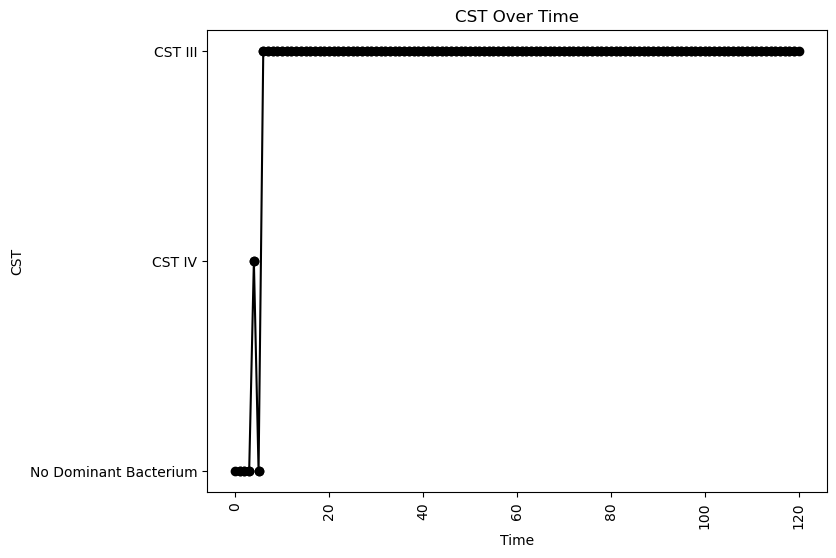


Interaction Parameters:
nAB Growth: 2.2609282147211935
Li Growth: 0.06381435834914458
oLB Growth: 0.1660151901294062
nAB Self: -0.010148039683740645
nAB->Li: -0.11731974383789423
nAB->oLB: -0.13819310851670713
Li->nAB: 0.3293536697520434
Li Self: -0.04744492590038415
Li->oLB: 0.44075652773421947
oLB->nAB: -0.2007293870934116
oLB->Li: 0.06311083205343315
oLB Self: -0.04622484087021997

Simulation 1747 follows a valid CST progression:


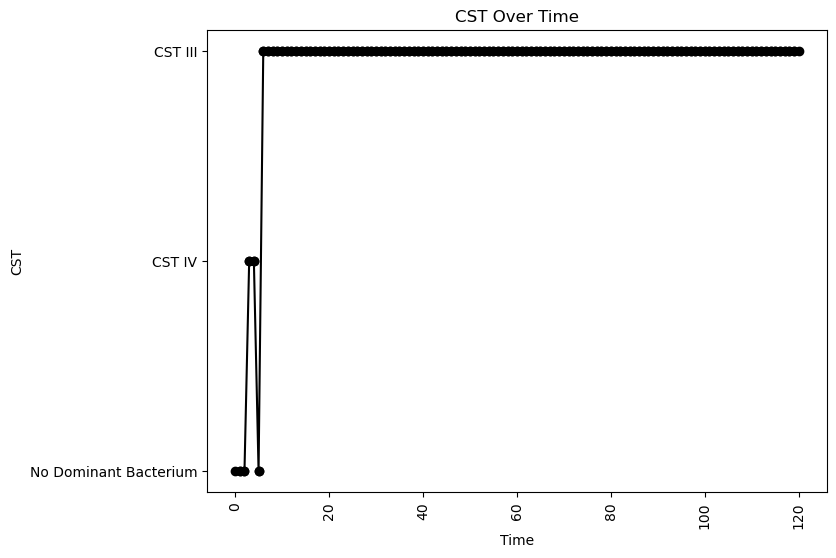


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.09989579813725048
nAB->Li: 0.0436795962584926
nAB->oLB: -0.34318756971830144
Li->nAB: 0.3986012481624085
Li Self: -0.05759704318239174
Li->oLB: 0.1175675455011862
oLB->nAB: -0.3176535250210799
oLB->Li: -0.2448459116224722
oLB Self: -0.06455382555571226

Simulation 1749 follows a valid CST progression:


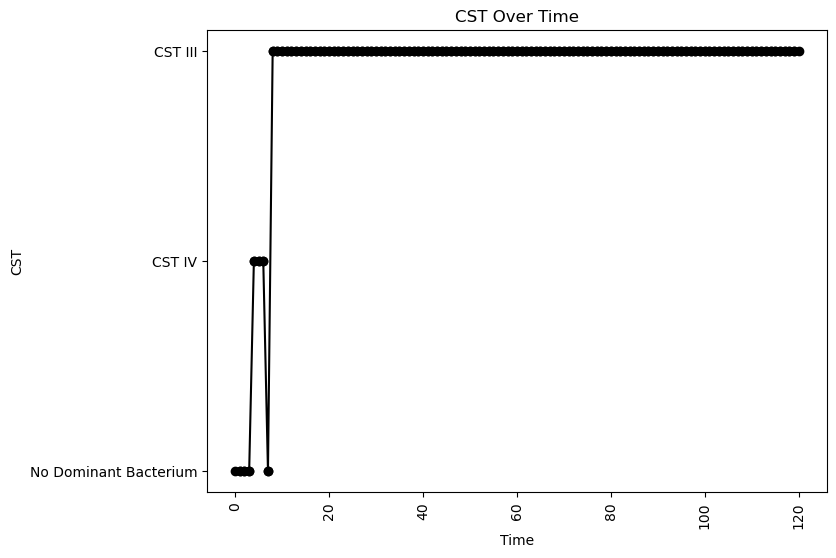


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.08342103659194074
nAB->Li: -0.02910595142922845
nAB->oLB: -0.014634841537241705
Li->nAB: 0.14870008603237284
Li Self: -0.0611250854023765
Li->oLB: -0.4464362128592045
oLB->nAB: -0.33630250000809125
oLB->Li: -0.4795146246369638
oLB Self: -0.09875849230840755

Simulation 1751 follows a valid CST progression:


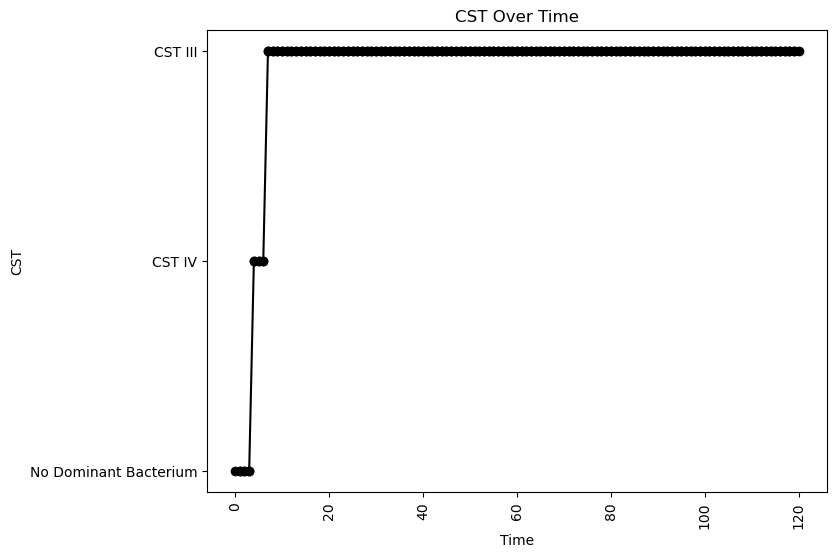


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.0015605832142673859
nAB->Li: 0.041156134432208114
nAB->oLB: -0.132585140731441
Li->nAB: 0.21662107663009567
Li Self: -0.07505248785350731
Li->oLB: -0.19277117301963081
oLB->nAB: -0.2804676412763966
oLB->Li: -0.23983797179013805
oLB Self: -0.07396429140023017

Simulation 1763 follows a valid CST progression:


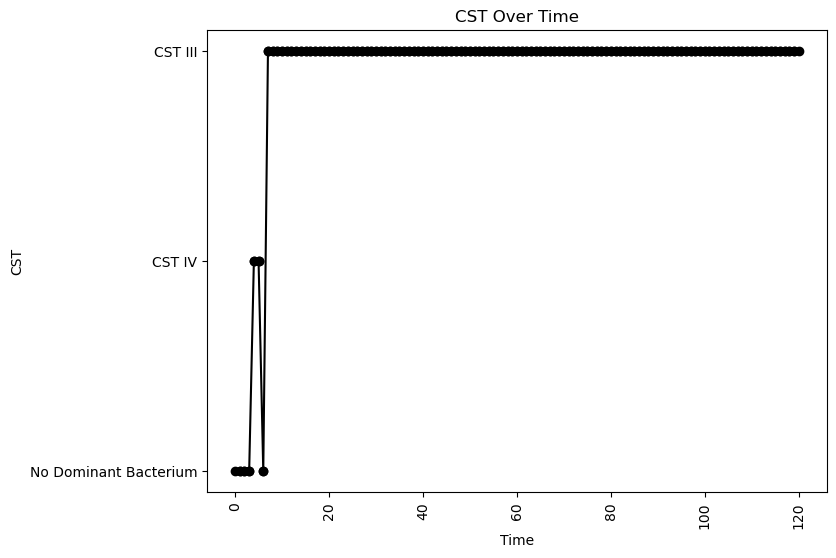


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.06664492138468138
oLB Growth: 0.6588037441195057
nAB Self: -0.03189137433321994
nAB->Li: 0.0020264903792392985
nAB->oLB: -0.0808252905393817
Li->nAB: 0.36120190856921675
Li Self: -0.04395125401633865
Li->oLB: 0.09708782481168465
oLB->nAB: -0.3699360965175714
oLB->Li: -0.3868021766058061
oLB Self: -0.08625117587650617

Simulation 1771 follows a valid CST progression:


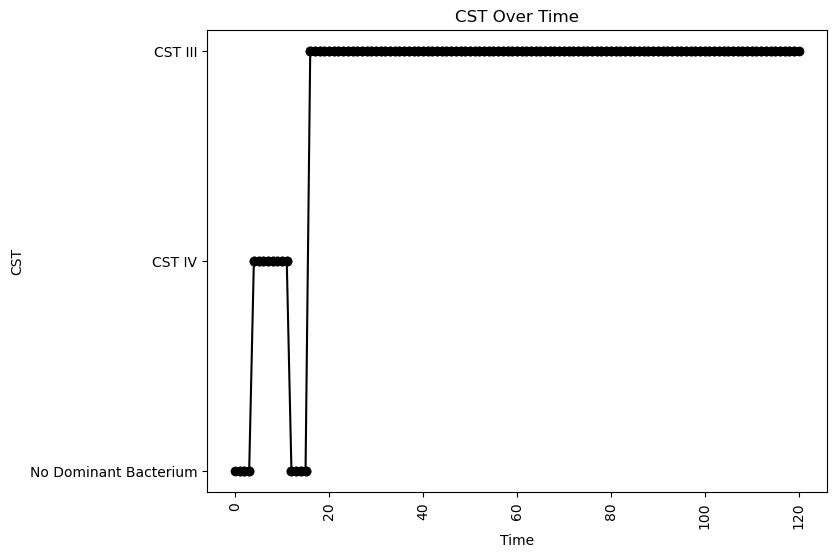


Interaction Parameters:
nAB Growth: 2.2088016144568243
Li Growth: 0.05268768924856952
oLB Growth: 1.1274304047774089
nAB Self: -0.036062841110927724
nAB->Li: -0.00011930575325724835
nAB->oLB: -0.009858191560707774
Li->nAB: 0.029419330094176965
Li Self: -0.01849176882220735
Li->oLB: -0.23101783082119187
oLB->nAB: -0.3485970409528736
oLB->Li: -0.41477160634803123
oLB Self: -0.0763901781840671

Simulation 1776 follows a valid CST progression:


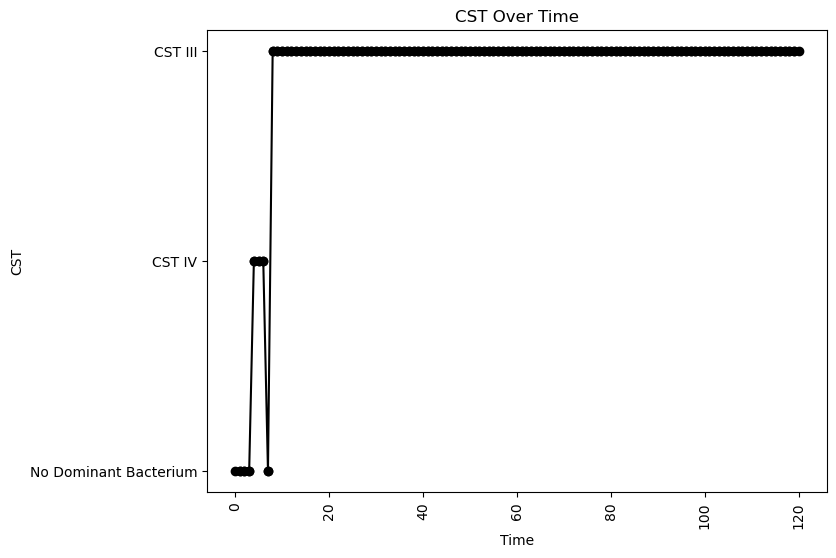


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.07623337635856814
nAB->Li: -0.21582455700616104
nAB->oLB: -0.2812294150748965
Li->nAB: 0.2134853961734986
Li Self: -0.05392383122691265
Li->oLB: 0.2915471574389098
oLB->nAB: -0.3329198679865324
oLB->Li: -0.1998862447122714
oLB Self: -0.02216375945613616

Simulation 1781 follows a valid CST progression:


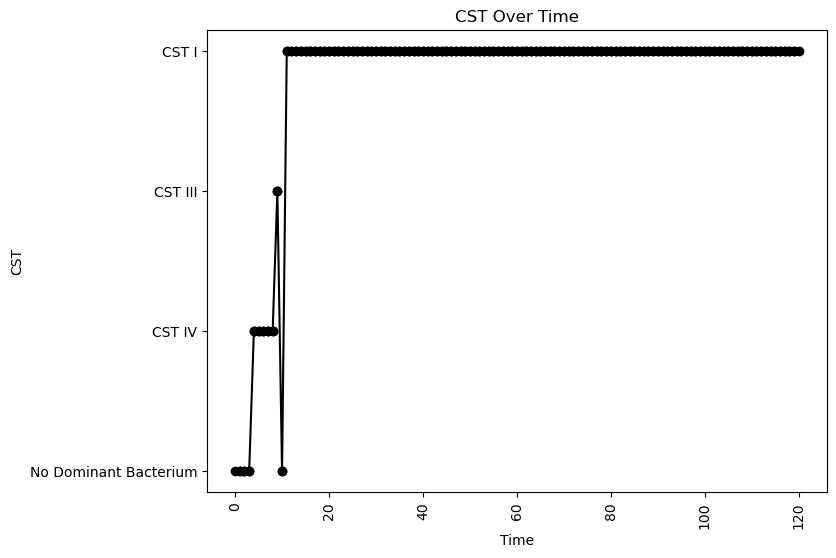


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.07667182258441883
nAB->Li: -0.15732264331855533
nAB->oLB: -0.3498844870264951
Li->nAB: 0.09696616477459508
Li Self: -0.0276607175996859
Li->oLB: -0.2957114095786355
oLB->nAB: -0.16917778155311158
oLB->Li: 0.45988142967146983
oLB Self: -0.025202927277369724

Simulation 1788 follows a valid CST progression:


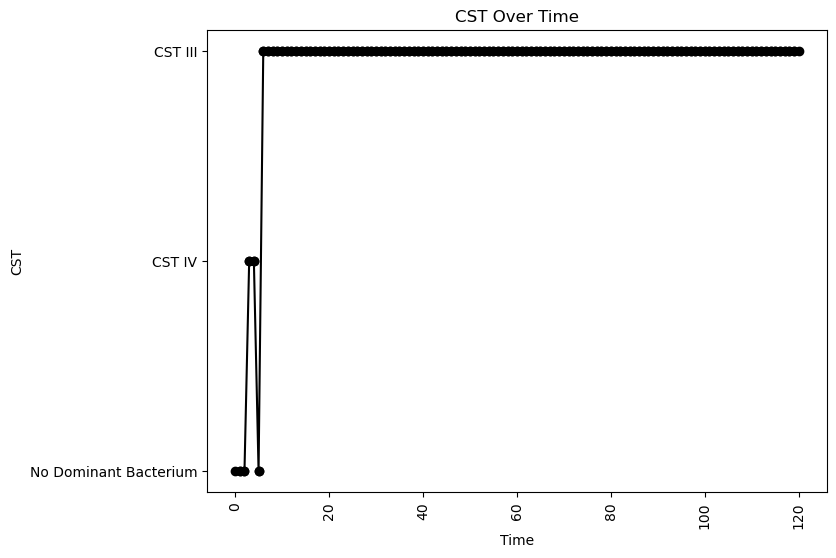


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.013938065543907238
nAB->Li: 0.015565416138397459
nAB->oLB: -0.04635301094579514
Li->nAB: 0.2939745120936791
Li Self: -0.08782115253445488
Li->oLB: -0.036652219490250826
oLB->nAB: -0.13092119378135475
oLB->Li: -0.016446315667046907
oLB Self: -0.013732597277010802

Simulation 1804 follows a valid CST progression:


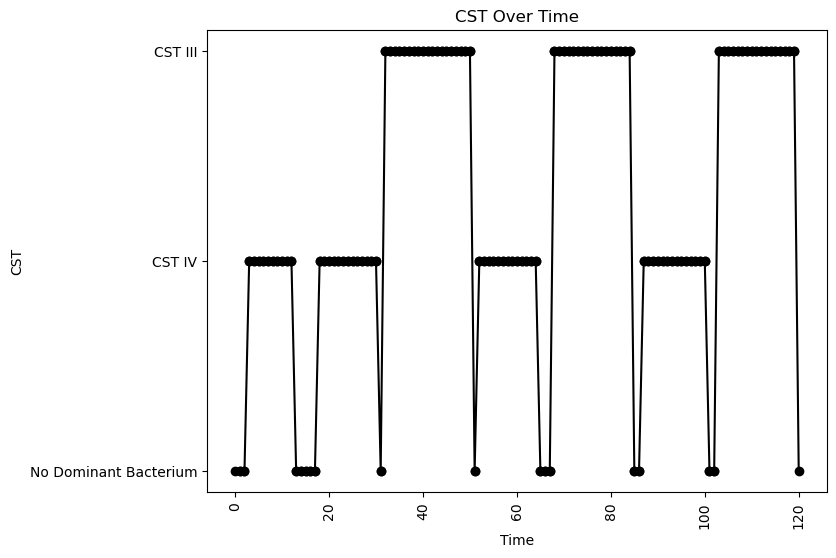


Interaction Parameters:
nAB Growth: 2.2657644953374403
Li Growth: 0.07173881162026666
oLB Growth: 0.2949021384914317
nAB Self: -0.0021232530685906803
nAB->Li: -0.38701399581101853
nAB->oLB: -0.4613522777105929
Li->nAB: 0.014874002914752493
Li Self: -0.07964786122335926
Li->oLB: -0.23254554751085288
oLB->nAB: -0.23213868410400362
oLB->Li: 0.4399671377679397
oLB Self: -0.07473628910494116

Simulation 1805 follows a valid CST progression:


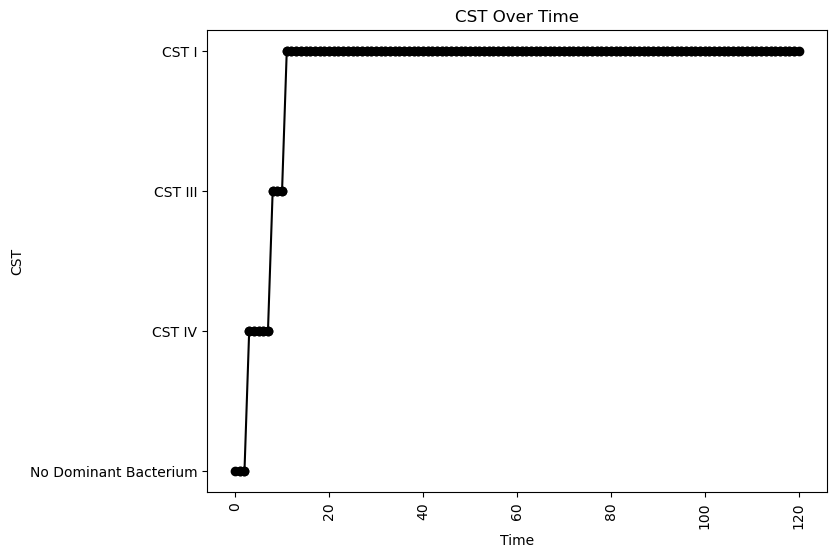


Interaction Parameters:
nAB Growth: 2.286323001067126
Li Growth: 0.060377934648291574
oLB Growth: 0.14091260068383374
nAB Self: -0.07422753967134693
nAB->Li: -0.3414126647483744
nAB->oLB: -0.23711059420388775
Li->nAB: 0.1835802993324529
Li Self: -0.026352417741854525
Li->oLB: -0.1964265225796945
oLB->nAB: -0.24199509379445217
oLB->Li: 0.389144523970152
oLB Self: -0.008632624055582641

Simulation 1814 follows a valid CST progression:


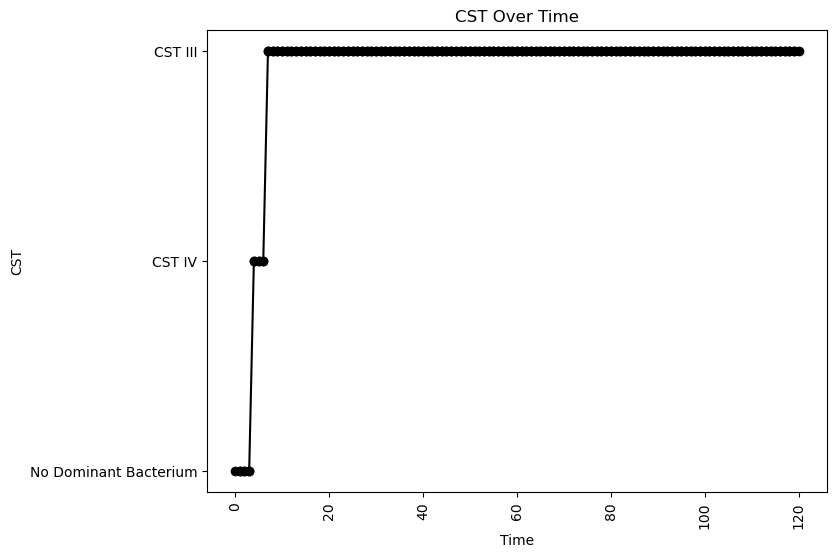


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.052481536311233756
nAB->Li: -0.03535135829643948
nAB->oLB: -0.2553028086619478
Li->nAB: 0.1948770971422049
Li Self: -0.025323705313055014
Li->oLB: 0.38786470126024564
oLB->nAB: -0.284428914739436
oLB->Li: 0.20940751550160508
oLB Self: -0.0994002847294927

Simulation 1829 follows a valid CST progression:


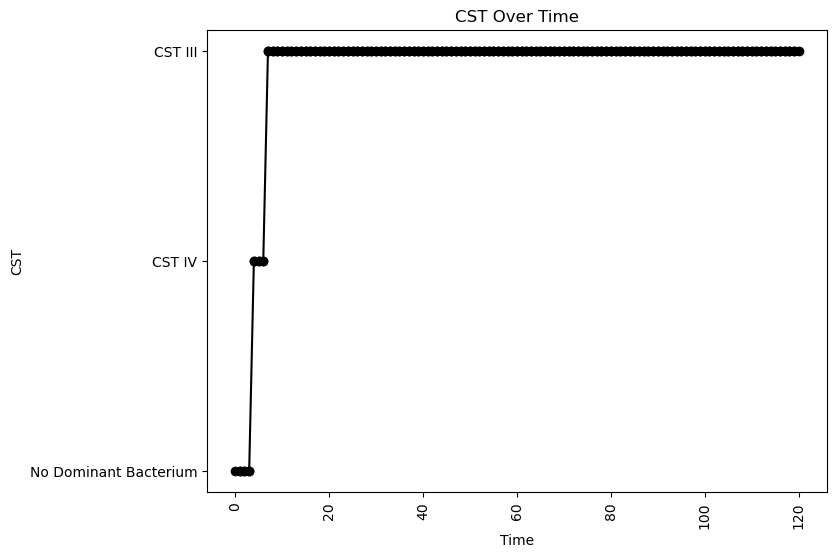


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.04789873089708278
nAB->Li: -0.04111489903694032
nAB->oLB: -0.4188358500714253
Li->nAB: 0.12220766603859567
Li Self: -0.02252881071880887
Li->oLB: 0.24891420961230437
oLB->nAB: -0.48615004937092865
oLB->Li: -0.43587711587937233
oLB Self: -0.07822698716349502

Simulation 1830 follows a valid CST progression:


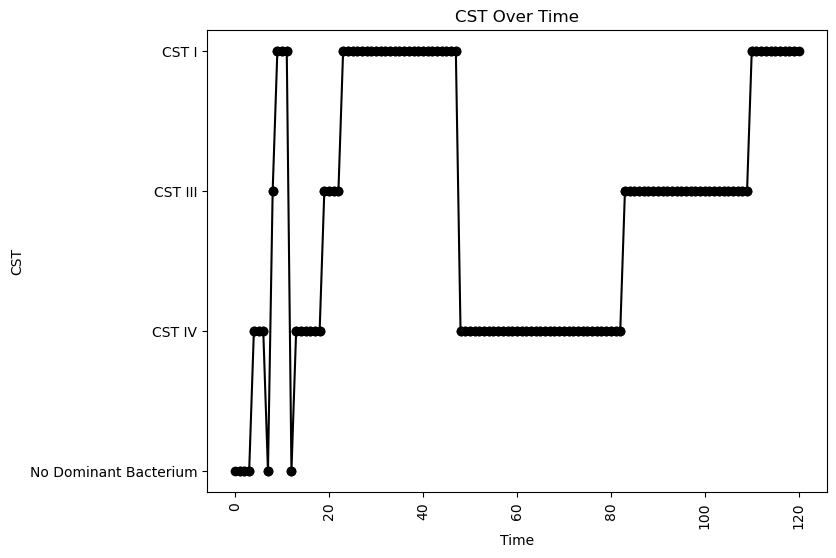


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.2615596692905746
oLB Growth: 0.11031283255203692
nAB Self: -0.07427728495364877
nAB->Li: -0.08509243224714647
nAB->oLB: -0.14619237736991625
Li->nAB: 0.10208176635041699
Li Self: -0.013133281837660604
Li->oLB: -0.33687917250814065
oLB->nAB: -0.4291446804316327
oLB->Li: 0.38939608627300515
oLB Self: -0.07003013640614467

Simulation 1849 follows a valid CST progression:


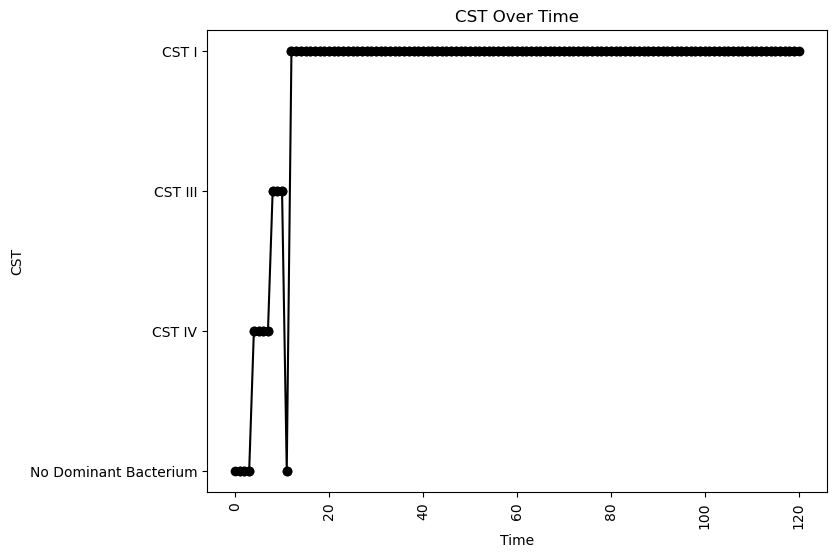


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.098402125289457
nAB->Li: -0.14374279147992064
nAB->oLB: -0.3814309547955571
Li->nAB: 0.2117888651798836
Li Self: -0.00271071443710158
Li->oLB: 0.012790267465486171
oLB->nAB: -0.4054852225708535
oLB->Li: 0.18300005055291346
oLB Self: -0.030640809814500916

Simulation 1854 follows a valid CST progression:


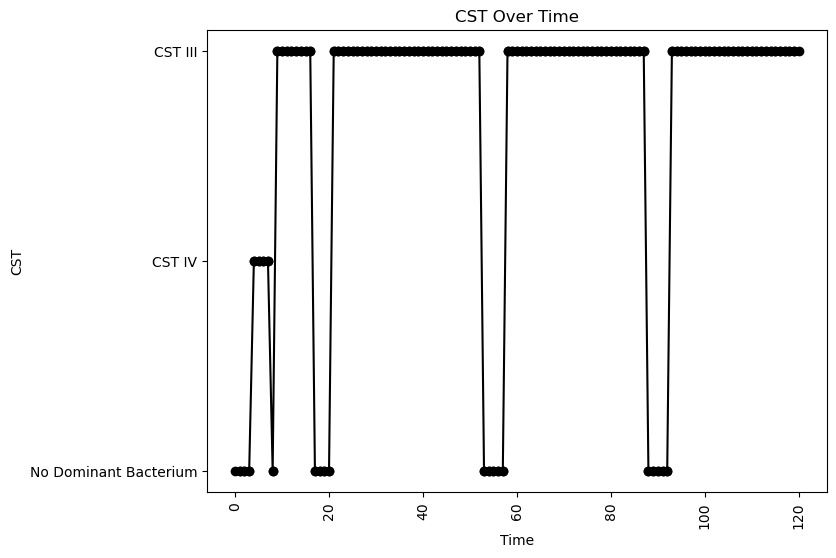


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.06872942070279468
nAB->Li: -0.37453062973457896
nAB->oLB: -0.11272346488004897
Li->nAB: 0.13747485590216568
Li Self: -0.08565780245665765
Li->oLB: 0.18636728547094383
oLB->nAB: -0.18450242316455806
oLB->Li: -0.11001013518721231
oLB Self: -0.07718244662925722

Simulation 1865 follows a valid CST progression:


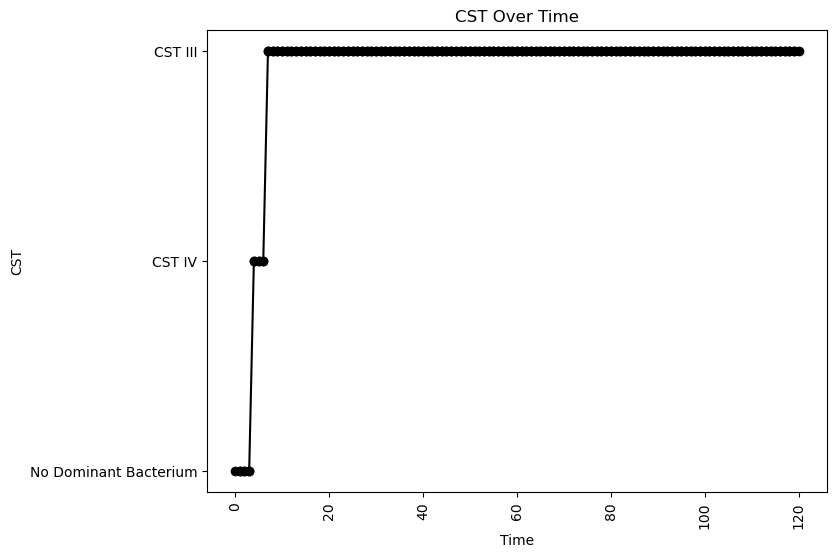


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.06806014290478743
oLB Growth: 0.20414555748463747
nAB Self: -0.09798157244046388
nAB->Li: -0.05023116842343206
nAB->oLB: -0.09484478057458967
Li->nAB: 0.3326868837129009
Li Self: -0.062035897991761915
Li->oLB: -0.07908895735888527
oLB->nAB: -0.14209712960544135
oLB->Li: -0.11107876482730505
oLB Self: -0.04231317976143175

Simulation 1869 follows a valid CST progression:


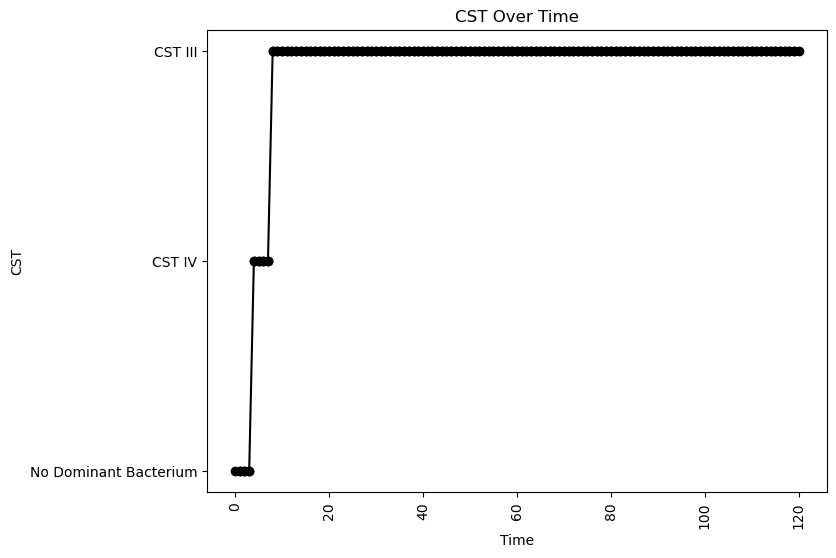


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.06495430992206574
oLB Growth: 0.1731103059651596
nAB Self: -0.0618575864982714
nAB->Li: -0.13499644631572605
nAB->oLB: -0.10396806052946267
Li->nAB: 0.13338870486780308
Li Self: -0.05093661776319464
Li->oLB: 0.23438227892251629
oLB->nAB: -0.431509853141555
oLB->Li: 0.1390105864089881
oLB Self: -0.06546911426662928

Simulation 1886 follows a valid CST progression:


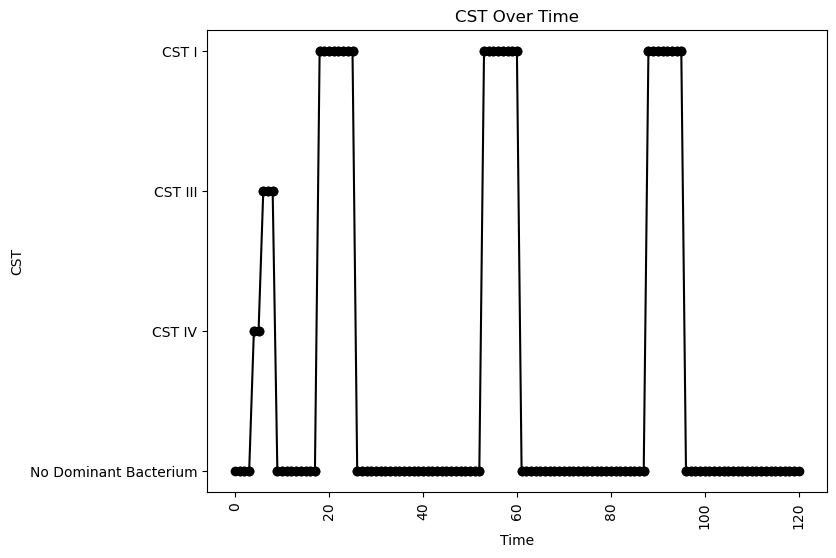


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.029695042716378295
nAB->Li: -0.03418100702837823
nAB->oLB: -0.3727736515039708
Li->nAB: 0.41898462083414756
Li Self: -0.03868516574404443
Li->oLB: 0.02608079591773038
oLB->nAB: -0.029224928167699782
oLB->Li: 0.05366109581416134
oLB Self: -0.06673732225431424

Simulation 1888 follows a valid CST progression:


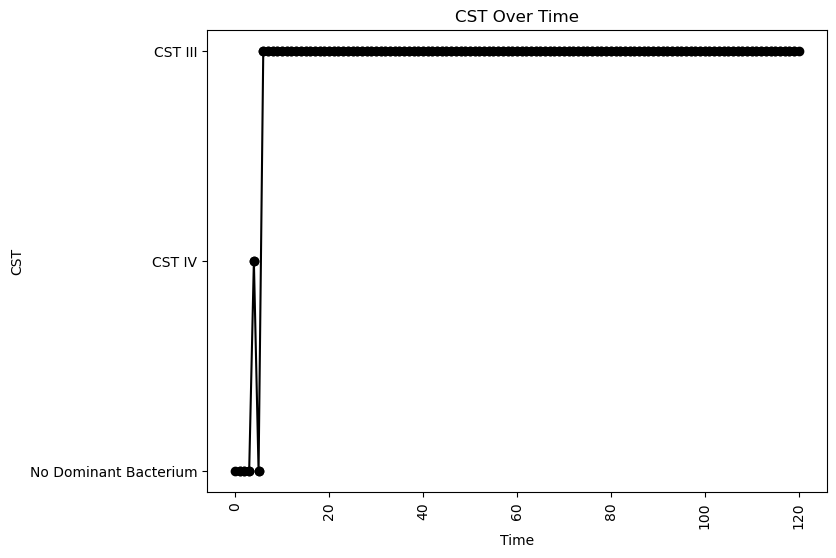


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.12087028897338341
oLB Growth: 1.0858755226067296
nAB Self: -0.02457775419299557
nAB->Li: 0.07399251873134804
nAB->oLB: -0.12954831971026248
Li->nAB: 0.3746689977080899
Li Self: -0.038431474393627006
Li->oLB: -0.3775644192954605
oLB->nAB: -0.016779921418324684
oLB->Li: -0.4719034800882872
oLB Self: -0.049643418608264975

Simulation 1892 follows a valid CST progression:


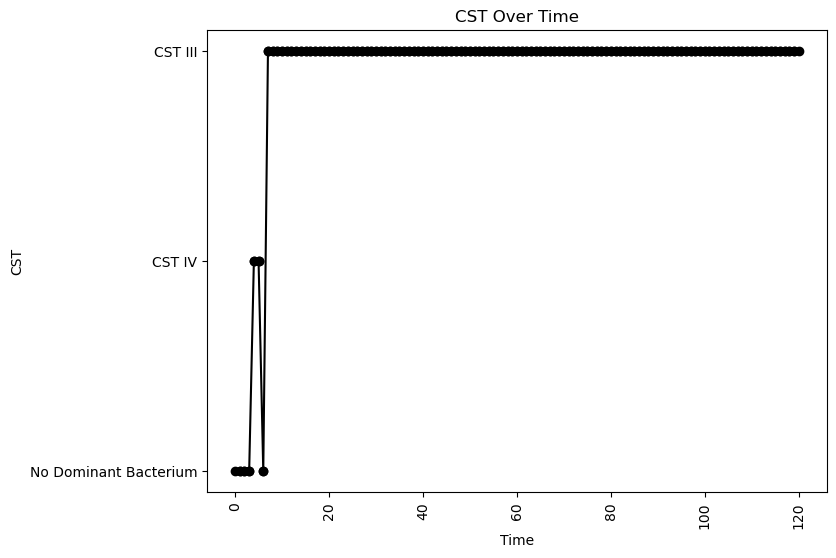


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.038161340355903135
nAB->Li: -0.4954120233052163
nAB->oLB: -0.25650002871235245
Li->nAB: 0.36949079394475093
Li Self: -0.03131649660130721
Li->oLB: -0.022313215320409807
oLB->nAB: -0.4089278837682059
oLB->Li: -0.13407865611050124
oLB Self: -0.05793235694254757

Simulation 1894 follows a valid CST progression:


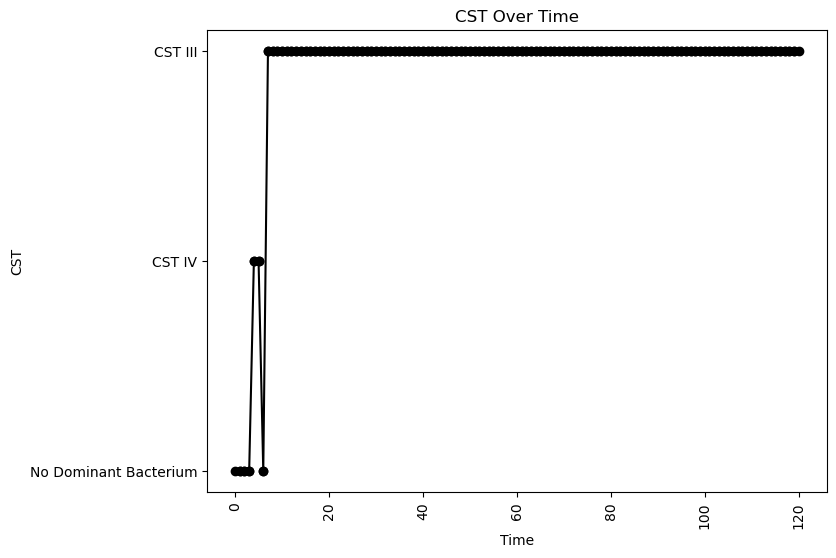


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.05755620724223436
nAB->Li: -0.4232791431631151
nAB->oLB: -0.3386954728112724
Li->nAB: 0.18455240522281746
Li Self: -0.013920589468183267
Li->oLB: 0.4926316681084506
oLB->nAB: -0.47104936908387524
oLB->Li: 0.3070589671382099
oLB Self: -0.019290316228642176

Simulation 1897 follows a valid CST progression:


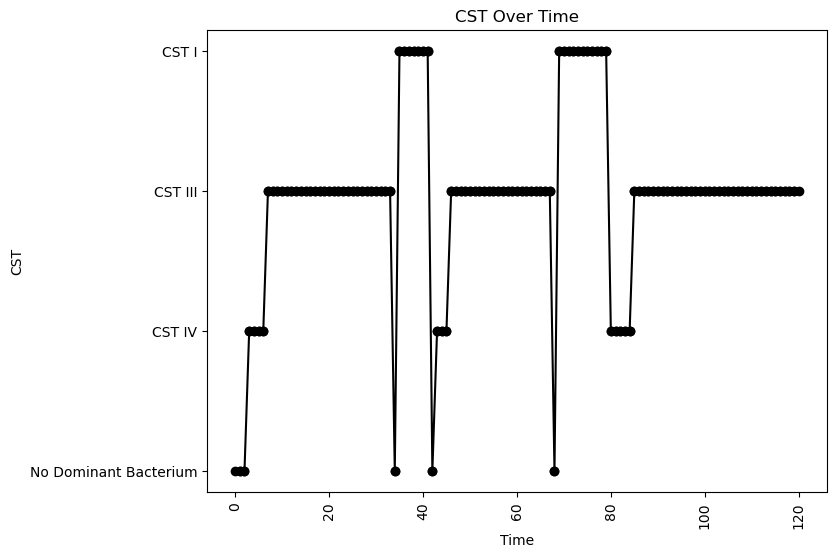


Interaction Parameters:
nAB Growth: 2.2657644953374403
Li Growth: 0.07173881162026666
oLB Growth: 0.2949021384914317
nAB Self: -0.08273418054257682
nAB->Li: -0.4893035895119808
nAB->oLB: -0.44515052201562555
Li->nAB: 0.4144356842052279
Li Self: -0.08332509038192541
Li->oLB: -0.46408858271335224
oLB->nAB: -0.4223668509146853
oLB->Li: -0.04491493771353389
oLB Self: -0.09221222426392371

Simulation 1902 follows a valid CST progression:


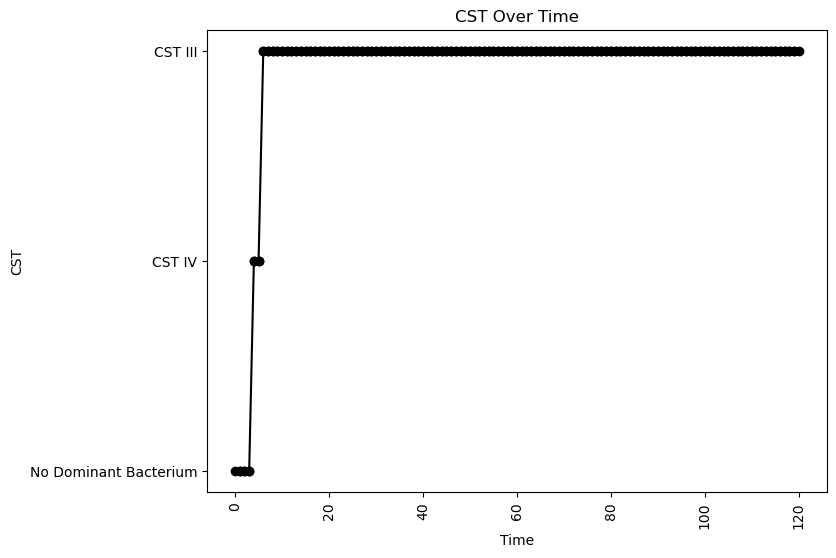


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.039626424620391947
nAB->Li: -0.3203635813815684
nAB->oLB: -0.15264356621580338
Li->nAB: 0.2708772733252208
Li Self: -0.05096260728718055
Li->oLB: -0.023078035317320666
oLB->nAB: -0.1578766123523157
oLB->Li: -0.448532045987179
oLB Self: -0.006895232166581097

Simulation 1904 follows a valid CST progression:


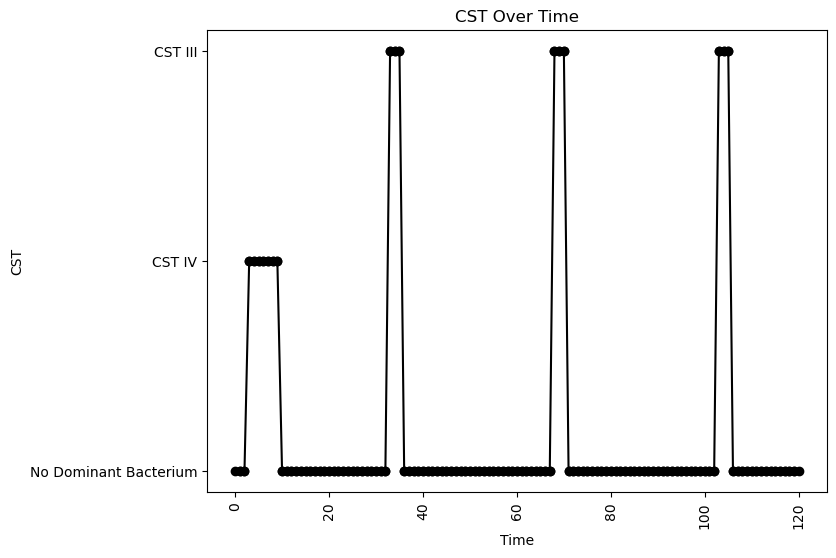


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.10578231323771885
oLB Growth: 1.0858755226067296
nAB Self: -0.06736035396533324
nAB->Li: -0.01257940584593753
nAB->oLB: -0.27269847701778016
Li->nAB: 0.03725168379841781
Li Self: -0.04307353568750081
Li->oLB: 0.45107036590440286
oLB->nAB: -0.2982593432228663
oLB->Li: -0.4522869469853977
oLB Self: -0.09560110211431172

Simulation 1907 follows a valid CST progression:


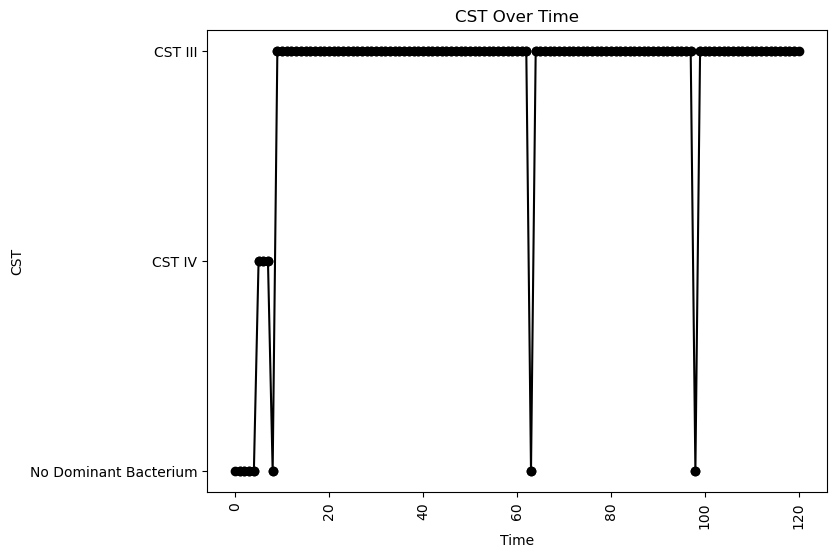


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.037614046140470134
nAB->Li: -0.31095037377049395
nAB->oLB: -0.45295566162131173
Li->nAB: 0.16935213697492113
Li Self: -0.0534550402844948
Li->oLB: 0.226091170455044
oLB->nAB: -0.3295084108690409
oLB->Li: -0.10345658793122103
oLB Self: -0.03726715235529447

Simulation 1908 follows a valid CST progression:


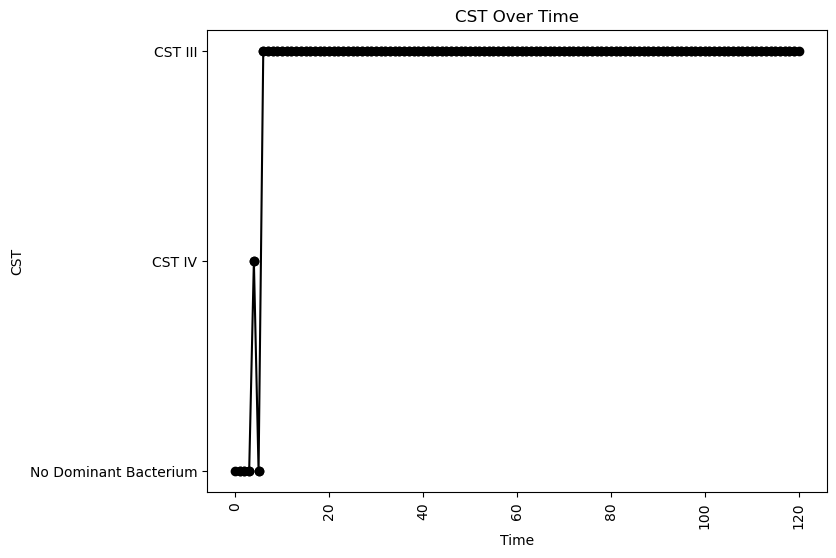


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.0971723334457938
oLB Growth: 0.595997418302585
nAB Self: -0.04759986426586792
nAB->Li: -0.09773451767754793
nAB->oLB: -0.10897275889544061
Li->nAB: 0.36709982674722086
Li Self: -0.09051317485811275
Li->oLB: -0.40194452093376765
oLB->nAB: -0.3108799795721883
oLB->Li: -0.21917294644214885
oLB Self: -0.02850167128986192

Simulation 1909 follows a valid CST progression:


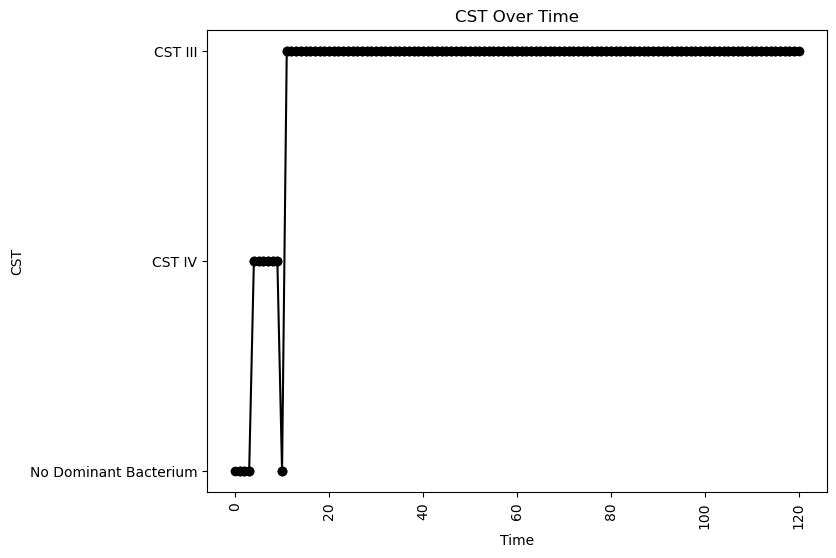


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.06664492138468138
oLB Growth: 0.6588037441195057
nAB Self: -0.09397540681919493
nAB->Li: -0.21095983400097884
nAB->oLB: -0.2521157413794299
Li->nAB: 0.09975974128156428
Li Self: -0.004512350583311134
Li->oLB: 0.43555970448476544
oLB->nAB: -0.33932792961065883
oLB->Li: -0.15365293363460292
oLB Self: -0.06691446936311443

Simulation 1913 follows a valid CST progression:


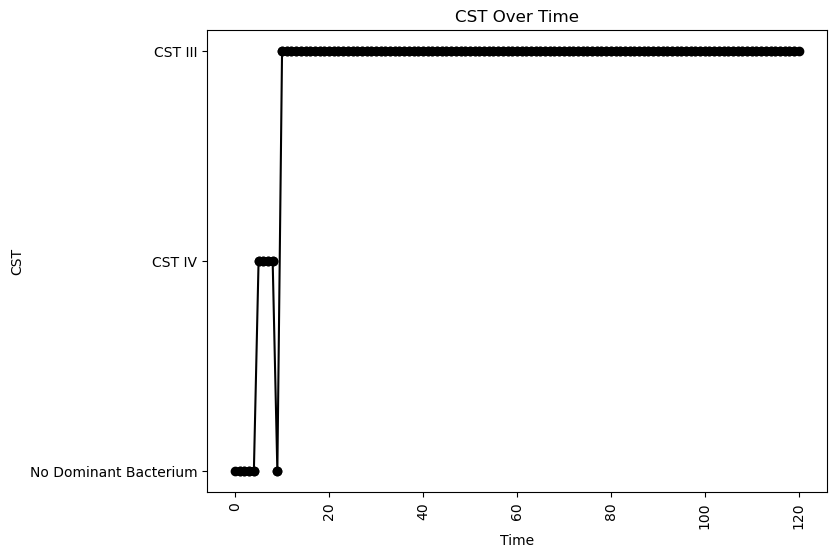


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.20065229143224841
oLB Growth: 0.11031283255203692
nAB Self: -0.0888930862505273
nAB->Li: -0.15104269226762246
nAB->oLB: -0.4925549039355798
Li->nAB: 0.06064313101607288
Li Self: -0.04488862946873399
Li->oLB: -0.21665712907040713
oLB->nAB: -0.23470184366454705
oLB->Li: -0.126877958735288
oLB Self: -0.0897932223324499

Simulation 1921 follows a valid CST progression:


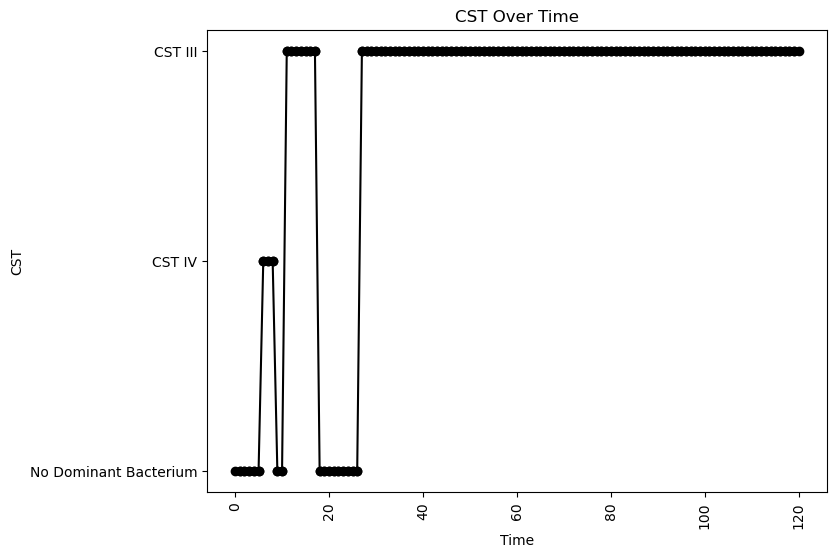


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.027798923237400602
nAB->Li: -0.32585403910298916
nAB->oLB: -0.1872588029900505
Li->nAB: 0.0385934718099008
Li Self: -0.04995309044502814
Li->oLB: 0.43990203902950464
oLB->nAB: -0.04604439298831153
oLB->Li: -0.057344817650988256
oLB Self: -0.02672297478685949

Simulation 1937 follows a valid CST progression:


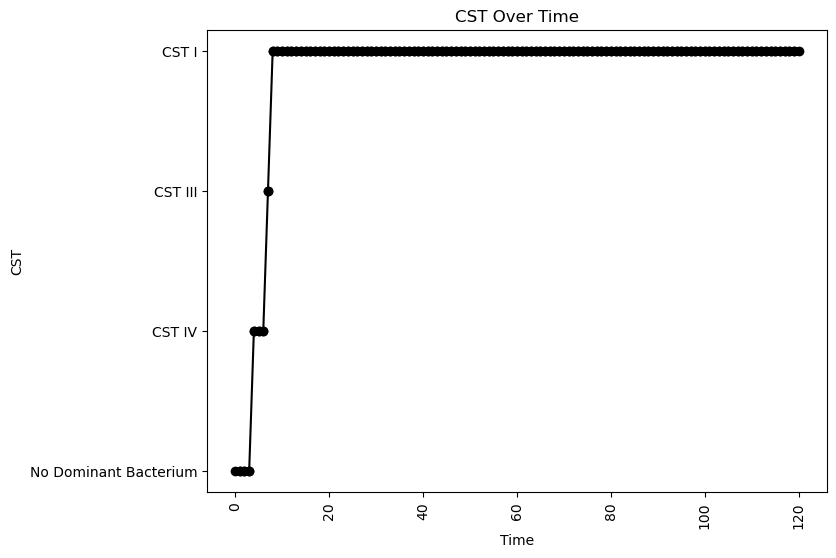


Interaction Parameters:
nAB Growth: 2.2002663828262317
Li Growth: 0.07280454274860512
oLB Growth: 0.7629459891785437
nAB Self: -0.008747644026191617
nAB->Li: -0.010726058019969342
nAB->oLB: -0.2397314748631258
Li->nAB: 0.396201119049303
Li Self: -0.07871703967830426
Li->oLB: -0.14927472207440984
oLB->nAB: -0.41450167151544204
oLB->Li: 0.4162705770610322
oLB Self: -0.04232743842550753

Simulation 1940 follows a valid CST progression:


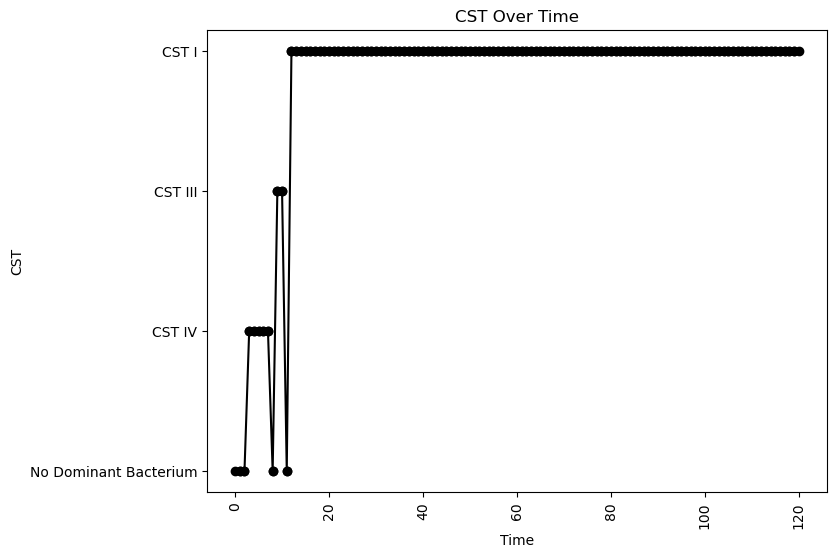


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.02851435043862427
nAB->Li: -0.2255110350566767
nAB->oLB: -0.44416170835399366
Li->nAB: 0.07356598003188752
Li Self: -0.042277543010598294
Li->oLB: -0.25805858517544067
oLB->nAB: -0.09357962368388034
oLB->Li: 0.23636752254305848
oLB Self: -0.033355133615778604

Simulation 1942 follows a valid CST progression:


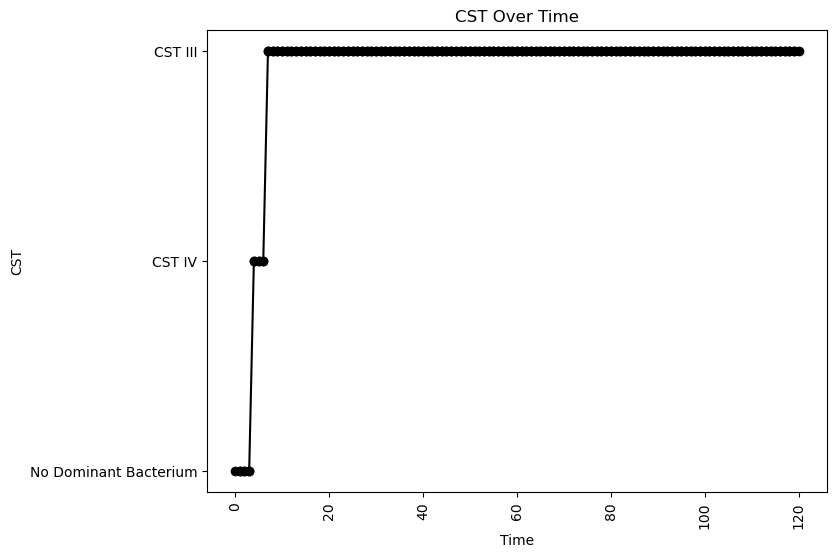


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.05739994626081137
oLB Growth: 0.11031283255203692
nAB Self: -0.05168718081358394
nAB->Li: 0.014458358291349449
nAB->oLB: -0.3292967477194706
Li->nAB: 0.1443380136047212
Li Self: -0.05537459866896168
Li->oLB: 0.30887090185060506
oLB->nAB: -0.29908426630851115
oLB->Li: 0.09027298152643559
oLB Self: -0.07672916854766065

Simulation 1945 follows a valid CST progression:


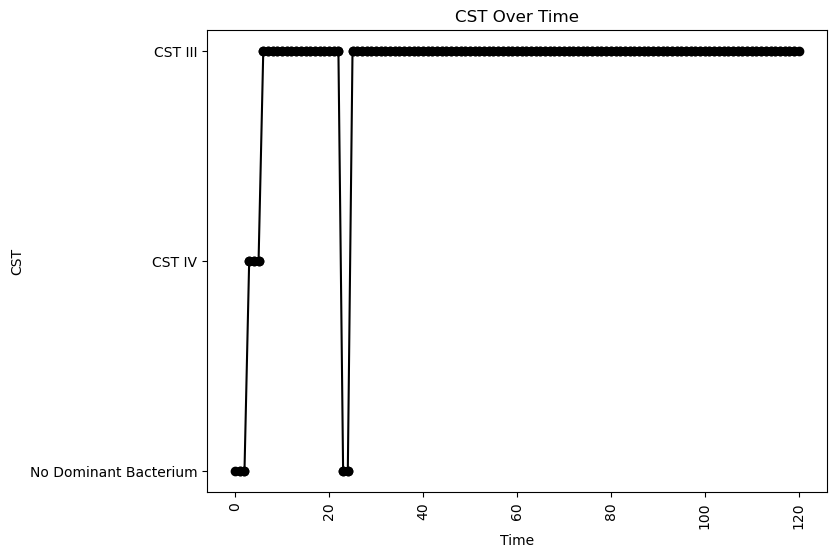


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.07440154573615473
nAB->Li: -0.2880621119238058
nAB->oLB: -0.1025354600935719
Li->nAB: 0.3996586965632002
Li Self: -0.04471757320443922
Li->oLB: 0.14359061096003278
oLB->nAB: -0.35905291048020793
oLB->Li: 0.06237222059295233
oLB Self: -0.07737737330676636

Simulation 1949 follows a valid CST progression:


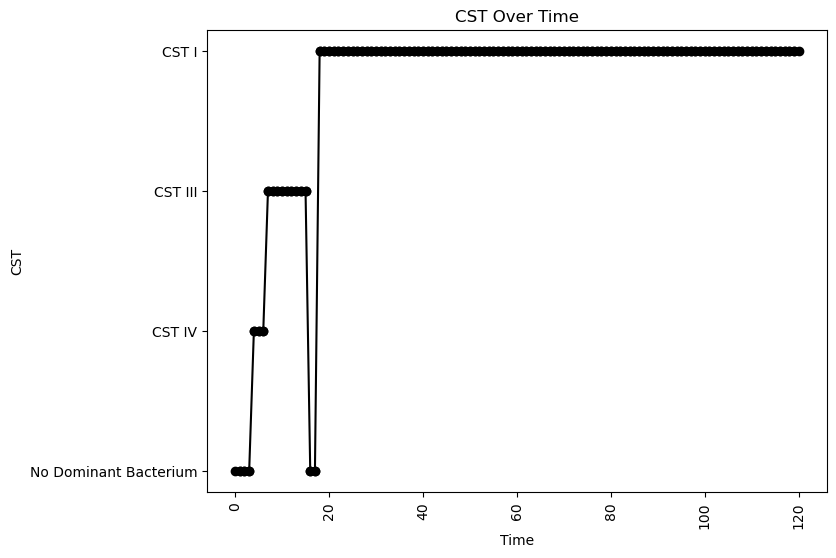


Interaction Parameters:
nAB Growth: 2.292952252819776
Li Growth: 0.06862578763464611
oLB Growth: 0.25066683866219575
nAB Self: -0.016839652670827973
nAB->Li: -0.49508750595863726
nAB->oLB: -0.12708381821954512
Li->nAB: 0.18628872492026294
Li Self: -0.060393407636542454
Li->oLB: -0.04641029889236803
oLB->nAB: -0.2335015450045428
oLB->Li: 0.16741960229996744
oLB Self: -0.028927394276731105

Simulation 1961 follows a valid CST progression:


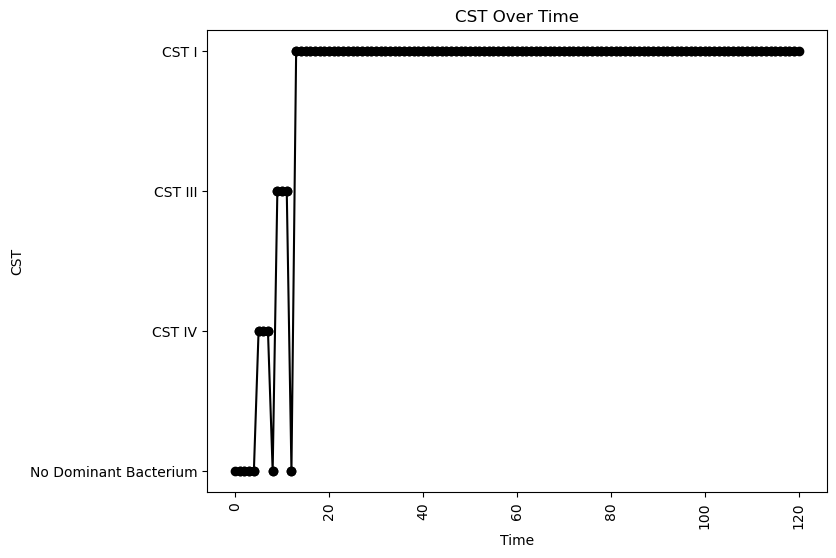


Interaction Parameters:
nAB Growth: 2.2446146183745257
Li Growth: 0.28693788915527707
oLB Growth: 0.5438660619757455
nAB Self: -0.03188324025897844
nAB->Li: -0.23233190636609485
nAB->oLB: -0.13892795882796333
Li->nAB: 0.055835725364860145
Li Self: -0.025960937260256764
Li->oLB: -0.37310445844152795
oLB->nAB: -0.2889035985625007
oLB->Li: 0.3076066559554057
oLB Self: -0.013202503174605057

Simulation 1971 follows a valid CST progression:


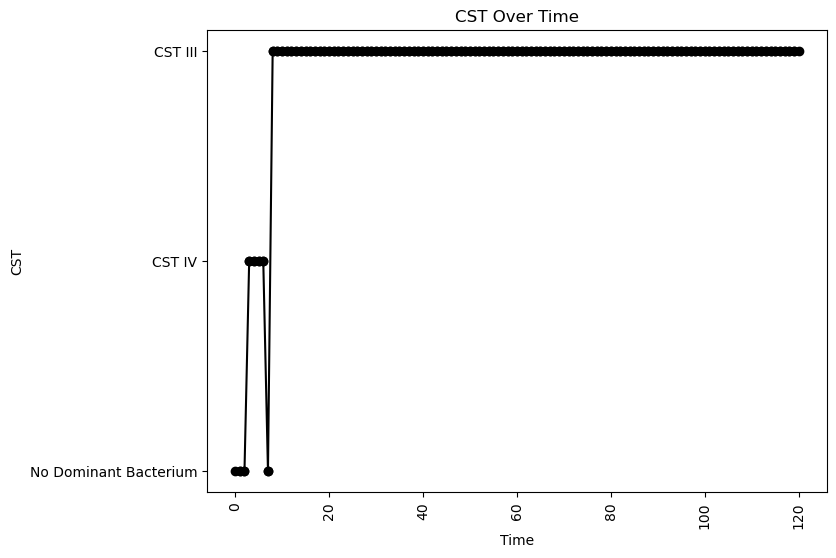


Interaction Parameters:
nAB Growth: 2.300652803872004
Li Growth: 0.06616501714537036
oLB Growth: 0.4369767544558836
nAB Self: -0.00250928169216727
nAB->Li: -0.14410686140385742
nAB->oLB: -0.199481853556837
Li->nAB: 0.06916240452340683
Li Self: -0.009576381602883294
Li->oLB: 0.3728300207820294
oLB->nAB: -0.2574274038451071
oLB->Li: -0.46461531435625625
oLB Self: -0.0043049630489038065

Simulation 1975 follows a valid CST progression:


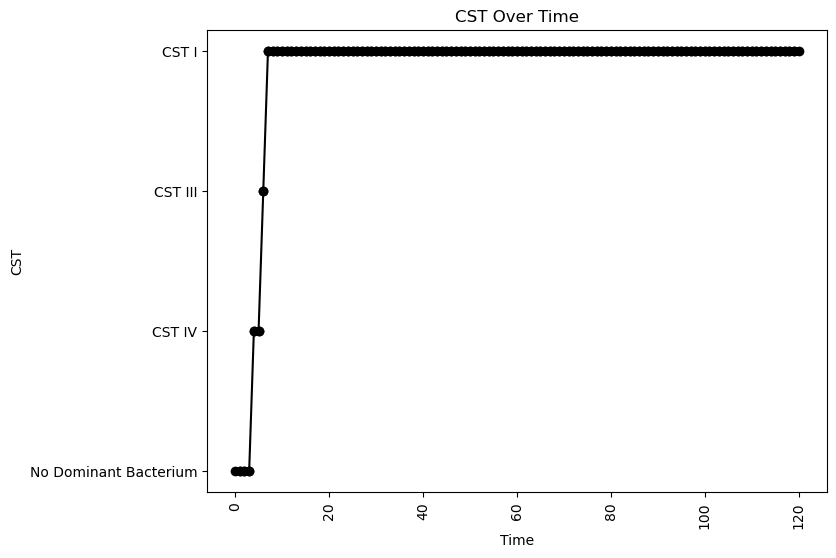


Interaction Parameters:
nAB Growth: 2.2609282147211935
Li Growth: 0.06381435834914458
oLB Growth: 0.1660151901294062
nAB Self: -0.07382307858089426
nAB->Li: 0.20687222716720244
nAB->oLB: -0.2734435699163179
Li->nAB: 0.4064765547730388
Li Self: -0.06704701992965229
Li->oLB: -0.00971092575400545
oLB->nAB: -0.4844509670883654
oLB->Li: 0.47577612711757533
oLB Self: -0.05542196165059505

Simulation 1977 follows a valid CST progression:


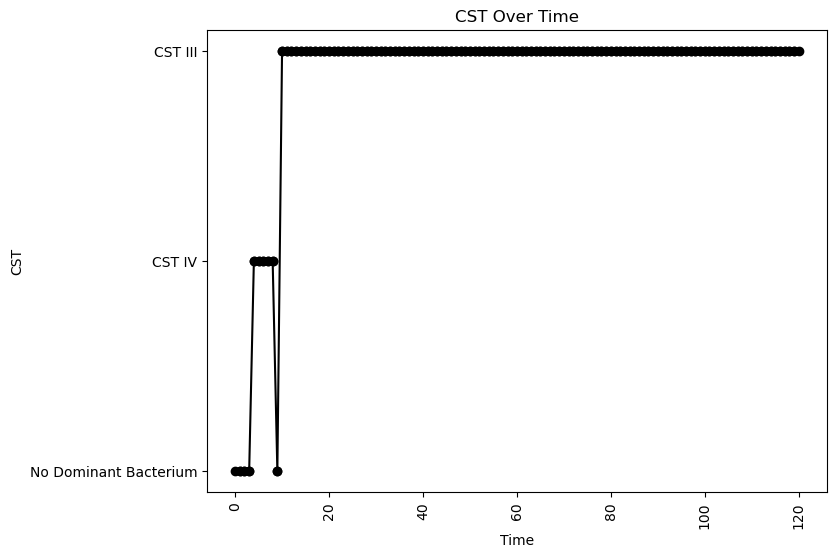


Interaction Parameters:
nAB Growth: 2.186256611128965
Li Growth: 0.06569643521101441
oLB Growth: 0.9552867864056962
nAB Self: -0.03410168143148755
nAB->Li: -0.041877103296653506
nAB->oLB: -0.16815887423318726
Li->nAB: 0.07457670601983901
Li Self: -0.00818679504012873
Li->oLB: 0.04452514093644444
oLB->nAB: -0.033526418960318105
oLB->Li: -0.3905428830395924
oLB Self: -0.0633670106167791

Simulation 1997 follows a valid CST progression:


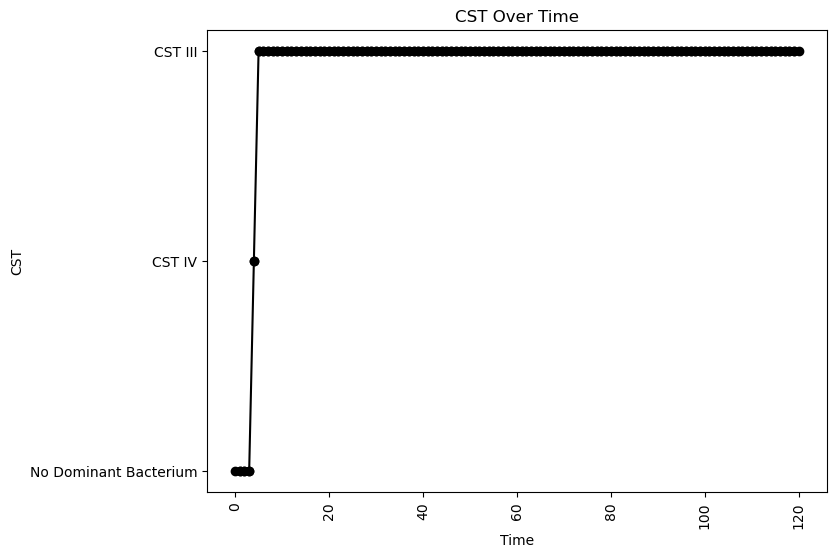


Interaction Parameters:
nAB Growth: 2.273308423784788
Li Growth: 0.24135621745288247
oLB Growth: 0.4879467602516997
nAB Self: -0.04276164743080424
nAB->Li: 0.08162015768714004
nAB->oLB: -0.3039877585155945
Li->nAB: 0.35703738208672786
Li Self: -0.003364529328589466
Li->oLB: -0.20747498431957184
oLB->nAB: -0.21732336646731593
oLB->Li: -0.22896417046763556
oLB Self: -0.06742832463215848

Simulation 2012 follows a valid CST progression:


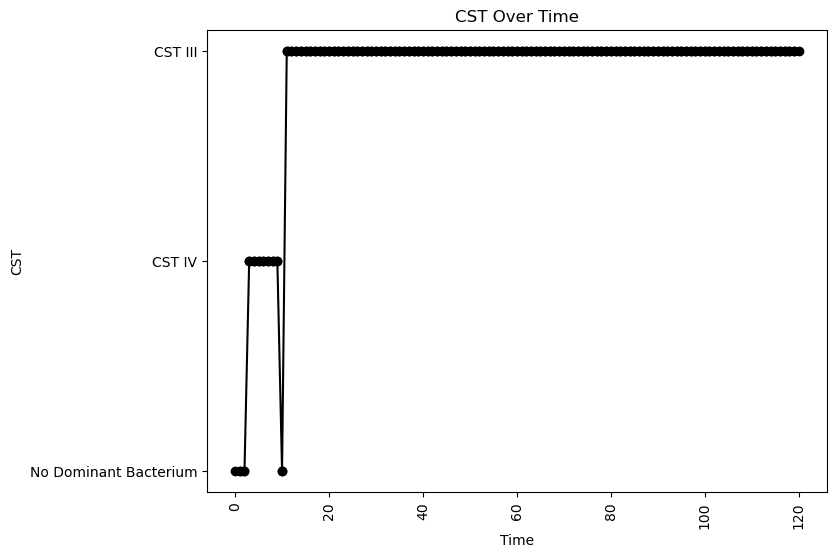


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.08610295958892068
nAB->Li: -0.1330920201407777
nAB->oLB: -0.21001217857944027
Li->nAB: 0.07657042097358291
Li Self: -0.03923044523782125
Li->oLB: -0.39165378652291327
oLB->nAB: -0.3383983216343618
oLB->Li: -0.353672056175782
oLB Self: -0.08323914406011801

Simulation 2016 follows a valid CST progression:


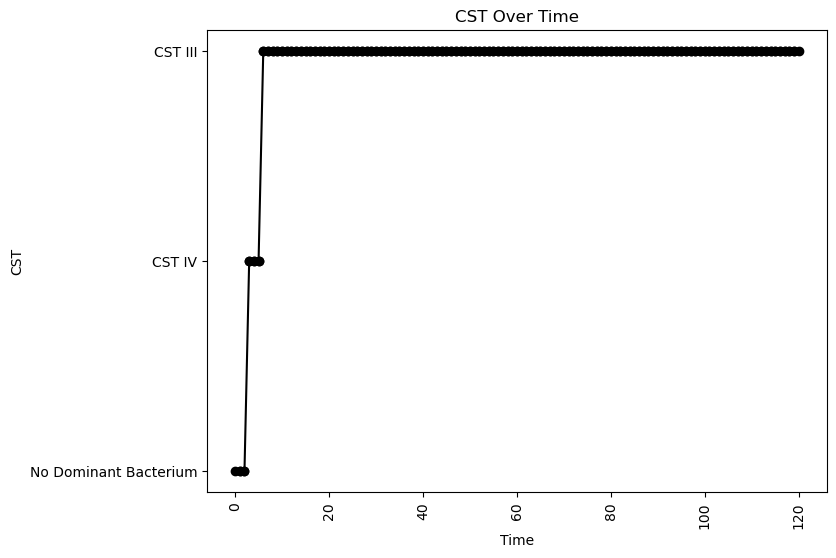


Interaction Parameters:
nAB Growth: 2.2563448832512942
Li Growth: 0.10336607573451531
oLB Growth: 0.40127498600949585
nAB Self: -0.048248005704146474
nAB->Li: 0.01624707103907741
nAB->oLB: -0.08329381130340985
Li->nAB: 0.16759691669016108
Li Self: -0.032072377024518664
Li->oLB: -0.4763915278244986
oLB->nAB: -0.20128238399163828
oLB->Li: -0.11063389629405757
oLB Self: -0.02687486934502807

Simulation 2024 follows a valid CST progression:


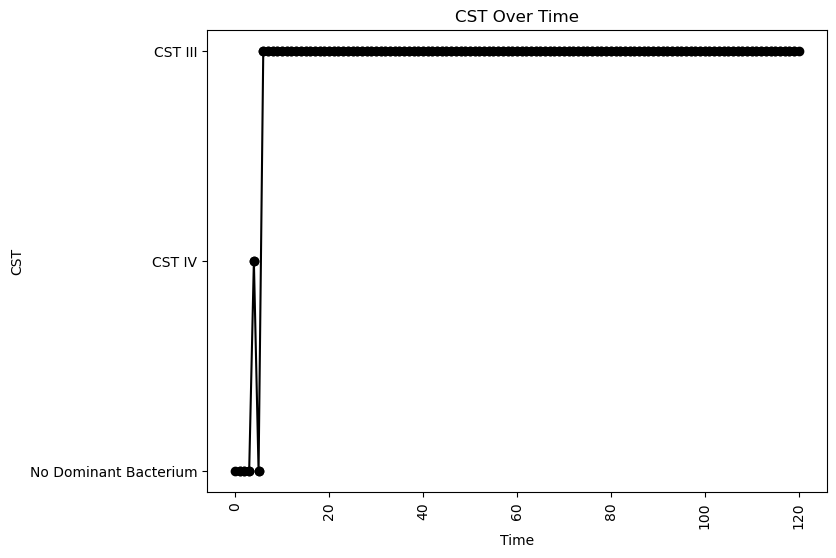


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.19589373480895506
oLB Growth: 0.21113539622386296
nAB Self: -0.043968031343154
nAB->Li: -0.04780301055030156
nAB->oLB: -0.16537939939589175
Li->nAB: 0.35074614850548513
Li Self: -0.09986385796925538
Li->oLB: -0.2982325641347817
oLB->nAB: -0.032015625849119544
oLB->Li: -0.44178652878627805
oLB Self: -0.01900624047274435

Simulation 2026 follows a valid CST progression:


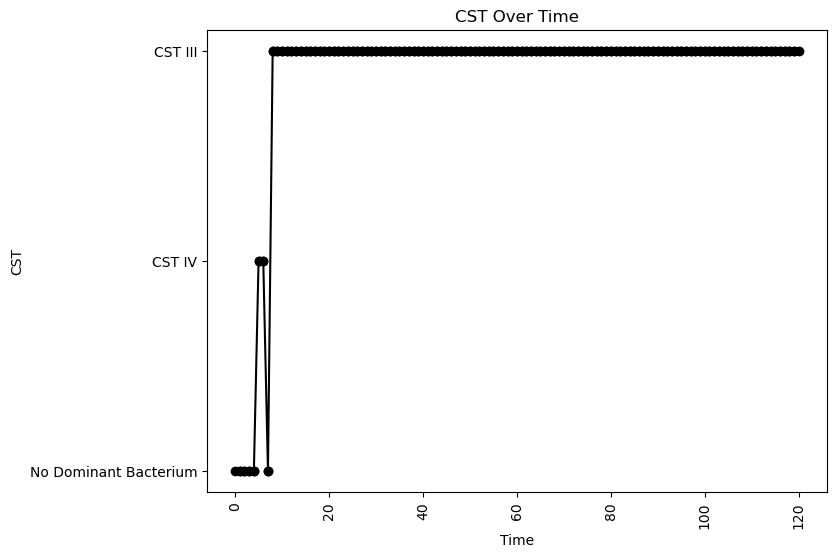


Interaction Parameters:
nAB Growth: 2.2446146183745257
Li Growth: 0.27015111329463093
oLB Growth: 0.5438660619757455
nAB Self: -0.01864567974911402
nAB->Li: -0.4788123763404057
nAB->oLB: -0.049426238093279895
Li->nAB: 0.06686467564288845
Li Self: -0.01734442853801027
Li->oLB: -0.30323550717359604
oLB->nAB: -0.30130217826169525
oLB->Li: -0.05856701392979996
oLB Self: -0.08279874792999684

Simulation 2027 follows a valid CST progression:


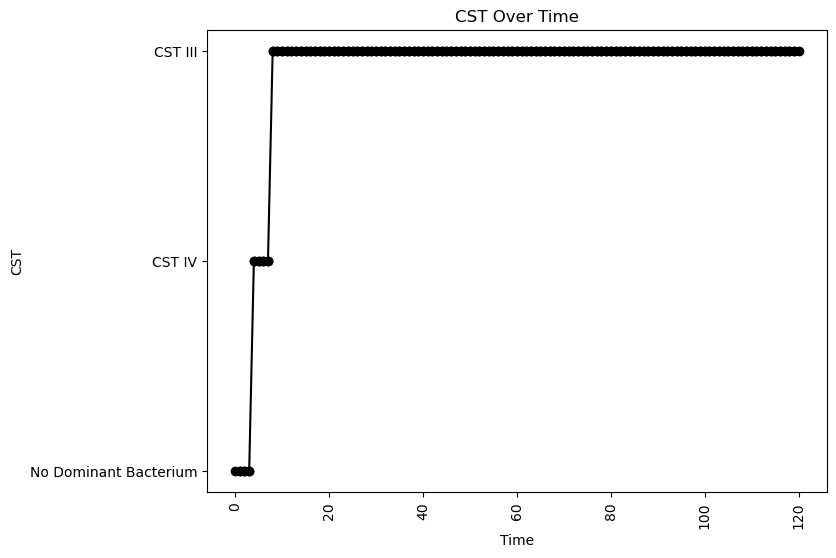


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.03609381594563091
nAB->Li: -0.17459579129517505
nAB->oLB: -0.0301650638106018
Li->nAB: 0.1269627887836785
Li Self: -0.05466063624220029
Li->oLB: -0.010854588477754556
oLB->nAB: -0.24574079549154604
oLB->Li: -0.07033002677843758
oLB Self: -0.06878114629445362

Simulation 2028 follows a valid CST progression:


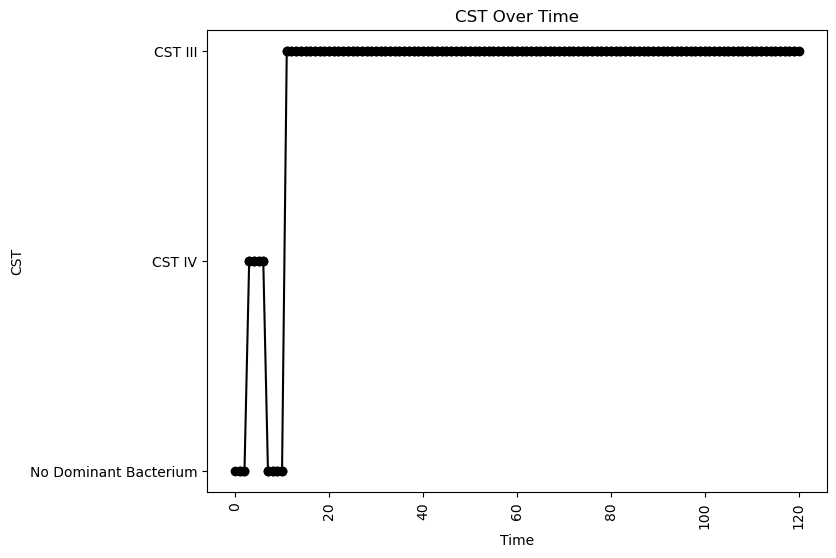


Interaction Parameters:
nAB Growth: 2.300652803872004
Li Growth: 0.06616501714537036
oLB Growth: 0.4369767544558836
nAB Self: -0.03755318842207354
nAB->Li: -0.014118574458926059
nAB->oLB: -0.22977604376956173
Li->nAB: 0.11802612794262246
Li Self: -0.09437944888403418
Li->oLB: 0.3317547519146835
oLB->nAB: -0.09221304907251299
oLB->Li: 0.11823126717936105
oLB Self: -0.025643038655657785

Simulation 2029 follows a valid CST progression:


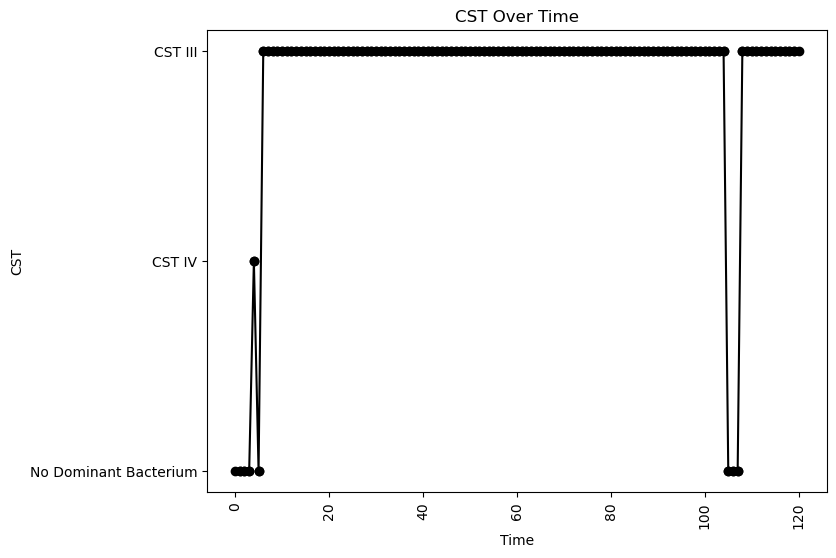


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.2743597356395586
oLB Growth: 0.7070472171500886
nAB Self: -0.0043149644541131404
nAB->Li: -0.09098715292719145
nAB->oLB: -0.2057250474837568
Li->nAB: 0.24274788745217957
Li Self: -0.06568125563439414
Li->oLB: -0.2139281634521547
oLB->nAB: -0.30067171686053107
oLB->Li: 0.02878659294624808
oLB Self: -0.08100753549269486

Simulation 2030 follows a valid CST progression:


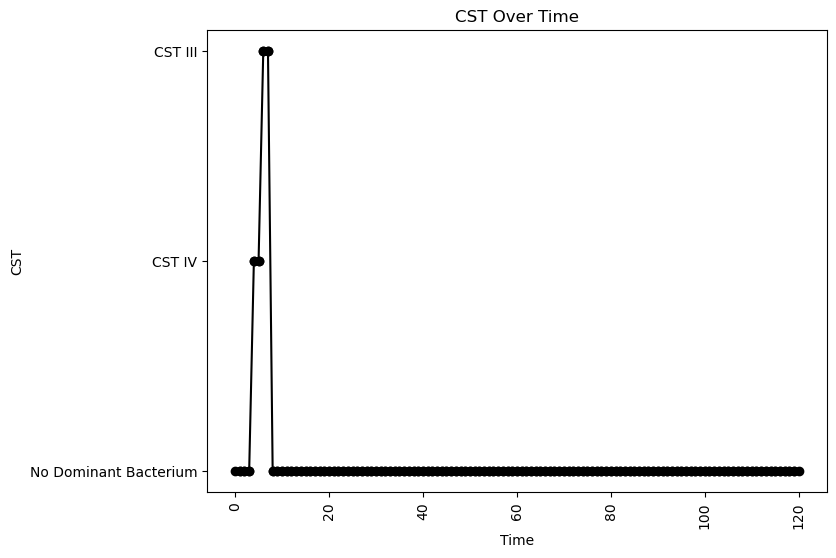


Interaction Parameters:
nAB Growth: 2.284416841880324
Li Growth: 0.06886020002136616
oLB Growth: 0.35838896078112936
nAB Self: -0.007402052292514935
nAB->Li: -0.09892166607257774
nAB->oLB: -0.23192109686023582
Li->nAB: 0.36990518842284037
Li Self: -0.02995169158226807
Li->oLB: 0.26464881934162965
oLB->nAB: -0.3211887456838349
oLB->Li: 0.2132485515758702
oLB Self: -0.033087826884827184

Simulation 2035 follows a valid CST progression:


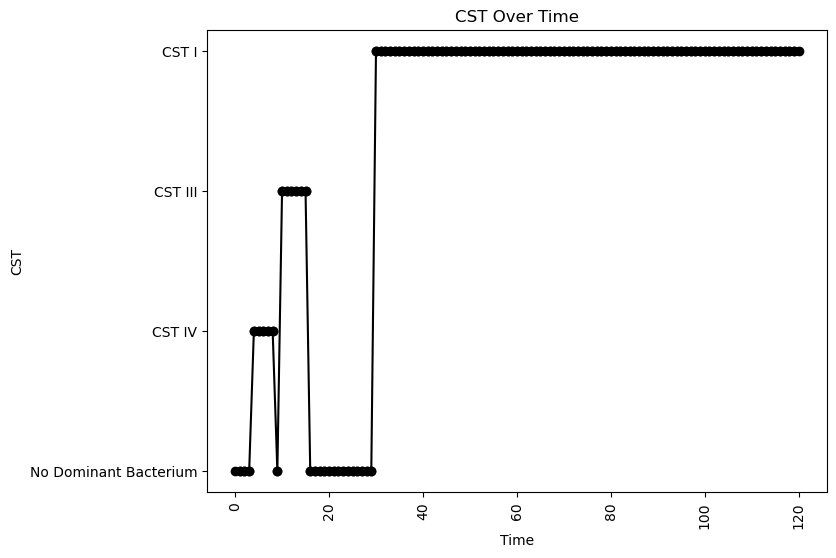


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.06495430992206574
oLB Growth: 0.1731103059651596
nAB Self: -0.051659277008485584
nAB->Li: -0.45429997401760086
nAB->oLB: -0.33092458509343126
Li->nAB: 0.11328778814732543
Li Self: -0.09891888947284568
Li->oLB: 0.10379684521632737
oLB->nAB: -0.406495309535702
oLB->Li: 0.3801770483226986
oLB Self: -0.031296271128678554

Simulation 2040 follows a valid CST progression:


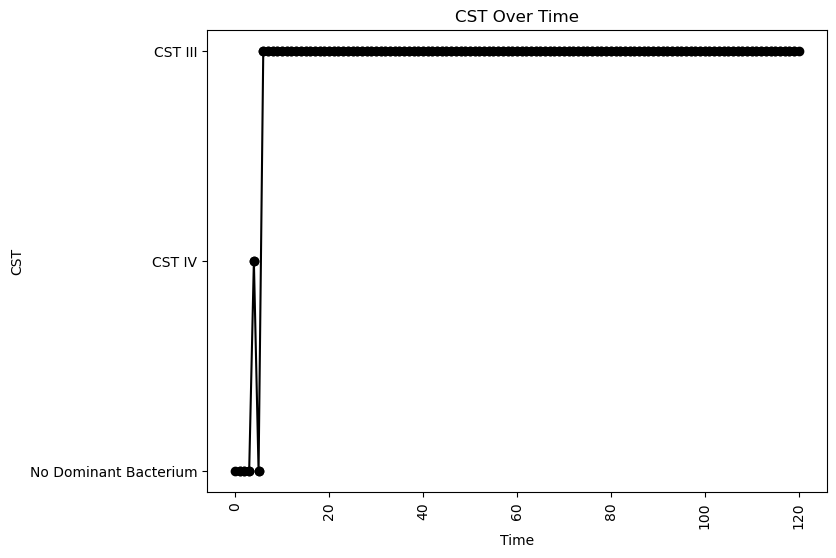


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.24335137747509744
oLB Growth: 0.7334429546888279
nAB Self: -0.08934140738125776
nAB->Li: 0.04549989080409644
nAB->oLB: -0.23983665319921127
Li->nAB: 0.38140146928311647
Li Self: -0.06220071577354801
Li->oLB: -0.3383926811868666
oLB->nAB: -0.11582921232291132
oLB->Li: -0.2860459530741768
oLB Self: -0.031007244647464738

Simulation 2044 follows a valid CST progression:


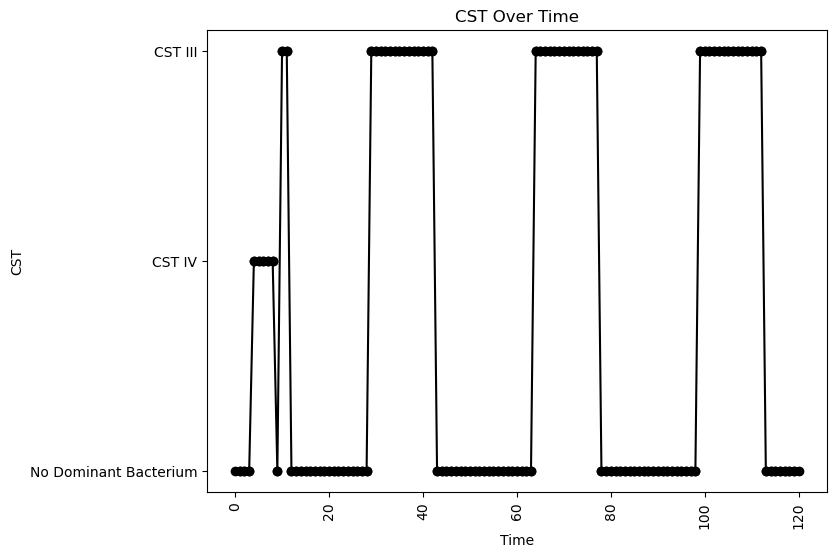


Interaction Parameters:
nAB Growth: 2.284416841880324
Li Growth: 0.06886020002136616
oLB Growth: 0.35838896078112936
nAB Self: -0.022643702098925467
nAB->Li: -0.20671714459279839
nAB->oLB: -0.3058880393924115
Li->nAB: 0.0945278131469699
Li Self: -0.09432644165638357
Li->oLB: 0.3425966549527484
oLB->nAB: -0.3422612556134763
oLB->Li: -0.25601650726377434
oLB Self: -0.07578142473976941

Simulation 2047 follows a valid CST progression:


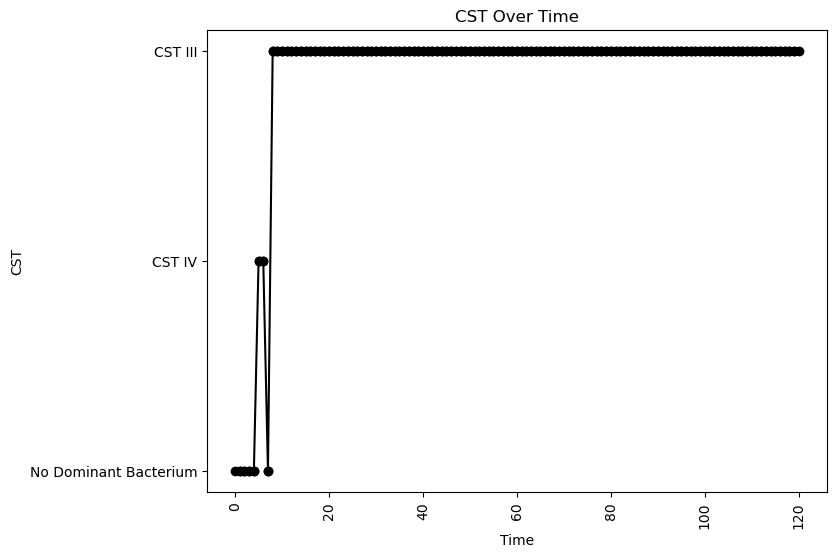


Interaction Parameters:
nAB Growth: 2.2563448832512942
Li Growth: 0.07234741829114298
oLB Growth: 0.40127498600949585
nAB Self: -0.03747791124914131
nAB->Li: -0.0813176485526304
nAB->oLB: -0.3906738664014044
Li->nAB: 0.3415715277347584
Li Self: -0.01847413819230774
Li->oLB: 0.4883831469500888
oLB->nAB: -0.0897613311371886
oLB->Li: -0.10839336385531795
oLB Self: -0.01512615064279399

Simulation 2049 follows a valid CST progression:


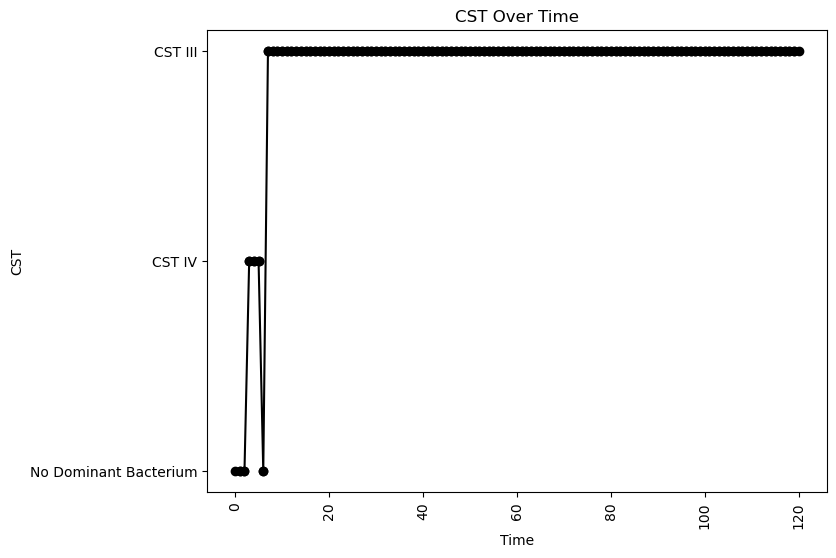


Interaction Parameters:
nAB Growth: 2.237390108639889
Li Growth: 0.07509700685781084
oLB Growth: 0.33048149496262014
nAB Self: -0.09550504167288984
nAB->Li: 0.20498463028428393
nAB->oLB: -0.18124469824613676
Li->nAB: 0.30400425268277076
Li Self: -0.057411237711775365
Li->oLB: 0.32539414412597123
oLB->nAB: -0.21828069490611468
oLB->Li: -0.3046513420855608
oLB Self: -0.07243636192535902

Simulation 2051 follows a valid CST progression:


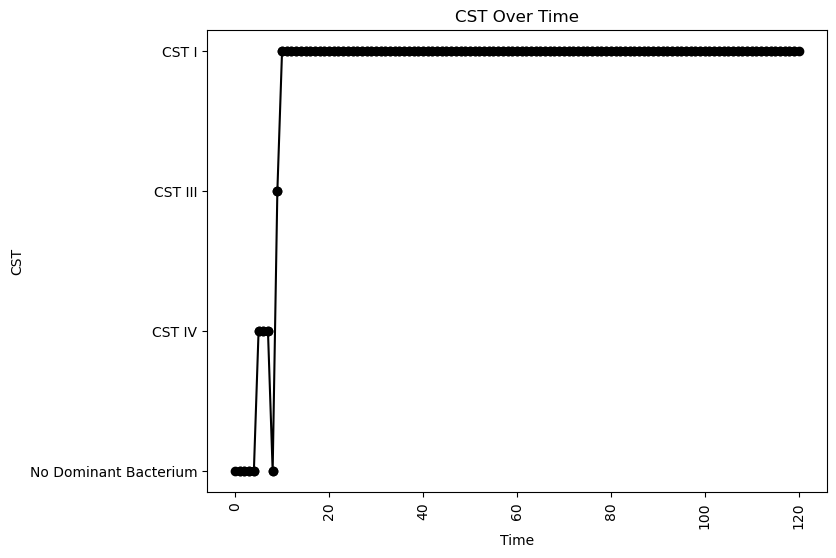


Interaction Parameters:
nAB Growth: 2.2563448832512942
Li Growth: 0.07234741829114298
oLB Growth: 0.40127498600949585
nAB Self: -0.07174655504980035
nAB->Li: -0.1826789487894782
nAB->oLB: -0.3250761808670989
Li->nAB: 0.33741266057303887
Li Self: -0.06932425250328107
Li->oLB: -0.3095723568505786
oLB->nAB: -0.24867375900096222
oLB->Li: 0.4481472663110406
oLB Self: -0.006473988511212697

Simulation 2052 follows a valid CST progression:


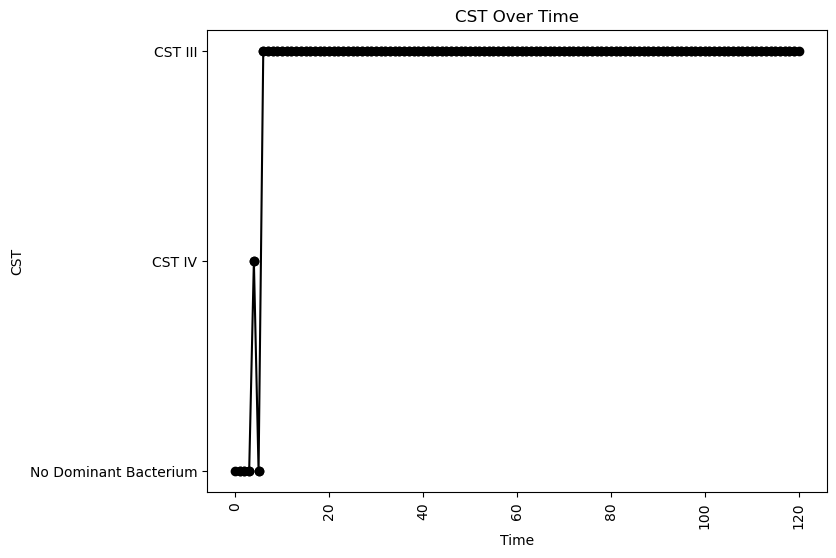


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.07633888587985994
nAB->Li: 0.226243934787563
nAB->oLB: -0.21948491256049296
Li->nAB: 0.49002036453484865
Li Self: -0.08436986464338068
Li->oLB: -0.15148160355478107
oLB->nAB: -0.20113945101558423
oLB->Li: 0.19821072646128524
oLB Self: -0.09773302083939982

Simulation 2054 follows a valid CST progression:


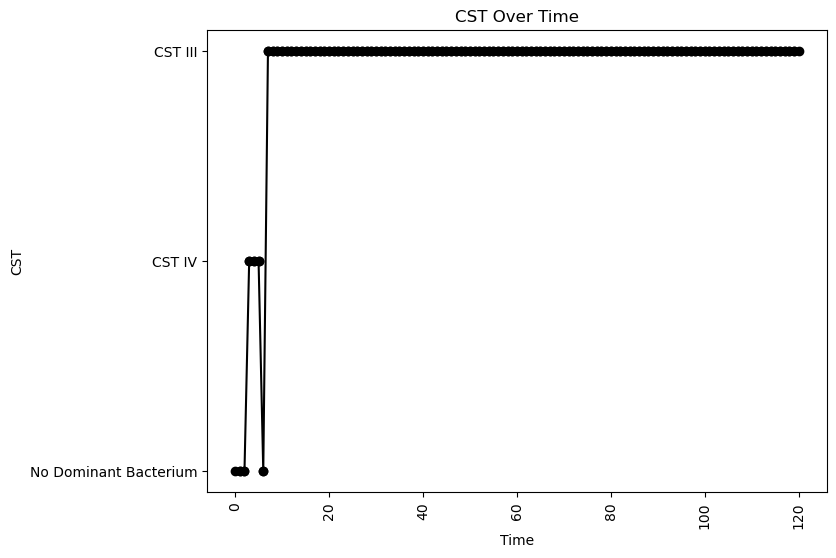


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.03291986618771797
nAB->Li: -0.35925427158144474
nAB->oLB: -0.1175568311221174
Li->nAB: 0.3385781446160444
Li Self: -0.01778760732414182
Li->oLB: -0.3761350077337227
oLB->nAB: -0.35187976773537044
oLB->Li: -0.10175031681823671
oLB Self: -0.02159348410628885

Simulation 2056 follows a valid CST progression:


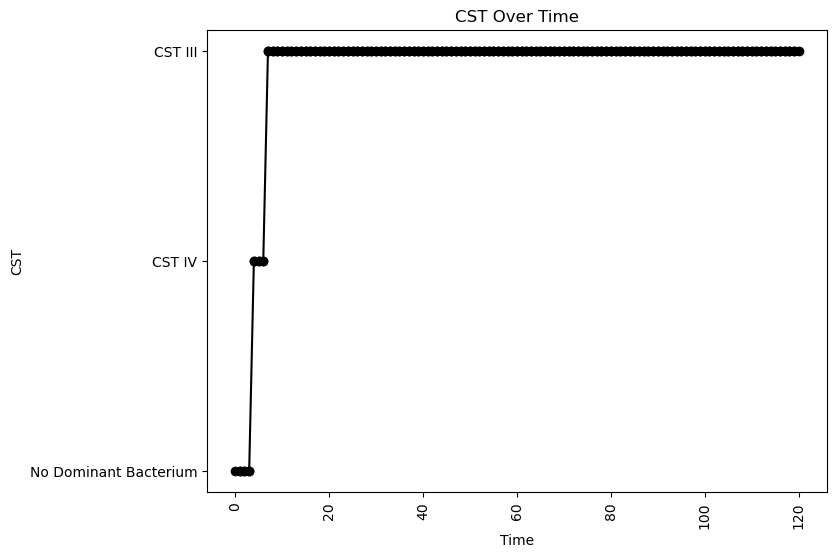


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.08930083796492881
oLB Growth: 0.7070472171500886
nAB Self: -0.07917686950413011
nAB->Li: 0.10803205143989625
nAB->oLB: -0.4028455697987886
Li->nAB: 0.19181001040661405
Li Self: -0.0366776061090293
Li->oLB: -0.11190490154294536
oLB->nAB: -0.24856265976254005
oLB->Li: -0.16921329722190687
oLB Self: -0.0821719956641638

Simulation 2058 follows a valid CST progression:


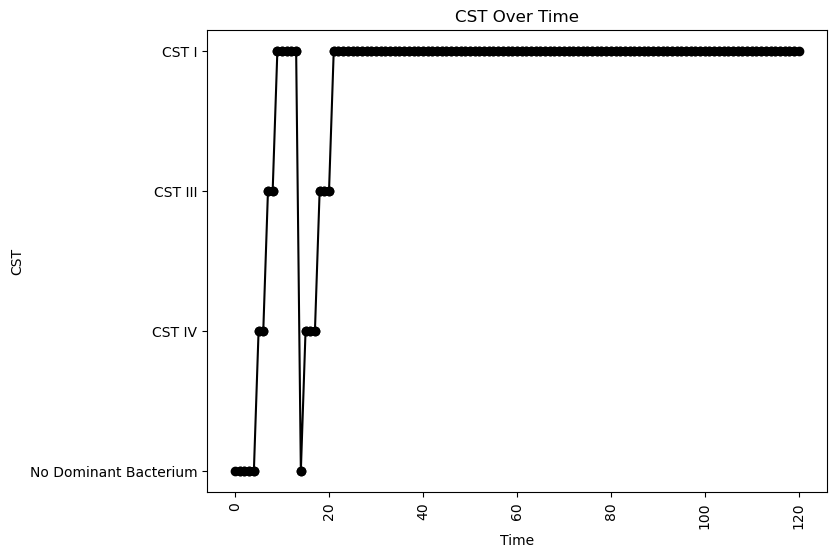


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.0800762487953794
nAB->Li: -0.3162324823249461
nAB->oLB: -0.22167845551284554
Li->nAB: 0.35203623819542473
Li Self: -0.034484710846023794
Li->oLB: -0.39632702331915853
oLB->nAB: -0.3610214621743959
oLB->Li: 0.3946215436933539
oLB Self: -0.06372088319346797

Simulation 2060 follows a valid CST progression:


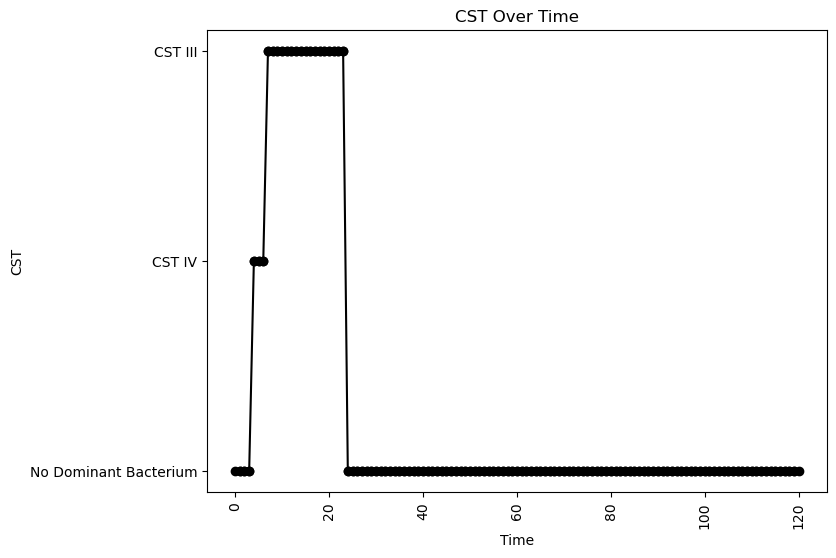


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.13523311626861756
oLB Growth: 0.16744057753178704
nAB Self: -0.07571695460761325
nAB->Li: 0.10418438184135603
nAB->oLB: -0.26335106392941604
Li->nAB: 0.1257696686876475
Li Self: -0.0035852101550695736
Li->oLB: -0.03998389557136944
oLB->nAB: -0.4790901701573673
oLB->Li: -0.2569195565059156
oLB Self: -0.020396836455014125

Simulation 2064 follows a valid CST progression:


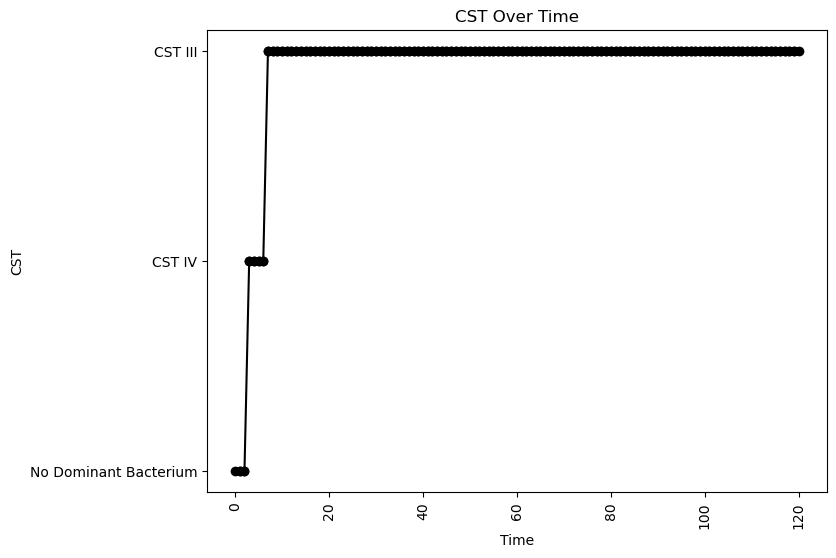


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.019819653244438976
nAB->Li: -0.026284393504852177
nAB->oLB: -0.316739820127797
Li->nAB: 0.1695928801658576
Li Self: -0.06731409914902747
Li->oLB: 0.25868585630104557
oLB->nAB: -0.4897285120871743
oLB->Li: -0.1557872065273188
oLB Self: -0.05894587097306939

Simulation 2068 follows a valid CST progression:


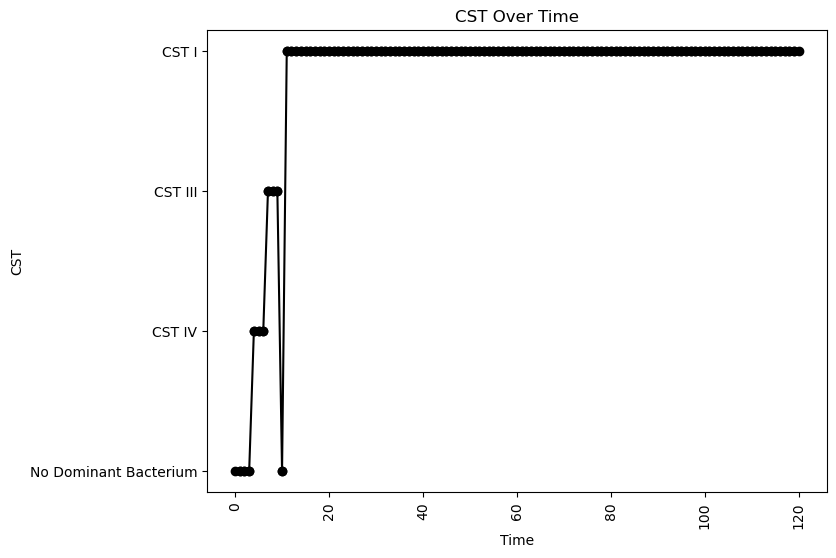


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.07424852195227598
nAB->Li: -0.3935026757036428
nAB->oLB: -0.390387160338186
Li->nAB: 0.27236087558350386
Li Self: -0.025703582228942604
Li->oLB: -0.05052387972418931
oLB->nAB: -0.0022653300558372336
oLB->Li: 0.17702315728202855
oLB Self: -0.07264160581865223

Simulation 2069 follows a valid CST progression:


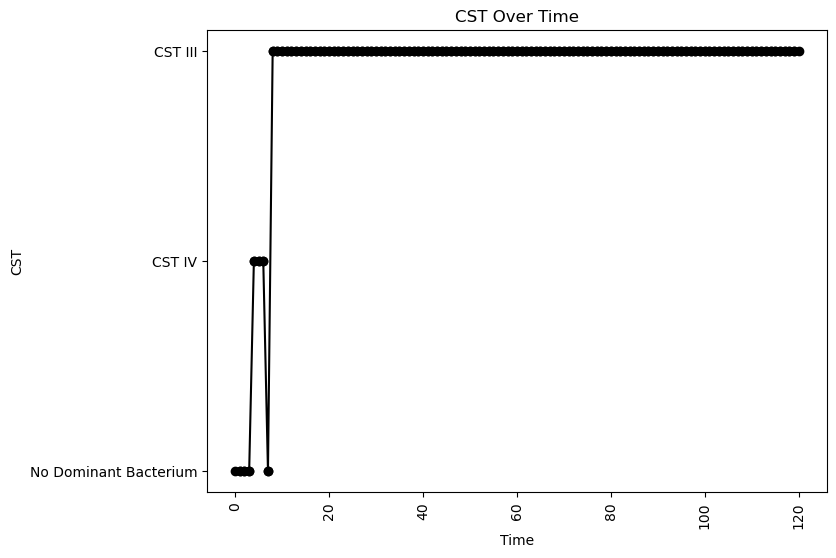


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.06037082911967326
nAB->Li: -0.37479701096865414
nAB->oLB: -0.2240112915414933
Li->nAB: 0.20341950782289075
Li Self: -0.0015065488778940317
Li->oLB: -0.2754838219495579
oLB->nAB: -0.3624707166911003
oLB->Li: -0.26297540470948455
oLB Self: -0.016102327852264217

Simulation 2081 follows a valid CST progression:


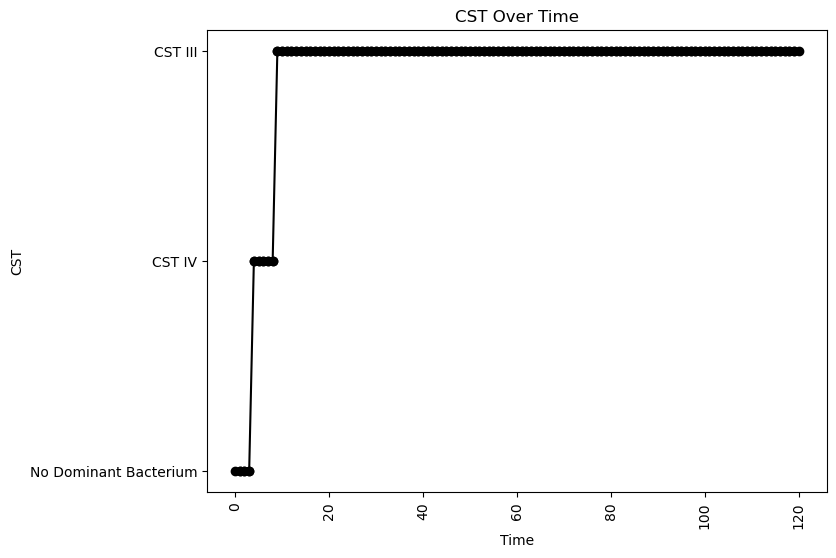


Interaction Parameters:
nAB Growth: 2.284416841880324
Li Growth: 0.06886020002136616
oLB Growth: 0.35838896078112936
nAB Self: -0.0770353362186773
nAB->Li: -0.08874194578774547
nAB->oLB: -0.12653869719352195
Li->nAB: 0.12761716443978965
Li Self: -0.060181513234827795
Li->oLB: -0.03643191521162664
oLB->nAB: -0.13778829215356903
oLB->Li: -0.37557786210889765
oLB Self: -0.04382547191914891

Simulation 2085 follows a valid CST progression:


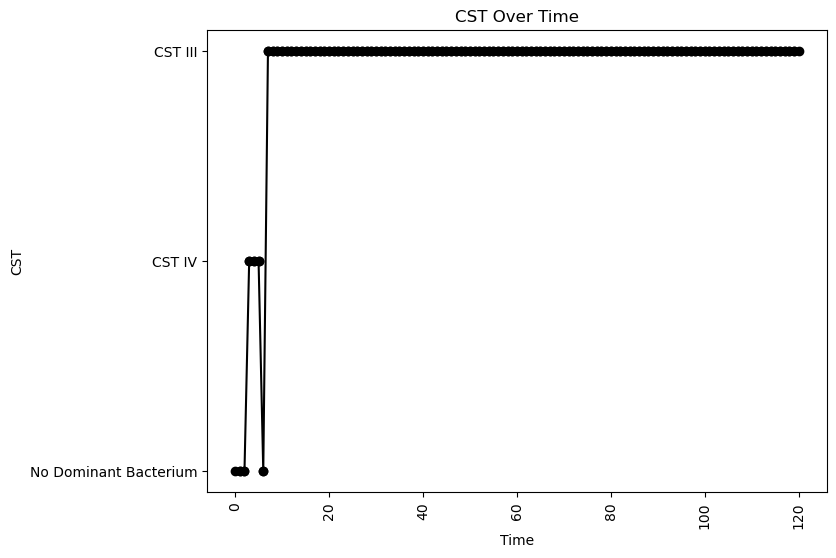


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.07356375630159835
nAB->Li: -0.3242804600693461
nAB->oLB: -0.17807121384270125
Li->nAB: 0.31604259834426984
Li Self: -0.09719432633497228
Li->oLB: 0.14738873913950878
oLB->nAB: -0.07499395066401698
oLB->Li: -0.4882228468722959
oLB Self: -0.003302054217891412

Simulation 2088 follows a valid CST progression:


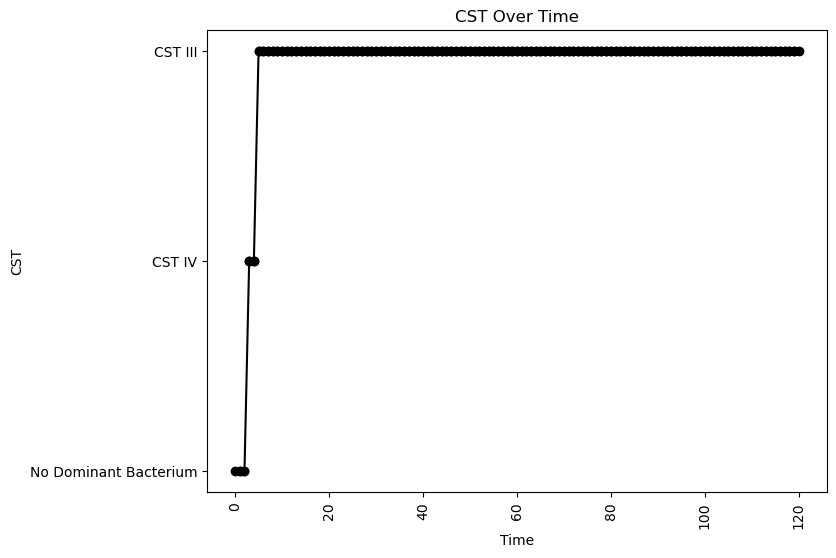


Interaction Parameters:
nAB Growth: 2.273308423784788
Li Growth: 0.06939466945066827
oLB Growth: 0.4879467602516997
nAB Self: -0.05294416987456023
nAB->Li: 0.2848794504683513
nAB->oLB: -0.23146049011251113
Li->nAB: 0.4799819926268739
Li Self: -0.0377066962679322
Li->oLB: -0.3954321890555719
oLB->nAB: -0.10105022895272742
oLB->Li: 0.1271797326812114
oLB Self: -0.09918940845675571

Simulation 2095 follows a valid CST progression:


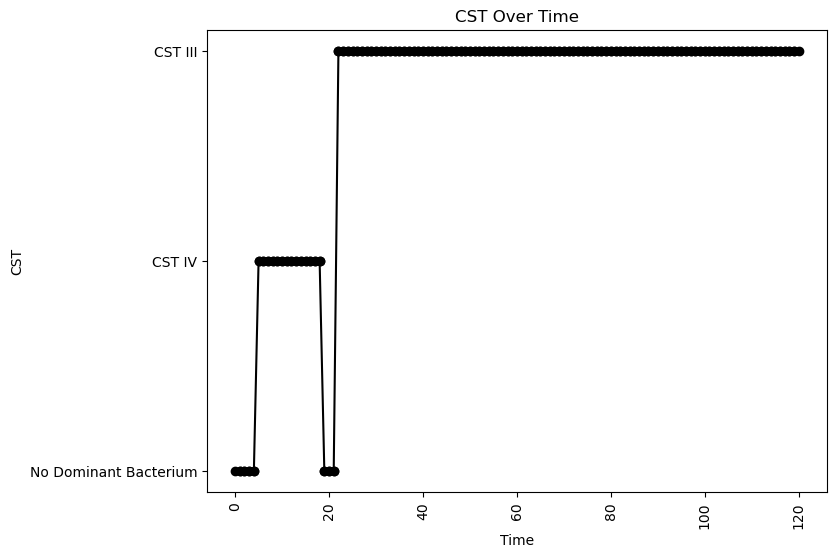


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.08479757751978889
oLB Growth: 1.155917868199191
nAB Self: -0.045578572544229666
nAB->Li: -0.224083497319781
nAB->oLB: -0.43752605352786045
Li->nAB: 0.006431582131210534
Li Self: -0.0014612198743804566
Li->oLB: -0.4075912026946839
oLB->nAB: -0.00973352012090234
oLB->Li: -0.17149289522153655
oLB Self: -0.08306471289811289

Simulation 2098 follows a valid CST progression:


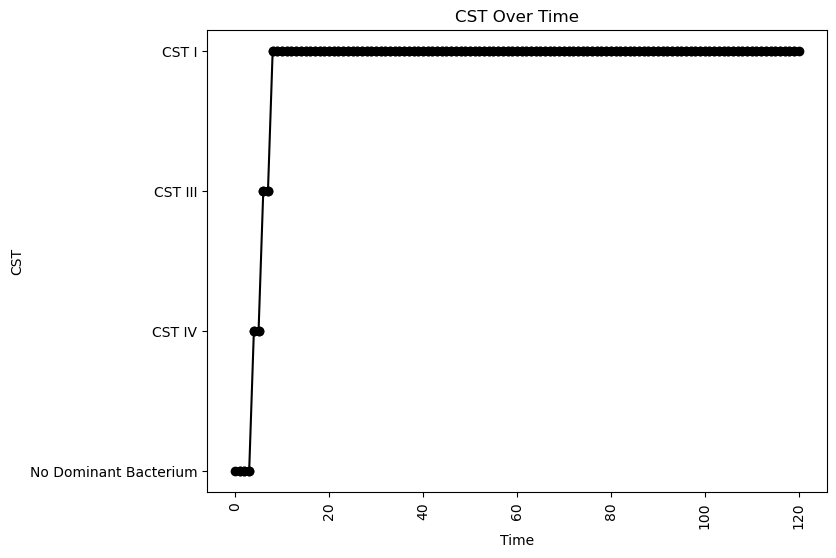


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.021009167377865
nAB->Li: 0.15546576916331678
nAB->oLB: -0.43078566667913726
Li->nAB: 0.4863143377717667
Li Self: -0.08875974957734
Li->oLB: -0.2955866387050196
oLB->nAB: -0.302768569795541
oLB->Li: 0.3029588634434093
oLB Self: -0.08539097186459418

Simulation 2100 follows a valid CST progression:


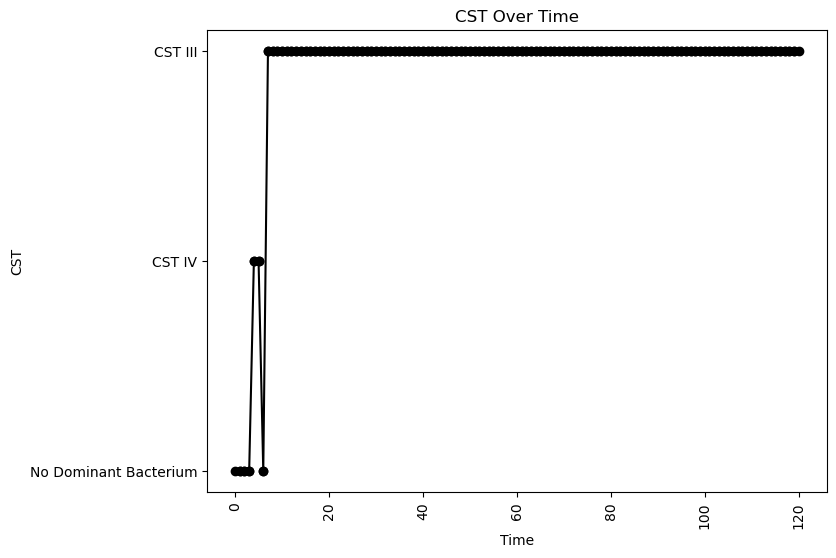


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.03023924721038644
nAB->Li: -0.11280319240134112
nAB->oLB: -0.2914532767880267
Li->nAB: 0.36776779140300986
Li Self: -0.0023134756534212014
Li->oLB: -0.43349266238150386
oLB->nAB: -0.20554275722915083
oLB->Li: -0.15065545742444425
oLB Self: -0.0829156025079729

Simulation 2110 follows a valid CST progression:


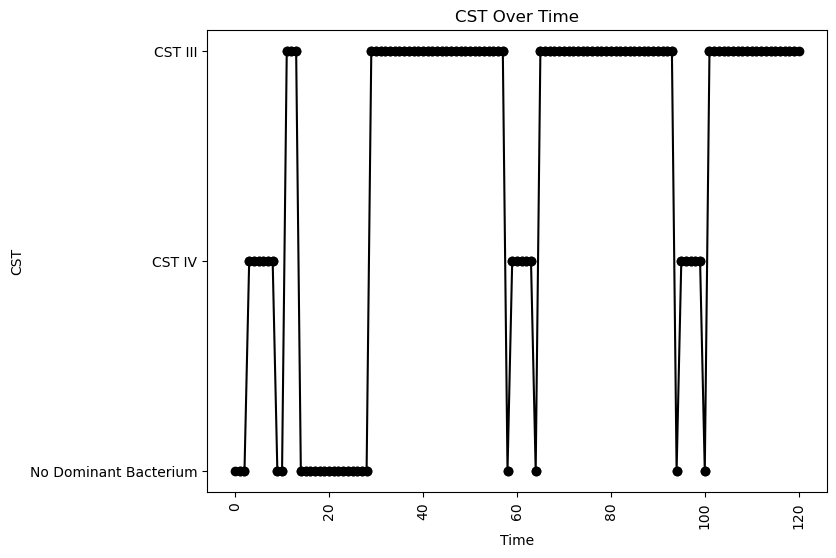


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.04549975242017431
nAB->Li: -0.4111839404790907
nAB->oLB: -0.10082254377572858
Li->nAB: 0.0639109486655145
Li Self: -0.07250289447390632
Li->oLB: 0.012428620412673341
oLB->nAB: -0.4798563272595239
oLB->Li: -0.36658480064303367
oLB Self: -0.0030026618016930073

Simulation 2114 follows a valid CST progression:


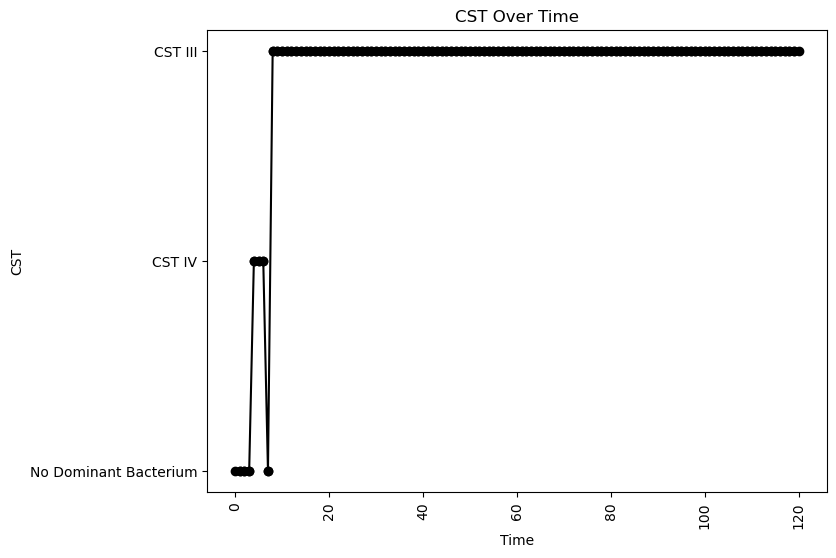


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.1140289798711446
oLB Growth: 0.11031283255203692
nAB Self: -0.046392843190801294
nAB->Li: -0.1006365965663632
nAB->oLB: -0.33006151123577465
Li->nAB: 0.15898075867617711
Li Self: -0.07772732452474754
Li->oLB: 0.09678605330075019
oLB->nAB: -0.3453770185402756
oLB->Li: -0.2639891196170338
oLB Self: -0.04353043167148305

Simulation 2116 follows a valid CST progression:


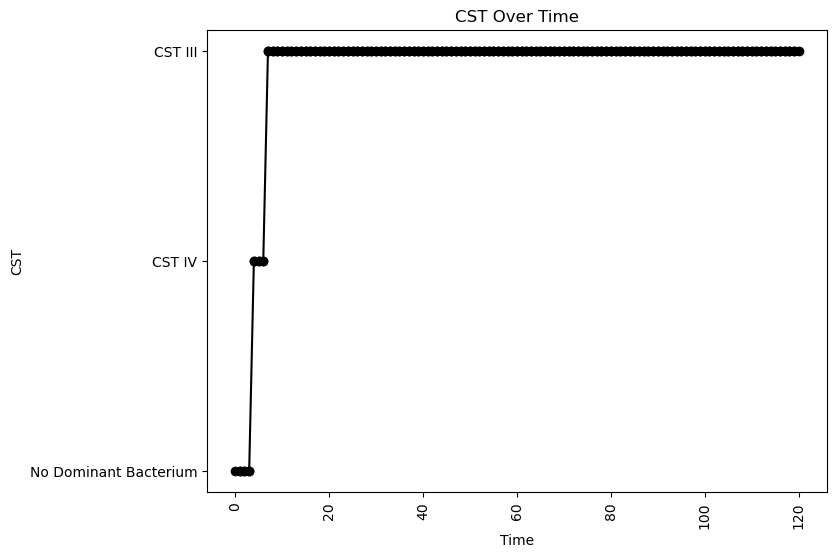


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.0059879730343234405
nAB->Li: -0.1315739220088089
nAB->oLB: -0.034950430032195945
Li->nAB: 0.1830329389178036
Li Self: -0.08034025947363863
Li->oLB: 0.39388514243400286
oLB->nAB: -0.0498443460131181
oLB->Li: -0.12062406986818847
oLB Self: -0.03469393509582966

Simulation 2121 follows a valid CST progression:


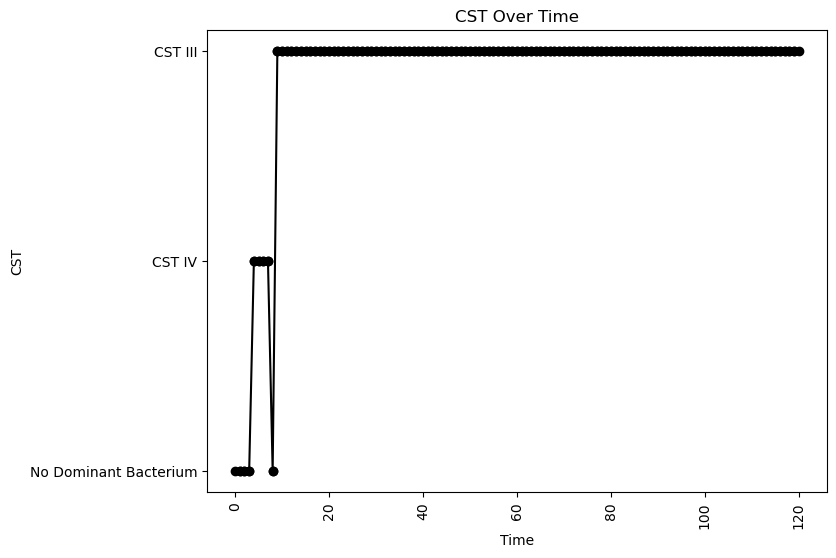


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.08269680708439747
nAB->Li: 0.1132713616355282
nAB->oLB: -0.48778776064069473
Li->nAB: 0.1198734609238935
Li Self: -0.013901654087969895
Li->oLB: 0.37306360363220714
oLB->nAB: -0.3757617992439894
oLB->Li: -0.2749392080387401
oLB Self: -0.08142898811587145

Simulation 2124 follows a valid CST progression:


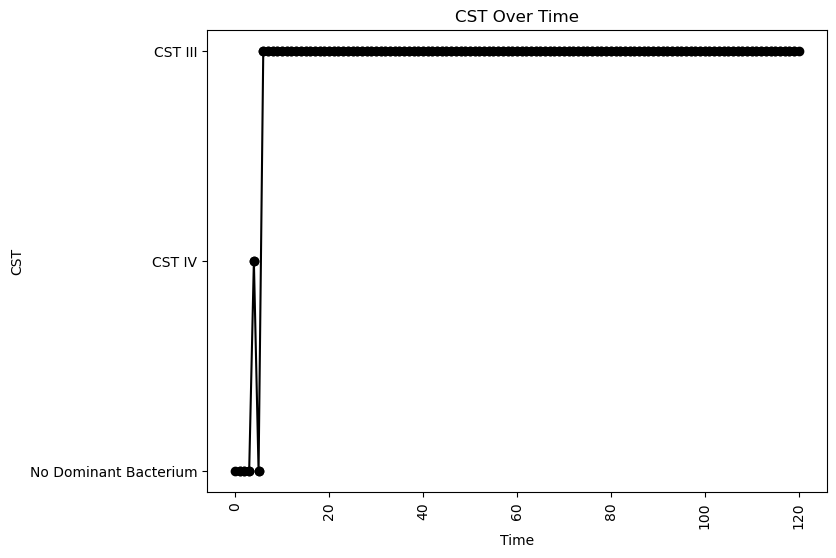


Interaction Parameters:
nAB Growth: 2.286323001067126
Li Growth: 0.1929084463126913
oLB Growth: 0.14091260068383374
nAB Self: -0.041097889002518574
nAB->Li: -0.3040071800474502
nAB->oLB: -0.23777186827943053
Li->nAB: 0.2486978246605236
Li Self: -0.0339223447159412
Li->oLB: -0.2487699595653025
oLB->nAB: -0.4598448557057647
oLB->Li: -0.10009506609755425
oLB Self: -0.07622356513272802

Simulation 2132 follows a valid CST progression:


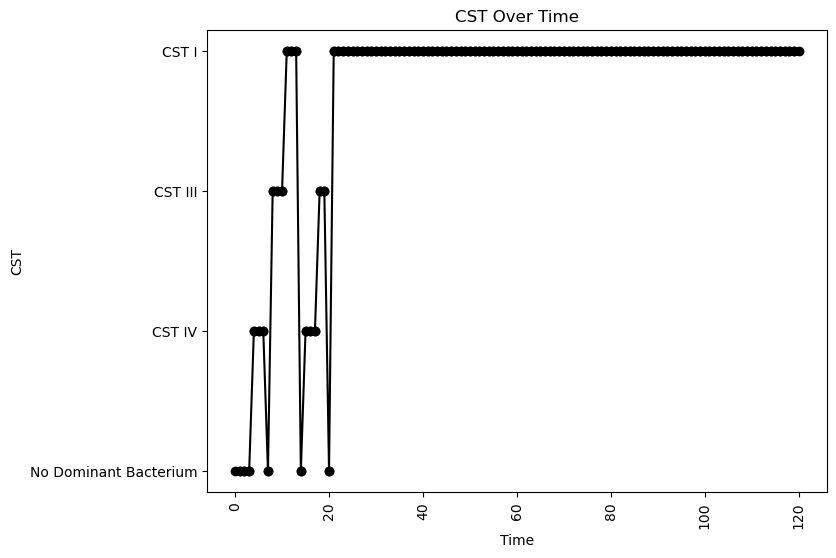


Interaction Parameters:
nAB Growth: 2.237390108639889
Li Growth: 0.07509700685781084
oLB Growth: 0.33048149496262014
nAB Self: -0.050941096516436135
nAB->Li: -0.2008636228268424
nAB->oLB: -0.04306569695424167
Li->nAB: 0.26385036320566446
Li Self: -0.06834626962004822
Li->oLB: -0.2718008932027469
oLB->nAB: -0.3554673855021695
oLB->Li: 0.3338029890150549
oLB Self: -0.002333533432733209

Simulation 2134 follows a valid CST progression:


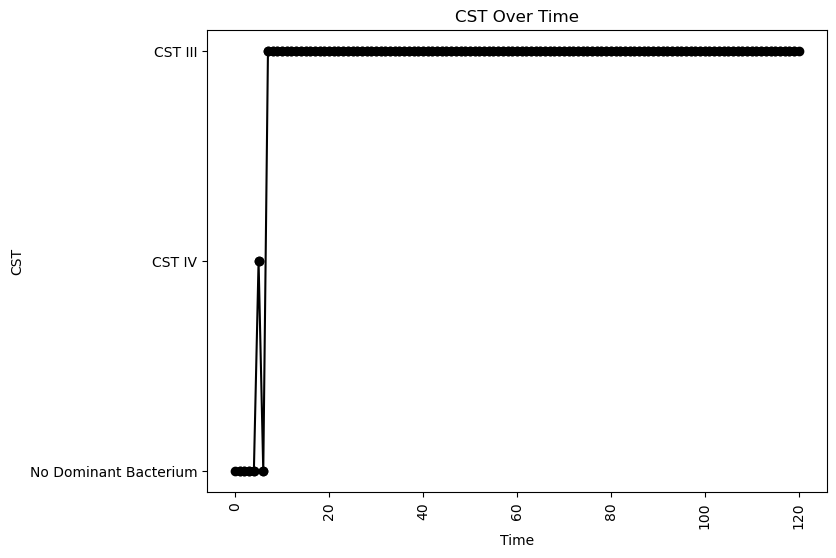


Interaction Parameters:
nAB Growth: 2.2563448832512942
Li Growth: 0.07234741829114298
oLB Growth: 0.40127498600949585
nAB Self: -0.08101998589528349
nAB->Li: -0.3003010484295725
nAB->oLB: -0.32944950313331867
Li->nAB: 0.341799561919668
Li Self: -0.05779688217213164
Li->oLB: -0.22447704610010033
oLB->nAB: -0.17936930801588674
oLB->Li: -0.43597181285643816
oLB Self: -0.05302641666449337

Simulation 2137 follows a valid CST progression:


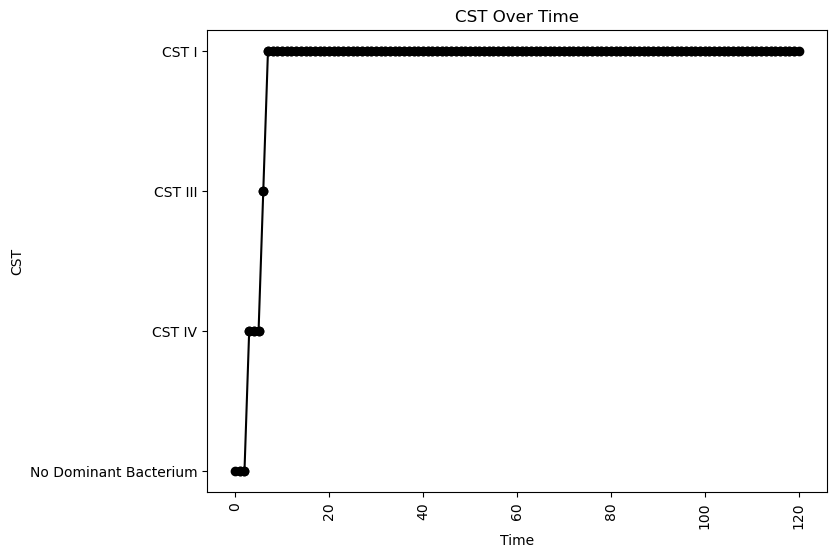


Interaction Parameters:
nAB Growth: 2.292952252819776
Li Growth: 0.06862578763464611
oLB Growth: 0.25066683866219575
nAB Self: -0.07870306486028364
nAB->Li: -0.036894023819798616
nAB->oLB: -0.19391875979581885
Li->nAB: 0.31209508411392706
Li Self: -0.06643456941855853
Li->oLB: -0.32679167522665864
oLB->nAB: -0.47617552894421056
oLB->Li: 0.4710397729219483
oLB Self: -0.020564288157029112

Simulation 2144 follows a valid CST progression:


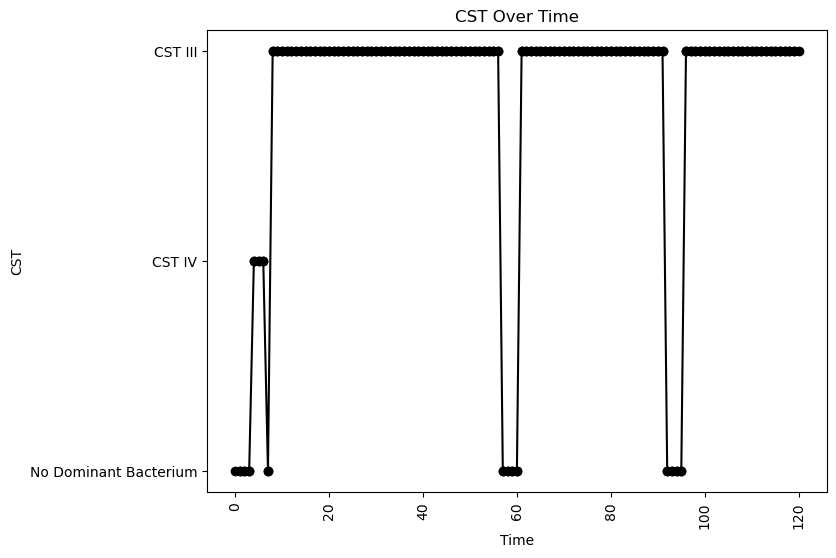


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.14160106407805498
oLB Growth: 0.8024693458968353
nAB Self: -0.06783767435256416
nAB->Li: -0.34664443198707684
nAB->oLB: -0.4546938252892647
Li->nAB: 0.1533759132814222
Li Self: -0.08154182278767502
Li->oLB: 0.09954308488252084
oLB->nAB: -0.48035017604178937
oLB->Li: -0.4661003663340452
oLB Self: -0.03992458257901825

Simulation 2147 follows a valid CST progression:


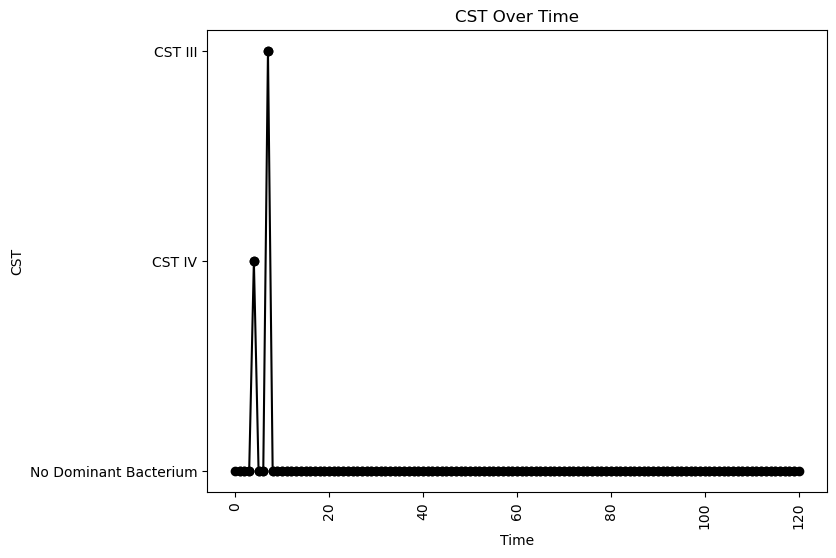


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.05869477410718912
nAB->Li: -0.3585558755117057
nAB->oLB: -0.4306208537409411
Li->nAB: 0.30550206645531397
Li Self: -0.0861666739946608
Li->oLB: 0.38791773530651275
oLB->nAB: -0.19535361233996645
oLB->Li: 0.39358721675779107
oLB Self: -0.008357123410213357

Simulation 2157 follows a valid CST progression:


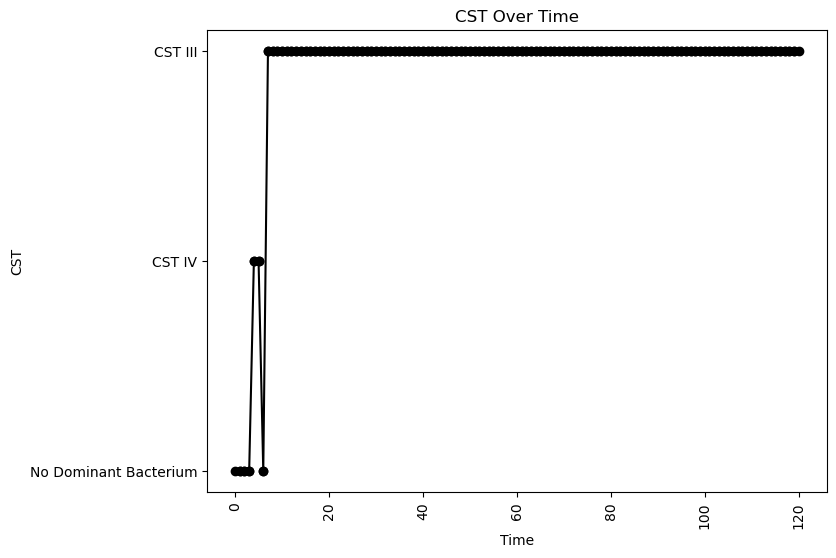


Interaction Parameters:
nAB Growth: 2.2657644953374403
Li Growth: 0.07173881162026666
oLB Growth: 0.2949021384914317
nAB Self: -0.06326752922864085
nAB->Li: 0.14984779936543668
nAB->oLB: -0.03253679041833396
Li->nAB: 0.3354825067612772
Li Self: -0.03934715151880876
Li->oLB: -0.23931233774693733
oLB->nAB: -0.022798907909304056
oLB->Li: -0.03144389332861508
oLB Self: -0.07207115963421633

Simulation 2163 follows a valid CST progression:


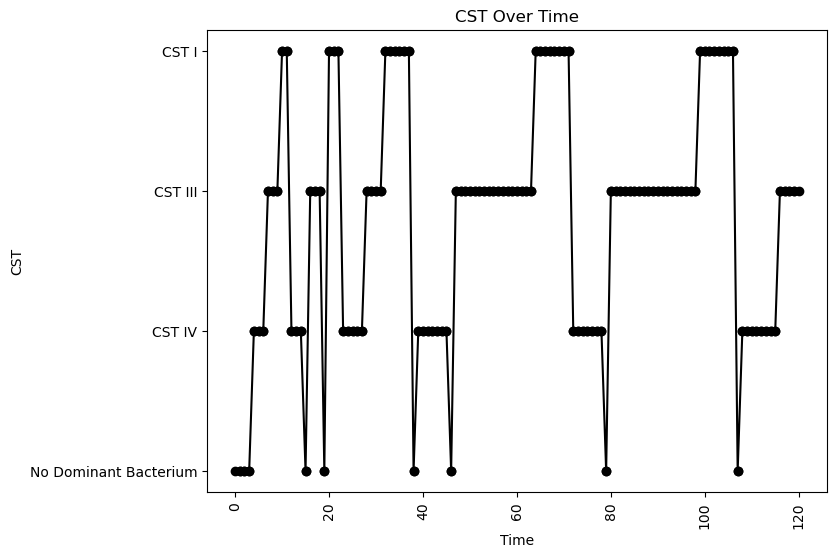


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.2939926979938574
oLB Growth: 0.46591620920123267
nAB Self: -0.05664533694771177
nAB->Li: -0.21774032312043962
nAB->oLB: -0.016187497635309134
Li->nAB: 0.10873187212104074
Li Self: -0.030630489860925855
Li->oLB: -0.2379089427755799
oLB->nAB: -0.4733728445222082
oLB->Li: 0.3835622195907801
oLB Self: -0.07656277764793845

Simulation 2164 follows a valid CST progression:


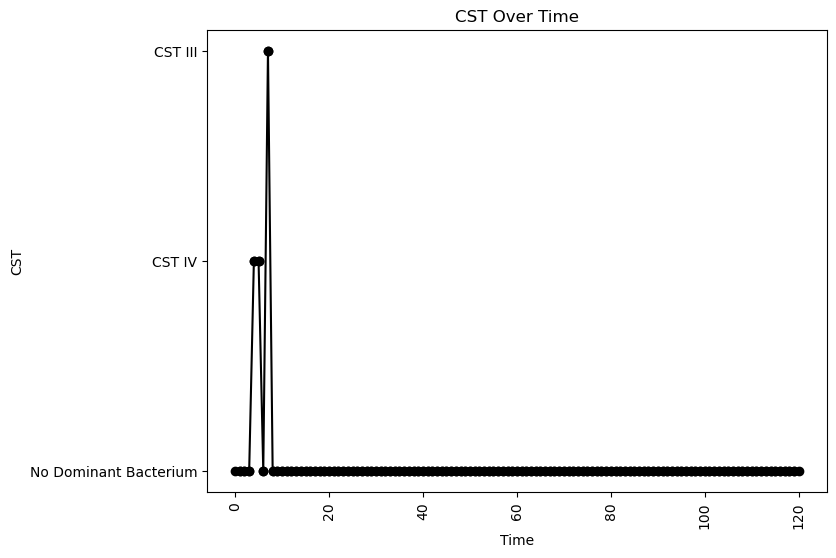


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.0528830175569305
nAB->Li: 0.004566621172002128
nAB->oLB: -0.23166261135939287
Li->nAB: 0.4015893797082233
Li Self: -0.030472762000412018
Li->oLB: 0.21013915670100447
oLB->nAB: -0.3165066492199583
oLB->Li: 0.17501115366260667
oLB Self: -0.07510296566875146

Simulation 2180 follows a valid CST progression:


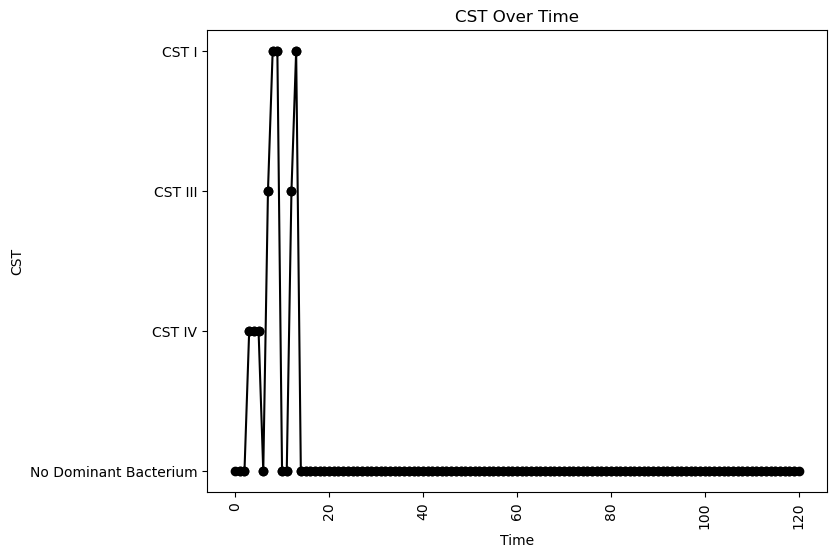


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.05018920695922768
nAB->Li: -0.054028982115119084
nAB->oLB: -0.03405765993473936
Li->nAB: 0.2679653776710137
Li Self: -0.019746839454174478
Li->oLB: -0.09876348054724071
oLB->nAB: -0.173004253367803
oLB->Li: 0.1581794616122184
oLB Self: -0.08514182007008832

Simulation 2181 follows a valid CST progression:


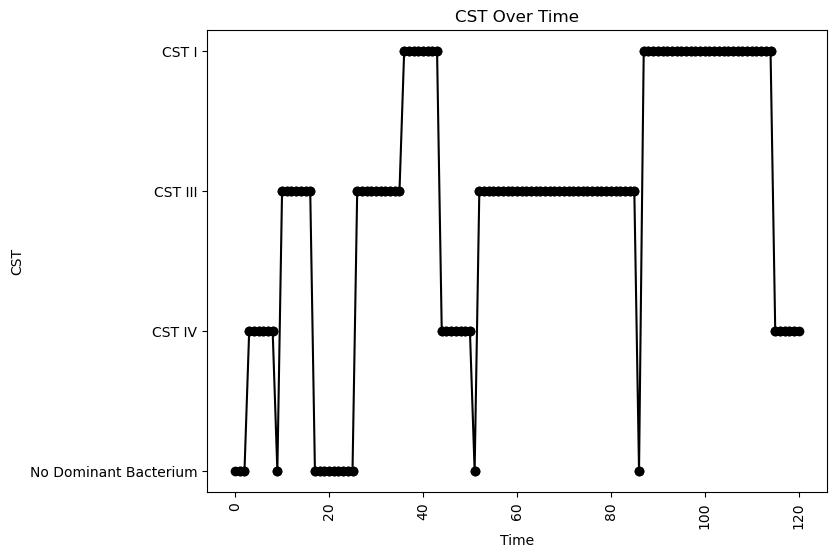


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.06664492138468138
oLB Growth: 0.6588037441195057
nAB Self: -0.033774010647695446
nAB->Li: -0.40001752246654576
nAB->oLB: -0.13710893025260135
Li->nAB: 0.06117949204848394
Li Self: -0.06370564383492394
Li->oLB: -0.3177637666955644
oLB->nAB: -0.4830642404914297
oLB->Li: 0.38528679005096855
oLB Self: -0.0842353350070916

Simulation 2191 follows a valid CST progression:


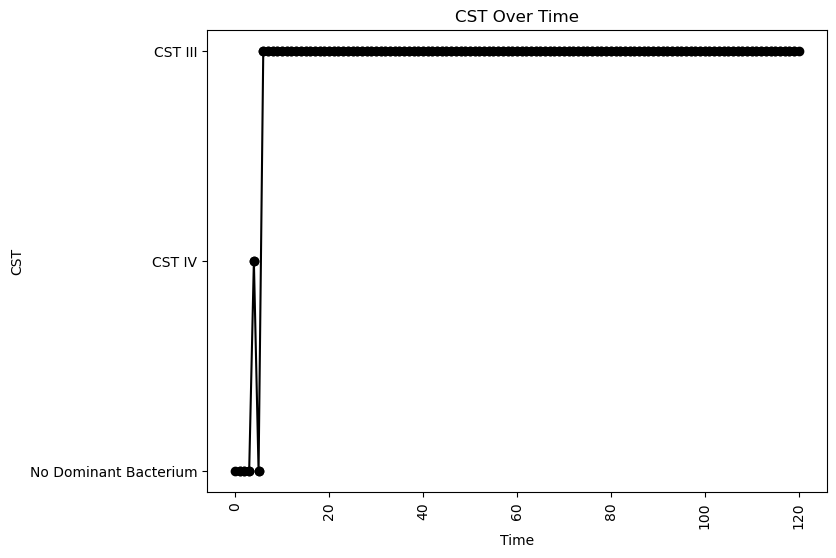


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.11940634873253189
oLB Growth: 0.46591620920123267
nAB Self: -0.054750620621320585
nAB->Li: -0.17286162612855221
nAB->oLB: -0.21221058977689877
Li->nAB: 0.3436104747322323
Li Self: -0.02325125800519437
Li->oLB: -0.3535268195641633
oLB->nAB: -0.11204869572385129
oLB->Li: -0.05801382502097341
oLB Self: -0.019797263136487747

Simulation 2200 follows a valid CST progression:


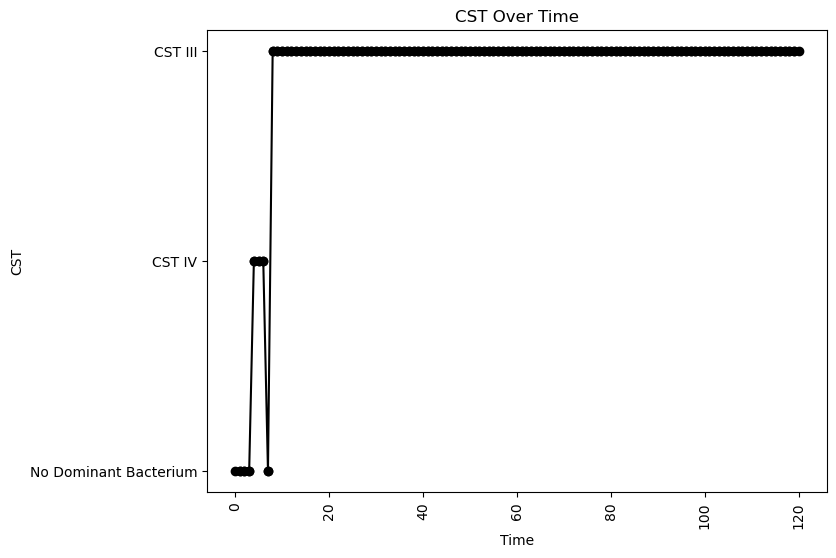


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.06751622376161209
nAB->Li: -0.4257524877781067
nAB->oLB: -0.21092604322733566
Li->nAB: 0.17309459624058998
Li Self: -0.03514577976917041
Li->oLB: -0.12744373912573642
oLB->nAB: -0.0009584383135501362
oLB->Li: -0.15606936678361044
oLB Self: -0.03866232063708906

Simulation 2210 follows a valid CST progression:


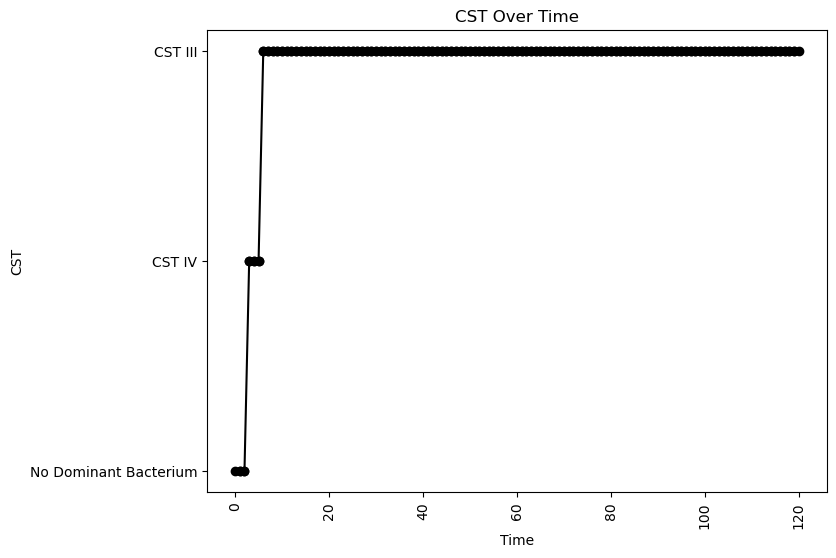


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.06967846000948563
oLB Growth: 0.7070472171500886
nAB Self: -0.07441144302976174
nAB->Li: 0.01944421721667633
nAB->oLB: -0.17869519732405315
Li->nAB: 0.25973732116326687
Li Self: -0.03784721333309835
Li->oLB: 0.2978129466945916
oLB->nAB: -0.37472787740617
oLB->Li: -0.4037633475831557
oLB Self: -0.06707006376694835

Simulation 2212 follows a valid CST progression:


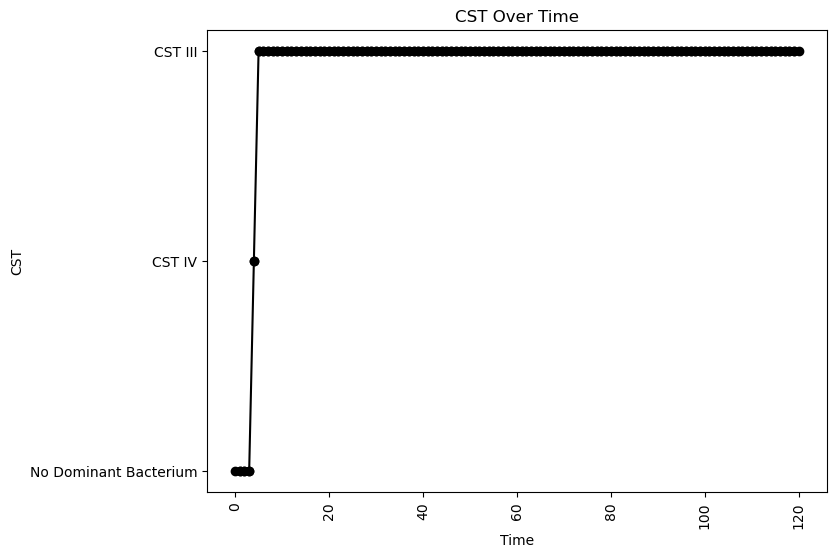


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.17818171623087964
oLB Growth: 0.3756702562538966
nAB Self: -0.03835774422372671
nAB->Li: 0.09097059576023692
nAB->oLB: -0.4378120031161594
Li->nAB: 0.49395865635413505
Li Self: -0.08135609187965695
Li->oLB: -0.4504247421580553
oLB->nAB: -0.4149734677742043
oLB->Li: -0.13291136255804137
oLB Self: -0.05669079920116915

Simulation 2229 follows a valid CST progression:


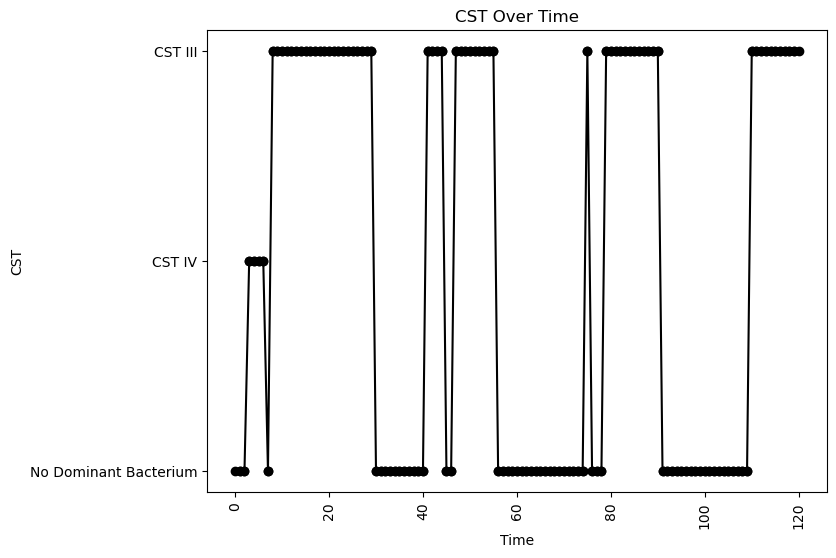


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.0846801317049507
nAB->Li: -0.2032326714880323
nAB->oLB: -0.0420551450880805
Li->nAB: 0.20926711315867907
Li Self: -0.06997173031573427
Li->oLB: -0.16964273802425356
oLB->nAB: -0.46477448590642734
oLB->Li: 0.17318800498780618
oLB Self: -0.048547628677227686

Simulation 2240 follows a valid CST progression:


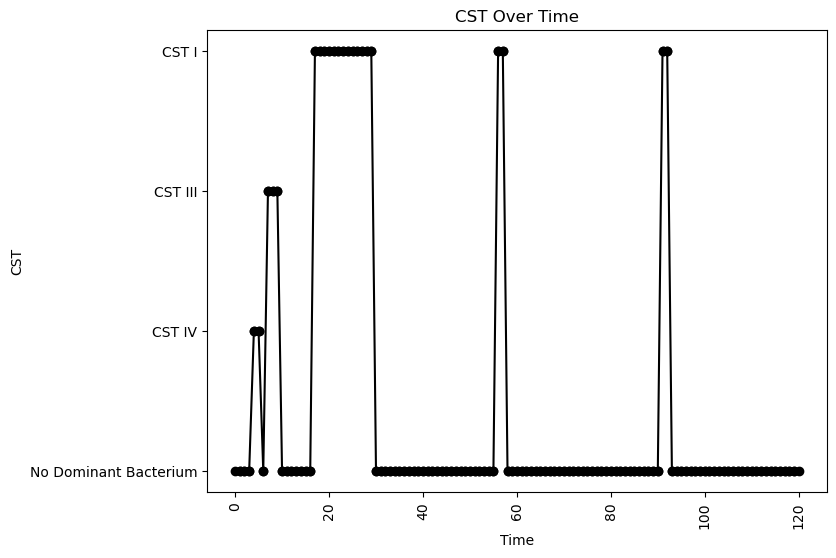


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.07539352876783695
nAB->Li: -0.3717361477842968
nAB->oLB: -0.1834753878858678
Li->nAB: 0.3771976860041495
Li Self: -0.08236301261430164
Li->oLB: 0.056639115612740376
oLB->nAB: -0.01682153870232833
oLB->Li: 0.12148301037171172
oLB Self: -0.08930287458010289

Simulation 2245 follows a valid CST progression:


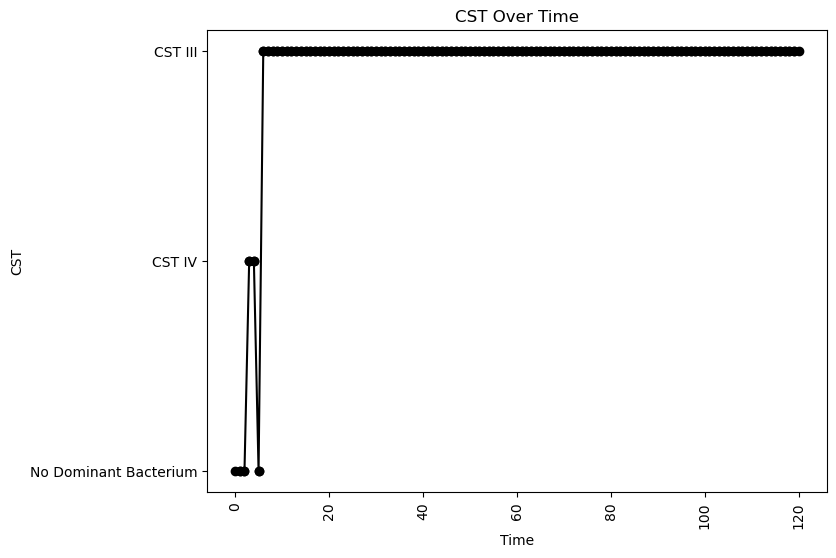


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.08347709160418713
nAB->Li: -0.2359981702447148
nAB->oLB: -0.2965872723831811
Li->nAB: 0.35781680742822786
Li Self: -0.04461218160698389
Li->oLB: -0.23666140795101442
oLB->nAB: -0.2711282282468377
oLB->Li: -0.248030818654069
oLB Self: -0.05280653660040247

Simulation 2263 follows a valid CST progression:


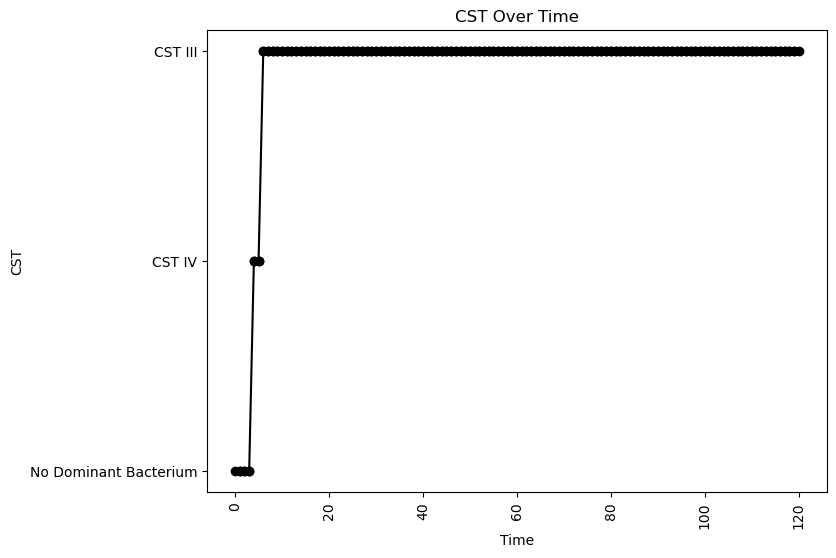


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.07944306460192678
nAB->Li: 0.13235484116467888
nAB->oLB: -0.3794972739020541
Li->nAB: 0.4023514740638161
Li Self: -0.045909998719507746
Li->oLB: 0.05344049856587196
oLB->nAB: -0.37809040054606924
oLB->Li: -0.1290580323419574
oLB Self: -0.08792490521186282

Simulation 2270 follows a valid CST progression:


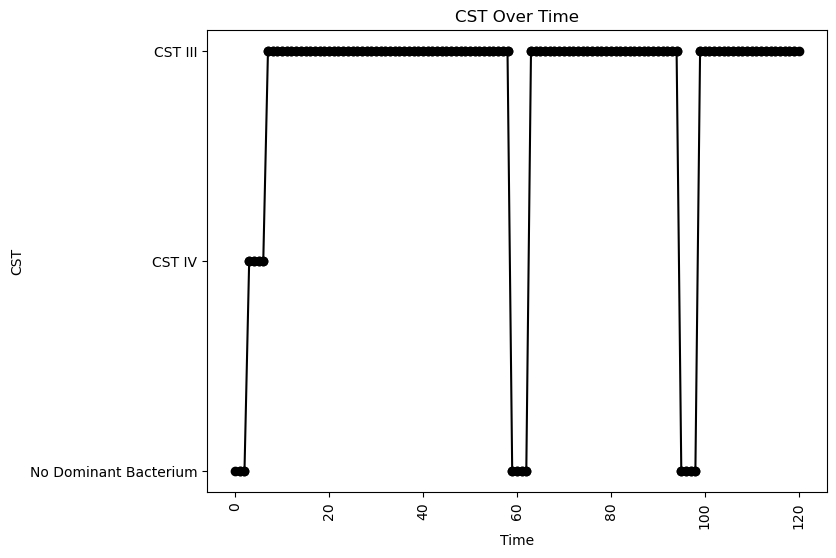


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.06588260315658048
oLB Growth: 0.21113539622386296
nAB Self: -0.03173670678407914
nAB->Li: -0.40819163053113966
nAB->oLB: -0.4449030057199846
Li->nAB: 0.19469854528558916
Li Self: -0.0737450639577546
Li->oLB: 0.2964023662106414
oLB->nAB: -0.3166806532533887
oLB->Li: -0.3629746258180122
oLB Self: -0.09101442696408174

Simulation 2272 follows a valid CST progression:


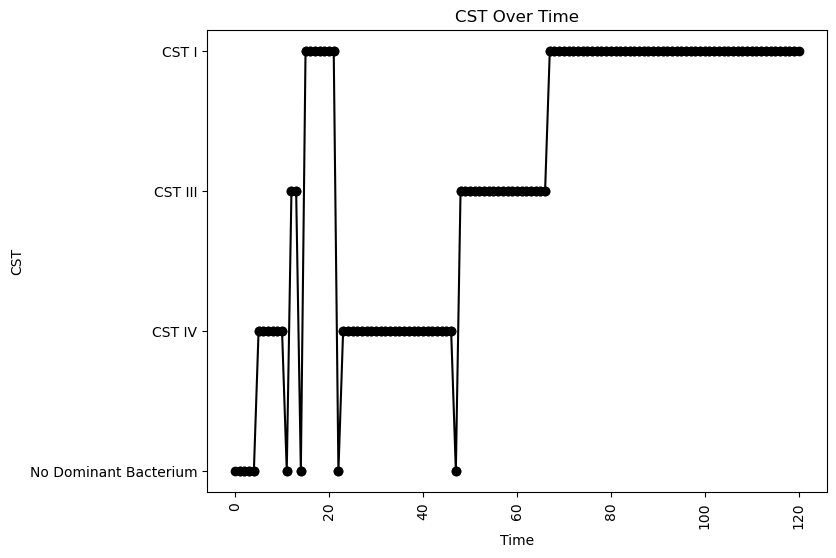


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.06608124548289959
nAB->Li: -0.4476972767156075
nAB->oLB: -0.06931678431210841
Li->nAB: 0.05086527063020352
Li Self: -0.010202093258389666
Li->oLB: -0.3745347702019056
oLB->nAB: -0.18469581176162841
oLB->Li: 0.4496247984175531
oLB Self: -0.02374382500676263

Simulation 2278 follows a valid CST progression:


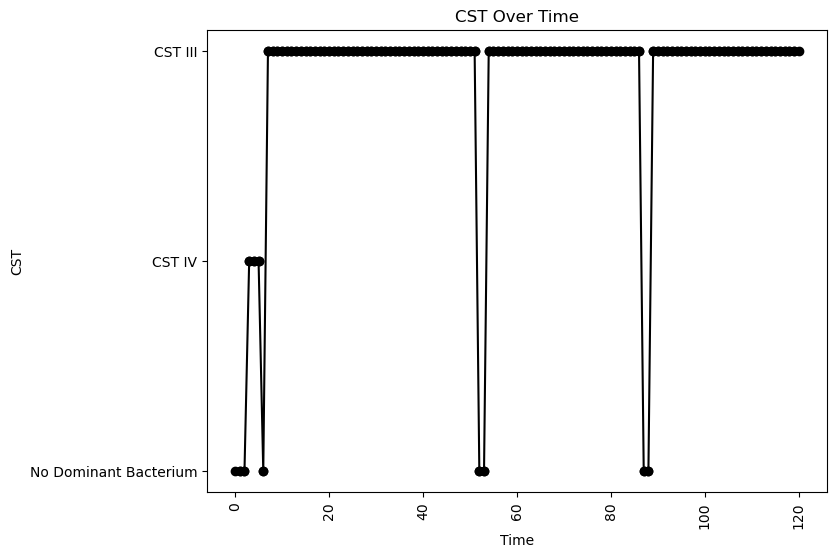


Interaction Parameters:
nAB Growth: 2.2446146183745257
Li Growth: 0.07278030322941353
oLB Growth: 0.5438660619757455
nAB Self: -0.0373490272150022
nAB->Li: -0.397137465009201
nAB->oLB: -0.09831224850520465
Li->nAB: 0.22879378603256628
Li Self: -0.09769168078612389
Li->oLB: 0.1208822626014886
oLB->nAB: -0.36431312300378205
oLB->Li: -0.27789978352761996
oLB Self: -0.04845066371315934

Simulation 2279 follows a valid CST progression:


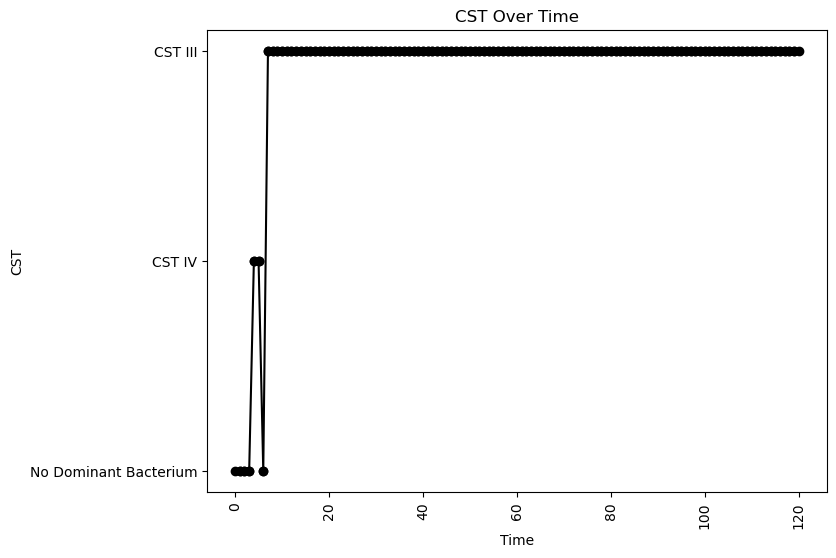


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.09631123674565177
oLB Growth: 0.03504834427483494
nAB Self: -0.0678673048864035
nAB->Li: -0.1482565493306371
nAB->oLB: -0.28399855262491136
Li->nAB: 0.23142858655744325
Li Self: -0.06520673697318419
Li->oLB: -0.13924466795317642
oLB->nAB: -0.2952101388402062
oLB->Li: -0.11722721037528039
oLB Self: -0.07768831718289196

Simulation 2283 follows a valid CST progression:


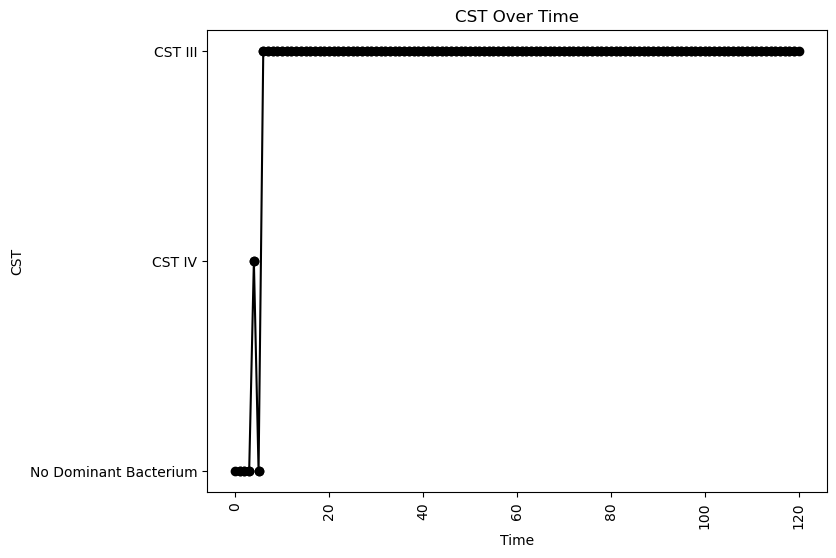


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.1859991587587413
oLB Growth: 0.31765248508565325
nAB Self: -0.05561135645436753
nAB->Li: -0.134433573563233
nAB->oLB: -0.3519631636849965
Li->nAB: 0.19140540738958833
Li Self: -0.037101781551212576
Li->oLB: 0.2696279516535426
oLB->nAB: -0.22058681453243312
oLB->Li: -0.06522440258183826
oLB Self: -0.020304527391759364

Simulation 2284 follows a valid CST progression:


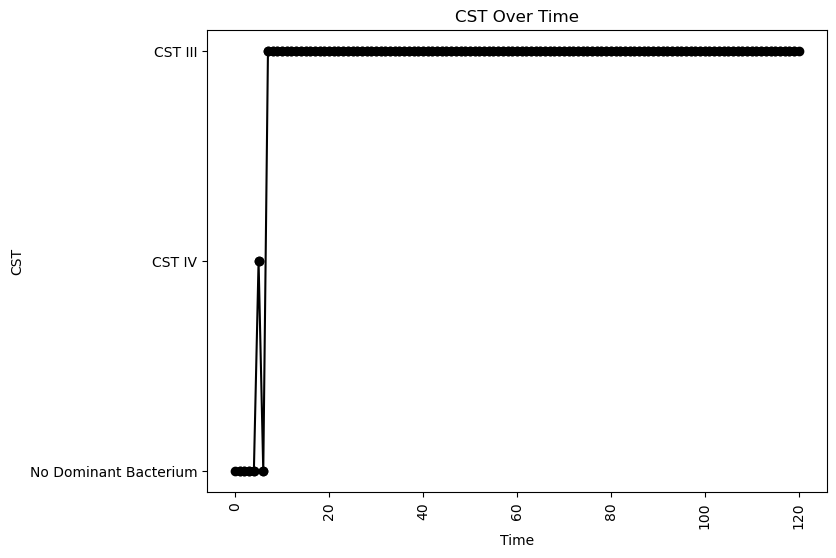


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.04210602529635335
nAB->Li: -0.013085583108283172
nAB->oLB: -0.3791163629688898
Li->nAB: 0.20635582126729535
Li Self: -0.03529948398291409
Li->oLB: 0.4431532250068
oLB->nAB: -0.42383074731758746
oLB->Li: -0.26032808836300886
oLB Self: -0.03787741758506049

Simulation 2285 follows a valid CST progression:


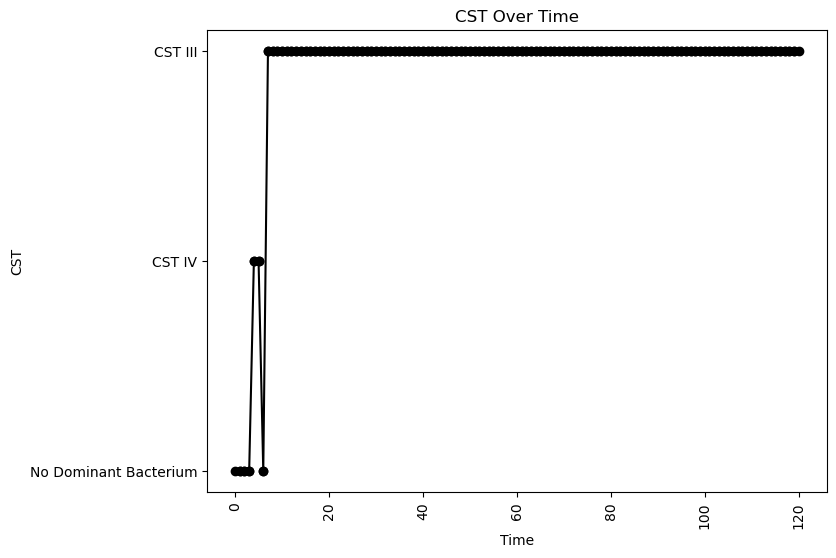


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.016360558275786807
nAB->Li: -0.23926112076900347
nAB->oLB: -0.2704497872548681
Li->nAB: 0.352204483898658
Li Self: -0.09004258362216648
Li->oLB: 0.15086363827156846
oLB->nAB: -0.1340558537592232
oLB->Li: -0.34694061129844544
oLB Self: -0.0936998713595462

Simulation 2292 follows a valid CST progression:


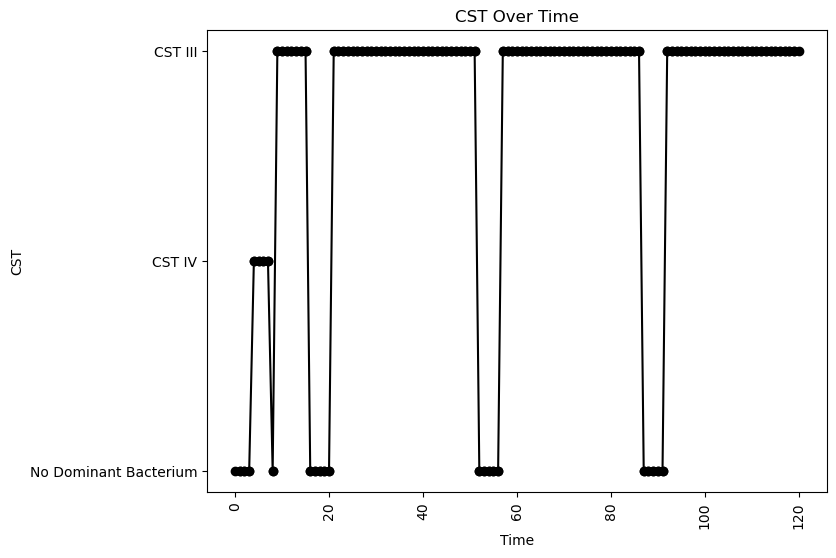


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.0014757975289941272
nAB->Li: -0.4107711979100587
nAB->oLB: -0.24174166616453086
Li->nAB: 0.15039642458587776
Li Self: -0.08942823932127347
Li->oLB: -0.19290042811121338
oLB->nAB: -0.045750465505029925
oLB->Li: -0.29948520982938226
oLB Self: -0.05730906810105104

Simulation 2296 follows a valid CST progression:


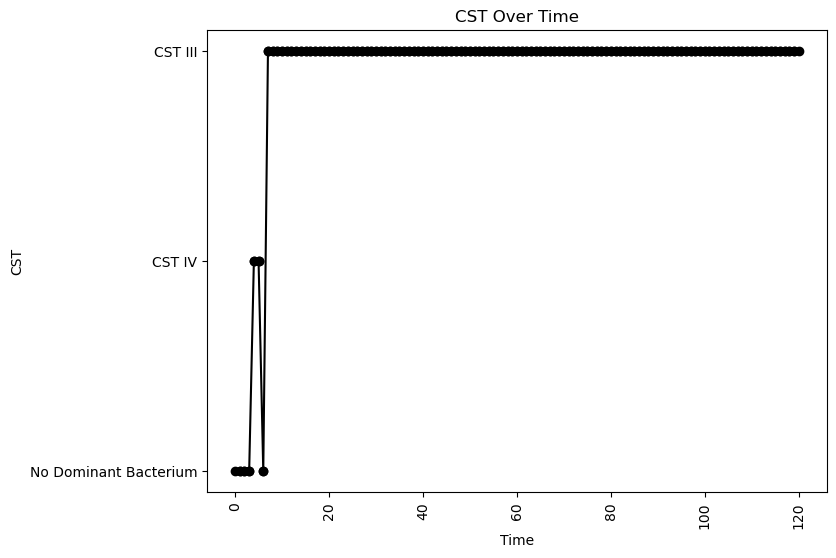


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.11231104737889099
oLB Growth: 0.595997418302585
nAB Self: -0.037111967115387307
nAB->Li: -0.17489694331547545
nAB->oLB: -0.2595911233049047
Li->nAB: 0.18969080550584616
Li Self: -0.07175378032222963
Li->oLB: 0.49955249917973577
oLB->nAB: -0.26382680592547775
oLB->Li: 0.06265555233982711
oLB Self: -0.07428854980193993

Simulation 2299 follows a valid CST progression:


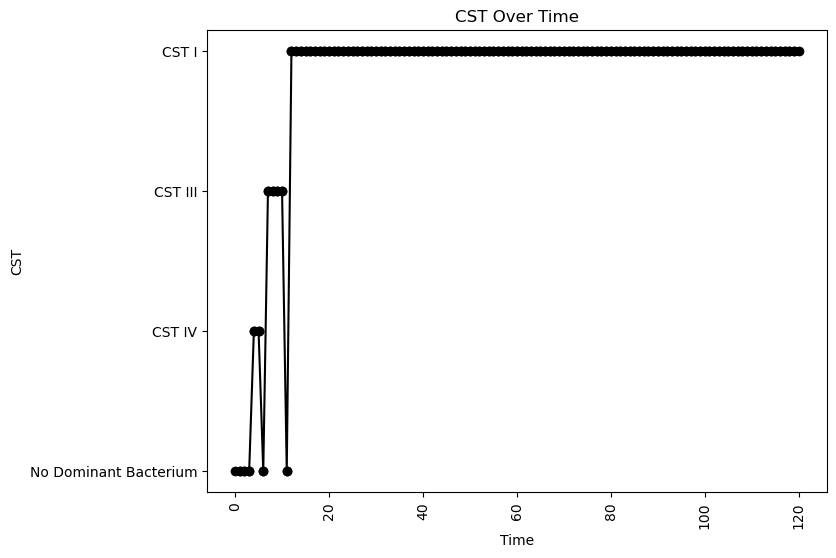


Interaction Parameters:
nAB Growth: 2.2489702826927647
Li Growth: 0.07143879299629578
oLB Growth: 0.24213610993368434
nAB Self: -0.08296164396808532
nAB->Li: -0.3575441806989409
nAB->oLB: -0.35404476935997214
Li->nAB: 0.38192476566778877
Li Self: -0.018009872478295205
Li->oLB: -0.13375466521484458
oLB->nAB: -0.2611448385158164
oLB->Li: 0.19007690628343532
oLB Self: -0.040196599846883355

Simulation 2308 follows a valid CST progression:


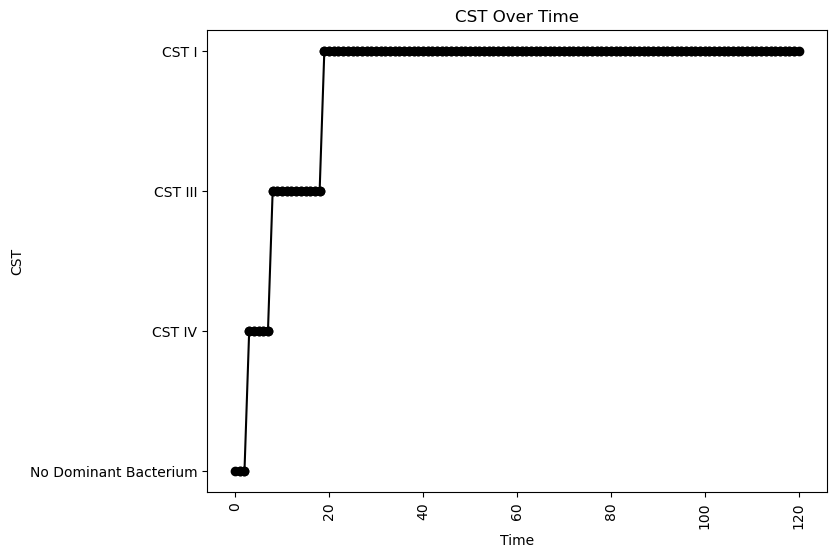


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.0947353592737193
nAB->Li: -0.26182972837079294
nAB->oLB: -0.25008788632099976
Li->nAB: 0.12416157807628136
Li Self: -0.005638705200805713
Li->oLB: -0.432751899275434
oLB->nAB: -0.4112333437965882
oLB->Li: 0.16279427265722246
oLB Self: -0.016229381021316866

Simulation 2311 follows a valid CST progression:


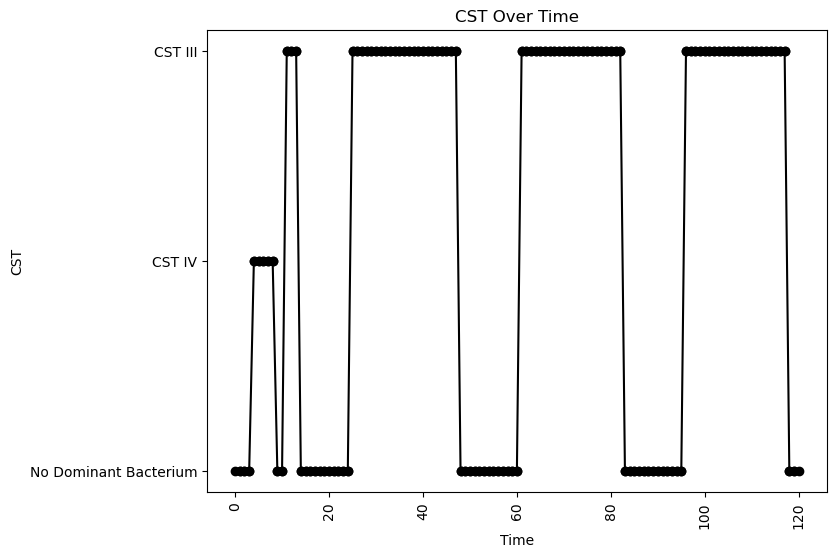


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.09893818057667897
nAB->Li: -0.2979036145600731
nAB->oLB: -0.44267855968522224
Li->nAB: 0.11828701527481
Li Self: -0.09497435756776482
Li->oLB: -0.14443647014880123
oLB->nAB: -0.4266613175281642
oLB->Li: -0.12516558615006673
oLB Self: -0.07394233104921984

Simulation 2312 follows a valid CST progression:


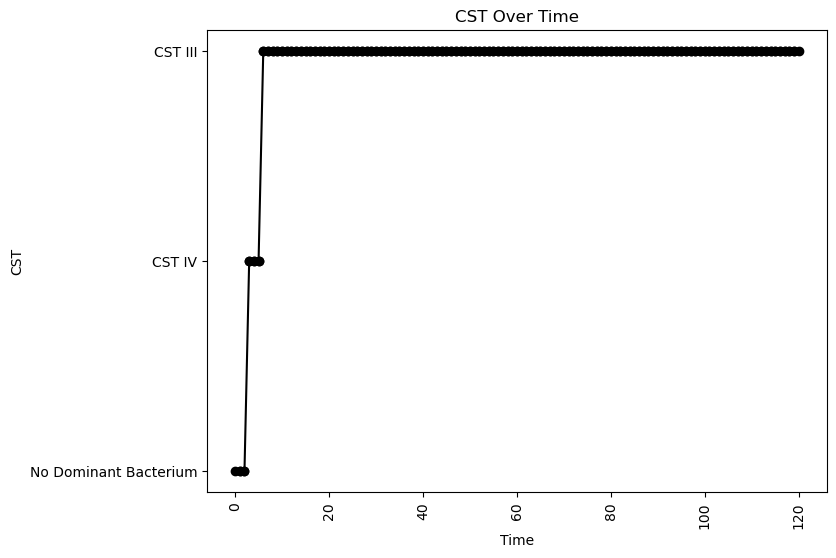


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.06789223881256207
nAB->Li: -0.10433392370517258
nAB->oLB: -0.13658138849814455
Li->nAB: 0.3342753797132435
Li Self: -0.05335630902998515
Li->oLB: 0.2148283813216807
oLB->nAB: -0.46840128087378463
oLB->Li: -0.3823512223425847
oLB Self: -0.014161663853043377

Simulation 2323 follows a valid CST progression:


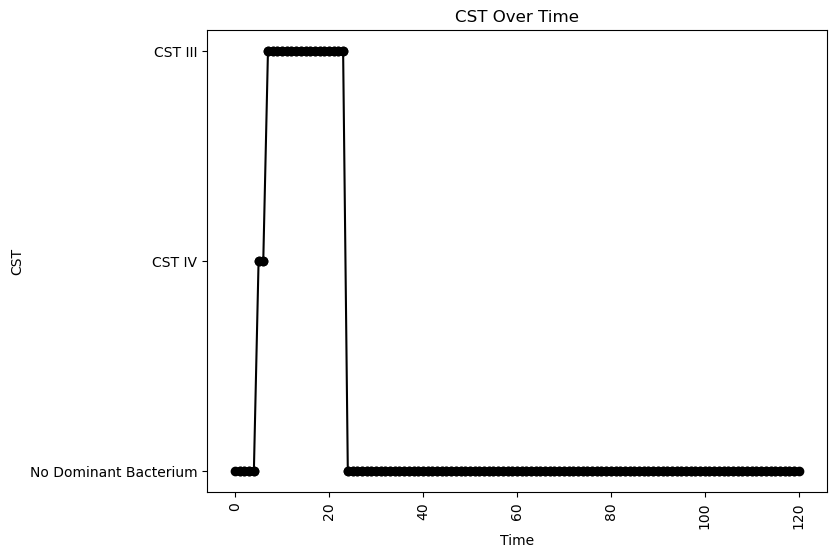


Interaction Parameters:
nAB Growth: 2.284416841880324
Li Growth: 0.06886020002136616
oLB Growth: 0.35838896078112936
nAB Self: -0.03086232658631108
nAB->Li: 0.0993674586836446
nAB->oLB: -0.459024795297196
Li->nAB: 0.2301794535356282
Li Self: -0.07428305147956081
Li->oLB: 0.2839114860166543
oLB->nAB: -0.247956200854006
oLB->Li: -0.20631508628386702
oLB Self: -0.0578943898928108

Simulation 2327 follows a valid CST progression:


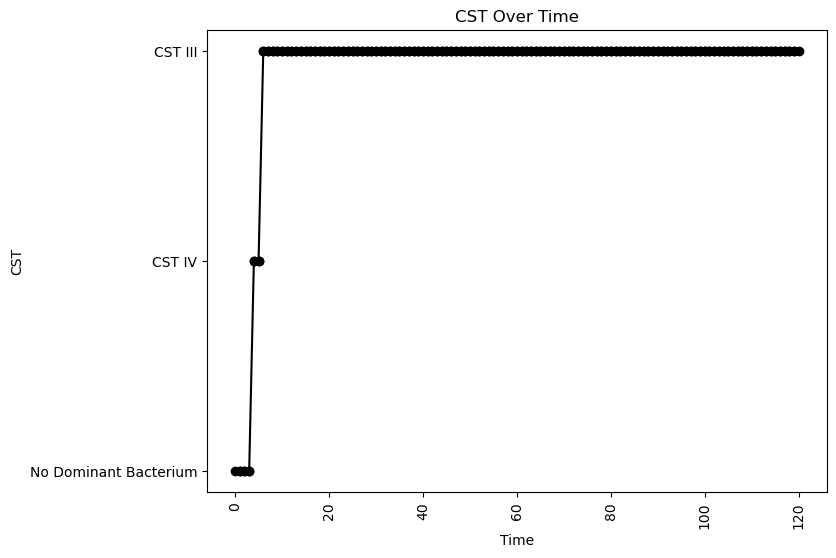


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.006513623538774979
nAB->Li: -0.14667135368694012
nAB->oLB: -0.08155170179504989
Li->nAB: 0.3553558971899924
Li Self: -0.020267069097633178
Li->oLB: -0.4726669589565416
oLB->nAB: -0.26710959024191444
oLB->Li: -0.35349327669171904
oLB Self: -0.017343057894926323

Simulation 2328 follows a valid CST progression:


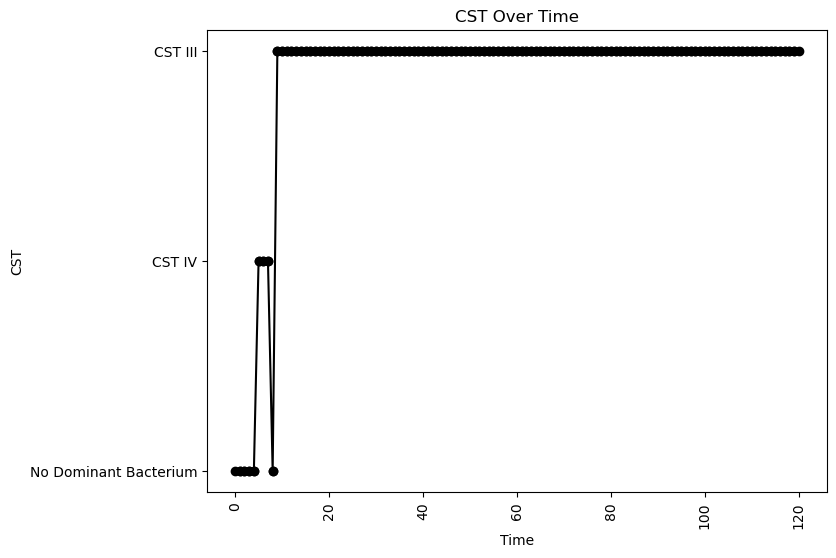


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.06495430992206574
oLB Growth: 0.1731103059651596
nAB Self: -0.07347490586669919
nAB->Li: -0.18544821183135063
nAB->oLB: -0.3348781529567272
Li->nAB: 0.15851538262894205
Li Self: -0.07386833169370224
Li->oLB: 0.4404217910767897
oLB->nAB: -0.1940828404853555
oLB->Li: 0.10889074490942863
oLB Self: -0.08867372835020983

Simulation 2333 follows a valid CST progression:


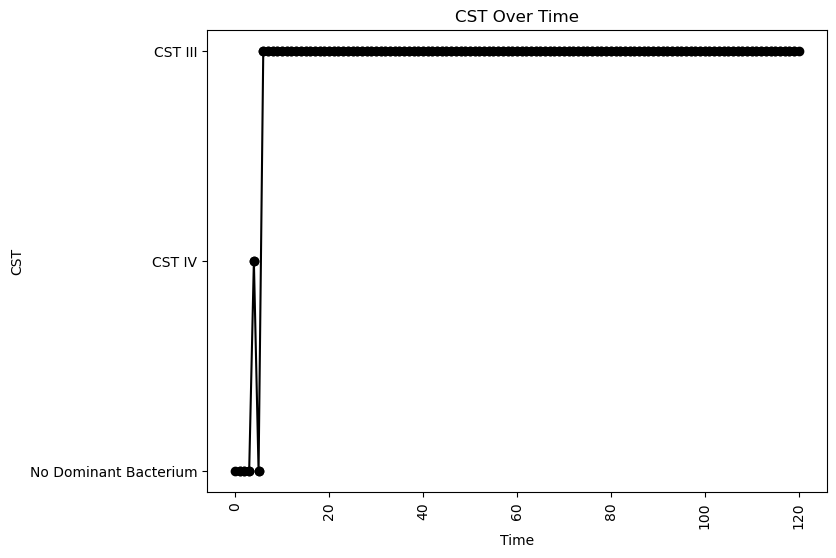


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.12035271878056977
oLB Growth: 0.46591620920123267
nAB Self: -0.009957486615943492
nAB->Li: 0.08864140660191278
nAB->oLB: -0.2676127289813197
Li->nAB: 0.3880488305576528
Li Self: -0.0660378658888547
Li->oLB: -0.22654978317927116
oLB->nAB: -0.0743779842631
oLB->Li: -0.38254531549507564
oLB Self: -0.021396040220351784

Simulation 2339 follows a valid CST progression:


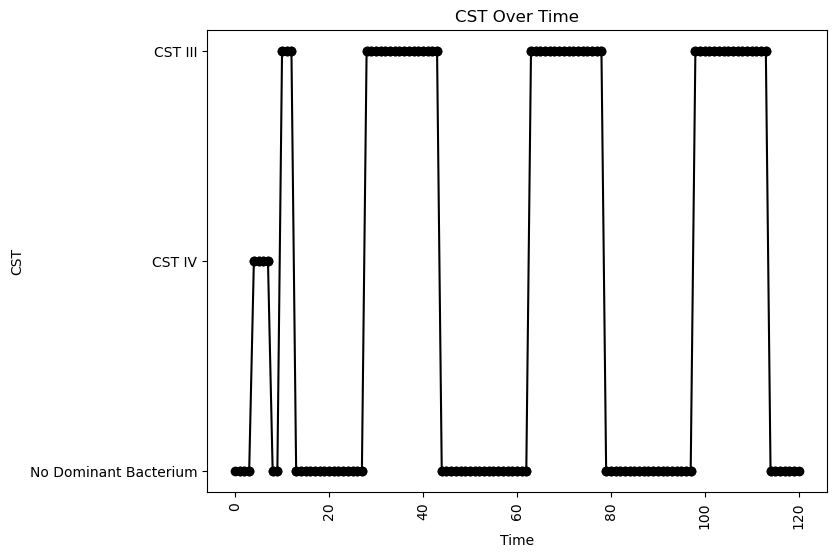


Interaction Parameters:
nAB Growth: 2.273308423784788
Li Growth: 0.3604689483139924
oLB Growth: 0.4879467602516997
nAB Self: -0.01345120792114557
nAB->Li: -0.060100888993942725
nAB->oLB: -0.3197637309539264
Li->nAB: 0.037733950629947444
Li Self: -0.041781642093649284
Li->oLB: 0.1264727314278291
oLB->nAB: -0.18668432326569223
oLB->Li: -0.14736703377009103
oLB Self: -0.03733079802301026

Simulation 2344 follows a valid CST progression:


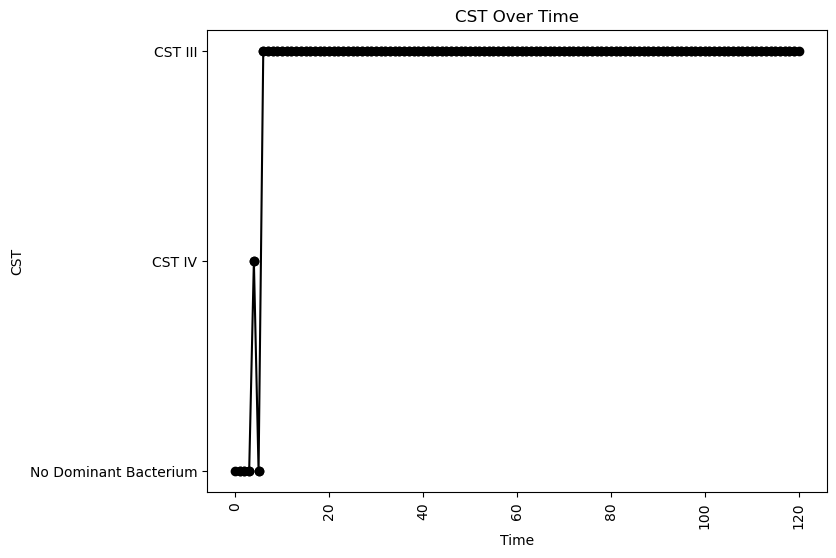


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.05739994626081137
oLB Growth: 0.11031283255203692
nAB Self: -0.06482320913018116
nAB->Li: -0.12491820050298763
nAB->oLB: -0.18372362666074216
Li->nAB: 0.3918904680813273
Li Self: -0.025020328168988012
Li->oLB: 0.48496464820848684
oLB->nAB: -0.22460546492049865
oLB->Li: 0.19805041587450667
oLB Self: -0.03626166584305311

Simulation 2358 follows a valid CST progression:


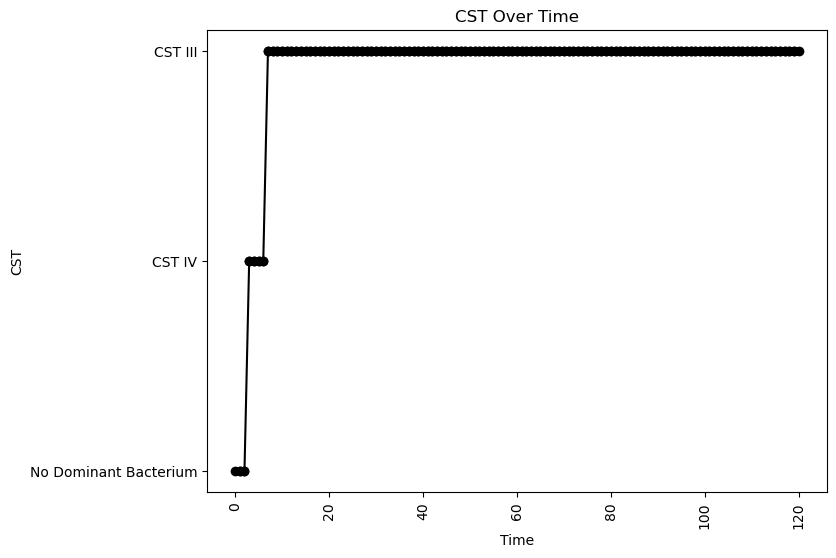


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.08432088704815346
nAB->Li: 0.015178716179809038
nAB->oLB: -0.2209628348791055
Li->nAB: 0.20661986648862352
Li Self: -0.07551550576263968
Li->oLB: -0.2388108477292034
oLB->nAB: -0.3873780397788499
oLB->Li: 0.11704587910528308
oLB Self: -0.02911556067047255

Simulation 2368 follows a valid CST progression:


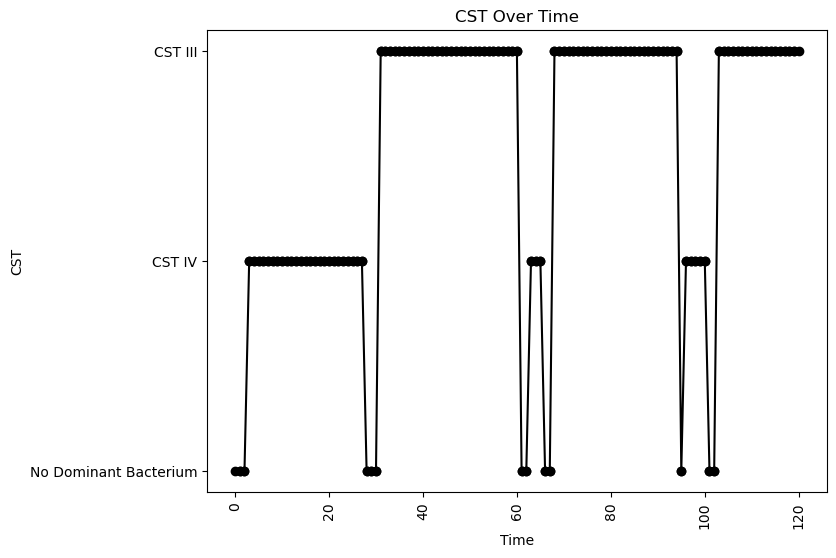


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.09624251192937834
nAB->Li: -0.2308954590647836
nAB->oLB: -0.02516650414018451
Li->nAB: 0.019843650369680832
Li Self: -0.03456671262623118
Li->oLB: 0.265894598362592
oLB->nAB: -0.38332215995403046
oLB->Li: -0.378185699589321
oLB Self: -0.09625544821687464

Simulation 2370 follows a valid CST progression:


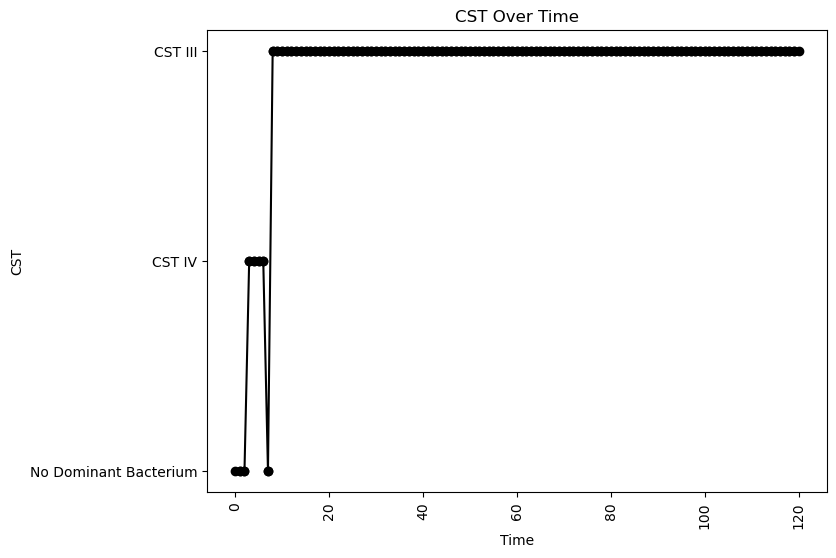


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.05739994626081137
oLB Growth: 0.11031283255203692
nAB Self: -0.017957141349978042
nAB->Li: 0.019820288779787365
nAB->oLB: -0.26077056616138633
Li->nAB: 0.18993753873353814
Li Self: -0.08201575521716242
Li->oLB: -0.41482796522572923
oLB->nAB: -0.3481148009865589
oLB->Li: -0.09593168967323273
oLB Self: -0.07131181606570516

Simulation 2373 follows a valid CST progression:


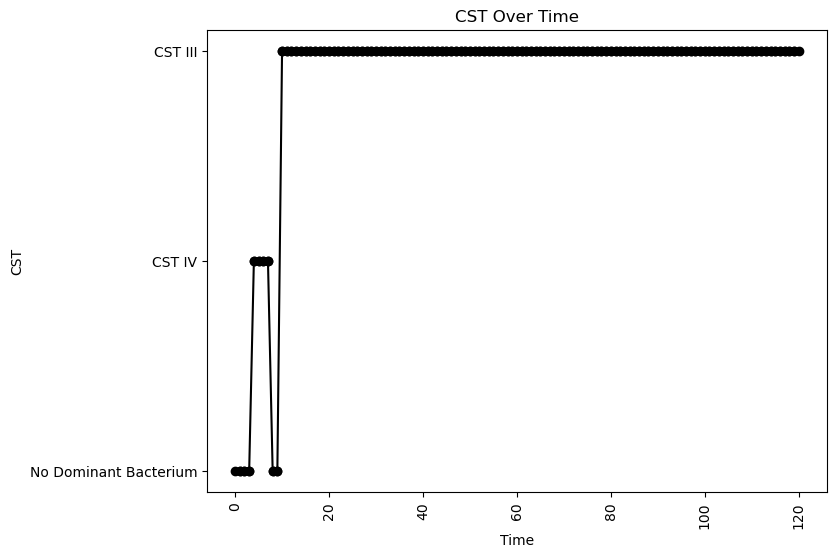


Interaction Parameters:
nAB Growth: 2.172057972480792
Li Growth: 0.2578736436768782
oLB Growth: 1.1816194682992254
nAB Self: -0.04441672704436956
nAB->Li: -0.08313590007715477
nAB->oLB: -0.2471960418397035
Li->nAB: 0.04349396373768921
Li Self: -0.03142709343472089
Li->oLB: 0.15986122428249083
oLB->nAB: -0.22446565037483013
oLB->Li: -0.47746562462098074
oLB Self: -0.08276718806672795

Simulation 2375 follows a valid CST progression:


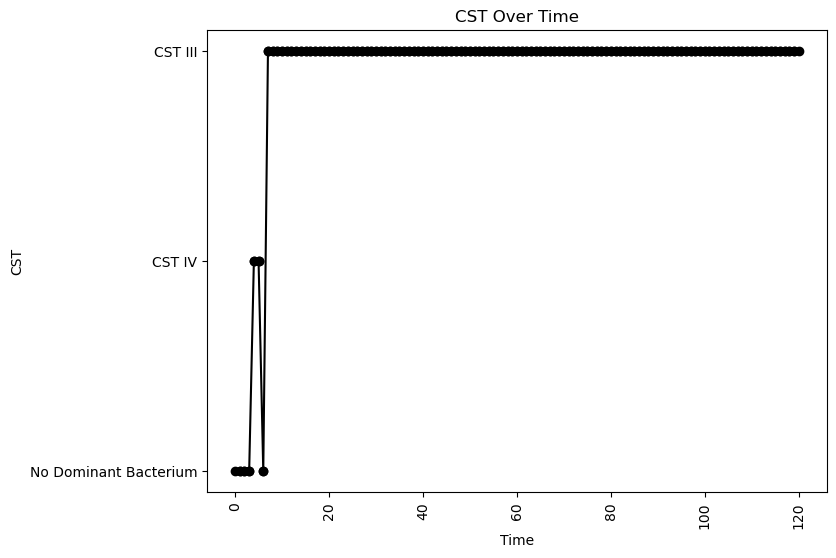


Interaction Parameters:
nAB Growth: 2.284416841880324
Li Growth: 0.06886020002136616
oLB Growth: 0.35838896078112936
nAB Self: -0.058289552589810494
nAB->Li: -0.006553424577721734
nAB->oLB: -0.31580606593636584
Li->nAB: 0.2943339948815207
Li Self: -0.0656654097729018
Li->oLB: 0.49889867477792205
oLB->nAB: -0.11493836352369396
oLB->Li: -0.17032538234280736
oLB Self: -0.05032952184248191

Simulation 2378 follows a valid CST progression:


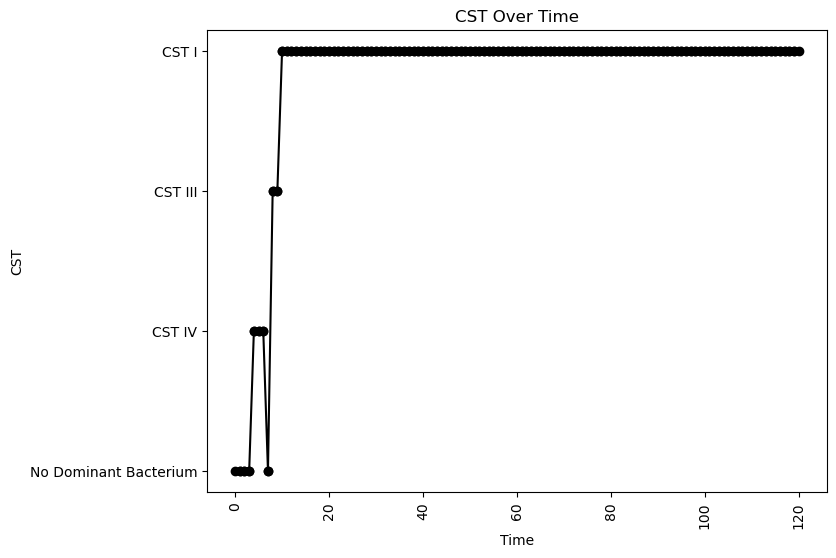


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.015341934520679112
nAB->Li: -0.37786295161038985
nAB->oLB: -0.47108014184602864
Li->nAB: 0.19067472799070218
Li Self: -0.0010807833495093816
Li->oLB: 0.05224509105073405
oLB->nAB: -0.07448164669945517
oLB->Li: 0.18482256694691435
oLB Self: -0.010093764939559768

Simulation 2385 follows a valid CST progression:


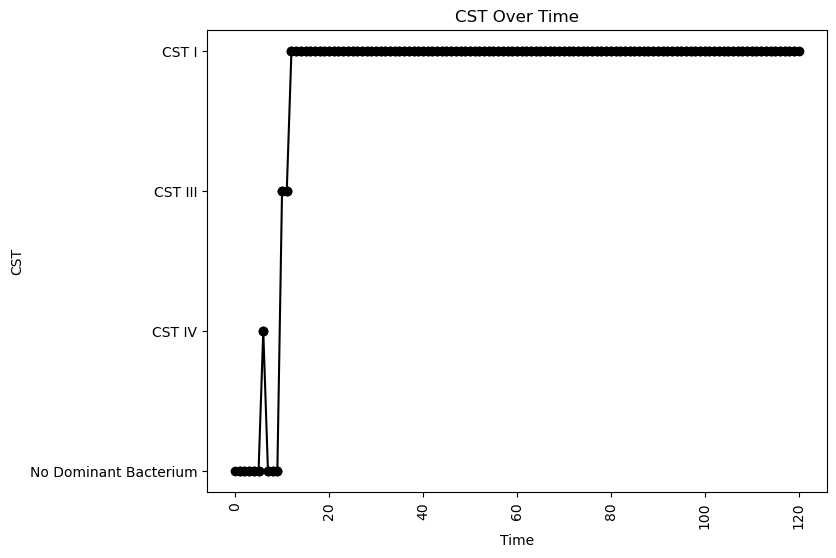


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.2797165808177886
oLB Growth: 0.1263134331844771
nAB Self: -0.09726418209038179
nAB->Li: -0.4157963654747262
nAB->oLB: -0.24439611655489224
Li->nAB: -0.019220579714955888
Li Self: -0.006883560810948472
Li->oLB: 0.06939958809991165
oLB->nAB: -0.4145641044997817
oLB->Li: 0.4881916655266699
oLB Self: -0.06442132186395948

Simulation 2389 follows a valid CST progression:


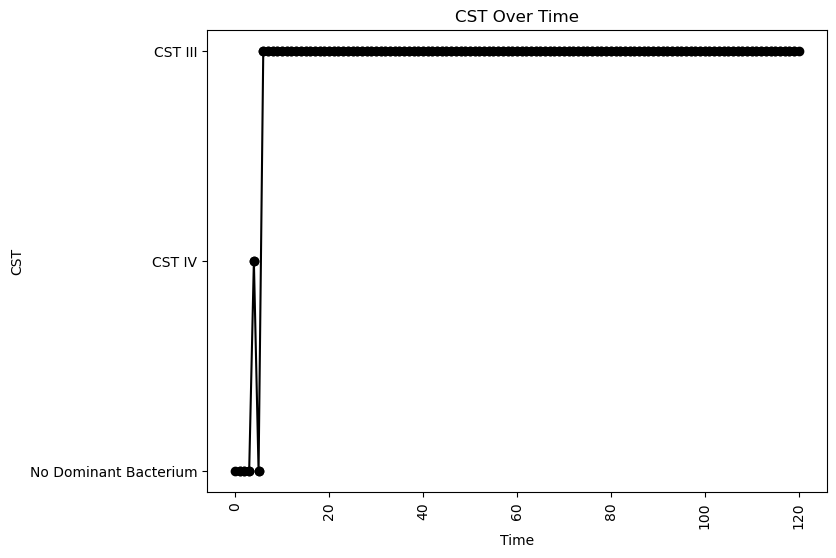


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.08739611406891337
nAB->Li: 0.26958120135099084
nAB->oLB: -0.014468683427333762
Li->nAB: 0.49860160390439157
Li Self: -0.028027651973170864
Li->oLB: -0.44500857157716006
oLB->nAB: -0.08146115686275507
oLB->Li: -0.35418565382818257
oLB Self: -0.0034039092230408324

Simulation 2397 follows a valid CST progression:


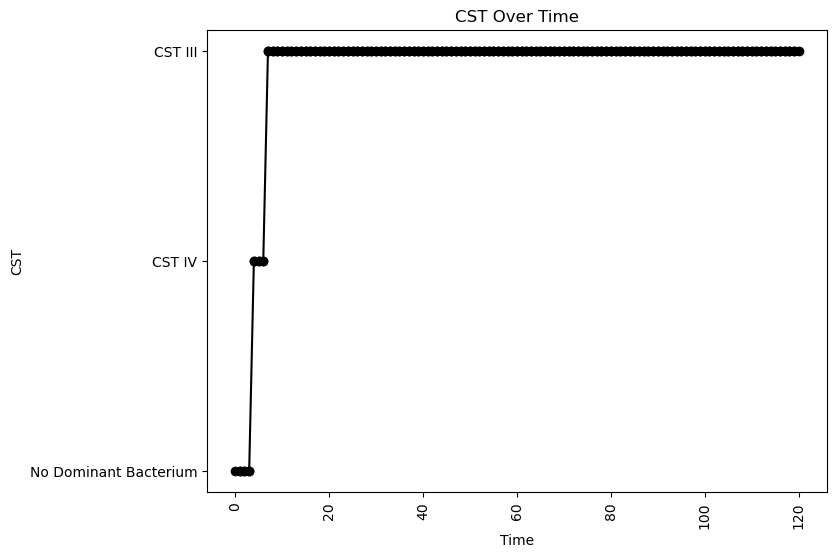


Interaction Parameters:
nAB Growth: 2.273308423784788
Li Growth: 0.06939466945066827
oLB Growth: 0.4879467602516997
nAB Self: -0.02332614524132301
nAB->Li: -0.1789220172941987
nAB->oLB: -0.15349727318899592
Li->nAB: 0.3020479911610807
Li Self: -0.04808119981797297
Li->oLB: 0.09546230069669859
oLB->nAB: -0.24726569666542603
oLB->Li: -0.4589615100424445
oLB Self: -0.01464061704484923

Simulation 2405 follows a valid CST progression:


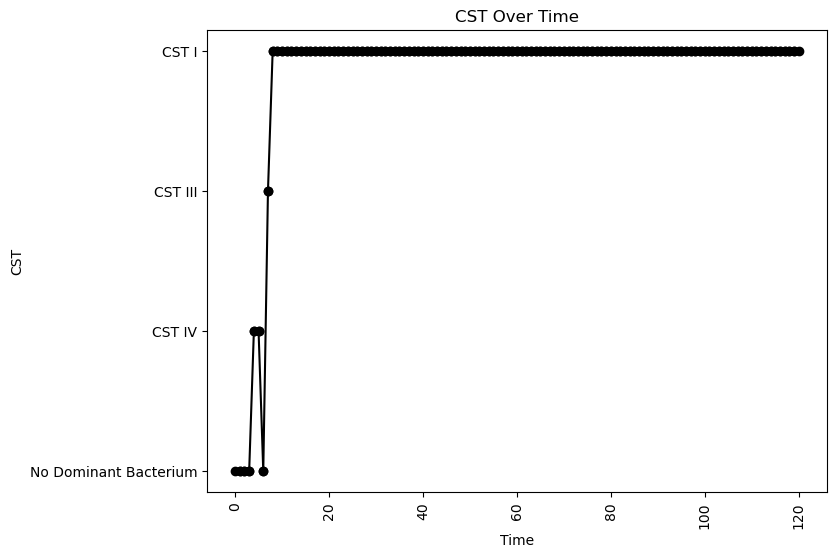


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.09569175687834369
nAB->Li: -0.04368209440610599
nAB->oLB: -0.47861537663612574
Li->nAB: 0.3468708434002957
Li Self: -0.028586897926481405
Li->oLB: -0.2834060208203672
oLB->nAB: -0.21698547414169805
oLB->Li: 0.2613669028931088
oLB Self: -0.032538996716389046

Simulation 2418 follows a valid CST progression:


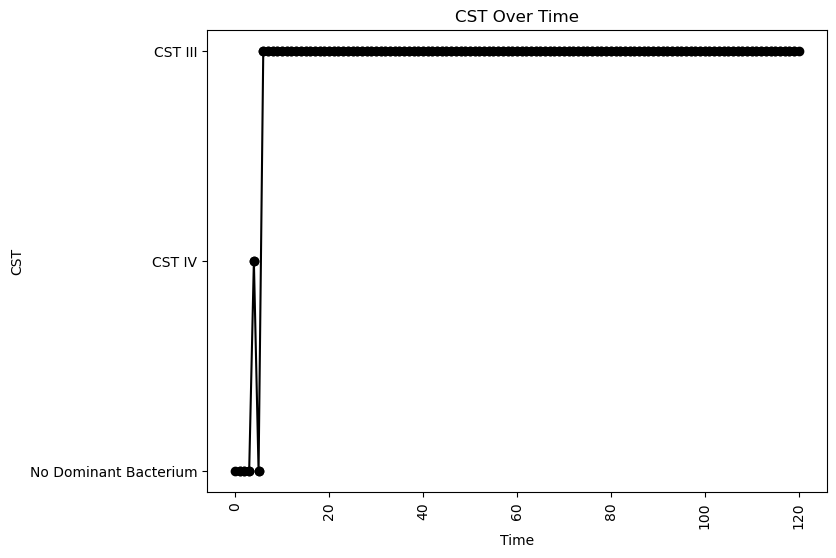


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.08919601849333131
nAB->Li: 0.14759442325447536
nAB->oLB: -0.30786577811263327
Li->nAB: 0.3392119668094391
Li Self: -0.07904883079267198
Li->oLB: -0.3555290817992064
oLB->nAB: -0.39082748827578545
oLB->Li: -0.09355230438234646
oLB Self: -0.04947847772053359

Simulation 2419 follows a valid CST progression:


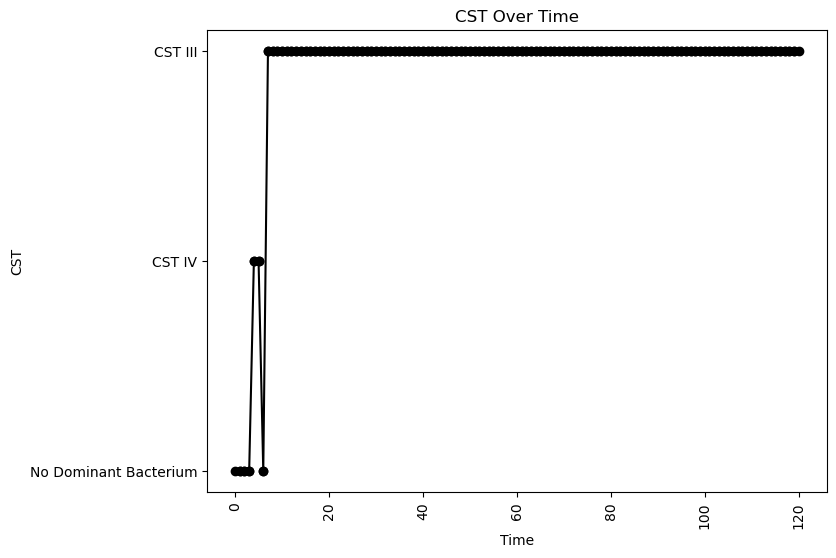


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.052631036944286766
nAB->Li: 0.06058954188554522
nAB->oLB: -0.2674416778185523
Li->nAB: 0.232699060731684
Li Self: -0.025711183149431674
Li->oLB: 0.421657925466726
oLB->nAB: -0.3761677282365624
oLB->Li: 0.1479102339635323
oLB Self: -0.017211569954553266

Simulation 2420 follows a valid CST progression:


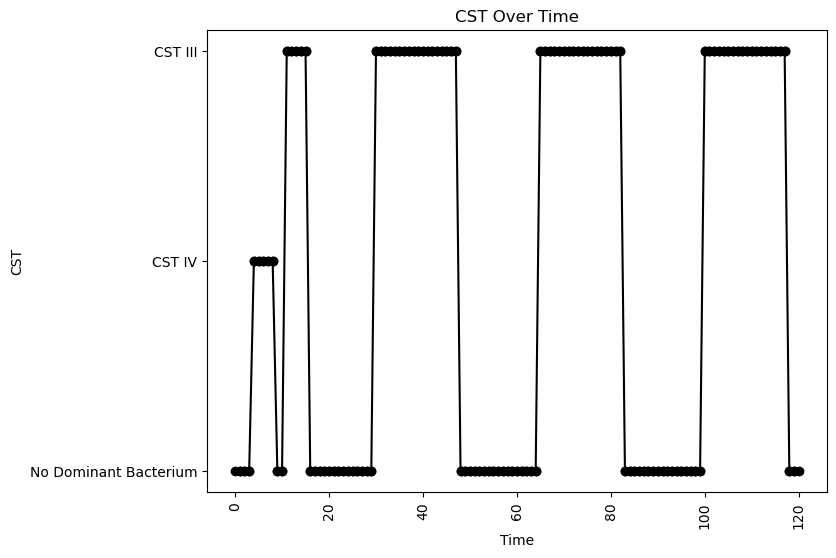


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.14440742715577837
oLB Growth: 0.058910478352813524
nAB Self: -0.0801665462748247
nAB->Li: -0.17245770552713224
nAB->oLB: -0.1410088226161878
Li->nAB: 0.06640678160179136
Li Self: -0.0667534099728053
Li->oLB: -0.3794546562055375
oLB->nAB: -0.4298743187260223
oLB->Li: 0.0990742508371033
oLB Self: -0.026523960515146203

Simulation 2422 follows a valid CST progression:


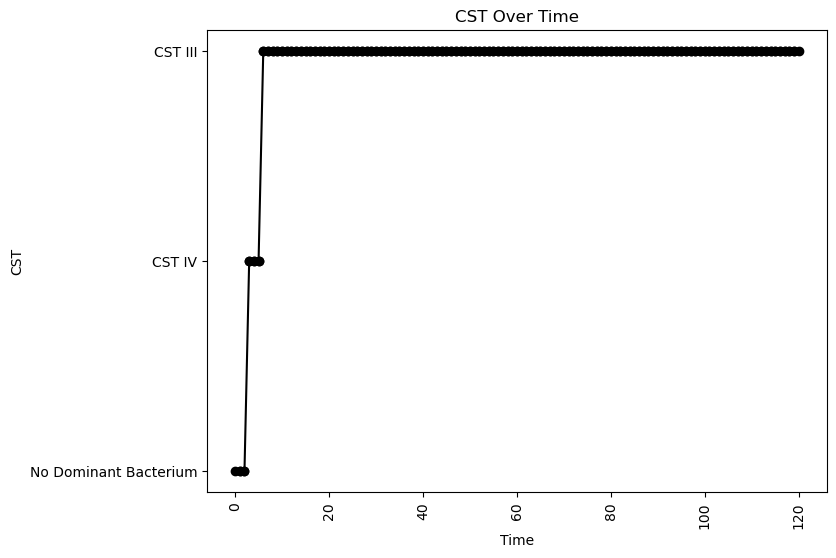


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.05929873327675759
nAB->Li: 0.25879583771974635
nAB->oLB: -0.12456092792802065
Li->nAB: 0.47565737800813856
Li Self: -0.05492326373943905
Li->oLB: -0.2444907477336622
oLB->nAB: -0.2165875364599677
oLB->Li: -0.15174792286164485
oLB Self: -0.019623139140379636

Simulation 2423 follows a valid CST progression:


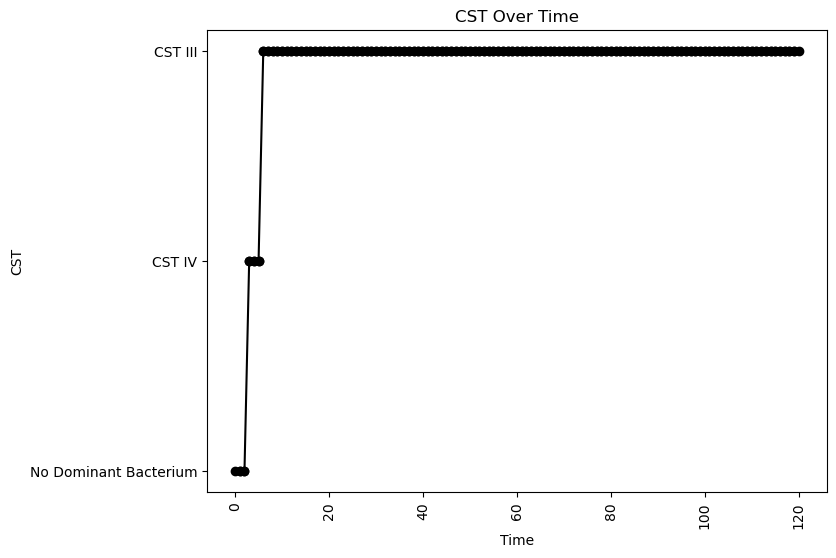


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.06269120782384861
nAB->Li: -0.33377821939439356
nAB->oLB: -0.1289927344786438
Li->nAB: 0.3672318654336605
Li Self: -0.04245069926839717
Li->oLB: -0.3308409373854083
oLB->nAB: -0.39172428514526275
oLB->Li: -0.3523496875343072
oLB Self: -0.09354154628304277

Simulation 2433 follows a valid CST progression:


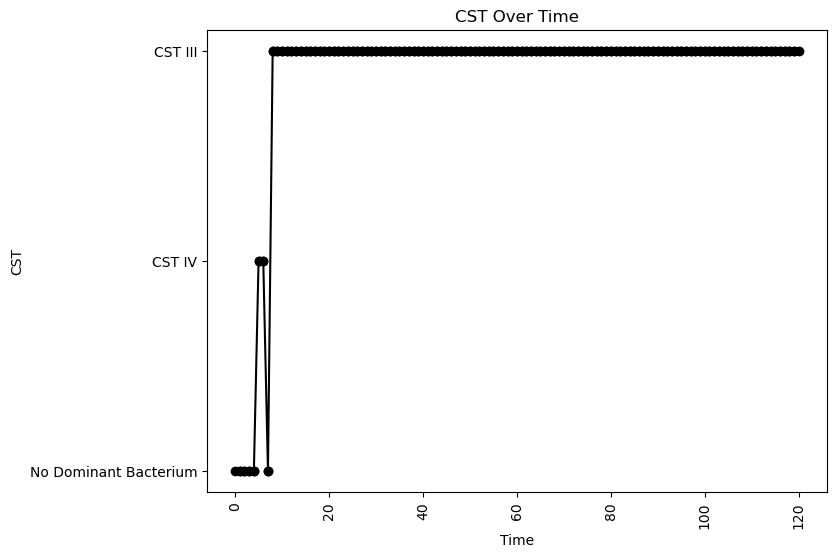


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.07138373862454866
nAB->Li: -0.4583461324114553
nAB->oLB: -0.32558265104354744
Li->nAB: 0.21908321444474477
Li Self: -0.005192096801910212
Li->oLB: 0.15571642468289526
oLB->nAB: -0.4001531531381836
oLB->Li: -0.12989711648492303
oLB Self: -0.06568890408384064

Simulation 2435 follows a valid CST progression:


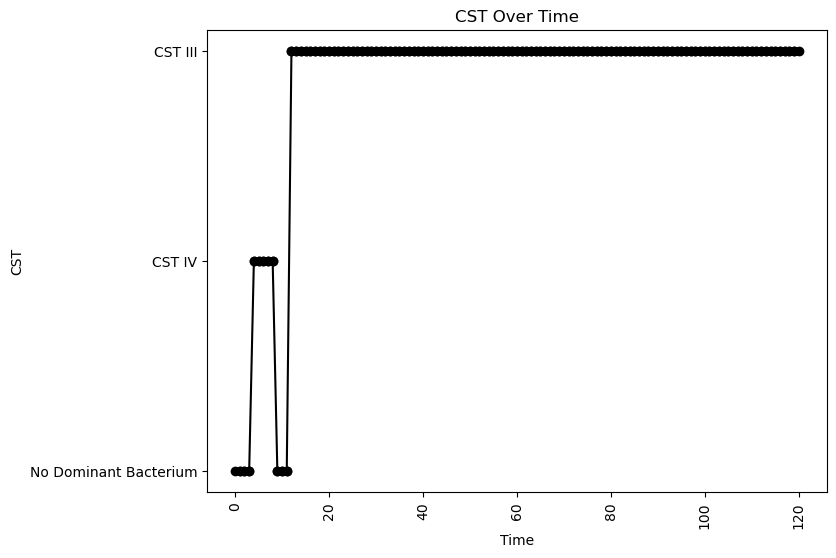


Interaction Parameters:
nAB Growth: 2.284416841880324
Li Growth: 0.294341220394397
oLB Growth: 0.35838896078112936
nAB Self: -0.07279676035957575
nAB->Li: 0.01535457989188016
nAB->oLB: -0.060757136145061674
Li->nAB: 0.029005672816443506
Li Self: -0.018679714918926518
Li->oLB: -0.31003298673639246
oLB->nAB: -0.3321218065044349
oLB->Li: -0.49014157993549284
oLB Self: -0.0761394933261777

Simulation 2439 follows a valid CST progression:


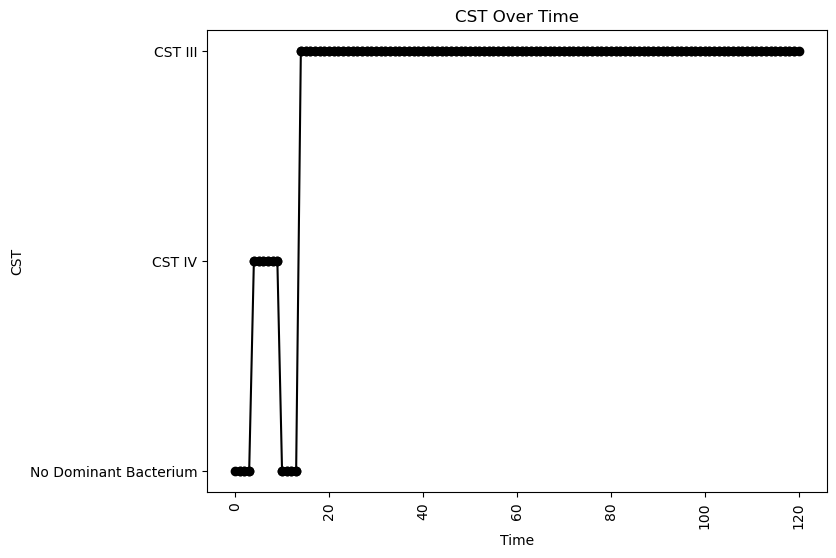


Interaction Parameters:
nAB Growth: 2.2489702826927647
Li Growth: 0.07143879299629578
oLB Growth: 0.24213610993368434
nAB Self: -0.09460582998347329
nAB->Li: 0.04645262364039604
nAB->oLB: -0.10478897444950341
Li->nAB: 0.0791428924072276
Li Self: -0.03959919456245199
Li->oLB: -0.14612113778359265
oLB->nAB: -0.36423682647064015
oLB->Li: -0.42631944086685025
oLB Self: -0.04775955424062874

Simulation 2447 follows a valid CST progression:


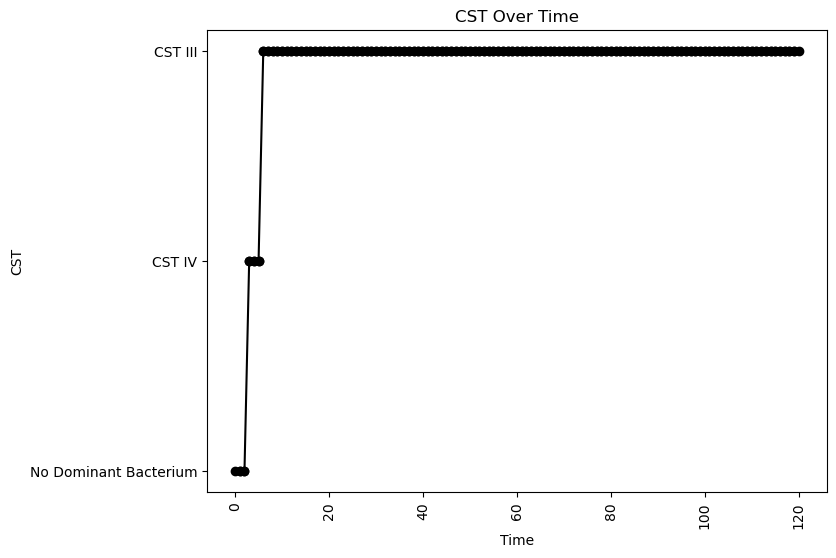


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.0036541749464458345
nAB->Li: 0.05679562418872586
nAB->oLB: -0.07824682794418791
Li->nAB: 0.3475782954360791
Li Self: -0.011245403117608563
Li->oLB: 0.2838298151253905
oLB->nAB: -0.2509051622417556
oLB->Li: -0.08275272146007501
oLB Self: -0.006938323247550518

Simulation 2456 follows a valid CST progression:


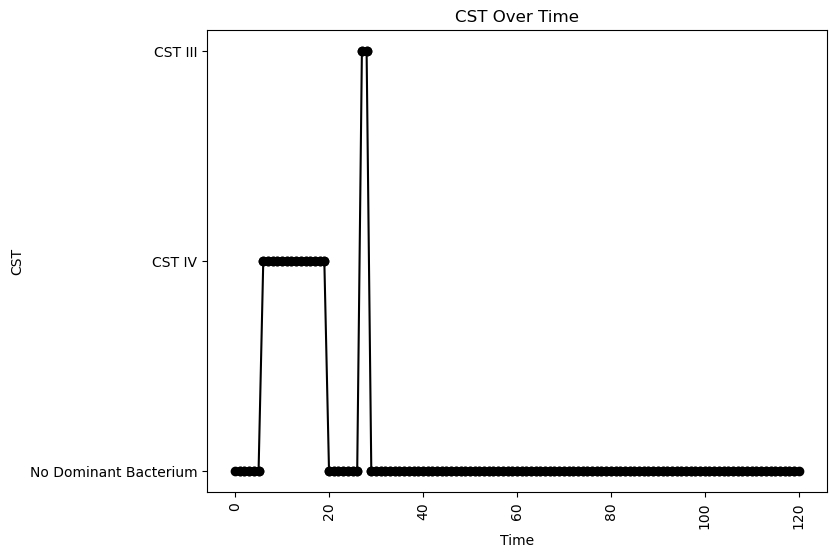


Interaction Parameters:
nAB Growth: 2.2088016144568243
Li Growth: 0.05268768924856952
oLB Growth: 1.1274304047774089
nAB Self: -0.062401173823455655
nAB->Li: -0.116796393008187
nAB->oLB: -0.4727990001537963
Li->nAB: 0.023618115107698623
Li Self: -0.034936372530248685
Li->oLB: 0.3719236849895172
oLB->nAB: -0.2723861192703031
oLB->Li: 0.39267409550862165
oLB Self: -0.03502865721731728

Simulation 2457 follows a valid CST progression:


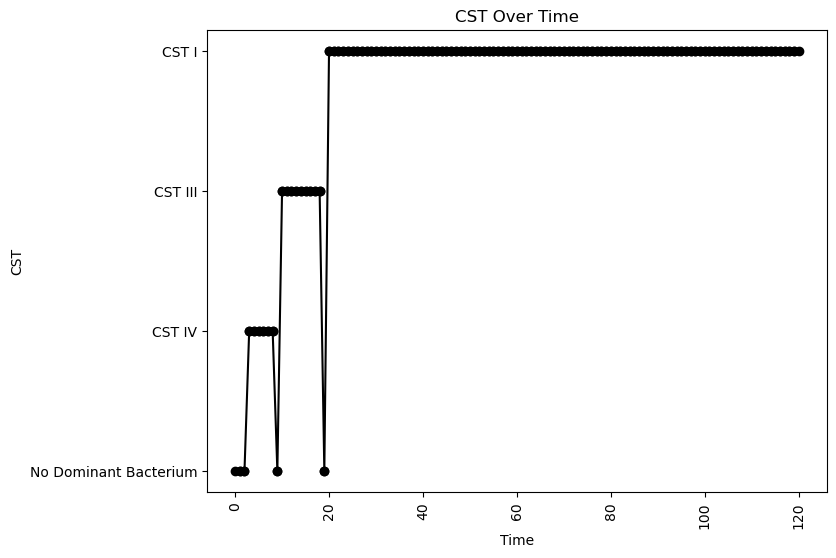


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.04173765548684534
nAB->Li: -0.10577895847582969
nAB->oLB: -0.2036177786697957
Li->nAB: 0.12117268989890106
Li Self: -0.02669038905454013
Li->oLB: -0.21321873299705085
oLB->nAB: -0.21431709490408163
oLB->Li: 0.11994609860326666
oLB Self: -0.040019063743687286

Simulation 2459 follows a valid CST progression:


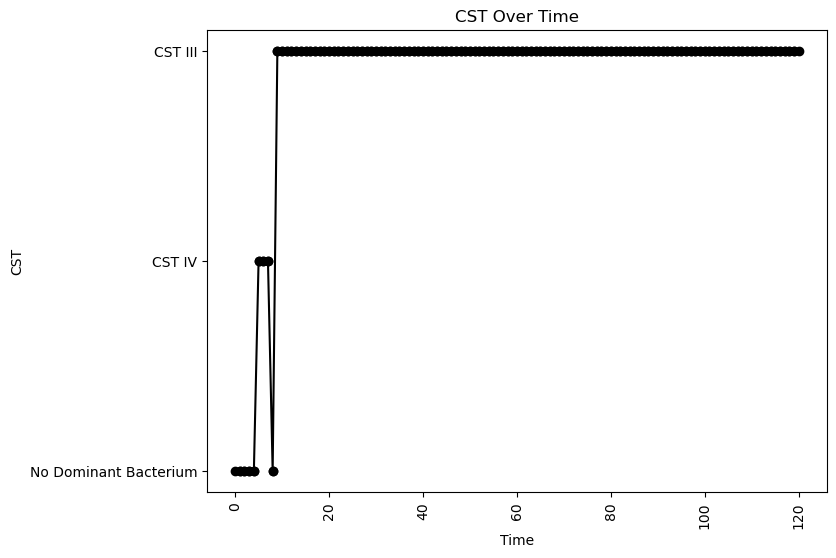


Interaction Parameters:
nAB Growth: 2.0745101401728236
Li Growth: 0.010341045972876578
oLB Growth: 1.1507970527071554
nAB Self: -0.039133392451750716
nAB->Li: -0.4399883469988151
nAB->oLB: -0.424089169832067
Li->nAB: 0.3988656233193729
Li Self: -0.03282135363693854
Li->oLB: 0.04039982004729137
oLB->nAB: -0.2687250397451161
oLB->Li: -0.14482527923951954
oLB Self: -0.05396783391191186

Simulation 2468 follows a valid CST progression:


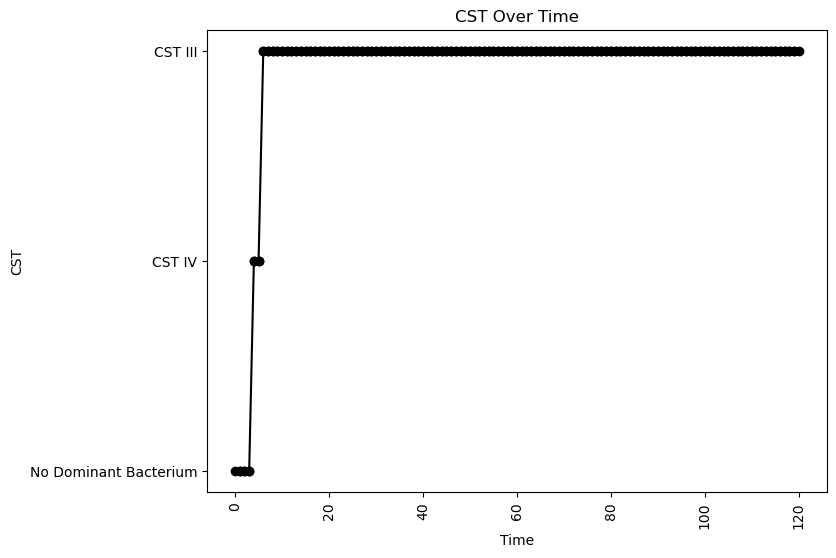


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.00542627560813877
nAB->Li: 0.18683311089149313
nAB->oLB: -0.23900043810081795
Li->nAB: 0.3831621212662113
Li Self: -0.07185429254676057
Li->oLB: 0.1106478660586998
oLB->nAB: -0.12139148352483464
oLB->Li: 0.1559659407901921
oLB Self: -0.01136079582266028

Simulation 2469 follows a valid CST progression:


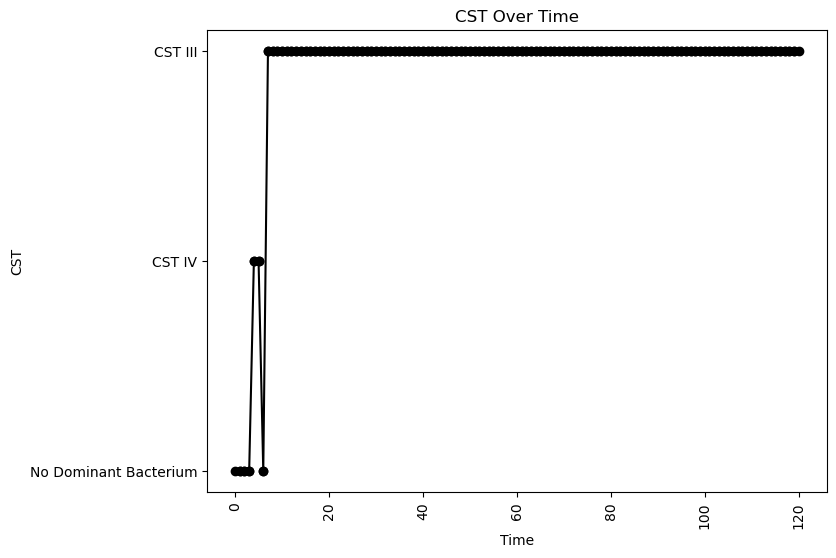


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.05024877389891124
nAB->Li: -0.2600841650751733
nAB->oLB: -0.30573986731469505
Li->nAB: 0.3289897196678362
Li Self: -0.08410749037550282
Li->oLB: -0.2899873323816595
oLB->nAB: -0.3009608745733532
oLB->Li: -0.11863376570869277
oLB Self: -0.09071785938698619

Simulation 2477 follows a valid CST progression:


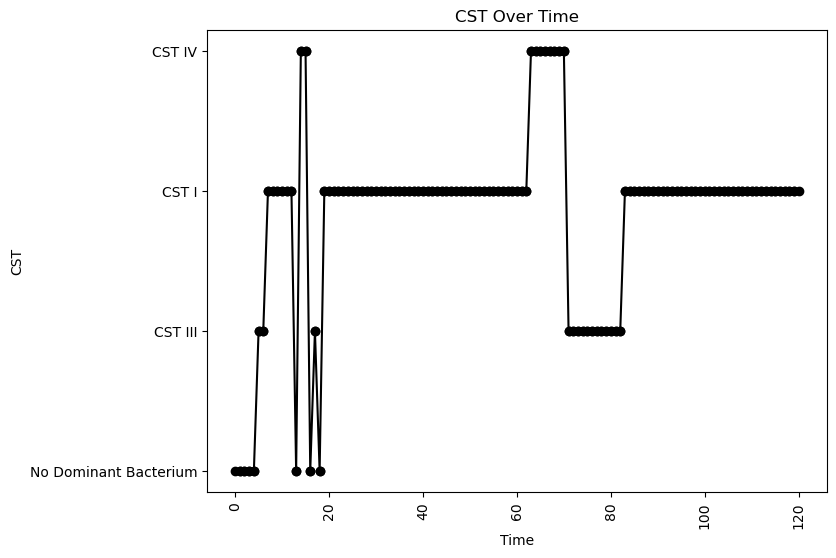


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.3079123457844041
oLB Growth: 0.1039349296945926
nAB Self: -0.038893661896919104
nAB->Li: -0.3586134215418833
nAB->oLB: -0.2455124061738737
Li->nAB: 0.36283761988420904
Li Self: -0.032788589166337964
Li->oLB: -0.37426952693696436
oLB->nAB: -0.4227296058153284
oLB->Li: 0.36766384545829334
oLB Self: -0.09688077778735235

Simulation 2479 follows a valid CST progression:


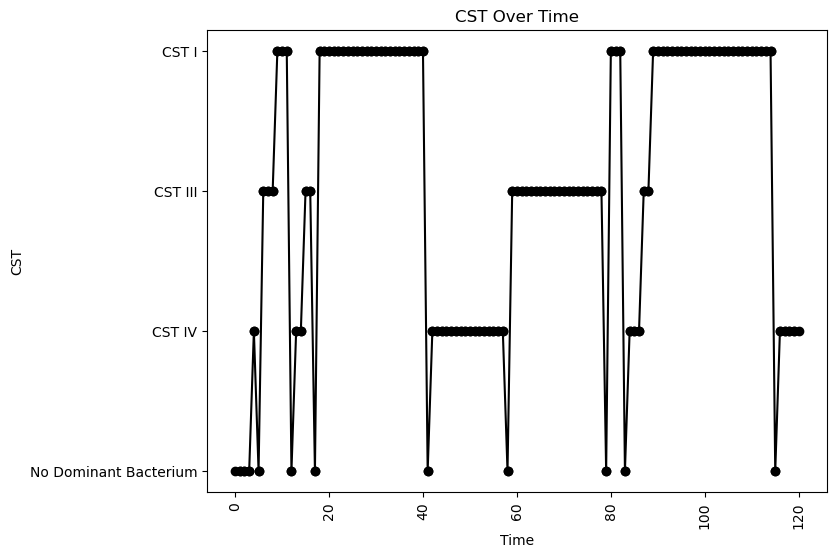


Interaction Parameters:
nAB Growth: 2.2657644953374403
Li Growth: 0.18569754038266065
oLB Growth: 0.2949021384914317
nAB Self: -0.0966593737382336
nAB->Li: -0.2061063819747163
nAB->oLB: -0.14314777072386448
Li->nAB: 0.2894026513324015
Li Self: -0.05891766376391738
Li->oLB: -0.3408718511045994
oLB->nAB: -0.26441696809433307
oLB->Li: 0.2453464860822363
oLB Self: -0.06162225435384347

Simulation 2488 follows a valid CST progression:


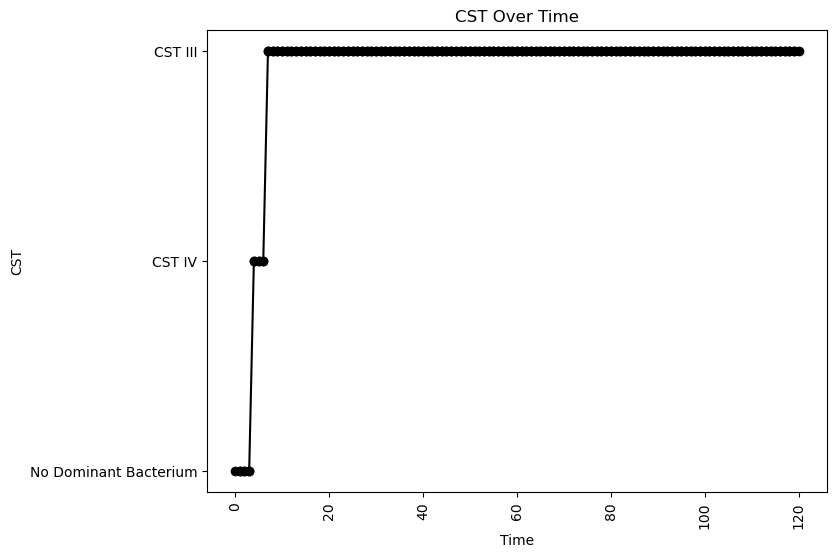


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.06664492138468138
oLB Growth: 0.6588037441195057
nAB Self: -0.08977988227034917
nAB->Li: -0.05114944230297924
nAB->oLB: -0.39415157220809727
Li->nAB: 0.31742391662632163
Li Self: -0.08128724691695202
Li->oLB: 0.23771667204381586
oLB->nAB: -0.2642744979580657
oLB->Li: -0.06568458786226938
oLB Self: -0.04297579875479479

Simulation 2489 follows a valid CST progression:


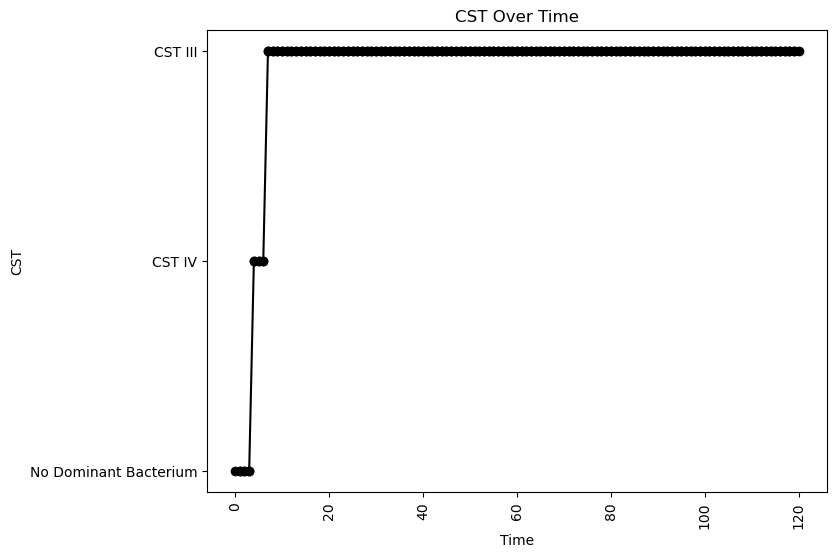


Interaction Parameters:
nAB Growth: 2.172057972480792
Li Growth: 0.05464936187495586
oLB Growth: 1.1816194682992254
nAB Self: -0.007259304681350526
nAB->Li: -0.4627006316169027
nAB->oLB: -0.1828328496184175
Li->nAB: 0.3684443322487637
Li Self: -0.03834615618892203
Li->oLB: 0.3132185639203263
oLB->nAB: -0.08890251508981972
oLB->Li: -0.2997205174561698
oLB Self: -0.062160858939712585

Simulation 2497 follows a valid CST progression:


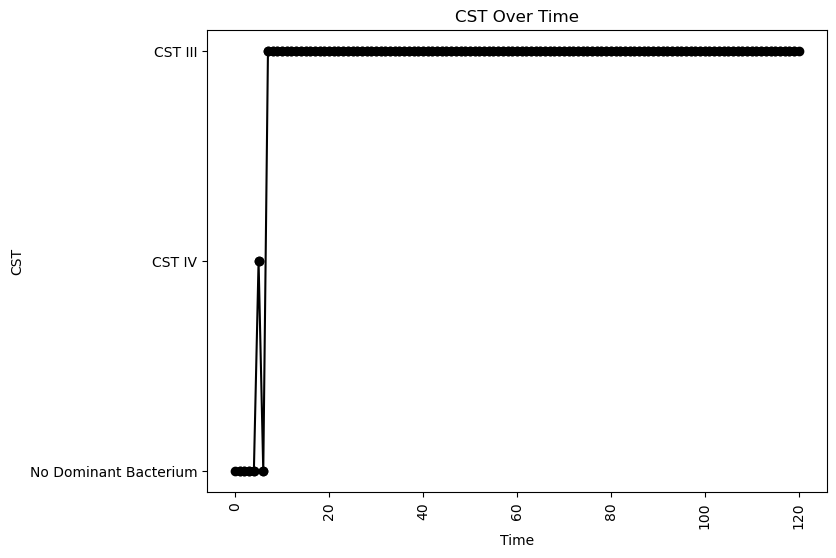


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.09525099335218276
nAB->Li: -0.45222126399364937
nAB->oLB: -0.004199280231606983
Li->nAB: 0.2827746649789812
Li Self: -0.013314382969016408
Li->oLB: 0.49436197864220277
oLB->nAB: -0.3924489153488008
oLB->Li: -0.47848534312725954
oLB Self: -0.0978363859126935

Simulation 2500 follows a valid CST progression:


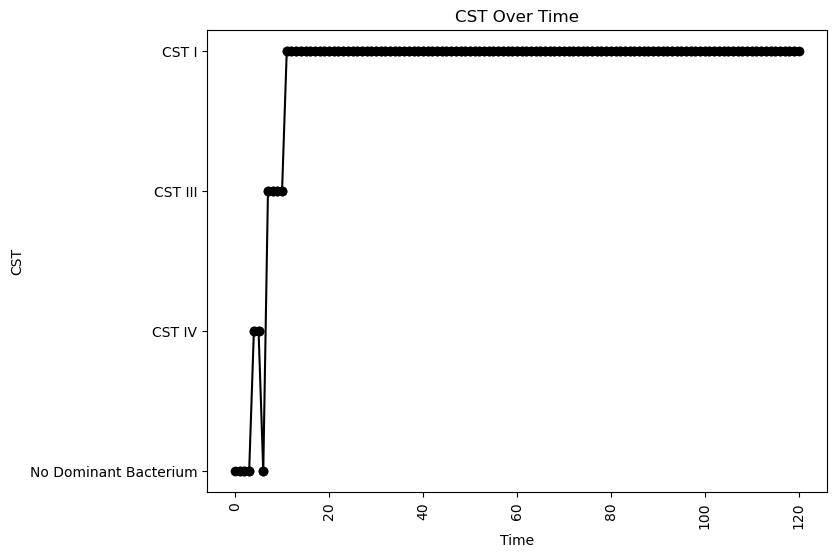


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.08152245801740982
nAB->Li: -0.24932727172592895
nAB->oLB: -0.16311982717340773
Li->nAB: 0.3843735782264267
Li Self: -0.05018585087015533
Li->oLB: -0.13858567654512272
oLB->nAB: -0.33331866197186355
oLB->Li: 0.1976664842938688
oLB Self: -0.052732358504627826

Simulation 2506 follows a valid CST progression:


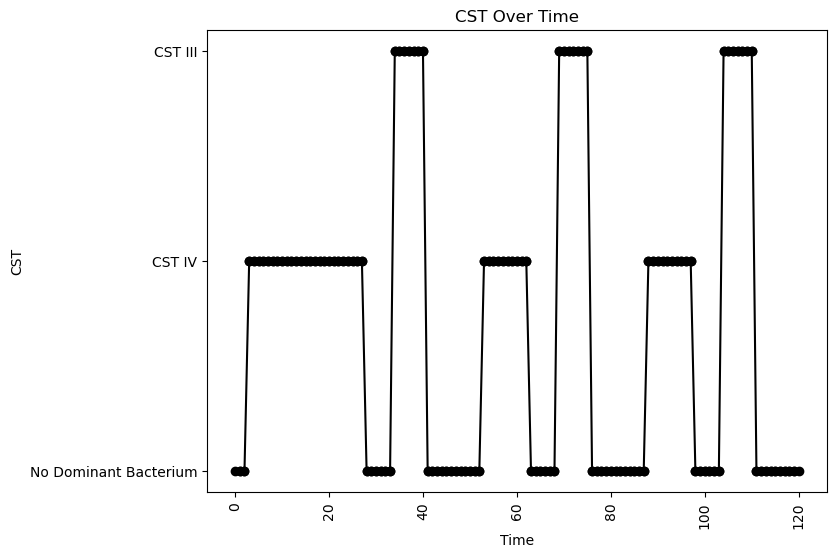


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.05203813844785001
nAB->Li: -0.10484064575725732
nAB->oLB: -0.3299280078891834
Li->nAB: 0.031185753591003396
Li Self: -0.05124606180025517
Li->oLB: 0.46425150501166146
oLB->nAB: -0.05860161597632413
oLB->Li: -0.0021598638247185
oLB Self: -0.08182312590826754

Simulation 2512 follows a valid CST progression:


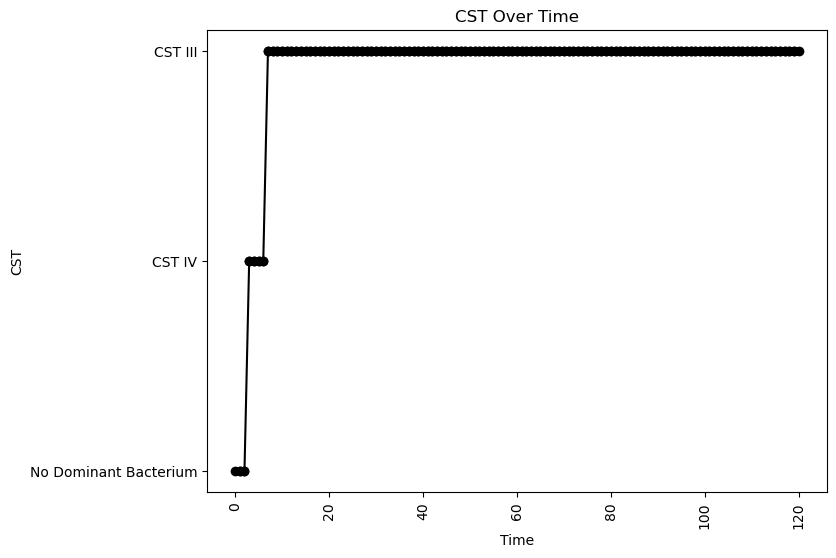


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.053172544372875795
nAB->Li: -0.17258258557486406
nAB->oLB: -0.4893932292203563
Li->nAB: 0.19440025025656826
Li Self: -0.07500293241704496
Li->oLB: -0.2533751312747105
oLB->nAB: -0.3097229259640548
oLB->Li: -0.3427867192630658
oLB Self: -0.08641376558294078

Simulation 2520 follows a valid CST progression:


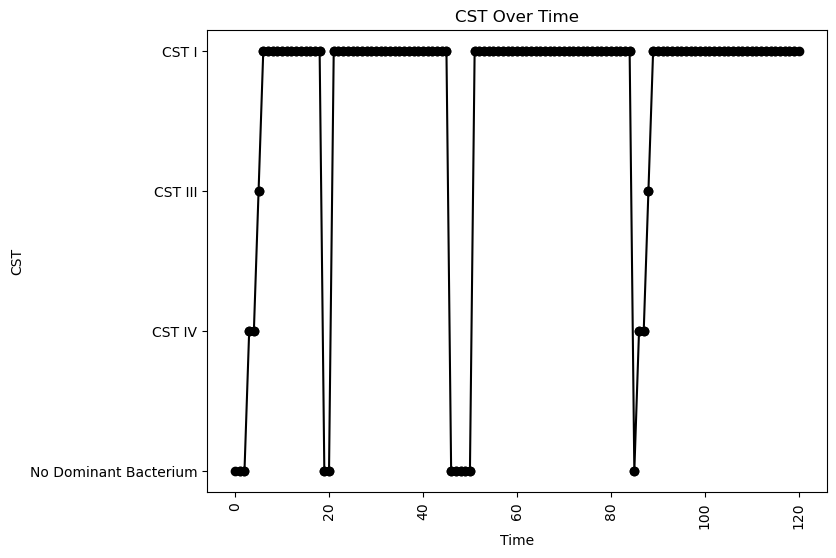


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.004816963285277656
nAB->Li: -0.0429598479068769
nAB->oLB: -0.18876593361471433
Li->nAB: 0.413962658370321
Li Self: -0.05967442689453546
Li->oLB: -0.04581674159141241
oLB->nAB: -0.018698117251425117
oLB->Li: 0.160280479531678
oLB Self: -0.09622277622802285

Simulation 2522 follows a valid CST progression:


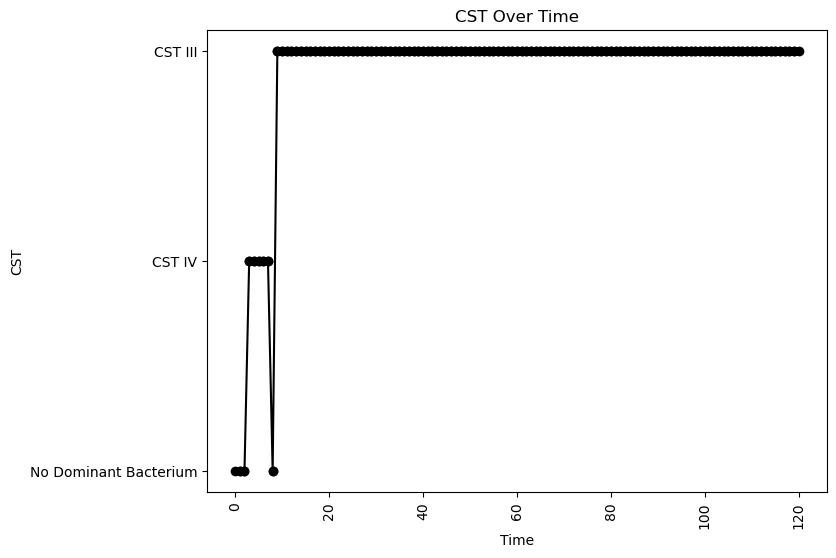


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.01706770754346898
nAB->Li: -0.11229261038882105
nAB->oLB: -0.02512927784007357
Li->nAB: 0.07583930261838423
Li Self: -0.0335191658132246
Li->oLB: 0.20424183650982453
oLB->nAB: -0.38260951160690276
oLB->Li: -0.26552542651198185
oLB Self: -0.03236007509136636

Simulation 2533 follows a valid CST progression:


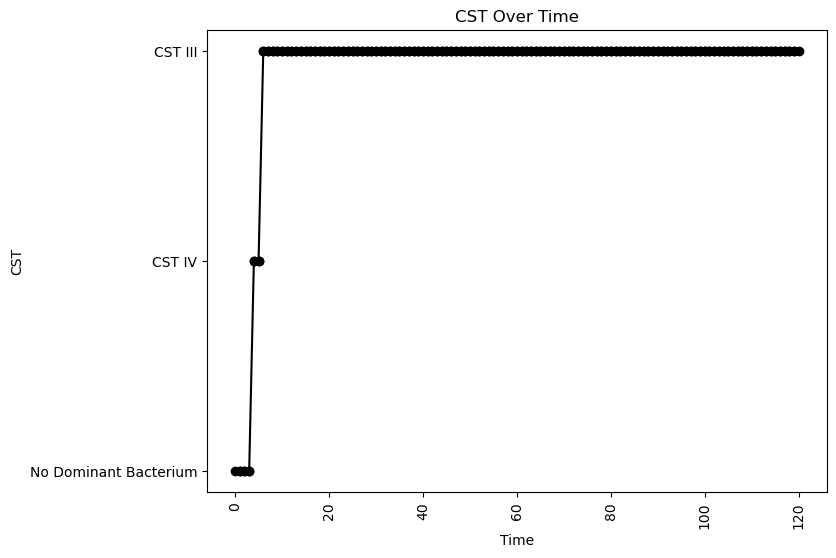


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.17436248480368344
oLB Growth: 0.08496126009849418
nAB Self: -0.007641993453330789
nAB->Li: 0.013042200553400551
nAB->oLB: -0.40719894237572335
Li->nAB: 0.20248426562170974
Li Self: -0.020540339140132702
Li->oLB: 0.41219856232552765
oLB->nAB: -0.2261238122821167
oLB->Li: -0.20860426479325556
oLB Self: -0.03819094380446819

Simulation 2535 follows a valid CST progression:


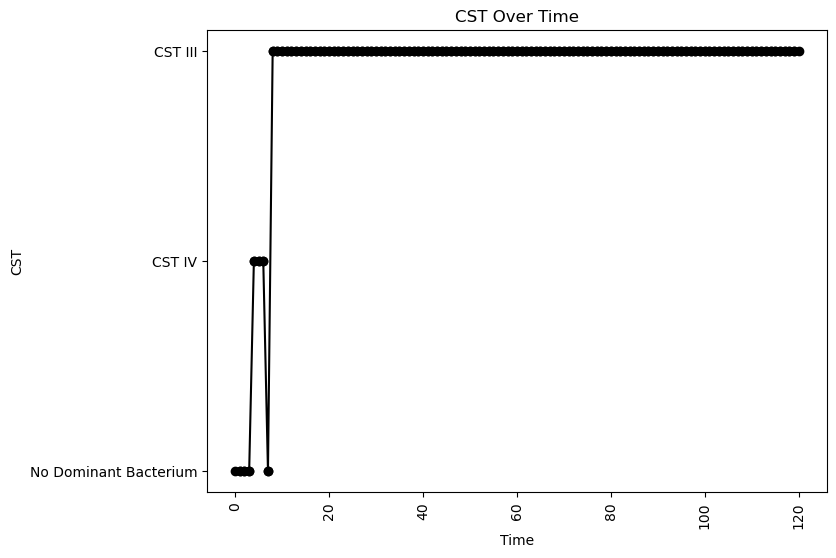


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.06664492138468138
oLB Growth: 0.6588037441195057
nAB Self: -0.09425304977024682
nAB->Li: -0.4592670288041035
nAB->oLB: -0.49297191812709396
Li->nAB: 0.23231954708924107
Li Self: -0.017955386806634402
Li->oLB: 0.22843401398904506
oLB->nAB: -0.3322638654685134
oLB->Li: -0.302045578662425
oLB Self: -0.0611689352346295

Simulation 2536 follows a valid CST progression:


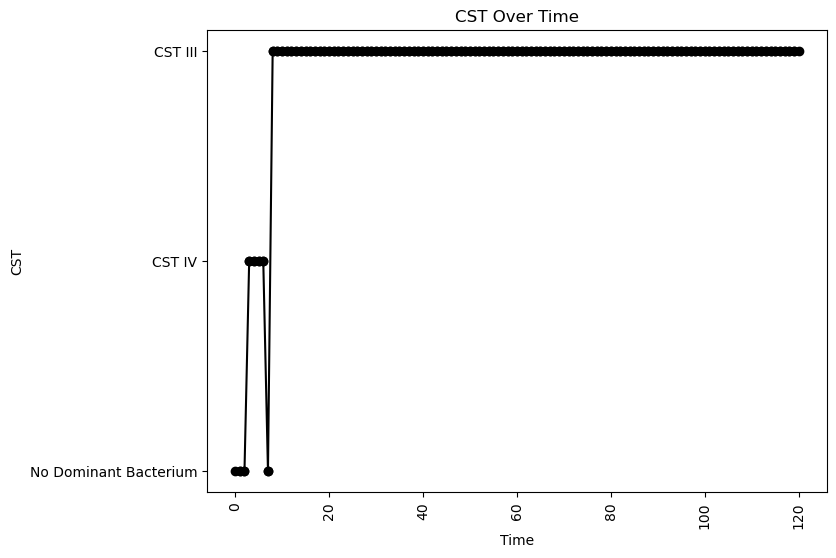


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.06495430992206574
oLB Growth: 0.1731103059651596
nAB Self: -0.08904790953199059
nAB->Li: -0.16591100169559486
nAB->oLB: -0.31503066401409674
Li->nAB: 0.1928560192694292
Li Self: -0.08634657783408717
Li->oLB: 0.22258390733564182
oLB->nAB: -0.024686899692810016
oLB->Li: -0.16046688044357516
oLB Self: -0.09136615327714867

Simulation 2539 follows a valid CST progression:


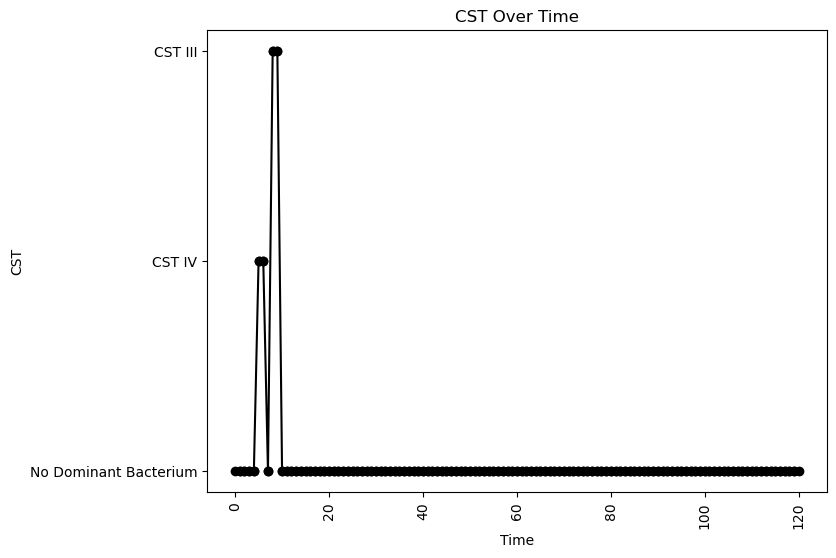


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.033103363374529016
nAB->Li: -0.3420249945629389
nAB->oLB: -0.1639937023175903
Li->nAB: 0.24356993478188438
Li Self: -0.06617977232418087
Li->oLB: 0.15270684090288456
oLB->nAB: -0.08452604867740554
oLB->Li: 0.19319313441839991
oLB Self: -0.07648793751481239

Simulation 2540 follows a valid CST progression:


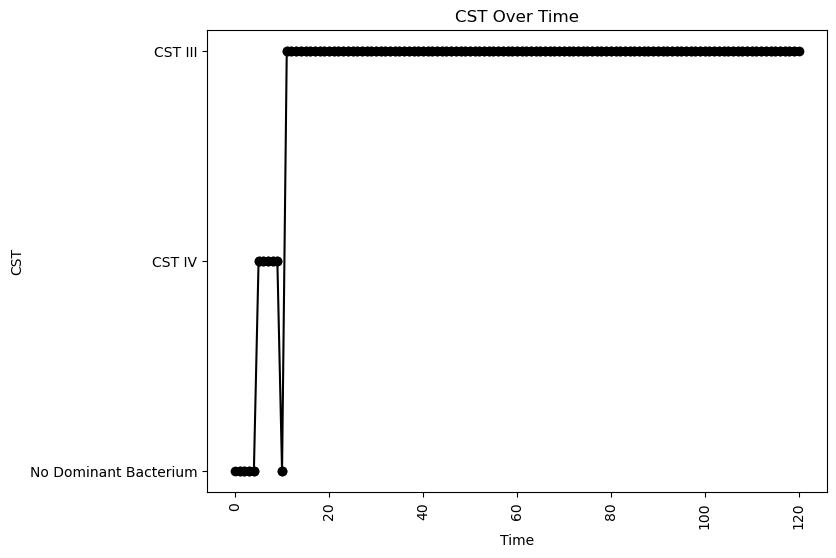


Interaction Parameters:
nAB Growth: 2.2609282147211935
Li Growth: 0.06381435834914458
oLB Growth: 0.1660151901294062
nAB Self: -0.03459287666784072
nAB->Li: -0.17082733101555336
nAB->oLB: -0.39406426680325285
Li->nAB: 0.1456621733182759
Li Self: -0.022032227829482706
Li->oLB: 0.22797428027849198
oLB->nAB: -0.1604143722619807
oLB->Li: 0.04553178300314831
oLB Self: -0.069169293028562

Simulation 2543 follows a valid CST progression:


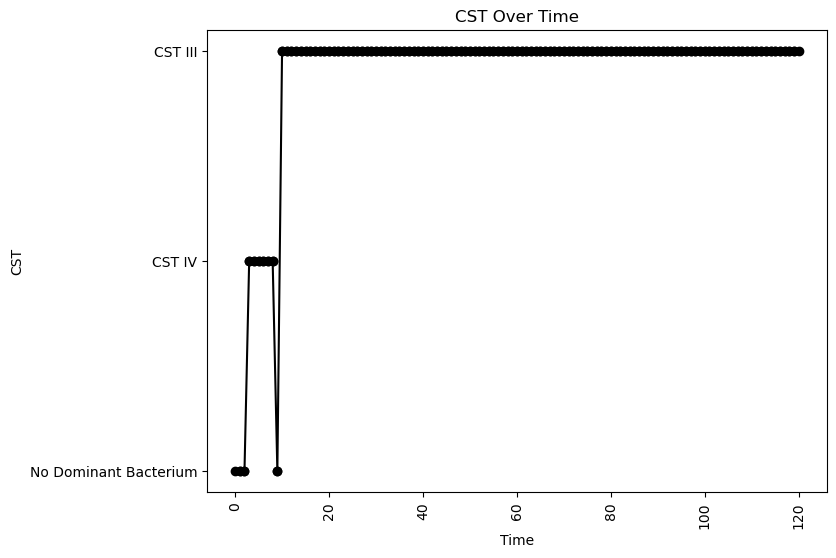


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.05427814266472834
nAB->Li: -0.46828319474472274
nAB->oLB: -0.05788578969767927
Li->nAB: 0.05137505066091408
Li Self: -0.02098972528025639
Li->oLB: 0.33024649884226087
oLB->nAB: -0.05747287037597881
oLB->Li: 0.06923096547202645
oLB Self: -0.08206380801790944

Simulation 2544 follows a valid CST progression:


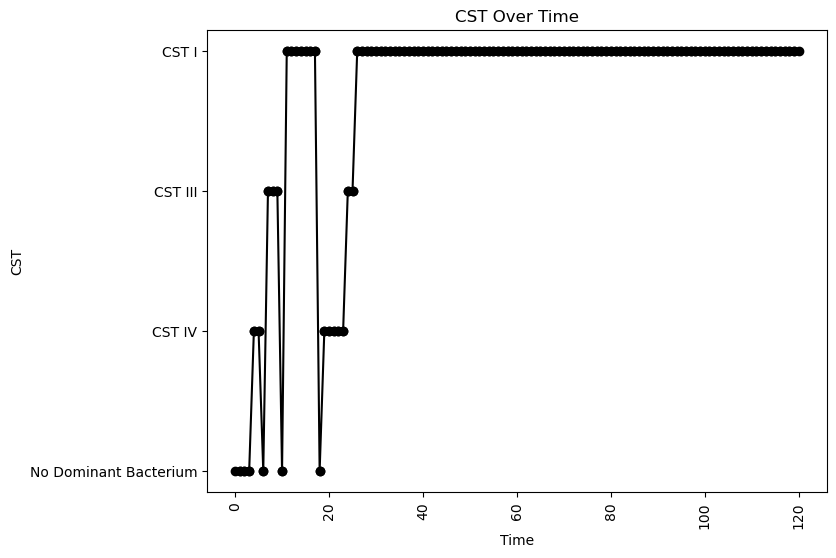


Interaction Parameters:
nAB Growth: 2.2489702826927647
Li Growth: 0.07143879299629578
oLB Growth: 0.24213610993368434
nAB Self: -0.0584264361961993
nAB->Li: -0.40743236314910203
nAB->oLB: -0.29277214813573427
Li->nAB: 0.36238052156419875
Li Self: -0.06926240417040597
Li->oLB: -0.4098839105529895
oLB->nAB: -0.3563067547754598
oLB->Li: 0.3209193685103686
oLB Self: -0.08015708541675157

Simulation 2546 follows a valid CST progression:


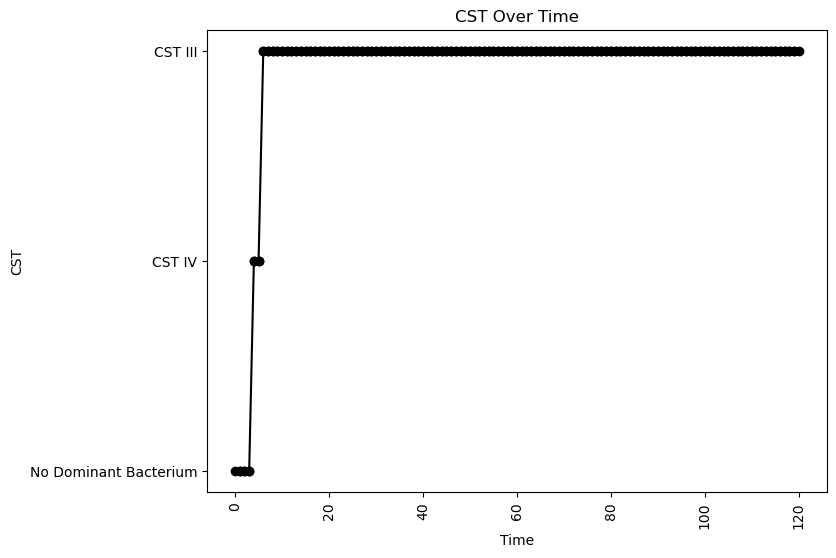


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.03837725110012093
oLB Growth: 1.155917868199191
nAB Self: -0.05288667397795945
nAB->Li: -0.22705997188668448
nAB->oLB: -0.22439932703374493
Li->nAB: 0.479142717331569
Li Self: -0.05504926976106089
Li->oLB: 0.31453033019989507
oLB->nAB: -0.37065629837563807
oLB->Li: 0.10491009205133339
oLB Self: -0.057609435784862766

Simulation 2547 follows a valid CST progression:


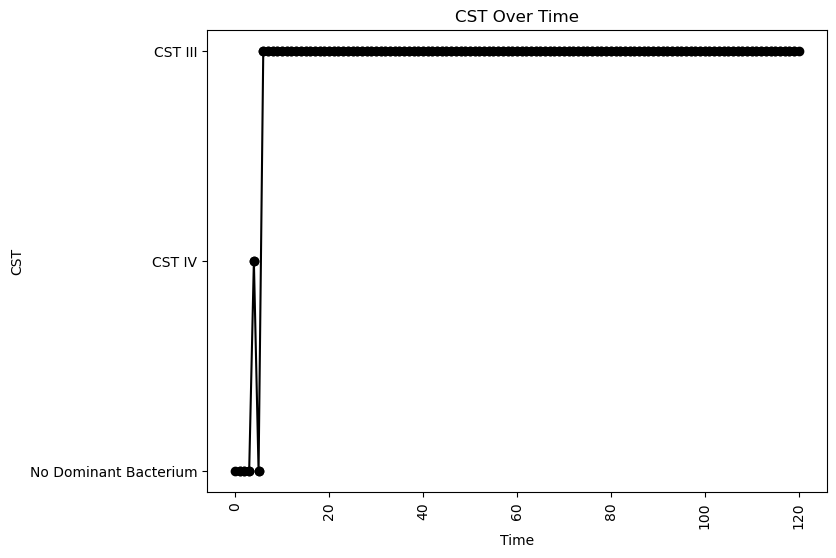


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.23318601390023233
oLB Growth: 0.1368234058063315
nAB Self: -0.03729793843946026
nAB->Li: -0.022062085052041047
nAB->oLB: -0.05071631524293313
Li->nAB: 0.3302697752945085
Li Self: -0.08689536383504116
Li->oLB: -0.009644141286075825
oLB->nAB: -0.011088191118622581
oLB->Li: -0.49636466303505083
oLB Self: -0.0443151994696657

Simulation 2551 follows a valid CST progression:


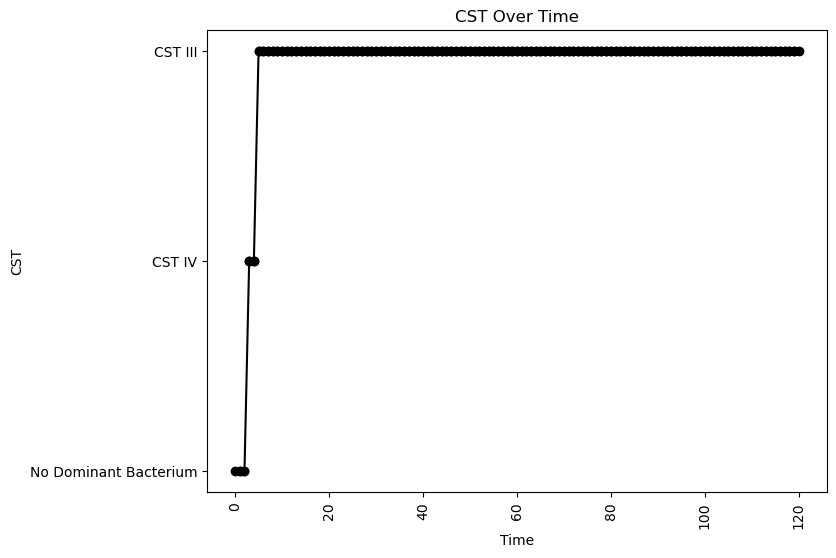


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.07080994157617454
nAB->Li: 0.2729098197112849
nAB->oLB: -0.21296486503637252
Li->nAB: 0.4267789713753204
Li Self: -0.0351653467217312
Li->oLB: -0.42327476227603694
oLB->nAB: -0.37961829199004743
oLB->Li: 0.06083502398406049
oLB Self: -0.017011738965006726

Simulation 2553 follows a valid CST progression:


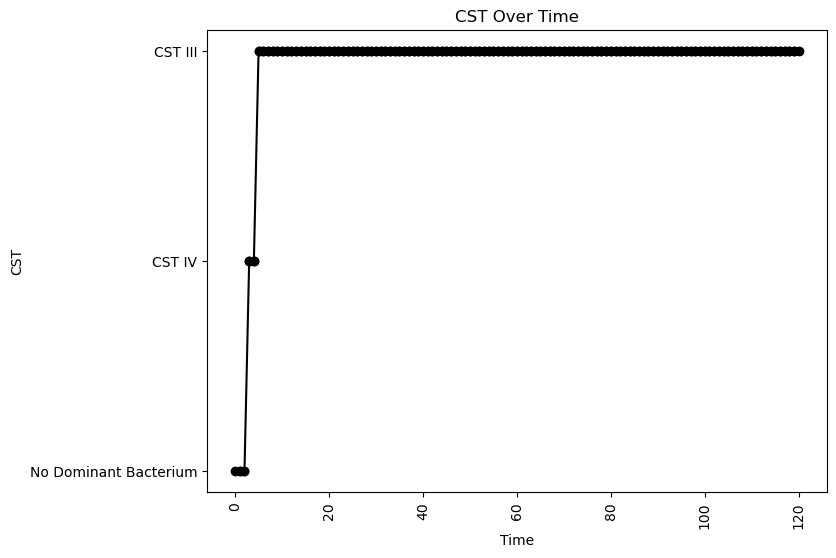


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.05875561444665234
nAB->Li: 0.2430278354491584
nAB->oLB: -0.09930964633126121
Li->nAB: 0.44374403022740727
Li Self: -0.012040902627563507
Li->oLB: 0.41501081242795457
oLB->nAB: -0.28399700239891557
oLB->Li: 0.1795663444868708
oLB Self: -0.09740442743073245

Simulation 2554 follows a valid CST progression:


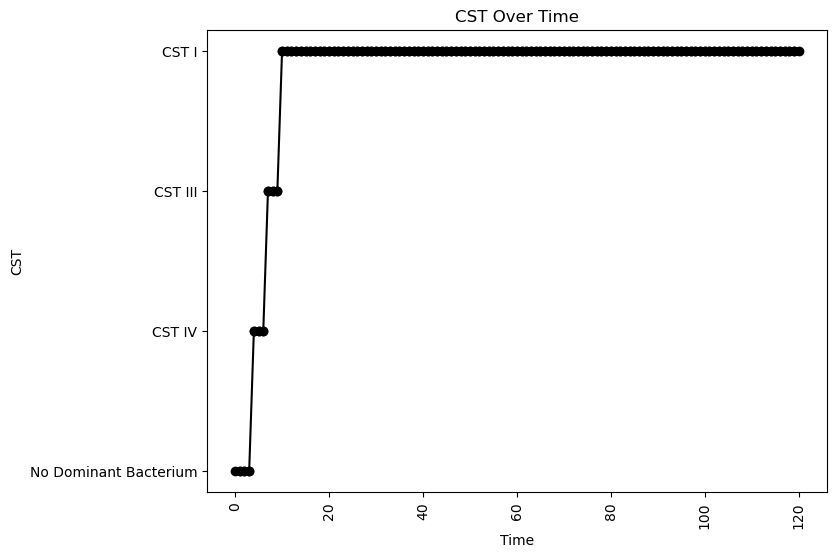


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.049291318865704106
nAB->Li: 0.10860333171324732
nAB->oLB: -0.02555061631073069
Li->nAB: 0.19682811449865312
Li Self: -0.014880272099298444
Li->oLB: 0.035592135425417726
oLB->nAB: -0.4599392320595155
oLB->Li: 0.341029684943686
oLB Self: -0.05099295424510343

Simulation 2556 follows a valid CST progression:


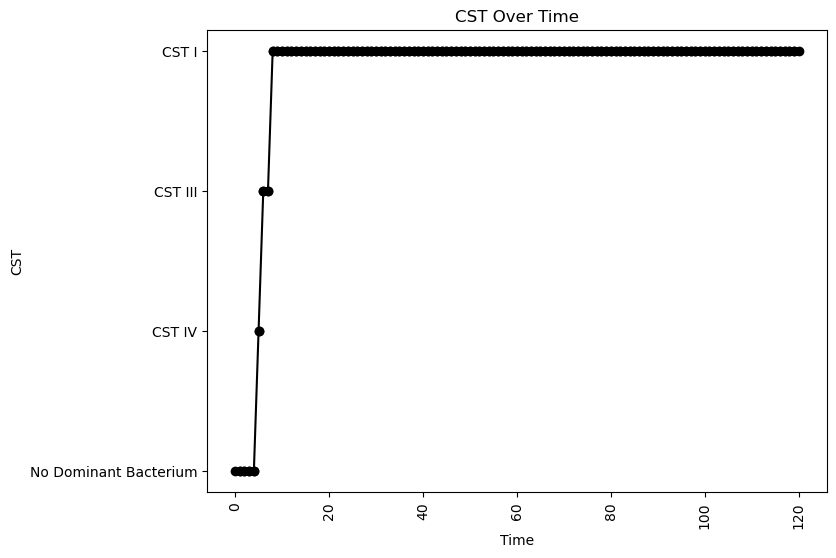


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.0440440922211991
nAB->Li: -0.07506549909900001
nAB->oLB: -0.48870071740150933
Li->nAB: 0.377497424747093
Li Self: -0.05686756386650896
Li->oLB: -0.03265671881840626
oLB->nAB: -0.42954336920300606
oLB->Li: 0.31043463464832144
oLB Self: -0.08791916371107843

Simulation 2561 follows a valid CST progression:


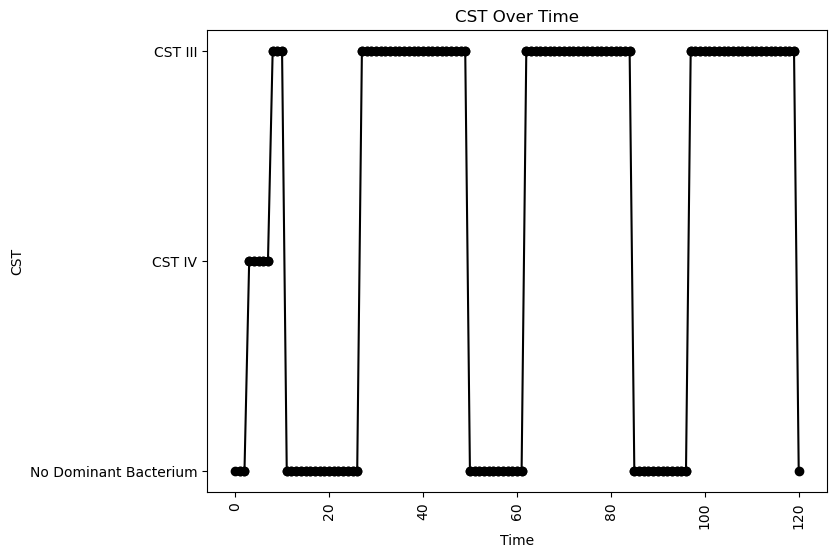


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.011101051449672925
nAB->Li: -0.127448049496881
nAB->oLB: -0.4387213043166566
Li->nAB: 0.13034008943824538
Li Self: -0.09183663839204272
Li->oLB: 0.1706598302995027
oLB->nAB: -0.08697806588572632
oLB->Li: -0.04558106023184255
oLB Self: -0.016238386648020367

Simulation 2565 follows a valid CST progression:


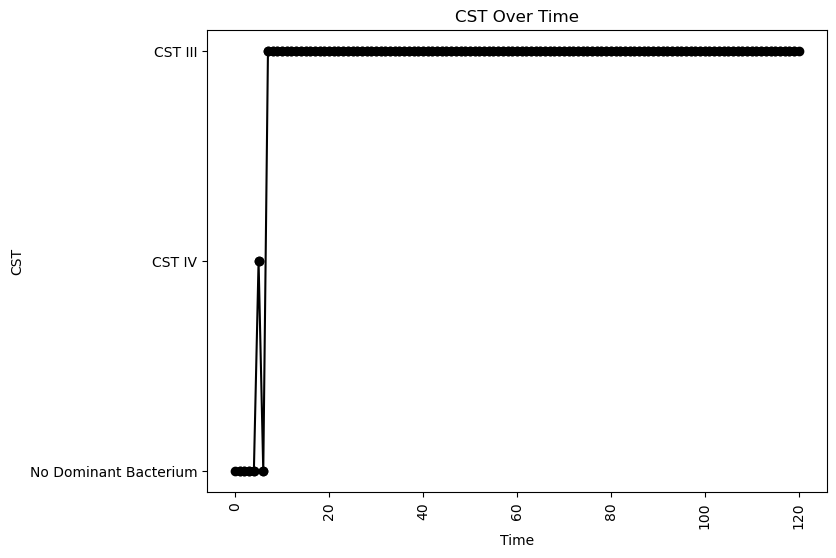


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.33270605559601907
oLB Growth: 0.46591620920123267
nAB Self: -0.06031114070897327
nAB->Li: 0.0757064592673603
nAB->oLB: -0.17471059332132283
Li->nAB: 0.22056511294742054
Li Self: -0.08243501987376194
Li->oLB: -0.3599568689796234
oLB->nAB: -0.32789332490527345
oLB->Li: -0.4412145728561812
oLB Self: -0.0014960316455201045

Simulation 2588 follows a valid CST progression:


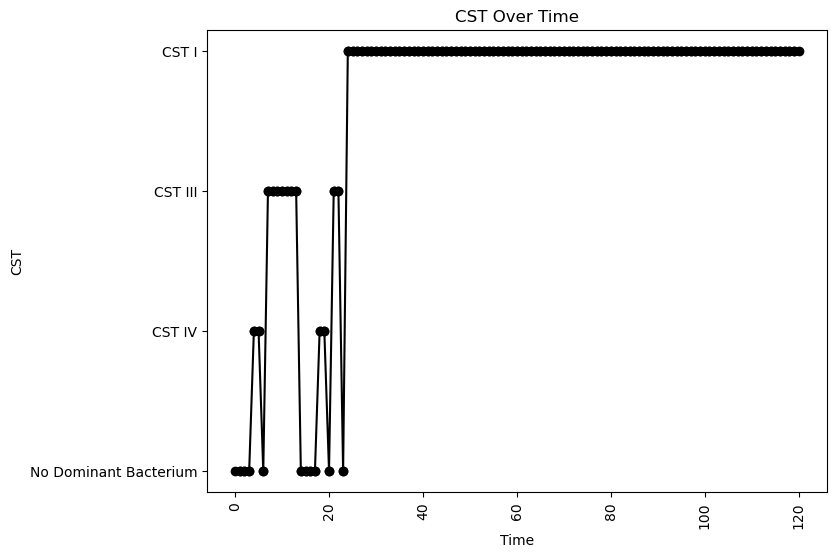


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.04039052727959087
nAB->Li: -0.41128596357318215
nAB->oLB: -0.2370745511838726
Li->nAB: 0.25340050511720547
Li Self: -0.08043121302952037
Li->oLB: -0.4105063160511072
oLB->nAB: -0.394611519874407
oLB->Li: 0.19372648981980634
oLB Self: -0.05544541739361353

Simulation 2597 follows a valid CST progression:


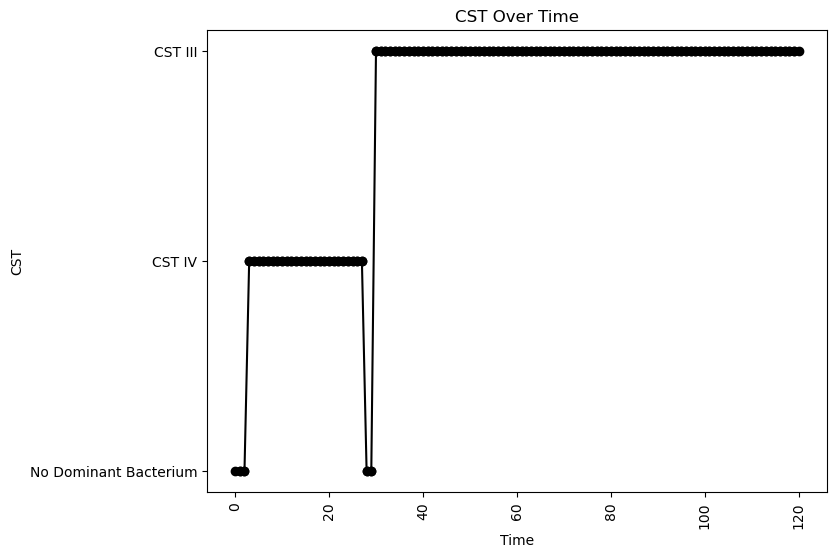


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.06823818557756745
nAB->Li: -0.45818343204677286
nAB->oLB: -0.2718600131926957
Li->nAB: 0.014916326252659595
Li Self: -0.06714353729903182
Li->oLB: -0.1154550716157891
oLB->nAB: -0.4631676073147479
oLB->Li: -0.45999317239466286
oLB Self: -0.05690688224976817

Simulation 2602 follows a valid CST progression:


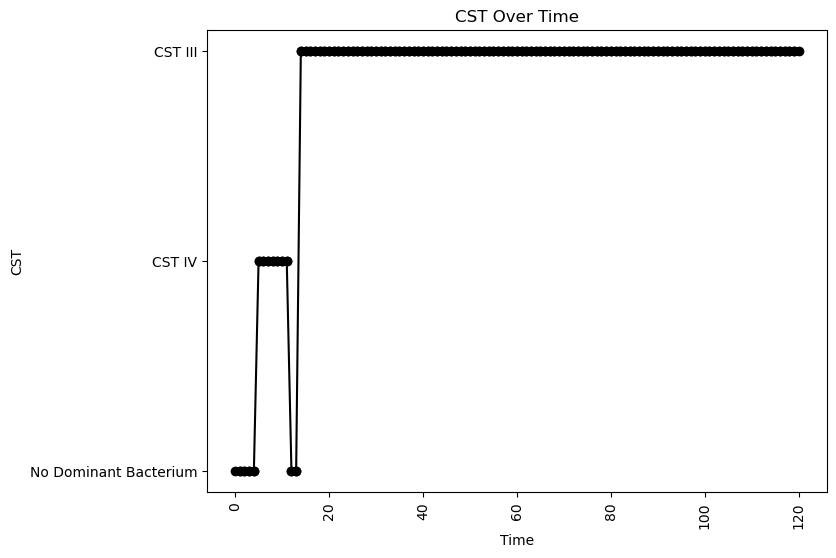


Interaction Parameters:
nAB Growth: 2.1573635369289432
Li Growth: 0.04215849674910016
oLB Growth: 1.2503024394854367
nAB Self: -0.06439768839593571
nAB->Li: -0.0690832273717984
nAB->oLB: -0.466616356701521
Li->nAB: 0.07555974557342293
Li Self: -0.010398920342668136
Li->oLB: 0.26394399754434994
oLB->nAB: -0.16994687713379836
oLB->Li: -0.4660910040300255
oLB Self: -0.02002091751556949

Simulation 2616 follows a valid CST progression:


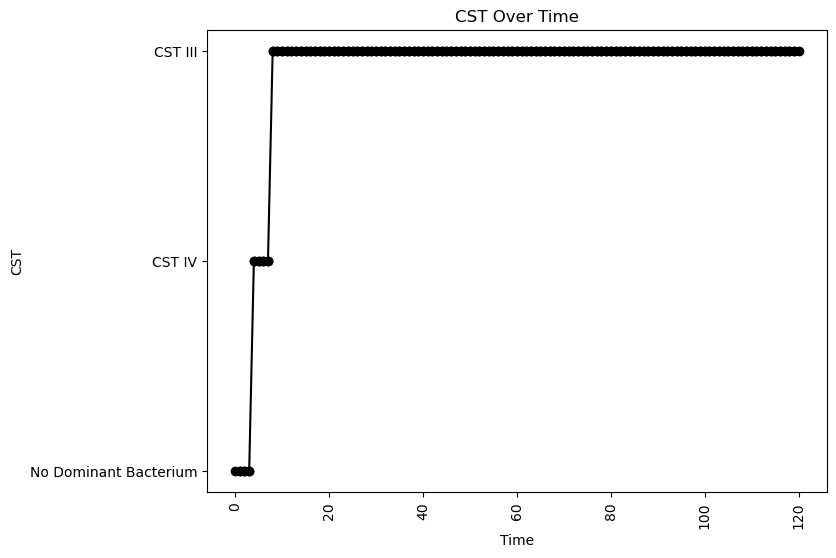


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.050433613373539465
nAB->Li: -0.24556147202067496
nAB->oLB: -0.4679484678240426
Li->nAB: 0.18534766446193307
Li Self: -0.026148435567371522
Li->oLB: -0.10964346115541052
oLB->nAB: -0.05857375774186113
oLB->Li: -0.26407616972064973
oLB Self: -0.0255906139853201

Simulation 2628 follows a valid CST progression:


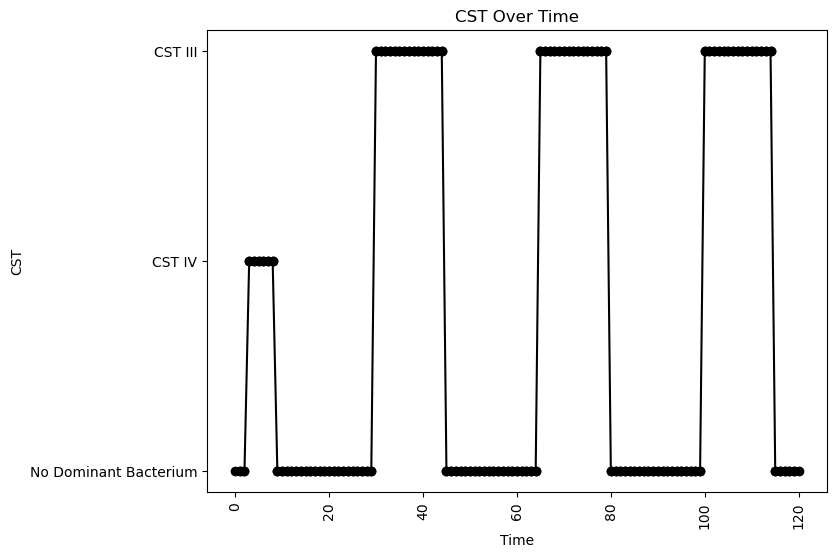


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.08092890628805198
nAB->Li: -0.12471153357661485
nAB->oLB: -0.41692427299941326
Li->nAB: 0.11120622155226512
Li Self: -0.09544276758926504
Li->oLB: -0.32190240796251024
oLB->nAB: -0.4626617647592807
oLB->Li: 0.03663375933984747
oLB Self: -0.010974624425440546

Simulation 2632 follows a valid CST progression:


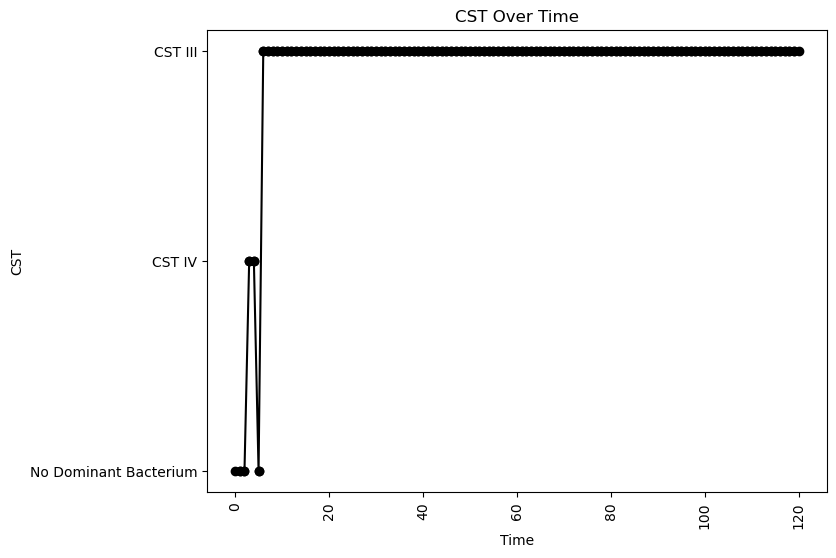


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.06664492138468138
oLB Growth: 0.6588037441195057
nAB Self: -0.0666240127579367
nAB->Li: -0.24996885529974056
nAB->oLB: -0.0011613985745375643
Li->nAB: 0.4042651482820022
Li Self: -0.05926591410565214
Li->oLB: 0.1341307158185152
oLB->nAB: -0.442754966111696
oLB->Li: -0.3782388858653482
oLB Self: -0.036910523154474045

Simulation 2639 follows a valid CST progression:


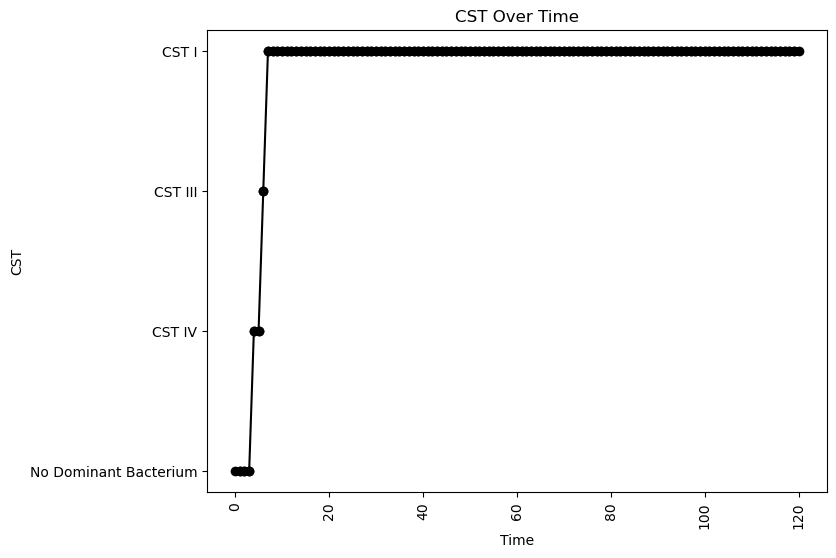


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.08793207981819061
nAB->Li: 0.10435679571126388
nAB->oLB: -0.4656979634454673
Li->nAB: 0.45455878299130426
Li Self: -0.009994619666265525
Li->oLB: -0.3672105805223954
oLB->nAB: -0.3281528800371114
oLB->Li: 0.274060518357539
oLB Self: -0.04842880250051591

Simulation 2640 follows a valid CST progression:


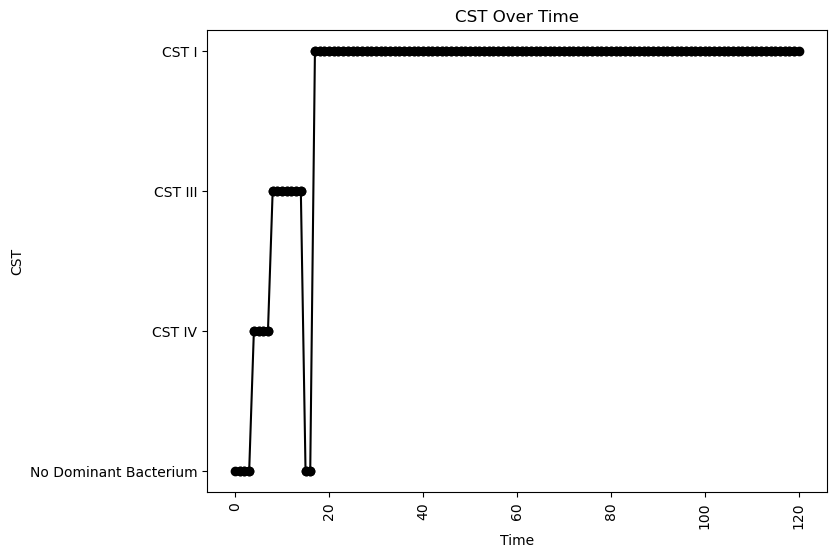


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.03040539532716259
nAB->Li: -0.3588874711432026
nAB->oLB: -0.4940018341650246
Li->nAB: 0.24041954799446397
Li Self: -0.042509897889085456
Li->oLB: -0.23694711846975325
oLB->nAB: -0.16098573271376743
oLB->Li: 0.11810082820679002
oLB Self: -0.0035116262902338824

Simulation 2649 follows a valid CST progression:


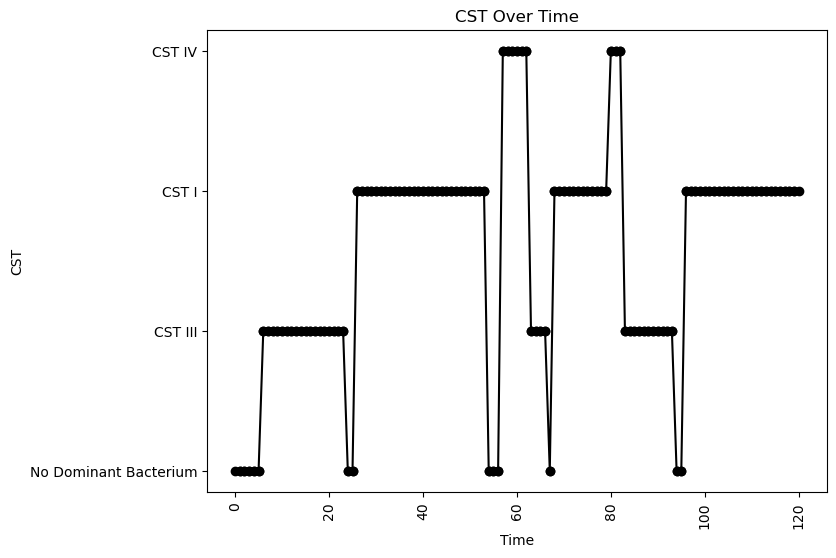


Interaction Parameters:
nAB Growth: 2.292952252819776
Li Growth: 0.18664048563214908
oLB Growth: 0.25066683866219575
nAB Self: -0.08384838332781694
nAB->Li: -0.06612314213767007
nAB->oLB: -0.2703279165369016
Li->nAB: 0.47302077972097634
Li Self: -0.09458553771286088
Li->oLB: -0.2062110207334381
oLB->nAB: -0.15922361934103874
oLB->Li: 0.028961207160196012
oLB Self: -0.08709590906155673

Simulation 2652 follows a valid CST progression:


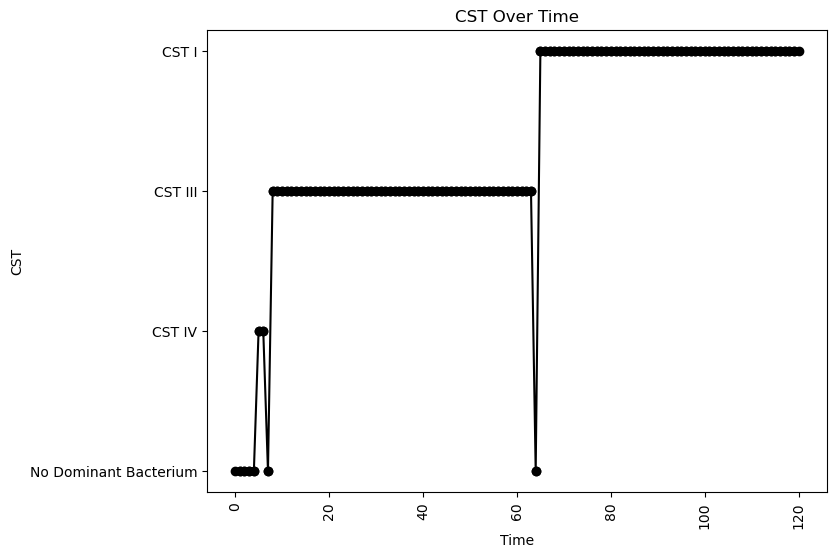


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.06208421888591407
nAB->Li: -0.4447689123700018
nAB->oLB: -0.44421579100185
Li->nAB: 0.2393608549156011
Li Self: -0.04569087478012863
Li->oLB: -0.36517427537833536
oLB->nAB: -0.4040177958586157
oLB->Li: -0.07541781426148181
oLB Self: -0.0526573479530773

Simulation 2653 follows a valid CST progression:


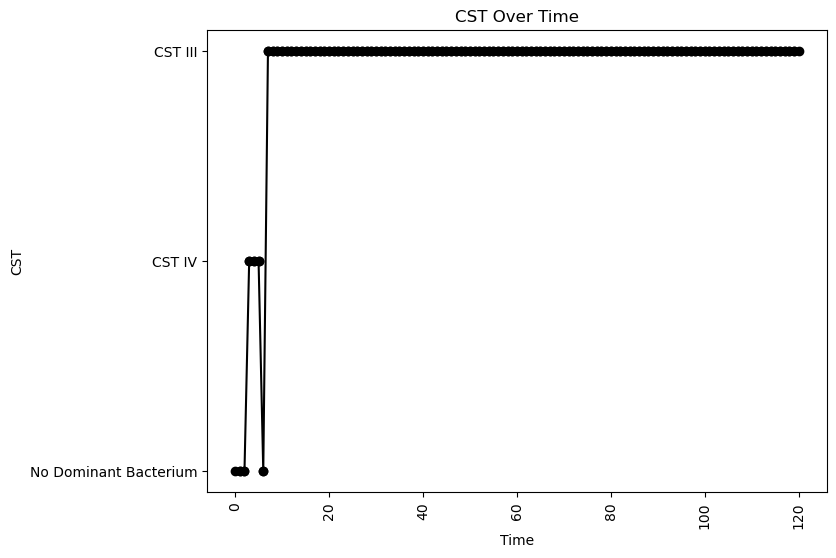


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.29728262971481145
oLB Growth: 1.0858755226067296
nAB Self: -0.01594012778802037
nAB->Li: -0.0901021336779057
nAB->oLB: -0.19158314222071338
Li->nAB: 0.09965969090234217
Li Self: -0.02309617008504647
Li->oLB: -0.44486878892615056
oLB->nAB: -0.21021689854818615
oLB->Li: -0.464478798647424
oLB Self: -0.08798749675020867

Simulation 2655 follows a valid CST progression:


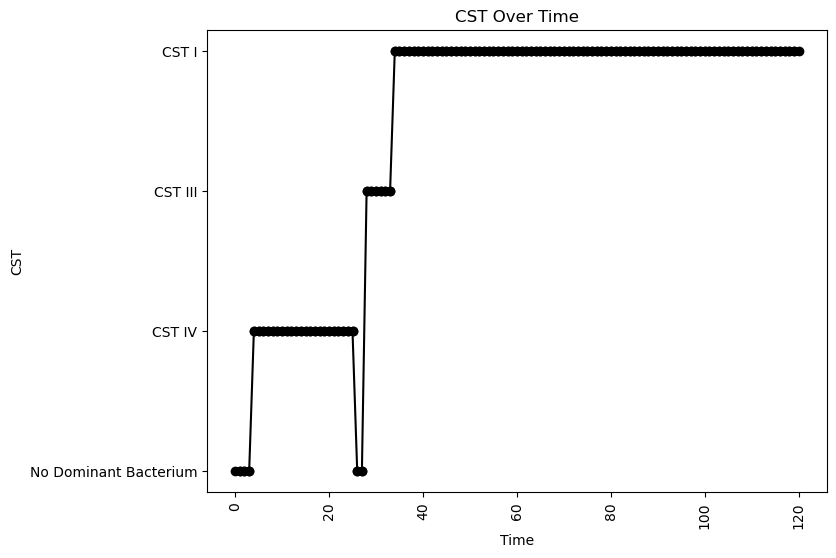


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.06771792602967716
nAB->Li: -0.32888945208665854
nAB->oLB: -0.336945329853772
Li->nAB: 0.0063818562684349045
Li Self: -0.004013482873187882
Li->oLB: -0.19528219553596265
oLB->nAB: -0.24627537512230863
oLB->Li: 0.430783848811949
oLB Self: -0.08899790123641198

Simulation 2656 follows a valid CST progression:


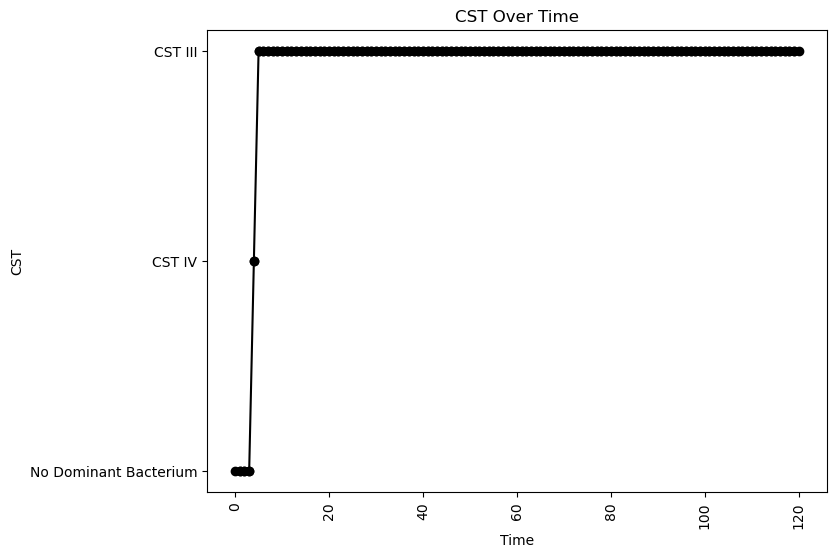


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.09679438763931139
oLB Growth: 0.3756702562538966
nAB Self: -0.04150693050470408
nAB->Li: 0.2429526279933395
nAB->oLB: -0.10737995356381708
Li->nAB: 0.4592332150980143
Li Self: -0.021006567742966165
Li->oLB: -0.29969250842167094
oLB->nAB: -0.20292279247721678
oLB->Li: 0.061010986988600635
oLB Self: -0.007079650007752208

Simulation 2666 follows a valid CST progression:


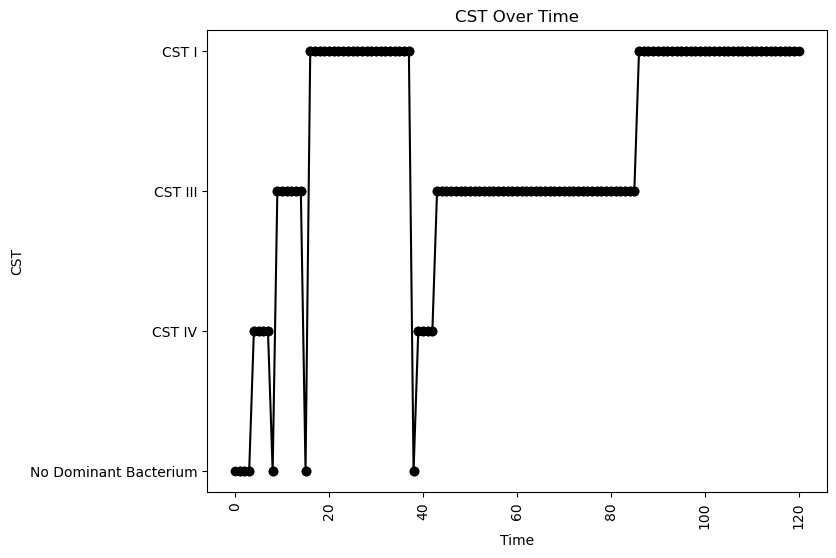


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.06309763455319839
oLB Growth: 0.9128027925042091
nAB Self: -0.0025922060858596524
nAB->Li: -0.49654252382054825
nAB->oLB: -0.04186146560897963
Li->nAB: 0.13409216358111975
Li Self: -0.03499532699869669
Li->oLB: -0.16665057700648916
oLB->nAB: -0.2178792102267662
oLB->Li: 0.2286921369362308
oLB Self: -0.04584814562871009

Simulation 2669 follows a valid CST progression:


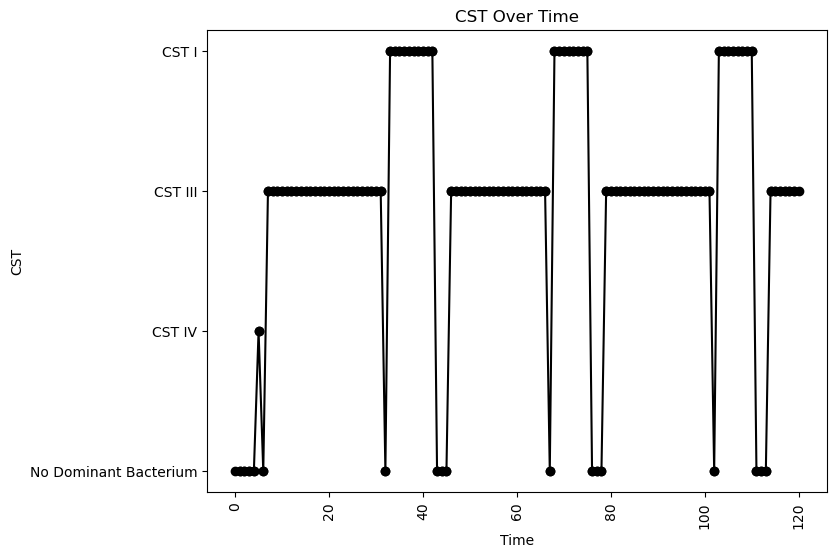


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.06309763455319839
oLB Growth: 0.9128027925042091
nAB Self: -0.09831339772077076
nAB->Li: -0.10630883692263066
nAB->oLB: -0.1454634574855595
Li->nAB: 0.4636143578323526
Li Self: -0.07149140566851199
Li->oLB: -0.08068797235376612
oLB->nAB: -0.4913705759296767
oLB->Li: 0.03119762834426887
oLB Self: -0.057902244831993424

Simulation 2676 follows a valid CST progression:


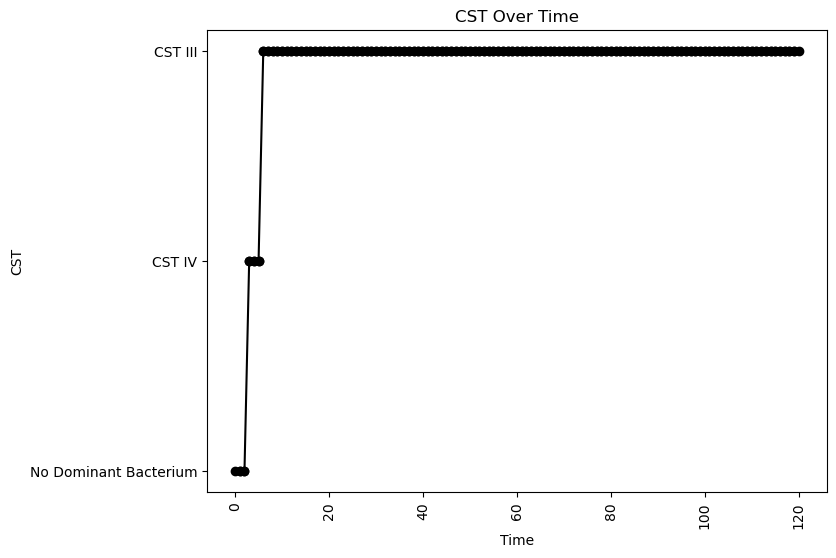


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.03489030271523397
nAB->Li: 0.17654333062977978
nAB->oLB: -0.1882050485071765
Li->nAB: 0.33691930767122236
Li Self: -0.025851111379696354
Li->oLB: -0.47167087459235
oLB->nAB: -0.17271379719013707
oLB->Li: 0.035671076491132325
oLB Self: -0.05830583231849779

Simulation 2677 follows a valid CST progression:


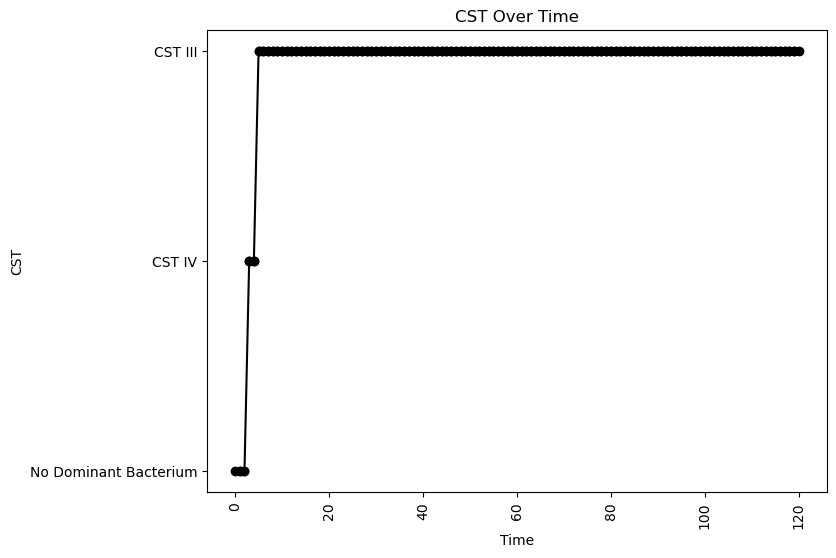


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.02602985187833745
nAB->Li: 0.2169948153889777
nAB->oLB: -0.20949734772404088
Li->nAB: 0.48288472191183607
Li Self: -0.03475668078982798
Li->oLB: 0.17731075548554498
oLB->nAB: -0.25105261428820325
oLB->Li: 0.04738348611615684
oLB Self: -0.005948520788144979

Simulation 2679 follows a valid CST progression:


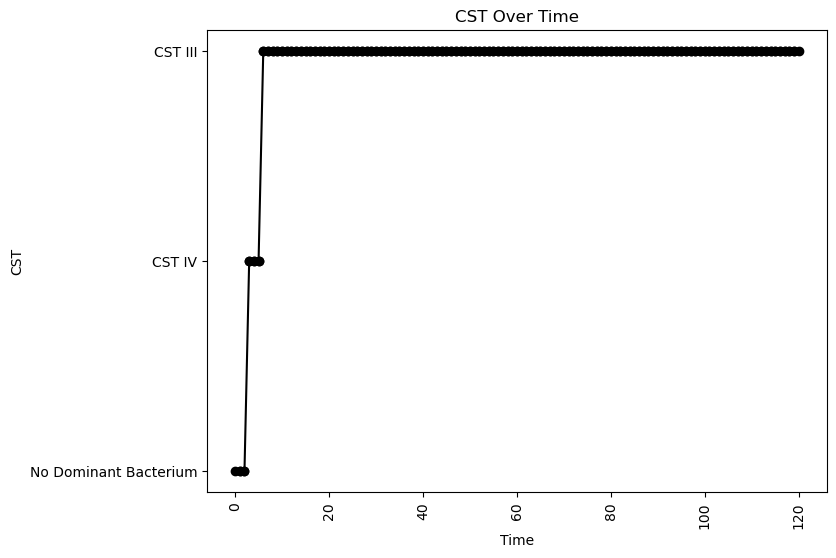


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.03074113314305789
nAB->Li: 0.020846066617910664
nAB->oLB: -0.39466206354610023
Li->nAB: 0.27736601044090103
Li Self: -0.012837721557280884
Li->oLB: -0.4139225935178414
oLB->nAB: -0.30123540331459087
oLB->Li: -0.37463276362608966
oLB Self: -0.0049019016297824625

Simulation 2683 follows a valid CST progression:


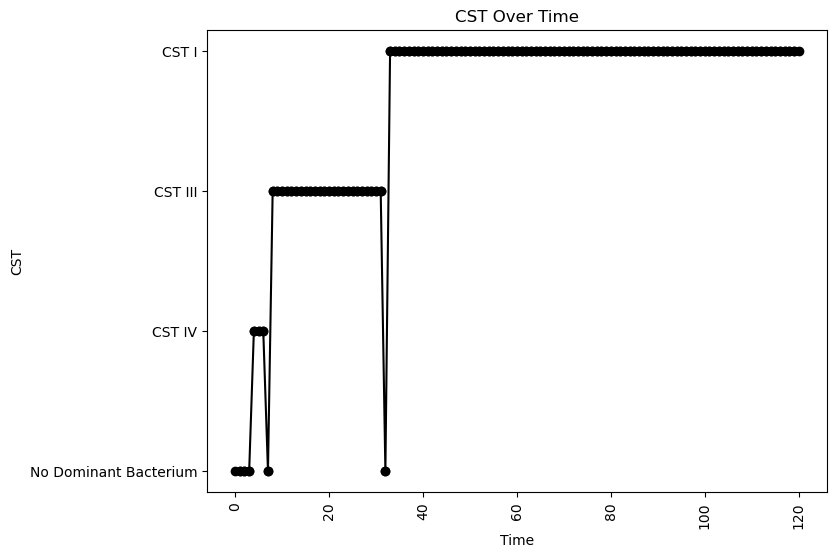


Interaction Parameters:
nAB Growth: 2.0745101401728236
Li Growth: 0.010341045972876578
oLB Growth: 1.1507970527071554
nAB Self: -0.031278545248576345
nAB->Li: -0.2915226150220936
nAB->oLB: -0.42003090218839756
Li->nAB: 0.4134792887726597
Li Self: -0.0837790949880603
Li->oLB: -0.1323104603412844
oLB->nAB: -0.4875672644966131
oLB->Li: -0.06758688633953053
oLB Self: -0.07790636587992422

Simulation 2691 follows a valid CST progression:


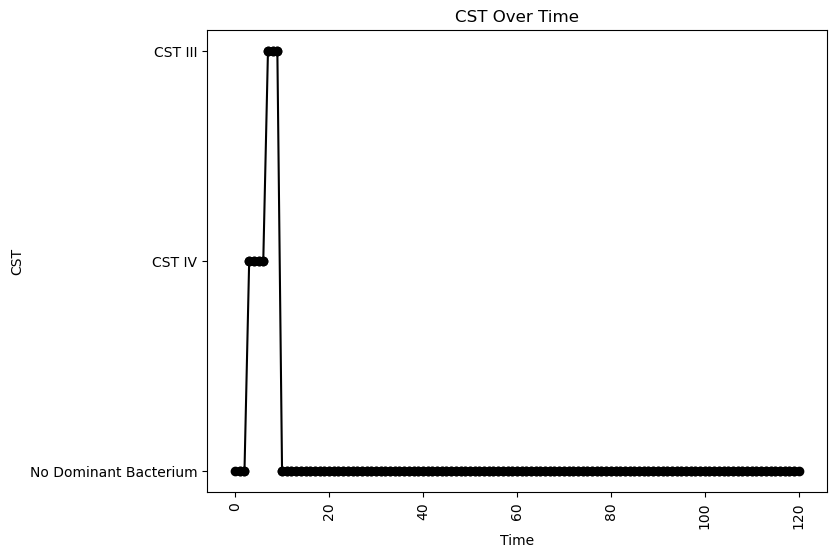


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.007578569669730542
nAB->Li: -0.3794175794814516
nAB->oLB: -0.1571825476002725
Li->nAB: 0.16887085671216717
Li Self: -0.022691445299411292
Li->oLB: 0.27068751848272843
oLB->nAB: -0.32278616766425233
oLB->Li: 0.3093265131186689
oLB Self: -0.03755196854119222

Simulation 2692 follows a valid CST progression:


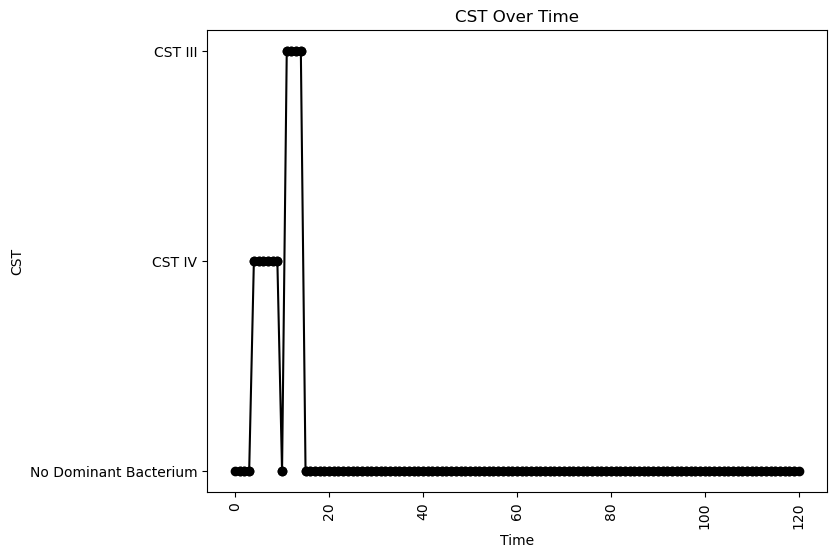


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.06076054942724636
oLB Growth: 0.7334429546888279
nAB Self: -0.06117334584985502
nAB->Li: -0.06806908233469872
nAB->oLB: -0.1777523840809192
Li->nAB: 0.024844619036919813
Li Self: -0.003072864013500917
Li->oLB: 0.399109280696483
oLB->nAB: -0.4262429215075557
oLB->Li: 0.40073994993192275
oLB Self: -0.013000864513618732

Simulation 2698 follows a valid CST progression:


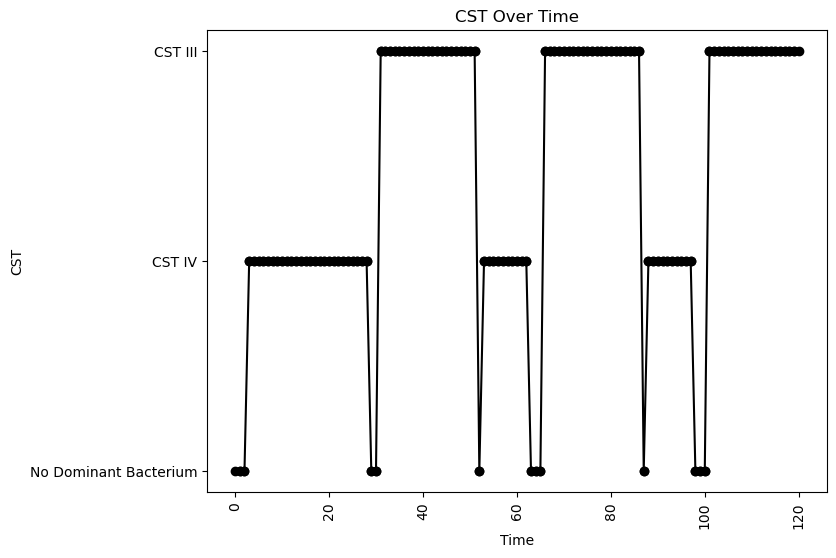


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.05085600951355036
nAB->Li: -0.47013828435846383
nAB->oLB: -0.33503482380148464
Li->nAB: 0.04334452016300061
Li Self: -0.09905944352179642
Li->oLB: -0.1010437493605924
oLB->nAB: -0.2124610868764611
oLB->Li: -0.38583022983387827
oLB Self: -0.021087847375228022

Simulation 2704 follows a valid CST progression:


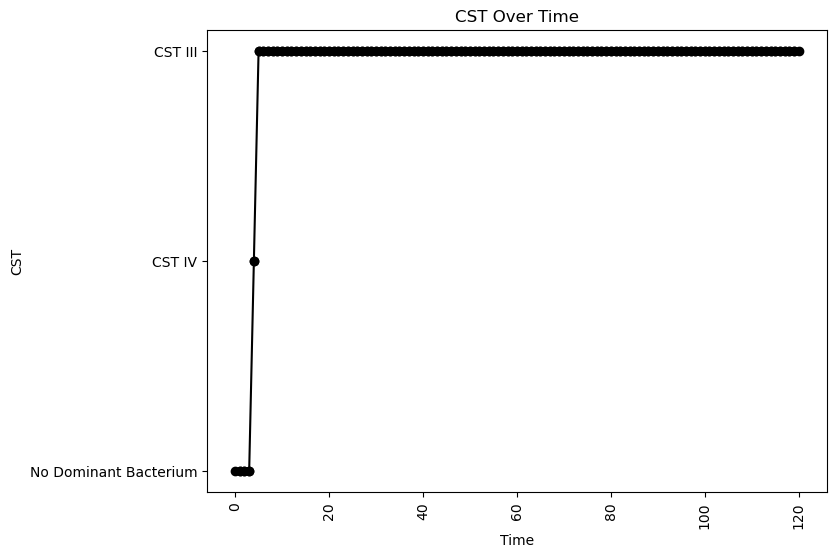


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.06927468147339348
nAB->Li: -0.0947172778881788
nAB->oLB: -0.057662830628173345
Li->nAB: 0.4420431464952921
Li Self: -0.0659439083132609
Li->oLB: 0.18626253179849783
oLB->nAB: -0.18778747662842638
oLB->Li: -0.043558226646995435
oLB Self: -0.09163466244065795

Simulation 2705 follows a valid CST progression:


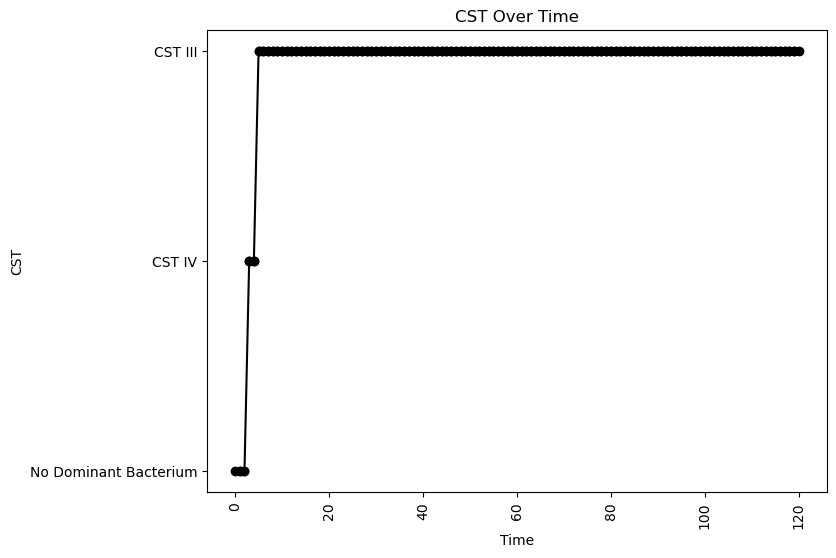


Interaction Parameters:
nAB Growth: 2.284416841880324
Li Growth: 0.06886020002136616
oLB Growth: 0.35838896078112936
nAB Self: -0.08945489812482191
nAB->Li: 0.23170243501850563
nAB->oLB: -0.4189741603293071
Li->nAB: 0.4242764191345031
Li Self: -0.016861831748842024
Li->oLB: -0.19694562561022616
oLB->nAB: -0.02160889016169726
oLB->Li: -0.2912825056771532
oLB Self: -0.007290553553245885

Simulation 2715 follows a valid CST progression:


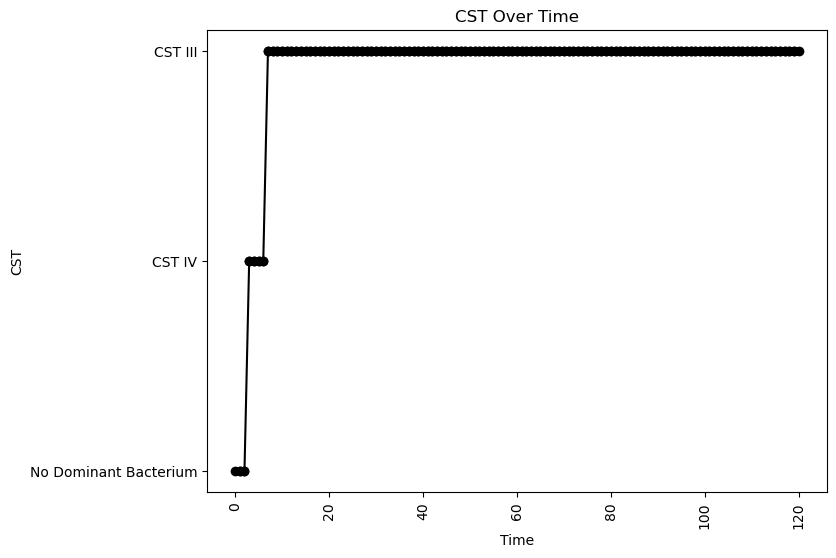


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.07406128409502848
nAB->Li: -0.36041023303847775
nAB->oLB: -0.4049946950528236
Li->nAB: 0.24963574587199588
Li Self: -0.0818659574274219
Li->oLB: -0.14354338340150213
oLB->nAB: -0.26940264604582054
oLB->Li: -0.45420180492463597
oLB Self: -0.07786074567548276

Simulation 2716 follows a valid CST progression:


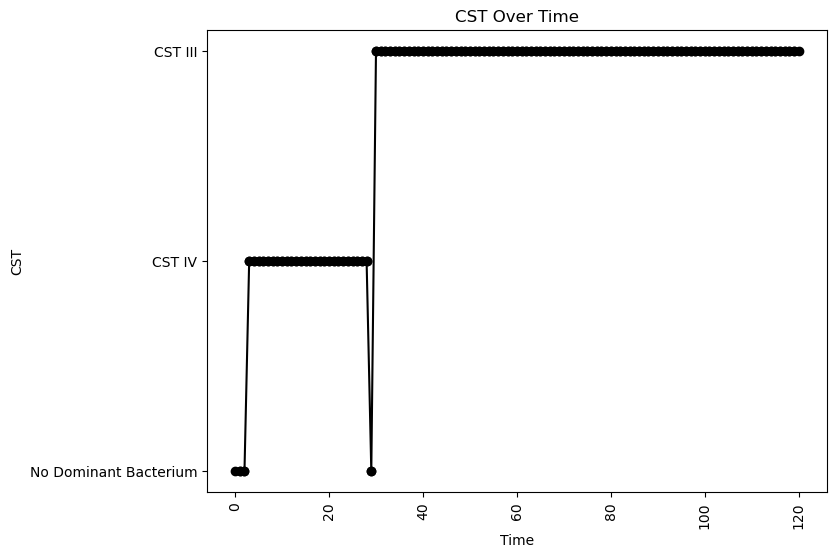


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.06227021287337842
oLB Growth: 1.155917868199191
nAB Self: -0.05624461896796536
nAB->Li: -0.2450516640681396
nAB->oLB: -0.2807688312406179
Li->nAB: 0.0020203763002987207
Li Self: -0.026775101290298878
Li->oLB: -0.29894461355171287
oLB->nAB: -0.3776594476466969
oLB->Li: -0.19537535203179313
oLB Self: -0.018328780232910097

Simulation 2725 follows a valid CST progression:


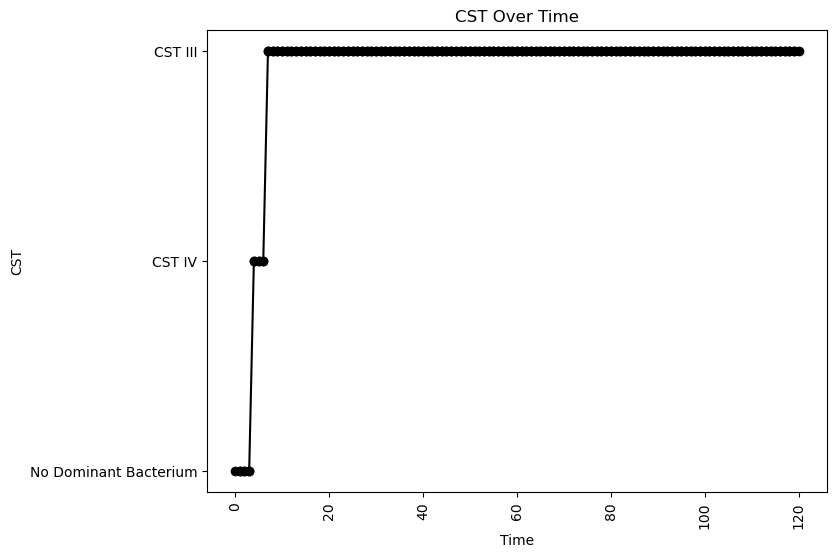


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.002068778594573703
nAB->Li: -0.14527949374033838
nAB->oLB: -0.272498689212052
Li->nAB: 0.16357914768343196
Li Self: -0.07358970187414905
Li->oLB: 0.007615378423212804
oLB->nAB: -0.18762507506842913
oLB->Li: -0.2331304253724168
oLB Self: -0.06121709181842604

Simulation 2732 follows a valid CST progression:


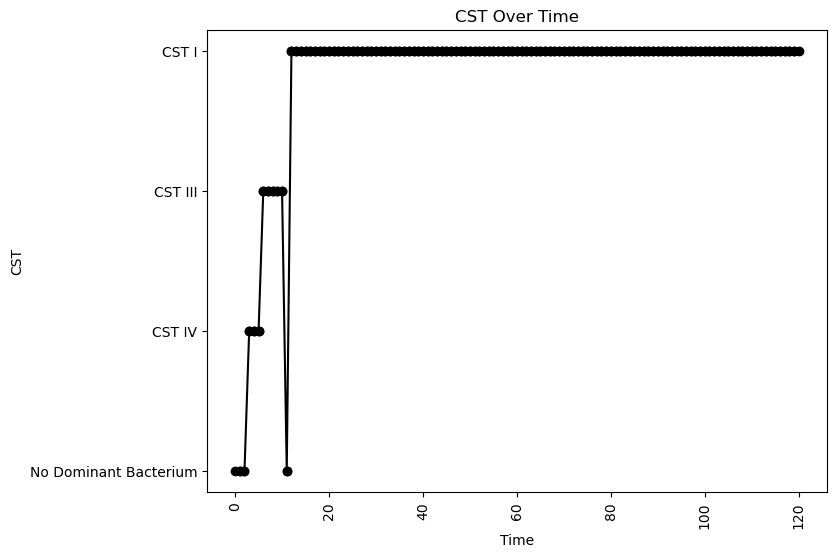


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.04043494125232242
nAB->Li: -0.3374709440024871
nAB->oLB: -0.21507007506869563
Li->nAB: 0.3104392103310559
Li Self: -0.013693416613020537
Li->oLB: -0.32791436098903337
oLB->nAB: -0.3638579108480019
oLB->Li: 0.16690293349284768
oLB Self: -0.007850297293855307

Simulation 2738 follows a valid CST progression:


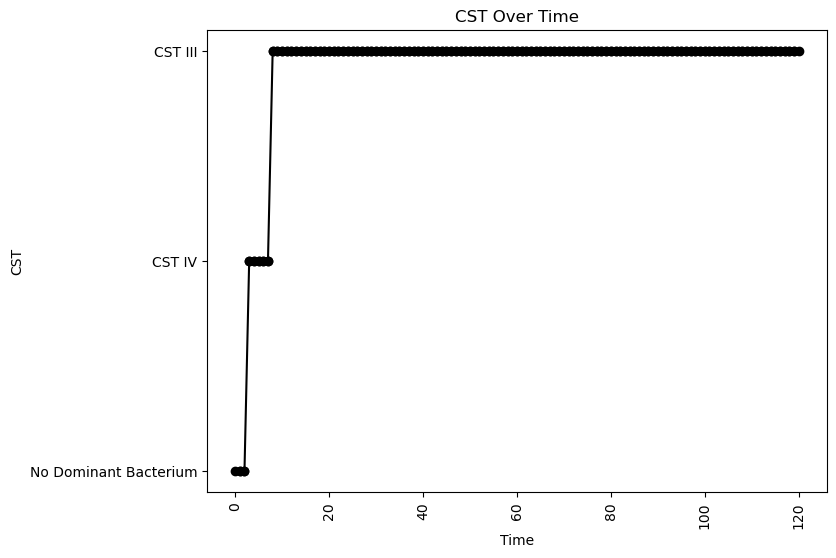


Interaction Parameters:
nAB Growth: 2.226251684223429
Li Growth: 0.0760937960697033
oLB Growth: 0.4505921706771102
nAB Self: -0.027132282714674993
nAB->Li: -0.33907960739121923
nAB->oLB: -0.3584458499378077
Li->nAB: 0.25172234187837006
Li Self: -0.08811382897539427
Li->oLB: -0.10578633997412418
oLB->nAB: -0.49908228671346133
oLB->Li: -0.15827404900357006
oLB Self: -0.013876587426031067

Simulation 2740 follows a valid CST progression:


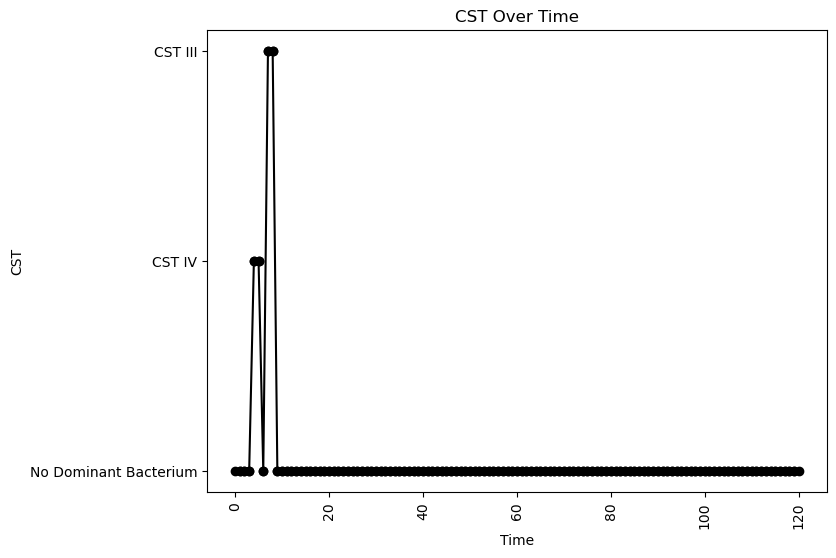


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.05251837356294972
nAB->Li: -0.2878153921310357
nAB->oLB: -0.0877044496423075
Li->nAB: 0.24944015292843513
Li Self: -0.07940109305459636
Li->oLB: 0.29826014590129935
oLB->nAB: -0.13656779050299817
oLB->Li: 0.2386131588996958
oLB Self: -0.013425458925229908

Simulation 2742 follows a valid CST progression:


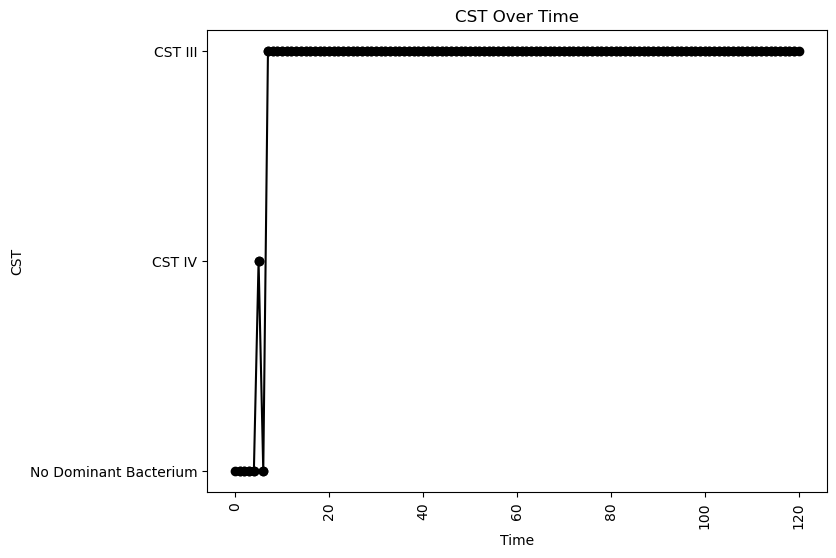


Interaction Parameters:
nAB Growth: 2.2563448832512942
Li Growth: 0.07234741829114298
oLB Growth: 0.40127498600949585
nAB Self: -0.03603039272851495
nAB->Li: -0.3206333993147956
nAB->oLB: -0.28628499754654246
Li->nAB: 0.37683880933560954
Li Self: -0.015107837392078105
Li->oLB: -0.03427645326646961
oLB->nAB: -0.38991090379742077
oLB->Li: -0.23973385595625452
oLB Self: -0.006306338343763068

Simulation 2755 follows a valid CST progression:


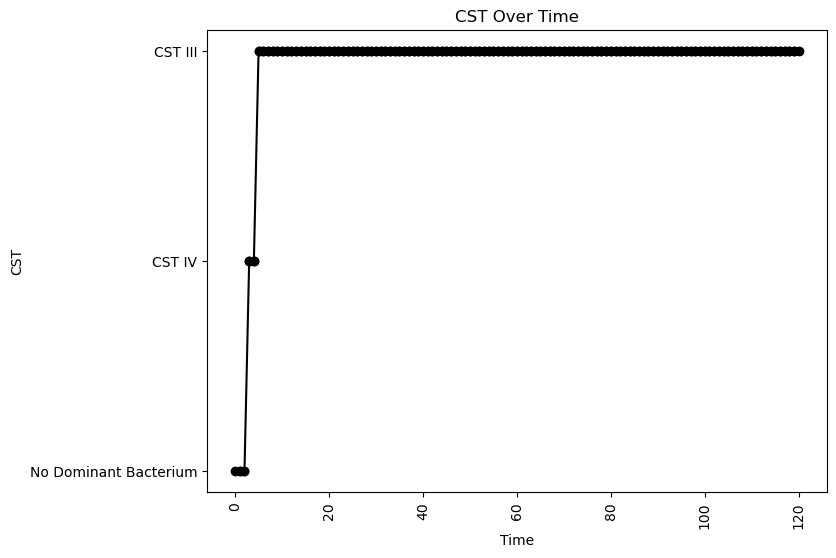


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.03330690766244203
nAB->Li: -0.0154694887573118
nAB->oLB: -0.22889574276637054
Li->nAB: 0.4195831677474273
Li Self: -0.028252198482964008
Li->oLB: 0.1423389253414209
oLB->nAB: -0.2500725337380294
oLB->Li: 0.011682533347654012
oLB Self: -0.07787903066190012

Simulation 2760 follows a valid CST progression:


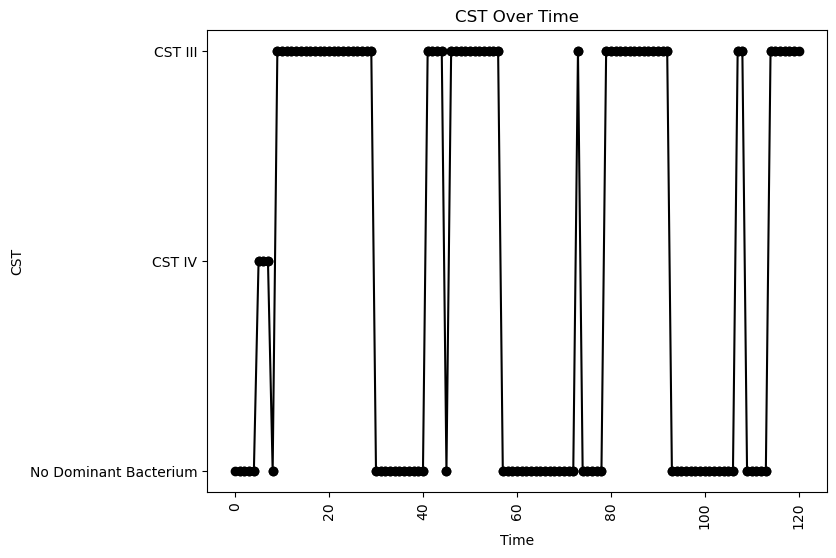


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.2866488970762088
oLB Growth: 0.08496126009849418
nAB Self: -0.08593828770901428
nAB->Li: -0.06745601128447054
nAB->oLB: -0.02279066662054091
Li->nAB: 0.0767728462128604
Li Self: -0.040608297771159964
Li->oLB: -0.06991196651219372
oLB->nAB: -0.43449930011492455
oLB->Li: 0.1763240427830699
oLB Self: -0.006267105378005872

Simulation 2762 follows a valid CST progression:


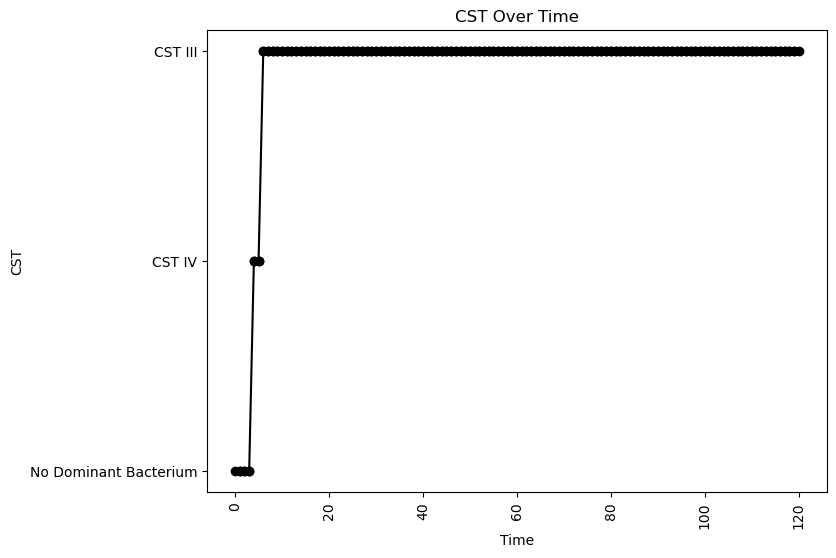


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.14049162594674383
oLB Growth: 0.8534408763679777
nAB Self: -0.05657283876191737
nAB->Li: -0.01901386068909272
nAB->oLB: -0.06408429818213318
Li->nAB: 0.2841034235254539
Li Self: -0.05570658132849087
Li->oLB: -0.4052412437070396
oLB->nAB: -0.3533579259796634
oLB->Li: -0.4198470553089932
oLB Self: -0.037425004454953475

Simulation 2767 follows a valid CST progression:


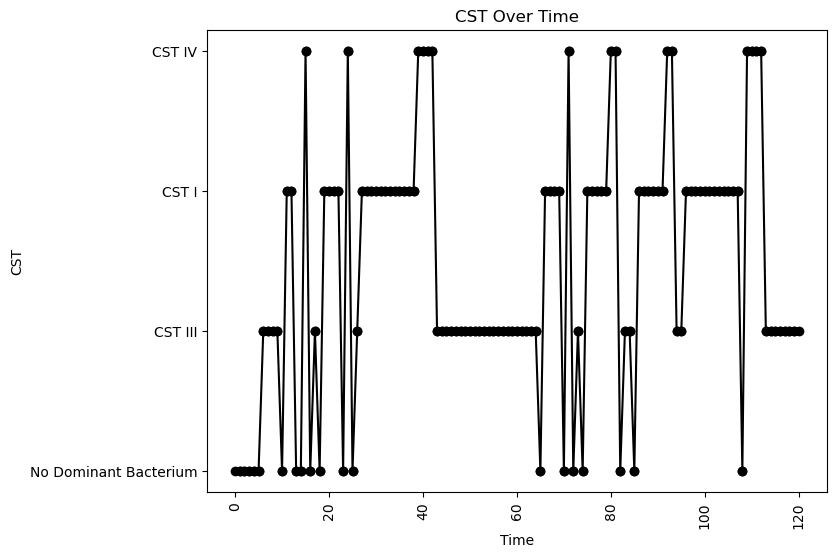


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.18705003387670222
oLB Growth: 0.21113539622386296
nAB Self: -0.021276118654303358
nAB->Li: -0.4626364134169941
nAB->oLB: -0.07054857504504491
Li->nAB: 0.3268848725616167
Li Self: -0.09423028436407975
Li->oLB: -0.24970785519038835
oLB->nAB: -0.23115583756789032
oLB->Li: 0.2274382355344725
oLB Self: -0.049388552212893566

Simulation 2773 follows a valid CST progression:


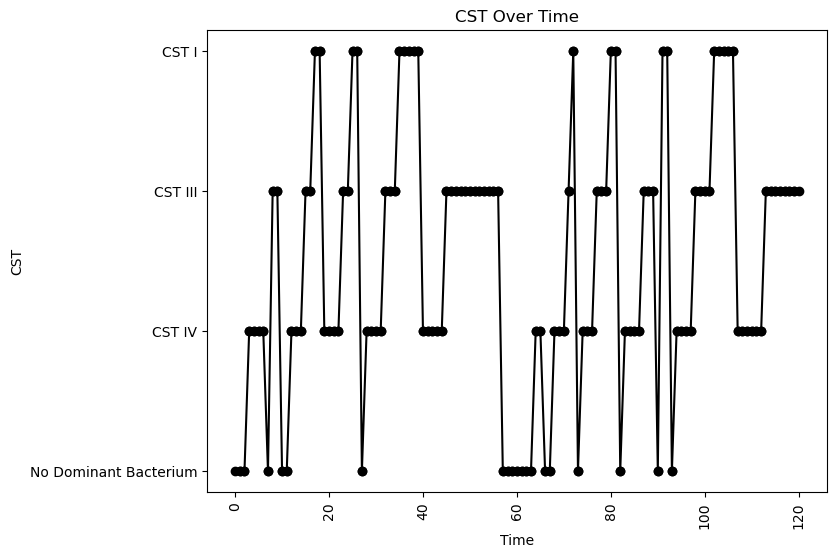


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.06495430992206574
oLB Growth: 0.1731103059651596
nAB Self: -0.015965418859171215
nAB->Li: -0.2730108913994407
nAB->oLB: -0.01854945385560608
Li->nAB: 0.10022424894875992
Li Self: -0.05836415025531444
Li->oLB: -0.49214471346441113
oLB->nAB: -0.18411161988412295
oLB->Li: 0.4148223666032361
oLB Self: -0.050671483568421306

Simulation 2774 follows a valid CST progression:


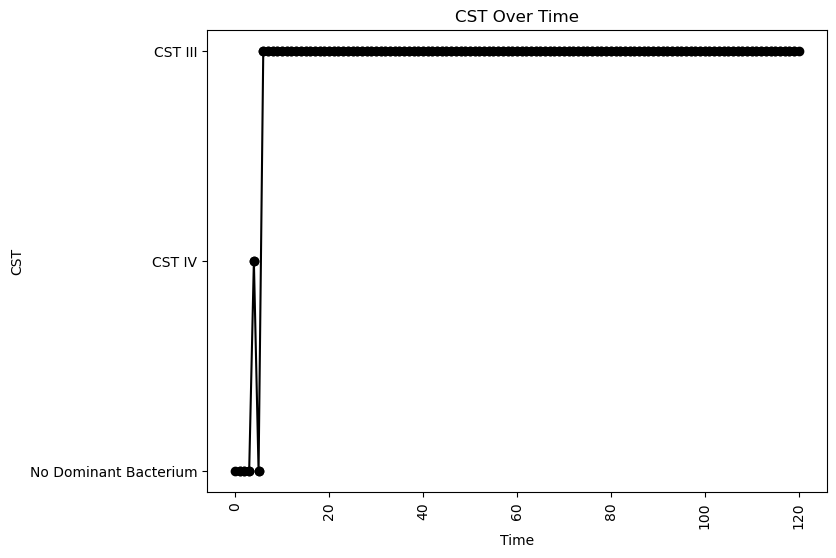


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.08193186419302043
nAB->Li: -0.0012226835228685284
nAB->oLB: -0.06819276205945007
Li->nAB: 0.40755778760250716
Li Self: -0.054796255975066835
Li->oLB: 0.1709116909549352
oLB->nAB: -0.08515653780193444
oLB->Li: -0.4465984243108802
oLB Self: -0.029080694619930555

Simulation 2780 follows a valid CST progression:


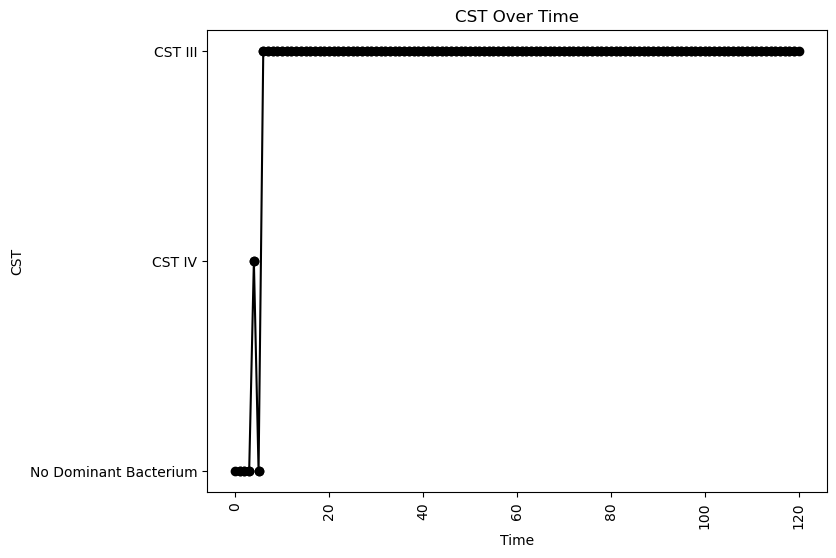


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.06233685699791049
nAB->Li: -0.4069841861391754
nAB->oLB: -0.11910919876437631
Li->nAB: 0.4450604203007893
Li Self: -0.08164131967291774
Li->oLB: 0.2695613161416631
oLB->nAB: -0.24620424417047249
oLB->Li: -0.11042259448886832
oLB Self: -0.058236938448688755

Simulation 2794 follows a valid CST progression:


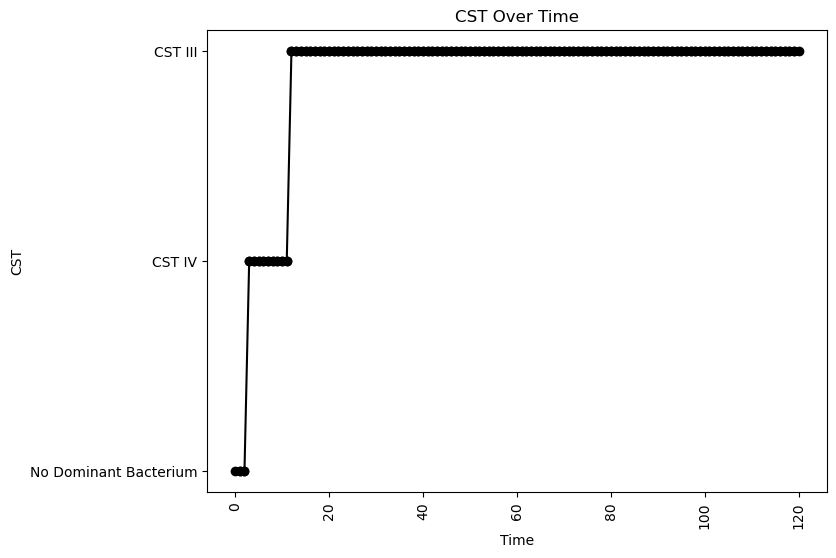


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.028633646451816944
nAB->Li: -0.37360159802215265
nAB->oLB: -0.24407270293654715
Li->nAB: 0.025511262170952564
Li Self: -0.01174201864074055
Li->oLB: -0.2583305722044327
oLB->nAB: -0.39274812622491095
oLB->Li: -0.12336051792527625
oLB Self: -0.025687735989007213

Simulation 2802 follows a valid CST progression:


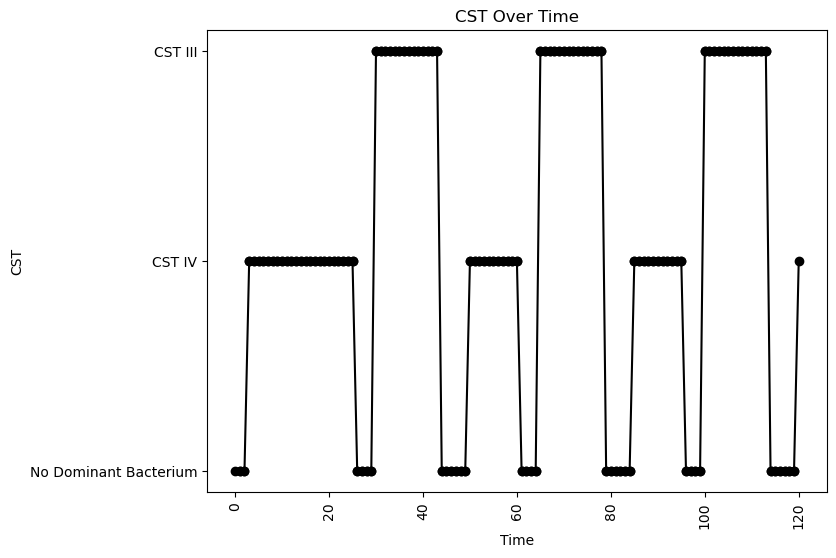


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.0875850151303657
nAB->Li: -0.16111263297442896
nAB->oLB: -0.3309550557578882
Li->nAB: 0.026450293374974287
Li Self: -0.05594467140818664
Li->oLB: 0.44134569151604397
oLB->nAB: -0.3877676170709797
oLB->Li: -0.39444899915865606
oLB Self: -0.022210830768866263

Simulation 2811 follows a valid CST progression:


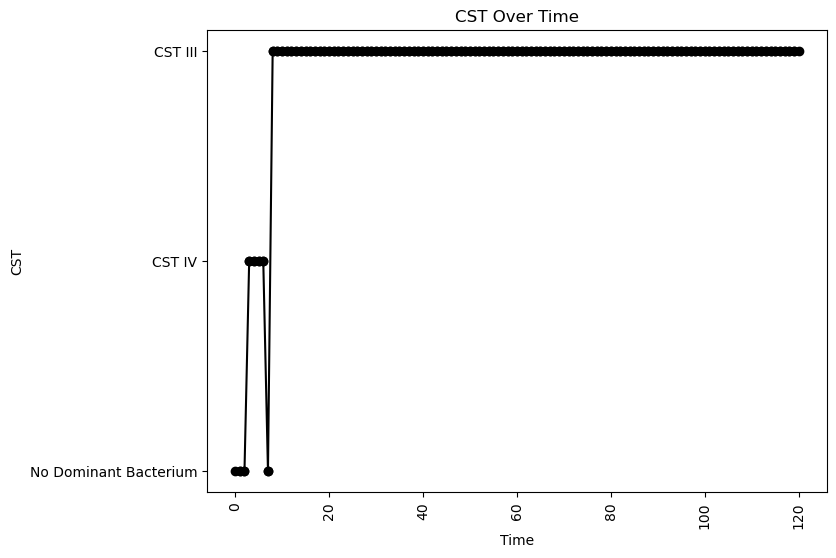


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.06967846000948563
oLB Growth: 0.7070472171500886
nAB Self: -0.09978990074396042
nAB->Li: -0.07261337264159967
nAB->oLB: -0.3064586130814688
Li->nAB: 0.15957932904950334
Li Self: -0.0928356954498791
Li->oLB: -0.45981894771020076
oLB->nAB: -0.2847907090846593
oLB->Li: -0.2420733781423438
oLB Self: -0.046940459865387606

Simulation 2815 follows a valid CST progression:


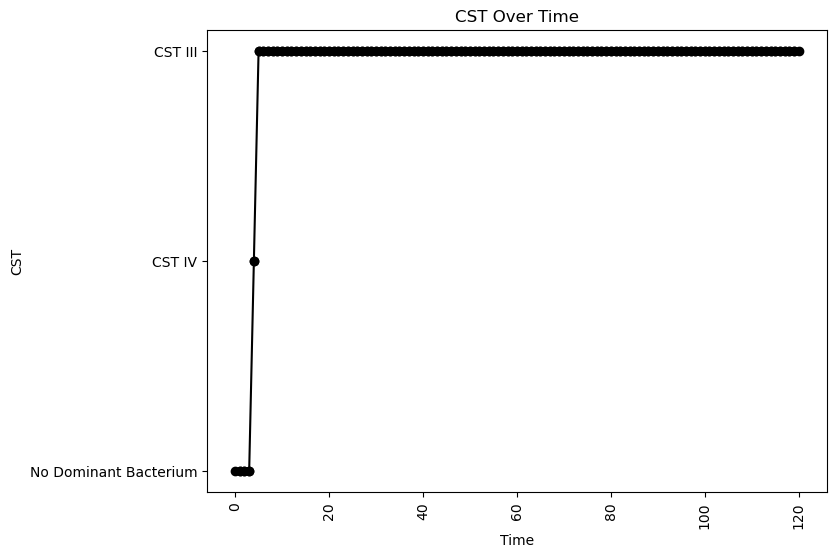


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.07216106891041721
nAB->Li: 0.010718992339453726
nAB->oLB: -0.3787998294350068
Li->nAB: 0.37253378319891417
Li Self: -0.008719302123639402
Li->oLB: 0.4532639799609214
oLB->nAB: -0.0758029679979022
oLB->Li: 0.08502729753741023
oLB Self: -0.05623531931778941

Simulation 2823 follows a valid CST progression:


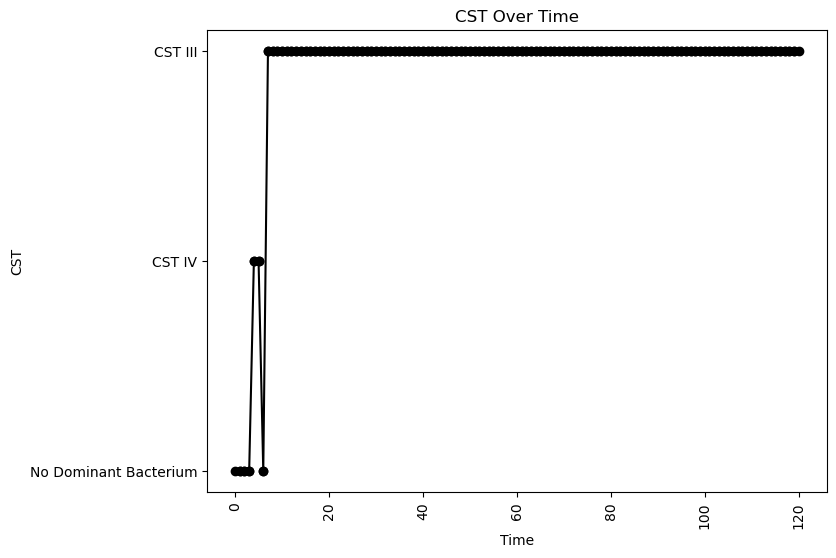


Interaction Parameters:
nAB Growth: 2.2657644953374403
Li Growth: 0.22433625760759943
oLB Growth: 0.2949021384914317
nAB Self: -0.01071302765032349
nAB->Li: -0.4105835256820124
nAB->oLB: -0.2362409746303527
Li->nAB: 0.1493613686919283
Li Self: -0.0019326973563926347
Li->oLB: -0.4897213310610415
oLB->nAB: -0.3343287587133252
oLB->Li: -0.26574060627521856
oLB Self: -0.05867596519339282

Simulation 2824 follows a valid CST progression:


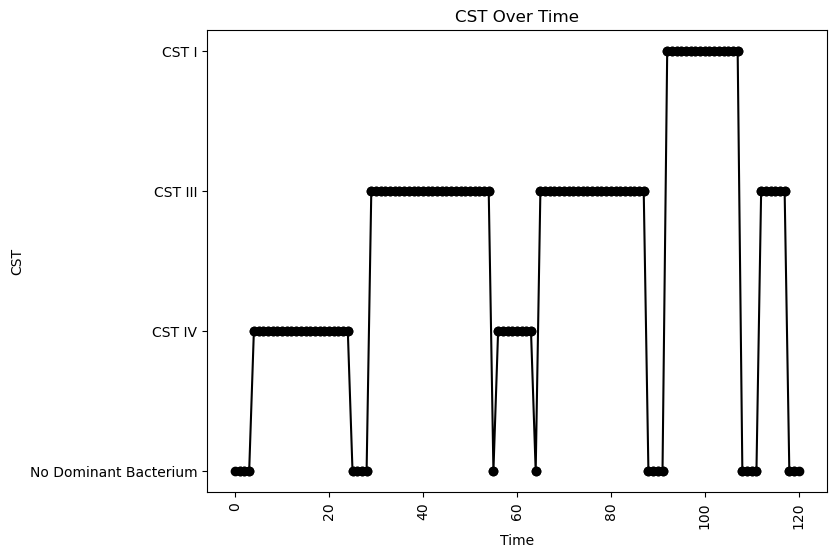


Interaction Parameters:
nAB Growth: 2.172057972480792
Li Growth: 0.05464936187495586
oLB Growth: 1.1816194682992254
nAB Self: -0.034843955820475475
nAB->Li: -0.2885971143537769
nAB->oLB: -0.3202570296463489
Li->nAB: 0.023194488828300885
Li Self: -0.06086251608102949
Li->oLB: -0.0003335323730491724
oLB->nAB: -0.13799995267127796
oLB->Li: -0.023744916715527142
oLB Self: -0.0345788212291885

Simulation 2827 follows a valid CST progression:


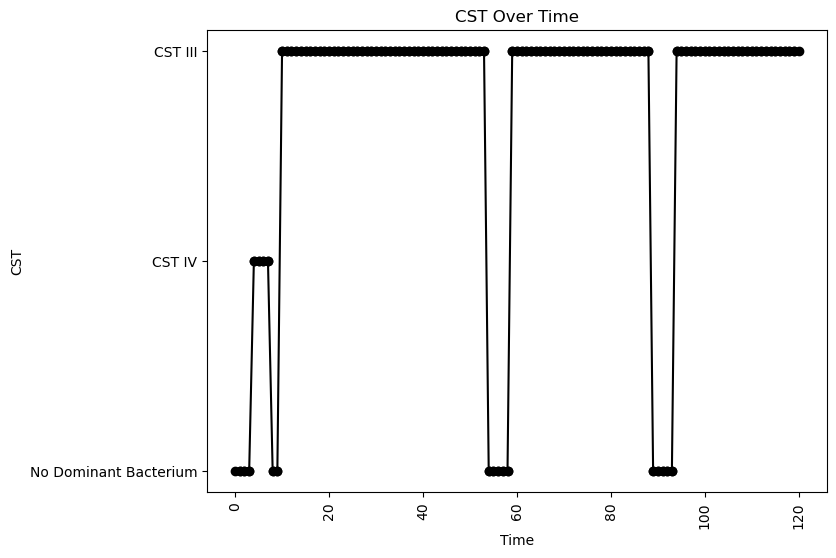


Interaction Parameters:
nAB Growth: 2.2002663828262317
Li Growth: 0.22078062960588776
oLB Growth: 0.7629459891785437
nAB Self: -0.09182795487683687
nAB->Li: -0.1535609513608191
nAB->oLB: -0.31960568073143647
Li->nAB: 0.11387887226216786
Li Self: -0.09575947141482921
Li->oLB: -0.48034502928850287
oLB->nAB: -0.09803614256311127
oLB->Li: -0.29874590835671344
oLB Self: -0.02270456974788762

Simulation 2833 follows a valid CST progression:


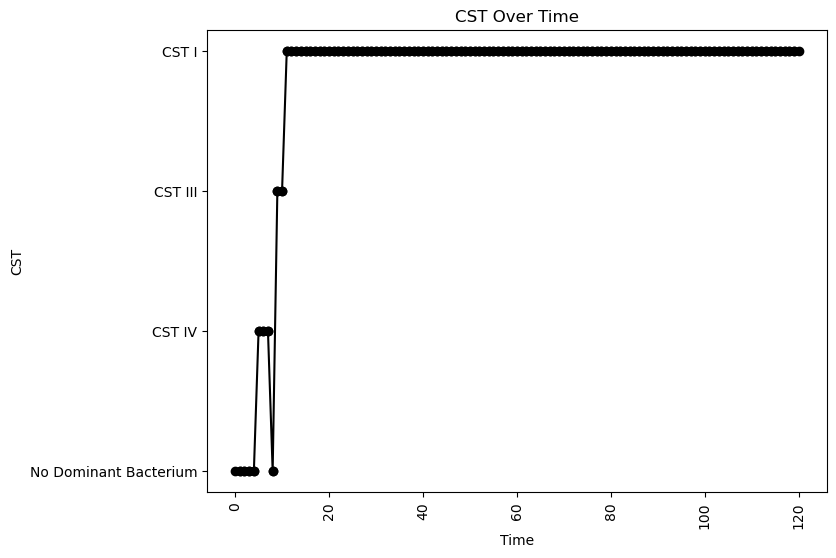


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.03934530157037132
nAB->Li: -0.3064963214712477
nAB->oLB: -0.4025267568887831
Li->nAB: 0.15186633748623812
Li Self: -0.029146933098396013
Li->oLB: -0.19080671302697833
oLB->nAB: -0.24852270285659228
oLB->Li: 0.3538740063756429
oLB Self: -0.05071001449917054

Simulation 2838 follows a valid CST progression:


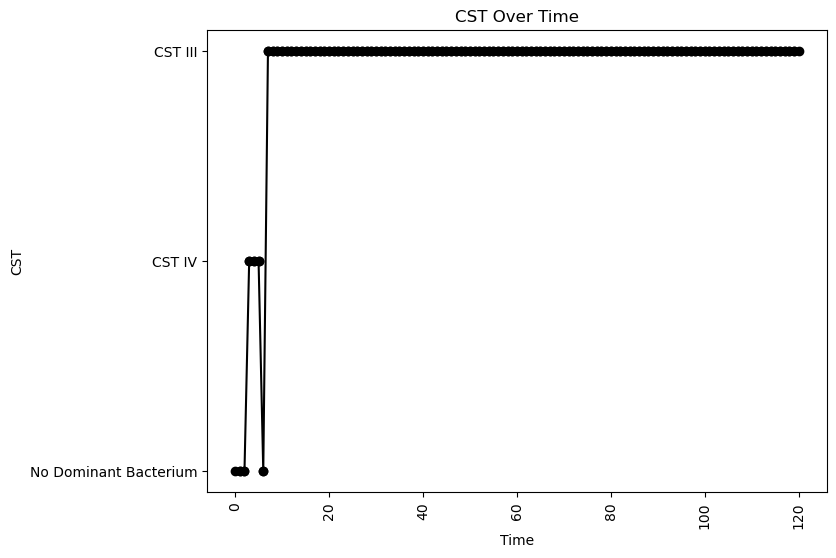


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.06891991913485039
nAB->Li: 0.04533890899477355
nAB->oLB: -0.2618828328496511
Li->nAB: 0.23943309469667073
Li Self: -0.08373019236873486
Li->oLB: -0.3647136046270768
oLB->nAB: -0.44721718050756865
oLB->Li: -0.37922633432691605
oLB Self: -0.028488444547102268

Simulation 2841 follows a valid CST progression:


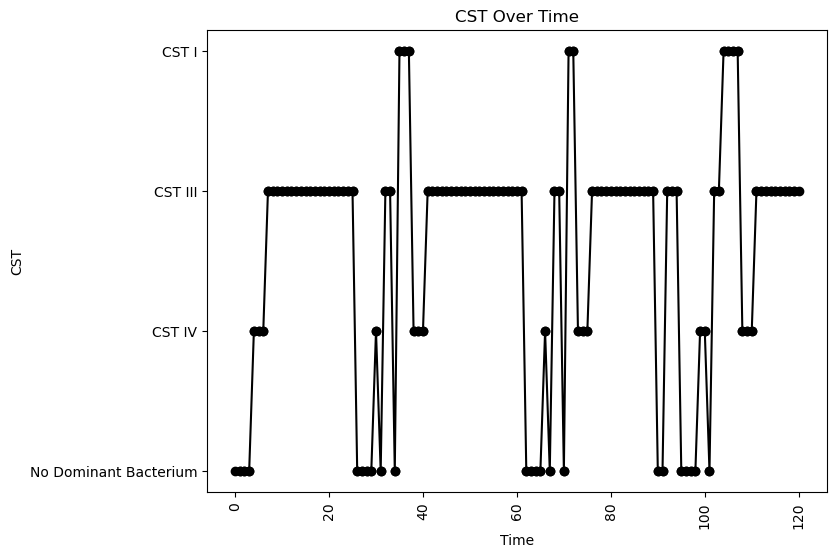


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.05739994626081137
oLB Growth: 0.11031283255203692
nAB Self: -0.066165361764203
nAB->Li: -0.23500627417021774
nAB->oLB: -0.12627641258397576
Li->nAB: 0.19833592412187528
Li Self: -0.04791751424816374
Li->oLB: -0.37153435616680264
oLB->nAB: -0.2874855836965142
oLB->Li: 0.07219294098563966
oLB Self: -0.08065498257047962

Simulation 2847 follows a valid CST progression:


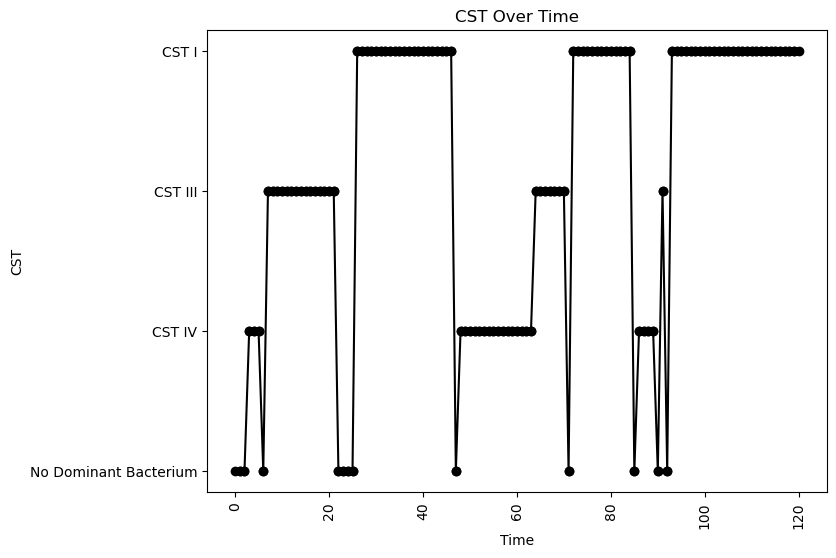


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.09161710847893634
nAB->Li: -0.4714609335669868
nAB->oLB: -0.18951882684806814
Li->nAB: 0.3242218814483442
Li Self: -0.05922879385875297
Li->oLB: -0.4244979879876696
oLB->nAB: -0.07515429394294276
oLB->Li: -0.021181434326524473
oLB Self: -0.06819507674496404

Simulation 2848 follows a valid CST progression:


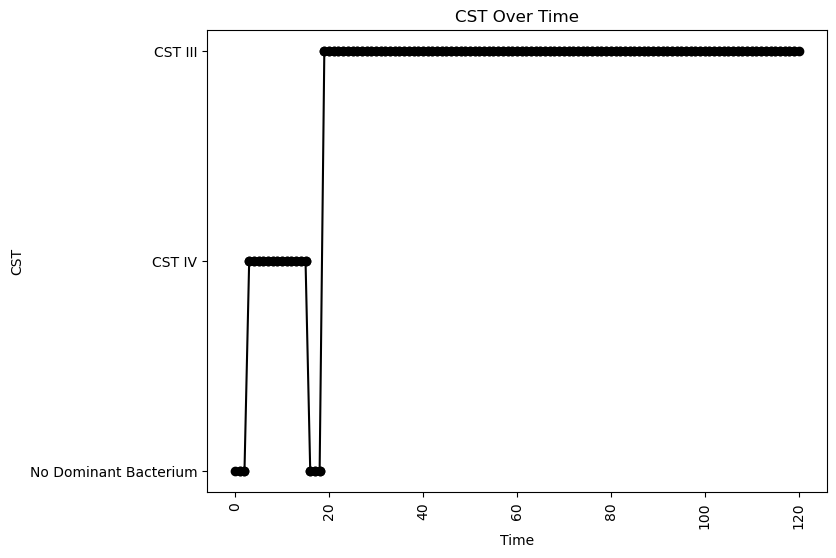


Interaction Parameters:
nAB Growth: 2.2088016144568243
Li Growth: 0.05268768924856952
oLB Growth: 1.1274304047774089
nAB Self: -0.004939034257102376
nAB->Li: -0.2787179091189508
nAB->oLB: -0.02739008783256347
Li->nAB: 0.007373595573114233
Li Self: -0.02708045866546524
Li->oLB: -0.22175708167085523
oLB->nAB: -0.4061337007499243
oLB->Li: -0.3387789112241881
oLB Self: -0.023957438305153275

Simulation 2850 follows a valid CST progression:


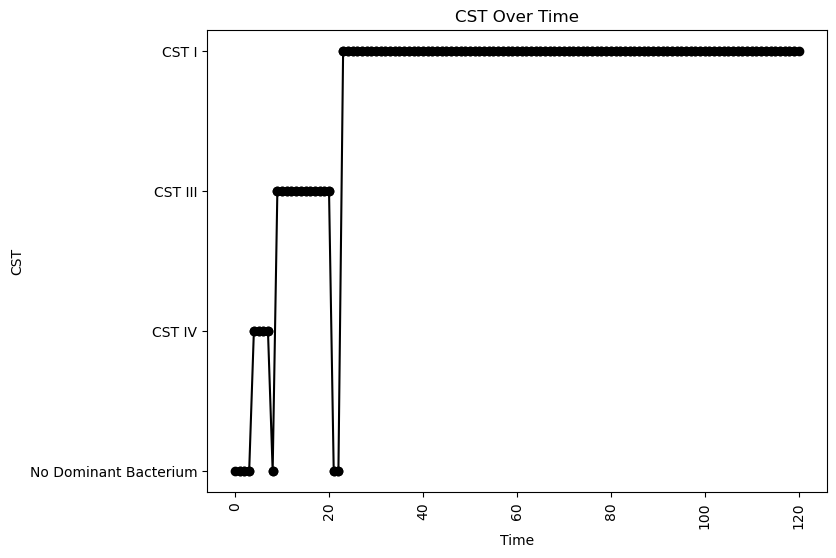


Interaction Parameters:
nAB Growth: 2.237390108639889
Li Growth: 0.07509700685781084
oLB Growth: 0.33048149496262014
nAB Self: -0.09645671933237451
nAB->Li: -0.29393124504594714
nAB->oLB: -0.4071802642235515
Li->nAB: 0.27340071350392336
Li Self: -0.092099277405297
Li->oLB: -0.20801294782275292
oLB->nAB: -0.3284667778740693
oLB->Li: 0.14573416437696673
oLB Self: -0.0787646082328921

Simulation 2852 follows a valid CST progression:


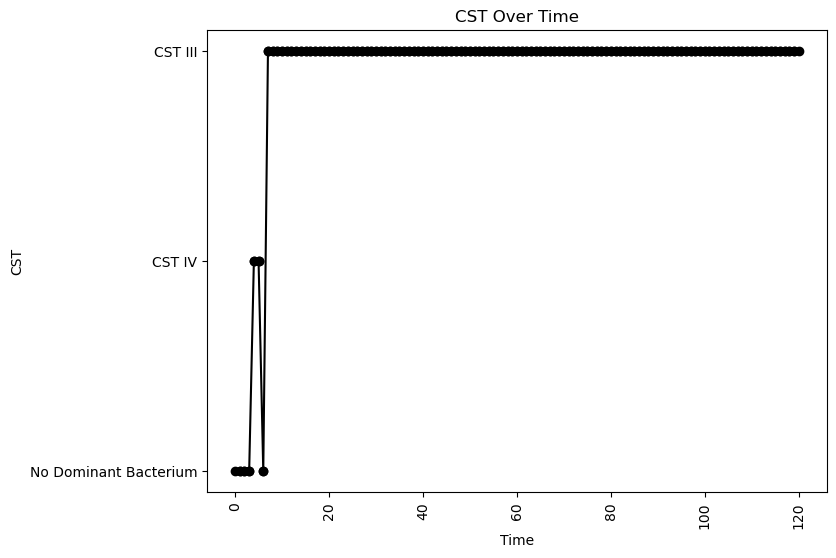


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.060361819482043215
nAB->Li: -0.36899048219710673
nAB->oLB: -0.2152303408609269
Li->nAB: 0.4390752193623497
Li Self: -0.029106805529567015
Li->oLB: 0.07278854180771632
oLB->nAB: -0.1948473009068868
oLB->Li: -0.1872490946167405
oLB Self: -0.036938863266168936

Simulation 2854 follows a valid CST progression:


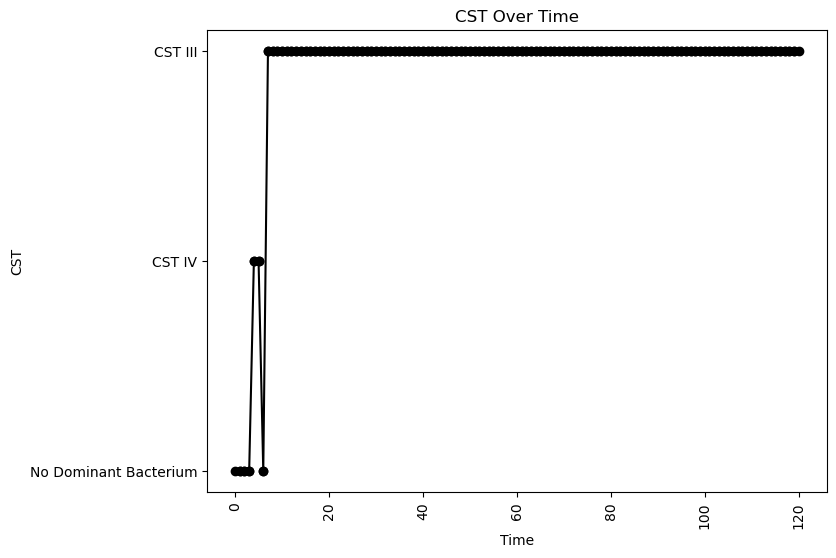


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.06374443922400562
nAB->Li: -0.1608788854446136
nAB->oLB: -0.35249105466365804
Li->nAB: 0.4282316372790207
Li Self: -0.0890230614637628
Li->oLB: -0.32106901572559976
oLB->nAB: -0.4663857068782111
oLB->Li: -0.07851955069597799
oLB Self: -0.08504727966189715

Simulation 2855 follows a valid CST progression:


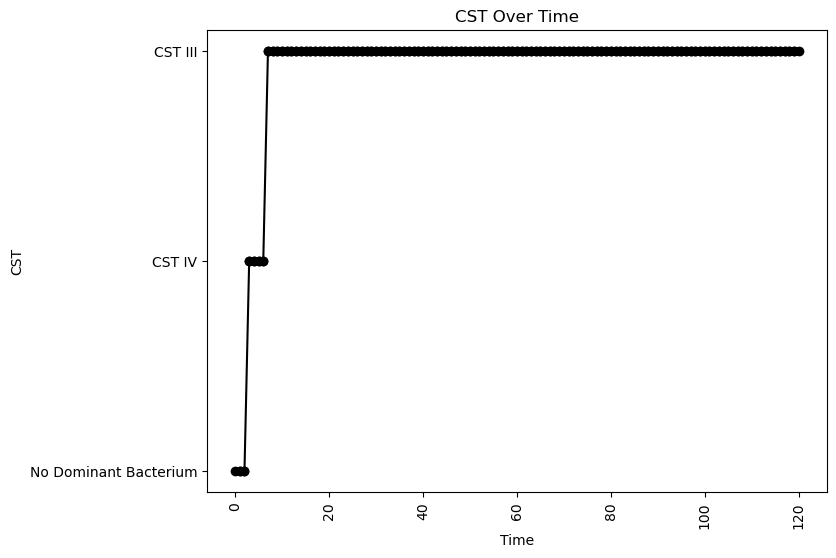


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.09362968932078367
nAB->Li: 0.05372651061899936
nAB->oLB: -0.21992565594946262
Li->nAB: 0.16746075246078707
Li Self: -0.0473077552803914
Li->oLB: 0.023704823063943947
oLB->nAB: -0.06490513148586569
oLB->Li: -0.21134424933987056
oLB Self: -0.0703183271101433

Simulation 2858 follows a valid CST progression:


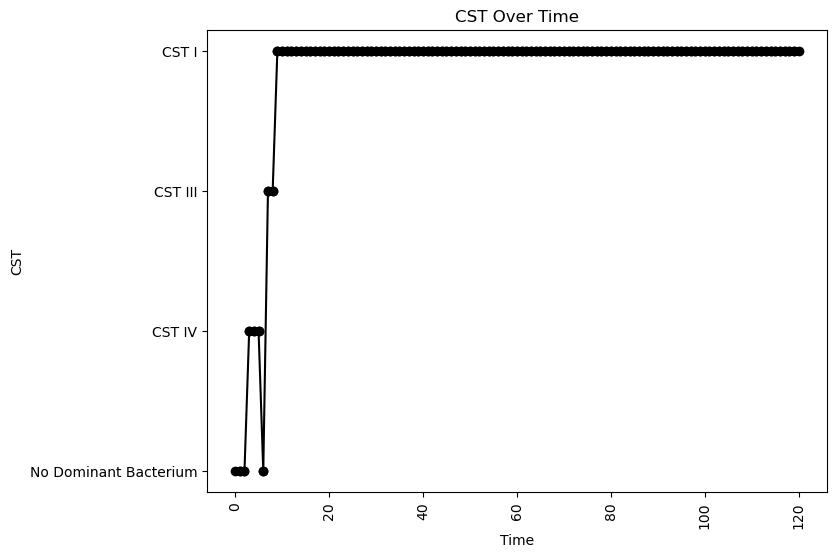


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.057727110649215596
nAB->Li: -0.35593077972826564
nAB->oLB: -0.47455452418072036
Li->nAB: 0.3299842940536828
Li Self: -0.0673777030135813
Li->oLB: -0.028415103518533102
oLB->nAB: -0.19243028386119426
oLB->Li: 0.29070531572793656
oLB Self: -0.0014089940784636212

Simulation 2861 follows a valid CST progression:


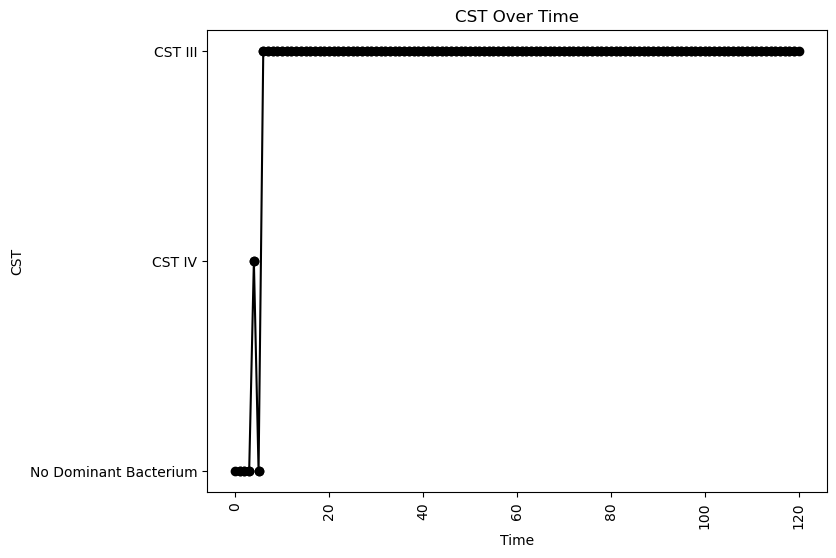


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.06495430992206574
oLB Growth: 0.1731103059651596
nAB Self: -0.02666903842190209
nAB->Li: -0.12997106920275703
nAB->oLB: -0.2623705576240376
Li->nAB: 0.33112018394349807
Li Self: -0.05000016585677969
Li->oLB: 0.2015683308453986
oLB->nAB: -0.37226086397546965
oLB->Li: -0.11802493367407119
oLB Self: -0.07906727163585658

Simulation 2871 follows a valid CST progression:


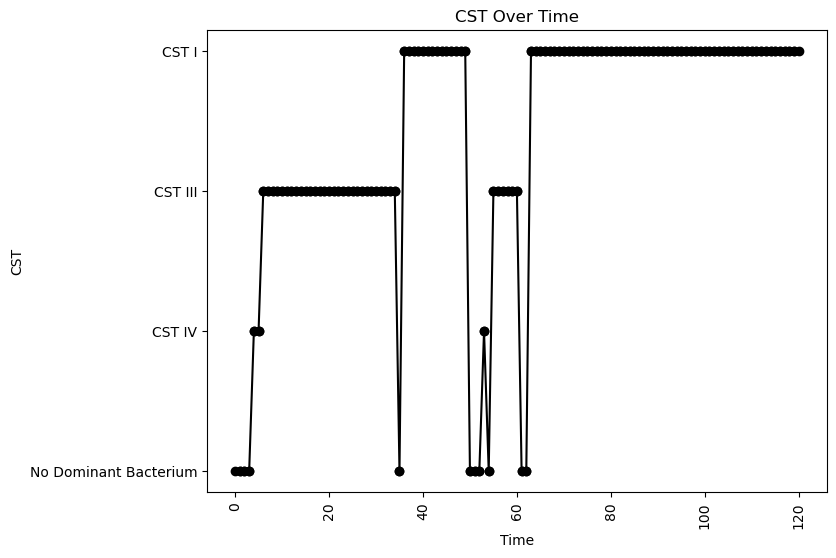


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.023833953973466604
nAB->Li: -0.4021705878698344
nAB->oLB: -0.38842713424583386
Li->nAB: 0.4934847698699374
Li Self: -0.09582198559857223
Li->oLB: -0.13810192463977122
oLB->nAB: -0.4794538414273778
oLB->Li: -0.007835969836099521
oLB Self: -0.06275563808283141

Simulation 2873 follows a valid CST progression:


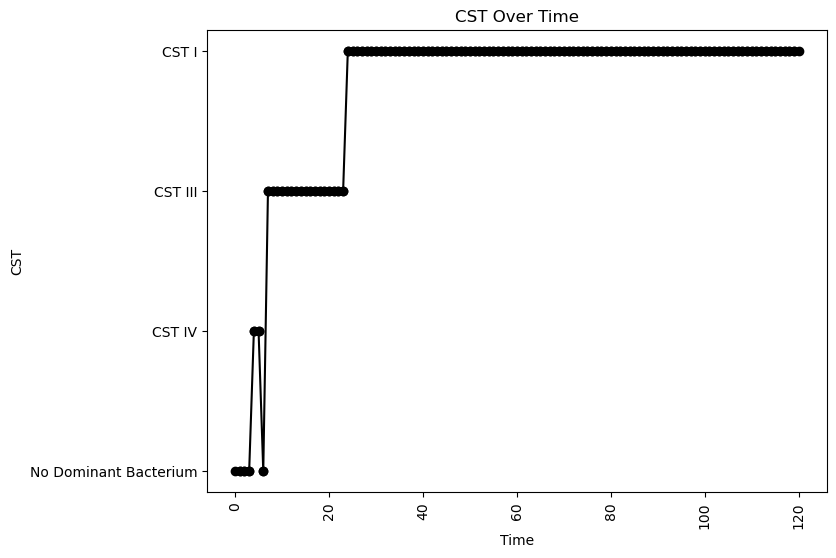


Interaction Parameters:
nAB Growth: 2.286323001067126
Li Growth: 0.08593735838827392
oLB Growth: 0.14091260068383374
nAB Self: -0.049018852450111276
nAB->Li: -0.4064400207098366
nAB->oLB: -0.45494839553945665
Li->nAB: 0.2270418290161338
Li Self: -0.03154855875397419
Li->oLB: -0.3574963061037576
oLB->nAB: -0.35005567223020395
oLB->Li: 0.033967732975545006
oLB Self: -0.017576289732598324

Simulation 2876 follows a valid CST progression:


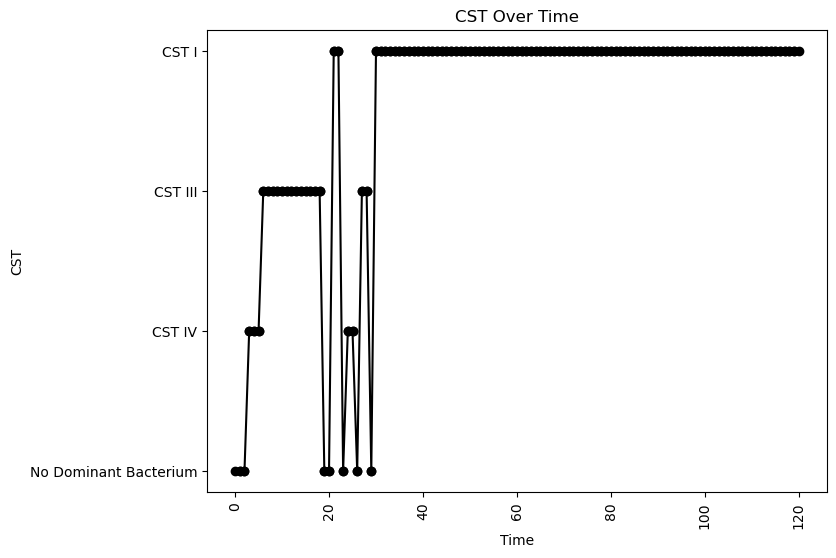


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.028922345464072935
nAB->Li: -0.19131846649786144
nAB->oLB: -0.27716114500230593
Li->nAB: 0.3387437278756379
Li Self: -0.05750004180055511
Li->oLB: -0.49101567956145903
oLB->nAB: -0.4795570293576992
oLB->Li: 0.17883378970518238
oLB Self: -0.0152685919655281

Simulation 2877 follows a valid CST progression:


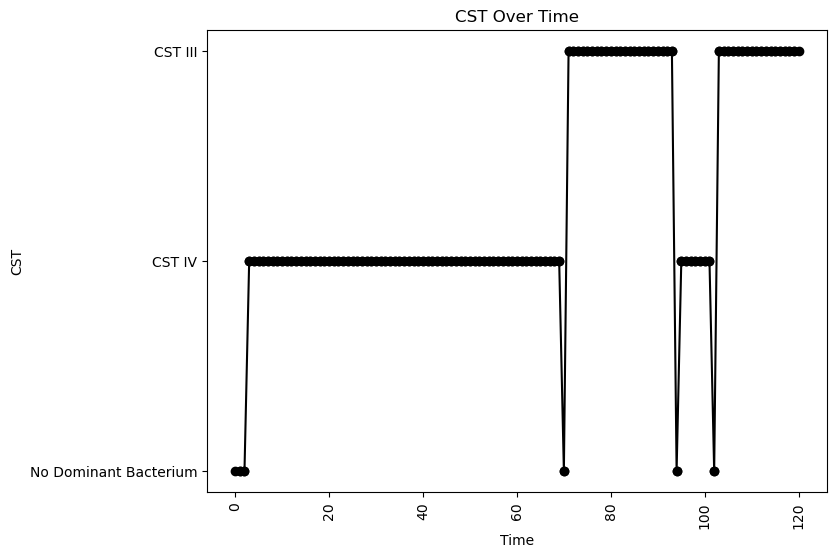


Interaction Parameters:
nAB Growth: 2.1964345031105657
Li Growth: 0.04025066595693835
oLB Growth: 1.2138354993931422
nAB Self: -0.011720635477329516
nAB->Li: -0.4197286254462157
nAB->oLB: -0.38490138263904505
Li->nAB: -0.0006182750361274914
Li Self: -0.06050072117772756
Li->oLB: -0.3825972775192833
oLB->nAB: -0.2663023611239707
oLB->Li: 0.16631869710163827
oLB Self: -0.09734266722813163

Simulation 2899 follows a valid CST progression:


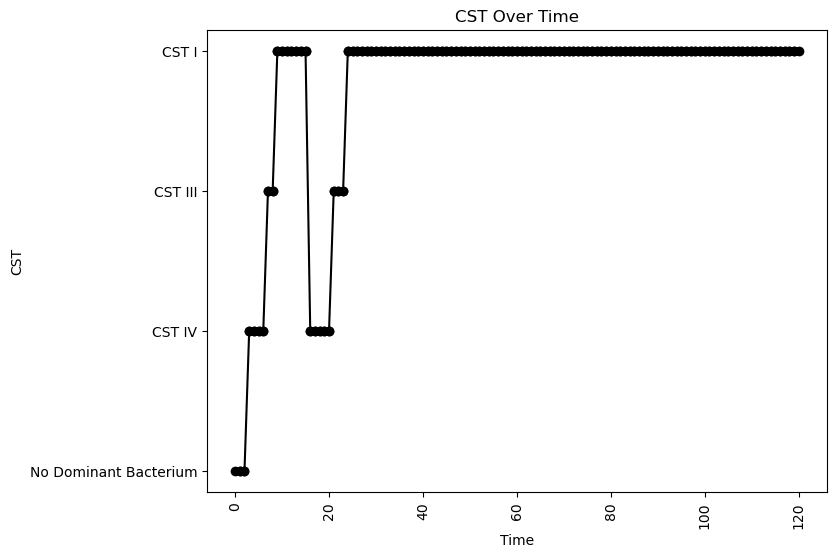


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.012161746372802235
nAB->Li: -0.08341845295627054
nAB->oLB: -0.30708636960258656
Li->nAB: 0.15905411168021555
Li Self: -0.049677796662756124
Li->oLB: -0.3110122343136872
oLB->nAB: -0.4976107474064299
oLB->Li: 0.47862297715774604
oLB Self: -0.09548959916838573

Simulation 2913 follows a valid CST progression:


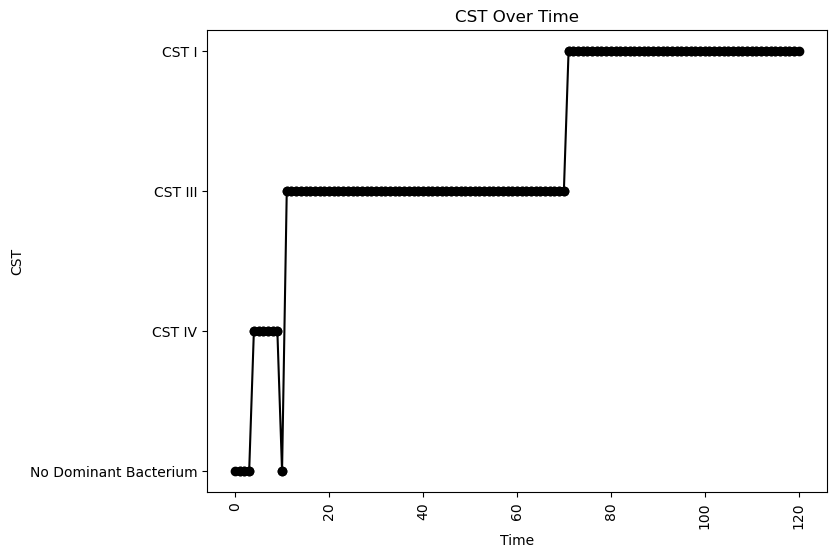


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.008314491052816536
nAB->Li: -0.3178933415758315
nAB->oLB: -0.06282065319136265
Li->nAB: 0.018487542687087966
Li Self: -0.013434093491390187
Li->oLB: -0.4160087081644631
oLB->nAB: -0.487412697396405
oLB->Li: 0.05639762195060083
oLB Self: -0.0558239874673728

Simulation 2914 follows a valid CST progression:


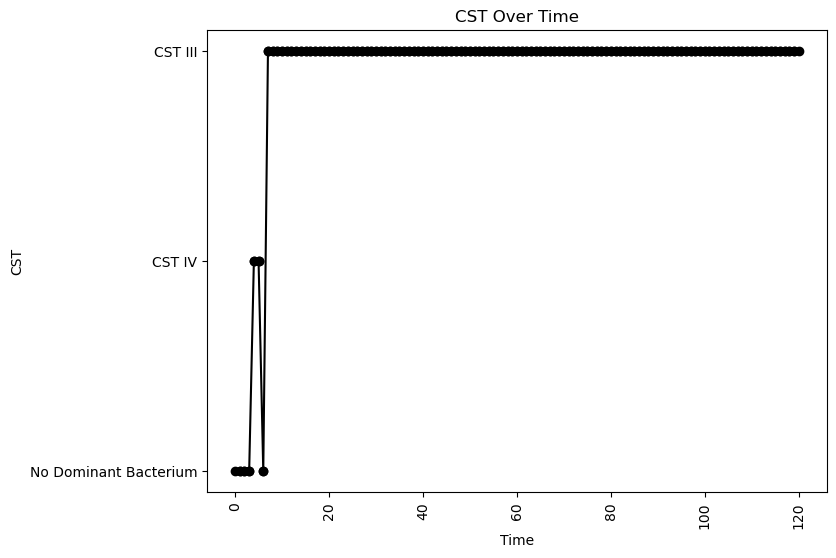


Interaction Parameters:
nAB Growth: 2.2088016144568243
Li Growth: 0.05268768924856952
oLB Growth: 1.1274304047774089
nAB Self: -0.06454094200011136
nAB->Li: -0.1179895454210903
nAB->oLB: -0.028224524927754124
Li->nAB: 0.28785375512749123
Li Self: -0.09367788465251559
Li->oLB: 0.452767210993159
oLB->nAB: -0.38316885484637353
oLB->Li: -0.2018886025646573
oLB Self: -0.09255611228275346

Simulation 2915 follows a valid CST progression:


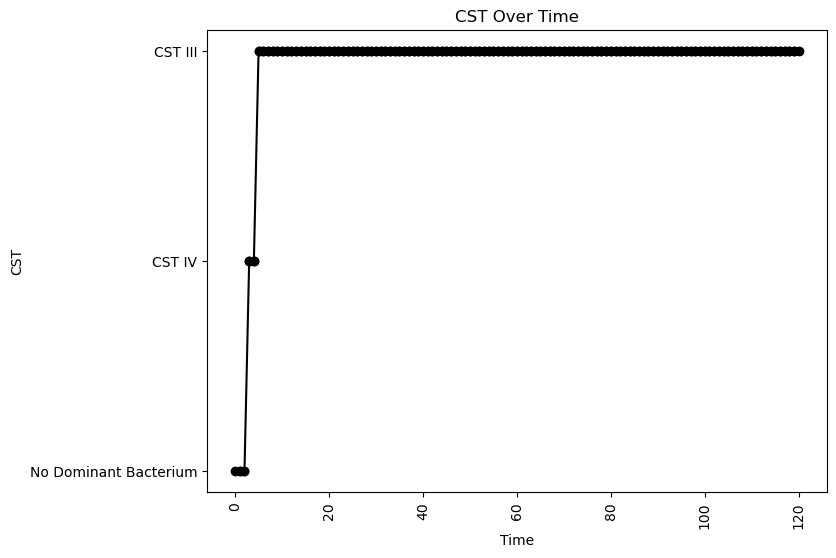


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.0530164949454228
nAB->Li: 0.05262966089900878
nAB->oLB: -0.08027707385368327
Li->nAB: 0.47624560377449754
Li Self: -0.024177475510420515
Li->oLB: -0.1560543347271699
oLB->nAB: -0.35557820326285366
oLB->Li: -0.4215465963708694
oLB Self: -0.019010570575863445

Simulation 2920 follows a valid CST progression:


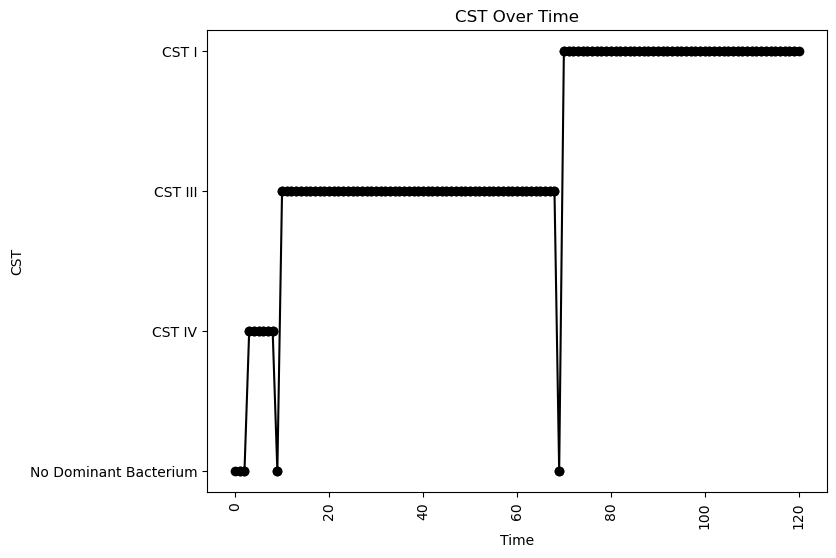


Interaction Parameters:
nAB Growth: 2.2088016144568243
Li Growth: 0.05268768924856952
oLB Growth: 1.1274304047774089
nAB Self: -0.04329262497728648
nAB->Li: -0.3680432946221663
nAB->oLB: -0.3363555184140582
Li->nAB: 0.09069449103659932
Li Self: -0.04532018948624001
Li->oLB: -0.4297683933766456
oLB->nAB: -0.42858074521943834
oLB->Li: -0.025975229444614945
oLB Self: -0.017758570160579856

Simulation 2923 follows a valid CST progression:


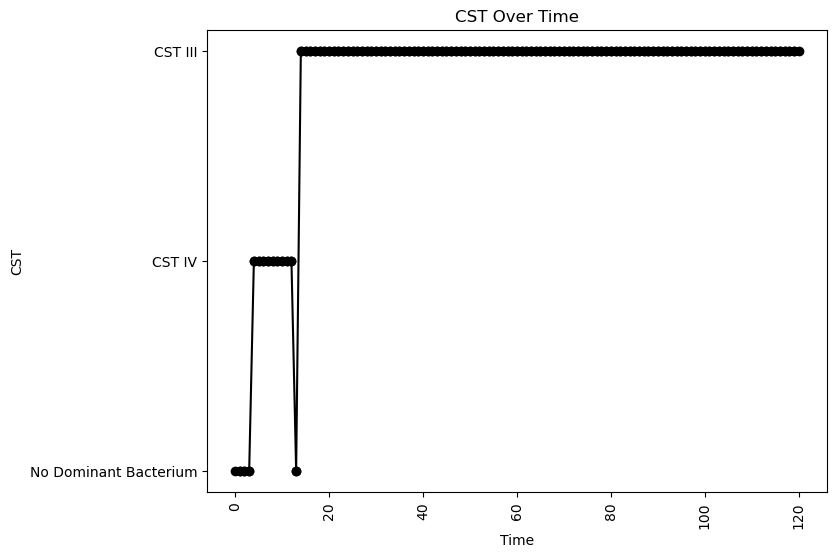


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.06806014290478743
oLB Growth: 0.20414555748463747
nAB Self: -0.05724260765429954
nAB->Li: -0.3444577463947161
nAB->oLB: -0.30589706832507363
Li->nAB: 0.03962462220359053
Li Self: -0.019479113348005117
Li->oLB: -0.19416154670118785
oLB->nAB: -0.2582218323426646
oLB->Li: -0.3976888081061646
oLB Self: -0.026226694466834927

Simulation 2925 follows a valid CST progression:


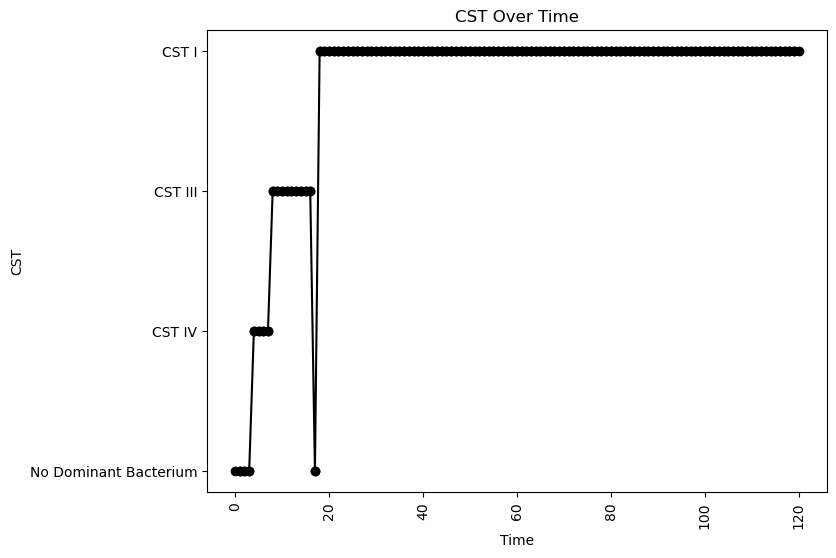


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.024541111547202385
nAB->Li: -0.22306670383151017
nAB->oLB: -0.3458442885959375
Li->nAB: 0.18389838344275944
Li Self: -0.014633137663139381
Li->oLB: -0.3539735937725894
oLB->nAB: -0.4379134555499899
oLB->Li: 0.13626458454542578
oLB Self: -0.024930728894086596

Simulation 2933 follows a valid CST progression:


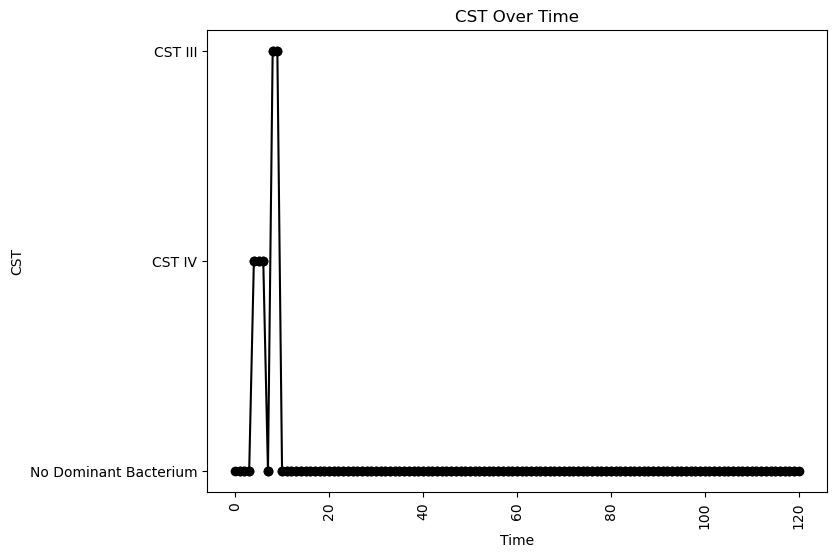


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.07288914463050424
nAB->Li: -0.25385797766272855
nAB->oLB: -0.012293624723723195
Li->nAB: 0.154087981135003
Li Self: -0.05619252265244302
Li->oLB: 0.28712538980598723
oLB->nAB: -0.3055823261393463
oLB->Li: 0.3764052397619372
oLB Self: -0.0051337197064008355

Simulation 2936 follows a valid CST progression:


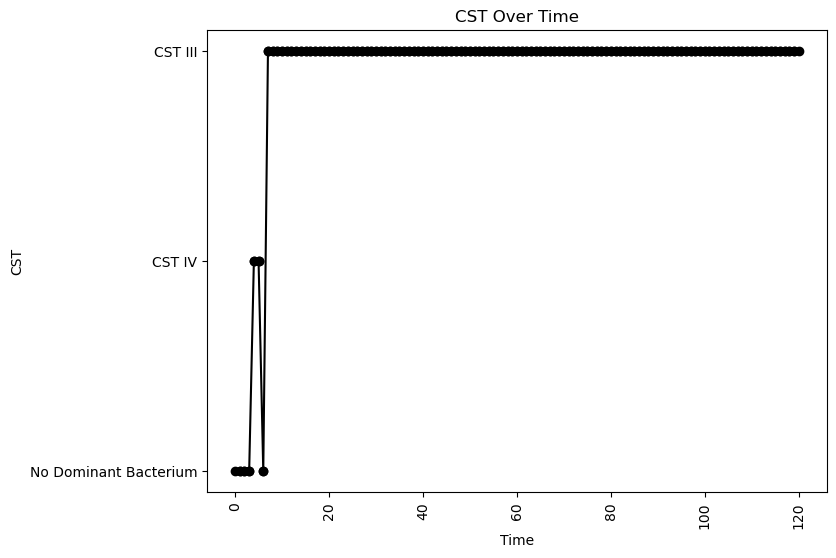


Interaction Parameters:
nAB Growth: 2.2563448832512942
Li Growth: 0.07234741829114298
oLB Growth: 0.40127498600949585
nAB Self: -0.05580525079062216
nAB->Li: 0.05357418160272365
nAB->oLB: -0.1606977580938595
Li->nAB: 0.38486694640864627
Li Self: -0.07089807999043102
Li->oLB: 0.45179772323280354
oLB->nAB: -0.41532403907544224
oLB->Li: 0.20378996575729047
oLB Self: -0.02775488177760818

Simulation 2947 follows a valid CST progression:


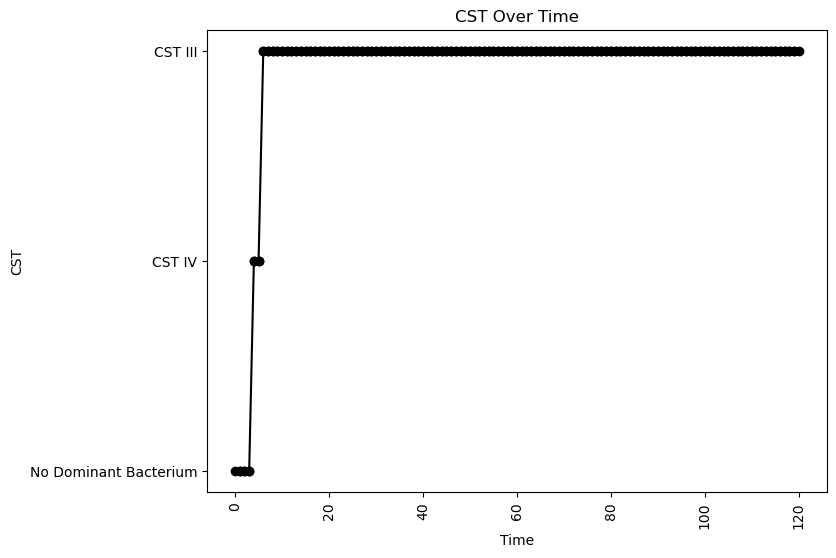


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.02446425325523624
nAB->Li: 0.12103802773698435
nAB->oLB: -0.4537851948899526
Li->nAB: 0.35089592260480007
Li Self: -0.03160168921417701
Li->oLB: 0.4947425618977844
oLB->nAB: -0.4676510738883236
oLB->Li: -0.4617775301878075
oLB Self: -0.0921306009426891

Simulation 2950 follows a valid CST progression:


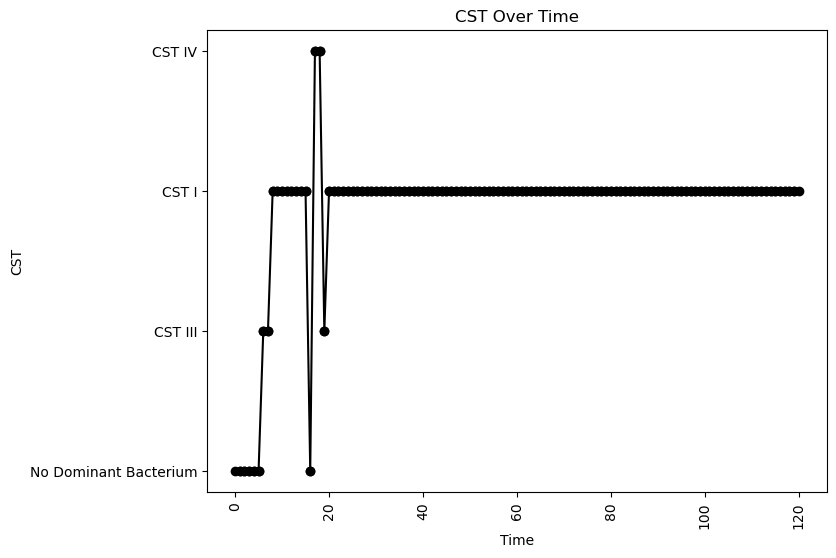


Interaction Parameters:
nAB Growth: 2.300652803872004
Li Growth: 0.35644213618652565
oLB Growth: 0.4369767544558836
nAB Self: -0.0024891830784693064
nAB->Li: -0.11471847031366023
nAB->oLB: -0.24365925414153866
Li->nAB: 0.4041777354261744
Li Self: -0.04052564255103658
Li->oLB: -0.21386699626022743
oLB->nAB: -0.20895984974865628
oLB->Li: 0.18060605055428747
oLB Self: -0.0771220313583201

Simulation 2955 follows a valid CST progression:


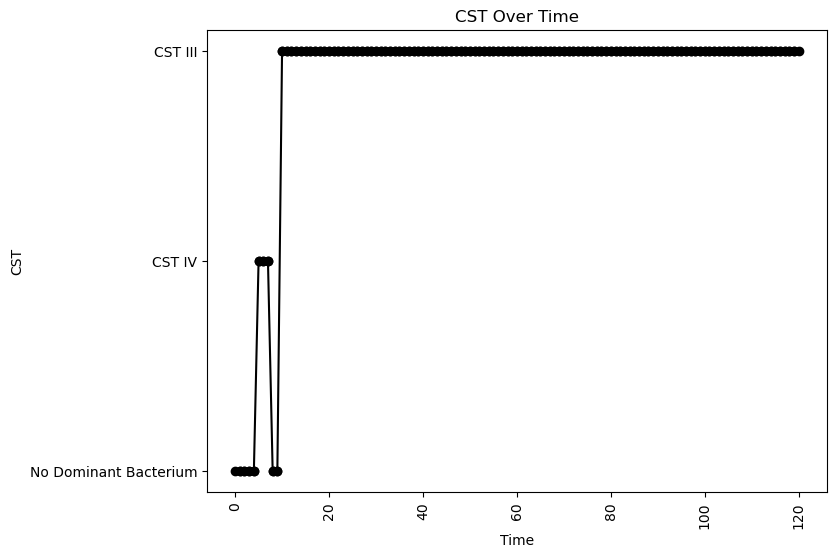


Interaction Parameters:
nAB Growth: 2.0745101401728236
Li Growth: 0.2805904493656118
oLB Growth: 1.1507970527071554
nAB Self: -0.0655538153135038
nAB->Li: -0.3636786606961894
nAB->oLB: -0.16244040518099373
Li->nAB: -0.012934348367929838
Li Self: -0.011122236984874329
Li->oLB: -0.25514267333414276
oLB->nAB: -0.25375136092188155
oLB->Li: -0.3133487073688786
oLB Self: -0.027587548730101233

Simulation 2967 follows a valid CST progression:


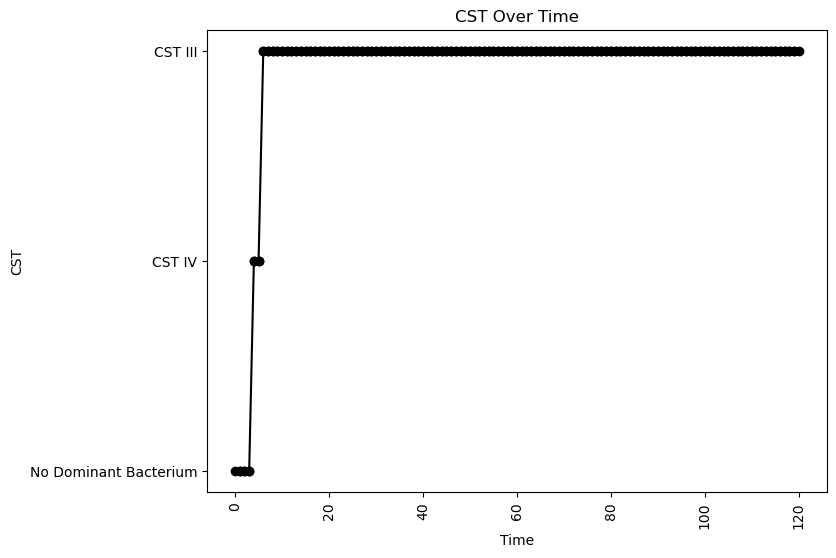


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.03837725110012093
oLB Growth: 1.155917868199191
nAB Self: -0.08355700381804562
nAB->Li: 0.14295953100640146
nAB->oLB: -0.02285834509943674
Li->nAB: 0.3555714118775448
Li Self: -0.009553796958876579
Li->oLB: 0.41766141364517395
oLB->nAB: -0.23858034096945485
oLB->Li: 0.1917460505870493
oLB Self: -0.061358834252101466

Simulation 2975 follows a valid CST progression:


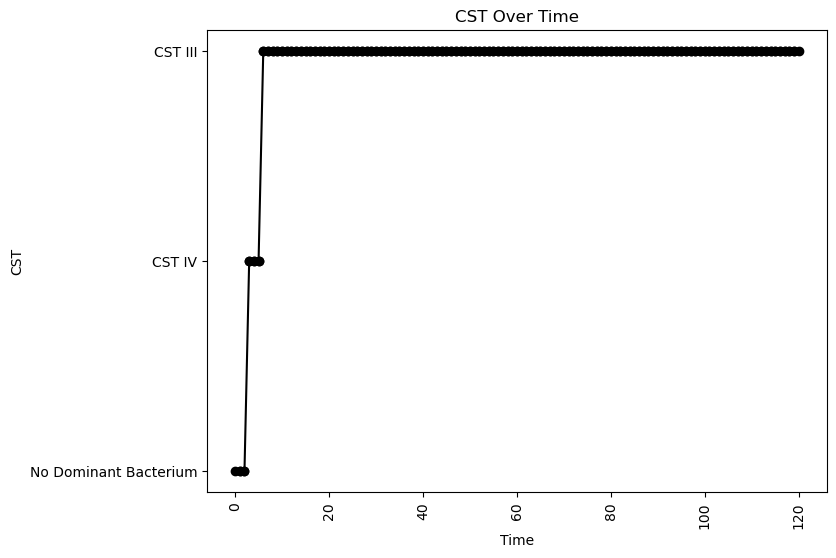


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.06495430992206574
oLB Growth: 0.1731103059651596
nAB Self: -0.05267490473527623
nAB->Li: -0.015556784667380086
nAB->oLB: -0.22968745042002447
Li->nAB: 0.3905574806872648
Li Self: -0.03259858197996976
Li->oLB: 0.20128542517056214
oLB->nAB: -0.48934642030973785
oLB->Li: -0.49598405010139884
oLB Self: -0.09761629418430921

Simulation 2978 follows a valid CST progression:


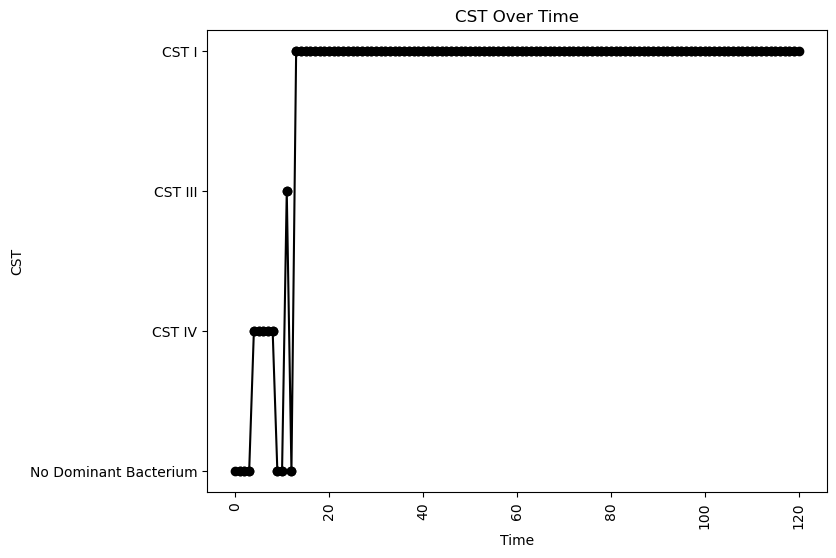


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.08972538978267076
nAB->Li: -0.054210055509157085
nAB->oLB: -0.1009185902106286
Li->nAB: 0.24387059985286652
Li Self: -0.08760398835988895
Li->oLB: 0.02541725459397859
oLB->nAB: -0.20941227251957784
oLB->Li: 0.3634987724964547
oLB Self: -0.04794417660362078

Simulation 2979 follows a valid CST progression:


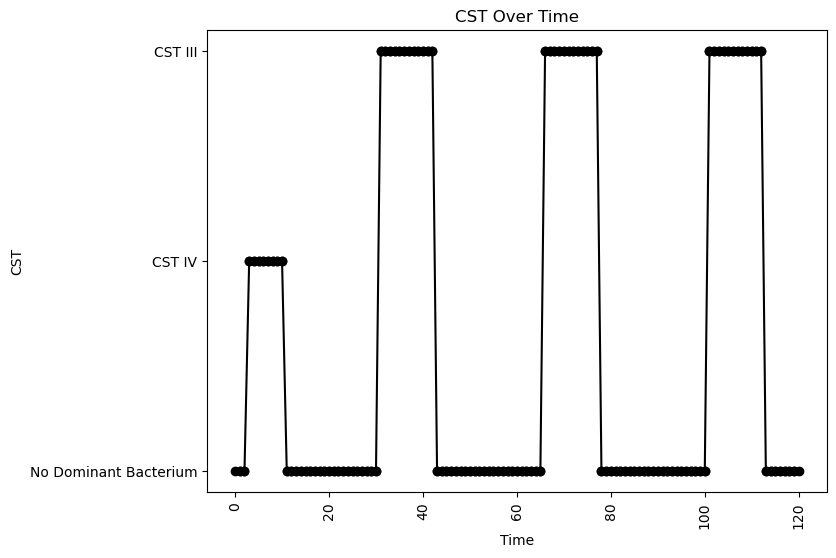


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.06543568998476293
nAB->Li: -0.09641343565892713
nAB->oLB: -0.4569440313395329
Li->nAB: 0.05109907970493677
Li Self: -0.0559268029729192
Li->oLB: -0.43408082388762004
oLB->nAB: -0.36626241085601485
oLB->Li: -0.30344275500457396
oLB Self: -0.023724474463759485

Simulation 2981 follows a valid CST progression:


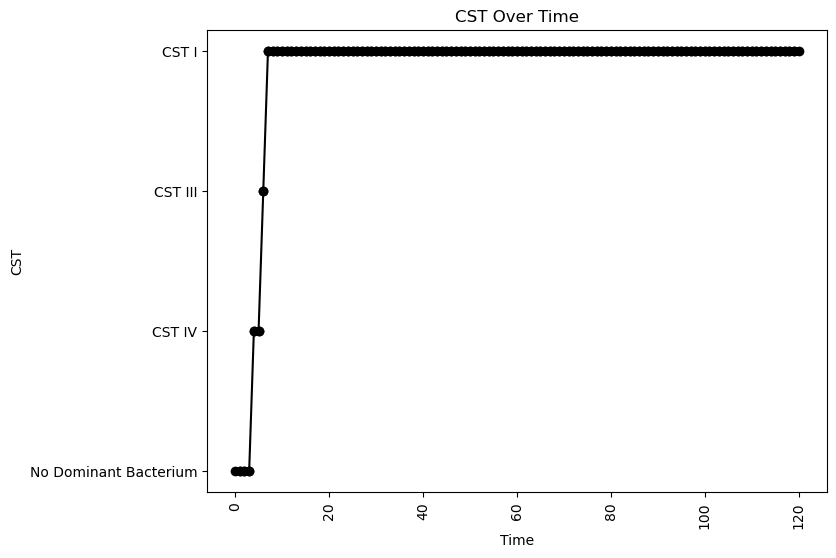


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.06806014290478743
oLB Growth: 0.20414555748463747
nAB Self: -0.05041040492250283
nAB->Li: 0.06431219847480596
nAB->oLB: -0.45984174509172127
Li->nAB: 0.25393159920446706
Li Self: -0.0316782551850989
Li->oLB: 0.16756778552660678
oLB->nAB: -0.20000818526047504
oLB->Li: 0.38703457813446196
oLB Self: -0.07499239283223706

Simulation 2985 follows a valid CST progression:


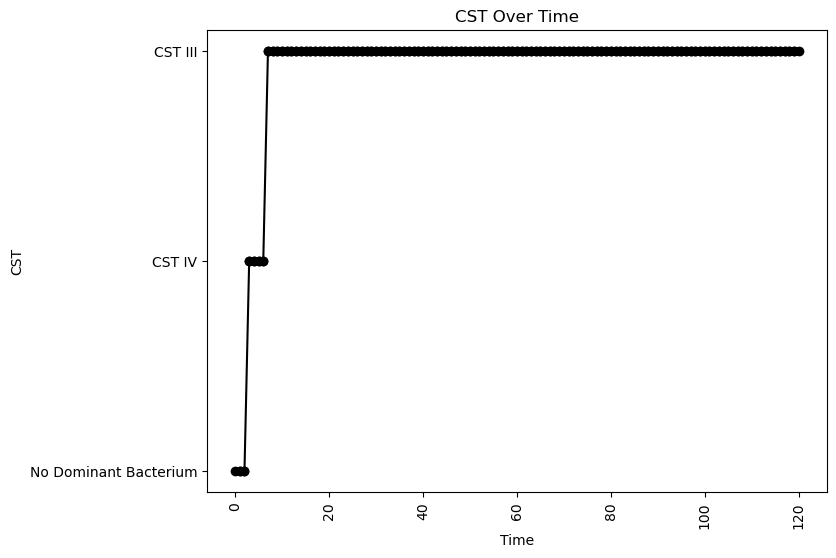


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.05406473440983722
nAB->Li: 0.017476742678561474
nAB->oLB: -0.47661030157476836
Li->nAB: 0.15124816310857214
Li Self: -0.03060325205399199
Li->oLB: -0.12461085318535875
oLB->nAB: -0.32332619471322954
oLB->Li: 0.005560034760812571
oLB Self: -0.09465051864918538

Simulation 2988 follows a valid CST progression:


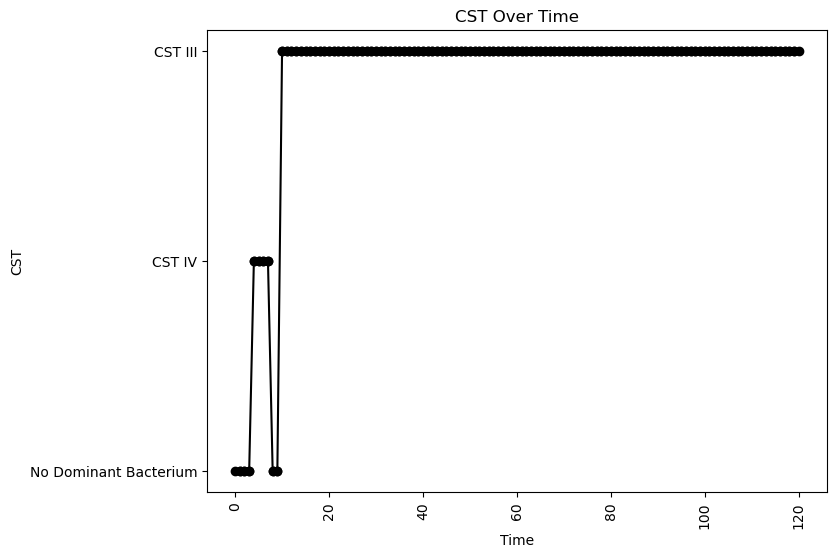


Interaction Parameters:
nAB Growth: 2.172057972480792
Li Growth: 0.05464936187495586
oLB Growth: 1.1816194682992254
nAB Self: -0.07895663071760795
nAB->Li: 0.09852752102879758
nAB->oLB: -0.33125622871133925
Li->nAB: 0.20977106333326034
Li Self: -0.05693784089671641
Li->oLB: 0.09536846893556938
oLB->nAB: -0.4611898618139966
oLB->Li: -0.3551690117312829
oLB Self: -0.07617431196405228

Simulation 2990 follows a valid CST progression:


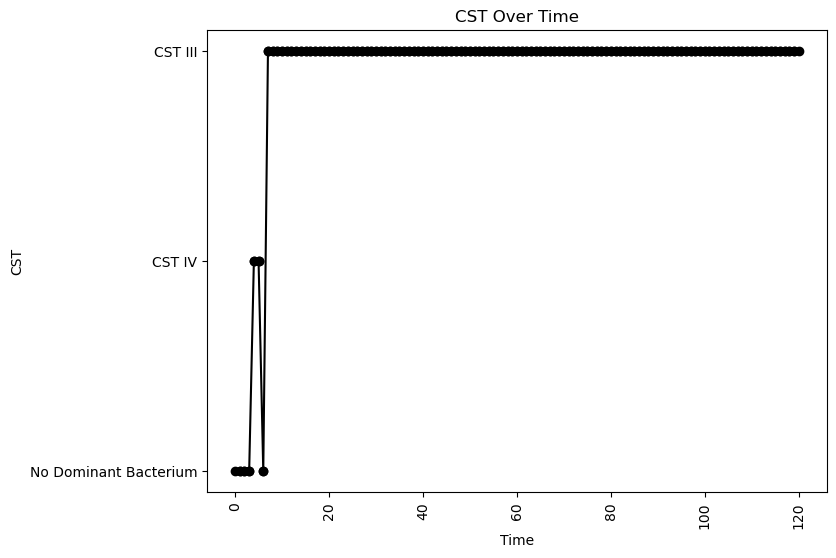


Interaction Parameters:
nAB Growth: 2.226251684223429
Li Growth: 0.0760937960697033
oLB Growth: 0.4505921706771102
nAB Self: -0.0070692522790235385
nAB->Li: 0.07754659416118381
nAB->oLB: -0.35562129416035815
Li->nAB: 0.31695500374735863
Li Self: -0.07267178029547201
Li->oLB: -0.027447178769773484
oLB->nAB: -0.03302000888304707
oLB->Li: -0.22268814717011637
oLB Self: -0.07583098496634391

Simulation 3002 follows a valid CST progression:


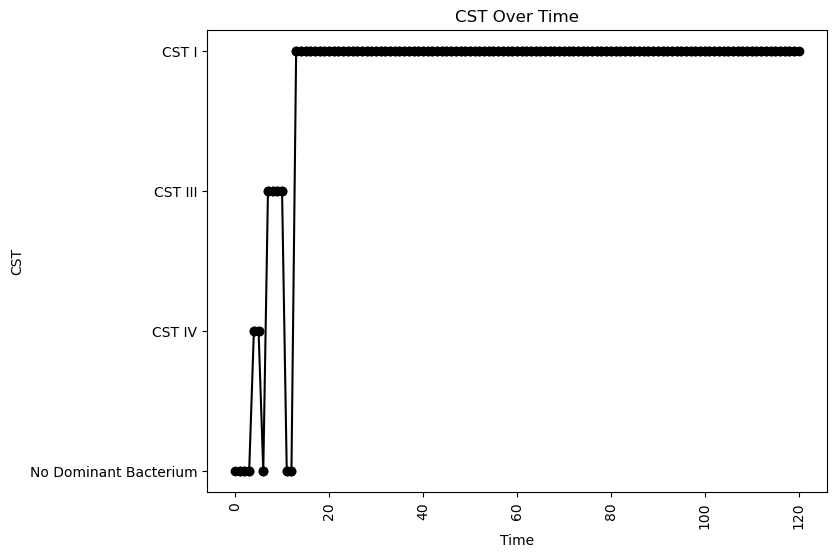


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.04058497843778552
nAB->Li: -0.10140785916700168
nAB->oLB: -0.40563210810101413
Li->nAB: 0.21489366380304187
Li Self: -0.03967432369568622
Li->oLB: -0.08835870633901183
oLB->nAB: -0.17890993445760905
oLB->Li: 0.09056113166745094
oLB Self: -0.01738063935880385

Simulation 3003 follows a valid CST progression:


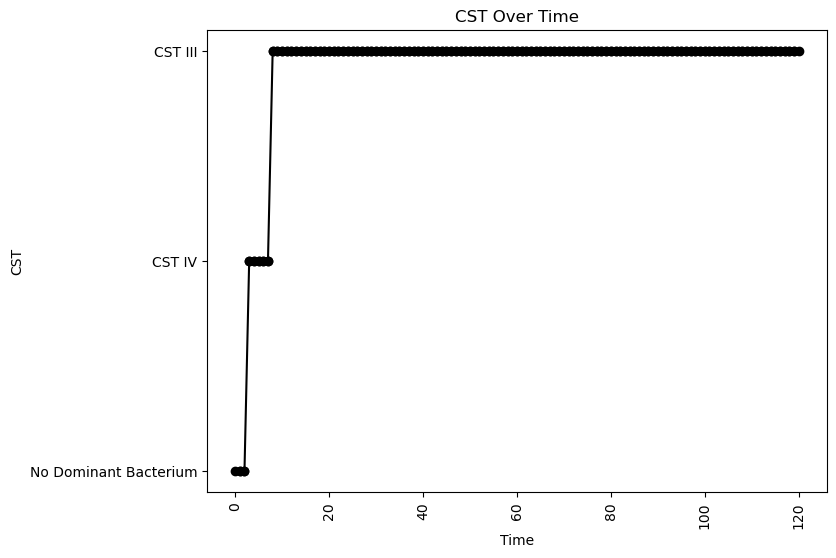


Interaction Parameters:
nAB Growth: 2.0745101401728236
Li Growth: 0.010341045972876578
oLB Growth: 1.1507970527071554
nAB Self: -0.016615141903517844
nAB->Li: -0.3129588949243337
nAB->oLB: -0.458017513509811
Li->nAB: 0.1762220394517744
Li Self: -0.03019755635958768
Li->oLB: 0.26805969422111886
oLB->nAB: -0.3238295325113686
oLB->Li: -0.38362108795406274
oLB Self: -0.06801749664498023

Simulation 3007 follows a valid CST progression:


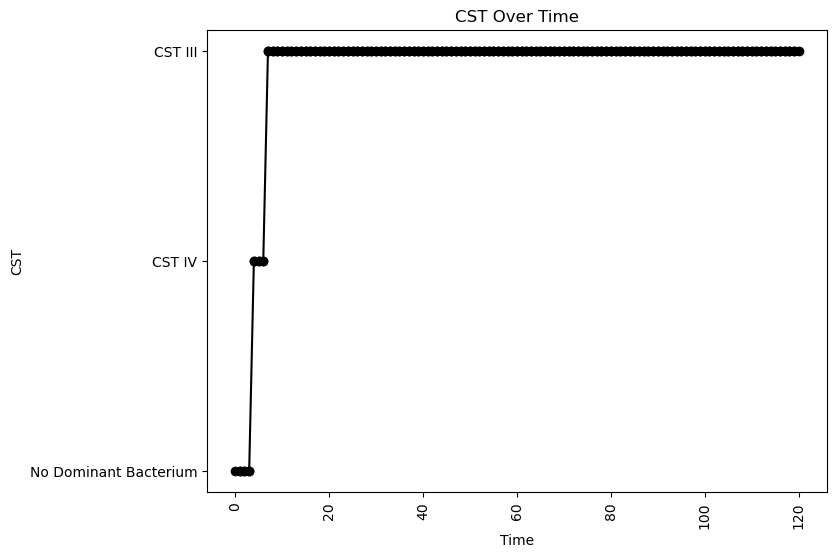


Interaction Parameters:
nAB Growth: 2.286323001067126
Li Growth: 0.060377934648291574
oLB Growth: 0.14091260068383374
nAB Self: -0.004516344040649392
nAB->Li: -0.07449073850394727
nAB->oLB: -0.09633170946728836
Li->nAB: 0.3621039739351791
Li Self: -0.09419262930564828
Li->oLB: -0.2578923085803807
oLB->nAB: -0.322808880428941
oLB->Li: -0.18947638651327603
oLB Self: -0.006537198946817979

Simulation 3014 follows a valid CST progression:


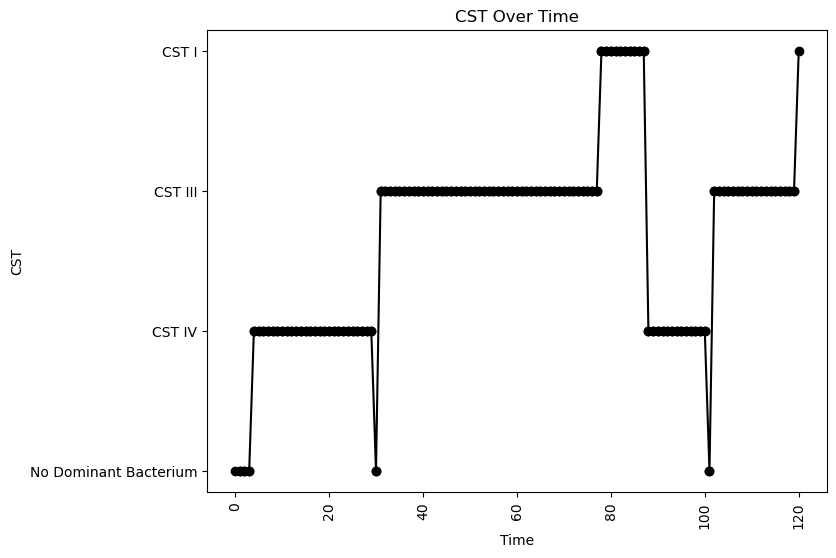


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.006932260157391457
nAB->Li: -0.22353533032037265
nAB->oLB: -0.09989487629727556
Li->nAB: 0.007586220803663557
Li Self: -0.03283129787199353
Li->oLB: -0.21464671674879038
oLB->nAB: -0.3251859209587959
oLB->Li: 0.4003300710453711
oLB Self: -0.04955492143971331

Simulation 3019 follows a valid CST progression:


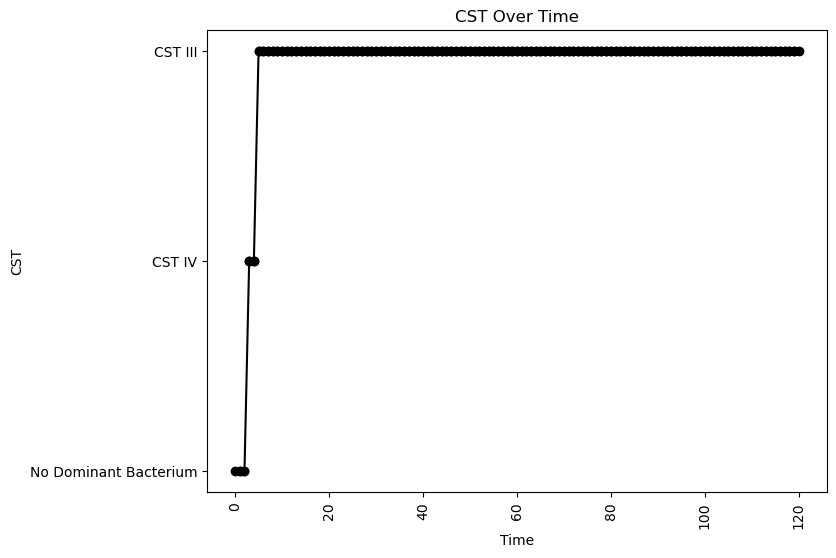


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.024079501548518442
nAB->Li: 0.08982448112196606
nAB->oLB: -0.4670533409168246
Li->nAB: 0.46831541875784444
Li Self: -0.09184318852342142
Li->oLB: -0.3516790830463896
oLB->nAB: -0.07222279533321596
oLB->Li: -0.4836180966864869
oLB Self: -0.052193870039002964

Simulation 3028 follows a valid CST progression:


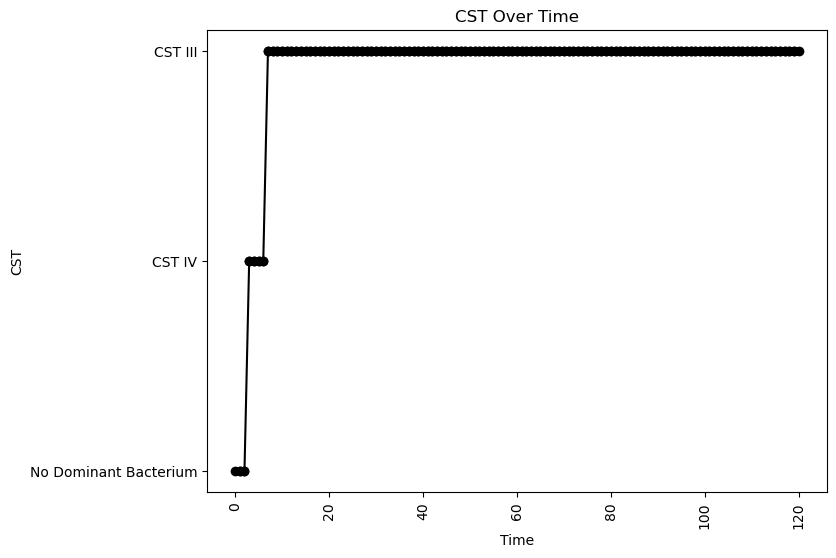


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.008398492630342771
nAB->Li: 0.06960019779253634
nAB->oLB: -0.15679996455541384
Li->nAB: 0.10834334605222695
Li Self: -0.003139332482807719
Li->oLB: -0.37114201350263865
oLB->nAB: -0.15814998559124055
oLB->Li: -0.051479345377095254
oLB Self: -0.010011022904405961

Simulation 3029 follows a valid CST progression:


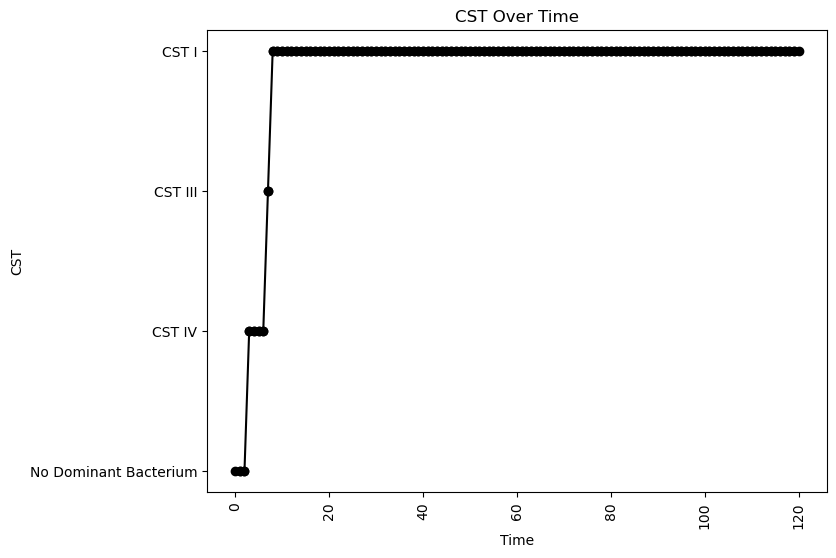


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.07271343926241669
nAB->Li: 0.0052792275045111525
nAB->oLB: -0.1406474479509014
Li->nAB: 0.1608029408497712
Li Self: -0.009979406541022418
Li->oLB: -0.09050697250461459
oLB->nAB: -0.4534527413881504
oLB->Li: 0.3307185856943996
oLB Self: -0.025097877875731617

Simulation 3034 follows a valid CST progression:


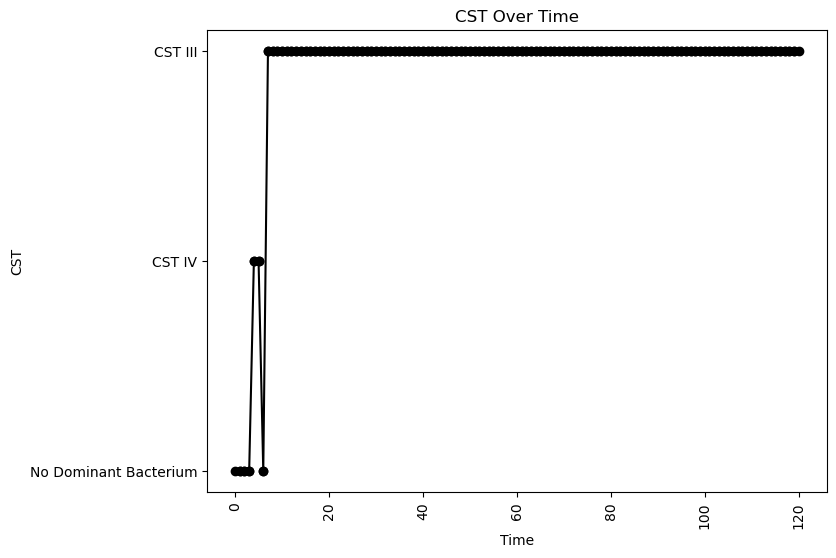


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.02597043446574672
nAB->Li: -0.18201420219390146
nAB->oLB: -0.2856411381005689
Li->nAB: 0.2099556513944526
Li Self: -0.06885276135426326
Li->oLB: 0.1832454009928407
oLB->nAB: -0.47420518344386076
oLB->Li: -0.4590393659907067
oLB Self: -0.039513585802333814

Simulation 3044 follows a valid CST progression:


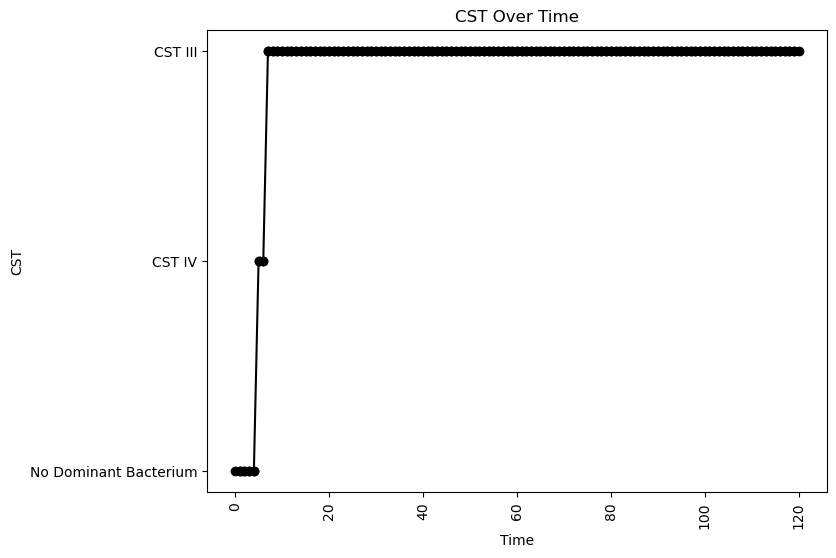


Interaction Parameters:
nAB Growth: 2.2657644953374403
Li Growth: 0.07173881162026666
oLB Growth: 0.2949021384914317
nAB Self: -0.05456336501728664
nAB->Li: -0.10199264446487682
nAB->oLB: -0.2968115127609339
Li->nAB: 0.27074877963988153
Li Self: -0.06455028105085897
Li->oLB: 0.4759581321912497
oLB->nAB: -0.06192054581365042
oLB->Li: -0.07835573974229043
oLB Self: -0.080462625953899

Simulation 3046 follows a valid CST progression:


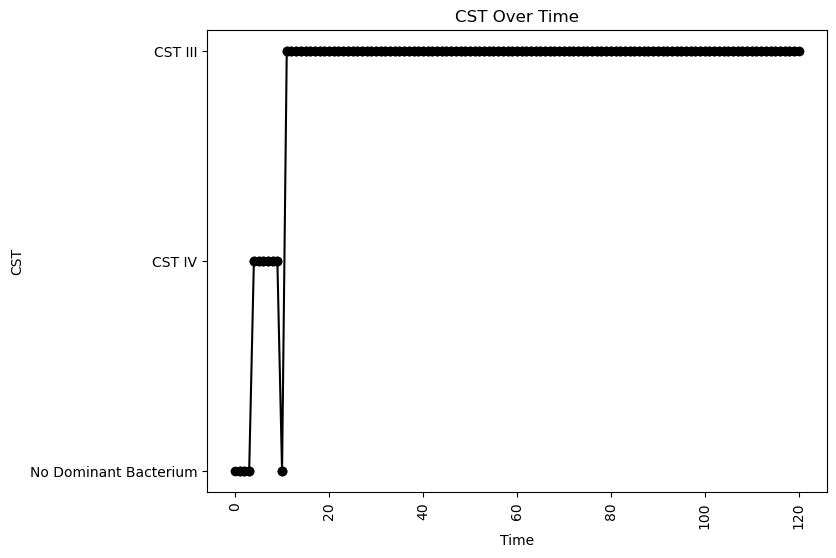


Interaction Parameters:
nAB Growth: 2.1573635369289432
Li Growth: 0.04215849674910016
oLB Growth: 1.2503024394854367
nAB Self: -0.06089891687701102
nAB->Li: -0.126824893425046
nAB->oLB: -0.007351409930710984
Li->nAB: 0.12700570649545673
Li Self: -0.02030124195532522
Li->oLB: 0.1326084758040872
oLB->nAB: -0.45380424645961726
oLB->Li: -0.06864498199680619
oLB Self: -0.05185213011349976

Simulation 3054 follows a valid CST progression:


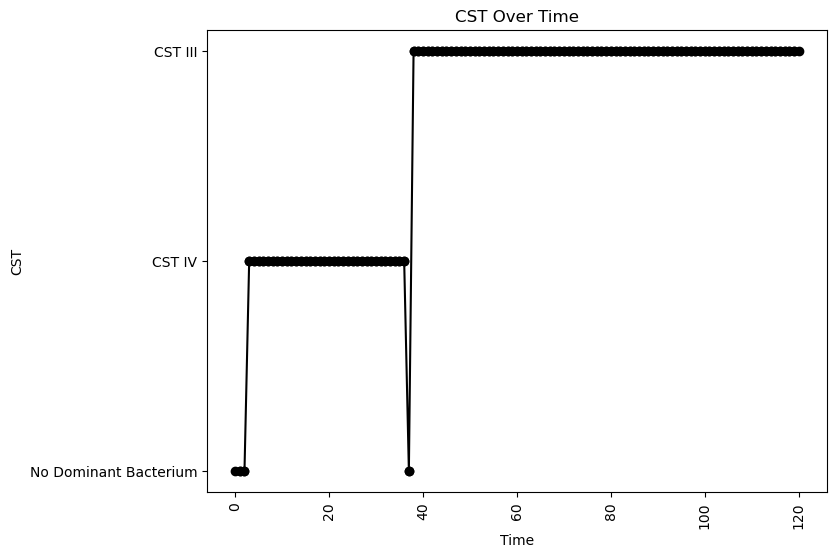


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.06588260315658048
oLB Growth: 0.21113539622386296
nAB Self: -0.07516045469913409
nAB->Li: -0.38759530157650546
nAB->oLB: -0.01477679241858848
Li->nAB: 0.0018108734143914562
Li Self: -0.03338316504846375
Li->oLB: -0.47111842504941737
oLB->nAB: -0.29497221556595327
oLB->Li: -0.33121641122453815
oLB Self: -0.08507346798907067

Simulation 7219 follows a valid CST progression:


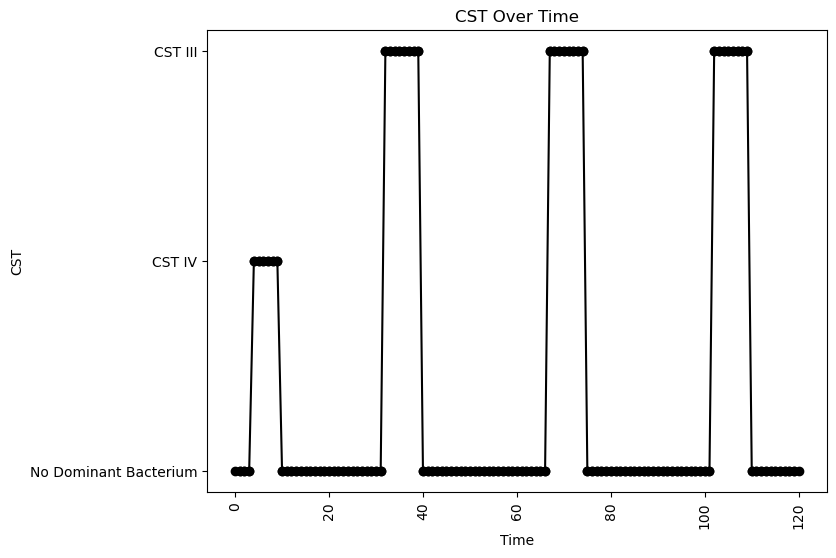


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.04389116053424468
nAB->Li: -0.06396854942136726
nAB->oLB: -0.08196401199848496
Li->nAB: 0.07169872818680523
Li Self: -0.06825731522707738
Li->oLB: -0.3974238404061606
oLB->nAB: -0.48011755604425427
oLB->Li: -0.00555209486523911
oLB Self: -0.05747539369897118

Simulation 7221 follows a valid CST progression:


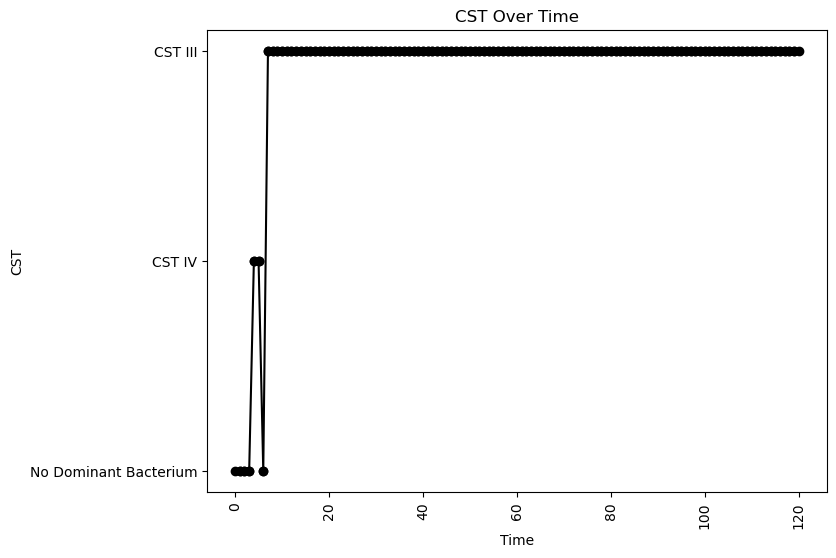


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.05500047236560612
nAB->Li: -0.19488067758092664
nAB->oLB: -0.226568750153389
Li->nAB: 0.33847686582523495
Li Self: -0.06573236041119024
Li->oLB: 0.48088443383330637
oLB->nAB: -0.46322767758508426
oLB->Li: 0.07893433585420018
oLB Self: -0.09609447366777074

Simulation 7224 follows a valid CST progression:


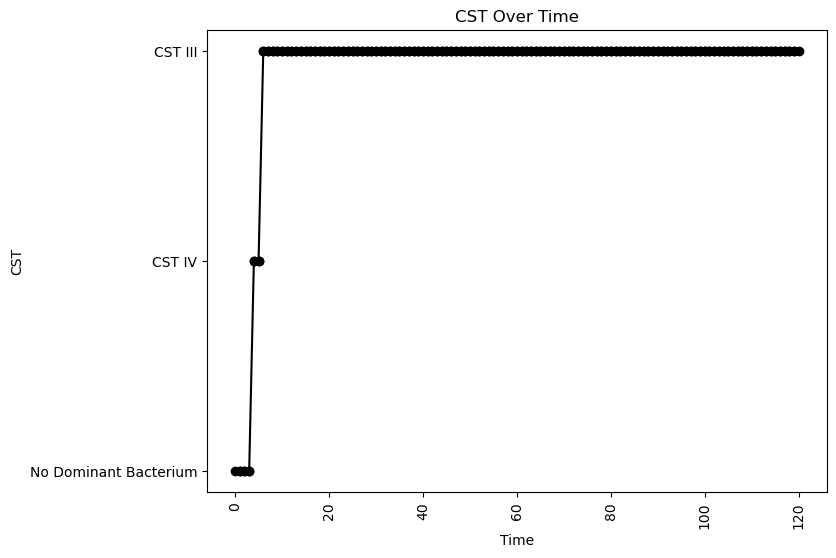


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.09035622586179216
nAB->Li: -0.4430937290803404
nAB->oLB: -0.17735367337408509
Li->nAB: 0.3633057966730343
Li Self: -0.02970158298116117
Li->oLB: 0.3711705061671735
oLB->nAB: -0.43661443660595145
oLB->Li: -0.06482484387922355
oLB Self: -0.043292810116420964

Simulation 7226 follows a valid CST progression:


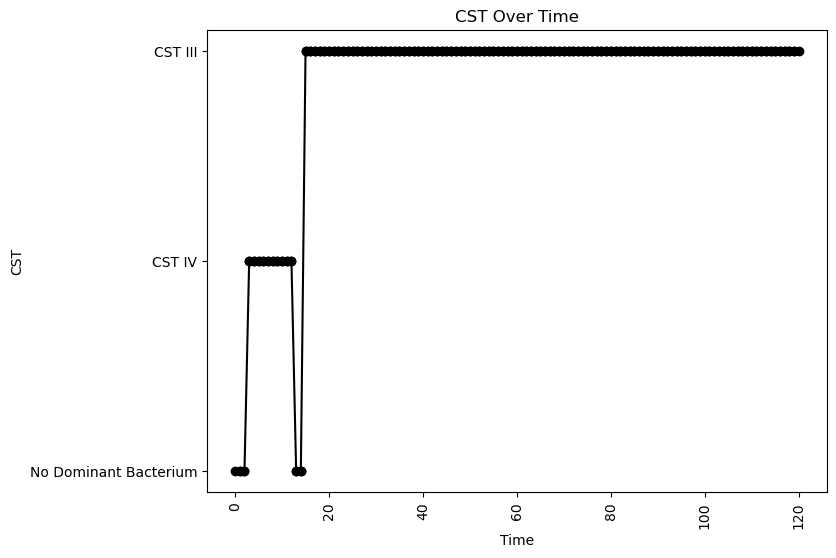


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.06210938628276111
nAB->Li: 0.04720014099504721
nAB->oLB: -0.009943782127924683
Li->nAB: 0.04970896190972596
Li Self: -0.06822007235177892
Li->oLB: 0.35752852357361
oLB->nAB: -0.06386721932853567
oLB->Li: 0.18776265093496536
oLB Self: -0.06987631485741384

Simulation 7236 follows a valid CST progression:


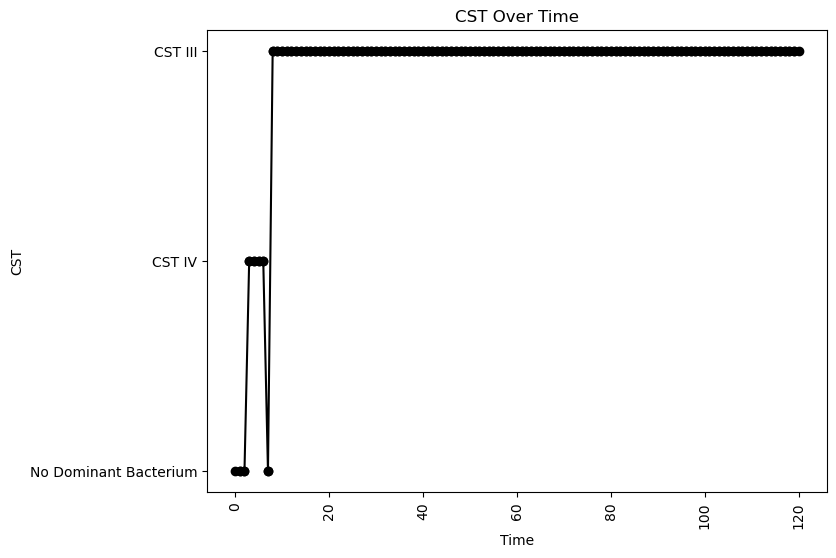


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.09381353224773795
nAB->Li: 0.028906779708101737
nAB->oLB: -0.25265649734048334
Li->nAB: 0.15984741784717216
Li Self: -0.03215076542046545
Li->oLB: 0.25969314878656835
oLB->nAB: -0.36467115701910546
oLB->Li: -0.18266502922498945
oLB Self: -0.07443316020283355

Simulation 7238 follows a valid CST progression:


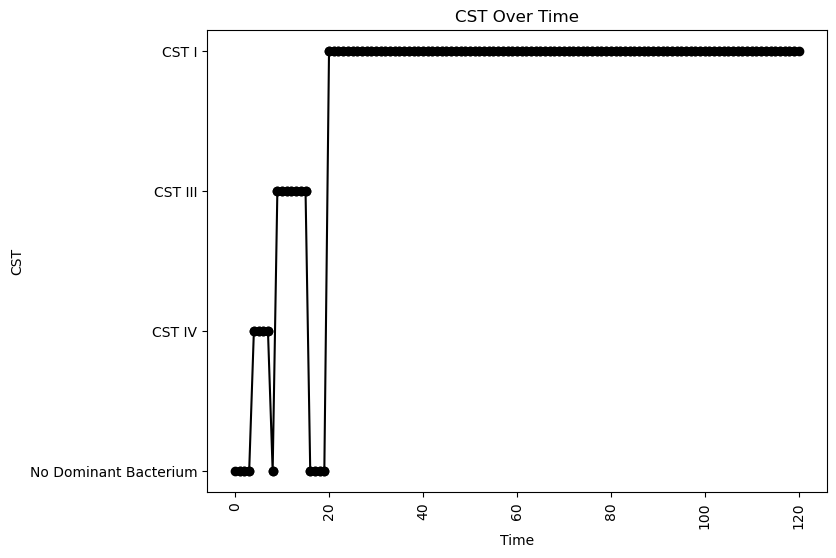


Interaction Parameters:
nAB Growth: 2.273308423784788
Li Growth: 0.06939466945066827
oLB Growth: 0.4879467602516997
nAB Self: -0.09815504619646766
nAB->Li: -0.4244422747063141
nAB->oLB: -0.4265980413476784
Li->nAB: 0.24203005663009303
Li Self: -0.08180072344309602
Li->oLB: -0.3955305629838522
oLB->nAB: -0.12156478794483883
oLB->Li: 0.11340298212741318
oLB Self: -0.07231003659969593

Simulation 7240 follows a valid CST progression:


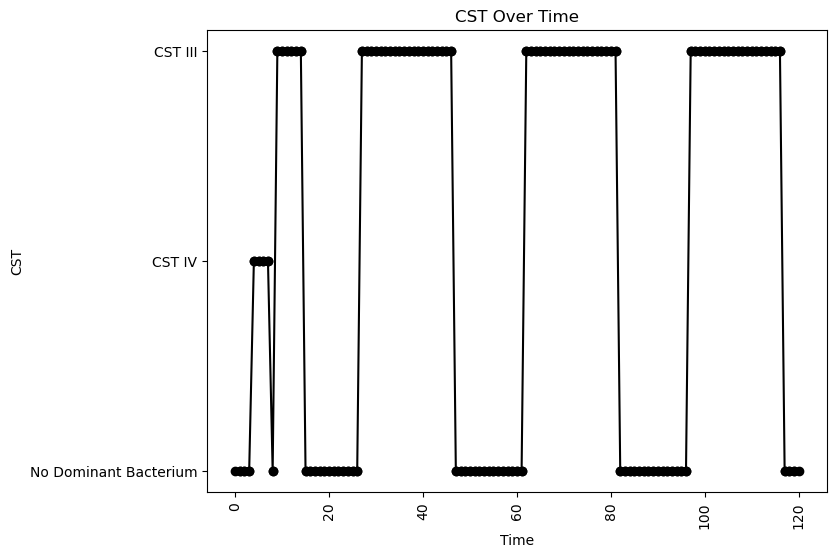


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.14104320049244246
oLB Growth: 0.31765248508565325
nAB Self: -0.015674294881681275
nAB->Li: -0.12128217425163496
nAB->oLB: -0.0544622726912653
Li->nAB: 0.05612771890978341
Li Self: -0.049879731324122975
Li->oLB: 0.12546234061899442
oLB->nAB: -0.16015593527845862
oLB->Li: -0.24912681735844217
oLB Self: -0.09907318628365007

Simulation 7246 follows a valid CST progression:


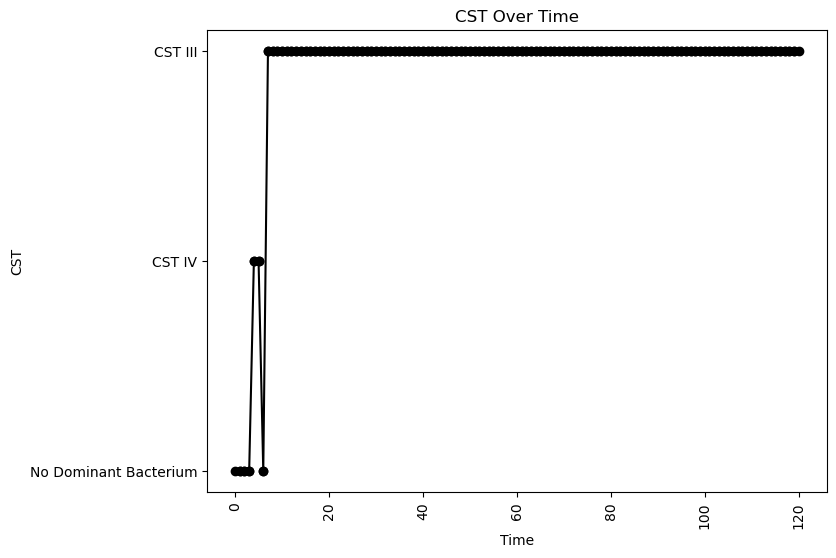


Interaction Parameters:
nAB Growth: 2.300652803872004
Li Growth: 0.06616501714537036
oLB Growth: 0.4369767544558836
nAB Self: -0.020538375212663162
nAB->Li: -0.2200397881407044
nAB->oLB: -0.1332226391430777
Li->nAB: 0.38985858829362574
Li Self: -0.05625351479318922
Li->oLB: 0.3866782700737005
oLB->nAB: -0.3727929150449514
oLB->Li: -0.30786239956048767
oLB Self: -0.08451264514249536

Simulation 7250 follows a valid CST progression:


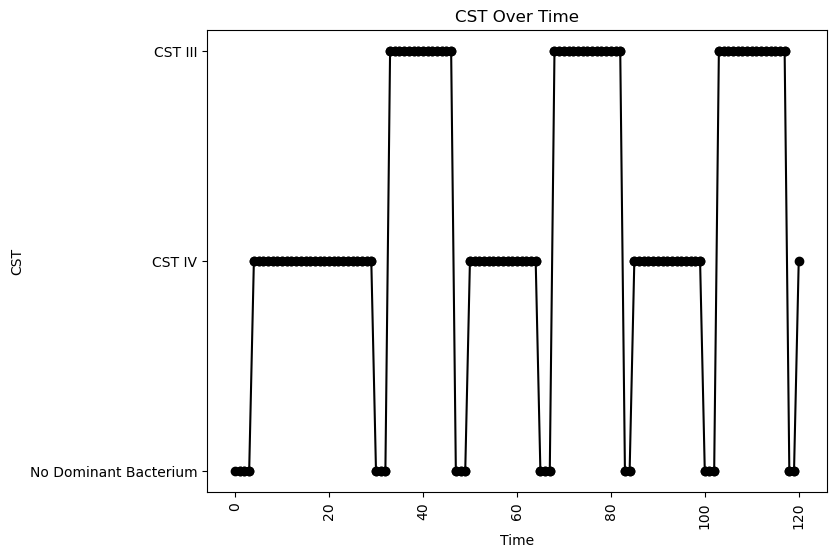


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.06806014290478743
oLB Growth: 0.20414555748463747
nAB Self: -0.05980764910515506
nAB->Li: -0.25728183839182717
nAB->oLB: -0.4427498375197304
Li->nAB: 0.02757364896586556
Li Self: -0.062298539795044044
Li->oLB: -0.33502138517934704
oLB->nAB: -0.2668282749066343
oLB->Li: -0.30076824306279787
oLB Self: -0.060288663424278265

Simulation 7253 follows a valid CST progression:


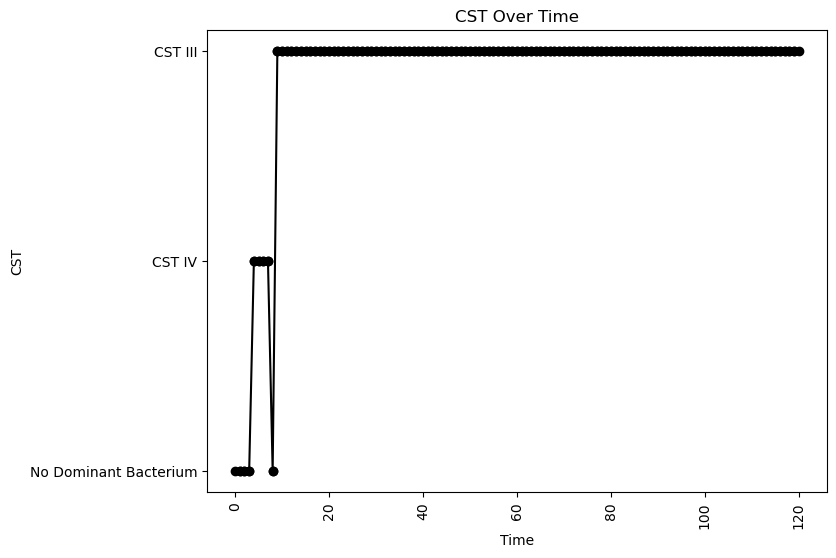


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.06806014290478743
oLB Growth: 0.20414555748463747
nAB Self: -0.044425857315233706
nAB->Li: -0.49848270724279686
nAB->oLB: -0.2959823512970051
Li->nAB: 0.18360713368167458
Li Self: -0.03986163555544623
Li->oLB: -0.3123178335635329
oLB->nAB: -0.29571979735786347
oLB->Li: -0.2996885912398085
oLB Self: -0.09560520684663978

Simulation 7255 follows a valid CST progression:


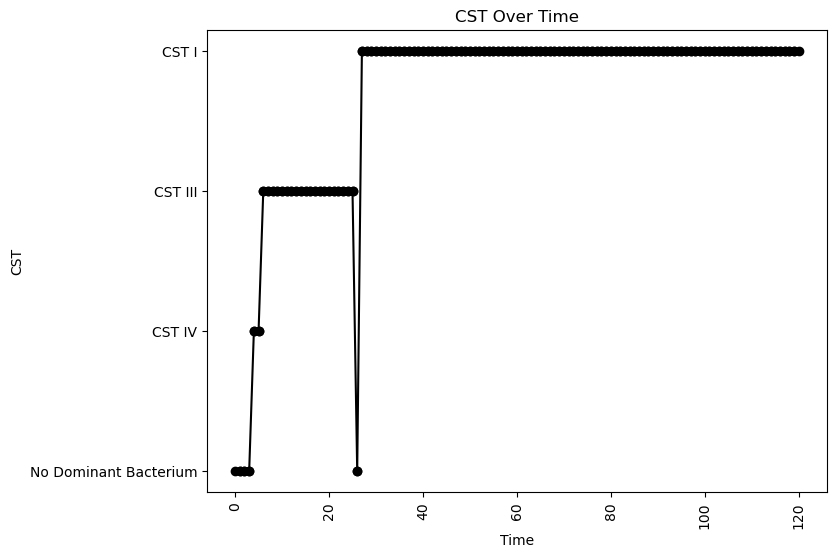


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.02316597676781637
nAB->Li: -0.09535076826922628
nAB->oLB: -0.3783931756557521
Li->nAB: 0.4914590582331544
Li Self: -0.025626358483759368
Li->oLB: -0.31751669234402735
oLB->nAB: -0.1356941958304908
oLB->Li: 0.004925131966922014
oLB Self: -0.07751743512305809

Simulation 7260 follows a valid CST progression:


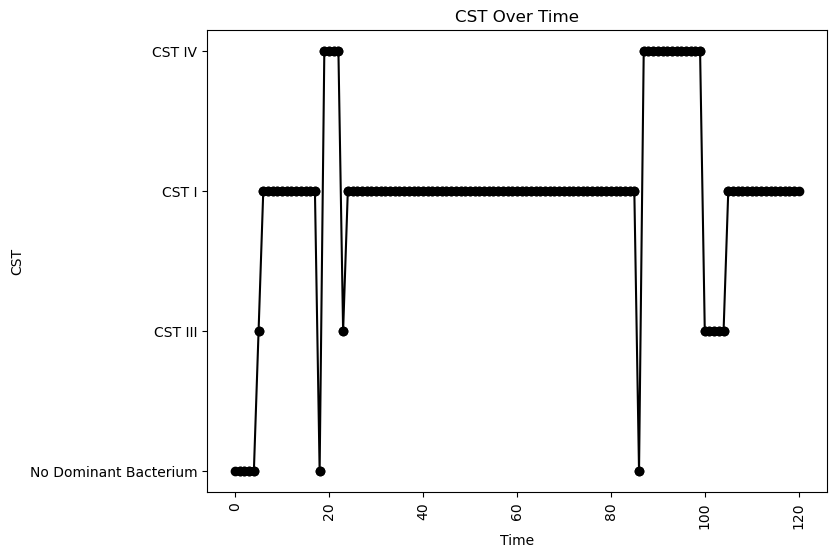


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.33777724641375695
oLB Growth: 0.2578671787060779
nAB Self: -0.06411072549777941
nAB->Li: 0.0753163254869832
nAB->oLB: -0.15857731722930046
Li->nAB: 0.3729115182008228
Li Self: -0.06446056105968895
Li->oLB: -0.18396269530819886
oLB->nAB: -0.30498509293711507
oLB->Li: 0.18641983013147423
oLB Self: -0.07810917094301138

Simulation 7261 follows a valid CST progression:


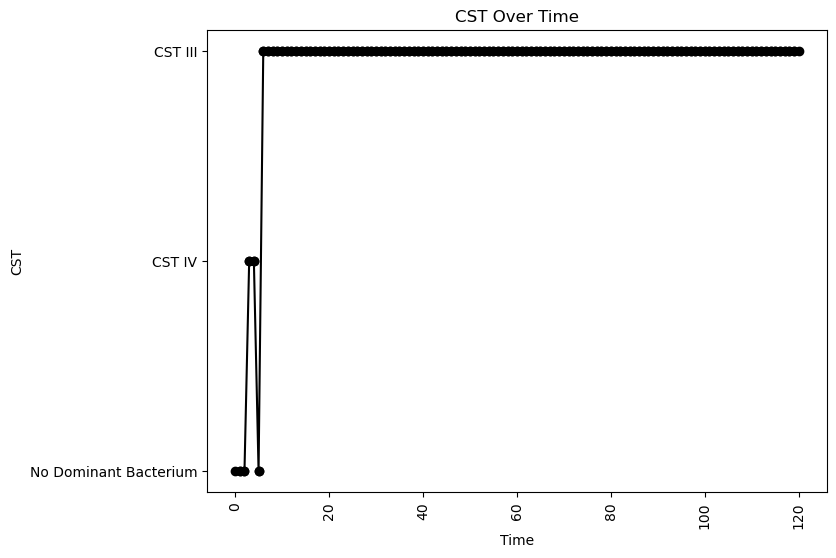


Interaction Parameters:
nAB Growth: 2.2446146183745257
Li Growth: 0.07278030322941353
oLB Growth: 0.5438660619757455
nAB Self: -0.041442831315151876
nAB->Li: 0.05306150783082353
nAB->oLB: -0.27538143323233233
Li->nAB: 0.429084612660953
Li Self: -0.09732786893413713
Li->oLB: 0.15487560570980208
oLB->nAB: -0.21058539775164836
oLB->Li: 0.06605823713195602
oLB Self: -0.09592426029857667

Simulation 7262 follows a valid CST progression:


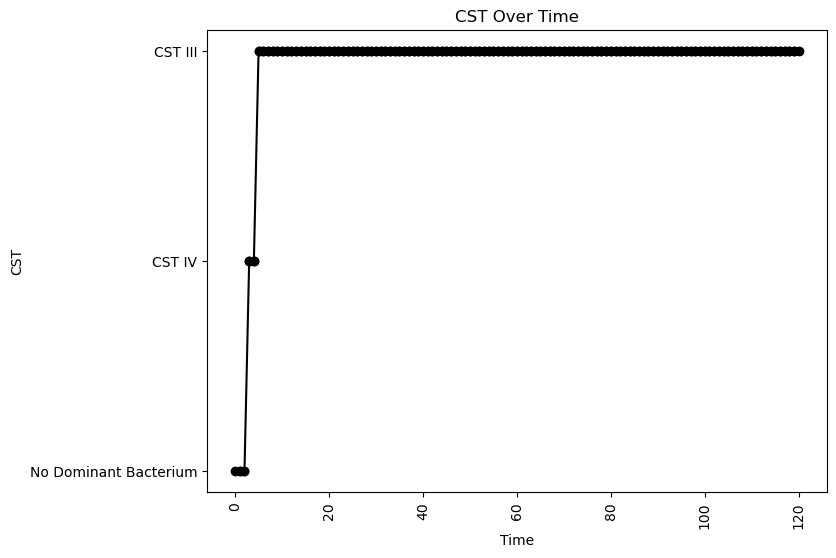


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.06967846000948563
oLB Growth: 0.7070472171500886
nAB Self: -0.06158289117146353
nAB->Li: 0.28921712416778433
nAB->oLB: -0.38503443099181495
Li->nAB: 0.4406636836243327
Li Self: -0.03943700579572347
Li->oLB: 0.04120474682226183
oLB->nAB: -0.38486906527847
oLB->Li: 0.4034512639053497
oLB Self: -0.0459048312176592

Simulation 7272 follows a valid CST progression:


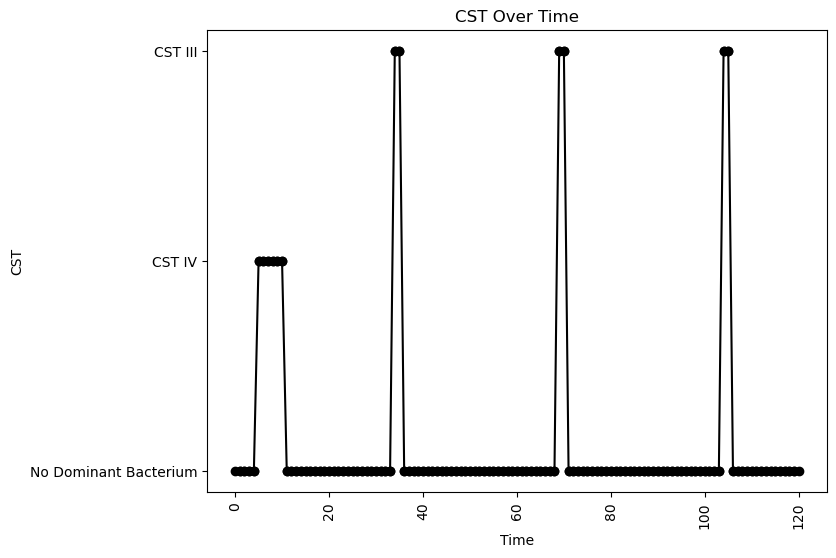


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.224988433967324
oLB Growth: 1.155917868199191
nAB Self: -0.08589813181623826
nAB->Li: -0.03875864246674349
nAB->oLB: -0.4248424030661863
Li->nAB: 0.03844919434678329
Li Self: -0.06271864433887674
Li->oLB: -0.07713355444126513
oLB->nAB: -0.3627384152524198
oLB->Li: -0.26643668509617413
oLB Self: -0.07123092174911913

Simulation 7275 follows a valid CST progression:


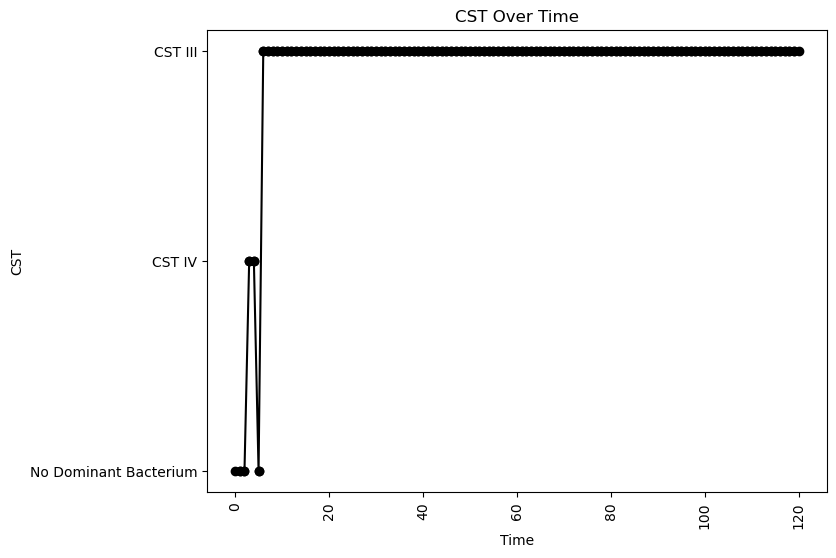


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.016577806632225772
nAB->Li: 0.020534626526183875
nAB->oLB: -0.3568662428325866
Li->nAB: 0.4662566546203015
Li Self: -0.02699849648146102
Li->oLB: -0.014431037772894617
oLB->nAB: -0.2440844139762418
oLB->Li: -0.3631328438494007
oLB Self: -0.003703186553327742

Simulation 7278 follows a valid CST progression:


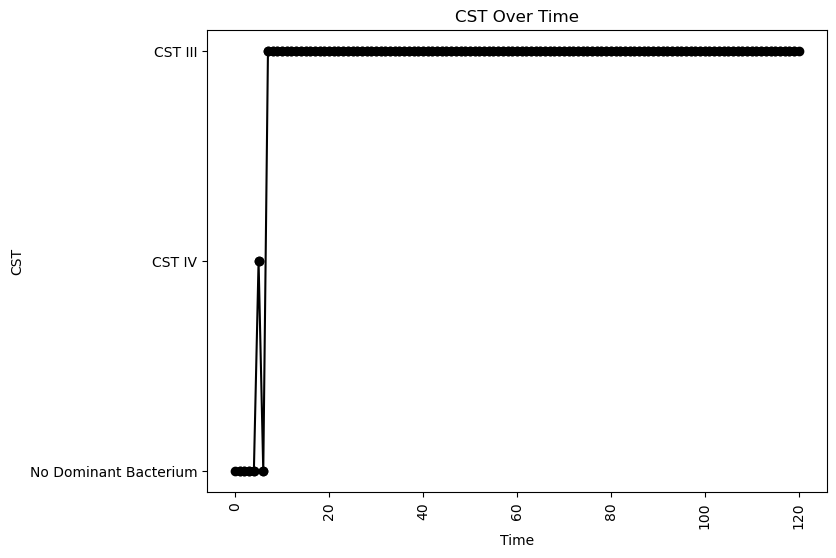


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.05300092795489431
oLB Growth: 0.058910478352813524
nAB Self: -0.07223304409217637
nAB->Li: -0.2202307574205276
nAB->oLB: -0.18097518083014785
Li->nAB: 0.21273089005267287
Li Self: -0.09244162355517226
Li->oLB: 0.37355352474190473
oLB->nAB: -0.3260199656590116
oLB->Li: 0.05599092513481363
oLB Self: -0.03392174984171442

Simulation 7321 follows a valid CST progression:


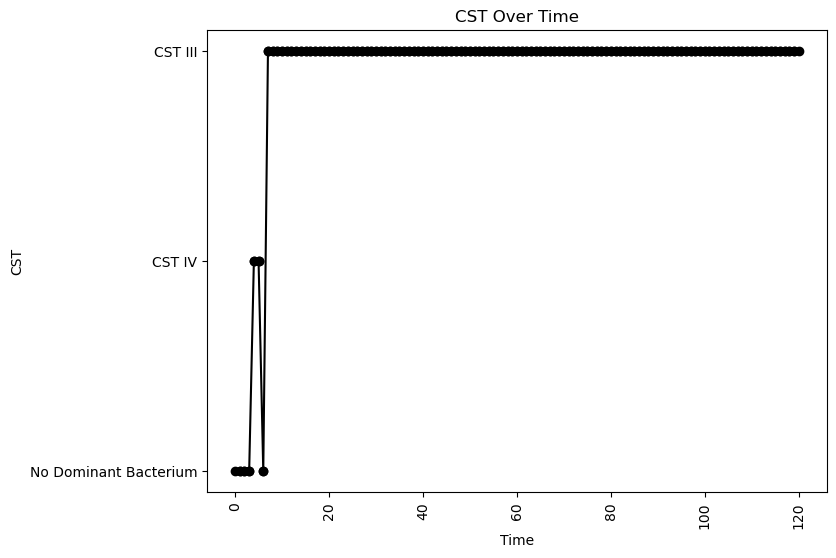


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.05546199530342664
nAB->Li: -0.19564512927474226
nAB->oLB: -0.008835965115950084
Li->nAB: 0.3359107567010784
Li Self: -0.017092911622858517
Li->oLB: -0.16578044464891734
oLB->nAB: -0.19456110369659785
oLB->Li: -0.2627923575112773
oLB Self: -0.0884593069898713

Simulation 7327 follows a valid CST progression:


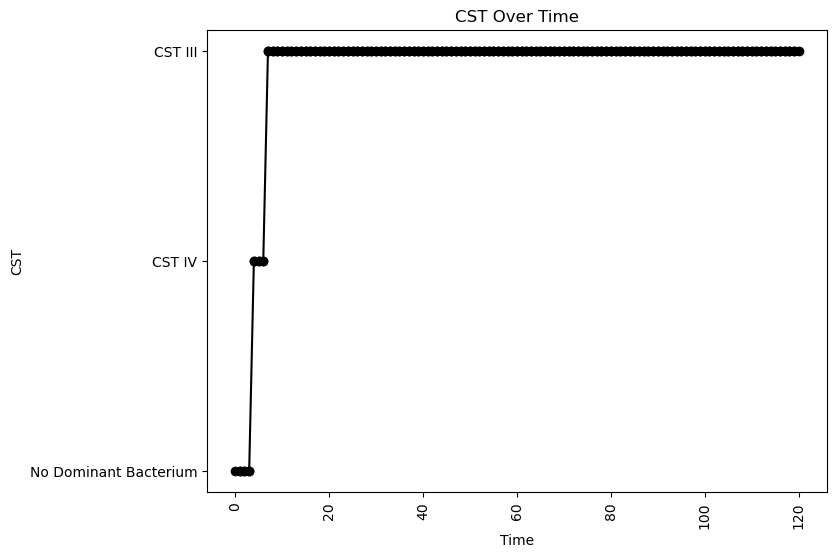


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.14298482954568273
oLB Growth: 0.5382103117959565
nAB Self: -0.00811329102989189
nAB->Li: -0.420770522744742
nAB->oLB: -0.3569306369145301
Li->nAB: 0.1273977389379931
Li Self: -0.014623668389959044
Li->oLB: -0.3344435709759682
oLB->nAB: -0.3143757334196018
oLB->Li: -0.24235007859246915
oLB Self: -0.06672466795273929

Simulation 7329 follows a valid CST progression:


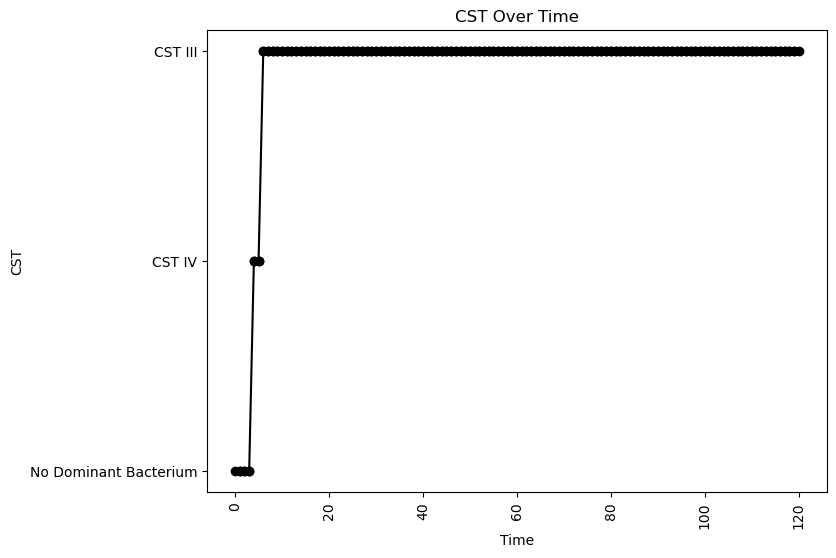


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.06806014290478743
oLB Growth: 0.20414555748463747
nAB Self: -0.025655582351749195
nAB->Li: 0.14523687238049665
nAB->oLB: -0.33339119375573034
Li->nAB: 0.418112631173152
Li Self: -0.06057951593823893
Li->oLB: 0.2707371603750055
oLB->nAB: -0.09470501733524878
oLB->Li: 0.12002612727551787
oLB Self: -0.018592481406460165

Simulation 7332 follows a valid CST progression:


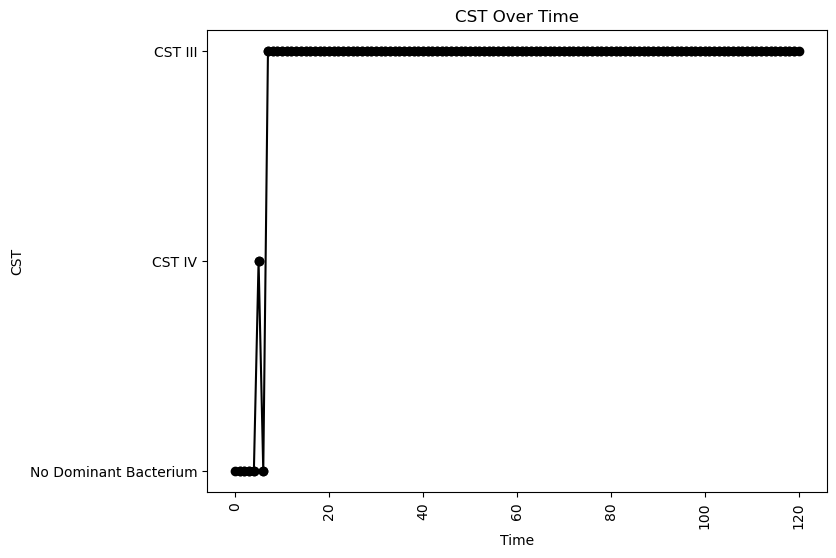


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.14253917248696496
oLB Growth: 0.7334429546888279
nAB Self: -0.02599735792498578
nAB->Li: -0.12708950619379306
nAB->oLB: -0.23299119289472686
Li->nAB: 0.1713773991996852
Li Self: -0.04664100436684716
Li->oLB: 0.45571084404927553
oLB->nAB: -0.2632482823557566
oLB->Li: -0.2836756072729372
oLB Self: -0.02707609320549617

Simulation 7336 follows a valid CST progression:


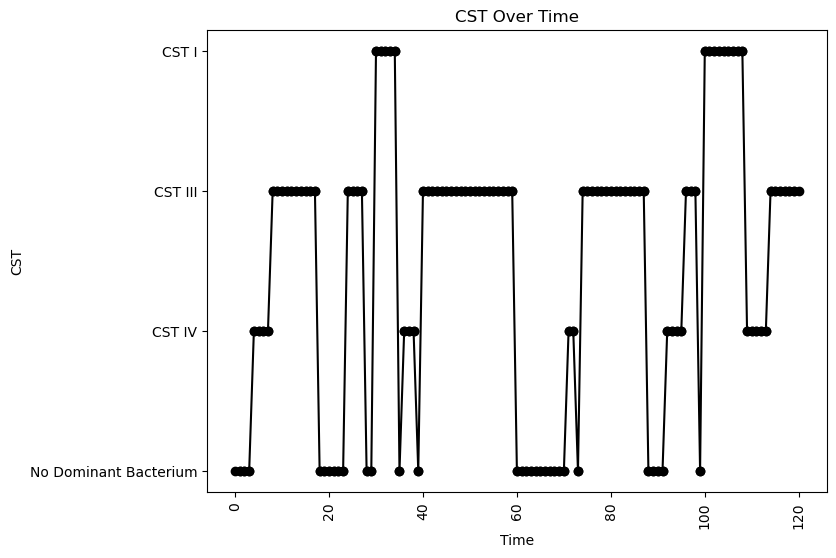


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.01952635332022873
nAB->Li: -0.4674388617152801
nAB->oLB: -0.1500681595617443
Li->nAB: 0.15340289552764064
Li Self: -0.07925010132733447
Li->oLB: -0.36936785320786975
oLB->nAB: -0.12978576825022098
oLB->Li: -0.019003117341095888
oLB Self: -0.095279902517413

Simulation 7337 follows a valid CST progression:


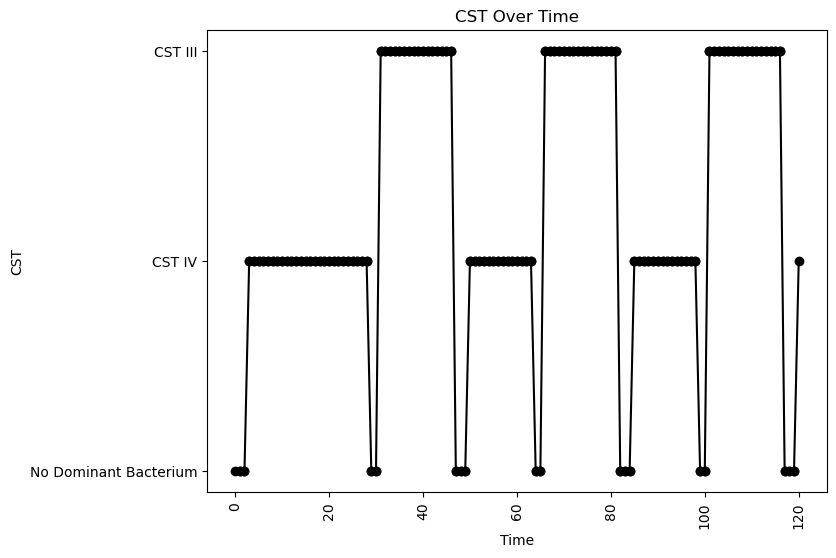


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.06760285702828515
nAB->Li: -0.2378003821257938
nAB->oLB: -0.36027488156002574
Li->nAB: 0.022360858995712052
Li Self: -0.061557302704855536
Li->oLB: -0.08669565502207371
oLB->nAB: -0.2486331254019299
oLB->Li: -0.36686009232149225
oLB Self: -0.011787485599497757

Simulation 7341 follows a valid CST progression:


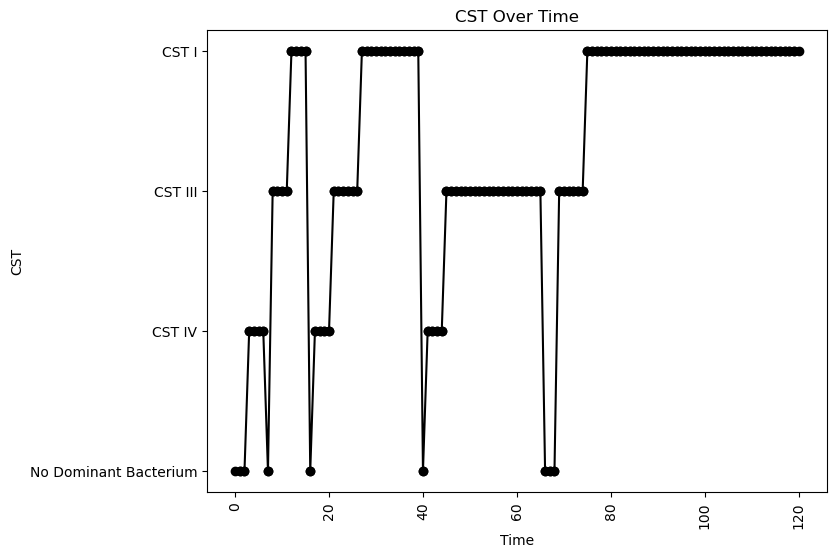


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.05739994626081137
oLB Growth: 0.11031283255203692
nAB Self: -0.00579972118496884
nAB->Li: -0.42354558613569804
nAB->oLB: -0.16546902896328658
Li->nAB: 0.1135460084398453
Li Self: -0.06941838716760175
Li->oLB: -0.3025280949394131
oLB->nAB: -0.39471881093373923
oLB->Li: 0.4606489049373106
oLB Self: -0.09889365908912413

Simulation 7344 follows a valid CST progression:


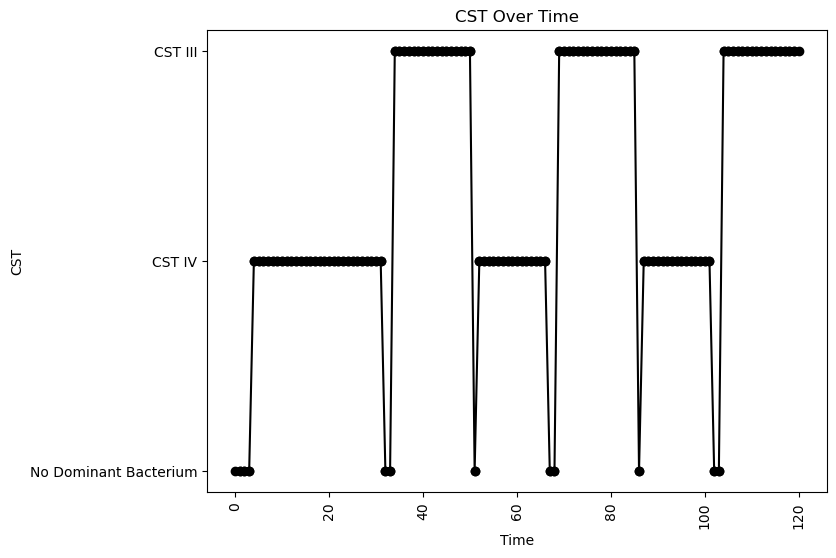


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.09477924301340813
oLB Growth: 0.595997418302585
nAB Self: -0.047313855685817745
nAB->Li: -0.3331528361124004
nAB->oLB: -0.37423228976953005
Li->nAB: 0.003917585871926255
Li Self: -0.07003452070008764
Li->oLB: 0.06765079683858954
oLB->nAB: -0.31164674682673044
oLB->Li: -0.11212844000457994
oLB Self: -0.0758950490271228

Simulation 7345 follows a valid CST progression:


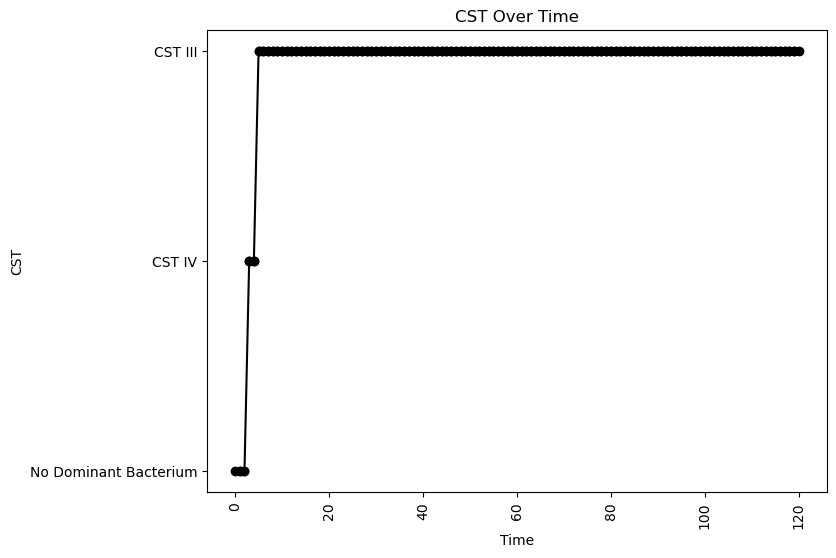


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.06881175907510548
nAB->Li: 0.3139823406595702
nAB->oLB: -0.08107481991307108
Li->nAB: 0.4933722627424857
Li Self: -0.03210729397862275
Li->oLB: -0.4235383183206055
oLB->nAB: -0.4349417708266607
oLB->Li: 0.46408450627140263
oLB Self: -0.04887188934300224

Simulation 7353 follows a valid CST progression:


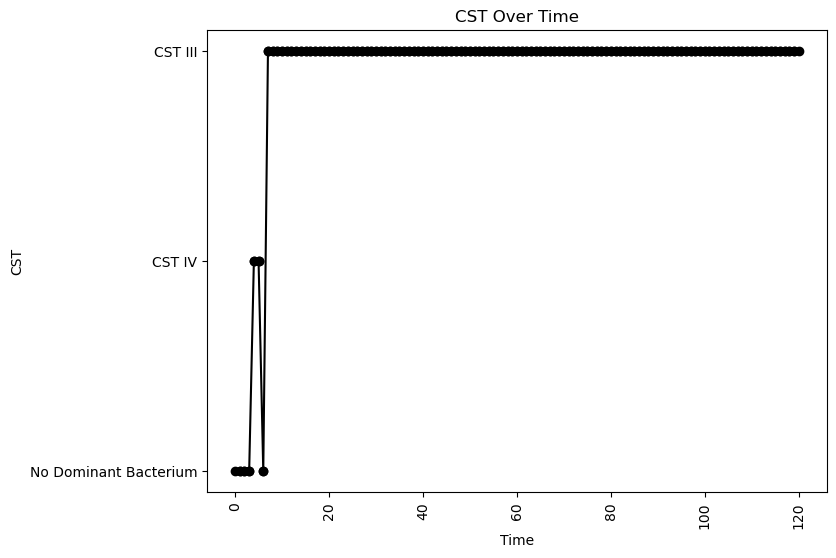


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.23623912727449226
oLB Growth: 0.1263134331844771
nAB Self: -0.04400333417751568
nAB->Li: -0.08271016393980157
nAB->oLB: -0.38638825702339236
Li->nAB: 0.07859879504993594
Li Self: -0.009327716077174808
Li->oLB: 0.36051663977173554
oLB->nAB: -0.1487171153025651
oLB->Li: 0.20295956458656428
oLB Self: -0.022647354792930396

Simulation 7370 follows a valid CST progression:


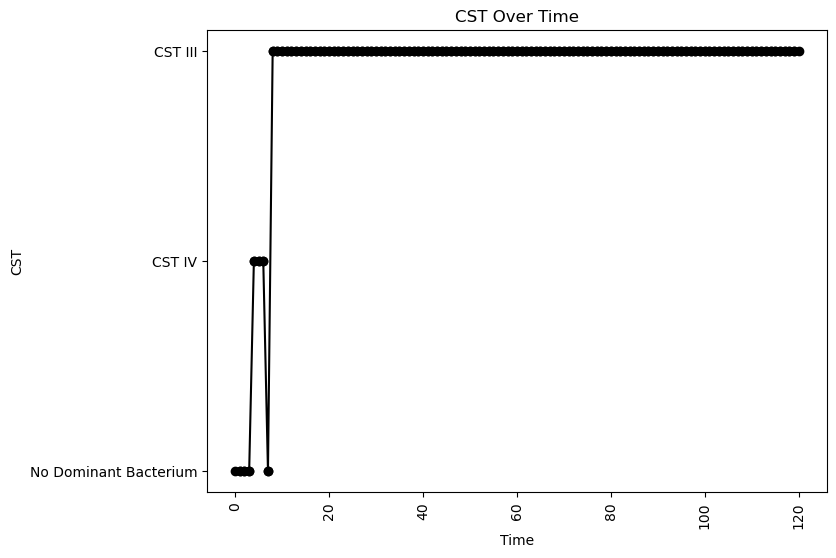


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.03837725110012093
oLB Growth: 1.155917868199191
nAB Self: -0.01579979950875382
nAB->Li: -0.3603404732257688
nAB->oLB: -0.4212454455261887
Li->nAB: 0.25292049707174613
Li Self: -0.048313687696764605
Li->oLB: 0.3046615580173362
oLB->nAB: -0.030064936402335707
oLB->Li: -0.3526147920355346
oLB Self: -0.0853454476000491

Simulation 7376 follows a valid CST progression:


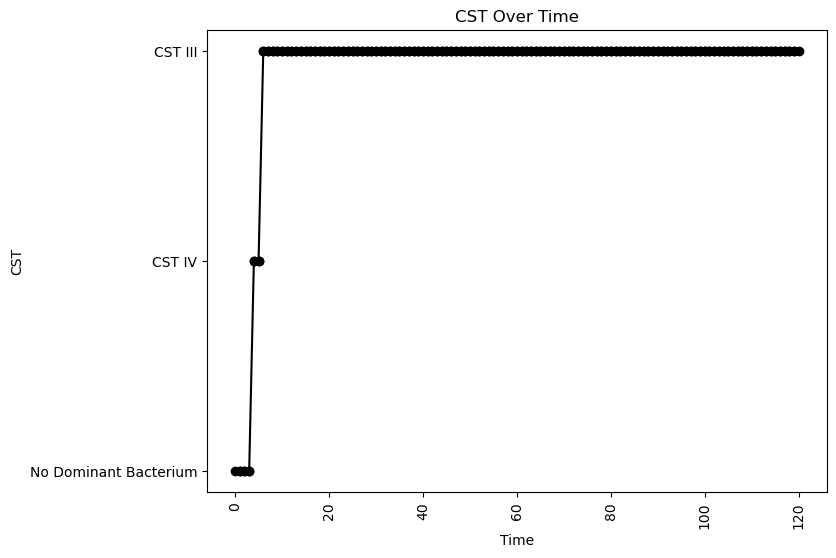


Interaction Parameters:
nAB Growth: 2.273308423784788
Li Growth: 0.06939466945066827
oLB Growth: 0.4879467602516997
nAB Self: -0.012823813329585154
nAB->Li: -0.49485726460486273
nAB->oLB: -0.45994736190997587
Li->nAB: 0.41321874650158763
Li Self: -0.03767247617265521
Li->oLB: 0.21305953227646202
oLB->nAB: -0.36287402573591043
oLB->Li: -0.16080331214528115
oLB Self: -0.017888361839261666

Simulation 7381 follows a valid CST progression:


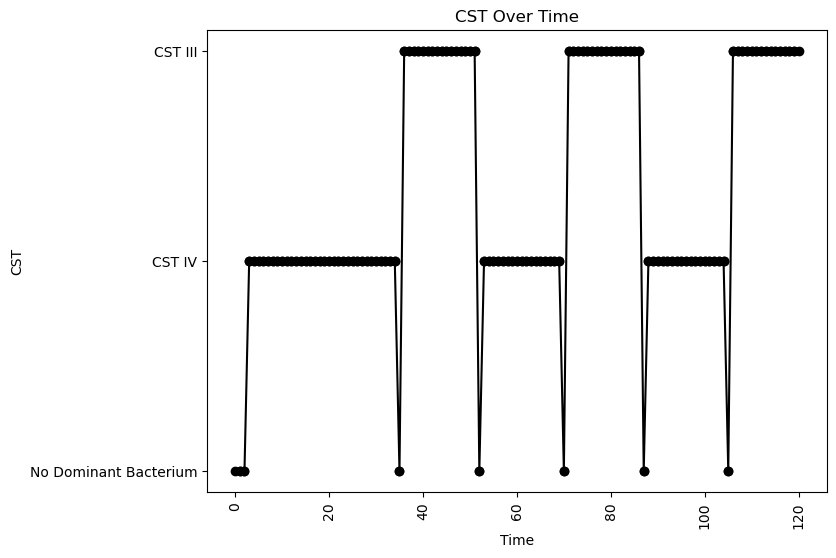


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.008166567915626852
nAB->Li: -0.40912063434825663
nAB->oLB: -0.38417775025956225
Li->nAB: 0.0028288585171227787
Li Self: -0.07256670703462913
Li->oLB: -0.48710197013165873
oLB->nAB: -0.012097195499245816
oLB->Li: -0.30689810201317025
oLB Self: -0.019933395216695335

Simulation 7382 follows a valid CST progression:


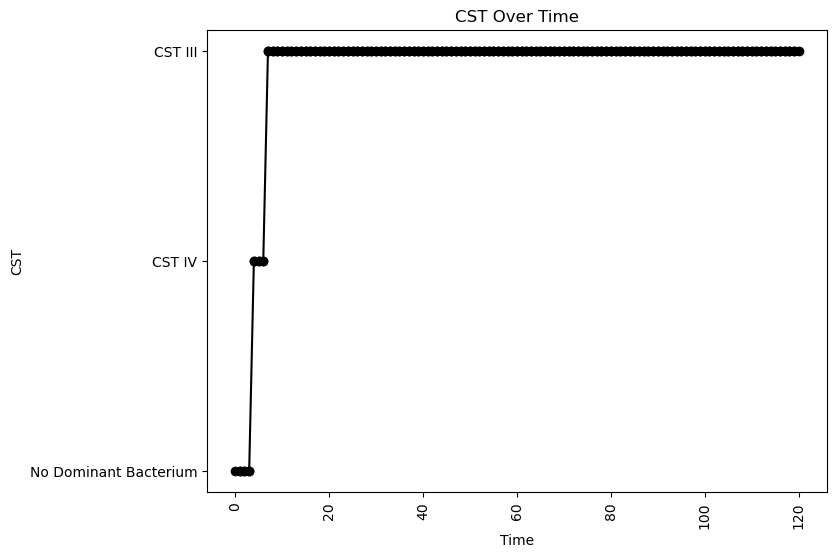


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.02253370502233777
nAB->Li: -0.17022131521255973
nAB->oLB: -0.359342091334785
Li->nAB: 0.4208110962985061
Li Self: -0.09462011190924477
Li->oLB: -0.4731722680830154
oLB->nAB: -0.2726713995875616
oLB->Li: -0.312023643200541
oLB Self: -0.04597705684895647

Simulation 7386 follows a valid CST progression:


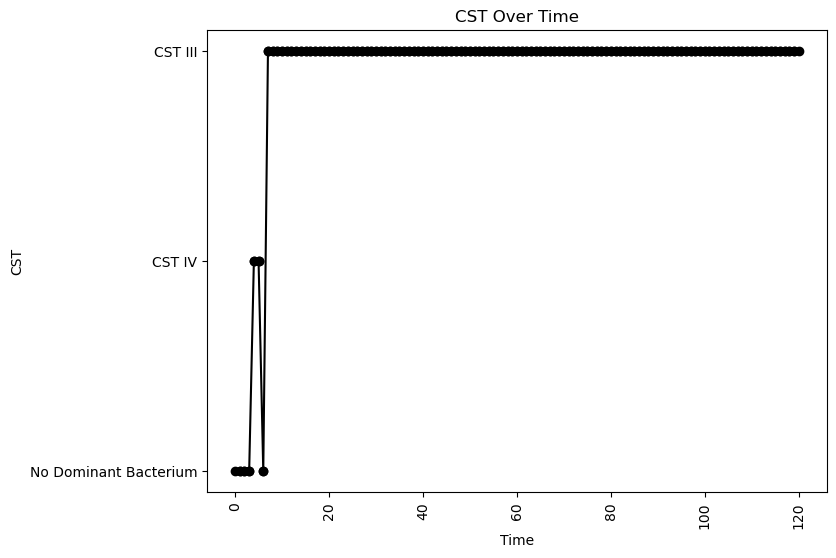


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.03287847568848078
nAB->Li: -0.2965829103394221
nAB->oLB: -0.055885806045878894
Li->nAB: 0.2219256141588577
Li Self: -0.006627740829341908
Li->oLB: -0.38452631641426704
oLB->nAB: -0.2023073656600094
oLB->Li: -0.43425891399032
oLB Self: -0.028999219733494605

Simulation 7391 follows a valid CST progression:


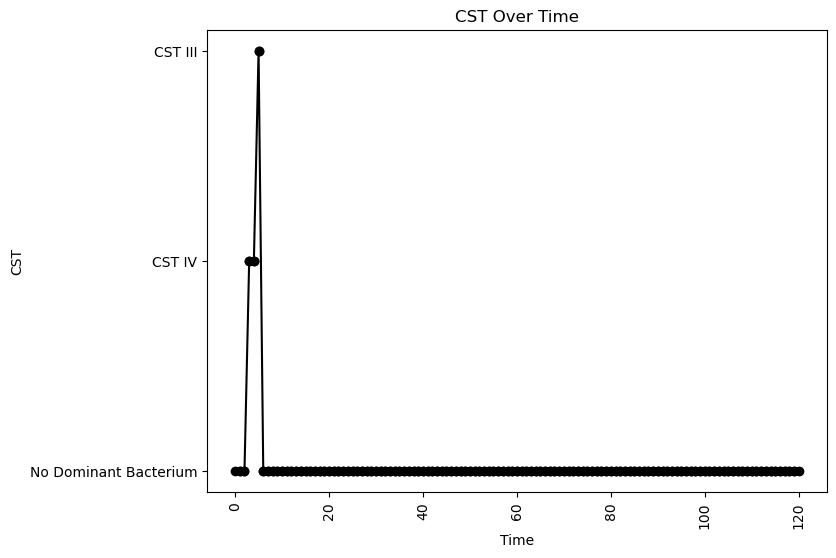


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.06540655646644605
nAB->Li: 0.2700307437977155
nAB->oLB: -0.07118369994864554
Li->nAB: 0.4608661084606863
Li Self: -0.0328421627499422
Li->oLB: -0.3254897076029233
oLB->nAB: -0.2538372576243131
oLB->Li: 0.44345460229190536
oLB Self: -0.07424934868815905

Simulation 7397 follows a valid CST progression:


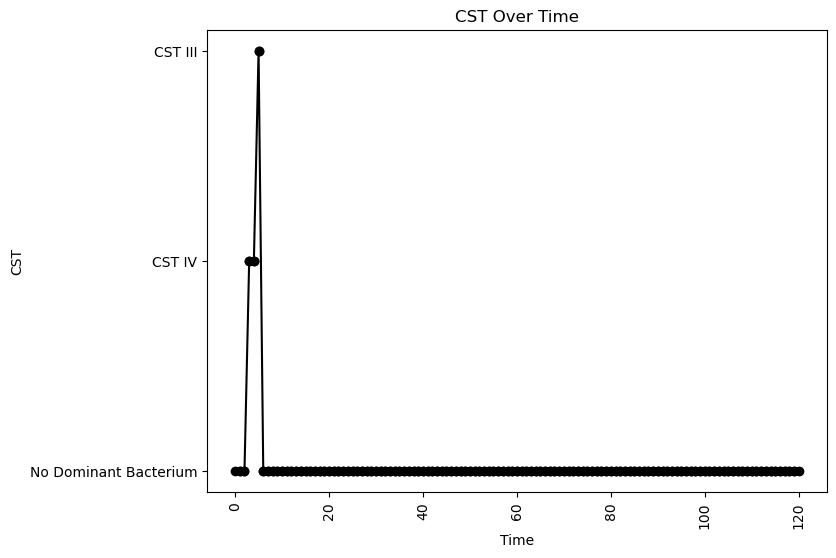


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.050152177963664675
nAB->Li: 0.02953271100664645
nAB->oLB: -0.008556820180465885
Li->nAB: 0.44337734013934404
Li Self: -0.09838226625523114
Li->oLB: 0.36758085217700975
oLB->nAB: -0.03853658669050586
oLB->Li: 0.3348561677046117
oLB Self: -0.022820485602322277

Simulation 7406 follows a valid CST progression:


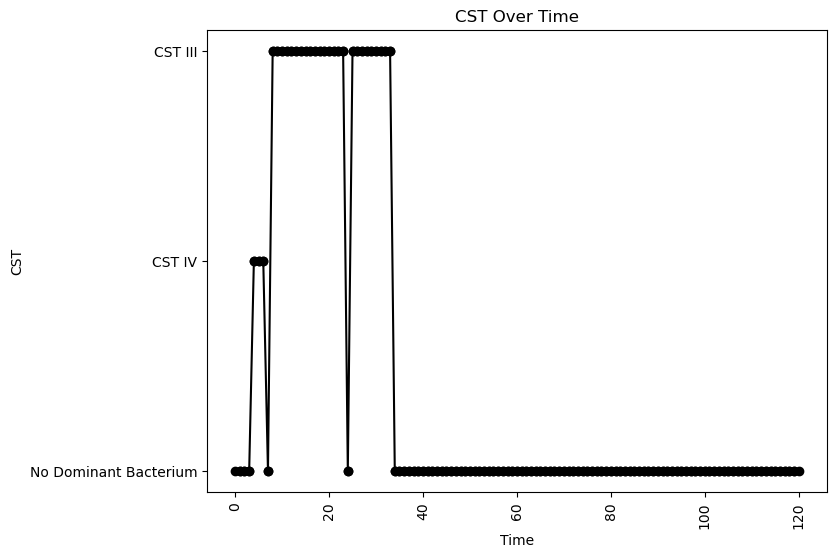


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.12850033168617864
oLB Growth: 0.8534408763679777
nAB Self: -0.0014559941374818058
nAB->Li: -0.18308671234859958
nAB->oLB: -0.22675177428958665
Li->nAB: 0.06904712379123124
Li Self: -0.033646519091956234
Li->oLB: 0.09455550462402507
oLB->nAB: -0.4257945907333077
oLB->Li: 0.0955851778435367
oLB Self: -0.0371841724672132

Simulation 7418 follows a valid CST progression:


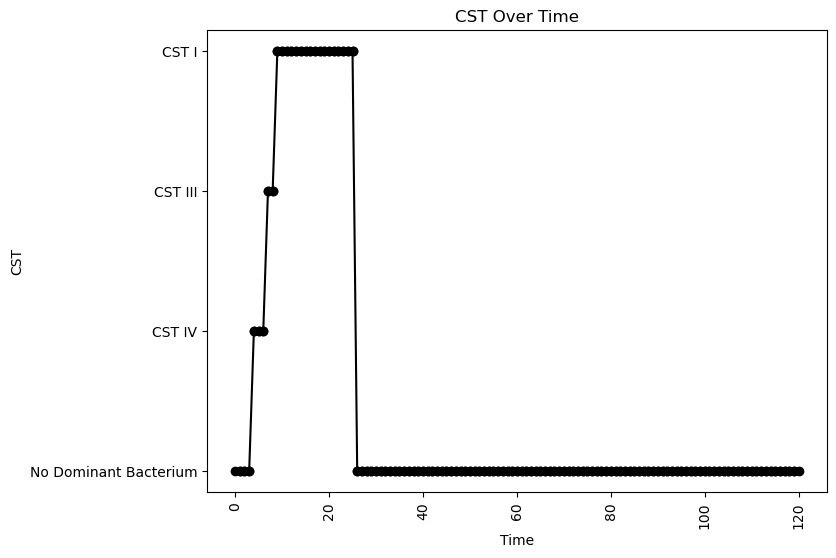


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.08558754460980605
nAB->Li: -0.475234670875934
nAB->oLB: -0.14967292940262744
Li->nAB: 0.26845766102980506
Li Self: -0.02466258074865127
Li->oLB: 0.2502528132079318
oLB->nAB: -0.35403269409386334
oLB->Li: 0.490002420629163
oLB Self: -0.017132804322262718

Simulation 7422 follows a valid CST progression:


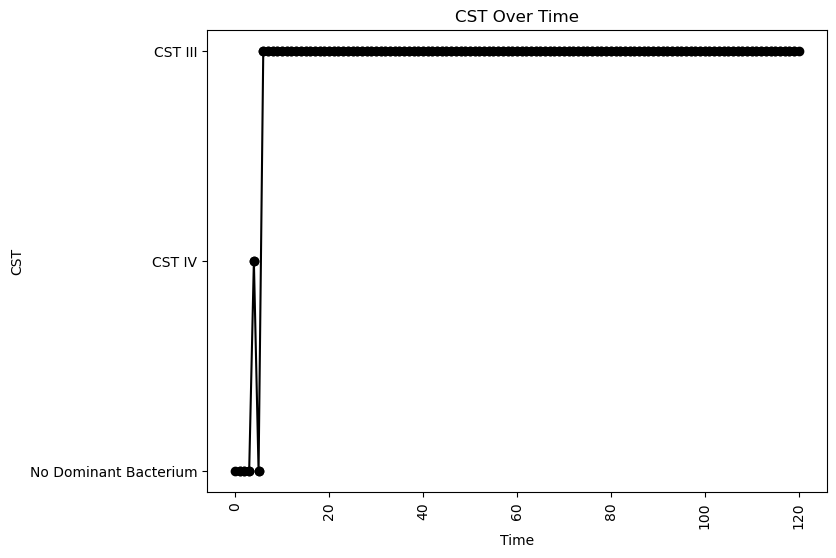


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.020164031530751955
nAB->Li: 0.23078563340790303
nAB->oLB: -0.49326305835191453
Li->nAB: 0.4903573975330875
Li Self: -0.09136910219636558
Li->oLB: 0.19808765987241472
oLB->nAB: -0.2628099772666107
oLB->Li: -0.32458468766156756
oLB Self: -0.07438528925011799

Simulation 7427 follows a valid CST progression:


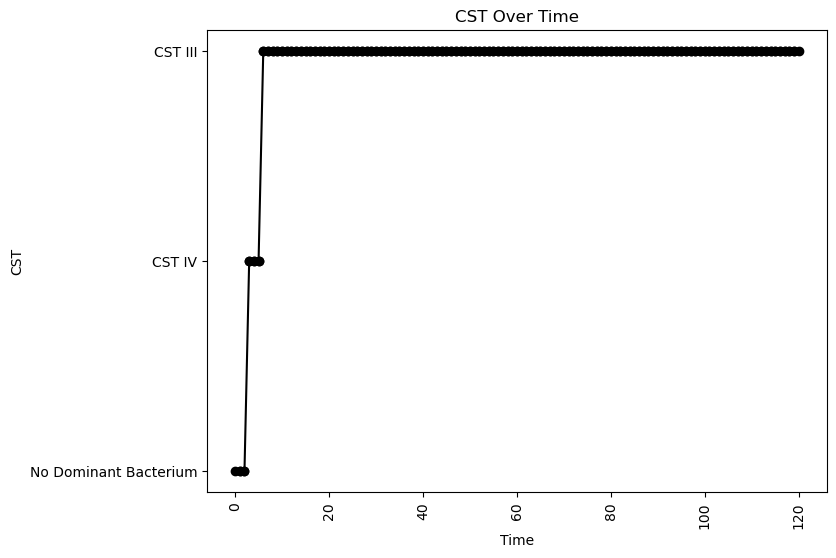


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.03837725110012093
oLB Growth: 1.155917868199191
nAB Self: -0.09346394594903196
nAB->Li: -0.3564387825113758
nAB->oLB: -0.1003488235999756
Li->nAB: 0.387837869642193
Li Self: -0.053130002128557424
Li->oLB: 0.030946290653840247
oLB->nAB: -0.4019757350525517
oLB->Li: -0.32591929389480667
oLB Self: -0.031640642305429845

Simulation 7431 follows a valid CST progression:


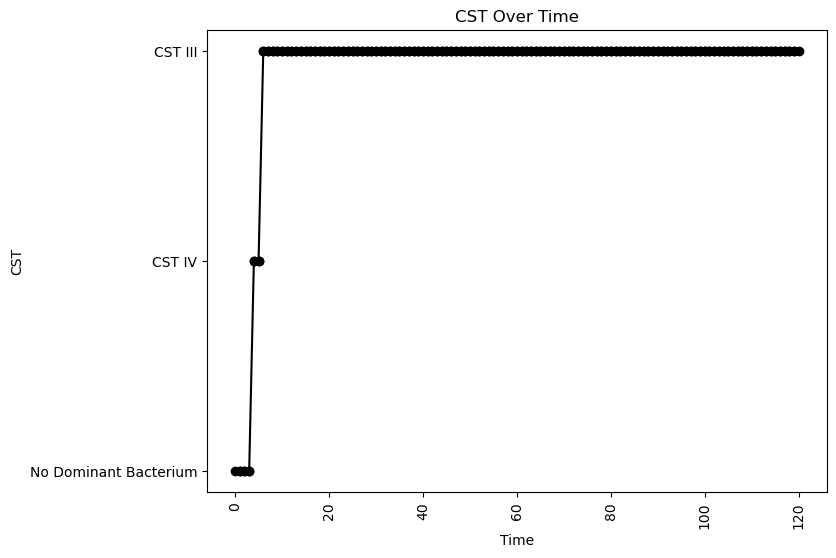


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.1351276930508646
oLB Growth: 1.155917868199191
nAB Self: -0.05887577753031066
nAB->Li: -0.19188398644049864
nAB->oLB: -0.24461142246450912
Li->nAB: 0.3397554736126527
Li Self: -0.07935256228375714
Li->oLB: -0.4611222186764354
oLB->nAB: -0.37596819289902844
oLB->Li: -0.06362621669170199
oLB Self: -0.024301951114110668

Simulation 7432 follows a valid CST progression:


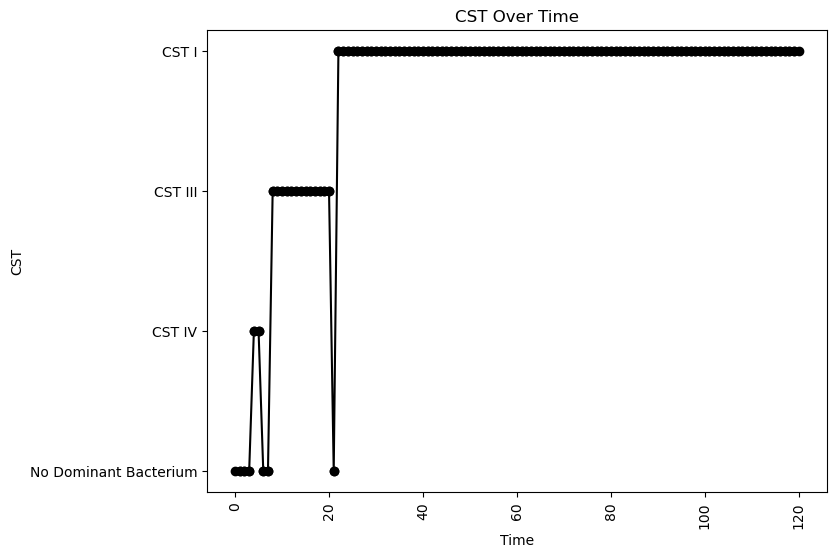


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.09213589787873776
nAB->Li: -0.3022635986223178
nAB->oLB: -0.2872292077040064
Li->nAB: 0.30262009062219297
Li Self: -0.04394371032504955
Li->oLB: -0.22019737069613743
oLB->nAB: -0.45150621785318285
oLB->Li: 0.06936121961316388
oLB Self: -0.013980029825812701

Simulation 7437 follows a valid CST progression:


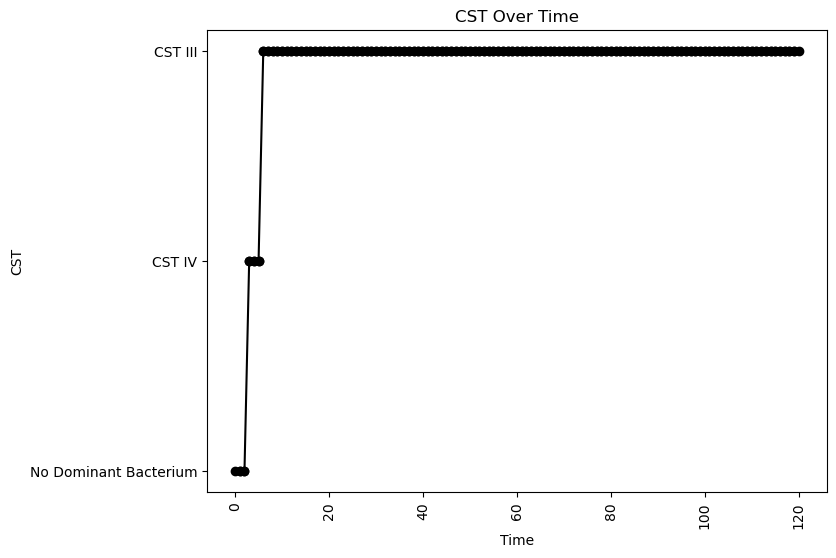


Interaction Parameters:
nAB Growth: 2.286323001067126
Li Growth: 0.060377934648291574
oLB Growth: 0.14091260068383374
nAB Self: -0.011291484642242694
nAB->Li: 0.21888327526297147
nAB->oLB: -0.23980423196979828
Li->nAB: 0.39388894364349547
Li Self: -0.0338097703046126
Li->oLB: -0.4693540174283529
oLB->nAB: -0.41145764691210457
oLB->Li: 0.21838101565871326
oLB Self: -0.08296217489663435

Simulation 7439 follows a valid CST progression:


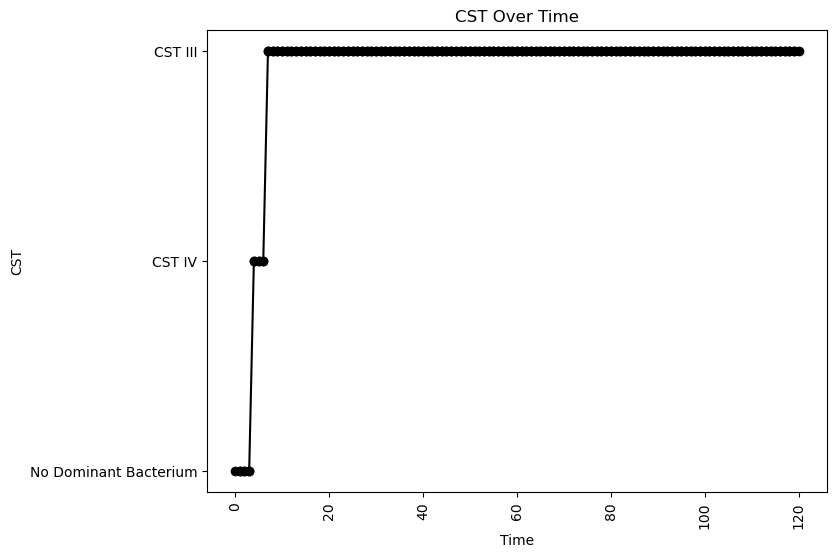


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.09304143465656503
nAB->Li: -0.13162849142984812
nAB->oLB: -0.09095416626477004
Li->nAB: 0.27207984912246463
Li Self: -0.0439812530724246
Li->oLB: -0.27249527246288024
oLB->nAB: -0.11956874541887891
oLB->Li: -0.30739963620707417
oLB Self: -0.04838259660153879

Simulation 7440 follows a valid CST progression:


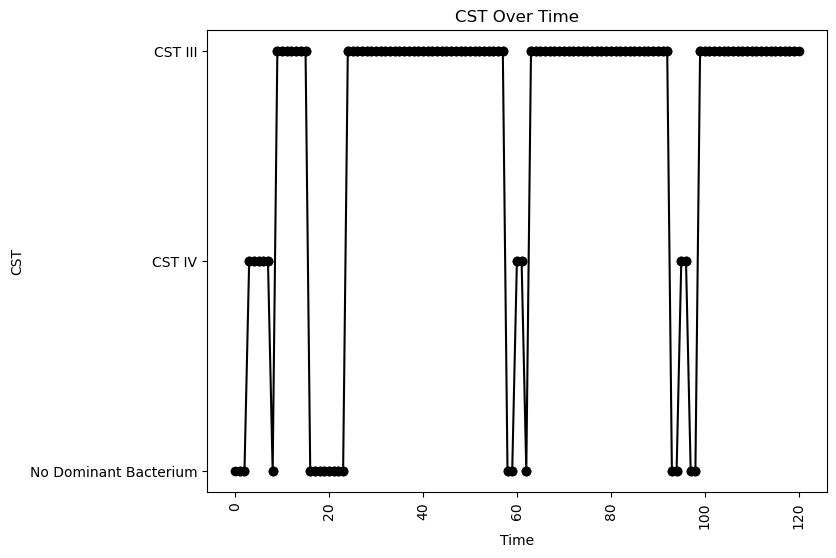


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.0618046977369984
nAB->Li: -0.4556231103610874
nAB->oLB: -0.1926753695933941
Li->nAB: 0.10901628508188455
Li Self: -0.08774758527897128
Li->oLB: -0.24494846648618934
oLB->nAB: -0.3717581518934398
oLB->Li: -0.2851792762854093
oLB Self: -0.07773155301978832

Simulation 7443 follows a valid CST progression:


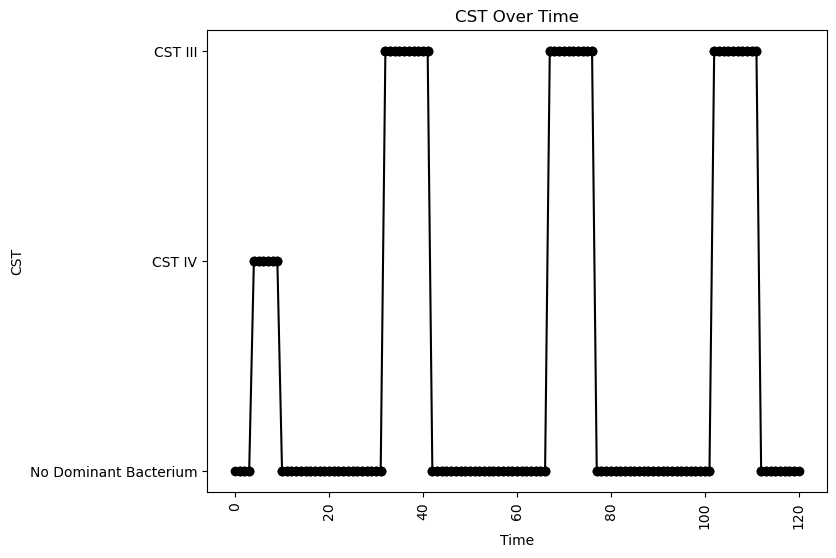


Interaction Parameters:
nAB Growth: 2.284416841880324
Li Growth: 0.3017826567269846
oLB Growth: 0.35838896078112936
nAB Self: -0.0771652459778281
nAB->Li: -0.06423599887201403
nAB->oLB: -0.19805754104182094
Li->nAB: 0.030518119348666217
Li Self: -0.05347066644782228
Li->oLB: -0.16720999671543263
oLB->nAB: -0.3490488738204135
oLB->Li: -0.040132197216149024
oLB Self: -0.03313969680528664

Simulation 7444 follows a valid CST progression:


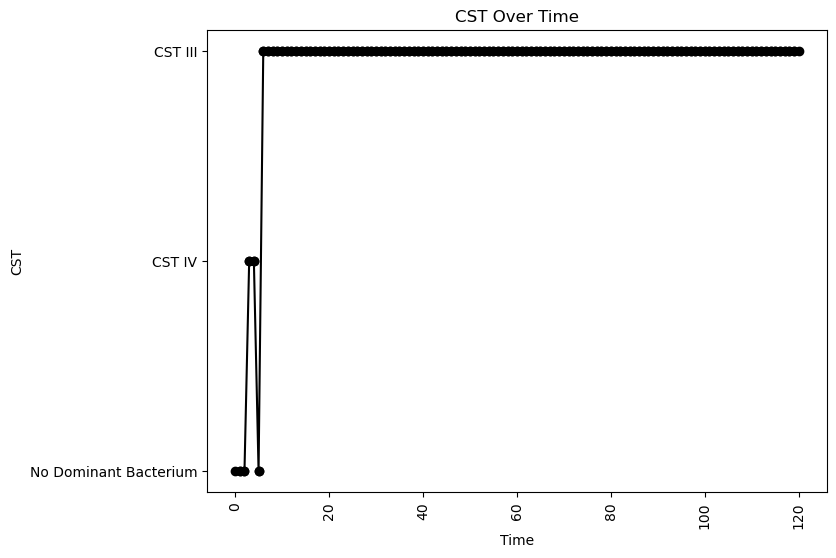


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.0976233037994605
nAB->Li: -0.036952472404636005
nAB->oLB: -0.3927912789658145
Li->nAB: 0.3350150852885472
Li Self: -0.0466793475984517
Li->oLB: 0.30004361956880576
oLB->nAB: -0.11268833829220376
oLB->Li: -0.04600597654985794
oLB Self: -0.07009665630663582

Simulation 7445 follows a valid CST progression:


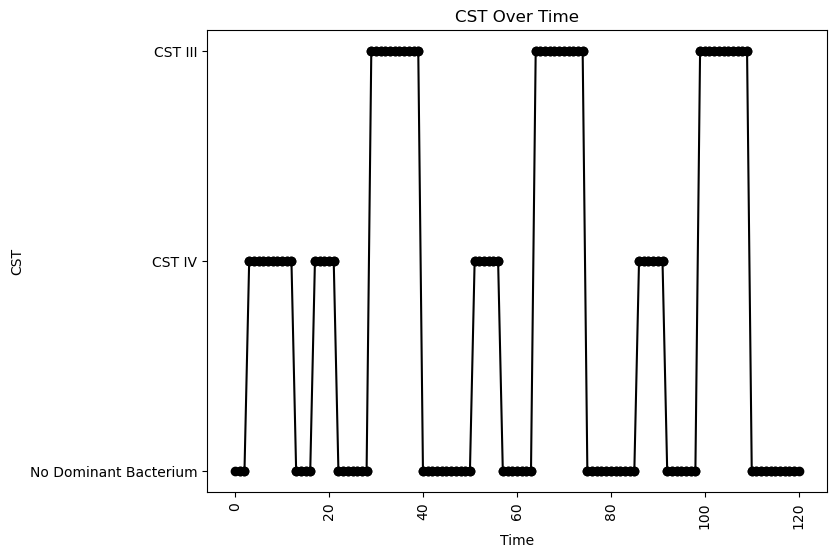


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.025796493798146497
nAB->Li: -0.09607924289963915
nAB->oLB: -0.31720085435227896
Li->nAB: 0.02619251460439964
Li Self: -0.04384985477676287
Li->oLB: 0.018925648155113772
oLB->nAB: -0.2086641374337323
oLB->Li: -0.060409308681657614
oLB Self: -0.037909309373355786

Simulation 7448 follows a valid CST progression:


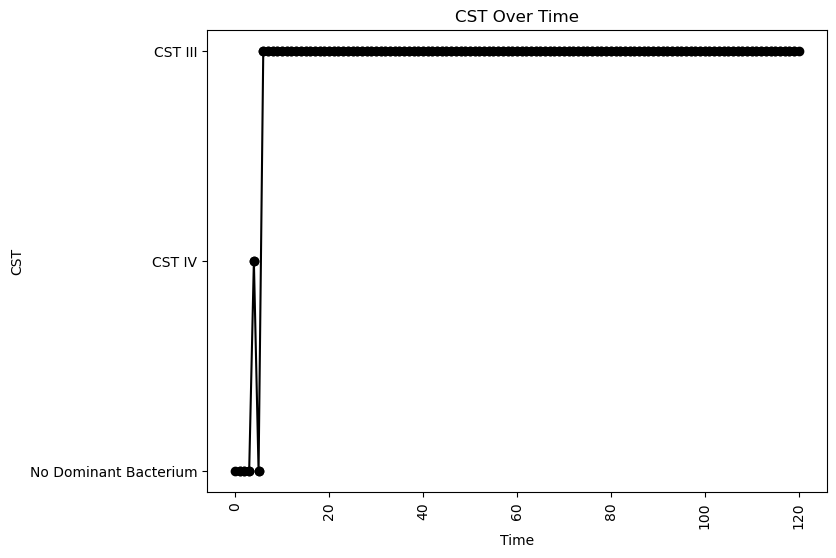


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.06309763455319839
oLB Growth: 0.9128027925042091
nAB Self: -0.04621515740140708
nAB->Li: 0.08299927485513947
nAB->oLB: -0.11854814410637027
Li->nAB: 0.4022203958969941
Li Self: -0.03802861572053944
Li->oLB: 0.48451579491785535
oLB->nAB: -0.4560291920574904
oLB->Li: -0.31315959950750816
oLB Self: -0.05508415597949137

Simulation 7452 follows a valid CST progression:


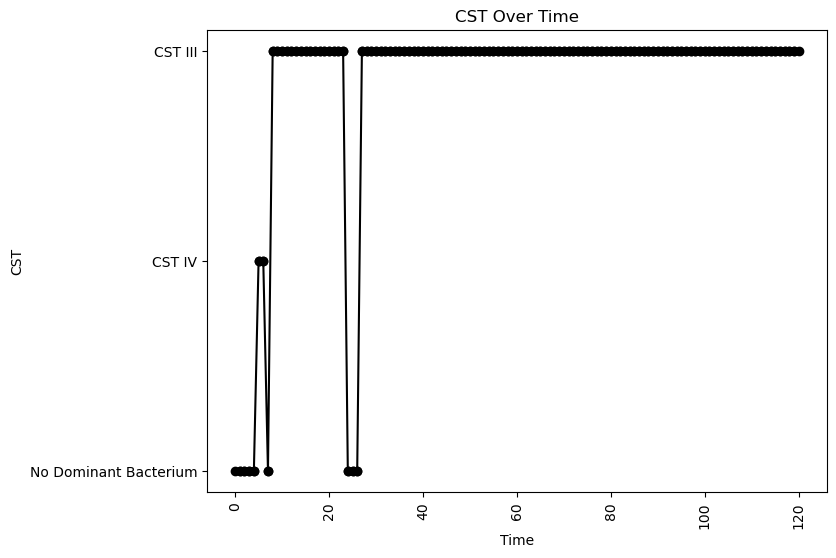


Interaction Parameters:
nAB Growth: 2.273308423784788
Li Growth: 0.06939466945066827
oLB Growth: 0.4879467602516997
nAB Self: -0.06665057212303327
nAB->Li: -0.46237363200019665
nAB->oLB: -0.465966568348494
Li->nAB: 0.4919703285743363
Li Self: -0.0960185191944653
Li->oLB: 0.23618433495432367
oLB->nAB: -0.4238651466716148
oLB->Li: 0.048212290601791996
oLB Self: -0.025348786478329097

Simulation 7461 follows a valid CST progression:


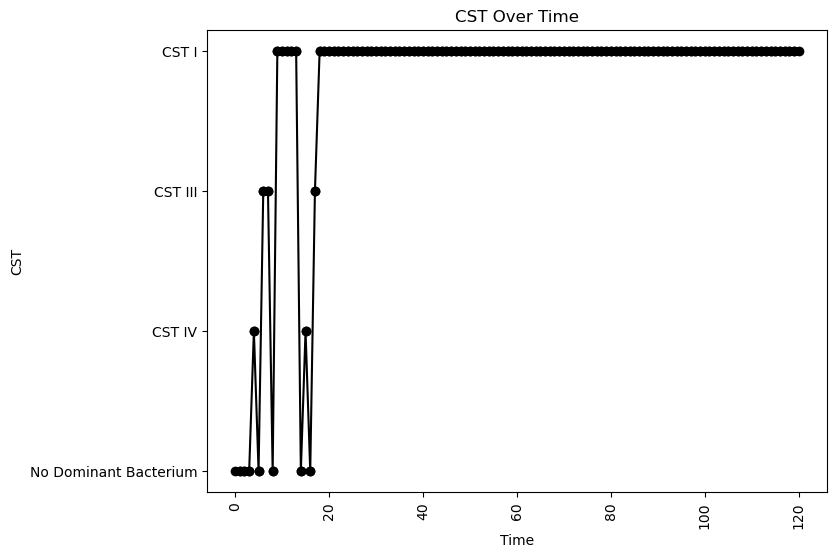


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.1546945479432433
oLB Growth: 0.3756702562538966
nAB Self: -0.009419296805698946
nAB->Li: -0.227234708003216
nAB->oLB: -0.12587958702447127
Li->nAB: 0.30858454490279164
Li Self: -0.0724155292668173
Li->oLB: -0.16210605906483228
oLB->nAB: -0.19042830154133444
oLB->Li: 0.20641756640881181
oLB Self: -0.03441450666966507

Simulation 7462 follows a valid CST progression:


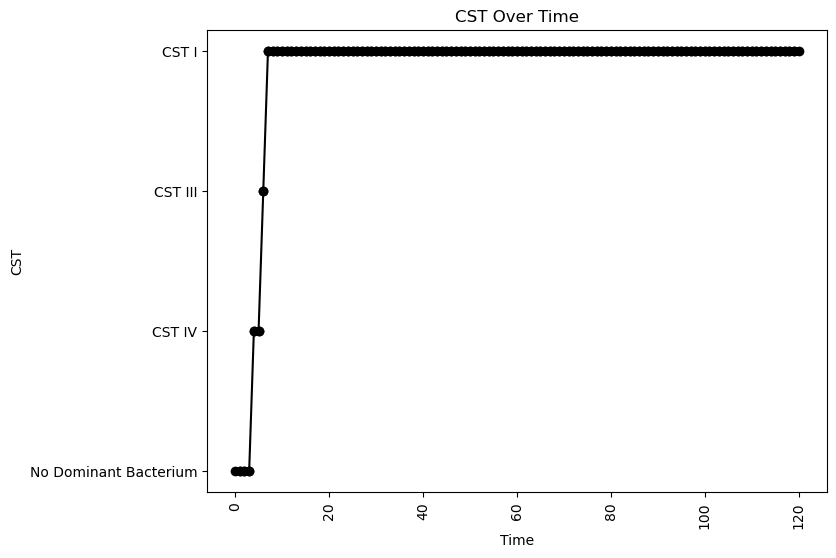


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.05072073600009906
oLB Growth: 1.0858755226067296
nAB Self: -0.09863081201789277
nAB->Li: -0.05305233138911725
nAB->oLB: -0.29126142395778376
Li->nAB: 0.34036268278533477
Li Self: -0.009281468637545254
Li->oLB: 0.17324429867163005
oLB->nAB: -0.17394176610259915
oLB->Li: 0.4678999025257481
oLB Self: -0.05536256438130646

Simulation 7465 follows a valid CST progression:


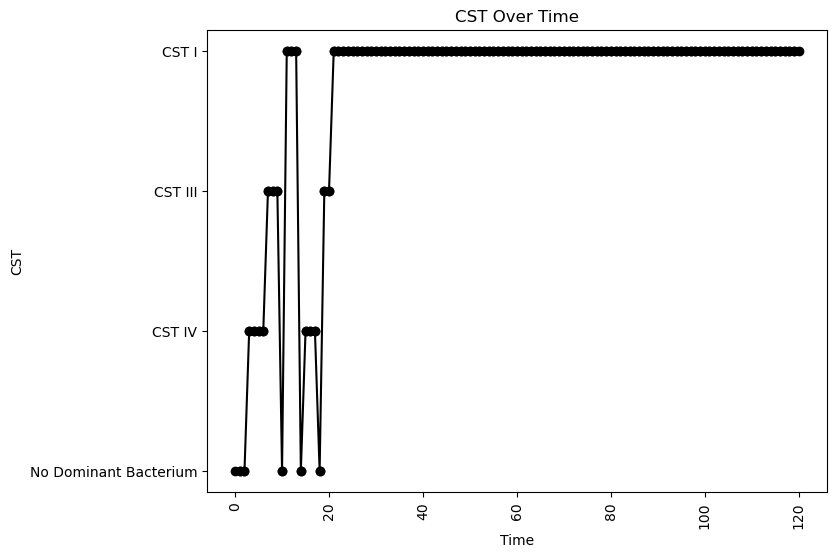


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.0018616511695131732
nAB->Li: -0.3186528645800454
nAB->oLB: -0.24760174596691997
Li->nAB: 0.15516706604918828
Li Self: -0.09131192195628779
Li->oLB: -0.30566540052128444
oLB->nAB: -0.23182519575467658
oLB->Li: 0.39095755999582127
oLB Self: -0.013440673816235635

Simulation 7467 follows a valid CST progression:


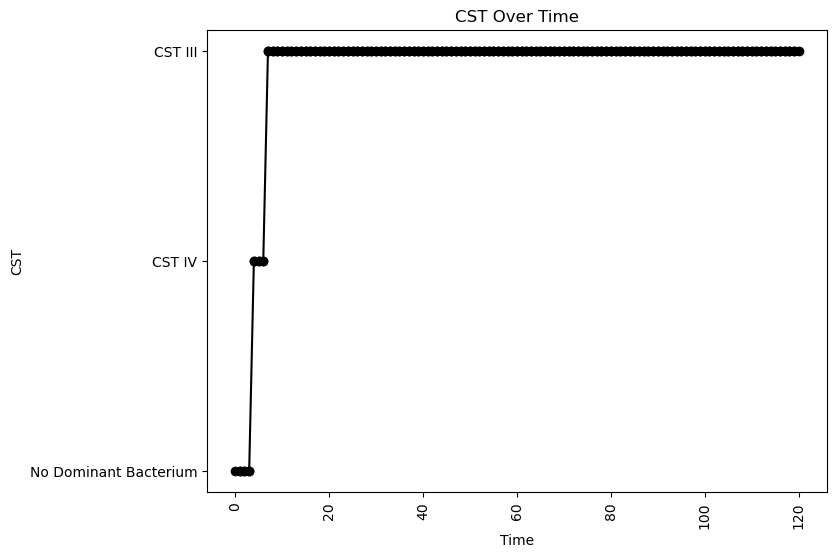


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.09672409098714471
nAB->Li: 0.16573353055106965
nAB->oLB: -0.0030712759760437303
Li->nAB: 0.3122269052695762
Li Self: -0.0848446461344103
Li->oLB: -0.2147601057224206
oLB->nAB: -0.2501936393678099
oLB->Li: -0.2324513219841799
oLB Self: -0.08698916722200159

Simulation 7475 follows a valid CST progression:


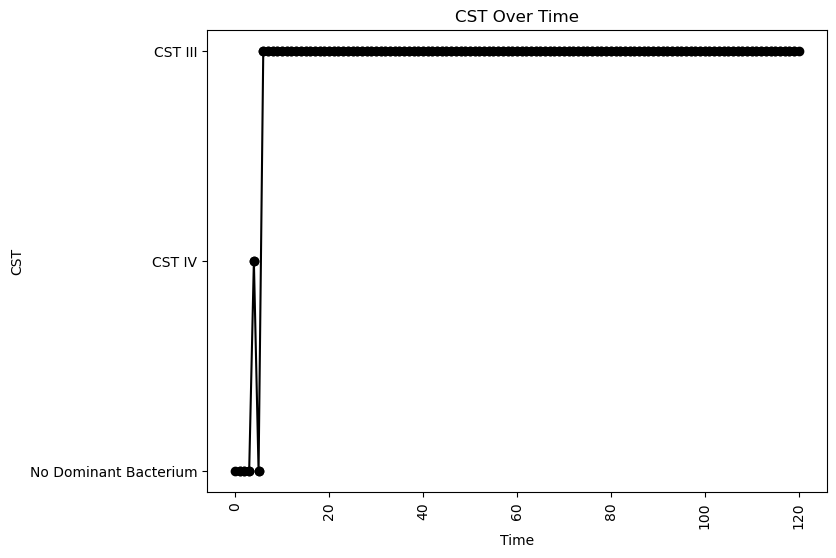


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.0717722903232817
nAB->Li: 0.13979063061534824
nAB->oLB: -0.40348409538556274
Li->nAB: 0.4303706851225291
Li Self: -0.046397012758453975
Li->oLB: 0.3799963376659665
oLB->nAB: -0.21983233141051867
oLB->Li: -0.4045289469190382
oLB Self: -0.01895120701987632

Simulation 7498 follows a valid CST progression:


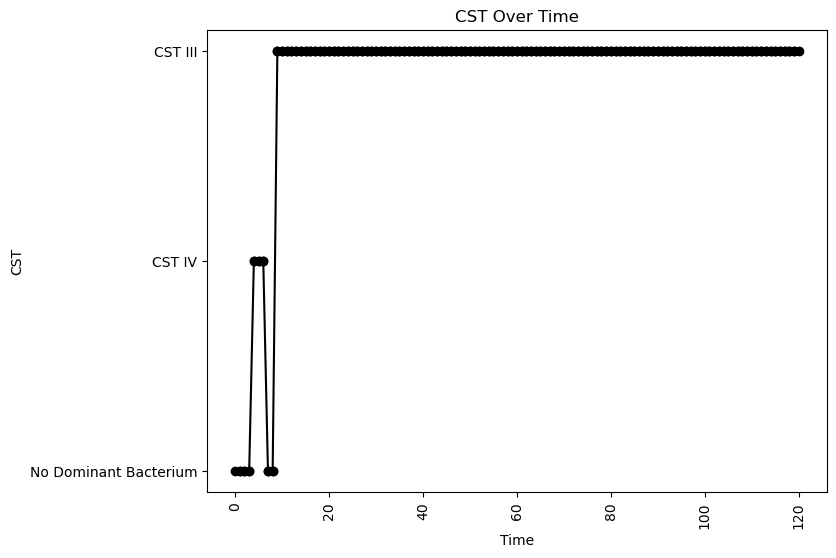


Interaction Parameters:
nAB Growth: 2.2002663828262317
Li Growth: 0.25798694417258494
oLB Growth: 0.7629459891785437
nAB Self: -0.05879521164532198
nAB->Li: -0.11618782487035217
nAB->oLB: -0.165196684846175
Li->nAB: 0.10219321706679141
Li Self: -0.06888604158672204
Li->oLB: -0.35072056217606107
oLB->nAB: -0.19991766573131053
oLB->Li: -0.19030121100506092
oLB Self: -0.08611406685960726

Simulation 7499 follows a valid CST progression:


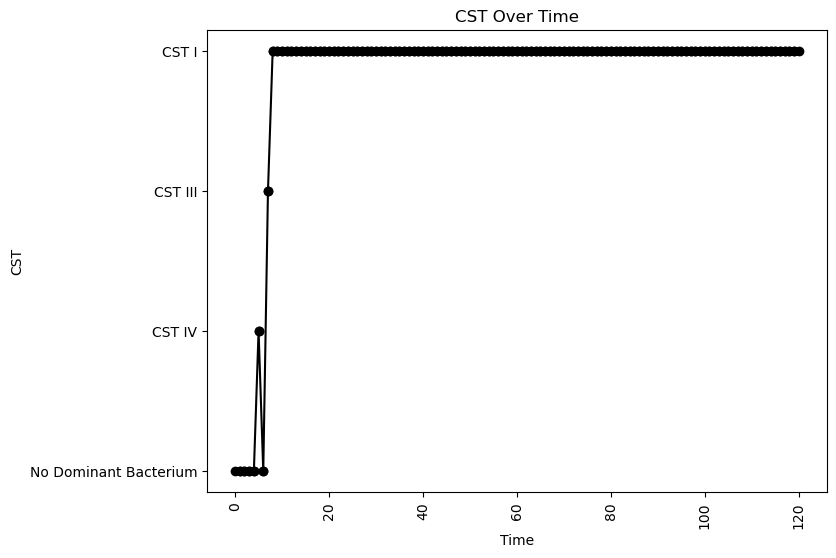


Interaction Parameters:
nAB Growth: 2.1964345031105657
Li Growth: 0.04025066595693835
oLB Growth: 1.2138354993931422
nAB Self: -0.04186350066840531
nAB->Li: -0.10424841160936643
nAB->oLB: -0.47886292645500333
Li->nAB: 0.47900955727404104
Li Self: -0.05544667861289259
Li->oLB: -0.048839453554269496
oLB->nAB: -0.14383582207603884
oLB->Li: 0.3894030892924777
oLB Self: -0.009606047296830345

Simulation 7500 follows a valid CST progression:


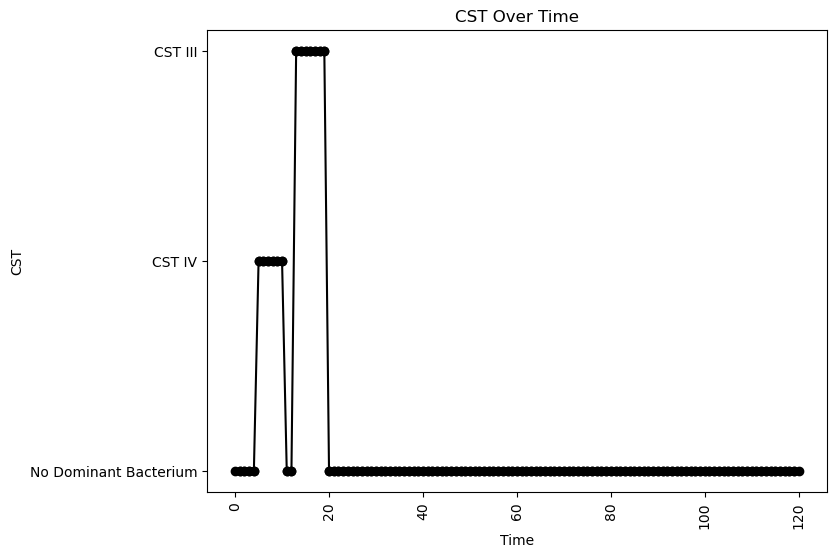


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.081085847036742
nAB->Li: -0.31735336434404326
nAB->oLB: -0.3120095666036701
Li->nAB: 0.034471147750975484
Li Self: -0.0055204809920814946
Li->oLB: 0.05606435961529632
oLB->nAB: -0.1347767286369837
oLB->Li: 0.15448229450267714
oLB Self: -0.09767335905877264

Simulation 7502 follows a valid CST progression:


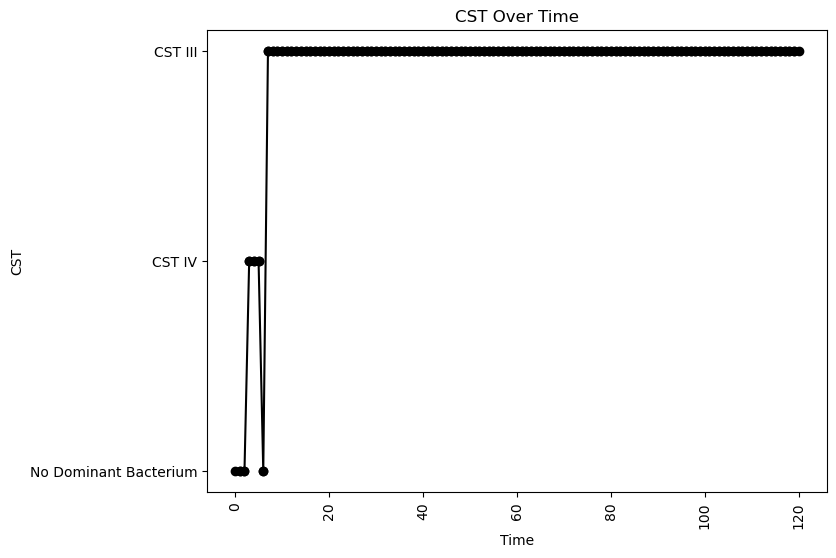


Interaction Parameters:
nAB Growth: 2.172057972480792
Li Growth: 0.05464936187495586
oLB Growth: 1.1816194682992254
nAB Self: -0.09319501741691028
nAB->Li: -0.08915414584887893
nAB->oLB: -0.23561401528411852
Li->nAB: 0.3241738211114621
Li Self: -0.05198361245286213
Li->oLB: -0.1579145776751379
oLB->nAB: -0.25541104881913335
oLB->Li: -0.11555643354150408
oLB Self: -0.08796149336979611

Simulation 7507 follows a valid CST progression:


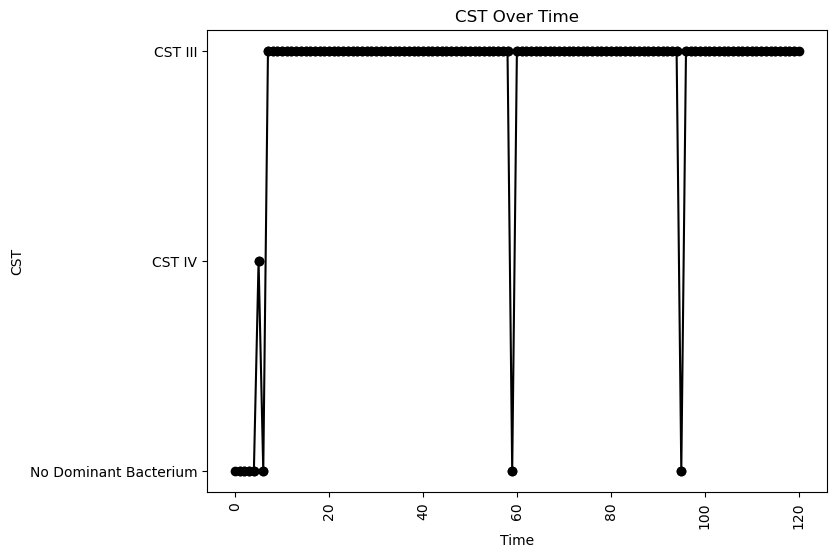


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.029563510479375374
nAB->Li: -0.42880730243939236
nAB->oLB: -0.017572894559083063
Li->nAB: 0.3736847493459269
Li Self: -0.0860192225015019
Li->oLB: 0.34645084494102996
oLB->nAB: -0.4117465589869878
oLB->Li: -0.387878532547253
oLB Self: -0.046326770016637264

Simulation 7508 follows a valid CST progression:


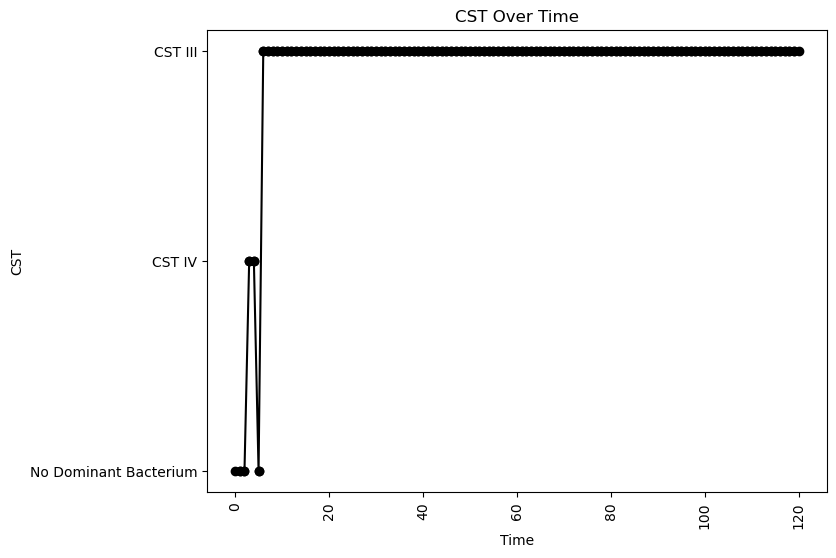


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.0033958236955349413
nAB->Li: 0.08465849947803017
nAB->oLB: -0.17717582404188836
Li->nAB: 0.36584355250981826
Li Self: -0.03390093441989833
Li->oLB: -0.029810958522724307
oLB->nAB: -0.47995534717238436
oLB->Li: 0.1511647018843053
oLB Self: -0.07846893664982016

Simulation 7509 follows a valid CST progression:


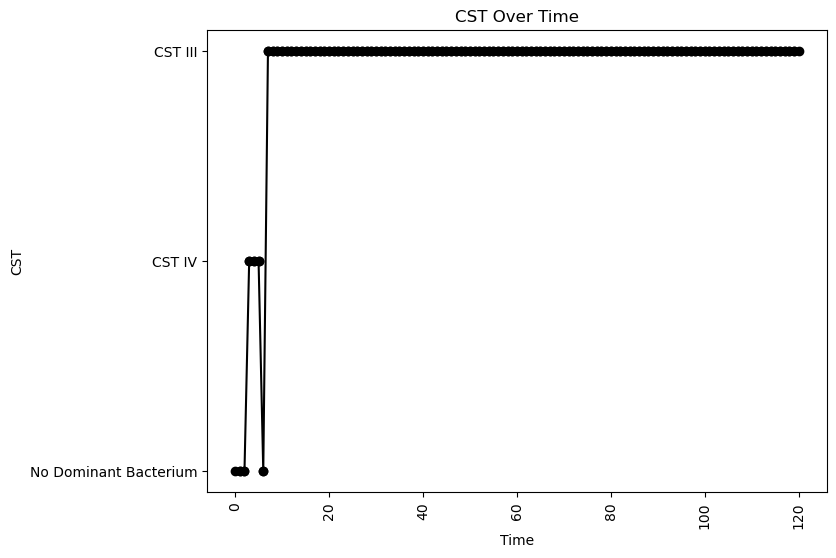


Interaction Parameters:
nAB Growth: 2.284416841880324
Li Growth: 0.06886020002136616
oLB Growth: 0.35838896078112936
nAB Self: -0.007680948487835168
nAB->Li: -0.4199826964651173
nAB->oLB: -0.2308622412450173
Li->nAB: 0.13135736039408885
Li Self: -0.02764328038902364
Li->oLB: 0.04657266062657539
oLB->nAB: -0.2453475836789336
oLB->Li: -0.4915456989562715
oLB Self: -0.014808917438308603

Simulation 7510 follows a valid CST progression:


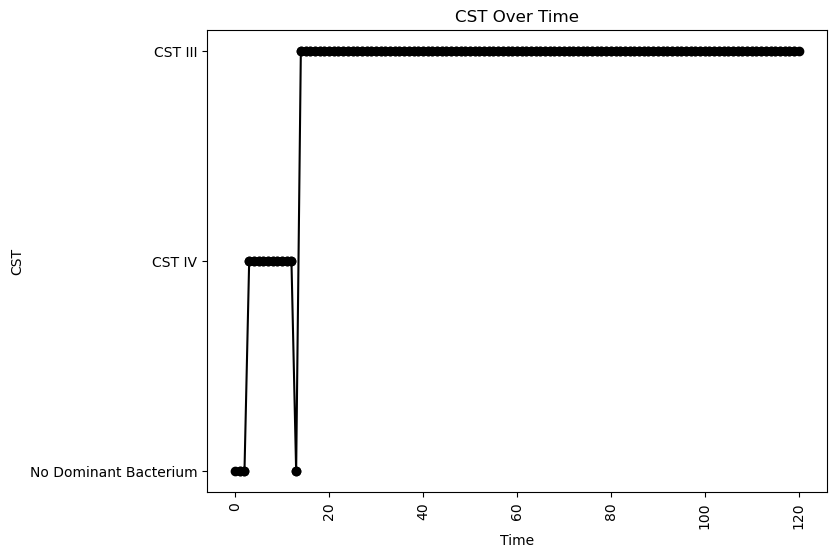


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.07690843940648492
nAB->Li: -0.25164173432186293
nAB->oLB: -0.41708061463979434
Li->nAB: 0.03717997729857614
Li Self: -0.0012767626308092805
Li->oLB: -0.4904441016616621
oLB->nAB: -0.3567098996044126
oLB->Li: -0.0928141869913432
oLB Self: -0.03272666660772949

Simulation 7515 follows a valid CST progression:


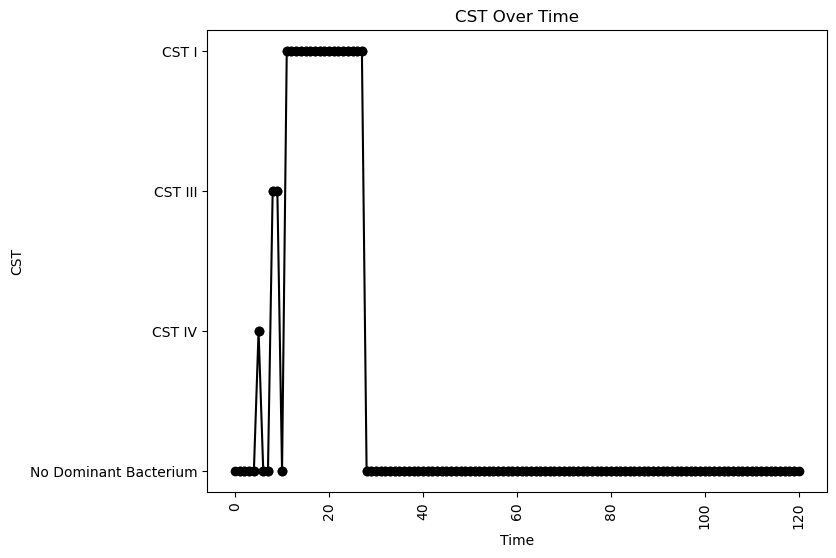


Interaction Parameters:
nAB Growth: 2.2609282147211935
Li Growth: 0.06381435834914458
oLB Growth: 0.1660151901294062
nAB Self: -0.01031161285706754
nAB->Li: -0.41879195317068185
nAB->oLB: -0.2512946992400467
Li->nAB: 0.2898400301644385
Li Self: -0.054903498051328416
Li->oLB: 0.13029323899094225
oLB->nAB: -0.49064321477480083
oLB->Li: 0.48847761915043963
oLB Self: -0.08557306570573396

Simulation 7520 follows a valid CST progression:


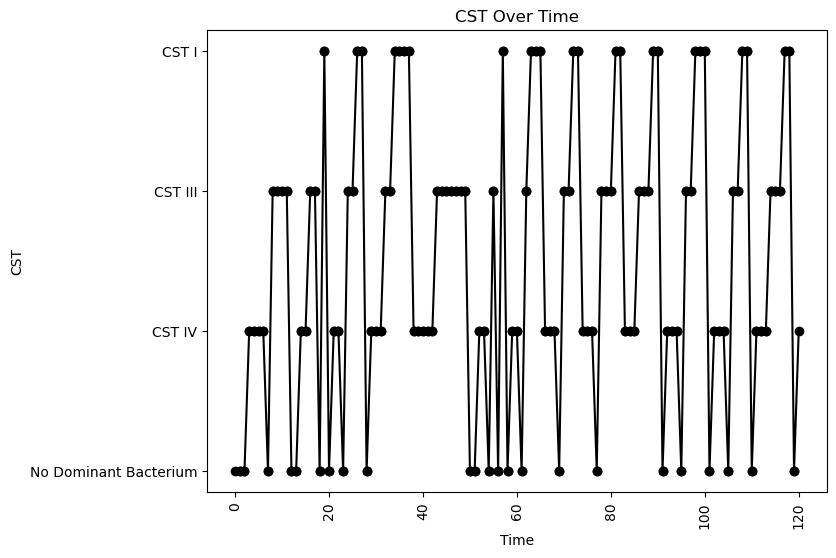


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.07921495140243422
nAB->Li: -0.08553326318743298
nAB->oLB: -0.06038391912395907
Li->nAB: 0.15140062210638672
Li Self: -0.02978482309681109
Li->oLB: -0.22706840985141807
oLB->nAB: -0.4371307860985738
oLB->Li: 0.29665631060412234
oLB Self: -0.05546283292663842

Simulation 7531 follows a valid CST progression:


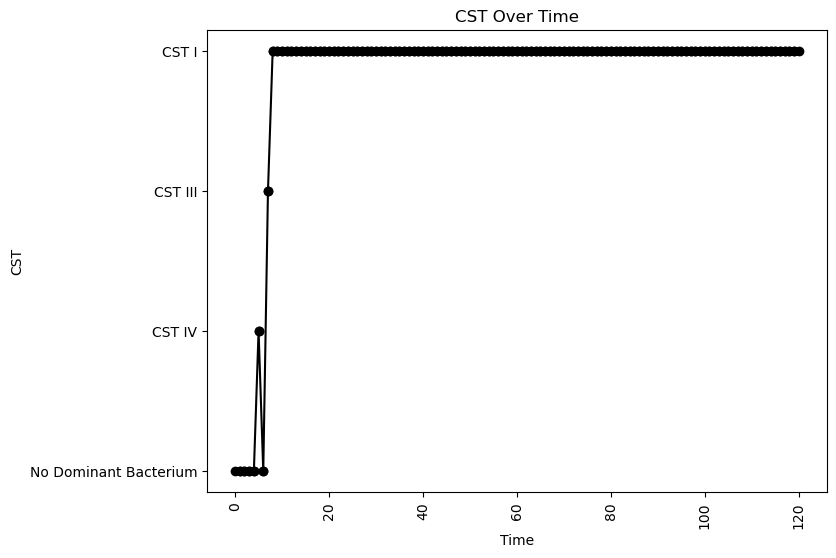


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.021019045495268465
nAB->Li: -0.1606675625656625
nAB->oLB: -0.4498411048374109
Li->nAB: 0.2905770982959287
Li Self: -0.012186537499377703
Li->oLB: 0.04277109268877444
oLB->nAB: -0.47430375125830515
oLB->Li: 0.4101178973158317
oLB Self: -0.09516956035747287

Simulation 7533 follows a valid CST progression:


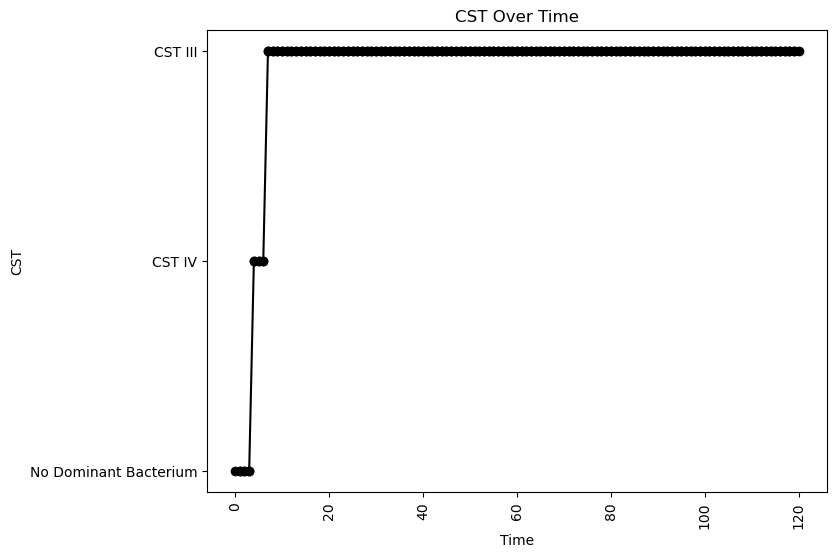


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.02482825739195614
nAB->Li: -0.11414229013758032
nAB->oLB: -0.39200678091436997
Li->nAB: 0.20656682124135806
Li Self: -0.03520677394837249
Li->oLB: -0.028916705392216857
oLB->nAB: -0.13754063007812145
oLB->Li: -0.3588259010752769
oLB Self: -0.03774475989407897

Simulation 7535 follows a valid CST progression:


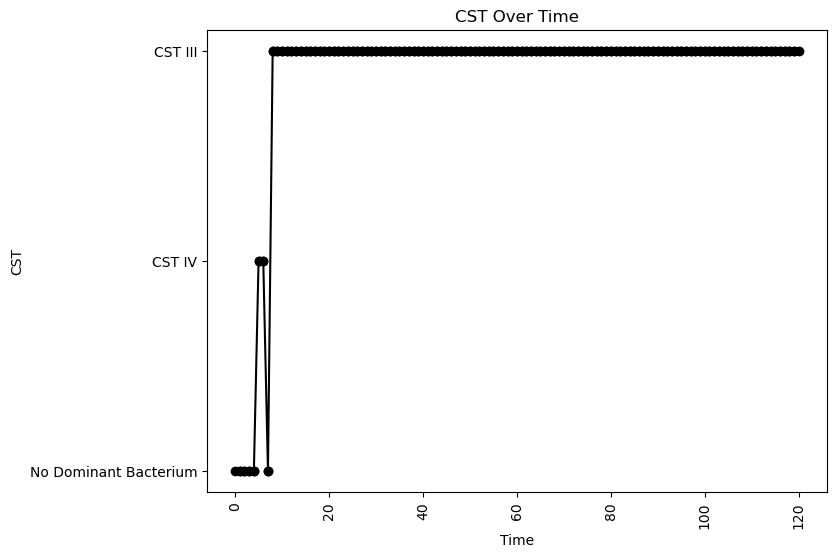


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.10621100547239333
oLB Growth: 0.21113539622386296
nAB Self: -0.006858577633950549
nAB->Li: -0.04152166397060053
nAB->oLB: -0.3246694566055134
Li->nAB: 0.1275338748012267
Li Self: -0.0725775965015205
Li->oLB: 0.4866511644582169
oLB->nAB: -0.3053284539756309
oLB->Li: -0.18889455435427932
oLB Self: -0.08069683699232796

Simulation 7548 follows a valid CST progression:


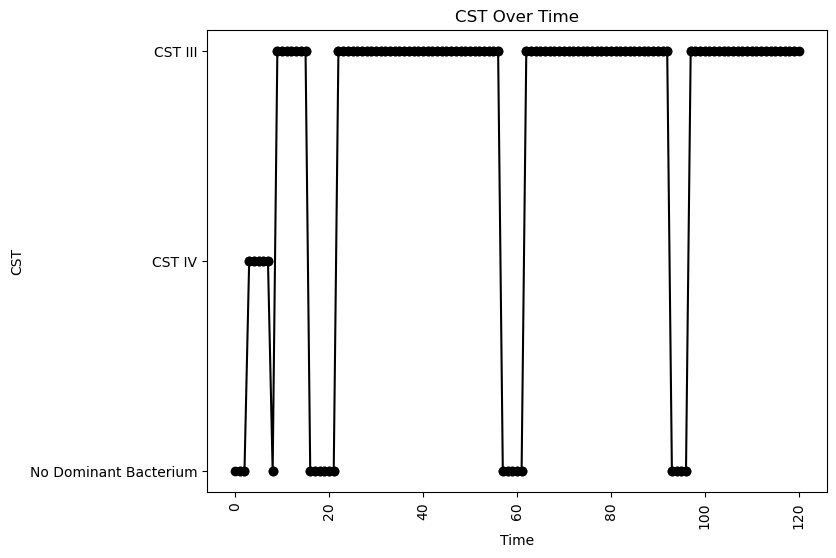


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.03837725110012093
oLB Growth: 1.155917868199191
nAB Self: -0.09380022209752123
nAB->Li: -0.49246482390988033
nAB->oLB: -0.2909844589787222
Li->nAB: 0.1444733509331141
Li Self: -0.09796369310706614
Li->oLB: -0.4174818416546394
oLB->nAB: -0.40037816810123683
oLB->Li: -0.157348975139052
oLB Self: -0.08869313737511945

Simulation 7569 follows a valid CST progression:


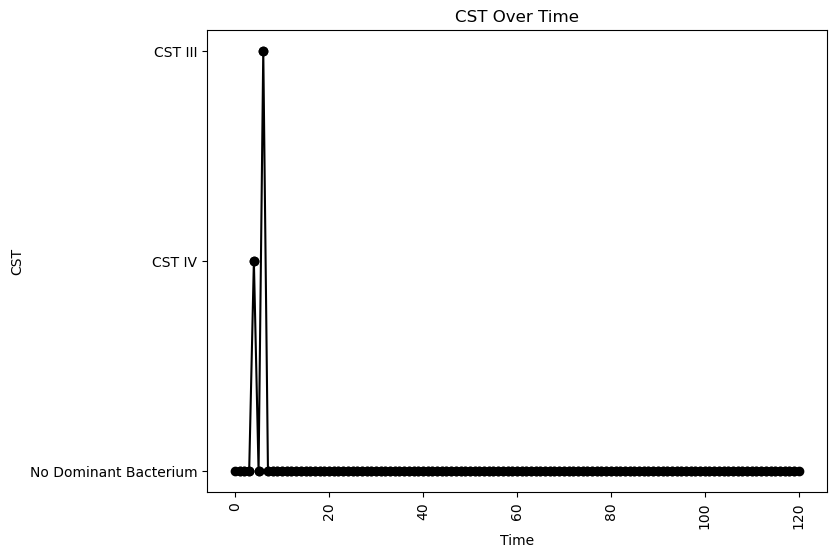


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.04952684279212294
nAB->Li: -0.052939337807080045
nAB->oLB: -0.2345974741553728
Li->nAB: 0.4815614431351338
Li Self: -0.034107330613788234
Li->oLB: 0.1559074201024031
oLB->nAB: -0.44121520018604526
oLB->Li: 0.2100122763003648
oLB Self: -0.07137865880375363

Simulation 7574 follows a valid CST progression:


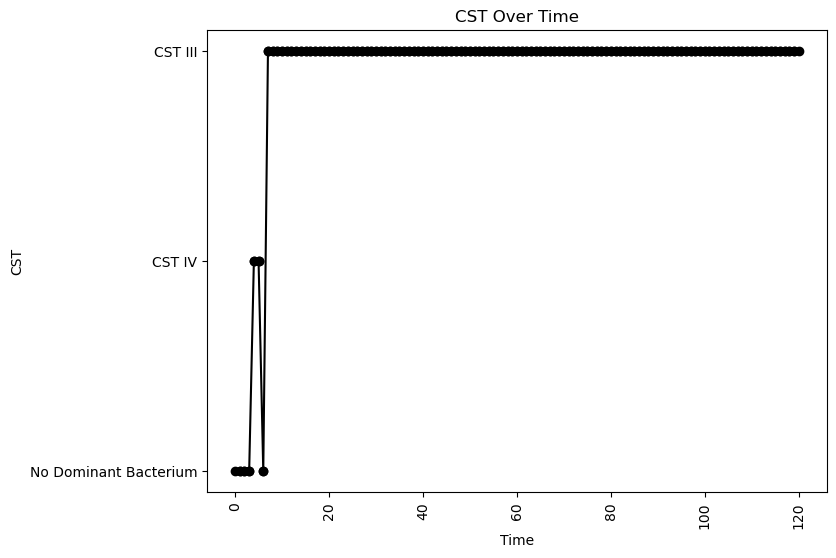


Interaction Parameters:
nAB Growth: 2.2609282147211935
Li Growth: 0.06381435834914458
oLB Growth: 0.1660151901294062
nAB Self: -0.06559027402703949
nAB->Li: -0.2886232013023325
nAB->oLB: -0.35720476590961153
Li->nAB: 0.22831550041206294
Li Self: -0.015062985152817385
Li->oLB: 0.14325817136811625
oLB->nAB: -0.17327725954630097
oLB->Li: -0.28666369603269126
oLB Self: -0.023389870726274506

Simulation 7579 follows a valid CST progression:


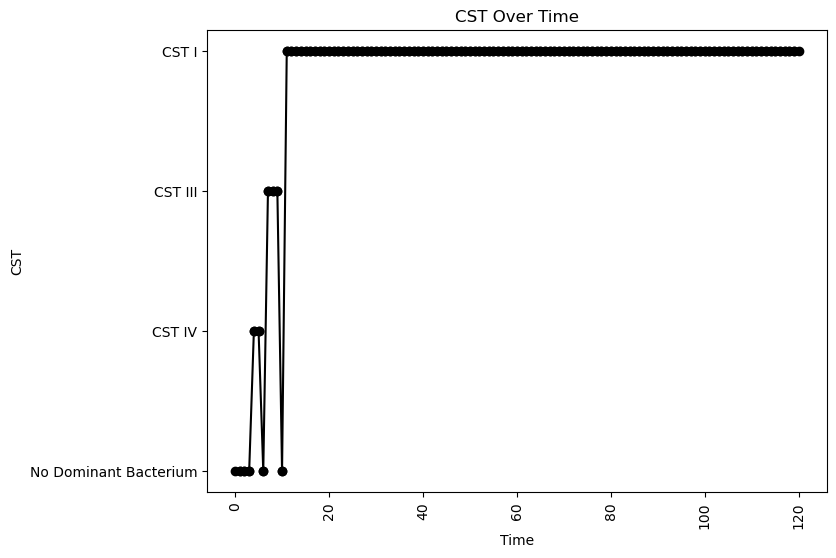


Interaction Parameters:
nAB Growth: 2.1147752631399044
Li Growth: 0.026128882742544723
oLB Growth: 1.2094391858973506
nAB Self: -0.0898101046808098
nAB->Li: -0.27776869350078964
nAB->oLB: -0.36641297757068314
Li->nAB: 0.4176499519594057
Li Self: -0.047997271443814354
Li->oLB: -0.20028248084172107
oLB->nAB: -0.009097158270687633
oLB->Li: 0.14908248812276403
oLB Self: -0.0029828690451145085

Simulation 7580 follows a valid CST progression:


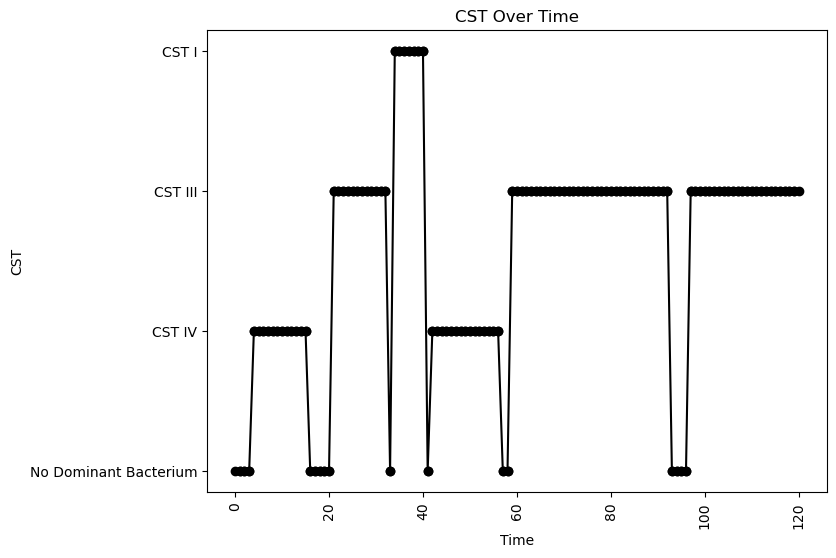


Interaction Parameters:
nAB Growth: 2.0745101401728236
Li Growth: 0.010341045972876578
oLB Growth: 1.1507970527071554
nAB Self: -0.0999833553469964
nAB->Li: -0.3195934268826188
nAB->oLB: -0.12321800580497011
Li->nAB: 0.08007419475643285
Li Self: -0.06688862347729944
Li->oLB: -0.43811258431468025
oLB->nAB: -0.15341632640522657
oLB->Li: -0.15995536280529443
oLB Self: -0.0875327768859529

Simulation 7581 follows a valid CST progression:


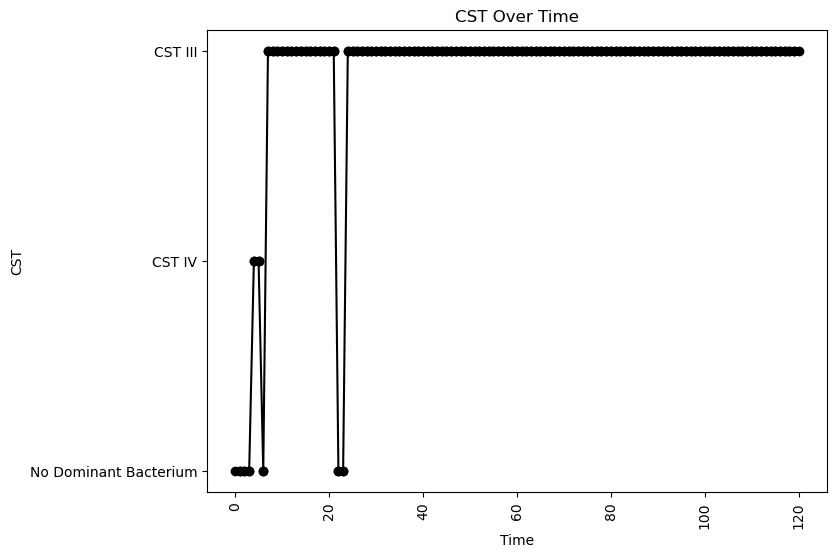


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.08626383793727727
nAB->Li: -0.2495022123591959
nAB->oLB: -0.3082206574055515
Li->nAB: 0.2366759380102701
Li Self: -0.0751181677594326
Li->oLB: 0.1734994031366367
oLB->nAB: -0.13746684549994975
oLB->Li: 0.032491247769420584
oLB Self: -0.042207525507063436

Simulation 7582 follows a valid CST progression:


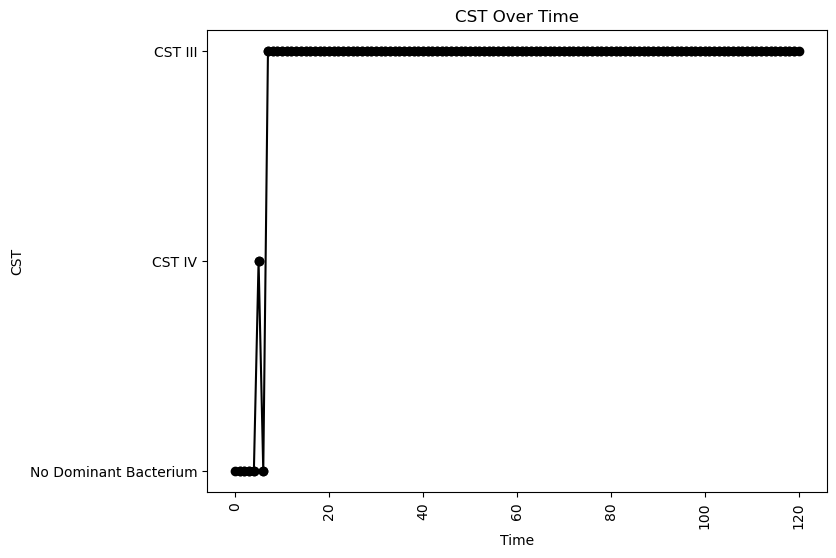


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.14768439902751102
oLB Growth: 0.07204856104631488
nAB Self: -0.05885358776340869
nAB->Li: -0.12890499667400662
nAB->oLB: -0.08875301437110555
Li->nAB: 0.23637675737248187
Li Self: -0.08500011195473965
Li->oLB: 0.04748205111616999
oLB->nAB: -0.03933905314319108
oLB->Li: -0.3815131303881518
oLB Self: -0.09764006350279583

Simulation 7595 follows a valid CST progression:


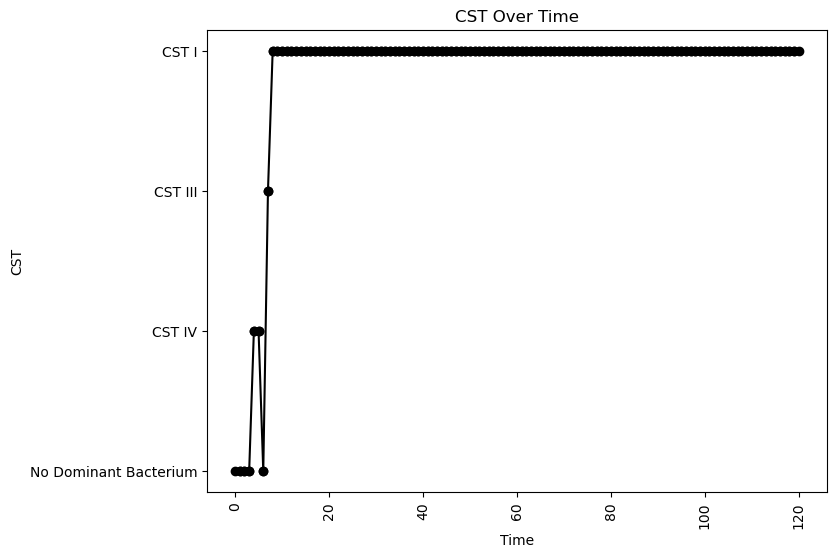


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.011841481619506544
nAB->Li: -0.11531881678518396
nAB->oLB: -0.20626177055217132
Li->nAB: 0.3927693608412418
Li Self: -0.007702195439780818
Li->oLB: -0.3540059619479886
oLB->nAB: -0.12686084668399256
oLB->Li: 0.2953314265178463
oLB Self: -0.017091195133855028

Simulation 7602 follows a valid CST progression:


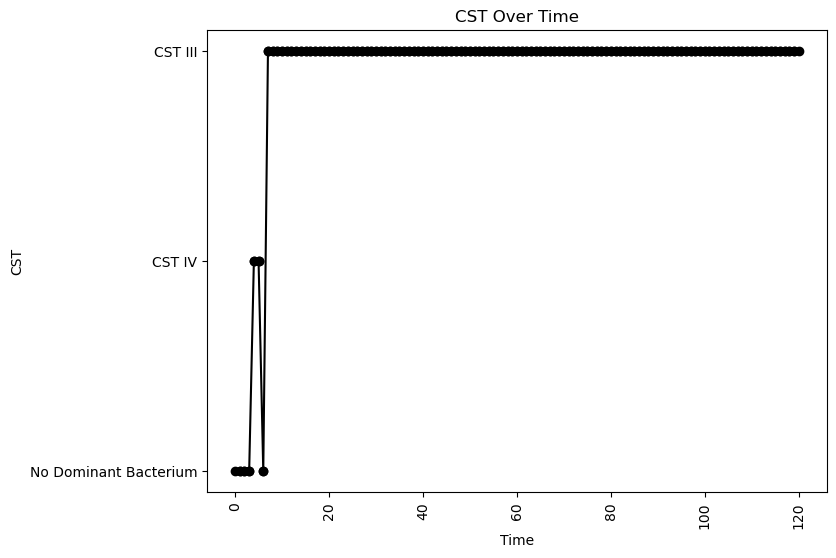


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.3604182308329207
oLB Growth: 0.2578671787060779
nAB Self: -0.09104366707895713
nAB->Li: -0.2381332522801739
nAB->oLB: -0.30870812419736543
Li->nAB: 0.11274112957771798
Li Self: -0.07051137455763827
Li->oLB: -0.19719095281379
oLB->nAB: -0.18624916219471954
oLB->Li: -0.19075051609127547
oLB Self: -0.0081470419911263

Simulation 7606 follows a valid CST progression:


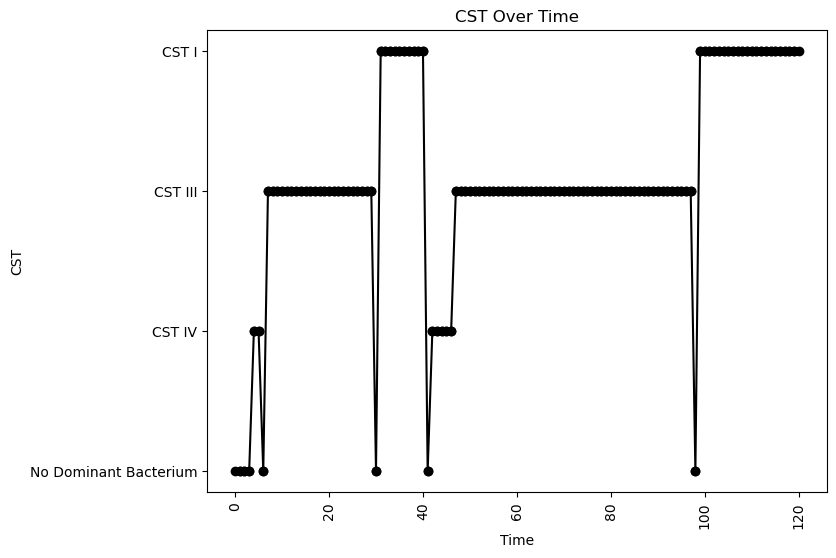


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.0662897630860735
nAB->Li: -0.3097527519701827
nAB->oLB: -0.1393499529491286
Li->nAB: 0.4490563002902219
Li Self: -0.04062941069616408
Li->oLB: -0.41155168101903616
oLB->nAB: -0.25508490870415756
oLB->Li: -0.044269567845333646
oLB Self: -0.06225362191865083

Simulation 7607 follows a valid CST progression:


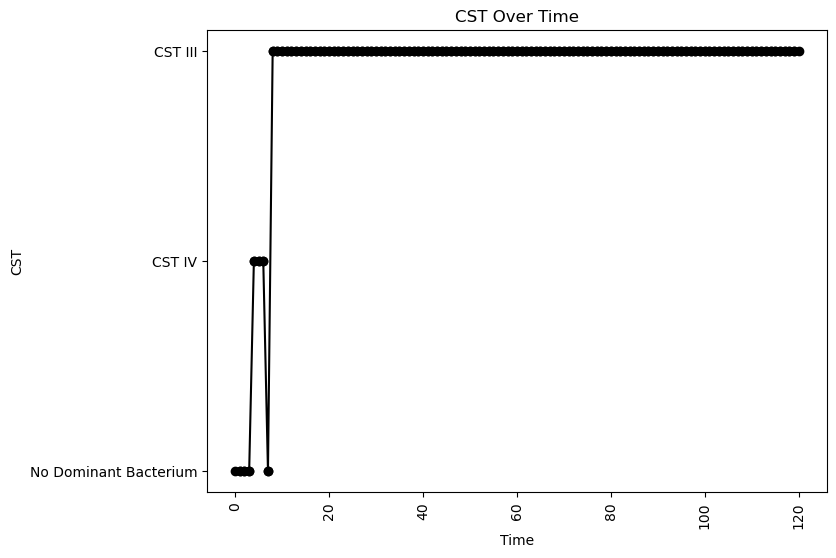


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.06664492138468138
oLB Growth: 0.6588037441195057
nAB Self: -0.07710572910221775
nAB->Li: -0.001114152113372291
nAB->oLB: -0.19796541263190326
Li->nAB: 0.22719822784824317
Li Self: -0.06052663204617979
Li->oLB: -0.3293712274548087
oLB->nAB: -0.28400797546867296
oLB->Li: -0.48159351054818705
oLB Self: -0.009529368858974943

Simulation 7610 follows a valid CST progression:


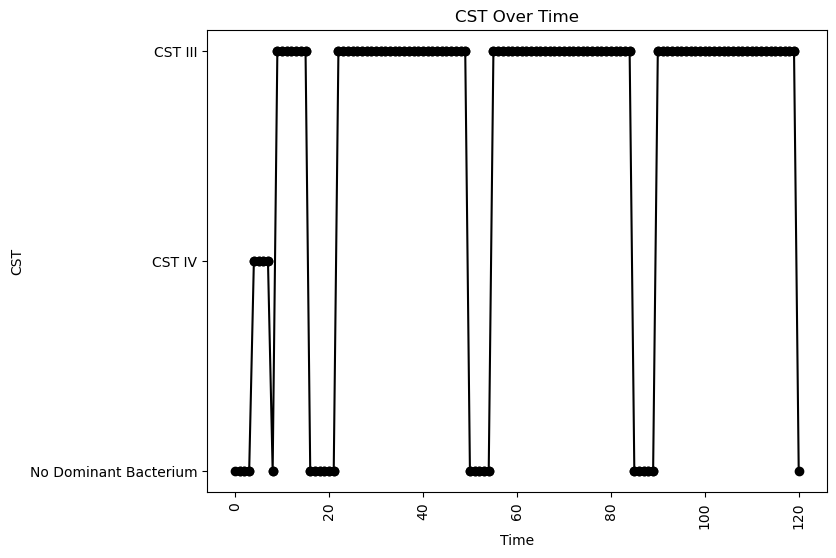


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.002753239063590901
nAB->Li: -0.27670843527026845
nAB->oLB: -0.4681475069294352
Li->nAB: 0.1049438022349043
Li Self: -0.06979849725371898
Li->oLB: -0.43967656183370807
oLB->nAB: -0.20413485941461984
oLB->Li: -0.4689727490131682
oLB Self: -0.07947343692686337

Simulation 7613 follows a valid CST progression:


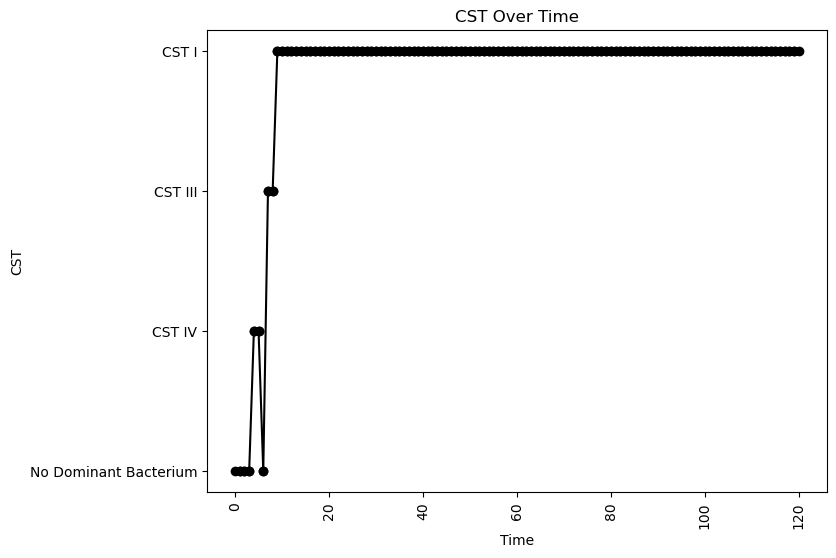


Interaction Parameters:
nAB Growth: 2.1964345031105657
Li Growth: 0.04025066595693835
oLB Growth: 1.2138354993931422
nAB Self: -0.0816486652500686
nAB->Li: -0.10372220695708367
nAB->oLB: -0.2911969068870066
Li->nAB: 0.3524507899175403
Li Self: -0.04981734630667149
Li->oLB: -0.2736186565780929
oLB->nAB: -0.4754393603968006
oLB->Li: 0.415023750463819
oLB Self: -0.04944480545478488

Simulation 7626 follows a valid CST progression:


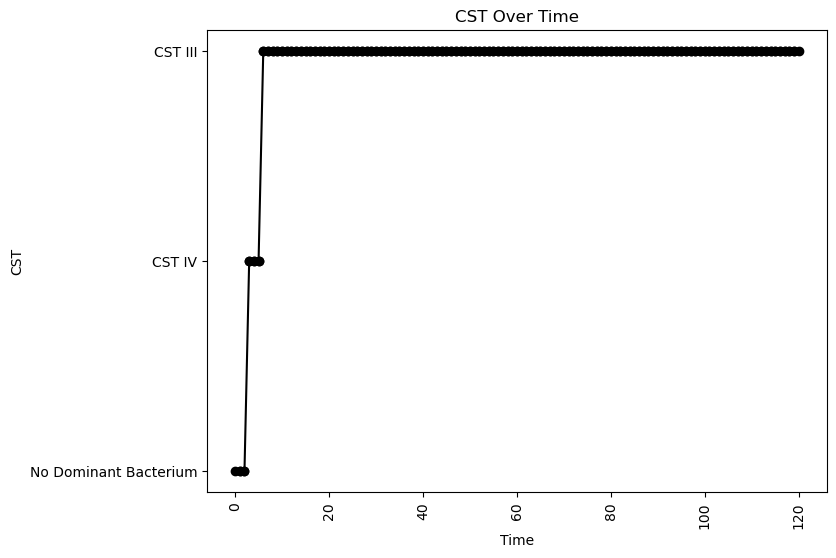


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.06526787970905011
nAB->Li: -0.03341703523310152
nAB->oLB: -0.3101861941776022
Li->nAB: 0.48256271422807073
Li Self: -0.08220207483668705
Li->oLB: -0.1244727606590576
oLB->nAB: -0.456704384452818
oLB->Li: -0.3037247409871685
oLB Self: -0.09135096820524088

Simulation 7636 follows a valid CST progression:


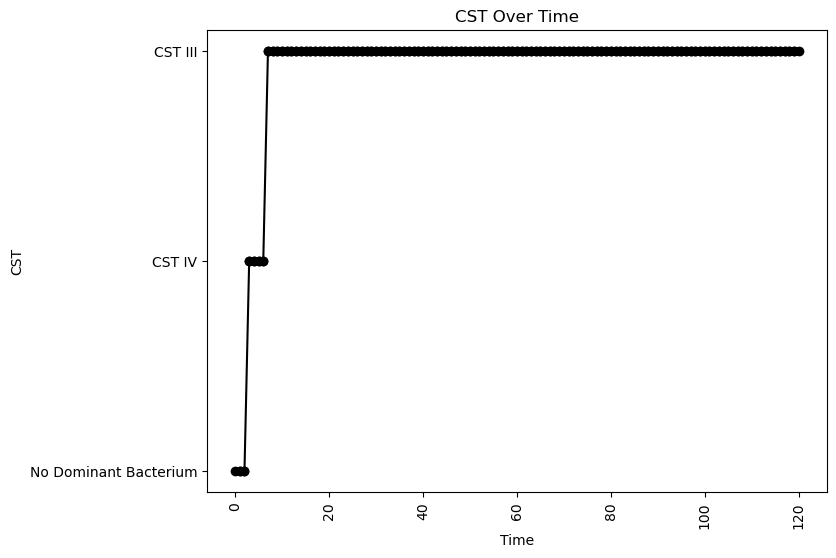


Interaction Parameters:
nAB Growth: 2.286323001067126
Li Growth: 0.060377934648291574
oLB Growth: 0.14091260068383374
nAB Self: -0.07157585461254849
nAB->Li: -0.255934769523646
nAB->oLB: -0.1112032056174147
Li->nAB: 0.2726197001730689
Li Self: -0.023194575594585626
Li->oLB: 0.029130103901442772
oLB->nAB: -0.06151321188510983
oLB->Li: -0.15116948071722708
oLB Self: -0.08042936976351003

Simulation 7641 follows a valid CST progression:


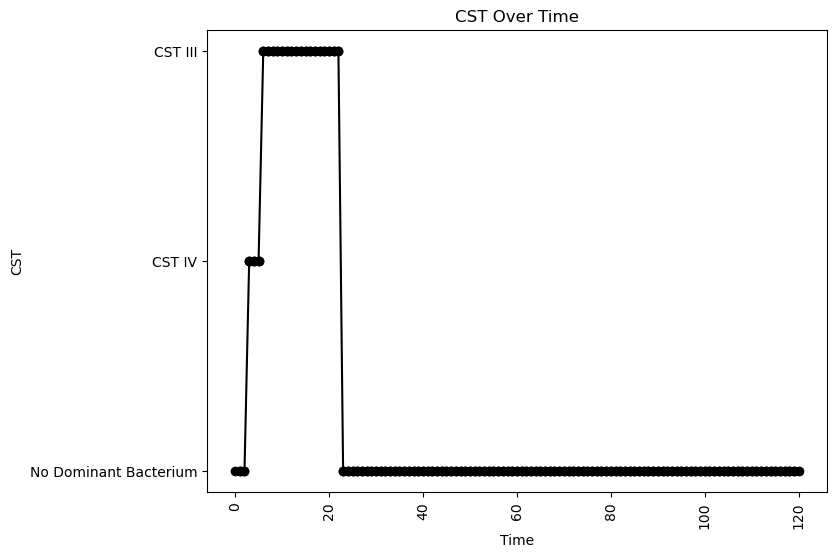


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.06967846000948563
oLB Growth: 0.7070472171500886
nAB Self: -0.09799041640976194
nAB->Li: 0.1257786980675848
nAB->oLB: -0.2599046329481366
Li->nAB: 0.3030447309986253
Li Self: -0.03122496456819547
Li->oLB: 0.18152659038132835
oLB->nAB: -0.4509217388015606
oLB->Li: -0.2984762744020409
oLB Self: -0.06391076176591026

Simulation 7644 follows a valid CST progression:


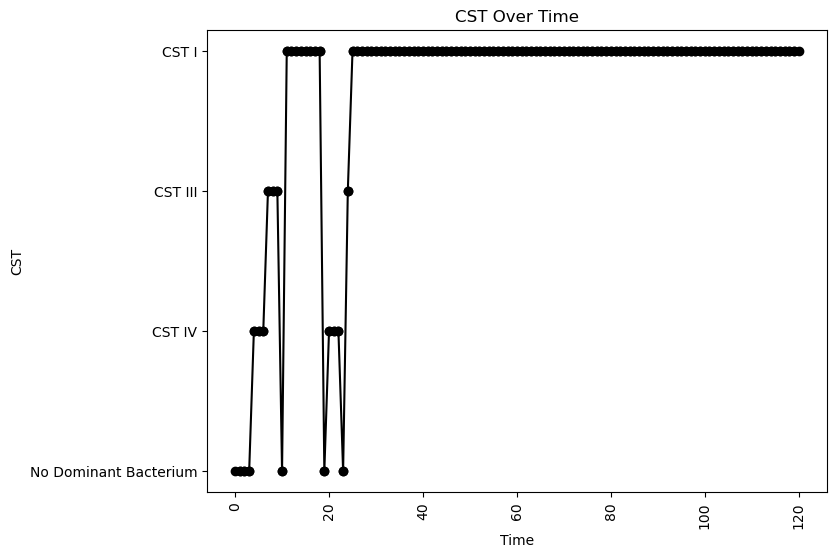


Interaction Parameters:
nAB Growth: 2.284416841880324
Li Growth: 0.06886020002136616
oLB Growth: 0.35838896078112936
nAB Self: -0.0419372063541356
nAB->Li: -0.41757256953561644
nAB->oLB: -0.4642125095310118
Li->nAB: 0.44555399095218684
Li Self: -0.08133111294788531
Li->oLB: -0.38568744413044115
oLB->nAB: -0.3711042850235477
oLB->Li: 0.291957131042067
oLB Self: -0.08621270437893959

Simulation 7648 follows a valid CST progression:


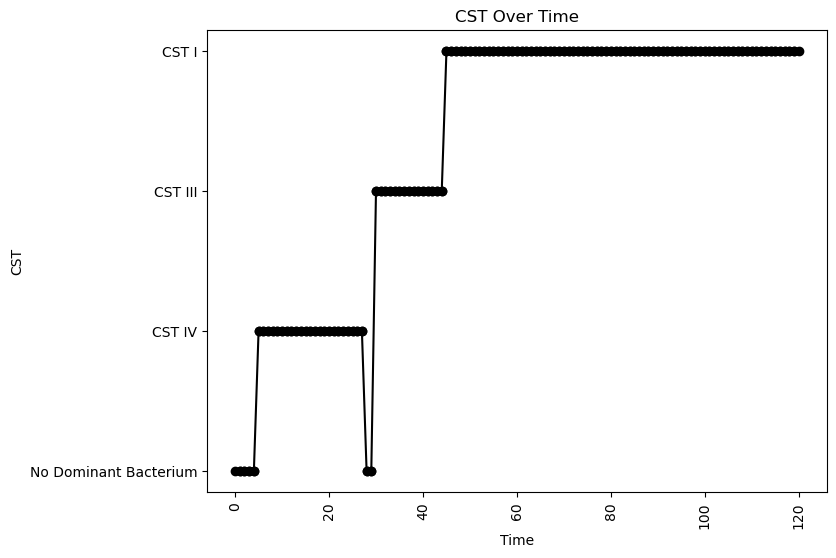


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.06664492138468138
oLB Growth: 0.6588037441195057
nAB Self: -0.04533929835271986
nAB->Li: -0.322972861665887
nAB->oLB: -0.29747371805269307
Li->nAB: 0.020452553986555877
Li Self: -0.055617921383688054
Li->oLB: -0.1680866101697182
oLB->nAB: -0.38951346540637893
oLB->Li: 0.4214429901735791
oLB Self: -0.07072229707769806

Simulation 7656 follows a valid CST progression:


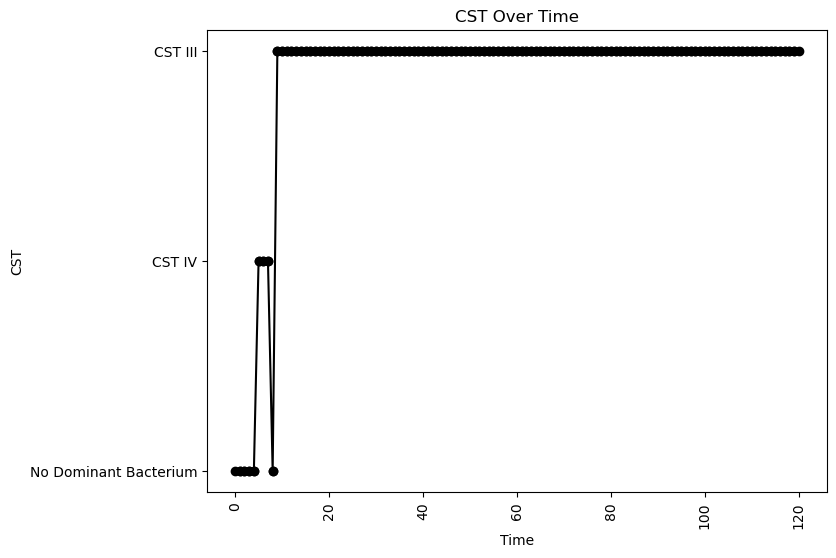


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.05739994626081137
oLB Growth: 0.11031283255203692
nAB Self: -0.09411762854164228
nAB->Li: -0.18973623886917756
nAB->oLB: -0.335509768317587
Li->nAB: 0.13648769176567788
Li Self: -0.07241904746313357
Li->oLB: 0.4362252684972957
oLB->nAB: -0.2956520577366426
oLB->Li: -0.3253839555784851
oLB Self: -0.07358728266777577

Simulation 7658 follows a valid CST progression:


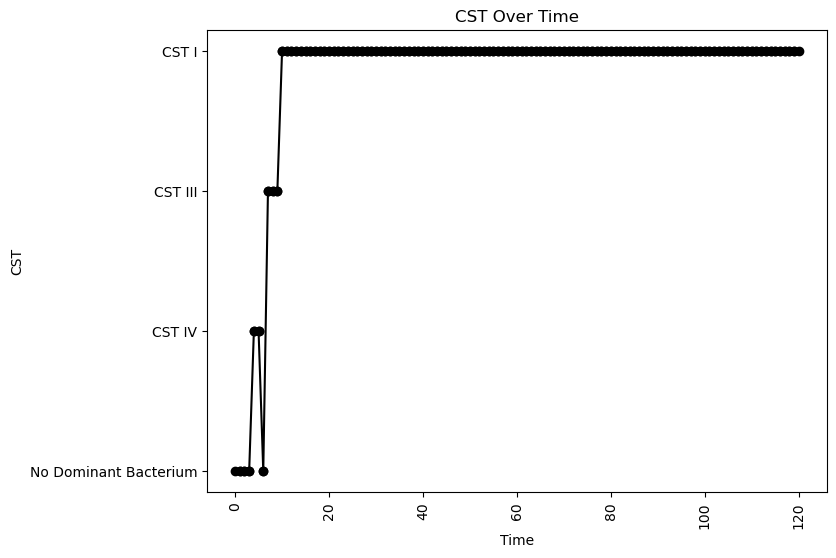


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.05072073600009906
oLB Growth: 1.0858755226067296
nAB Self: -0.09759396899902761
nAB->Li: -0.030003053519191525
nAB->oLB: -0.20699628890433552
Li->nAB: 0.22804253239577055
Li Self: -0.044307062998662126
Li->oLB: -0.13821217857816587
oLB->nAB: -0.2502552619002216
oLB->Li: 0.15347518251044123
oLB Self: -0.05048362562545348

Simulation 7660 follows a valid CST progression:


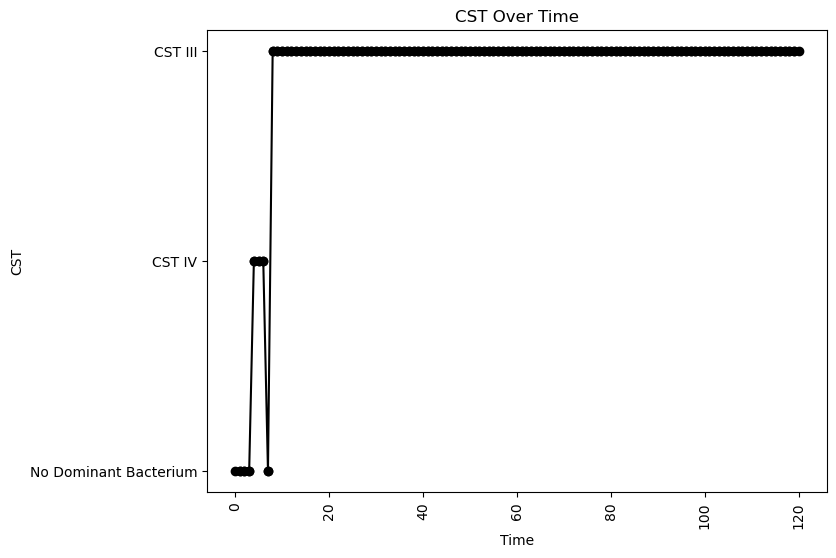


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.06309763455319839
oLB Growth: 0.9128027925042091
nAB Self: -0.006493326618059778
nAB->Li: -0.4785763134835545
nAB->oLB: -0.2262580277382083
Li->nAB: 0.2239431835819864
Li Self: -0.056707971384444146
Li->oLB: 0.22412495634868324
oLB->nAB: -0.2750699611280857
oLB->Li: -0.25297037051611015
oLB Self: -0.05675992041758666

Simulation 7662 follows a valid CST progression:


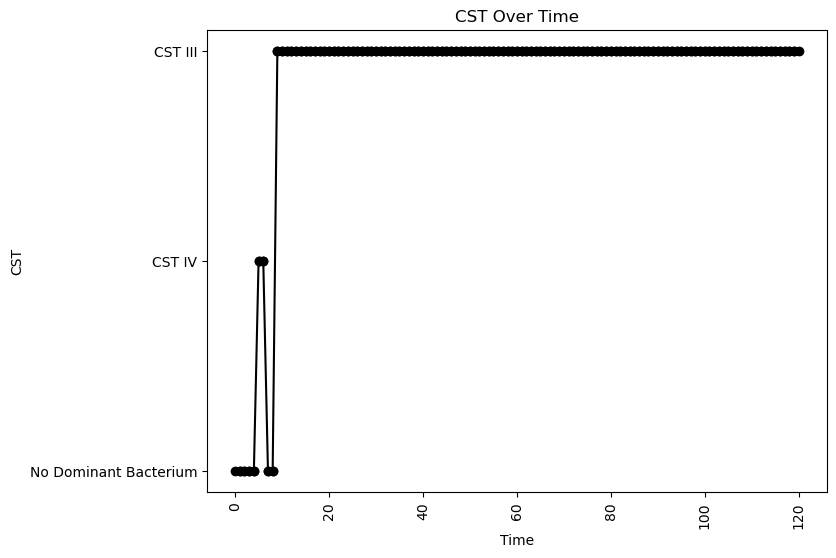


Interaction Parameters:
nAB Growth: 2.172057972480792
Li Growth: 0.15602435176243803
oLB Growth: 1.1816194682992254
nAB Self: -0.05672814337635484
nAB->Li: -0.09459724569781952
nAB->oLB: -0.3587321783542472
Li->nAB: 0.1643513136818665
Li Self: -0.08944843682680582
Li->oLB: 0.06425633949725373
oLB->nAB: -0.49314865262543534
oLB->Li: -0.1709542666434649
oLB Self: -0.09324510941524793

Simulation 7668 follows a valid CST progression:


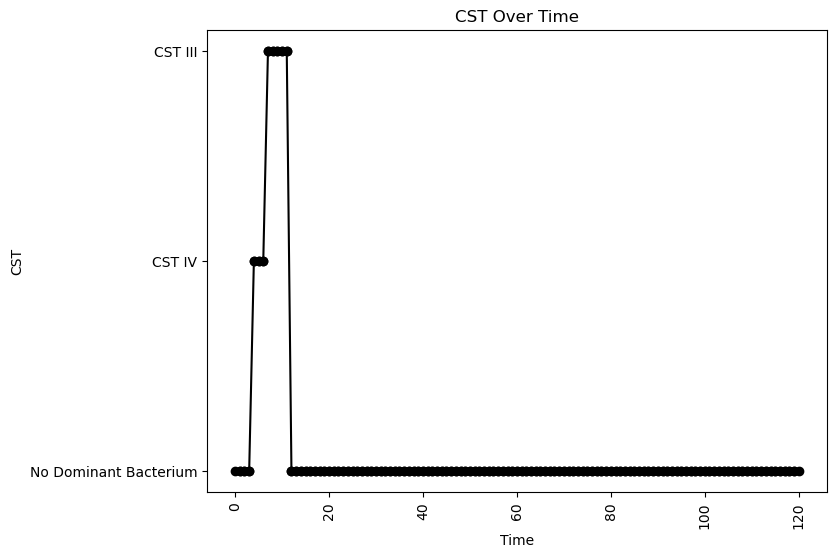


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.03222521568143662
nAB->Li: -0.43421149825119676
nAB->oLB: -0.11690472629547716
Li->nAB: 0.1587943990522891
Li Self: -0.06796832928861049
Li->oLB: 0.20178102536473874
oLB->nAB: -0.29086773230843294
oLB->Li: 0.29439834227486883
oLB Self: -0.07416628162167688

Simulation 7669 follows a valid CST progression:


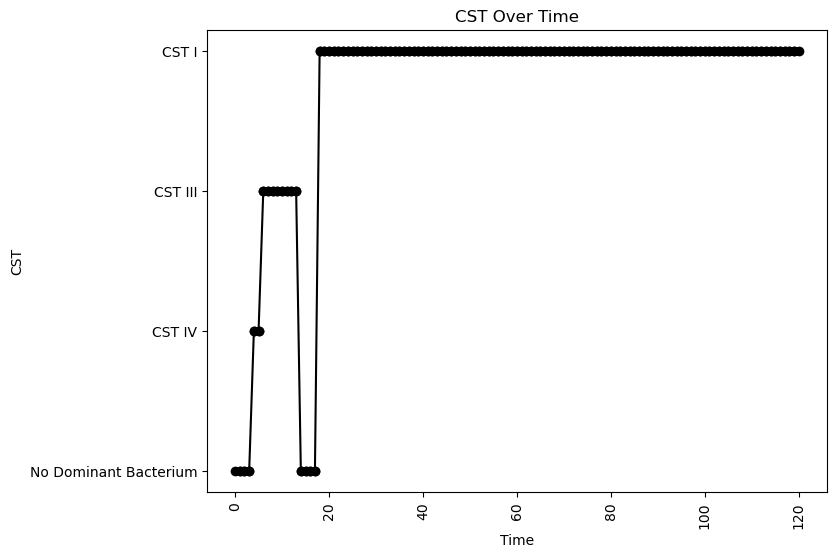


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.07839206295674914
nAB->Li: 0.007047338318154073
nAB->oLB: -0.29648150896507774
Li->nAB: 0.3697526131085014
Li Self: -0.0760055908014422
Li->oLB: -0.4557444506323649
oLB->nAB: -0.02939463027291256
oLB->Li: 0.016274052415367724
oLB Self: -0.07738041841035012

Simulation 7679 follows a valid CST progression:


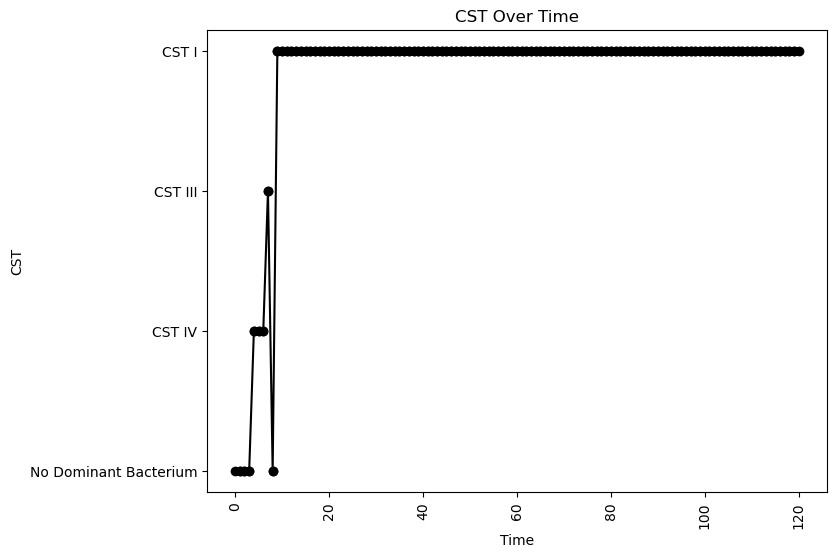


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.06121908874147701
nAB->Li: -0.14896937904410185
nAB->oLB: -0.2712861767938538
Li->nAB: 0.2688040936243348
Li Self: -0.014326398948732597
Li->oLB: -0.04395931665792502
oLB->nAB: -0.09736558688379032
oLB->Li: 0.24730576829270035
oLB Self: -0.07790067162819247

Simulation 7680 follows a valid CST progression:


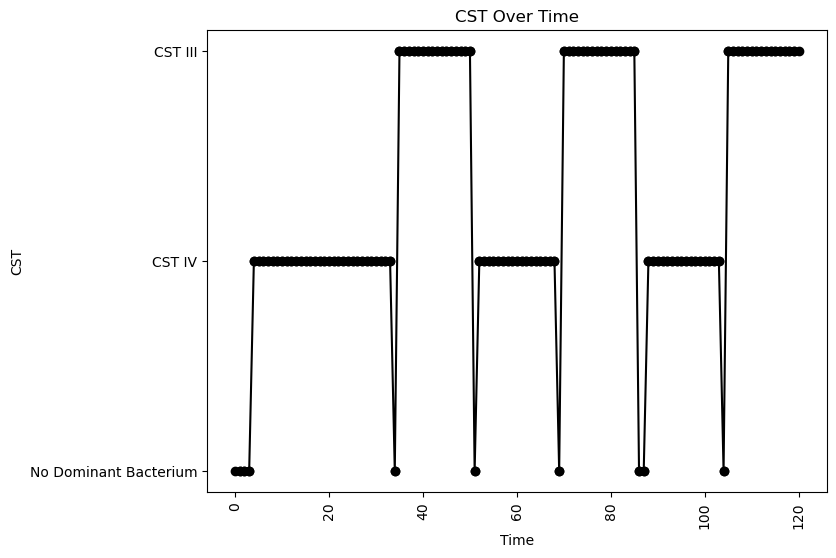


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.039014368412180825
nAB->Li: -0.32484425132704176
nAB->oLB: -0.43826390842430374
Li->nAB: 0.0042076068482468365
Li Self: -0.06127862327401643
Li->oLB: -0.4370172395977957
oLB->nAB: -0.31710825421894073
oLB->Li: 0.19687983322417746
oLB Self: -0.020515533582695672

Simulation 7681 follows a valid CST progression:


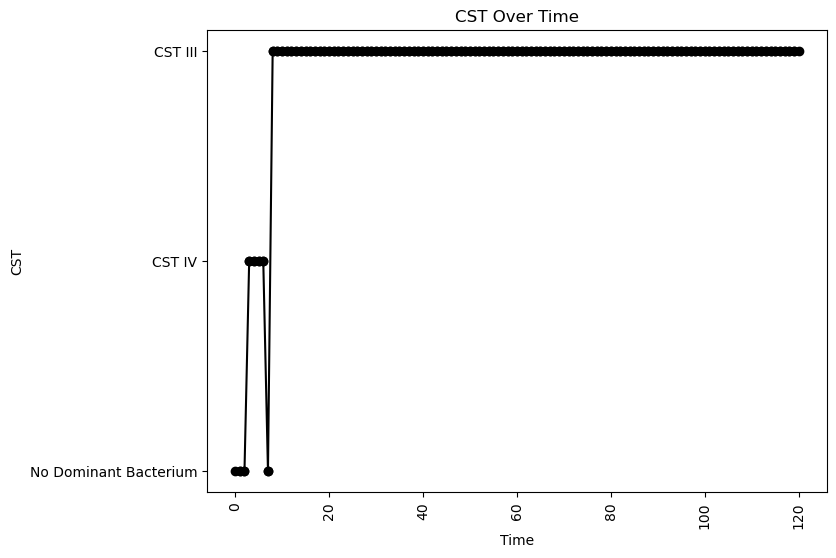


Interaction Parameters:
nAB Growth: 2.186256611128965
Li Growth: 0.06569643521101441
oLB Growth: 0.9552867864056962
nAB Self: -0.09721426108660998
nAB->Li: -0.48541010313236643
nAB->oLB: -0.2541047376461947
Li->nAB: 0.3002999893249019
Li Self: -0.010124463892156987
Li->oLB: -0.24590820688769371
oLB->nAB: -0.3970146302869806
oLB->Li: -0.1381912300729638
oLB Self: -0.023060267361927567

Simulation 7683 follows a valid CST progression:


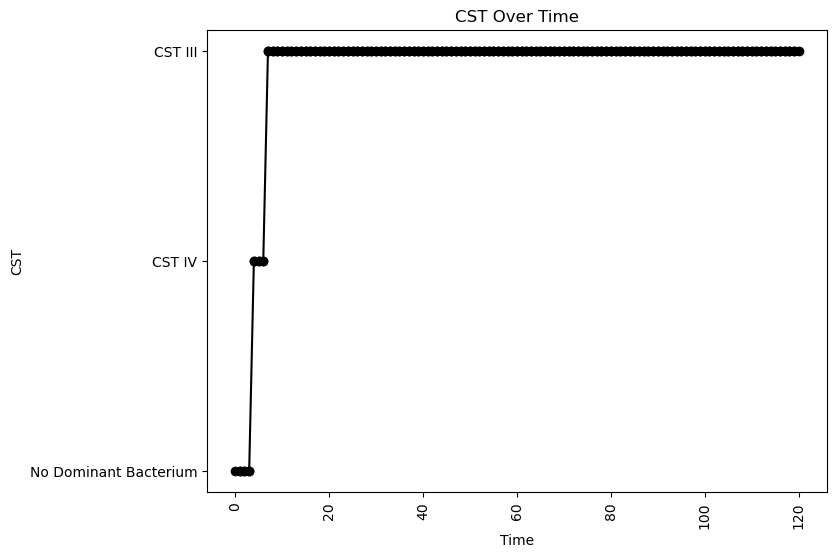


Interaction Parameters:
nAB Growth: 2.1964345031105657
Li Growth: 0.04025066595693835
oLB Growth: 1.2138354993931422
nAB Self: -0.08157040643304347
nAB->Li: -0.05395267939797166
nAB->oLB: -0.07513954389343258
Li->nAB: 0.4099685925111357
Li Self: -0.033628336898910705
Li->oLB: -0.1413044555227545
oLB->nAB: -0.25573862010029474
oLB->Li: -0.4373237290046002
oLB Self: -0.09453252519062263

Simulation 7684 follows a valid CST progression:


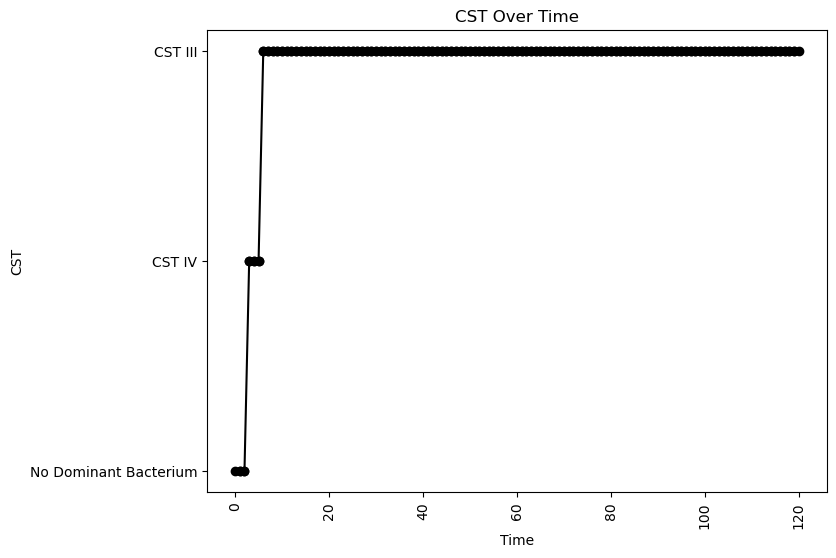


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.04702949305523943
nAB->Li: -0.25851442956576975
nAB->oLB: -0.34504185827187417
Li->nAB: 0.47471736280350374
Li Self: -0.09841035003466354
Li->oLB: -0.15081584748111027
oLB->nAB: -0.1005429185256444
oLB->Li: -0.49559547626904676
oLB Self: -0.09725396022681566

Simulation 7691 follows a valid CST progression:


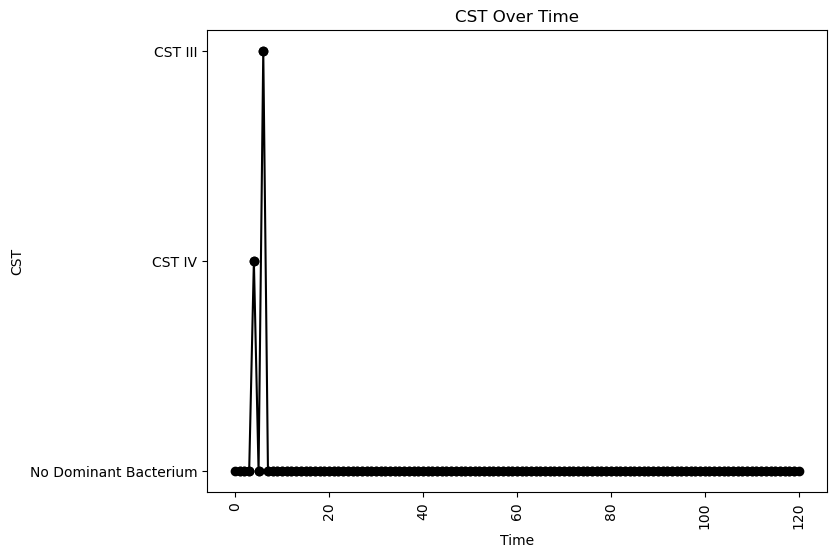


Interaction Parameters:
nAB Growth: 2.172057972480792
Li Growth: 0.19044583799316153
oLB Growth: 1.1816194682992254
nAB Self: -0.013924885613969179
nAB->Li: -0.02852947027852759
nAB->oLB: -0.0224331859201522
Li->nAB: 0.24875580118962926
Li Self: -0.08753815983999313
Li->oLB: 0.3103301065052757
oLB->nAB: -0.42720648352633595
oLB->Li: 0.3681909460671565
oLB Self: -0.05677725498375542

Simulation 7692 follows a valid CST progression:


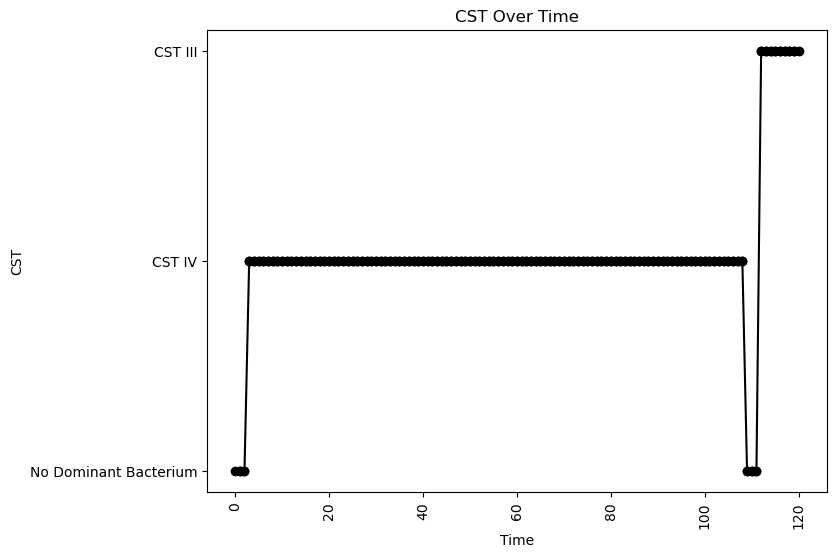


Interaction Parameters:
nAB Growth: 2.300652803872004
Li Growth: 0.06616501714537036
oLB Growth: 0.4369767544558836
nAB Self: -0.046894948101399485
nAB->Li: -0.1954483519596183
nAB->oLB: -0.16710539533219876
Li->nAB: -0.004537614958262326
Li Self: -0.022186310196823766
Li->oLB: 0.2922255274089668
oLB->nAB: -0.242386139115916
oLB->Li: -0.2784559873745074
oLB Self: -0.025144745953559144

Simulation 7697 follows a valid CST progression:


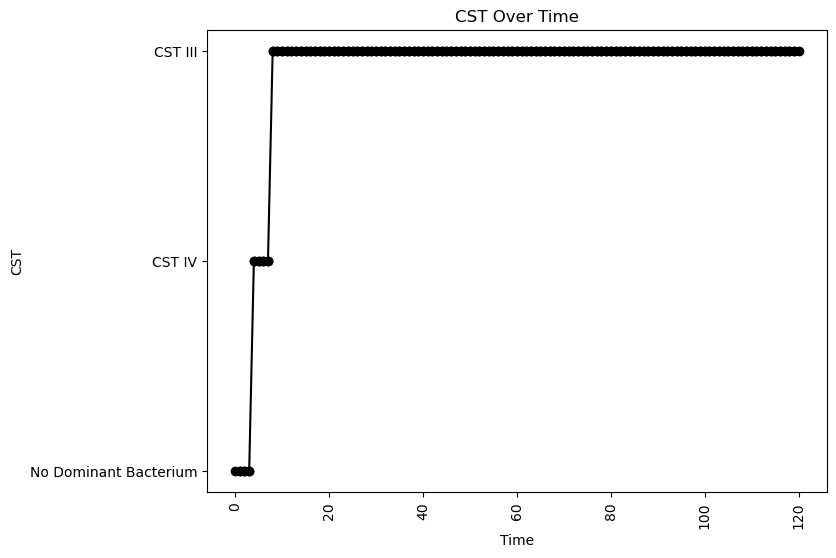


Interaction Parameters:
nAB Growth: 2.2563448832512942
Li Growth: 0.15837724024979924
oLB Growth: 0.40127498600949585
nAB Self: -0.027237854820045426
nAB->Li: 0.014001487524122114
nAB->oLB: -0.17355832869831533
Li->nAB: 0.0966350255901991
Li Self: -0.026560842739937918
Li->oLB: -0.0429803168301221
oLB->nAB: -0.38091739426781807
oLB->Li: 0.06873256434291741
oLB Self: -0.05627517172260616

Simulation 7700 follows a valid CST progression:


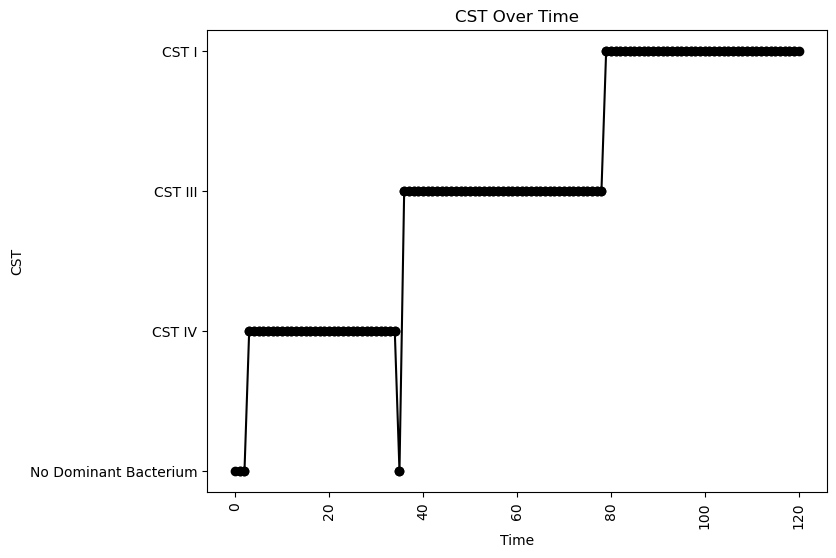


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.07891566764839585
nAB->Li: -0.47127037213152584
nAB->oLB: -0.47382290553835343
Li->nAB: 0.0010168292492415132
Li Self: -0.04863685676687579
Li->oLB: -0.3567641653848205
oLB->nAB: -0.21311366752259614
oLB->Li: 0.28229554420697245
oLB Self: -0.035908993246006604

Simulation 7708 follows a valid CST progression:


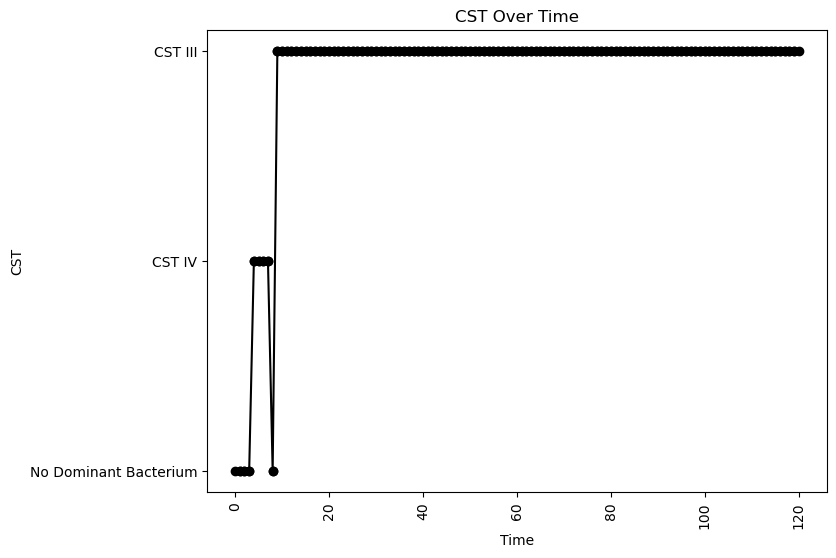


Interaction Parameters:
nAB Growth: 2.0745101401728236
Li Growth: 0.010341045972876578
oLB Growth: 1.1507970527071554
nAB Self: -0.02688624127813738
nAB->Li: -0.3051389379579197
nAB->oLB: -0.44734590321854506
Li->nAB: 0.40455960666865454
Li Self: -0.07104079625891102
Li->oLB: -0.18677107726768566
oLB->nAB: -0.16079014775088946
oLB->Li: -0.38483922693876443
oLB Self: -0.09971110688510959

Simulation 7712 follows a valid CST progression:


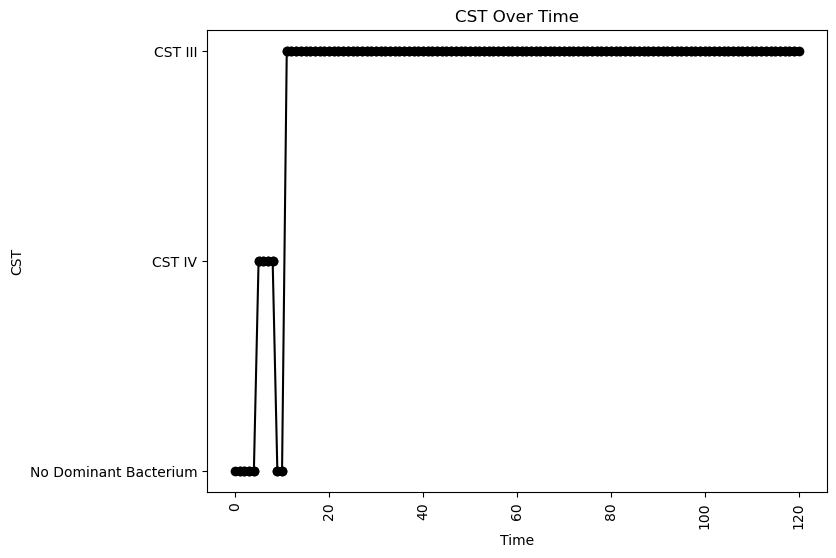


Interaction Parameters:
nAB Growth: 2.172057972480792
Li Growth: 0.05464936187495586
oLB Growth: 1.1816194682992254
nAB Self: -0.0935982199418772
nAB->Li: -0.17653627000108701
nAB->oLB: -0.445628968240741
Li->nAB: 0.07590544419323686
Li Self: -0.029646871670720845
Li->oLB: 0.1768394600582941
oLB->nAB: -0.10066307997085044
oLB->Li: -0.1192588448754564
oLB Self: -0.015135937847147063

Simulation 7717 follows a valid CST progression:


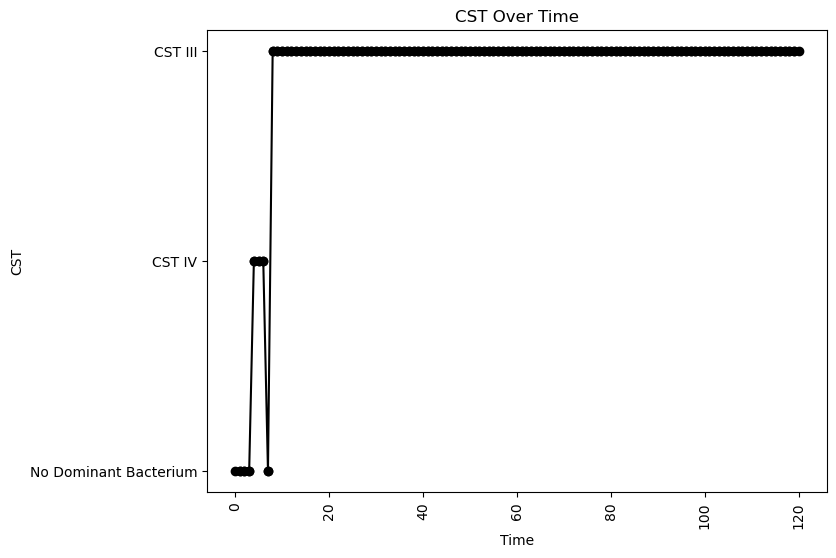


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.2004841881895147
oLB Growth: 0.21113539622386296
nAB Self: -0.028686730694902074
nAB->Li: -0.005053891154278123
nAB->oLB: -0.42918296000472594
Li->nAB: 0.10636008784976636
Li Self: -0.06332955907099558
Li->oLB: 0.3265122589530729
oLB->nAB: -0.07484053551518743
oLB->Li: 0.029568749001558148
oLB Self: -0.09007177219426554

Simulation 7720 follows a valid CST progression:


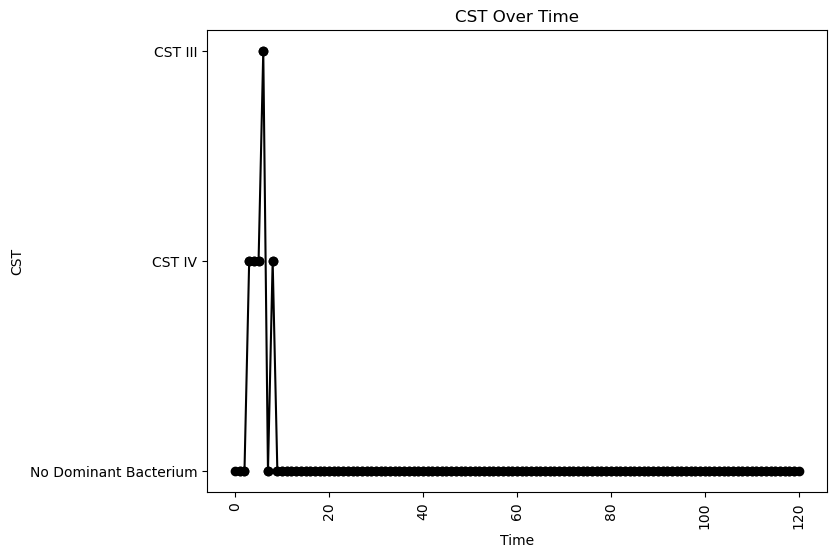


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.03842582881166287
nAB->Li: -0.061874481803164905
nAB->oLB: -0.0716022283092862
Li->nAB: 0.4785179183389012
Li Self: -0.06900834133799597
Li->oLB: -0.4707530834970163
oLB->nAB: -0.29063663370162296
oLB->Li: 0.41143141937945815
oLB Self: -0.09749858553186688

Simulation 7725 follows a valid CST progression:


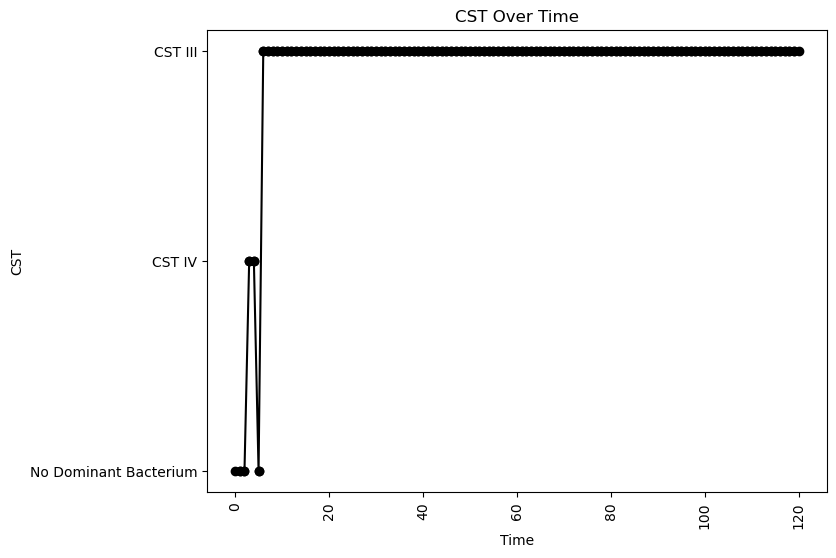


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.11362678610885685
oLB Growth: 0.058910478352813524
nAB Self: -0.05815364137345177
nAB->Li: -0.02221015315623248
nAB->oLB: -0.26221766045906175
Li->nAB: 0.3107128262908295
Li Self: -0.07431608818186575
Li->oLB: -0.2614325511633778
oLB->nAB: -0.37856917004999213
oLB->Li: -0.47968937792489247
oLB Self: -0.09451556270040551

Simulation 7730 follows a valid CST progression:


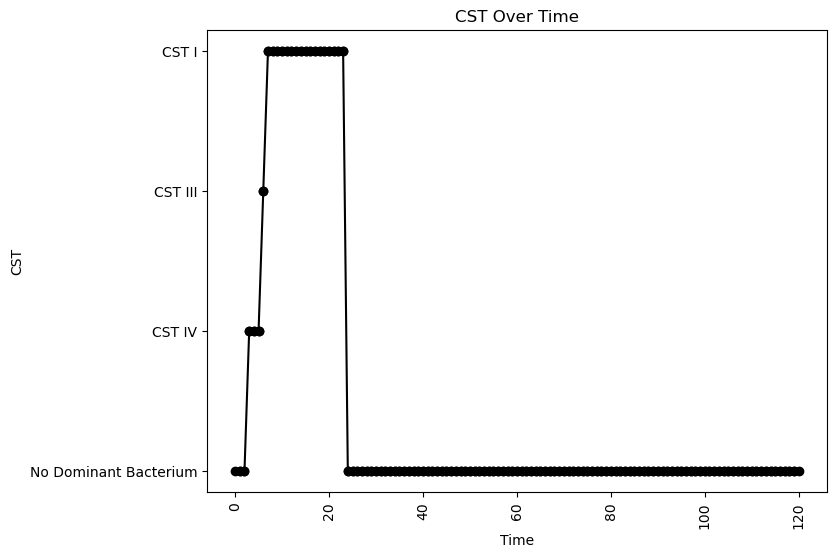


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.0438971492748673
nAB->Li: -0.2001423403481788
nAB->oLB: -0.10211198171332359
Li->nAB: 0.37022690415386816
Li Self: -0.04508017081459063
Li->oLB: 0.03748608247603458
oLB->nAB: -0.22307049719931232
oLB->Li: 0.4415901452259169
oLB Self: -0.07039762816770186

Simulation 7734 follows a valid CST progression:


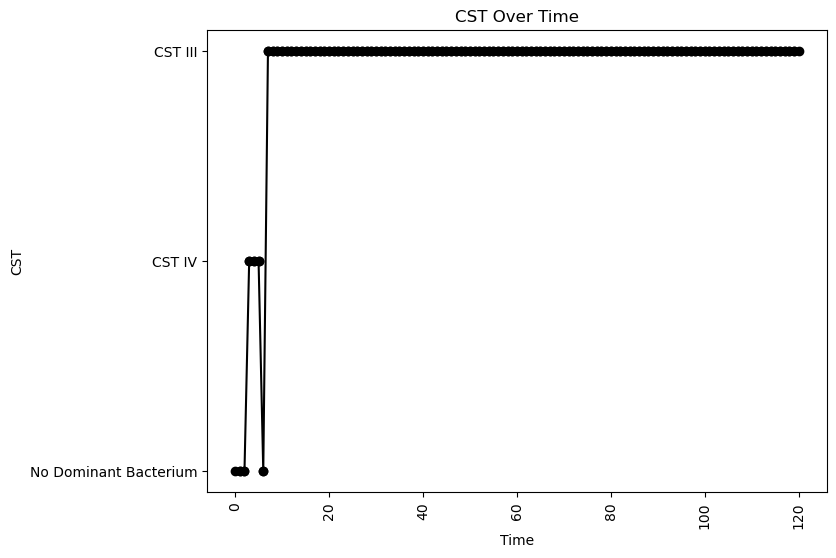


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.04532802165402521
nAB->Li: -0.0574588516378392
nAB->oLB: -0.06839396933689934
Li->nAB: 0.1734083435900574
Li Self: -0.09154074380137404
Li->oLB: -0.47080545456965917
oLB->nAB: -0.29708138535178374
oLB->Li: -0.4876279565937872
oLB Self: -0.05706632877011773

Simulation 7739 follows a valid CST progression:


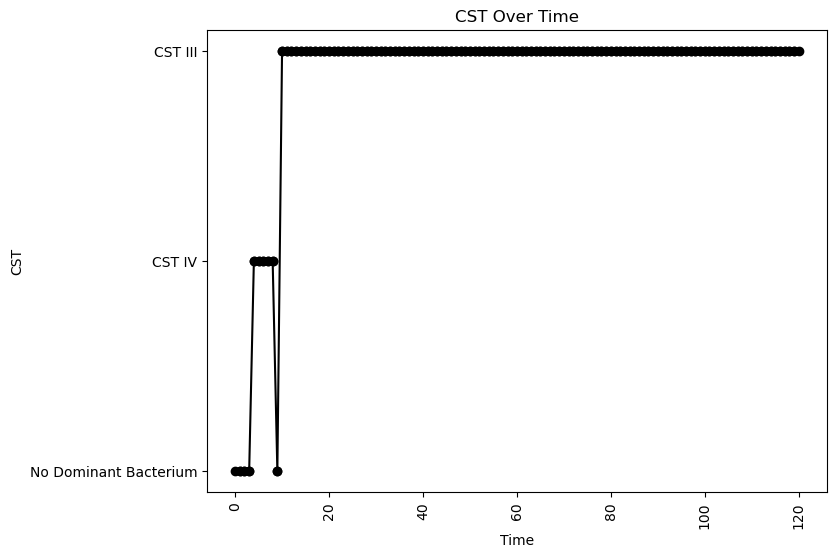


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.06516915211848101
nAB->Li: -0.38439288984208253
nAB->oLB: -0.03739855177079582
Li->nAB: 0.07545433897776843
Li Self: -0.008597141723118984
Li->oLB: 0.2529721178926936
oLB->nAB: -0.09136171227970619
oLB->Li: 0.148533151951194
oLB Self: -0.08446822363834564

Simulation 7741 follows a valid CST progression:


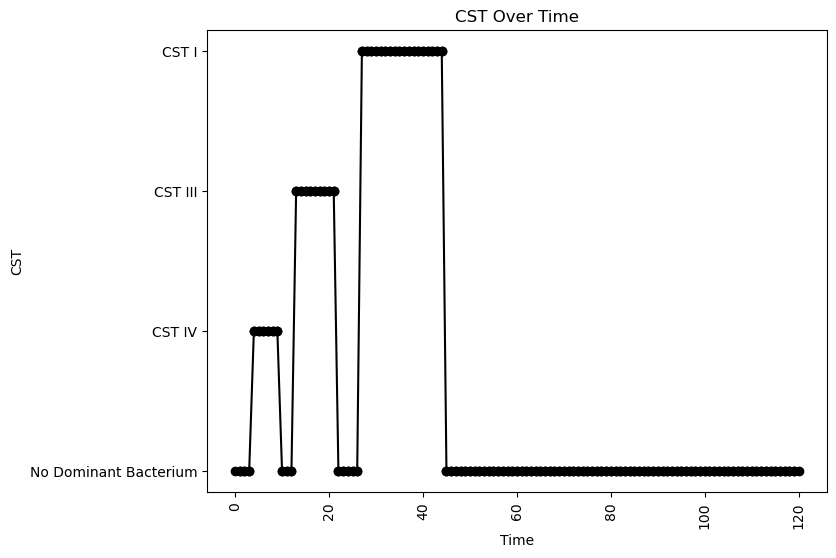


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.0961802541004661
nAB->Li: -0.3164417811266379
nAB->oLB: -0.3033714737789905
Li->nAB: 0.04090816433334499
Li Self: -0.03245204837676825
Li->oLB: 0.05479442851113958
oLB->nAB: -0.2755530228216415
oLB->Li: 0.25703142356388764
oLB Self: -0.0010583928168296508

Simulation 7742 follows a valid CST progression:


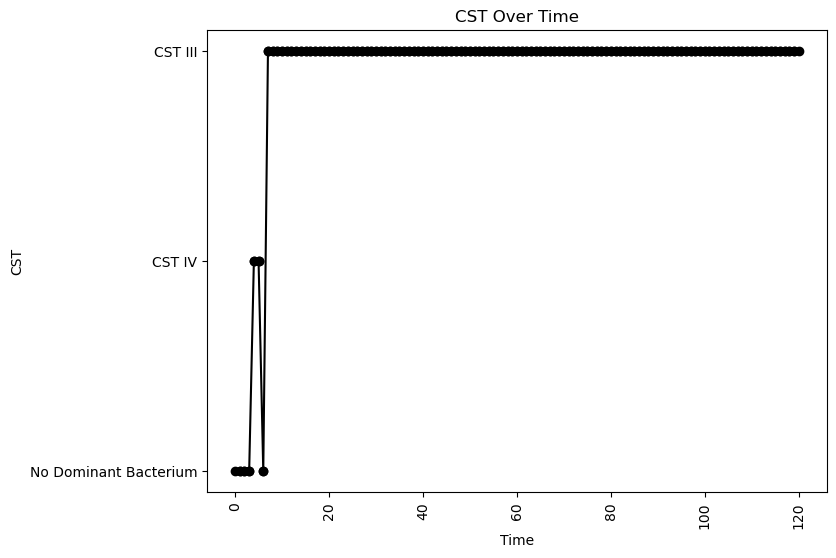


Interaction Parameters:
nAB Growth: 2.2088016144568243
Li Growth: 0.05268768924856952
oLB Growth: 1.1274304047774089
nAB Self: -0.0867579272160312
nAB->Li: -0.31983557167309096
nAB->oLB: -0.35889332079168446
Li->nAB: 0.4562804261835285
Li Self: -0.016183036031175768
Li->oLB: -0.006049803535966236
oLB->nAB: -0.09489850439097447
oLB->Li: -0.17538912514508026
oLB Self: -0.011122090576025798

Simulation 7746 follows a valid CST progression:


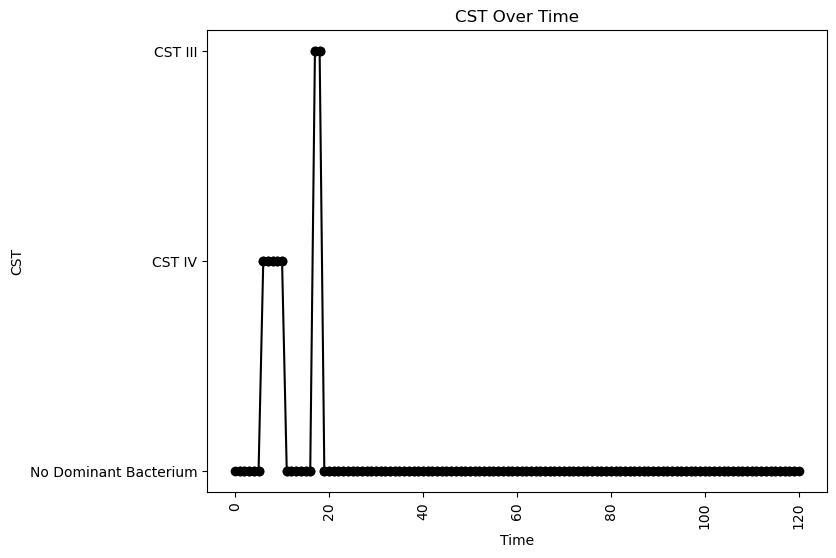


Interaction Parameters:
nAB Growth: 2.237390108639889
Li Growth: 0.07509700685781084
oLB Growth: 0.33048149496262014
nAB Self: -0.0848643871137719
nAB->Li: 0.05758799279788751
nAB->oLB: -0.045102249011863715
Li->nAB: 0.08160931320984144
Li Self: -0.04510147827371113
Li->oLB: 0.29431746073725584
oLB->nAB: -0.3587795876988322
oLB->Li: 0.25192577574562247
oLB Self: -0.002225571103549026

Simulation 7751 follows a valid CST progression:


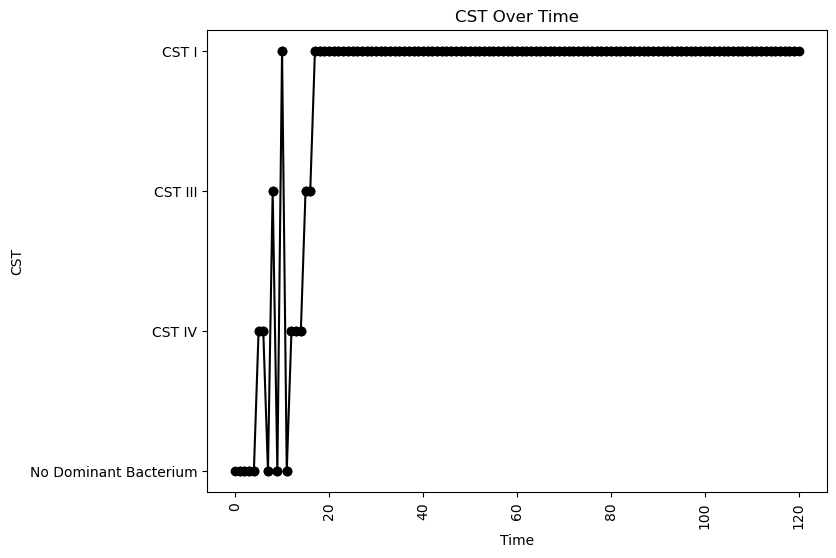


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.1628958418063779
oLB Growth: 0.2578671787060779
nAB Self: -0.0342312994258656
nAB->Li: -0.30239476016206357
nAB->oLB: -0.1993451435362809
Li->nAB: 0.20423397276580946
Li Self: -0.0802462827913662
Li->oLB: -0.49571211450591046
oLB->nAB: -0.2465598266340383
oLB->Li: 0.41565357431910643
oLB Self: -0.032178730996754515

Simulation 7762 follows a valid CST progression:


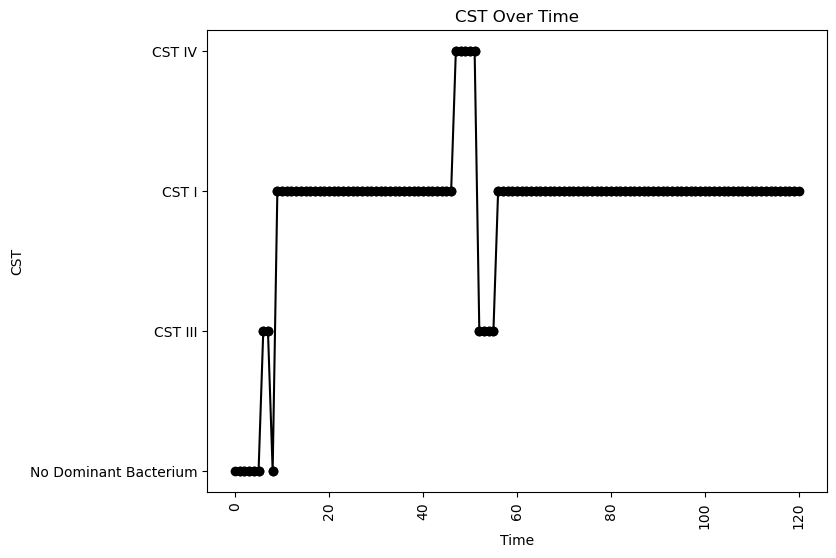


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.23918160446758352
oLB Growth: 0.31765248508565325
nAB Self: -0.06605373993161043
nAB->Li: -0.24117194226833466
nAB->oLB: -0.21402516905729657
Li->nAB: 0.35269054960381563
Li Self: -0.023352915738902608
Li->oLB: -0.14303269222804155
oLB->nAB: -0.32414078055756473
oLB->Li: 0.22785157559105262
oLB Self: -0.08016536154884488

Simulation 7765 follows a valid CST progression:


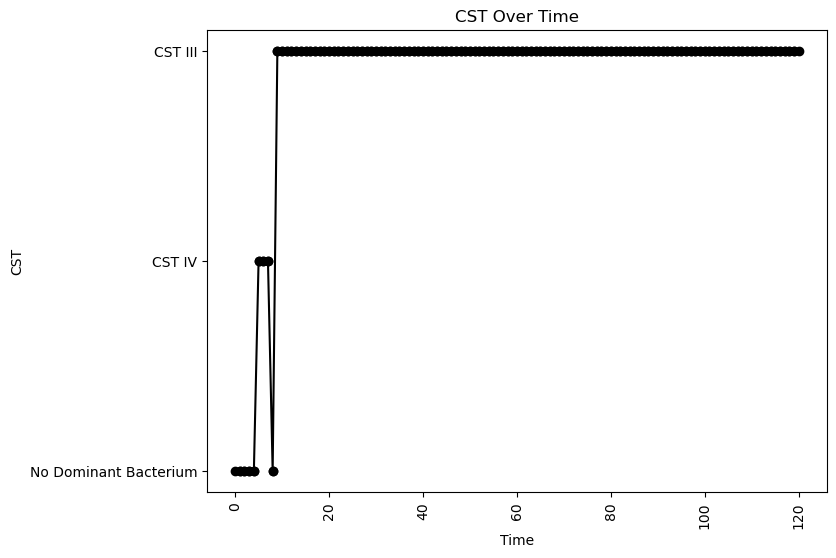


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.03643163604337152
nAB->Li: -0.017056455547112215
nAB->oLB: -0.4186247095201309
Li->nAB: 0.3204192627181933
Li Self: -0.02133597310426219
Li->oLB: -0.39409801282347323
oLB->nAB: -0.17376936488539013
oLB->Li: -0.41353554316163516
oLB Self: -0.07593619892954978

Simulation 7766 follows a valid CST progression:


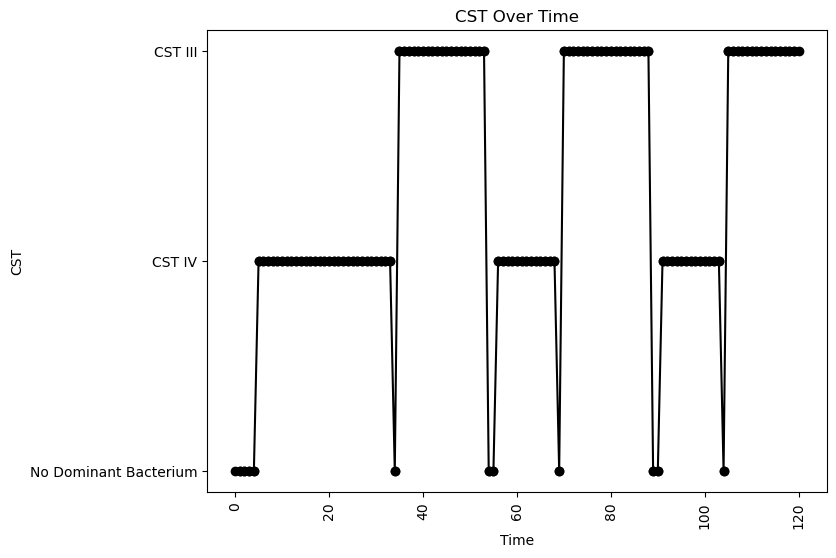


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.07166233835633987
nAB->Li: -0.38676342418969223
nAB->oLB: -0.23143447087335584
Li->nAB: 0.005343389319756531
Li Self: -0.062389251821539204
Li->oLB: 0.08617424012297248
oLB->nAB: -0.3543100318559837
oLB->Li: -0.11935823418394059
oLB Self: -0.029185631141808666

Simulation 7771 follows a valid CST progression:


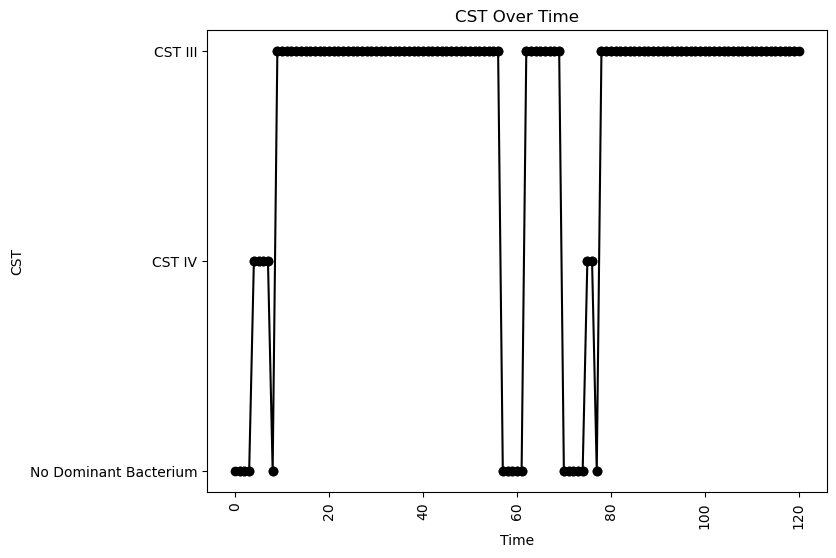


Interaction Parameters:
nAB Growth: 2.2446146183745257
Li Growth: 0.18304544174293555
oLB Growth: 0.5438660619757455
nAB Self: -0.05396083547029899
nAB->Li: -0.22641445123263598
nAB->oLB: -0.16963929531746025
Li->nAB: 0.09439537143563181
Li Self: -0.053493362745482484
Li->oLB: -0.3676475066323108
oLB->nAB: -0.1709921092096242
oLB->Li: -0.0434764421999031
oLB Self: -0.04391798542434837

Simulation 7778 follows a valid CST progression:


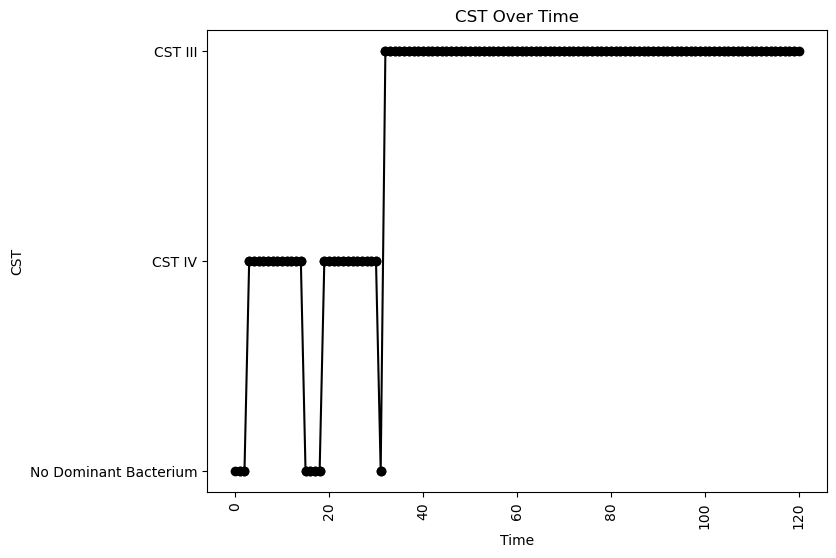


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.15327249946669497
oLB Growth: 0.1368234058063315
nAB Self: -0.024633337934212518
nAB->Li: -0.23318677394367737
nAB->oLB: -0.08167476593154477
Li->nAB: 0.008187786265532515
Li Self: -0.03734711558871642
Li->oLB: -0.22062846255928403
oLB->nAB: -0.23893836815512765
oLB->Li: -0.29086960873318557
oLB Self: -0.09483654326369378

Simulation 7779 follows a valid CST progression:


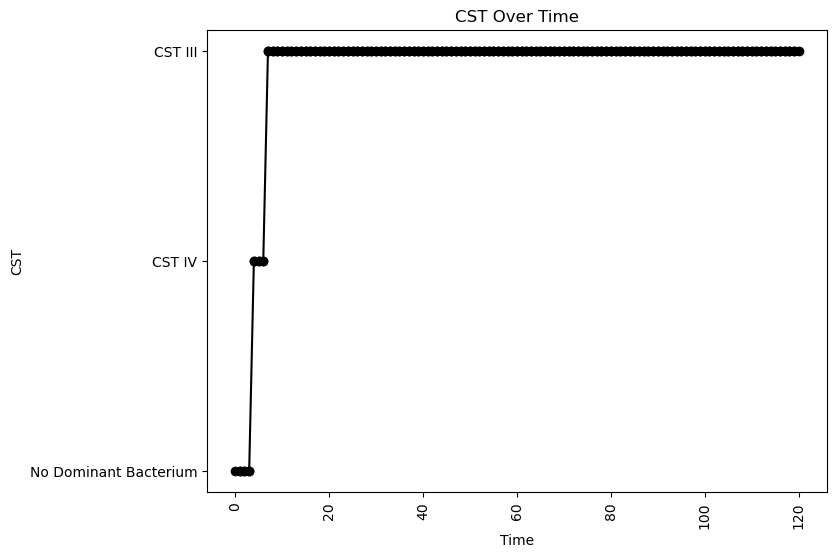


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.01826855783723197
nAB->Li: 0.05710259890613589
nAB->oLB: -0.4854954062989367
Li->nAB: 0.18931511749606678
Li Self: -0.007844774723570924
Li->oLB: -0.014715945390871732
oLB->nAB: -0.36477189339115335
oLB->Li: 0.013685882979929453
oLB Self: -0.012719208483387576

Simulation 7782 follows a valid CST progression:


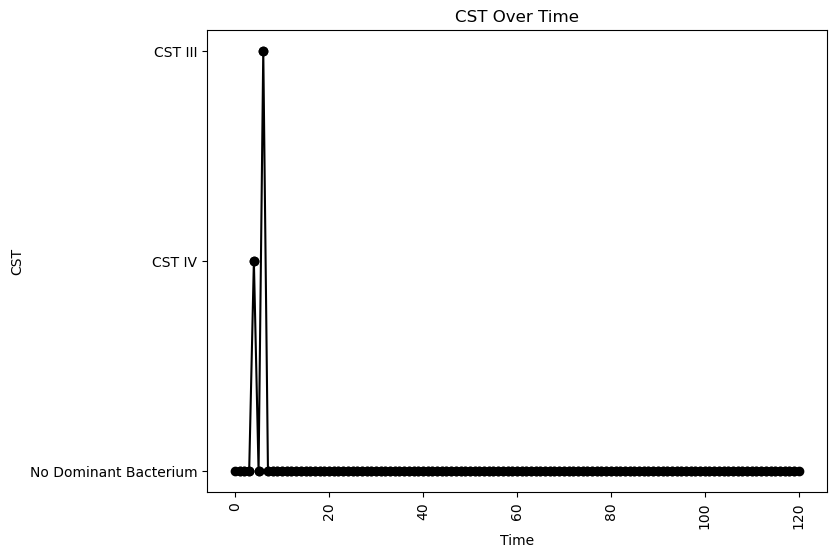


Interaction Parameters:
nAB Growth: 2.2446146183745257
Li Growth: 0.07278030322941353
oLB Growth: 0.5438660619757455
nAB Self: -0.014376938978776427
nAB->Li: -0.14681290740292258
nAB->oLB: -0.2746350543103705
Li->nAB: 0.40562819027106656
Li Self: -0.019034634513714538
Li->oLB: 0.34935376727580625
oLB->nAB: -0.3355178996858672
oLB->Li: 0.28613678997542635
oLB Self: -0.08099233149200645

Simulation 7784 follows a valid CST progression:


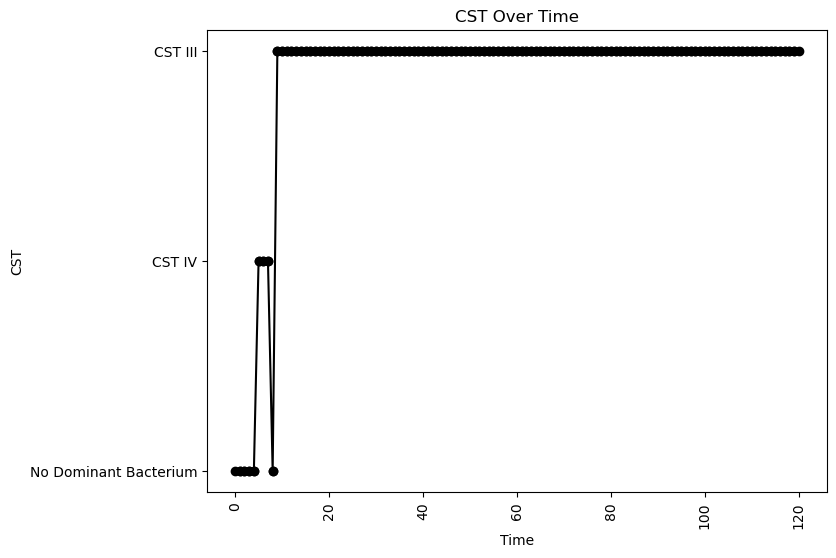


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.09519696448301171
nAB->Li: -0.2238931015380871
nAB->oLB: -0.39421774128428444
Li->nAB: 0.4275483555413643
Li Self: -0.08672003909894838
Li->oLB: 0.09002132395222229
oLB->nAB: -0.34937335798793717
oLB->Li: -0.40212023299033517
oLB Self: -0.013606691709477994

Simulation 7789 follows a valid CST progression:


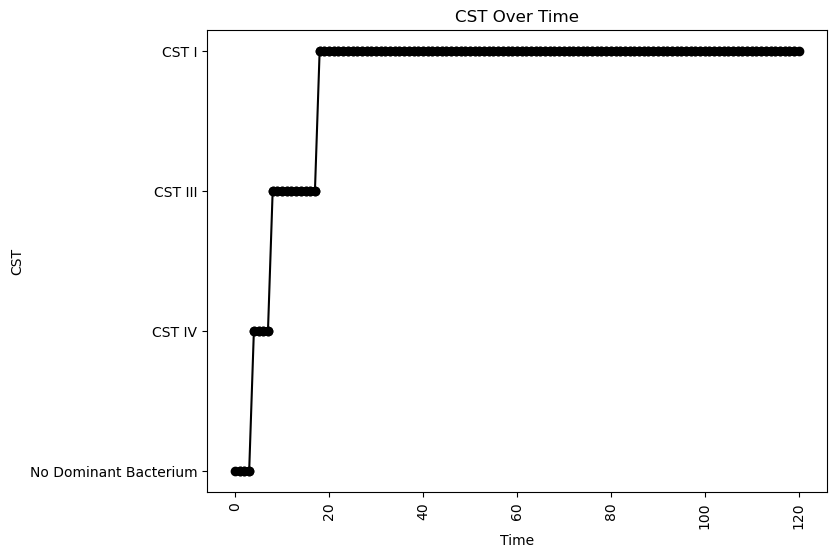


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.0019353149754747917
nAB->Li: -0.3960977401811453
nAB->oLB: -0.33834696128201186
Li->nAB: 0.16669035864400283
Li Self: -0.04047995017645461
Li->oLB: -0.37047923678869266
oLB->nAB: -0.09832561444712451
oLB->Li: 0.06646972675395468
oLB Self: -0.06920988821261875

Simulation 7791 follows a valid CST progression:


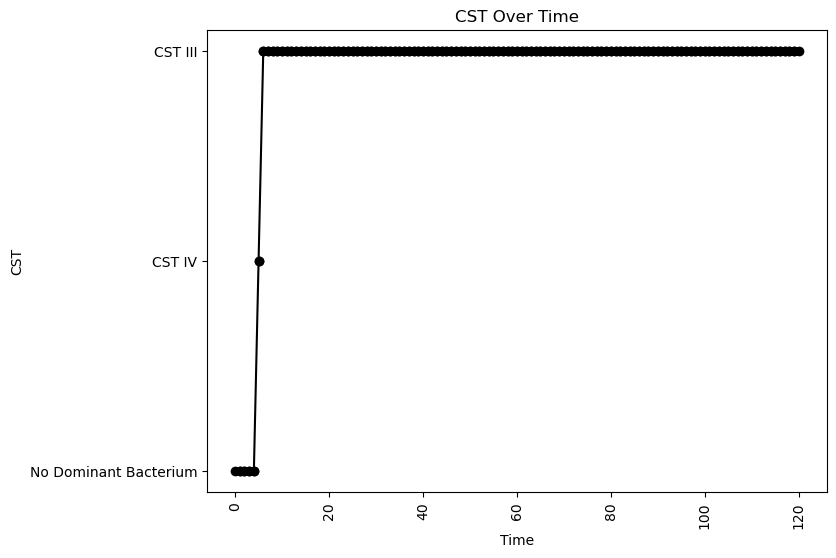


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.0040204514776036315
nAB->Li: 0.11258057448651293
nAB->oLB: -0.44811698011907203
Li->nAB: 0.41480822551313457
Li Self: -0.06649266122100717
Li->oLB: 0.45522832385593914
oLB->nAB: -0.20541960062982906
oLB->Li: -0.24638250643938048
oLB Self: -0.09285958410606503

Simulation 7792 follows a valid CST progression:


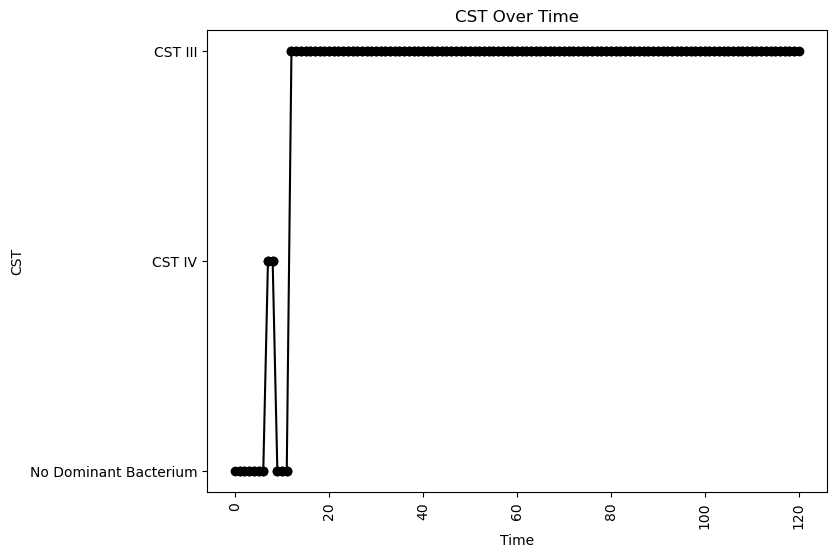


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.2687113022252127
oLB Growth: 0.9128027925042091
nAB Self: -0.04535887677017539
nAB->Li: -0.015397171533989895
nAB->oLB: -0.4432576396015039
Li->nAB: 0.04049292327941356
Li Self: -0.029693925970789542
Li->oLB: 0.43845991971118714
oLB->nAB: -0.4181860283692013
oLB->Li: 0.07785891444791437
oLB Self: -0.007170298315083562

Simulation 7793 follows a valid CST progression:


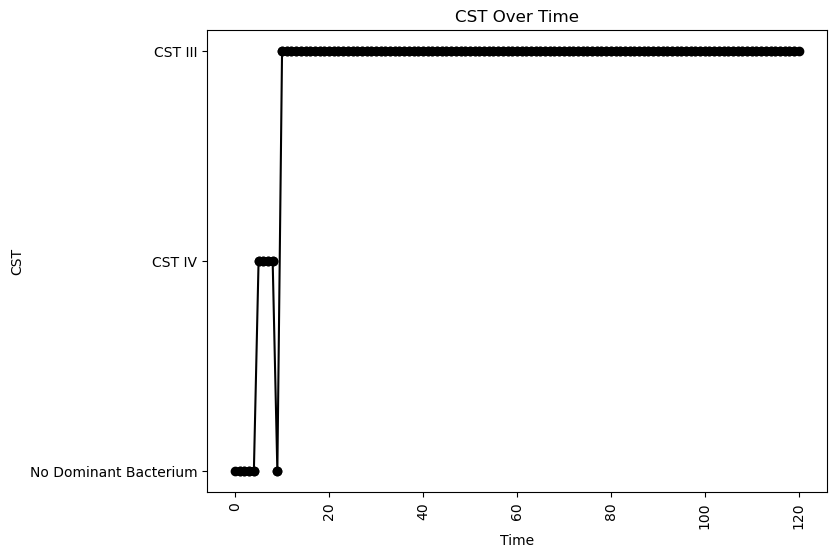


Interaction Parameters:
nAB Growth: 2.0745101401728236
Li Growth: 0.010341045972876578
oLB Growth: 1.1507970527071554
nAB Self: -0.043229585022267966
nAB->Li: 0.12069316819052844
nAB->oLB: -0.44826266850239893
Li->nAB: 0.29810795910579846
Li Self: -0.02322803310897517
Li->oLB: -0.22731614477721157
oLB->nAB: -0.1019844757134758
oLB->Li: -0.23328103359126995
oLB Self: -0.03904758300224279

Simulation 7795 follows a valid CST progression:


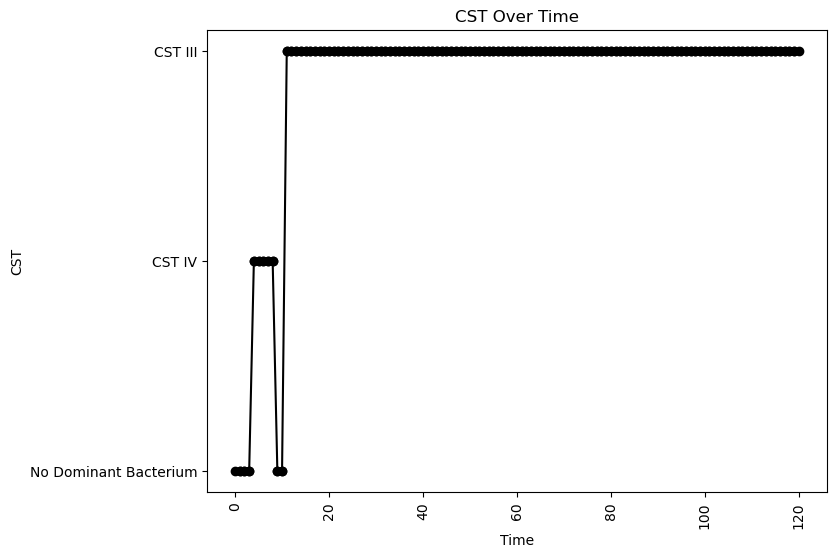


Interaction Parameters:
nAB Growth: 2.2002663828262317
Li Growth: 0.07280454274860512
oLB Growth: 0.7629459891785437
nAB Self: -0.04607699991907139
nAB->Li: -0.3907542118261683
nAB->oLB: -0.11635528179018889
Li->nAB: 0.08425809742438406
Li Self: -0.010027854169475811
Li->oLB: 0.2607347295959208
oLB->nAB: -0.37795477121108495
oLB->Li: -0.09918481120563089
oLB Self: -0.029379649803078806

Simulation 7799 follows a valid CST progression:


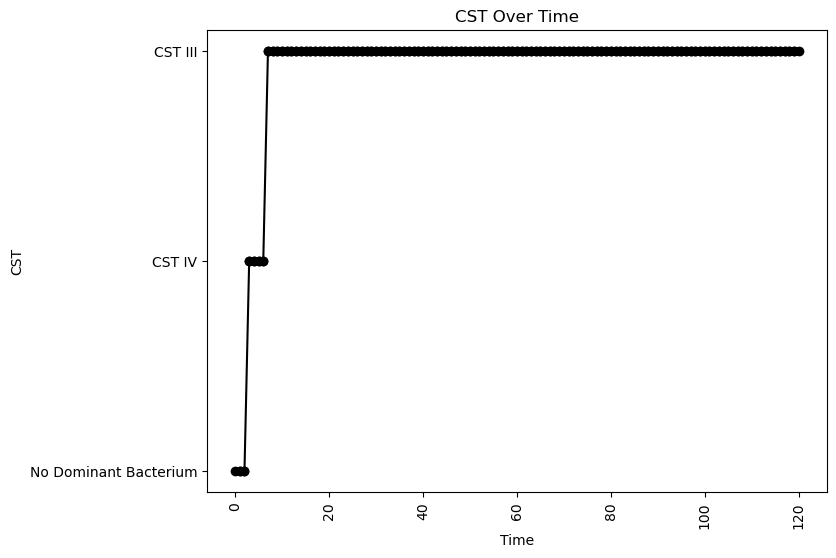


Interaction Parameters:
nAB Growth: 2.226251684223429
Li Growth: 0.0760937960697033
oLB Growth: 0.4505921706771102
nAB Self: -0.09247118870087835
nAB->Li: 0.17779124812470837
nAB->oLB: -0.20638239867398184
Li->nAB: 0.3538668082708315
Li Self: -0.03635549178641975
Li->oLB: -0.3227828606549973
oLB->nAB: -0.1348821618891653
oLB->Li: -0.3769726210604558
oLB Self: -0.08886631580304874

Simulation 7813 follows a valid CST progression:


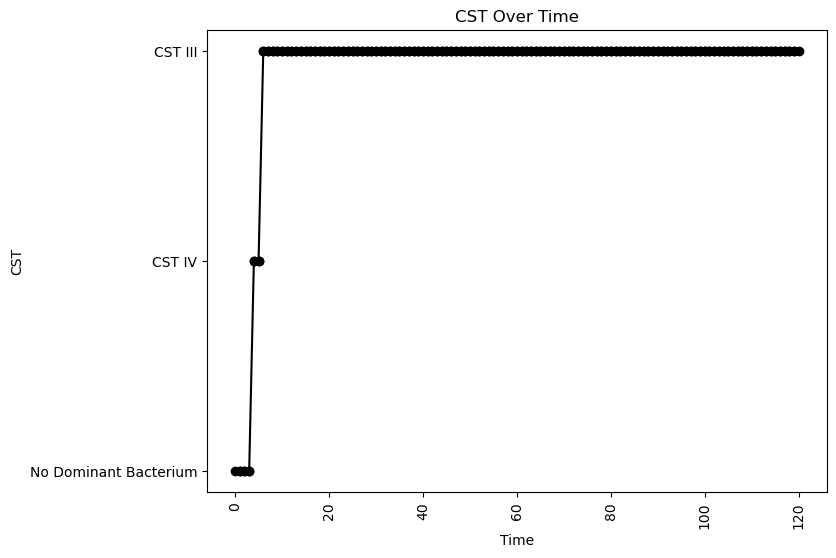


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.05611393925202071
nAB->Li: 0.18854853301235563
nAB->oLB: -0.007959427784665685
Li->nAB: 0.4341644664241232
Li Self: -0.09201125657966026
Li->oLB: 0.18496602309077792
oLB->nAB: -0.19493044408602528
oLB->Li: 0.0643079186461969
oLB Self: -0.03563410403265391

Simulation 7815 follows a valid CST progression:


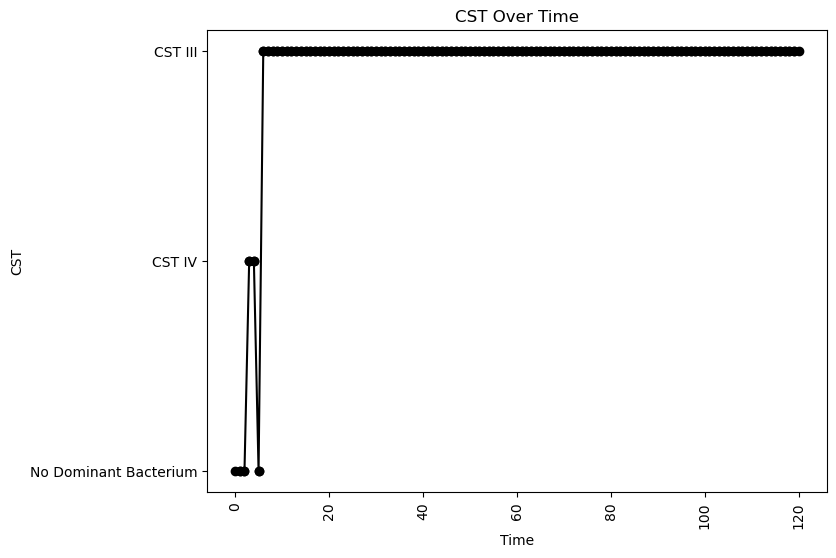


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.02959597942592128
nAB->Li: -0.3270252391956622
nAB->oLB: -0.20334466073657675
Li->nAB: 0.33868594452834466
Li Self: -0.07407478838481132
Li->oLB: -0.03335202643009383
oLB->nAB: -0.39853644374188735
oLB->Li: -0.15808382339669674
oLB Self: -0.07670130339734614

Simulation 7826 follows a valid CST progression:


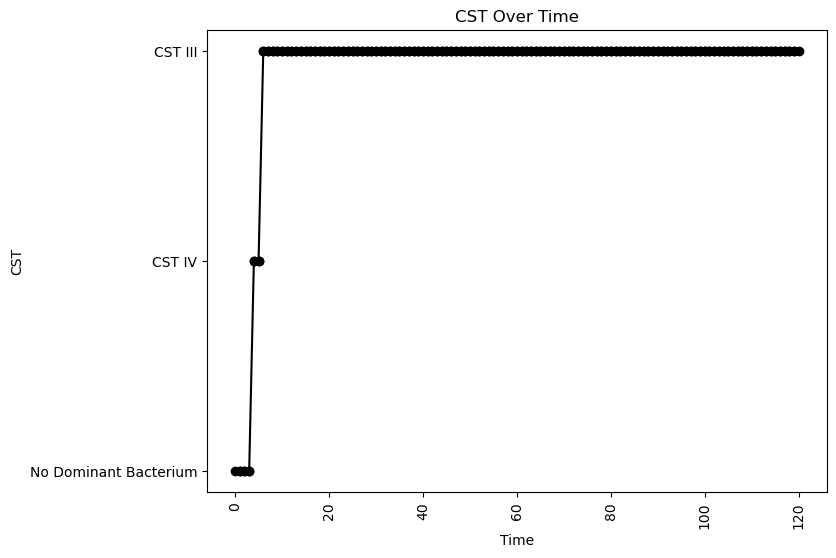


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.06588260315658048
oLB Growth: 0.21113539622386296
nAB Self: -0.0968358560327568
nAB->Li: -0.032778806428050145
nAB->oLB: -0.1017770904702171
Li->nAB: 0.41158936962530523
Li Self: -0.0157381921179352
Li->oLB: 0.4778969346383648
oLB->nAB: -0.0645125010765677
oLB->Li: -0.0336308532510326
oLB Self: -0.09700437705373453

Simulation 7835 follows a valid CST progression:


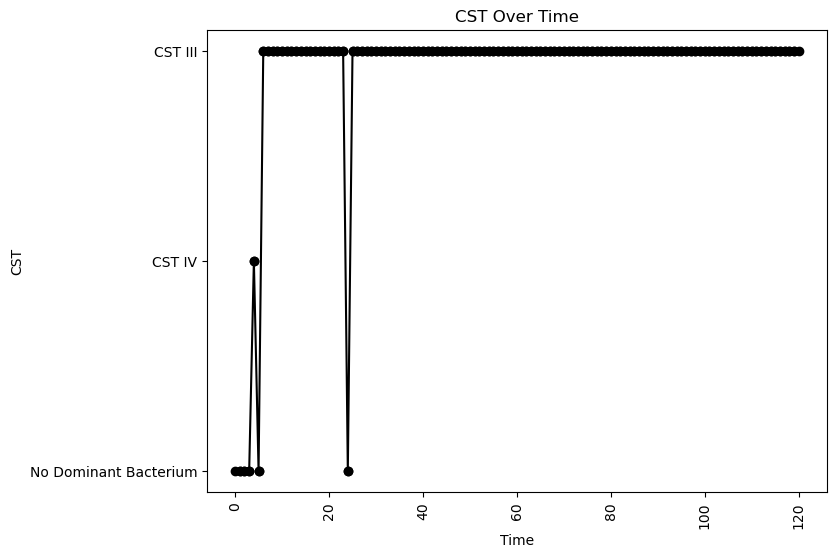


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.0928477946322044
nAB->Li: -0.21646150887709215
nAB->oLB: -0.28716763443167814
Li->nAB: 0.49265531807261476
Li Self: -0.05476483632474976
Li->oLB: 0.14191553206752971
oLB->nAB: -0.09337767456347795
oLB->Li: -0.0013464470775895743
oLB Self: -0.023270508199021836

Simulation 7842 follows a valid CST progression:


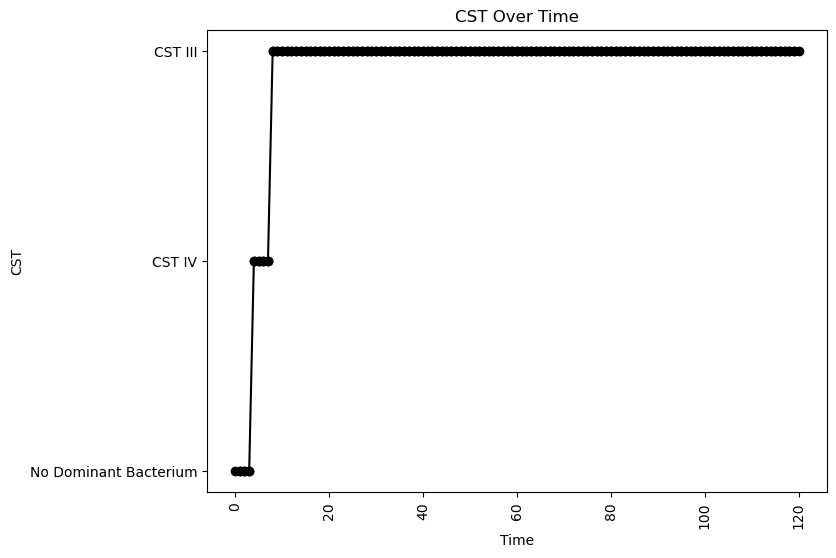


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.06664492138468138
oLB Growth: 0.6588037441195057
nAB Self: -0.009196862715947815
nAB->Li: -0.020186748246705966
nAB->oLB: -0.3052230085922175
Li->nAB: 0.12013247718912567
Li Self: -0.06910231925570921
Li->oLB: -0.02071659694457123
oLB->nAB: -0.27144926852068463
oLB->Li: -0.43206144004734065
oLB Self: -0.04346889411687904

Simulation 7843 follows a valid CST progression:


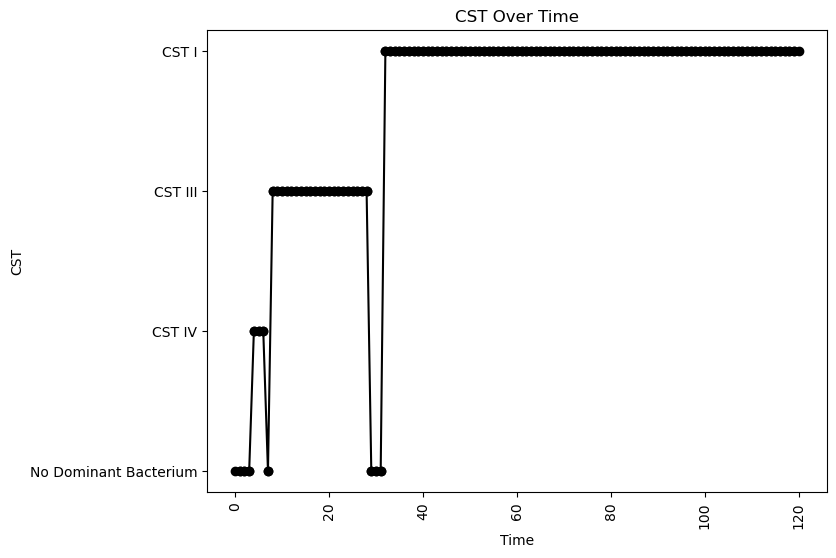


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.02716346064334206
nAB->Li: -0.3513678284241129
nAB->oLB: -0.23080589387559708
Li->nAB: 0.255172723117702
Li Self: -0.09104761918269763
Li->oLB: -0.35662583272004744
oLB->nAB: -0.130503270190992
oLB->Li: -0.005251998995555285
oLB Self: -0.006615257616697387

Simulation 7844 follows a valid CST progression:


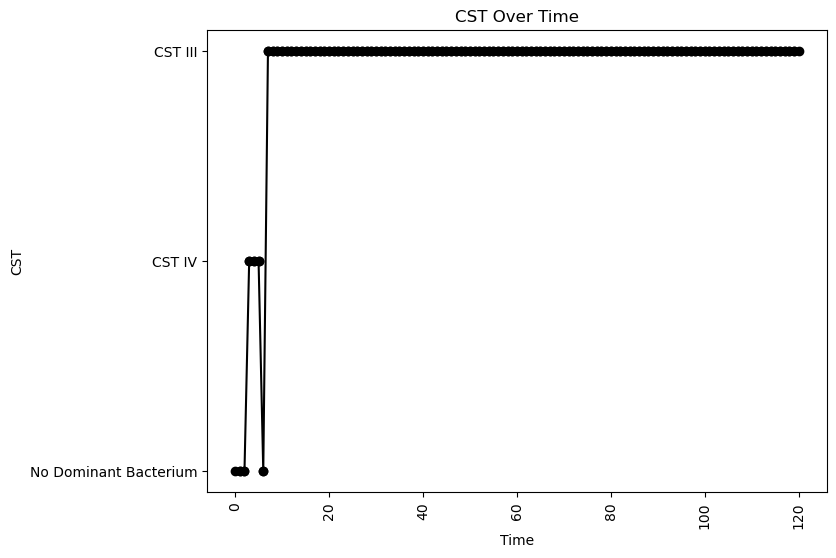


Interaction Parameters:
nAB Growth: 2.226251684223429
Li Growth: 0.0760937960697033
oLB Growth: 0.4505921706771102
nAB Self: -0.016495762768645672
nAB->Li: -0.15675225748318056
nAB->oLB: -0.10528774925888784
Li->nAB: 0.28821165364328494
Li Self: -0.06442344129285993
Li->oLB: -0.27720080828966737
oLB->nAB: -0.46902893810320334
oLB->Li: -0.1605237462548481
oLB Self: -0.07167212116426186

Simulation 7849 follows a valid CST progression:


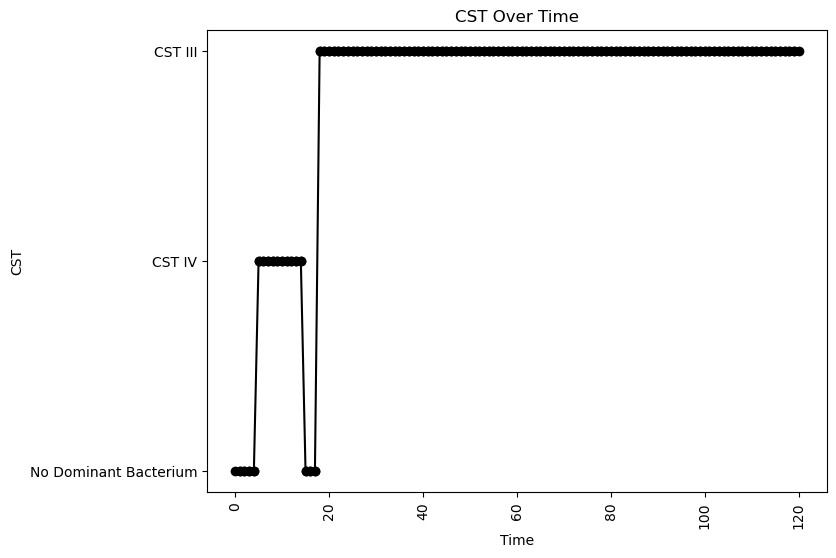


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.09367843366842087
nAB->Li: -0.2628656469908798
nAB->oLB: -0.42849470242184395
Li->nAB: 0.020714035603397907
Li Self: -0.0012278049862359114
Li->oLB: -0.09944168717697832
oLB->nAB: -0.06380727284356735
oLB->Li: -0.1380457988467294
oLB Self: -0.07793555538303841

Simulation 7852 follows a valid CST progression:


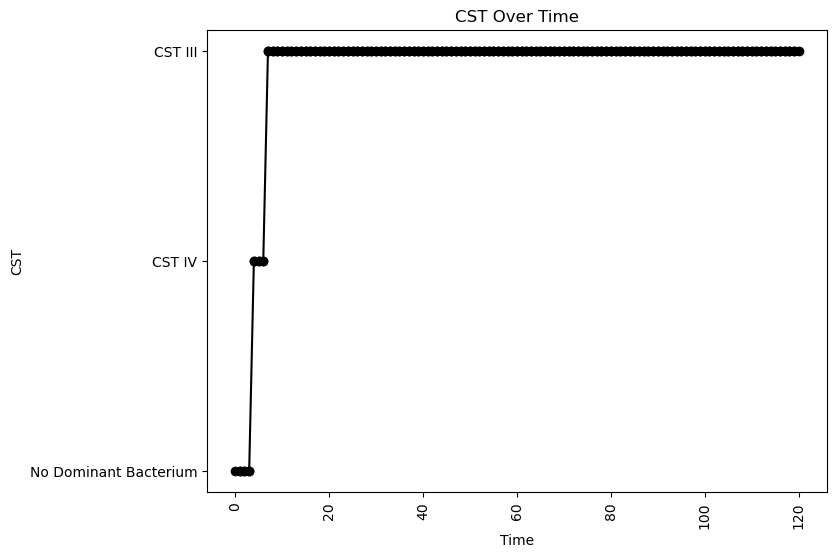


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.034466988269053644
nAB->Li: -0.33215506248079973
nAB->oLB: -0.39090454630739707
Li->nAB: 0.23829838268153947
Li Self: -0.028860672849953722
Li->oLB: 0.0972733176634819
oLB->nAB: -0.17520814704537668
oLB->Li: -0.4839665264724113
oLB Self: -0.01166331435501193

Simulation 7854 follows a valid CST progression:


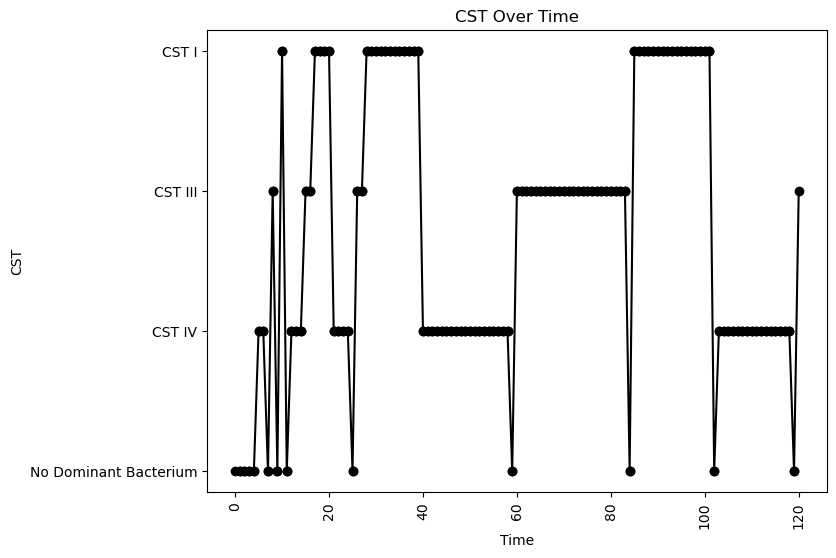


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.13374422632440314
oLB Growth: 0.08496126009849418
nAB Self: -0.09360557231620548
nAB->Li: -0.21915271194590913
nAB->oLB: -0.07212367484718946
Li->nAB: 0.2084915997125456
Li Self: -0.039319762470362195
Li->oLB: -0.33391931984118745
oLB->nAB: -0.3935868116540346
oLB->Li: 0.4231917546019446
oLB Self: -0.0406450157807094

Simulation 7856 follows a valid CST progression:


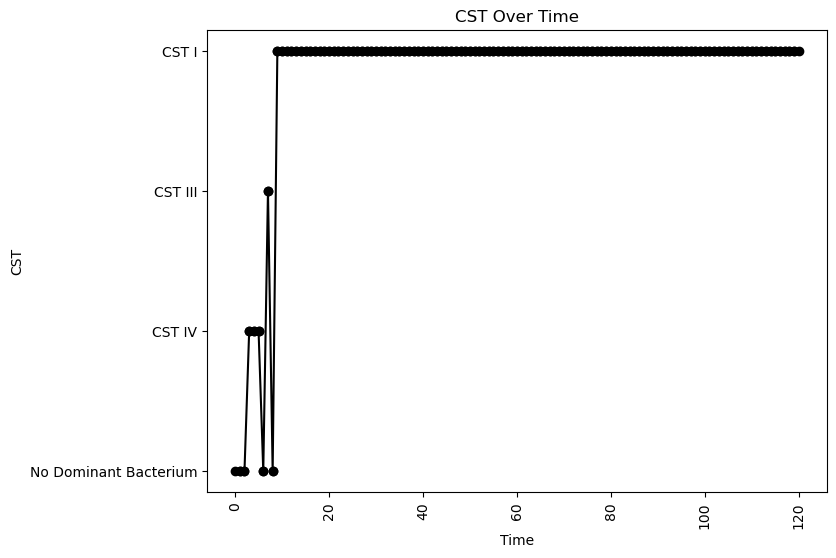


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.023956553364523042
nAB->Li: -0.41552492641558125
nAB->oLB: -0.4814205414359649
Li->nAB: 0.28191773391579544
Li Self: -0.0538396219330721
Li->oLB: 0.23554157542804965
oLB->nAB: -0.186505292491621
oLB->Li: 0.34621140298664976
oLB Self: -0.012658920185317224

Simulation 7858 follows a valid CST progression:


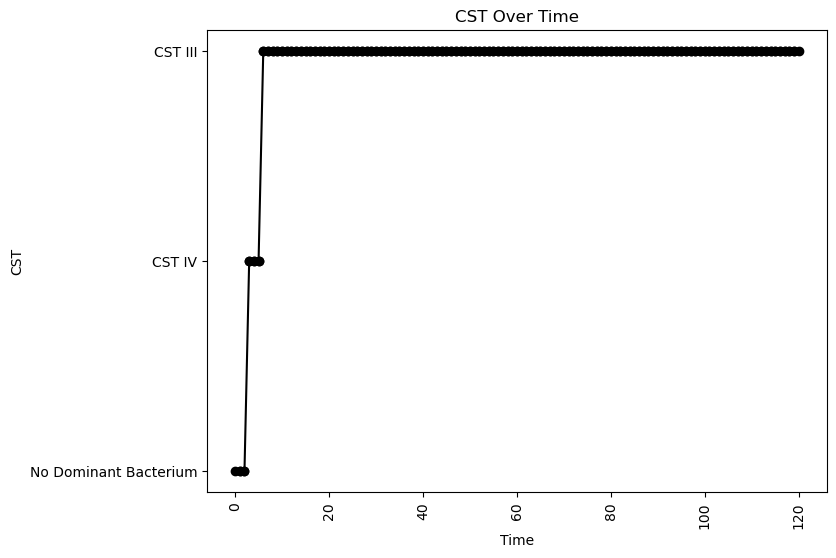


Interaction Parameters:
nAB Growth: 2.2088016144568243
Li Growth: 0.05268768924856952
oLB Growth: 1.1274304047774089
nAB Self: -0.010804333514654221
nAB->Li: 0.19359768901066776
nAB->oLB: -0.3168266664173185
Li->nAB: 0.4728758594054845
Li Self: -0.07337627417387024
Li->oLB: -0.02839328154892984
oLB->nAB: -0.33686418088558756
oLB->Li: -0.25447966724249826
oLB Self: -0.010263345585643444

Simulation 7862 follows a valid CST progression:


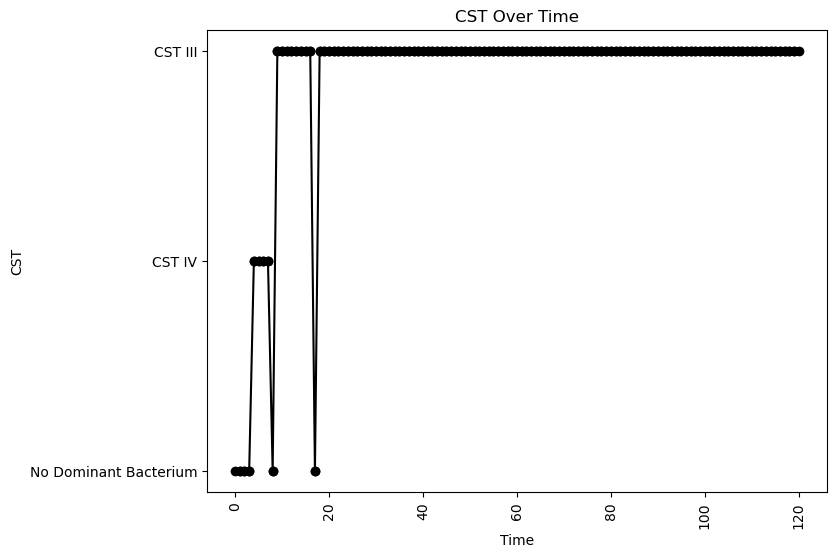


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.06588260315658048
oLB Growth: 0.21113539622386296
nAB Self: -0.03756082117061802
nAB->Li: -0.3502321276483362
nAB->oLB: -0.166497088278785
Li->nAB: 0.0976923203141683
Li Self: -0.055959671286517014
Li->oLB: 0.21114122696247595
oLB->nAB: -0.0590846245438752
oLB->Li: 0.11681673592391906
oLB Self: -0.06445774684394909

Simulation 7873 follows a valid CST progression:


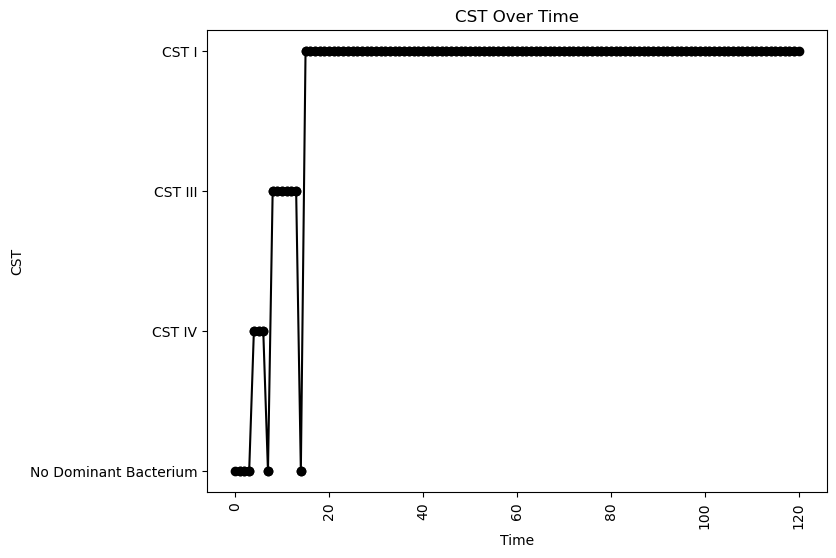


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.20948039073570418
oLB Growth: 0.20414555748463747
nAB Self: -0.08501610230438995
nAB->Li: -0.018184211843135623
nAB->oLB: -0.44125712599694833
Li->nAB: 0.14691295275291905
Li Self: -0.08489408794252101
Li->oLB: 0.035222641391044696
oLB->nAB: -0.2208766286616472
oLB->Li: 0.16382413311660293
oLB Self: -0.013474468993925959

Simulation 7880 follows a valid CST progression:


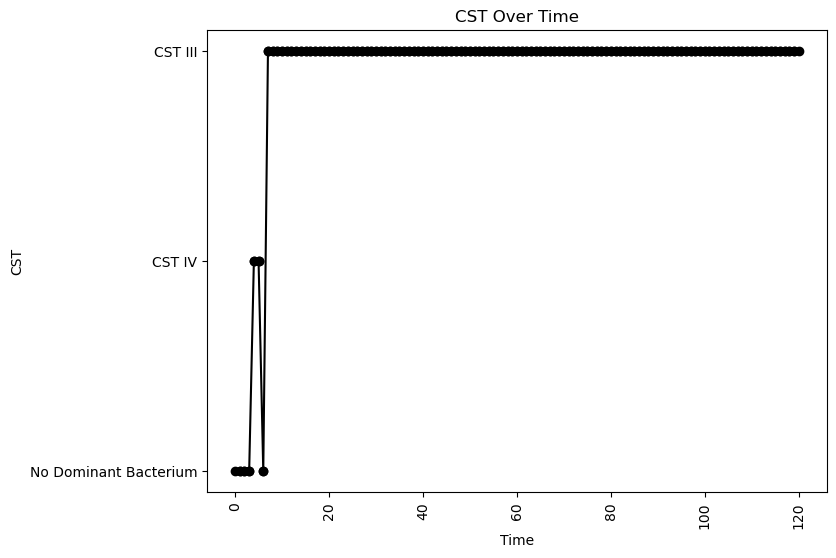


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.08753208841318393
nAB->Li: 0.013593821600076272
nAB->oLB: -0.06596865385264616
Li->nAB: 0.2285037638896219
Li Self: -0.06240387877309544
Li->oLB: 0.36826452695632506
oLB->nAB: -0.32227827871616177
oLB->Li: -0.08208252834595053
oLB Self: -0.09617308480111711

Simulation 7887 follows a valid CST progression:


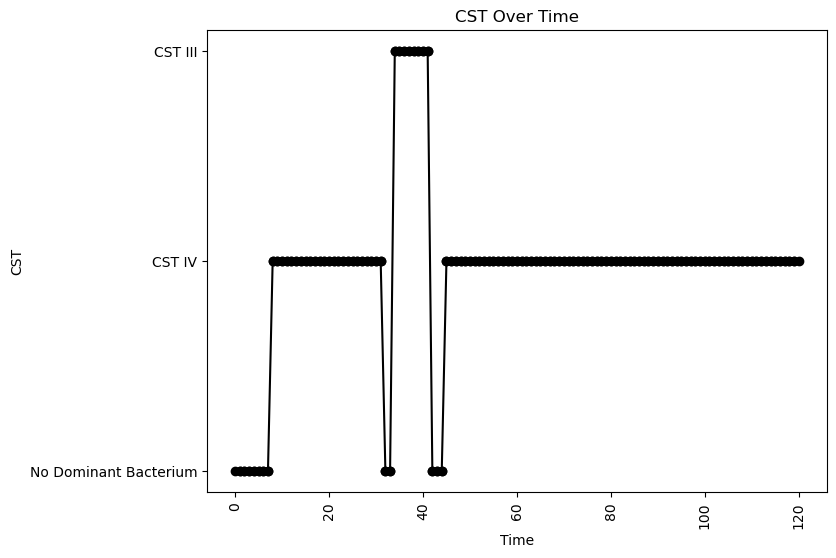


Interaction Parameters:
nAB Growth: 2.172057972480792
Li Growth: 0.05464936187495586
oLB Growth: 1.1816194682992254
nAB Self: -0.06782951995441412
nAB->Li: -0.2065235117172891
nAB->oLB: -0.36120164268442023
Li->nAB: -0.0033802468879439718
Li Self: -0.06801619296867809
Li->oLB: 0.36042148082848147
oLB->nAB: -0.4670246339901425
oLB->Li: 0.24699258944233282
oLB Self: -0.040367582934620186

Simulation 7896 follows a valid CST progression:


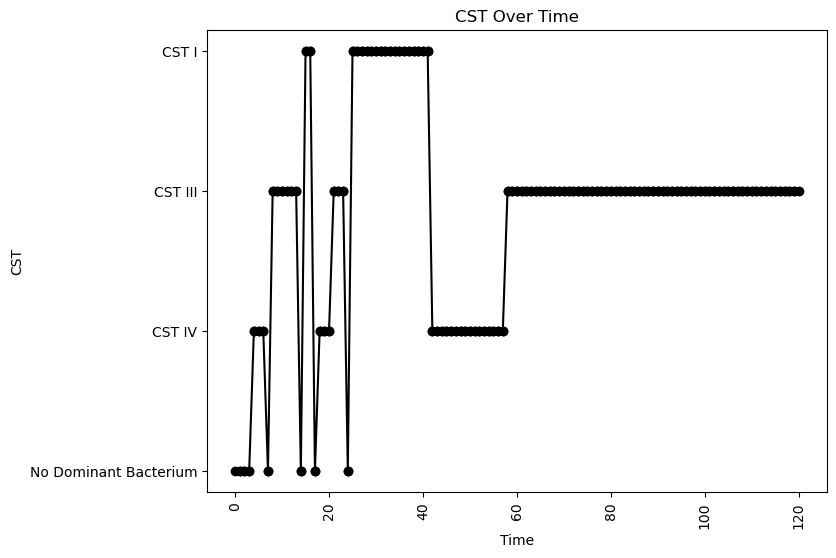


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.048658234545432257
nAB->Li: -0.4258664367039729
nAB->oLB: -0.07624795048128441
Li->nAB: 0.2897820964370912
Li Self: -0.04005080709225024
Li->oLB: -0.47332978535421155
oLB->nAB: -0.42545657120484304
oLB->Li: 0.22122171925904832
oLB Self: -0.04235915537440819

Simulation 8846 follows a valid CST progression:


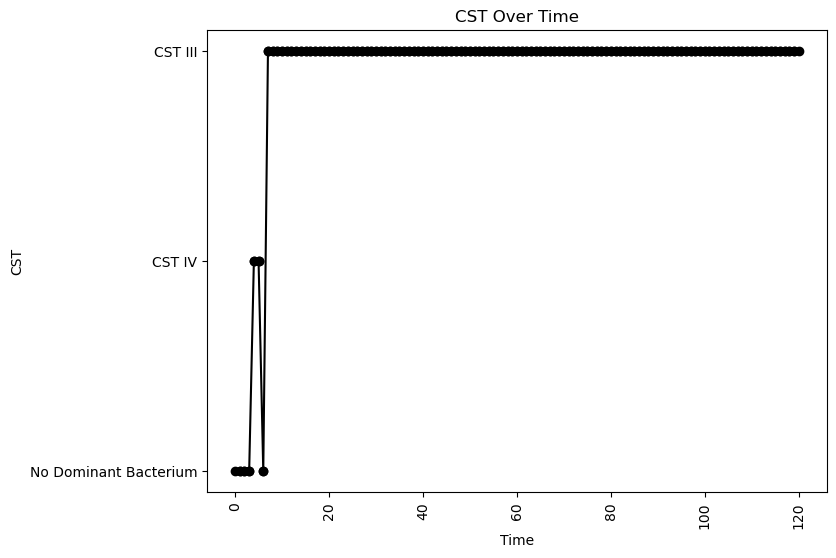


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.07250276278187429
nAB->Li: -0.36248773990091404
nAB->oLB: -0.4703498719897526
Li->nAB: 0.3541427722996615
Li Self: -0.02132178322187321
Li->oLB: 0.4962852761226777
oLB->nAB: -0.17339052570566615
oLB->Li: -0.3500384500078603
oLB Self: -0.03057233455326938

Simulation 8849 follows a valid CST progression:


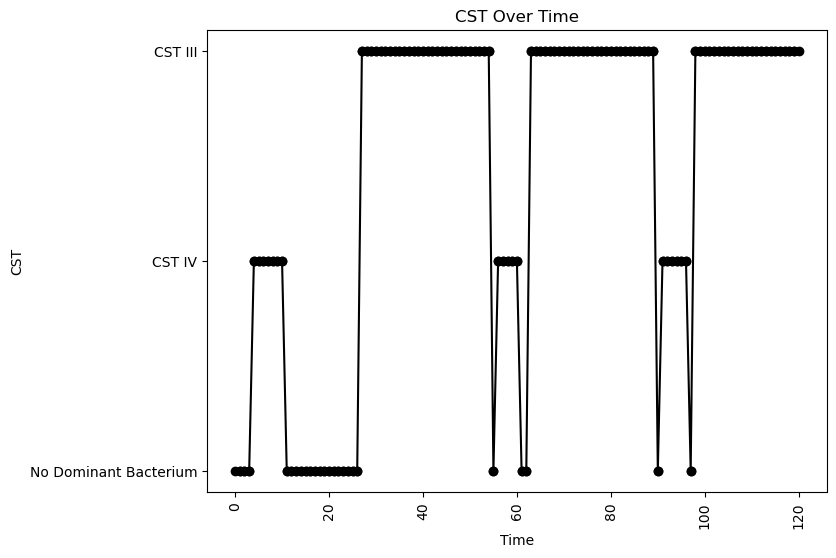


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.06957344737070068
nAB->Li: -0.3901413886041015
nAB->oLB: -0.3430769357285442
Li->nAB: 0.05298107152996012
Li Self: -0.08005414784278976
Li->oLB: 0.19177302499371152
oLB->nAB: -0.48209027102855384
oLB->Li: 0.048385768922849515
oLB Self: -0.00806906015253149

Simulation 8850 follows a valid CST progression:


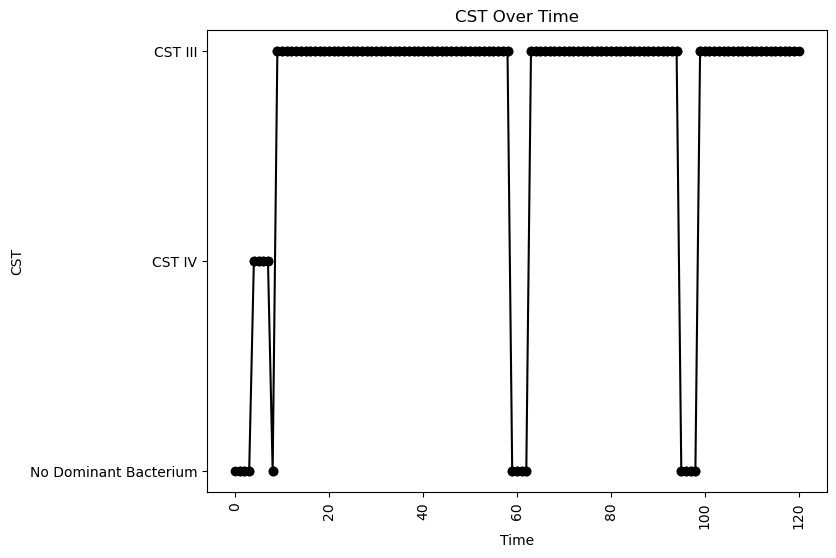


Interaction Parameters:
nAB Growth: 2.300652803872004
Li Growth: 0.06616501714537036
oLB Growth: 0.4369767544558836
nAB Self: -0.04460918639795453
nAB->Li: -0.3986320720813116
nAB->oLB: -0.36884829560854826
Li->nAB: 0.17073543874919317
Li Self: -0.07402045293974394
Li->oLB: 0.3616514304331012
oLB->nAB: -0.29410725250514147
oLB->Li: -0.3677545349929457
oLB Self: -0.03963632702194703

Simulation 8853 follows a valid CST progression:


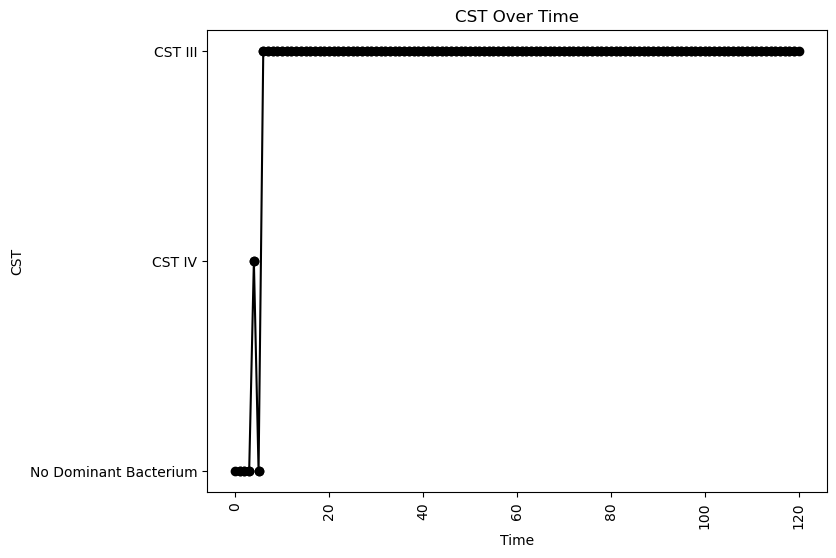


Interaction Parameters:
nAB Growth: 2.273308423784788
Li Growth: 0.06939466945066827
oLB Growth: 0.4879467602516997
nAB Self: -0.006688464723250673
nAB->Li: -0.04506655246077046
nAB->oLB: -0.2413675826126186
Li->nAB: 0.4386606051198433
Li Self: -0.07795245977635941
Li->oLB: -0.1960056646578242
oLB->nAB: -0.38978879785704135
oLB->Li: 0.03600805161169607
oLB Self: -0.0520098559495525

Simulation 8856 follows a valid CST progression:


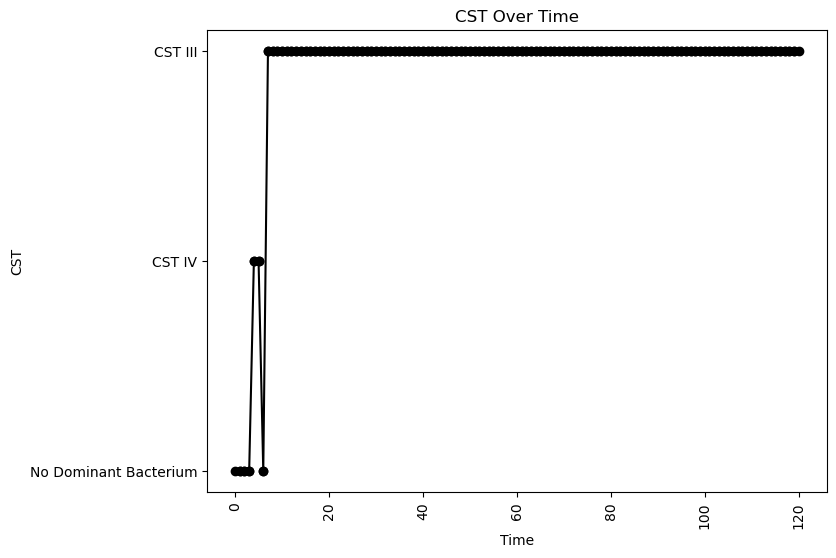


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.06668354846482004
nAB->Li: -0.017302994700753527
nAB->oLB: -0.42773152139269377
Li->nAB: 0.39906208473373617
Li Self: -0.06544176776573046
Li->oLB: -0.3847540531147725
oLB->nAB: -0.21807246455270823
oLB->Li: -0.07461687401011718
oLB Self: -0.01760980680079835

Simulation 8857 follows a valid CST progression:


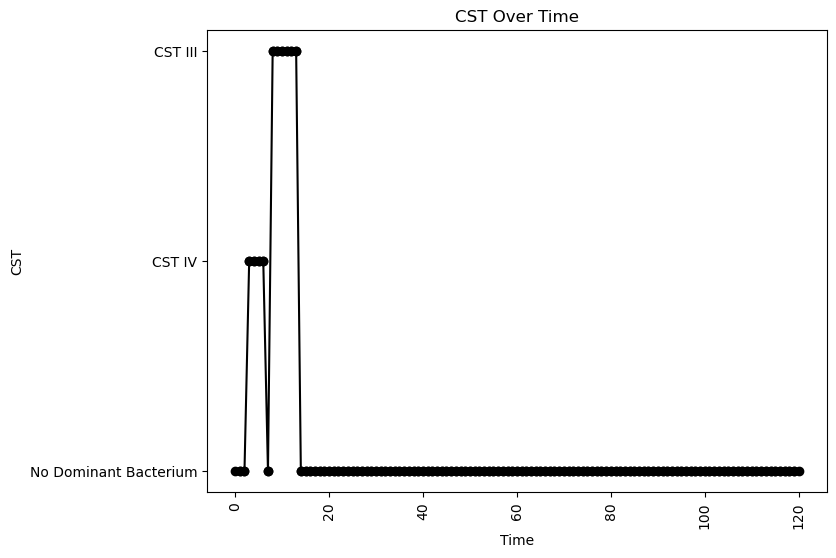


Interaction Parameters:
nAB Growth: 2.2446146183745257
Li Growth: 0.07278030322941353
oLB Growth: 0.5438660619757455
nAB Self: -0.0025474425385198646
nAB->Li: -0.39924379960134254
nAB->oLB: -0.03274589021042801
Li->nAB: 0.10560024494246523
Li Self: -0.06810598978361754
Li->oLB: 0.3845598802723881
oLB->nAB: -0.12780134897808548
oLB->Li: 0.2176778859394446
oLB Self: -0.011520825530385442

Simulation 8862 follows a valid CST progression:


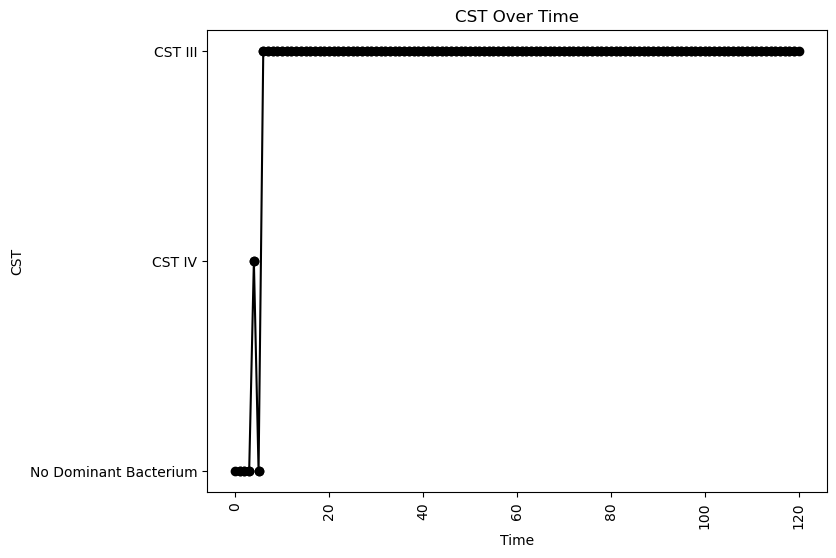


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.07627937410978657
nAB->Li: -0.3496163186745176
nAB->oLB: -0.03559707447045529
Li->nAB: 0.3787374524336683
Li Self: -0.05911158818078479
Li->oLB: 0.20719773887655657
oLB->nAB: -0.3902303436462152
oLB->Li: -0.1745742337420486
oLB Self: -0.005149247934646148

Simulation 8867 follows a valid CST progression:


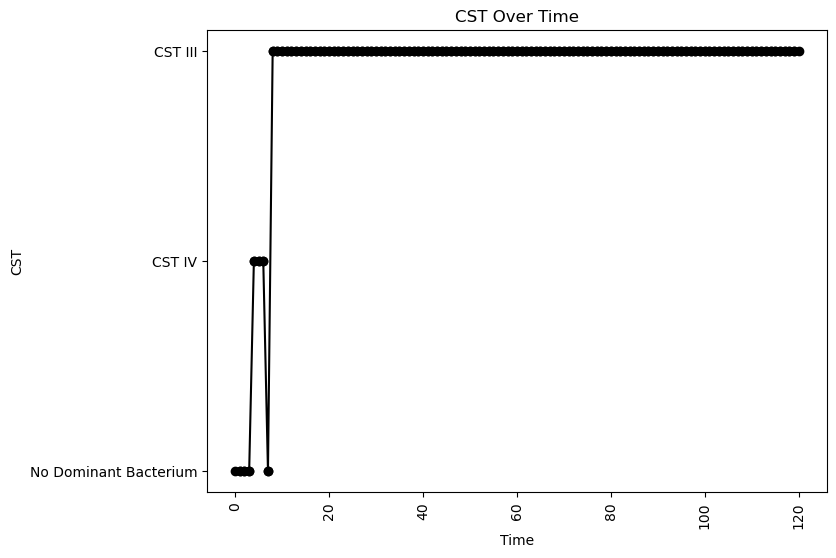


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.01787701338940567
nAB->Li: -0.3115915841244837
nAB->oLB: -0.04596886178805909
Li->nAB: 0.10899860063705658
Li Self: -0.0071633127214851405
Li->oLB: 0.4625930800413319
oLB->nAB: -0.07266707330505479
oLB->Li: 0.06687271349476387
oLB Self: -0.02000620086054293

Simulation 8869 follows a valid CST progression:


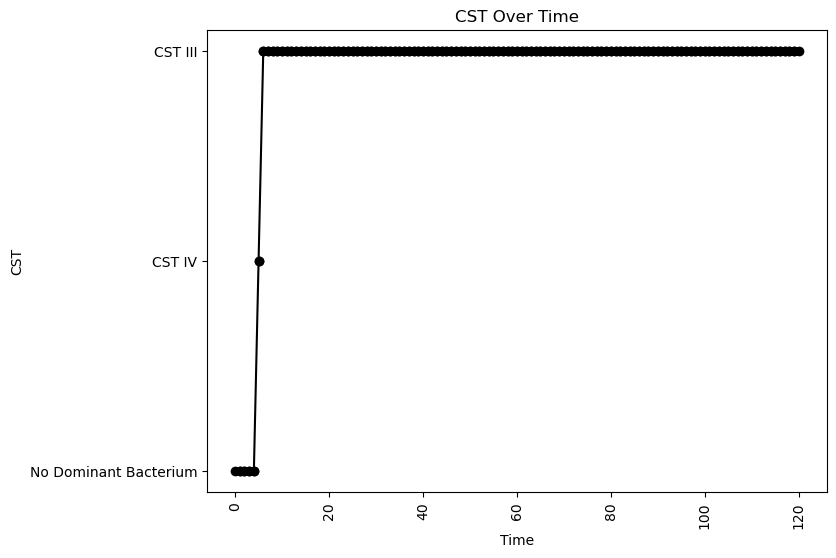


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.08315281014215659
nAB->Li: -0.15872686813231573
nAB->oLB: -0.422501329773749
Li->nAB: 0.30235202091982705
Li Self: -0.044083027051395746
Li->oLB: 0.2149576679252423
oLB->nAB: -0.3709224506054698
oLB->Li: -0.27372789952134985
oLB Self: -0.09355755590025265

Simulation 8872 follows a valid CST progression:


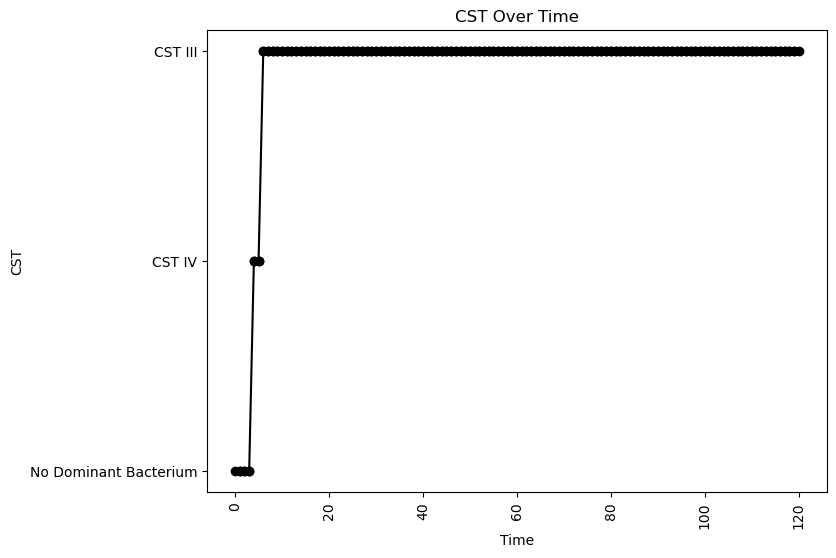


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.26109603281377525
oLB Growth: 1.0858755226067296
nAB Self: -0.08788563665474051
nAB->Li: -0.10883491735737294
nAB->oLB: -0.10127192930117135
Li->nAB: 0.26979876517912493
Li Self: -0.09023935262729749
Li->oLB: -0.4128394857251275
oLB->nAB: -0.10375844253562827
oLB->Li: -0.13191032708309736
oLB Self: -0.047004185227792296

Simulation 8880 follows a valid CST progression:


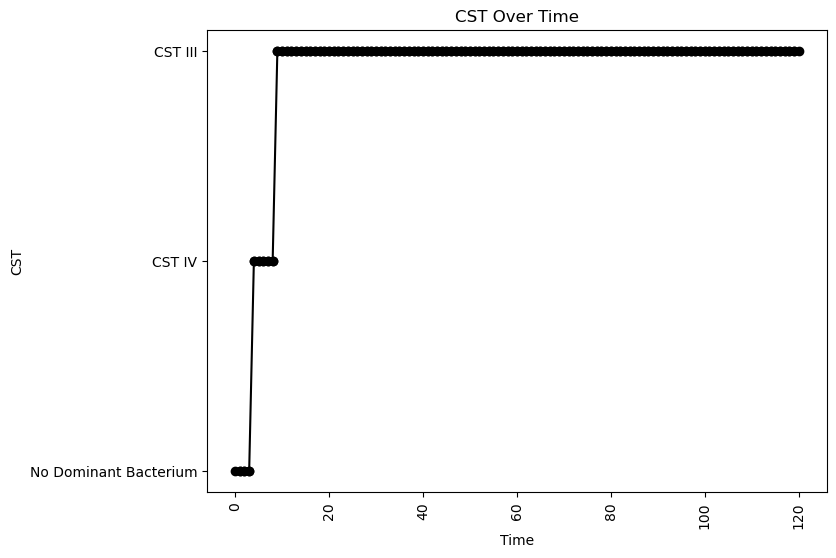


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.02198250861931282
nAB->Li: -0.3239489954212985
nAB->oLB: -0.42888406826661296
Li->nAB: 0.09364539389959203
Li Self: -0.013188648650015428
Li->oLB: -0.2763441665751303
oLB->nAB: -0.09934284511062969
oLB->Li: -0.19219254665000707
oLB Self: -0.0674120203632359

Simulation 8890 follows a valid CST progression:


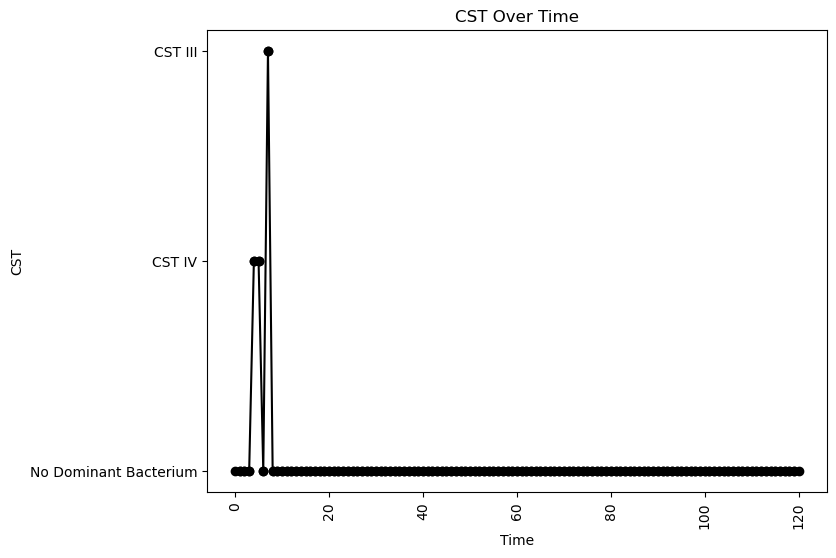


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.059436123891589886
nAB->Li: -0.044956979806132114
nAB->oLB: -0.27095948222229793
Li->nAB: 0.4677377256069938
Li Self: -0.09712195496808007
Li->oLB: 0.42822943003419345
oLB->nAB: -0.3375854354226382
oLB->Li: 0.3529241492002886
oLB Self: -0.05488204056634043

Simulation 8893 follows a valid CST progression:


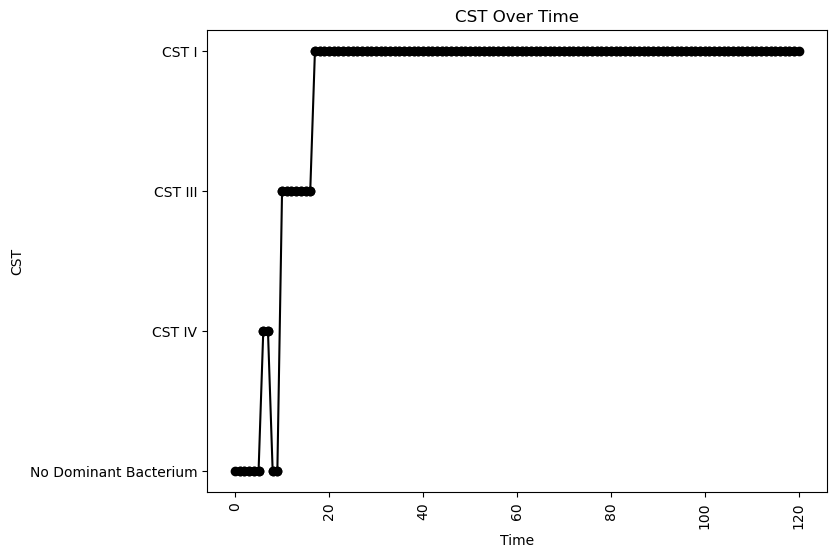


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.3134408365368208
oLB Growth: 0.6588037441195057
nAB Self: -0.07571523548496391
nAB->Li: -0.30305482980330134
nAB->oLB: -0.4989928426395353
Li->nAB: 0.06854383969878075
Li Self: -0.0272027978877383
Li->oLB: -0.46294274790842926
oLB->nAB: -0.376984122476373
oLB->Li: 0.164531550244837
oLB Self: -0.07288930755976125

Simulation 8901 follows a valid CST progression:


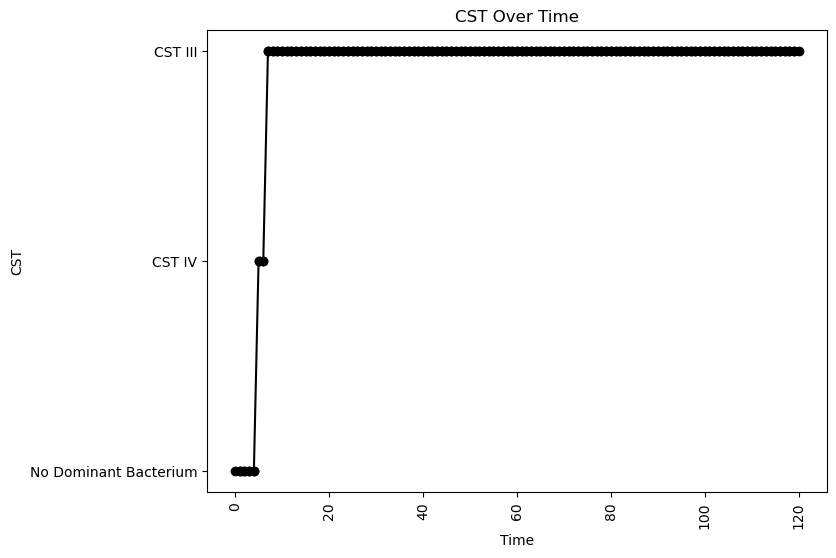


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.022120594292336038
nAB->Li: -0.0546315092470957
nAB->oLB: -0.38570432786320796
Li->nAB: 0.1940855052567284
Li Self: -0.016074612581924913
Li->oLB: 0.3401790319802027
oLB->nAB: -0.43592916594906883
oLB->Li: -0.40999697142383473
oLB Self: -0.08341372059518593

Simulation 8906 follows a valid CST progression:


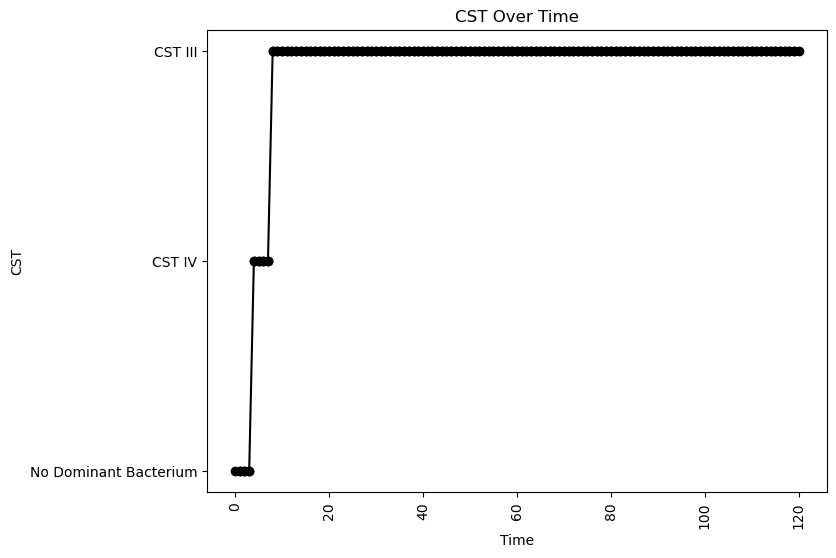


Interaction Parameters:
nAB Growth: 2.2609282147211935
Li Growth: 0.06381435834914458
oLB Growth: 0.1660151901294062
nAB Self: -0.009527751253690889
nAB->Li: 0.03905377201406279
nAB->oLB: -0.09340657556455012
Li->nAB: 0.11267898589714309
Li Self: -0.0038078071455204254
Li->oLB: 0.30017992361605206
oLB->nAB: -0.0832491243436893
oLB->Li: 0.0115393662137111
oLB Self: -0.06327977180224023

Simulation 8908 follows a valid CST progression:


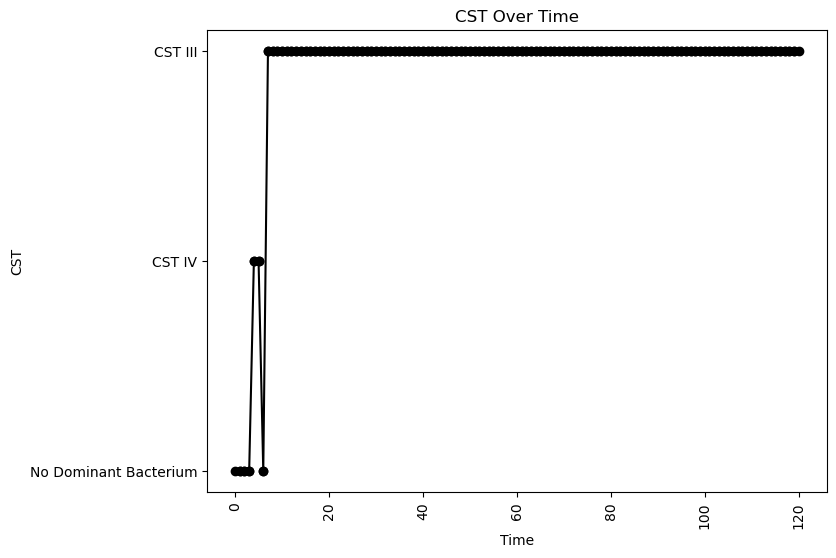


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.06309763455319839
oLB Growth: 0.9128027925042091
nAB Self: -0.029000329265923344
nAB->Li: -0.018995962314343584
nAB->oLB: -0.38960803511923925
Li->nAB: 0.3133837468816598
Li Self: -0.05821087488066457
Li->oLB: -0.4936753254978135
oLB->nAB: -0.2523225195016324
oLB->Li: -0.21140771488740367
oLB Self: -0.07334394844617353

Simulation 8916 follows a valid CST progression:


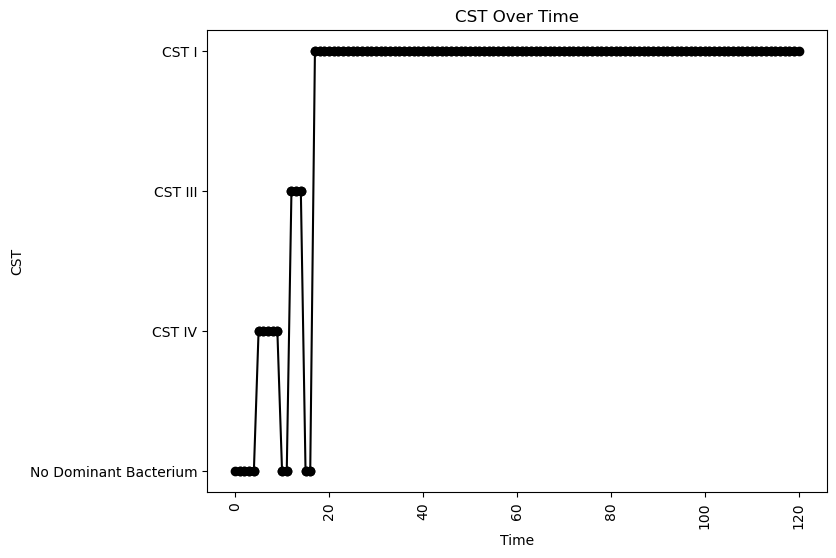


Interaction Parameters:
nAB Growth: 2.286323001067126
Li Growth: 0.060377934648291574
oLB Growth: 0.14091260068383374
nAB Self: -0.06611473811601752
nAB->Li: -0.3681866547805276
nAB->oLB: -0.46603853848400617
Li->nAB: 0.09744658794467853
Li Self: -0.033726235210642705
Li->oLB: -0.3024074719073378
oLB->nAB: -0.12073076087406281
oLB->Li: 0.2612915104280005
oLB Self: -0.09016035937880501

Simulation 8917 follows a valid CST progression:


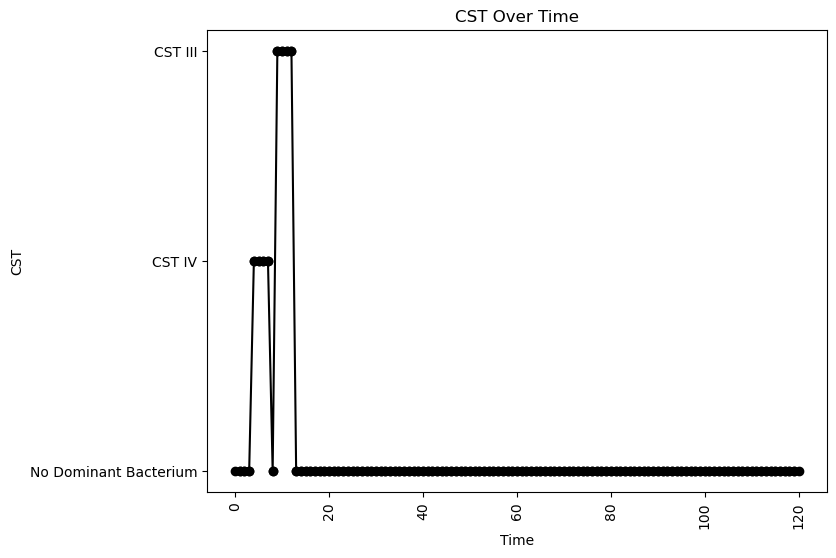


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.05072073600009906
oLB Growth: 1.0858755226067296
nAB Self: -0.052653549154651584
nAB->Li: -0.23464037951436345
nAB->oLB: -0.08623072886047123
Li->nAB: 0.15484933491226094
Li Self: -0.07918531268663569
Li->oLB: 0.20011793797079536
oLB->nAB: -0.06773419723482116
oLB->Li: 0.15749495413347425
oLB Self: -0.07541894090879246

Simulation 8921 follows a valid CST progression:


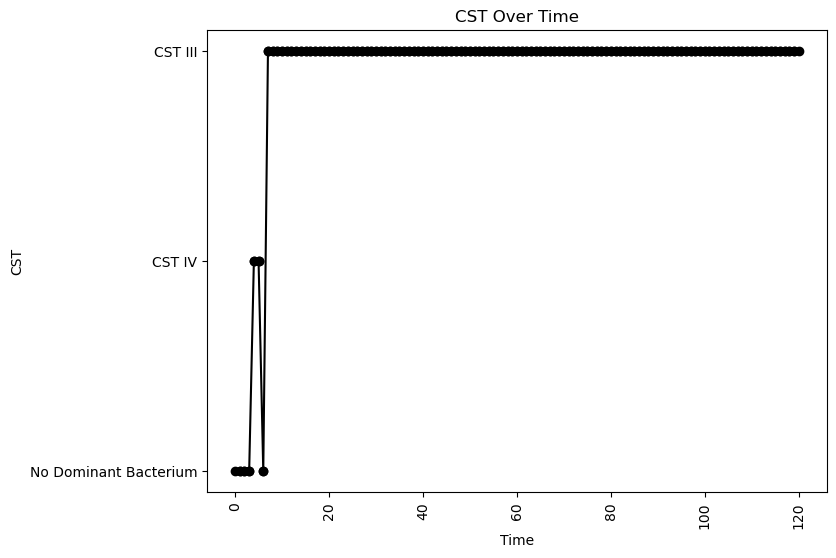


Interaction Parameters:
nAB Growth: 2.273308423784788
Li Growth: 0.3623593395828221
oLB Growth: 0.4879467602516997
nAB Self: -0.06994578928911843
nAB->Li: -0.42597058617385525
nAB->oLB: -0.04099213056950246
Li->nAB: 0.09524111333838658
Li Self: -0.04230369508482665
Li->oLB: -0.17911909301043605
oLB->nAB: -0.11069039075632214
oLB->Li: -0.2970740039142009
oLB Self: -0.06947481421711868

Simulation 8929 follows a valid CST progression:


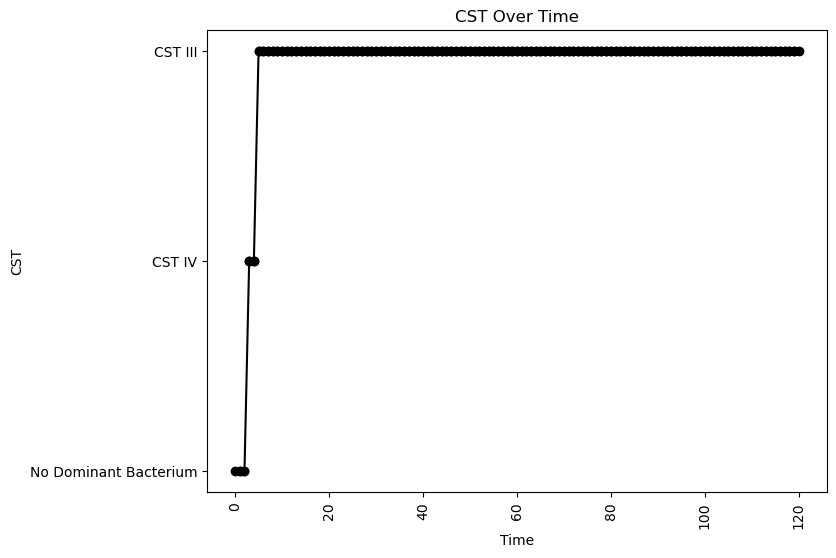


Interaction Parameters:
nAB Growth: 2.2088016144568243
Li Growth: 0.27764562418005573
oLB Growth: 1.1274304047774089
nAB Self: -0.05637428252362806
nAB->Li: 0.083338035890819
nAB->oLB: -0.04228255562108468
Li->nAB: 0.2763755159354988
Li Self: -0.07403736785250345
Li->oLB: 0.2829711152550656
oLB->nAB: -0.42039563511287786
oLB->Li: -0.03638730881608421
oLB Self: -0.08177073847472768

Simulation 8933 follows a valid CST progression:


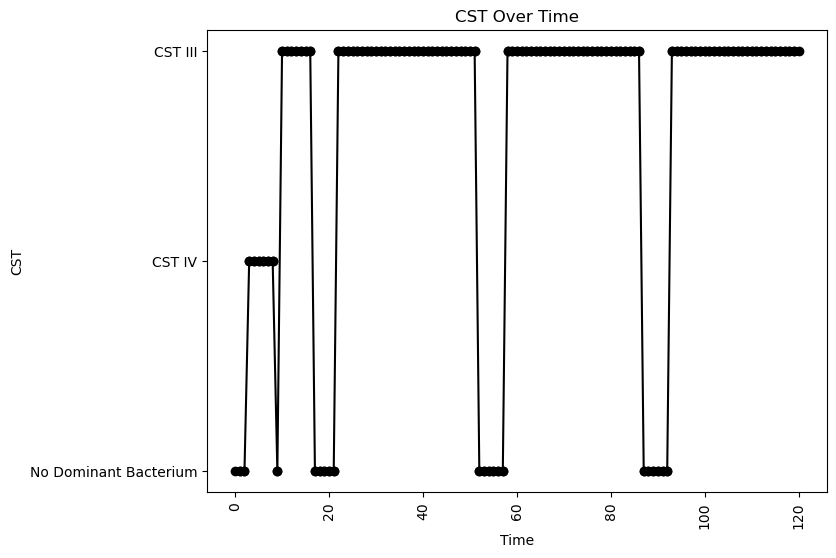


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.03299421843051441
nAB->Li: -0.1629651597524
nAB->oLB: -0.30656085050387466
Li->nAB: 0.05717125595643546
Li Self: -0.03851829432571439
Li->oLB: -0.2216464884998708
oLB->nAB: -0.19346182801933198
oLB->Li: -0.07753535615910861
oLB Self: -0.015463239567071851

Simulation 8937 follows a valid CST progression:


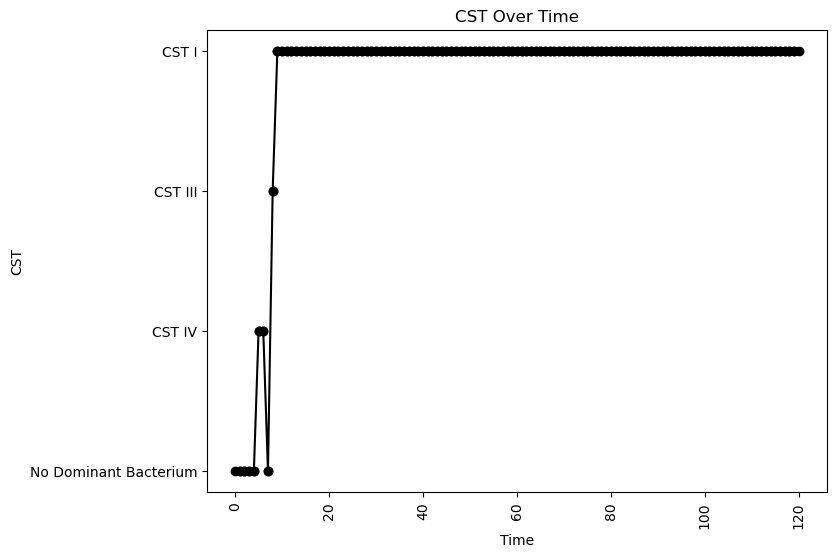


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.06967846000948563
oLB Growth: 0.7070472171500886
nAB Self: -0.0070084362109169435
nAB->Li: -0.36088358351637667
nAB->oLB: -0.3264777808600088
Li->nAB: 0.24972074990315385
Li Self: -0.011834503794552781
Li->oLB: 0.11651356737677898
oLB->nAB: -0.10134815364702526
oLB->Li: 0.391408097821336
oLB Self: -0.0304365557602969

Simulation 8947 follows a valid CST progression:


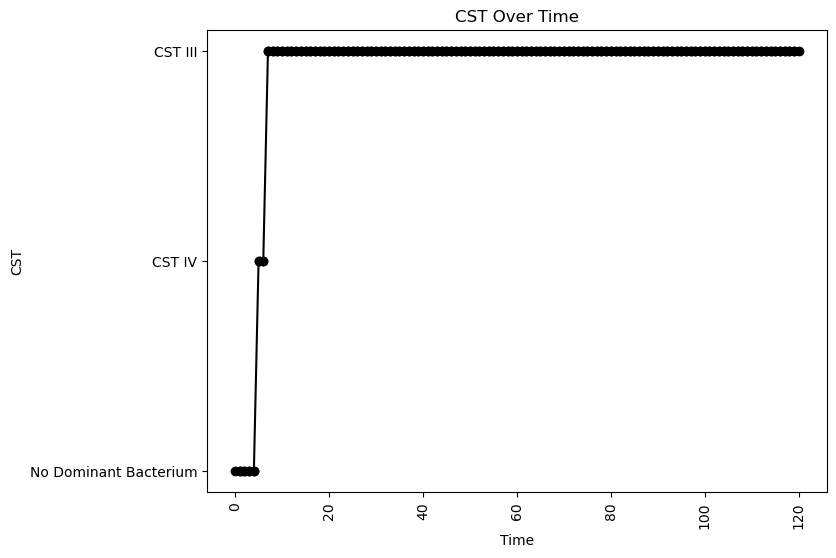


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.08261303992885727
nAB->Li: -0.34064505708102344
nAB->oLB: -0.3519360433248675
Li->nAB: 0.25242263153639644
Li Self: -0.009399732724735266
Li->oLB: -0.2617671084854524
oLB->nAB: -0.17068557889064057
oLB->Li: -0.22672650469838418
oLB Self: -0.07599515864138748

Simulation 8948 follows a valid CST progression:


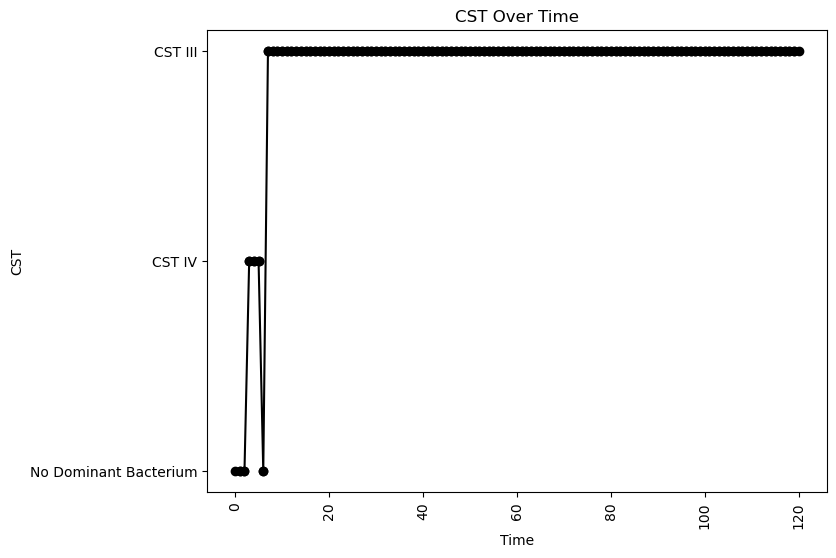


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.16000469546728396
oLB Growth: 1.0858755226067296
nAB Self: -0.017062692793639242
nAB->Li: -0.1328404880507908
nAB->oLB: -0.15883941605104307
Li->nAB: 0.10647765476933102
Li Self: -0.03337707702679048
Li->oLB: 0.24982250325168853
oLB->nAB: -0.16350862882443673
oLB->Li: -0.08347308343899013
oLB Self: -0.03509050125312799

Simulation 8958 follows a valid CST progression:


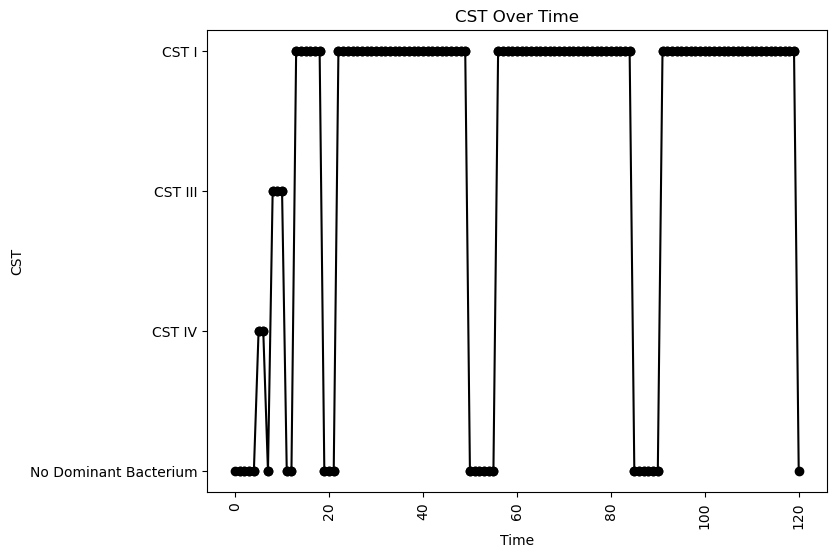


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.039279479196251965
nAB->Li: -0.35241522590049557
nAB->oLB: -0.046496687820426874
Li->nAB: 0.21227932297250884
Li Self: -0.07218417294358276
Li->oLB: -0.012204305150213979
oLB->nAB: -0.1405360561101054
oLB->Li: 0.19926933967304583
oLB Self: -0.09295310020683388

Simulation 8961 follows a valid CST progression:


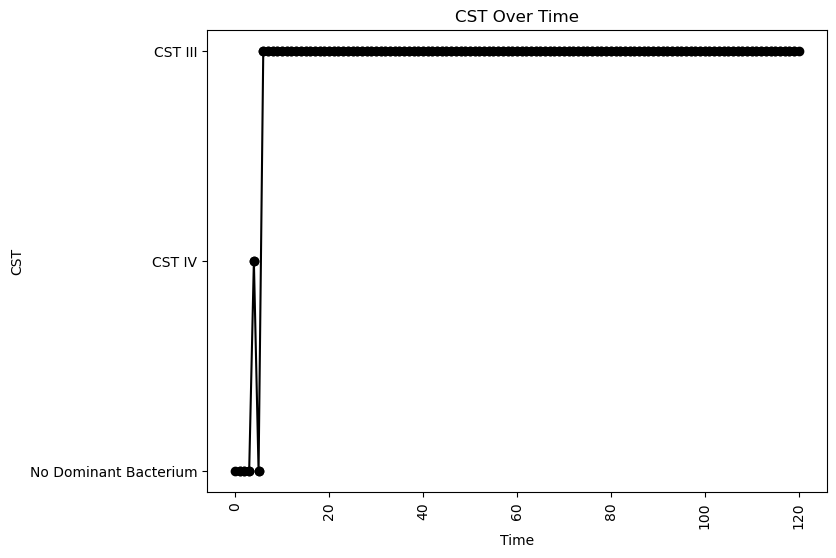


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.1252947456246425
oLB Growth: 0.20431222189445272
nAB Self: -0.03448347237978516
nAB->Li: -0.42535481838565037
nAB->oLB: -0.137619041014944
Li->nAB: 0.3617038344531376
Li Self: -0.06612354117462205
Li->oLB: -0.3875184077719887
oLB->nAB: -0.2869488954129994
oLB->Li: -0.17434150676258525
oLB Self: -0.06922414043986103

Simulation 8965 follows a valid CST progression:


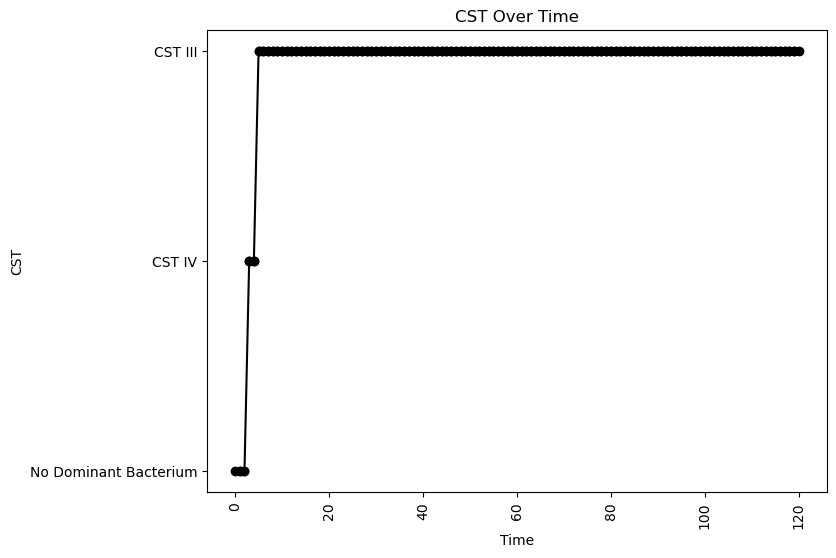


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.07349150475787905
nAB->Li: 0.05463325011995679
nAB->oLB: -0.2285482349052984
Li->nAB: 0.47873763225493693
Li Self: -0.0054459626227898045
Li->oLB: 0.29012425148944854
oLB->nAB: -0.21877138821380365
oLB->Li: 0.04250504095492824
oLB Self: -0.09891231848089158

Simulation 8967 follows a valid CST progression:


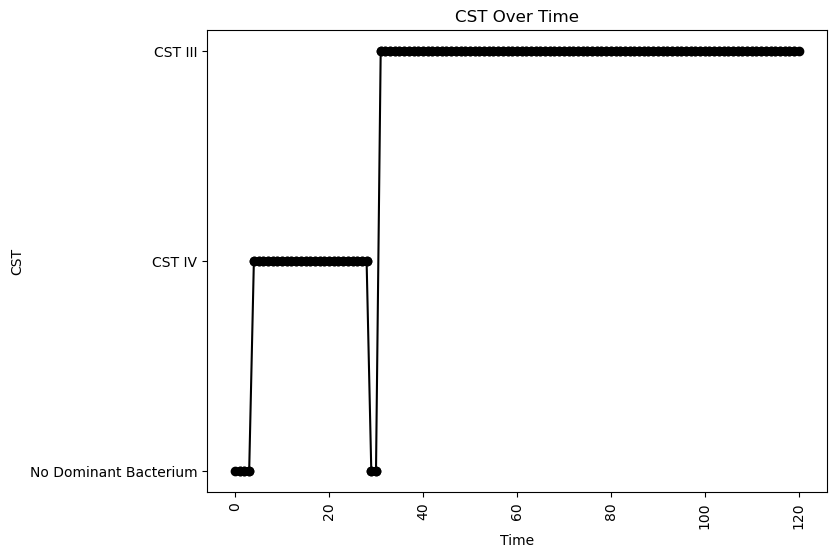


Interaction Parameters:
nAB Growth: 2.292952252819776
Li Growth: 0.06862578763464611
oLB Growth: 0.25066683866219575
nAB Self: -0.019666562291978454
nAB->Li: -0.2206228202941118
nAB->oLB: -0.1866737979752905
Li->nAB: 0.0027336456166405787
Li Self: -0.01017273736323808
Li->oLB: 0.46579633413605104
oLB->nAB: -0.11774516087491516
oLB->Li: 0.1972741010643887
oLB Self: -0.028322397618770326

Simulation 8979 follows a valid CST progression:


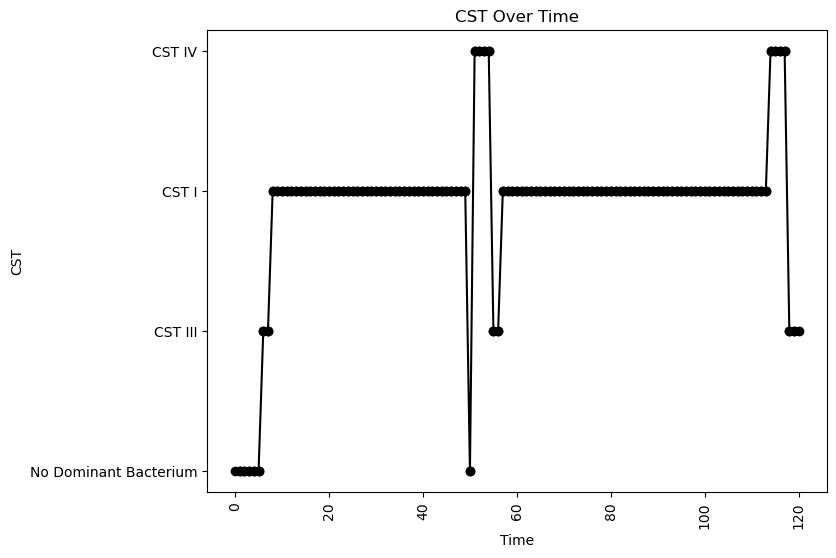


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.22538652116814692
oLB Growth: 1.0858755226067296
nAB Self: -0.09159922801644096
nAB->Li: -0.12873142152304395
nAB->oLB: -0.17629291573859412
Li->nAB: 0.3837570547844177
Li Self: -0.08401013753396211
Li->oLB: -0.07975181887677102
oLB->nAB: -0.2657964069911838
oLB->Li: 0.2401830543655047
oLB Self: -0.0801432013496251

Simulation 8990 follows a valid CST progression:


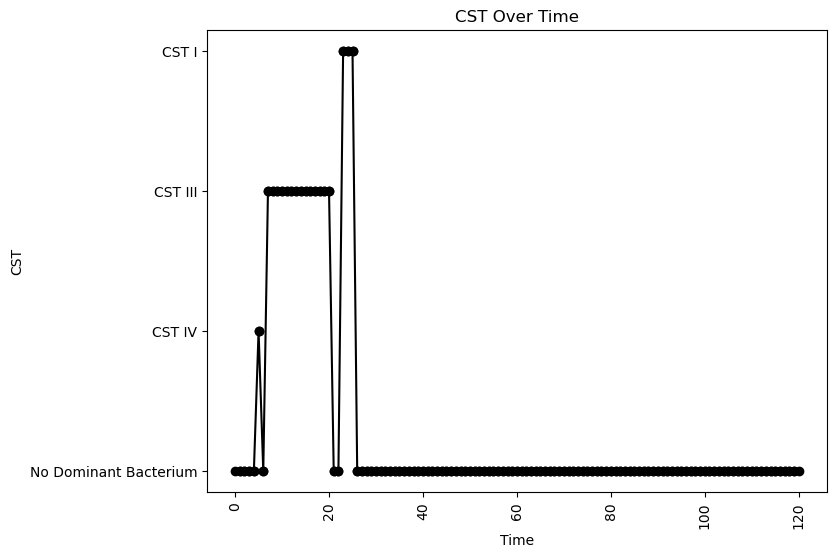


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.06247352868079563
nAB->Li: -0.44022176930112883
nAB->oLB: -0.43866670672915364
Li->nAB: 0.2379284728102008
Li Self: -0.06823797540830118
Li->oLB: 0.10450776954754992
oLB->nAB: -0.27878285105373124
oLB->Li: 0.0950397016420248
oLB Self: -0.056316764455029485

Simulation 8993 follows a valid CST progression:


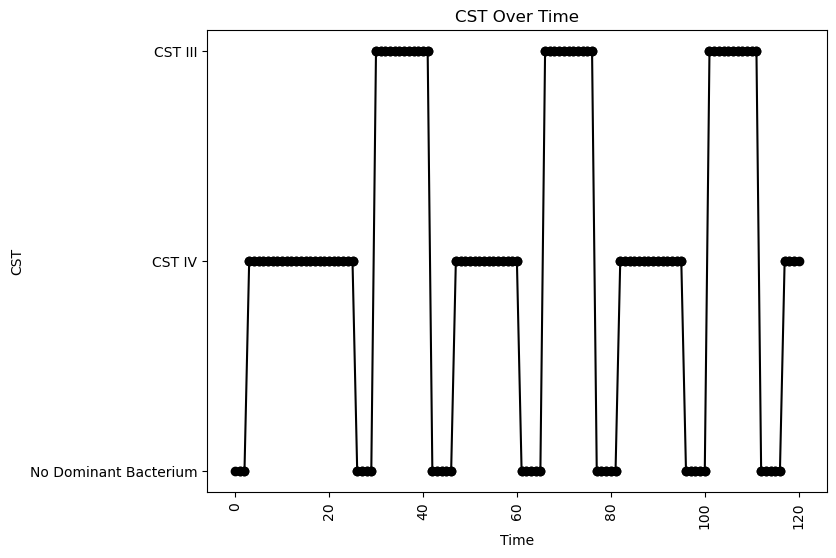


Interaction Parameters:
nAB Growth: 2.2088016144568243
Li Growth: 0.05268768924856952
oLB Growth: 1.1274304047774089
nAB Self: -0.09844055196767176
nAB->Li: -0.2500031140051696
nAB->oLB: -0.0431568013908567
Li->nAB: 0.04109255418048119
Li Self: -0.09535273599704137
Li->oLB: -0.19393775253093698
oLB->nAB: -0.41966324390264853
oLB->Li: -0.03584168780404995
oLB Self: -0.02954685171422372

Simulation 9005 follows a valid CST progression:


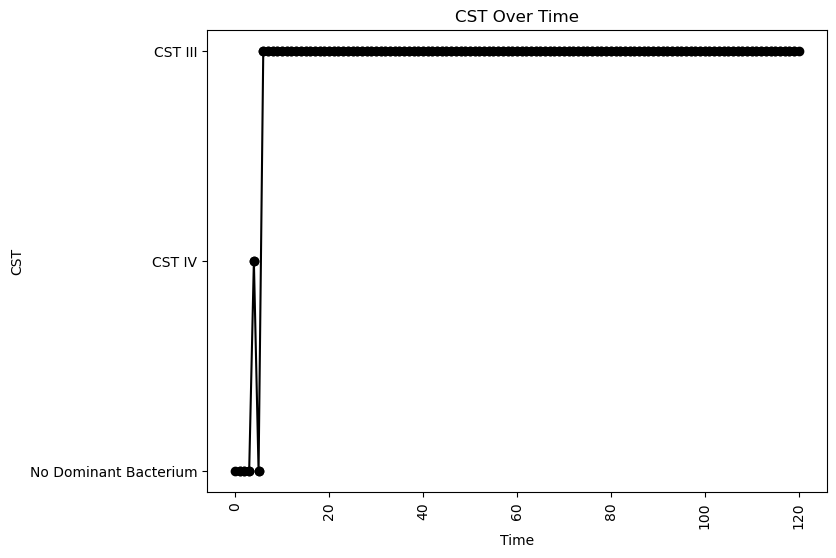


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.31018072974682714
oLB Growth: 0.07204856104631488
nAB Self: -0.049009729228469086
nAB->Li: -0.03609806282021655
nAB->oLB: -0.15063978261534344
Li->nAB: 0.19667820715389206
Li Self: -0.05212280420085465
Li->oLB: -0.1338960157201008
oLB->nAB: -0.4056897251909293
oLB->Li: -0.20008887715127865
oLB Self: -0.031046948727863483

Simulation 9025 follows a valid CST progression:


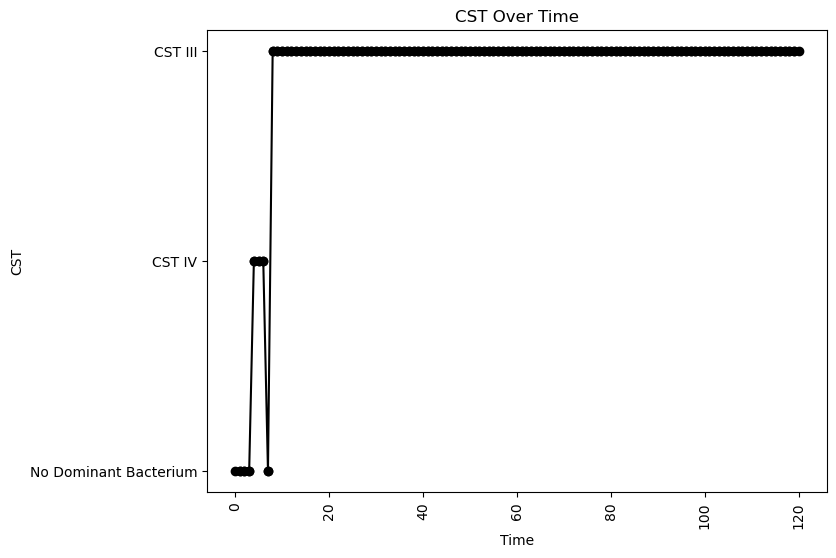


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.06967846000948563
oLB Growth: 0.7070472171500886
nAB Self: -0.06645267658693281
nAB->Li: 0.09873159904531903
nAB->oLB: -0.3864568314534718
Li->nAB: 0.2727301404112651
Li Self: -0.08794156821421084
Li->oLB: -0.3265629018221419
oLB->nAB: -0.43079661391549445
oLB->Li: 0.07887250958198966
oLB Self: -0.03535309255670026

Simulation 9033 follows a valid CST progression:


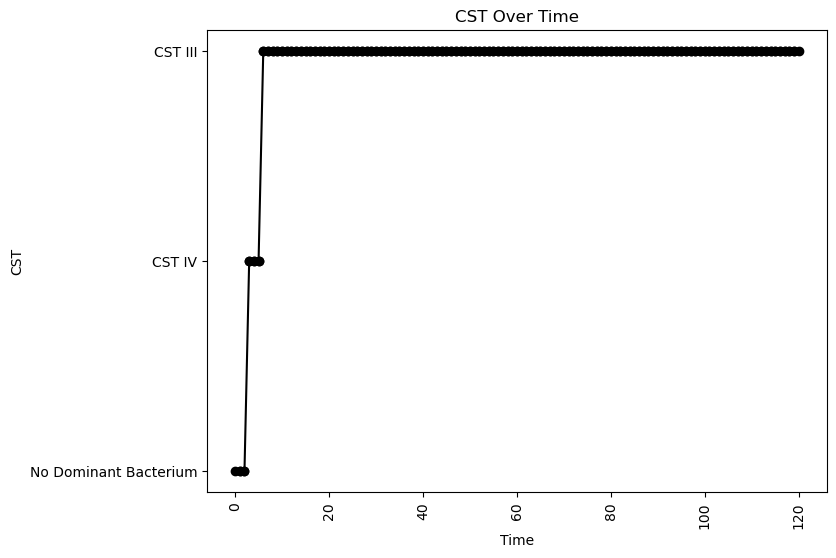


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.01398483315624384
nAB->Li: -0.021434044314609824
nAB->oLB: -0.39985072147495293
Li->nAB: 0.3492444596189497
Li Self: -0.035690580588114806
Li->oLB: -0.16942085256017358
oLB->nAB: -0.07617014475857015
oLB->Li: -0.03661667905763932
oLB Self: -0.06173872337045117

Simulation 9044 follows a valid CST progression:


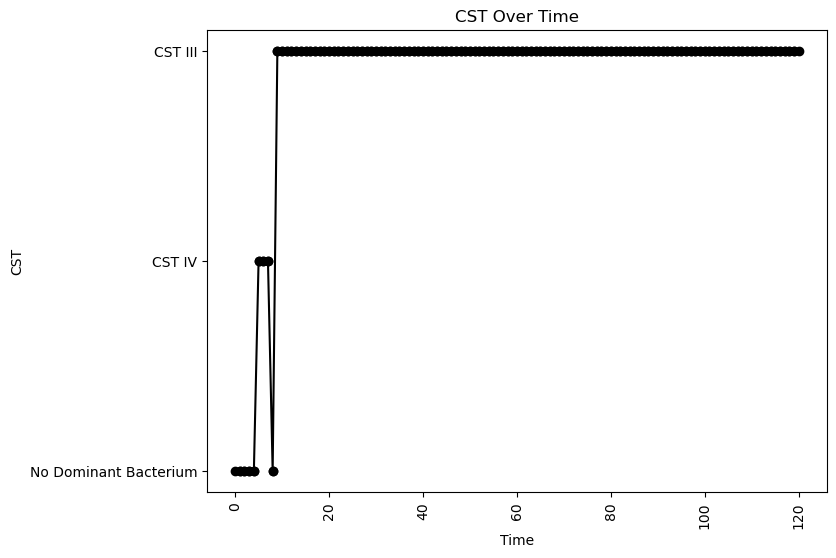


Interaction Parameters:
nAB Growth: 2.1147752631399044
Li Growth: 0.041507824909493854
oLB Growth: 1.2094391858973506
nAB Self: -0.022927326772742868
nAB->Li: 0.001135399444852636
nAB->oLB: -0.4858108634651653
Li->nAB: 0.13667453635335025
Li Self: -0.00212724640199749
Li->oLB: -0.3369260769946678
oLB->nAB: -0.3512179339392064
oLB->Li: -0.3170207160986035
oLB Self: -0.020857737255906825

Simulation 9050 follows a valid CST progression:


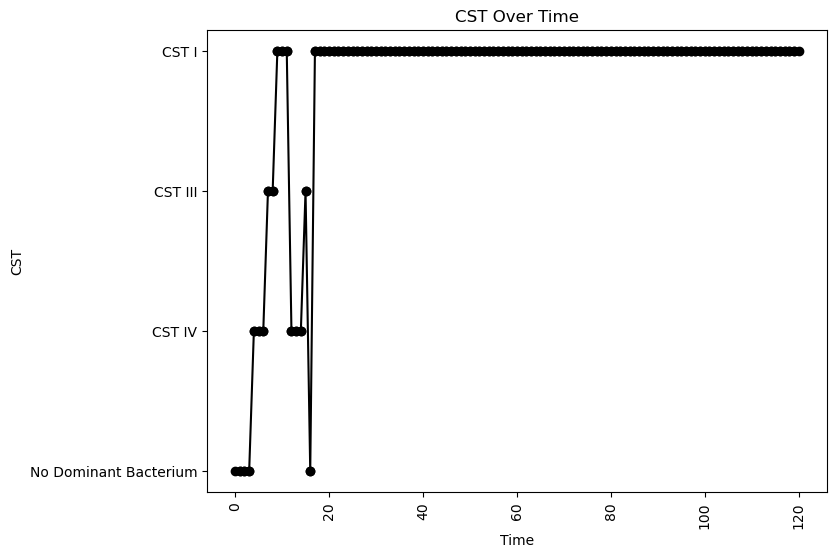


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.017116452973888224
nAB->Li: -0.20186392515779822
nAB->oLB: -0.24741663080221554
Li->nAB: 0.31057020539888314
Li Self: -0.0872009864074624
Li->oLB: -0.4251219722967366
oLB->nAB: -0.3617459279370091
oLB->Li: 0.37139579126835154
oLB Self: -0.09285148092737791

Simulation 9055 follows a valid CST progression:


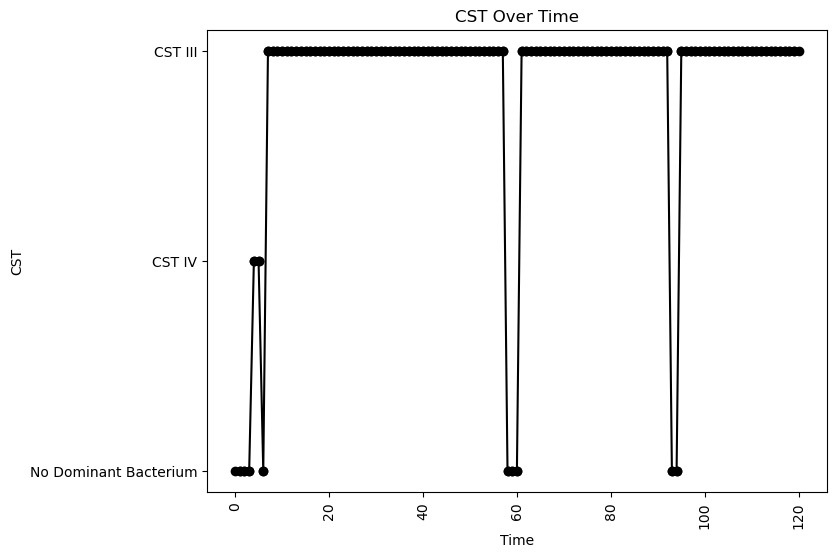


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.05759113058195379
nAB->Li: -0.4565689133876859
nAB->oLB: -0.3354117683148604
Li->nAB: 0.35845044270989346
Li Self: -0.09408172185786334
Li->oLB: 0.1977140085998471
oLB->nAB: -0.2528700267531123
oLB->Li: -0.458484649651236
oLB Self: -0.06254424644985207

Simulation 9065 follows a valid CST progression:


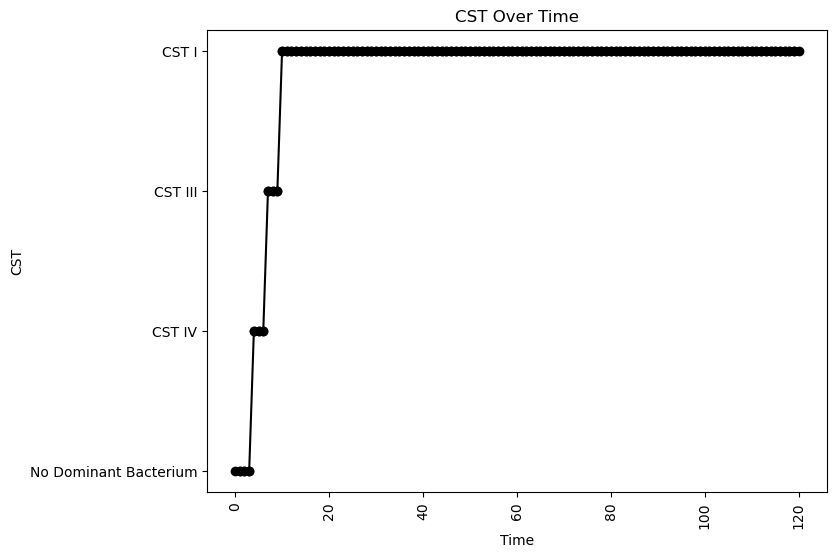


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.03783073553840269
nAB->Li: -0.012861478322074182
nAB->oLB: -0.4905857736505209
Li->nAB: 0.3778432640762859
Li Self: -0.0684234945661645
Li->oLB: -0.42941091647808155
oLB->nAB: -0.08445180842741651
oLB->Li: 0.07128277791621684
oLB Self: -0.036535742739976326

Simulation 9070 follows a valid CST progression:


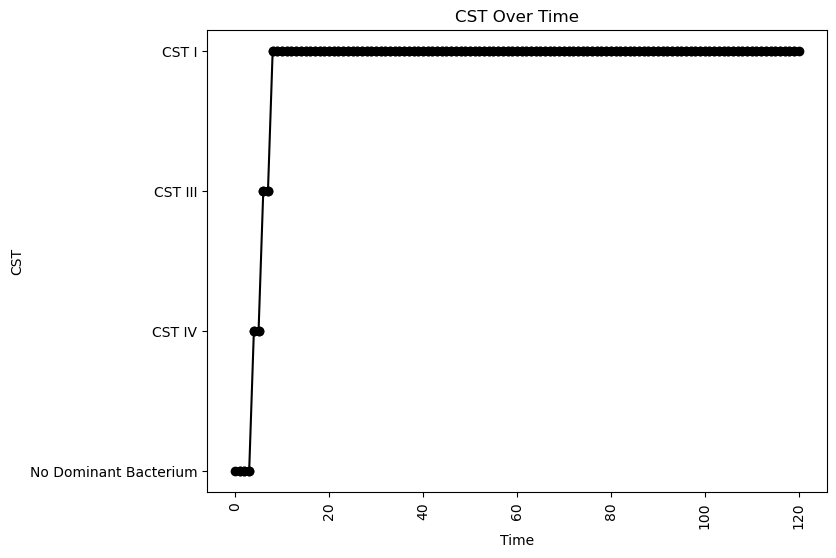


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.28179131859341483
oLB Growth: 0.1039349296945926
nAB Self: -0.06582171187329172
nAB->Li: -0.05017902615728831
nAB->oLB: -0.4449846599100659
Li->nAB: 0.2051486902411752
Li Self: -0.034731969570568094
Li->oLB: -0.31692109296434484
oLB->nAB: -0.30680761069116547
oLB->Li: 0.2669498498449805
oLB Self: -0.09373239807457569

Simulation 9071 follows a valid CST progression:


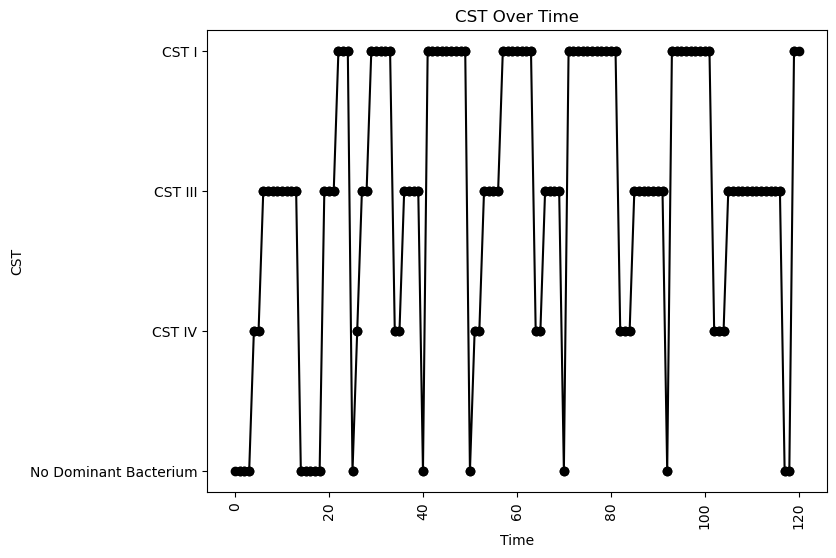


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.06495430992206574
oLB Growth: 0.1731103059651596
nAB Self: -0.011988875371854682
nAB->Li: -0.21634170804002967
nAB->oLB: -0.01858328139991694
Li->nAB: 0.4218810501279744
Li Self: -0.0339580633865202
Li->oLB: -0.2133076191678303
oLB->nAB: -0.2843936800719436
oLB->Li: 0.07466453190084843
oLB Self: -0.04395540647130958

Simulation 9073 follows a valid CST progression:


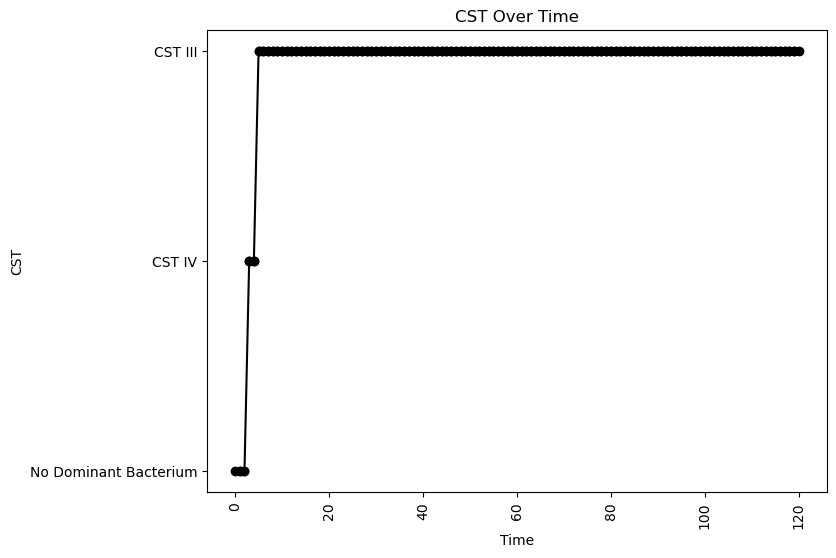


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.11860938720609789
oLB Growth: 0.7334429546888279
nAB Self: -0.02834760814645544
nAB->Li: 0.1087886221436446
nAB->oLB: -0.01310531126262271
Li->nAB: 0.3324600329447145
Li Self: -0.060745667323117654
Li->oLB: -0.391827248915298
oLB->nAB: -0.3086375944961044
oLB->Li: 0.24854196329472444
oLB Self: -0.017220747122469904

Simulation 9076 follows a valid CST progression:


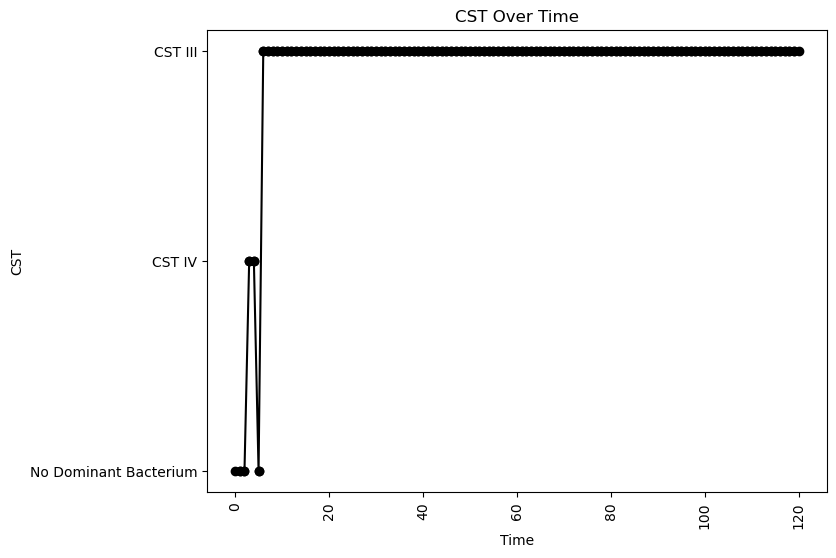


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.04978911800044488
nAB->Li: 0.17867152638133688
nAB->oLB: -0.16902618231516636
Li->nAB: 0.4268678752444687
Li Self: -0.0758191320442946
Li->oLB: -0.1270689306545401
oLB->nAB: -0.49337851174553404
oLB->Li: 0.4151474067206252
oLB Self: -0.008337424485749909

Simulation 9080 follows a valid CST progression:


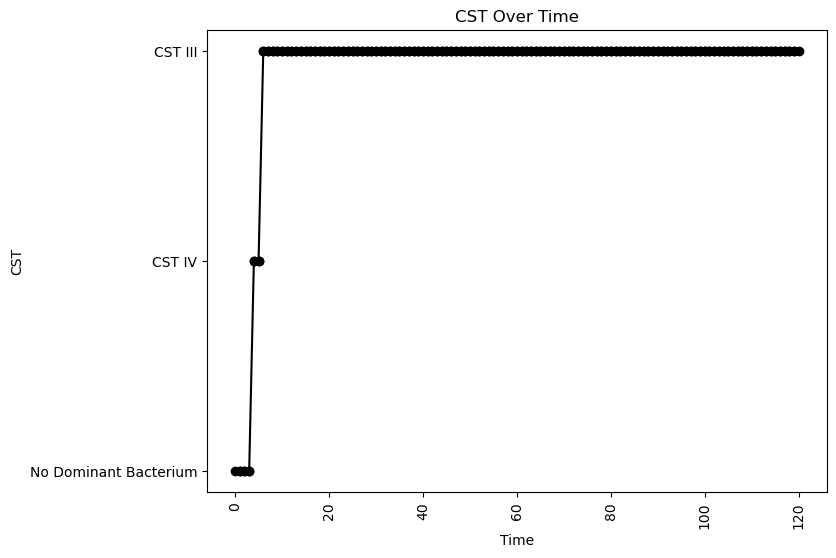


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.09722560111129988
oLB Growth: 0.11031283255203692
nAB Self: -0.0897925068638786
nAB->Li: -0.38177909878565036
nAB->oLB: -0.30817172528865044
Li->nAB: 0.22583776963986202
Li Self: -0.007520311026843904
Li->oLB: -0.4442680117375314
oLB->nAB: -0.13246547058867242
oLB->Li: -0.1994256193179172
oLB Self: -0.07745575642887054

Simulation 9086 follows a valid CST progression:


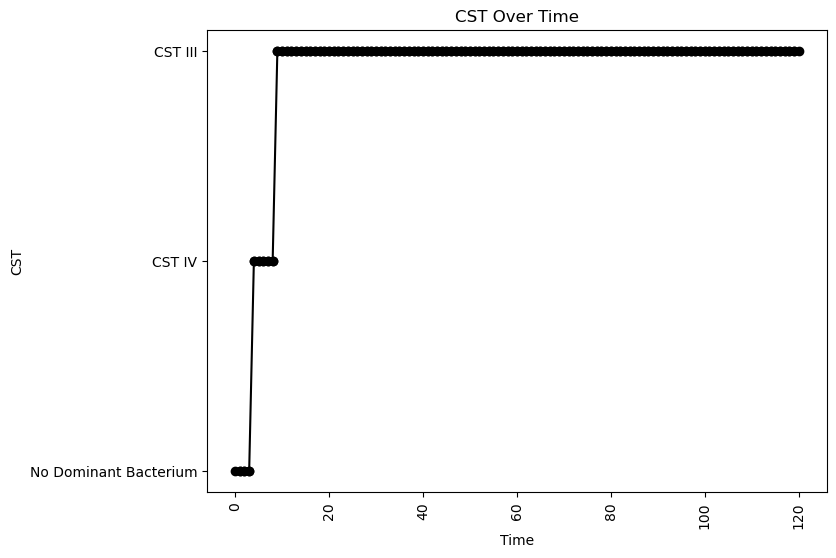


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.07419039969784579
nAB->Li: -0.018224602466464235
nAB->oLB: -0.361806630431515
Li->nAB: 0.11185902737191522
Li Self: -0.032324590478080825
Li->oLB: -0.1522186911105255
oLB->nAB: -0.2058369014880257
oLB->Li: 0.012152461583688101
oLB Self: -0.019168995246725676

Simulation 9092 follows a valid CST progression:


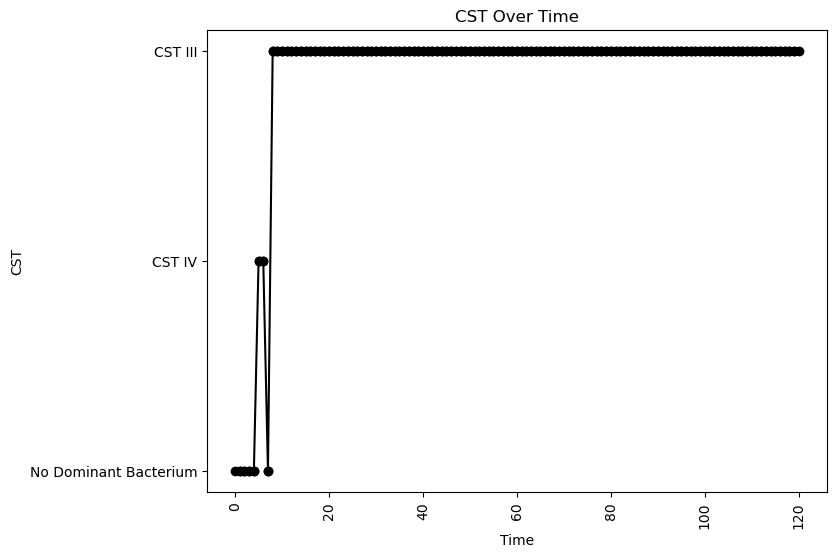


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.07552304483136077
nAB->Li: -0.10589793268750292
nAB->oLB: -0.2246200154734187
Li->nAB: 0.16497232255337946
Li Self: -0.05186313675190849
Li->oLB: 0.037182564714594246
oLB->nAB: -0.0679631540519916
oLB->Li: -0.25048418606320544
oLB Self: -0.08661101429409877

Simulation 9109 follows a valid CST progression:


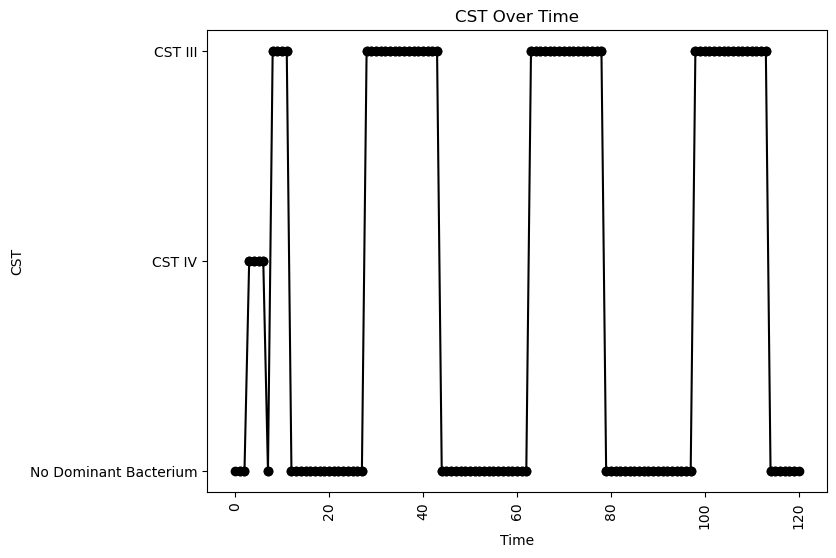


Interaction Parameters:
nAB Growth: 2.284416841880324
Li Growth: 0.08295595322057268
oLB Growth: 0.35838896078112936
nAB Self: -0.012026648656317654
nAB->Li: -0.15180640178315963
nAB->oLB: -0.15098676496366853
Li->nAB: 0.09617865688975591
Li Self: -0.08287044343914943
Li->oLB: -0.21296512025420727
oLB->nAB: -0.12765023810151943
oLB->Li: -0.1909668224330917
oLB Self: -0.0075218918439859395

Simulation 9112 follows a valid CST progression:


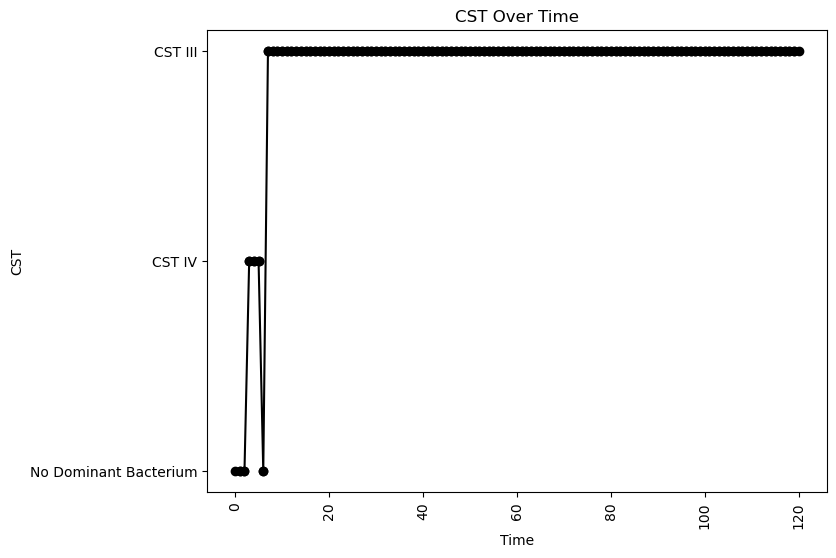


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.022397267290374168
nAB->Li: 0.05129508012791295
nAB->oLB: -0.144751499682107
Li->nAB: 0.29316469566840486
Li Self: -0.07953462115078583
Li->oLB: -0.08490183956862474
oLB->nAB: -0.4805954184191192
oLB->Li: -0.18241009777189815
oLB Self: -0.04664425771202135

Simulation 9114 follows a valid CST progression:


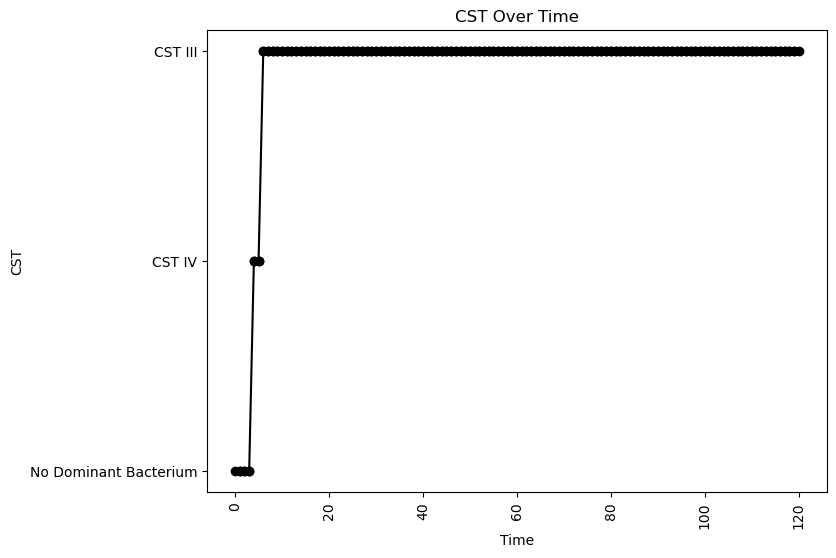


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.005808216853303447
nAB->Li: 0.13004924259746053
nAB->oLB: -0.19437364311407646
Li->nAB: 0.31271618177350413
Li Self: -0.045979009002484826
Li->oLB: 0.040165512959623784
oLB->nAB: -0.09806127676401272
oLB->Li: -0.4333143568745561
oLB Self: -0.03587764553513517

Simulation 9121 follows a valid CST progression:


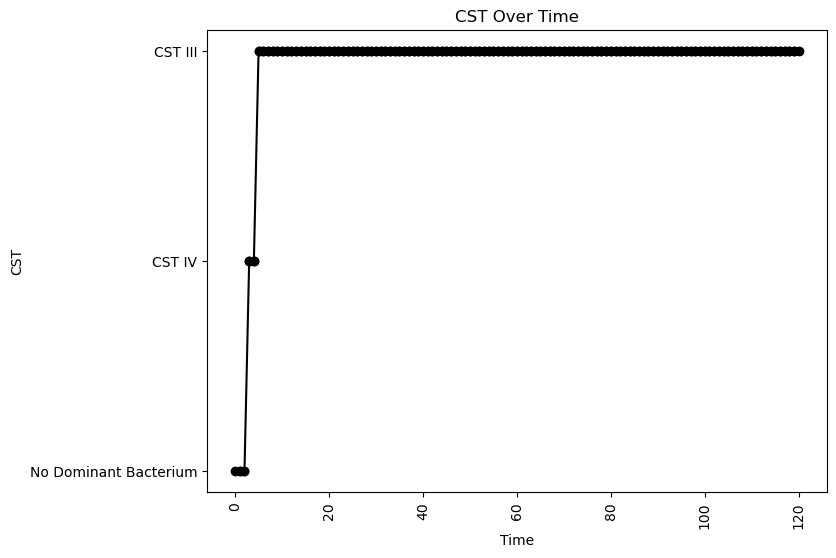


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.05072073600009906
oLB Growth: 1.0858755226067296
nAB Self: -0.05893297866104549
nAB->Li: 0.24168222621678737
nAB->oLB: -0.16669279136317489
Li->nAB: 0.45369885332202675
Li Self: -0.009131756575778097
Li->oLB: -0.07266547864611839
oLB->nAB: -0.1680843240974304
oLB->Li: 0.034801491741198176
oLB Self: -0.0107956286173089

Simulation 9124 follows a valid CST progression:


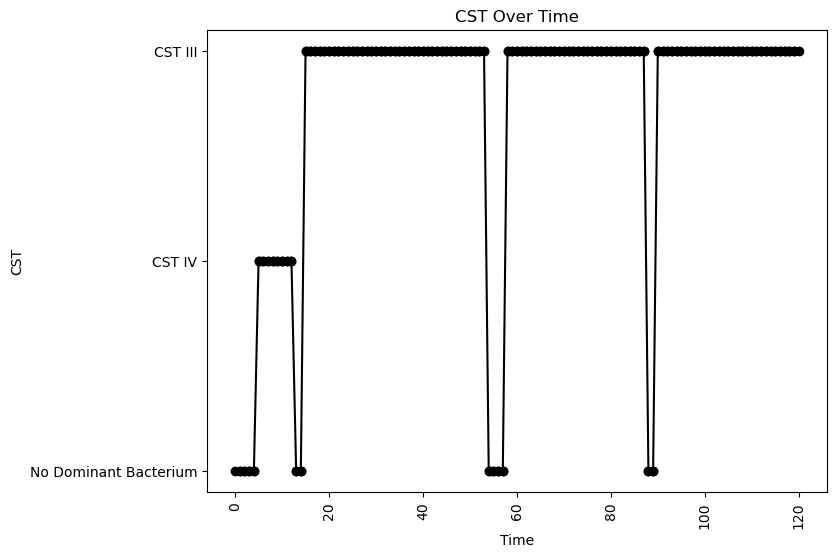


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.09490828630792641
nAB->Li: -0.2198558868879037
nAB->oLB: -0.2962513712090979
Li->nAB: 0.10672383843459465
Li Self: -0.05281758419830973
Li->oLB: 0.13554500029084093
oLB->nAB: -0.13223829678072813
oLB->Li: -0.32320320137134373
oLB Self: -0.08061904491608897

Simulation 9133 follows a valid CST progression:


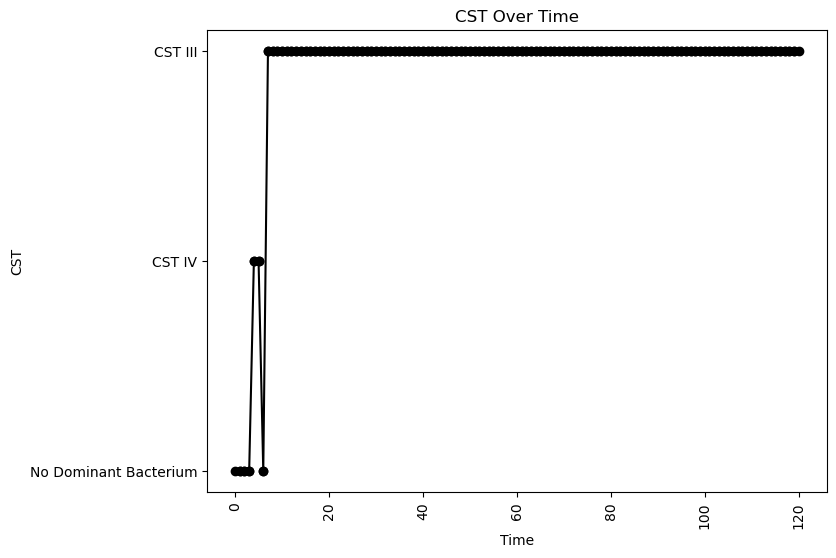


Interaction Parameters:
nAB Growth: 2.284416841880324
Li Growth: 0.06886020002136616
oLB Growth: 0.35838896078112936
nAB Self: -0.09760958990727028
nAB->Li: -0.1300239408900406
nAB->oLB: -0.08252429558704866
Li->nAB: 0.39733376215448235
Li Self: -0.08059559360747454
Li->oLB: -0.06763873995907488
oLB->nAB: -0.14097497245075247
oLB->Li: -0.08488405309917141
oLB Self: -0.015196799249009324

Simulation 9134 follows a valid CST progression:


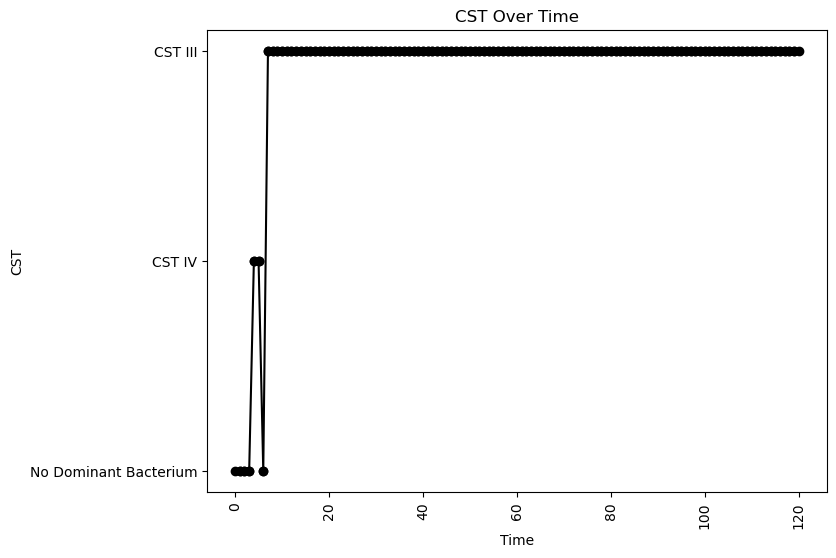


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.06547452694916857
nAB->Li: 0.13571311679386233
nAB->oLB: -0.49663333901505313
Li->nAB: 0.3503948664408144
Li Self: -0.023043262194422223
Li->oLB: 0.4330895528668425
oLB->nAB: -0.07561229069189529
oLB->Li: -0.49951222274049656
oLB Self: -0.07395598101648093

Simulation 9136 follows a valid CST progression:


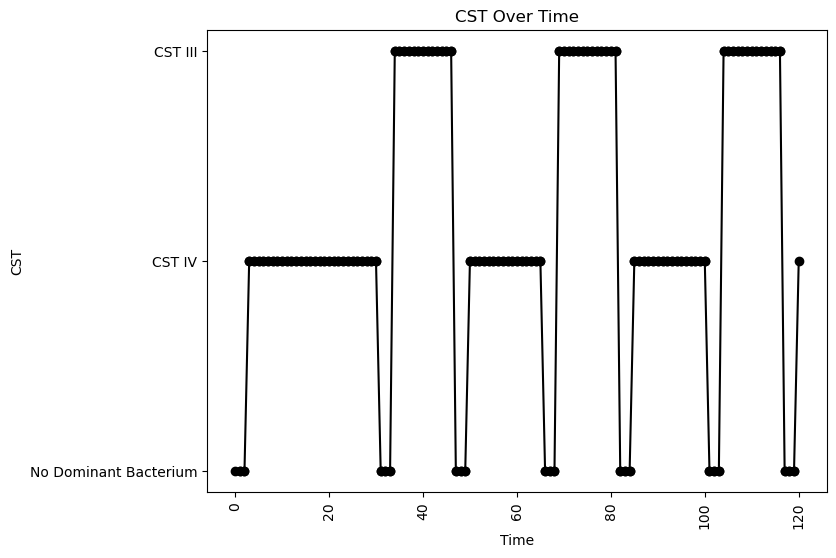


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.08582306993605862
nAB->Li: -0.3289809698598727
nAB->oLB: -0.05597020734974495
Li->nAB: 0.022264803548054046
Li Self: -0.07962794597337228
Li->oLB: -0.27570259458574964
oLB->nAB: -0.32062094511551664
oLB->Li: 0.1792986477944194
oLB Self: -0.007344427658220007

Simulation 9137 follows a valid CST progression:


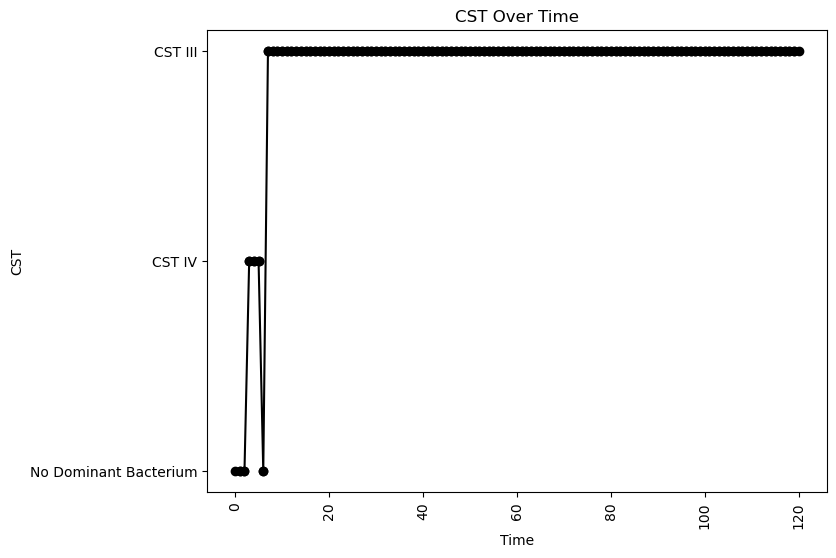


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.03837725110012093
oLB Growth: 1.155917868199191
nAB Self: -0.09664509994473065
nAB->Li: 0.13272090103541156
nAB->oLB: -0.4368785303529562
Li->nAB: 0.27935514609356893
Li Self: -0.07633679515593937
Li->oLB: 0.3220386076654498
oLB->nAB: -0.2888333311279912
oLB->Li: -0.2328336735813341
oLB Self: -0.06525160685010925

Simulation 9146 follows a valid CST progression:


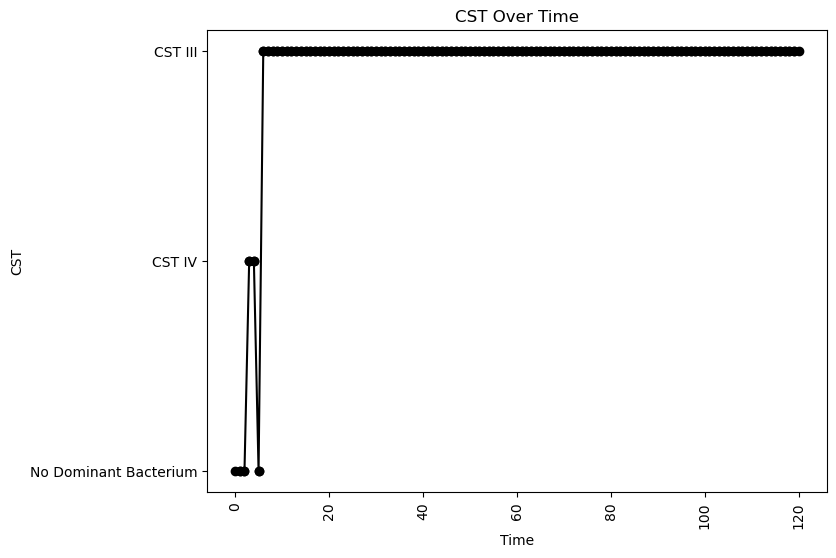


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.07935358313206395
nAB->Li: 0.20118782218378628
nAB->oLB: -0.015706254362289784
Li->nAB: 0.2913212110155329
Li Self: -0.01981469006149278
Li->oLB: 0.10176389123577367
oLB->nAB: -0.2696624523398049
oLB->Li: 0.07183352460449077
oLB Self: -0.032369996271988374

Simulation 9153 follows a valid CST progression:


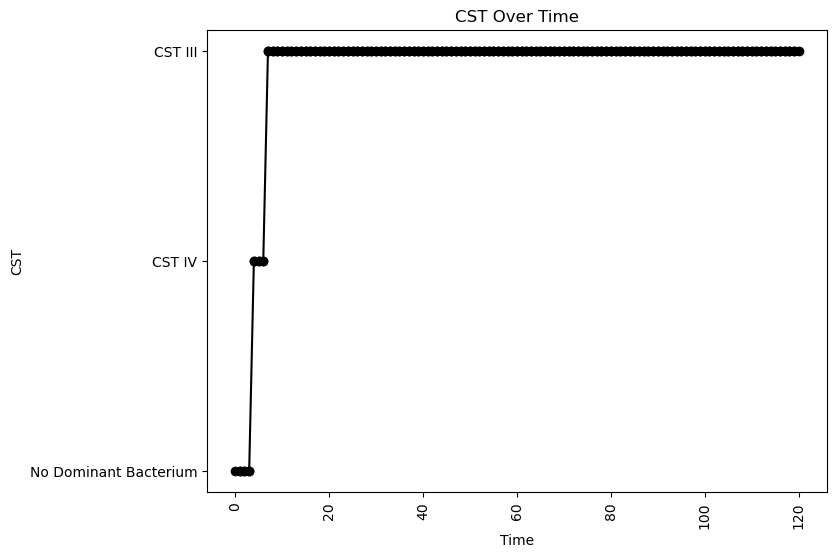


Interaction Parameters:
nAB Growth: 2.1964345031105657
Li Growth: 0.04025066595693835
oLB Growth: 1.2138354993931422
nAB Self: -0.07089825109490804
nAB->Li: -0.09636140484393252
nAB->oLB: -0.12790044351041807
Li->nAB: 0.4931822618420545
Li Self: -0.08195426452105933
Li->oLB: -0.18105607080181163
oLB->nAB: -0.24044767472049583
oLB->Li: -0.4240353192532267
oLB Self: -0.09274480800807326

Simulation 9155 follows a valid CST progression:


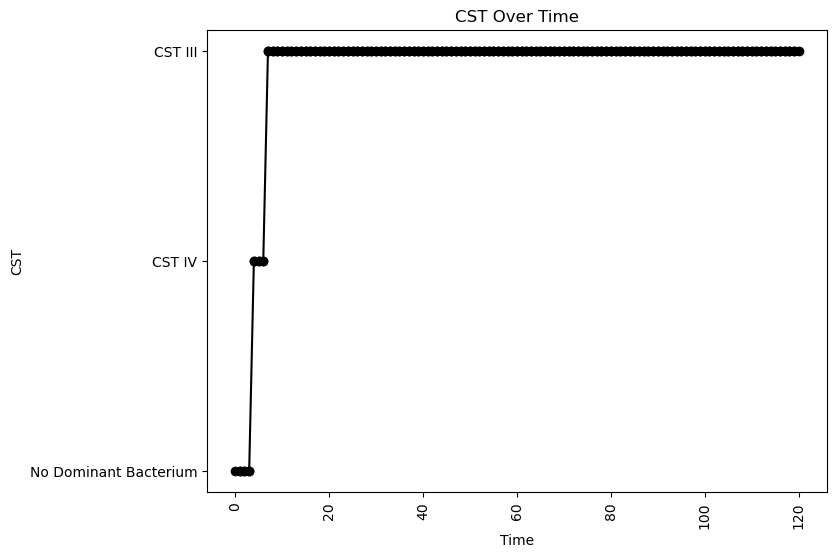


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.03764695924985105
nAB->Li: -0.44738700187221075
nAB->oLB: -0.43889273372238646
Li->nAB: 0.29034995407500785
Li Self: -0.009142692922606138
Li->oLB: -0.23655003975377703
oLB->nAB: -0.4420040812678056
oLB->Li: -0.19707077270108087
oLB Self: -0.0855142322266359

Simulation 9163 follows a valid CST progression:


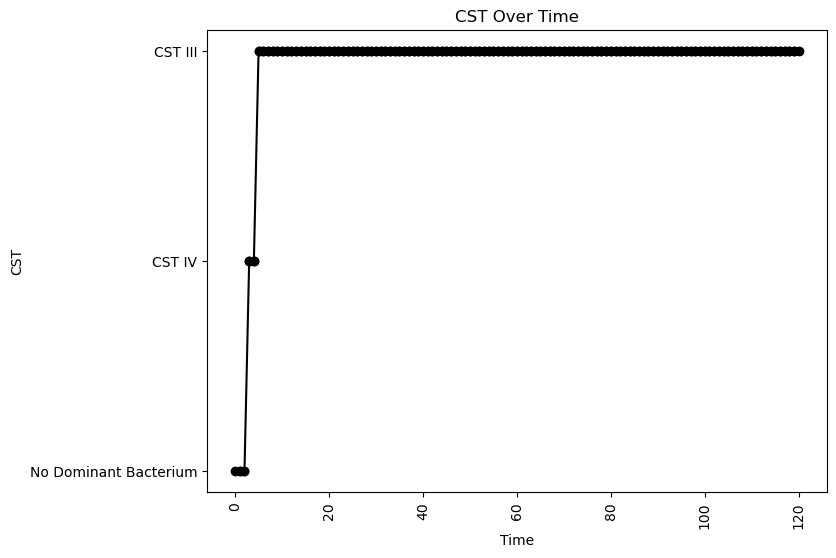


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.05225906200606095
nAB->Li: 0.19572583523465503
nAB->oLB: -0.2106267858925574
Li->nAB: 0.394022494229176
Li Self: -0.07509498566089104
Li->oLB: 0.24685181012172608
oLB->nAB: -0.3772492658505125
oLB->Li: -0.13828980794252055
oLB Self: -0.09991116586813073

Simulation 9164 follows a valid CST progression:


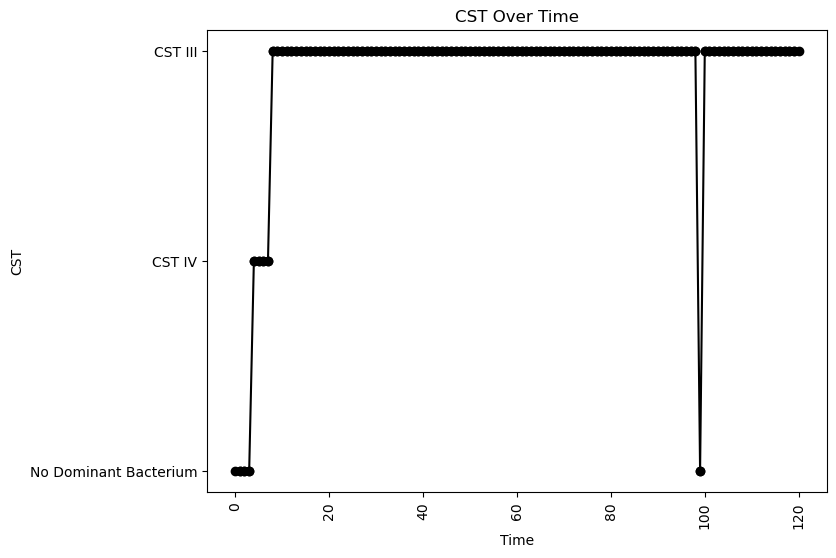


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.07924489445304991
nAB->Li: -0.32864174486419306
nAB->oLB: -0.15909008960348764
Li->nAB: 0.18723135634874521
Li Self: -0.04883063465661003
Li->oLB: 0.06993704957299973
oLB->nAB: -0.1258636469782496
oLB->Li: -0.3706767127694451
oLB Self: -0.04495436842119882

Simulation 9170 follows a valid CST progression:


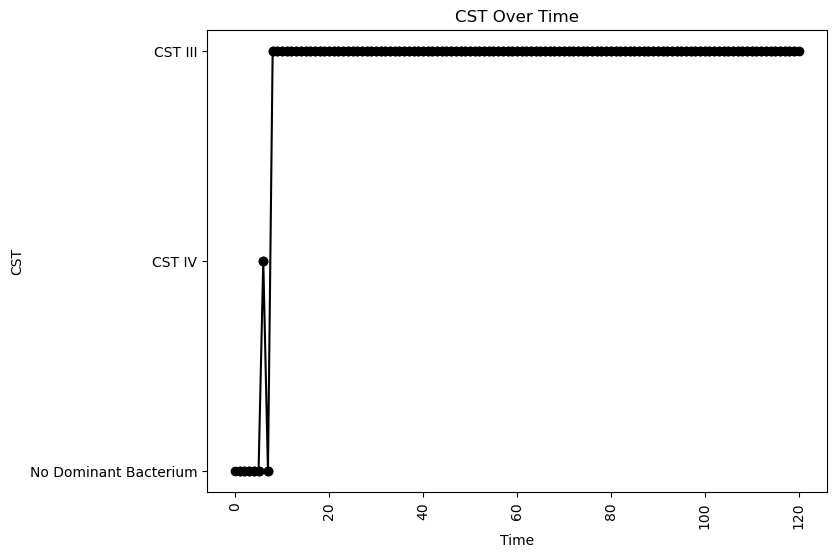


Interaction Parameters:
nAB Growth: 2.2002663828262317
Li Growth: 0.07280454274860512
oLB Growth: 0.7629459891785437
nAB Self: -0.04696732787329183
nAB->Li: 0.1563531097430666
nAB->oLB: -0.2892582626875216
Li->nAB: 0.3509874027129529
Li Self: -0.013600335378107592
Li->oLB: 0.1529501894693427
oLB->nAB: -0.2351504183852568
oLB->Li: 0.07412389026023325
oLB Self: -0.04832856820054888

Simulation 9174 follows a valid CST progression:


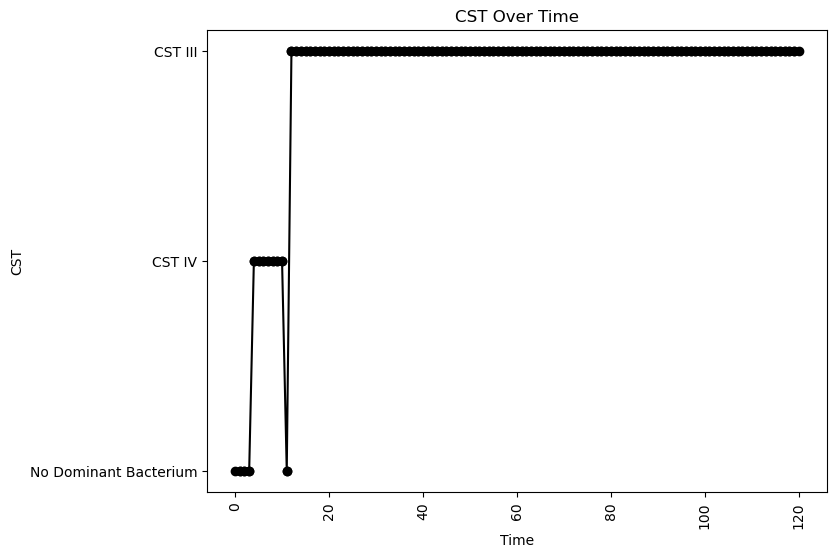


Interaction Parameters:
nAB Growth: 2.292952252819776
Li Growth: 0.06862578763464611
oLB Growth: 0.25066683866219575
nAB Self: -0.03274651917592539
nAB->Li: -0.4791380599227708
nAB->oLB: -0.3260737949905045
Li->nAB: 0.03465026796892723
Li Self: -0.0027393272299776755
Li->oLB: 0.28839474823653966
oLB->nAB: -0.004582588127104992
oLB->Li: -0.11373436869125003
oLB Self: -0.09484367262831825

Simulation 9176 follows a valid CST progression:


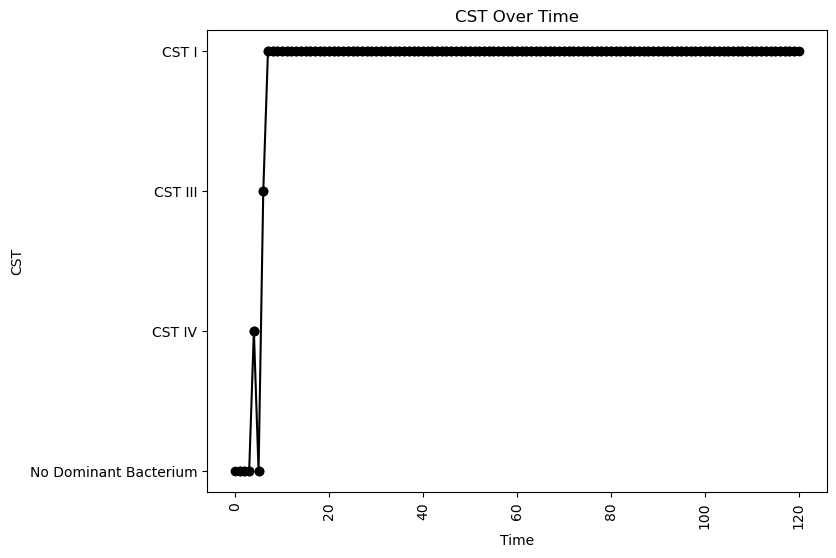


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.06309763455319839
oLB Growth: 0.9128027925042091
nAB Self: -0.006072325148813618
nAB->Li: 0.012183151305701467
nAB->oLB: -0.257278551966601
Li->nAB: 0.4334679656026261
Li Self: -0.010671199075839924
Li->oLB: -0.4463540072923763
oLB->nAB: -0.4314127545954378
oLB->Li: 0.16591601387193622
oLB Self: -0.060391525474318426

Simulation 9177 follows a valid CST progression:


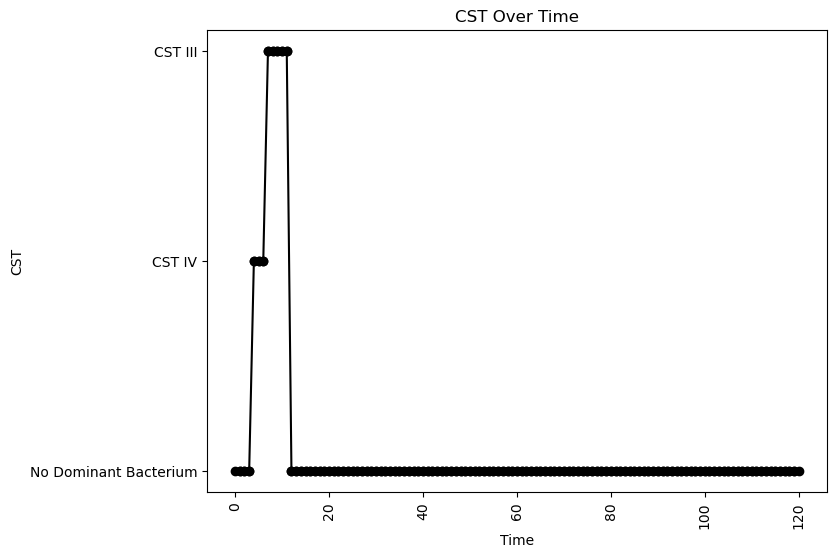


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.06438645000280489
nAB->Li: -0.37274437035772756
nAB->oLB: -0.013219638067927864
Li->nAB: 0.34444625604942813
Li Self: -0.061874097671956056
Li->oLB: 0.1503024705657794
oLB->nAB: -0.28857260905547255
oLB->Li: 0.2113394446040484
oLB Self: -0.06640924518692634

Simulation 9180 follows a valid CST progression:


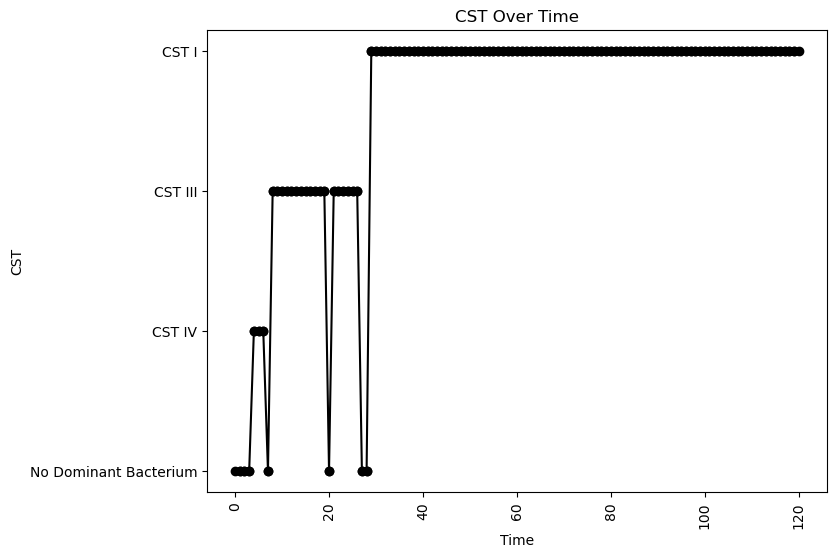


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.03978847307443838
nAB->Li: -0.4234999527772361
nAB->oLB: -0.3912723596832031
Li->nAB: 0.19325711136999235
Li Self: -0.0728275821551488
Li->oLB: -0.047834047958180415
oLB->nAB: -0.3410168427256678
oLB->Li: 0.09458955140874004
oLB Self: -0.07712026549109927

Simulation 9181 follows a valid CST progression:


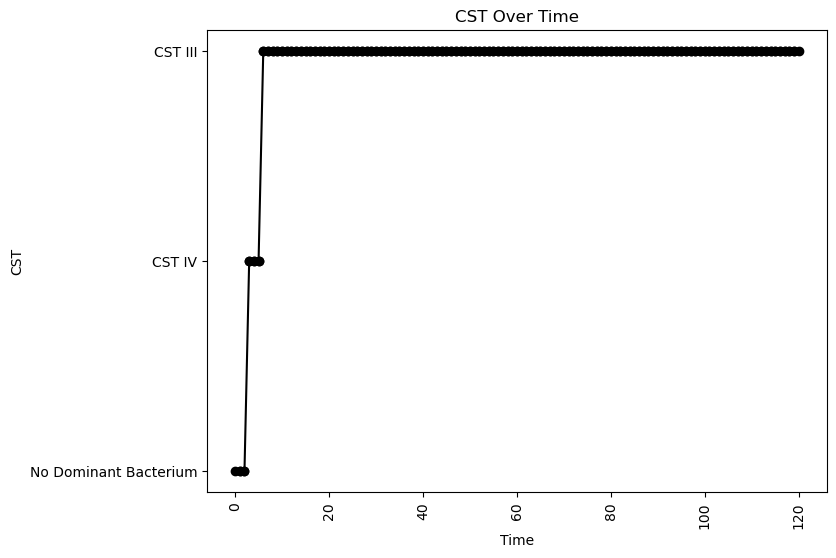


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.06967846000948563
oLB Growth: 0.7070472171500886
nAB Self: -0.03099282035555527
nAB->Li: 0.024477471309796828
nAB->oLB: -0.11074577074387504
Li->nAB: 0.3568689541064046
Li Self: -0.05859712816429005
Li->oLB: 0.1744263103751733
oLB->nAB: -0.43326855499785677
oLB->Li: -0.018154770580577295
oLB Self: -0.07676788842265882

Simulation 9188 follows a valid CST progression:


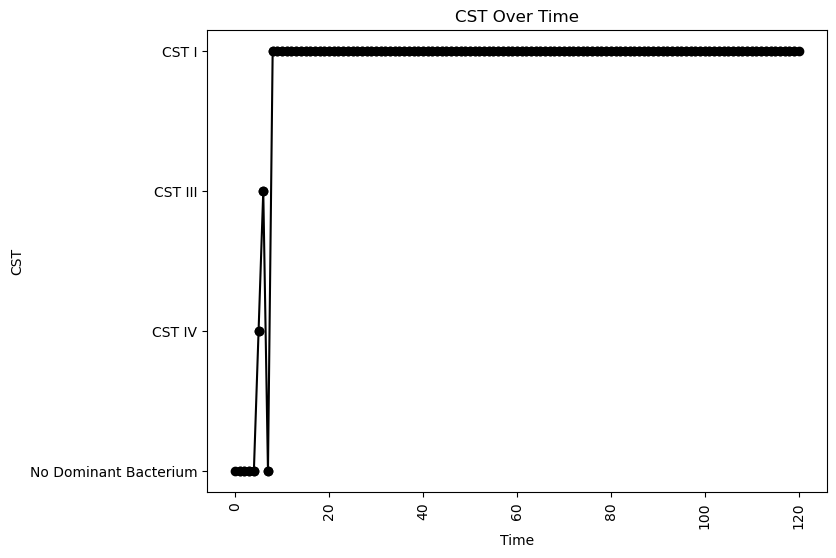


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.048890402568883974
nAB->Li: -0.11780019652510787
nAB->oLB: -0.3818860127514585
Li->nAB: 0.4797350771801715
Li Self: -0.09761615396670295
Li->oLB: -0.1676030491474641
oLB->nAB: -0.4206348408827445
oLB->Li: 0.4369311857079258
oLB Self: -0.05458728355959105

Simulation 9189 follows a valid CST progression:


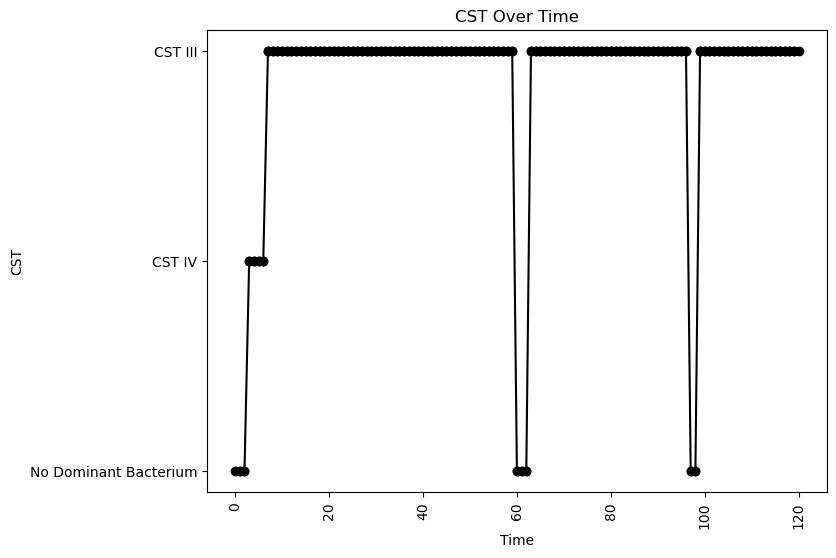


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.025240596651192507
nAB->Li: -0.23633652825841406
nAB->oLB: -0.03116236884509621
Li->nAB: 0.1763483926971653
Li Self: -0.039376305486859414
Li->oLB: -0.38014641128363136
oLB->nAB: -0.11602957975038841
oLB->Li: -0.24619037016917772
oLB Self: -0.07675666128302137

Simulation 9190 follows a valid CST progression:


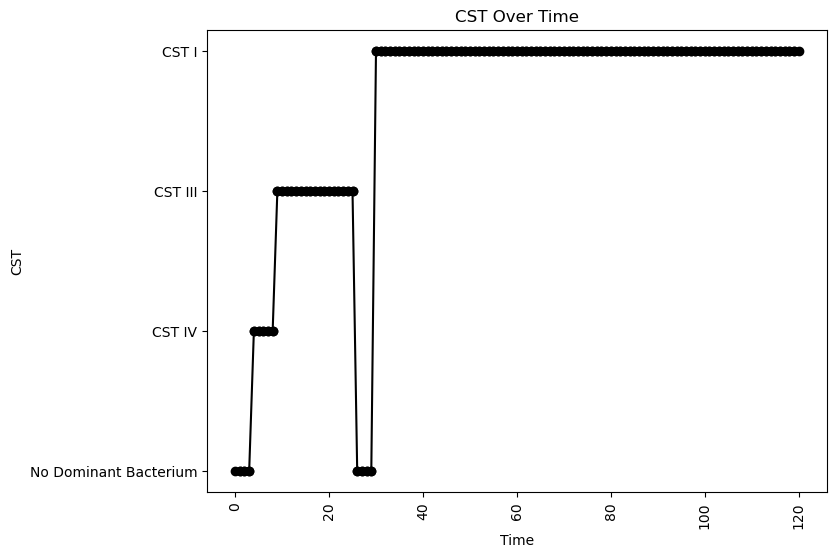


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.06967846000948563
oLB Growth: 0.7070472171500886
nAB Self: -0.03347365320470362
nAB->Li: -0.3943109083807535
nAB->oLB: -0.48192594788191007
Li->nAB: 0.13569700862523504
Li Self: -0.05207457400755521
Li->oLB: -0.4042467585218563
oLB->nAB: -0.4637120385721214
oLB->Li: 0.1258529447012584
oLB Self: -0.08017140099722596

Simulation 9191 follows a valid CST progression:


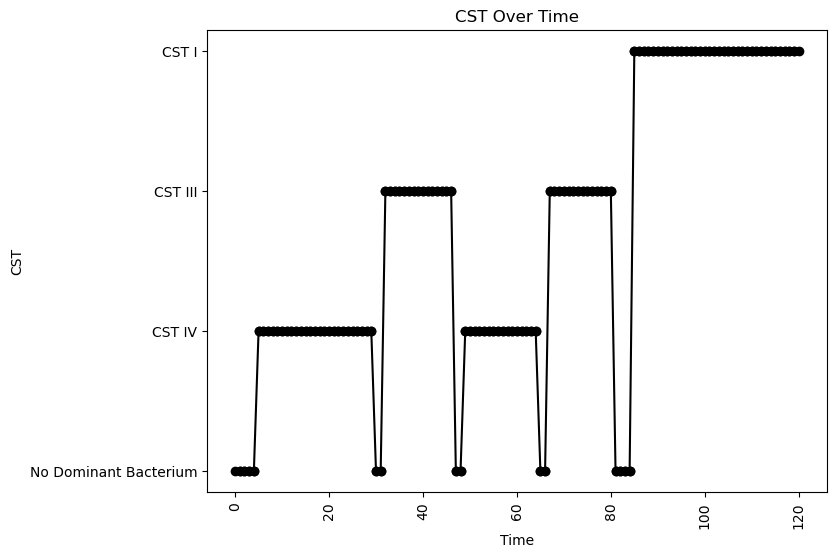


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.05072073600009906
oLB Growth: 1.0858755226067296
nAB Self: -0.05082179280296809
nAB->Li: -0.3841169527352616
nAB->oLB: -0.34126048596676667
Li->nAB: 0.013407633991733947
Li Self: -0.09255521157293681
Li->oLB: -0.04953345690816652
oLB->nAB: -0.24315966816523132
oLB->Li: 0.3714187994101258
oLB Self: -0.053793208055245345

Simulation 9192 follows a valid CST progression:


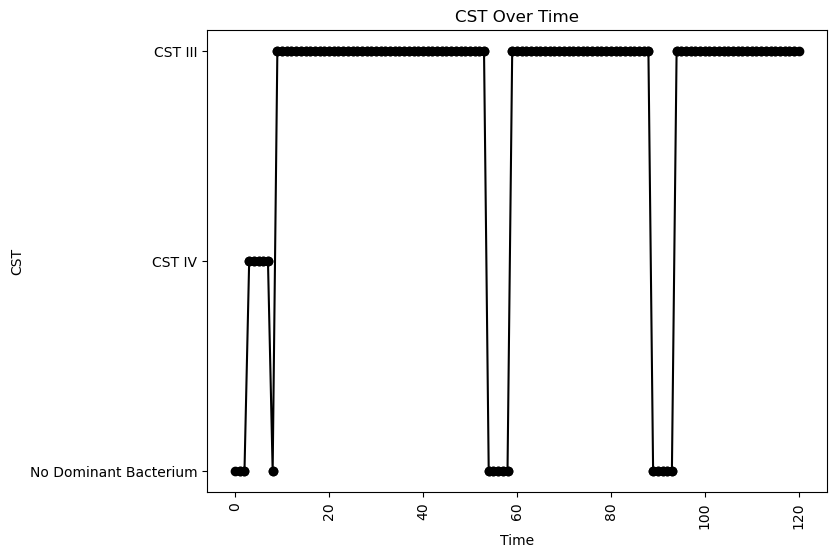


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.08735084938548374
nAB->Li: -0.37622710979372637
nAB->oLB: -0.06323632901694581
Li->nAB: 0.14420437660400864
Li Self: -0.07531877949605849
Li->oLB: -0.042064412421209674
oLB->nAB: -0.3388704593522895
oLB->Li: -0.40620587247406814
oLB Self: -0.012382802868665957

Simulation 9197 follows a valid CST progression:


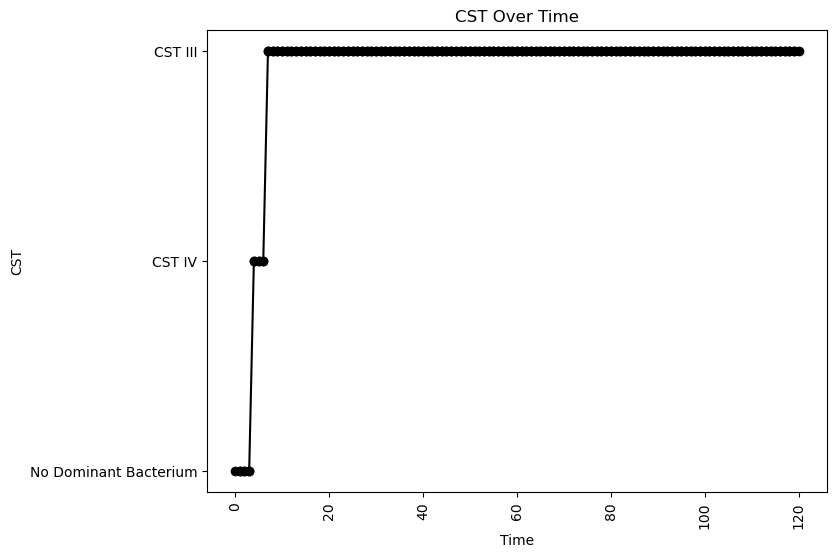


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.06328949954702878
nAB->Li: -0.09158978199402384
nAB->oLB: -0.12789319030939666
Li->nAB: 0.23421896239538453
Li Self: -0.042873514821539394
Li->oLB: -0.1782655318099881
oLB->nAB: -0.48144667194835267
oLB->Li: -0.2906614848094844
oLB Self: -0.06704727437713025

Simulation 9205 follows a valid CST progression:


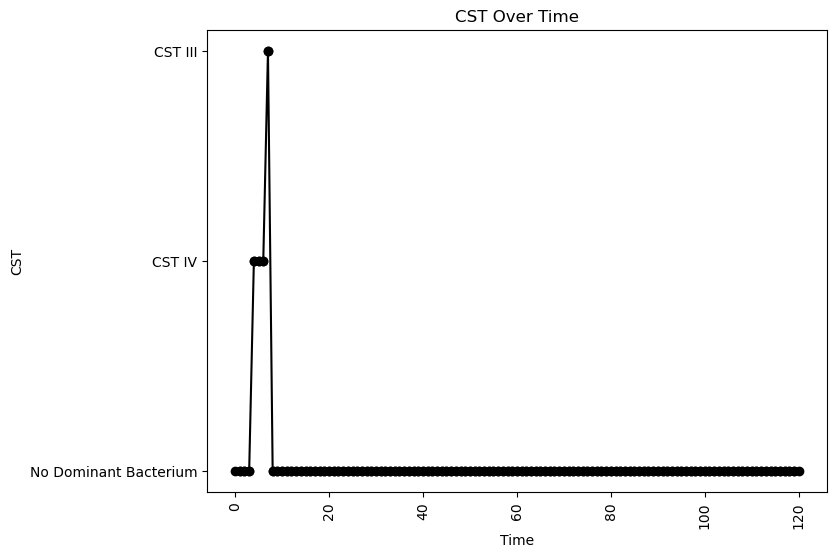


Interaction Parameters:
nAB Growth: 2.2088016144568243
Li Growth: 0.06896981749088955
oLB Growth: 1.1274304047774089
nAB Self: -0.047965170100473326
nAB->Li: 0.07580597279874124
nAB->oLB: -0.30598551523280015
Li->nAB: 0.14485726133580856
Li Self: -0.025238628800717325
Li->oLB: 0.24013736393778695
oLB->nAB: -0.3264565192379507
oLB->Li: 0.23965842862142928
oLB Self: -0.022493359827707254

Simulation 9212 follows a valid CST progression:


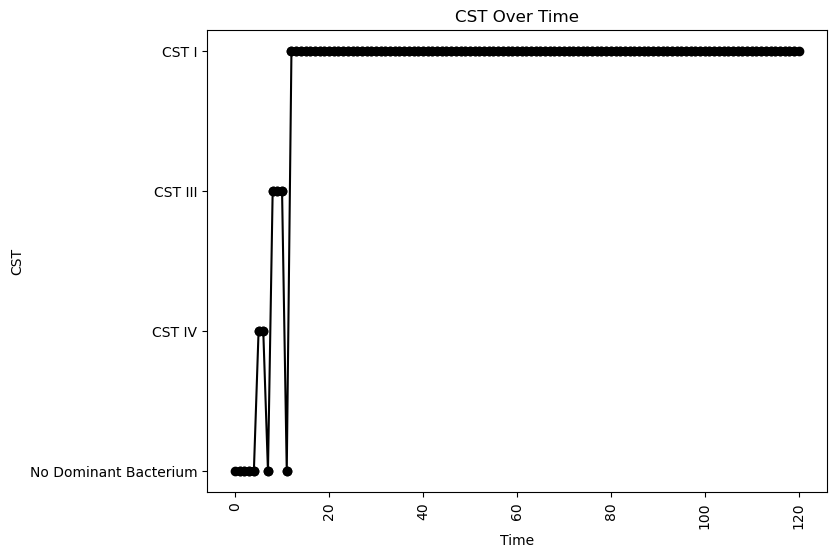


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.06309763455319839
oLB Growth: 0.9128027925042091
nAB Self: -0.08314666499520648
nAB->Li: -0.18327590855756726
nAB->oLB: -0.4914794308417414
Li->nAB: 0.28346297782981544
Li Self: -0.0795948059746063
Li->oLB: -0.21257514890241974
oLB->nAB: -0.11968996210732308
oLB->Li: 0.18583423489640938
oLB Self: -0.03649882469430203

Simulation 9217 follows a valid CST progression:


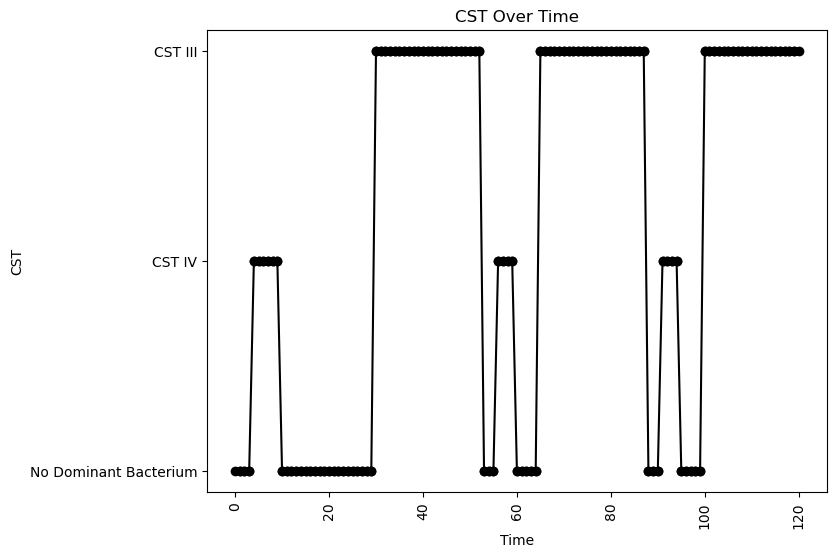


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.31283715112689753
oLB Growth: 0.20431222189445272
nAB Self: -0.06260133808127097
nAB->Li: -0.22156706684977617
nAB->oLB: -0.07628891357195111
Li->nAB: 0.025268291805092047
Li Self: -0.06803700235016968
Li->oLB: -0.41532768811661835
oLB->nAB: -0.45375686740927756
oLB->Li: 0.007674513217095447
oLB Self: -0.06101863169346369

Simulation 9218 follows a valid CST progression:


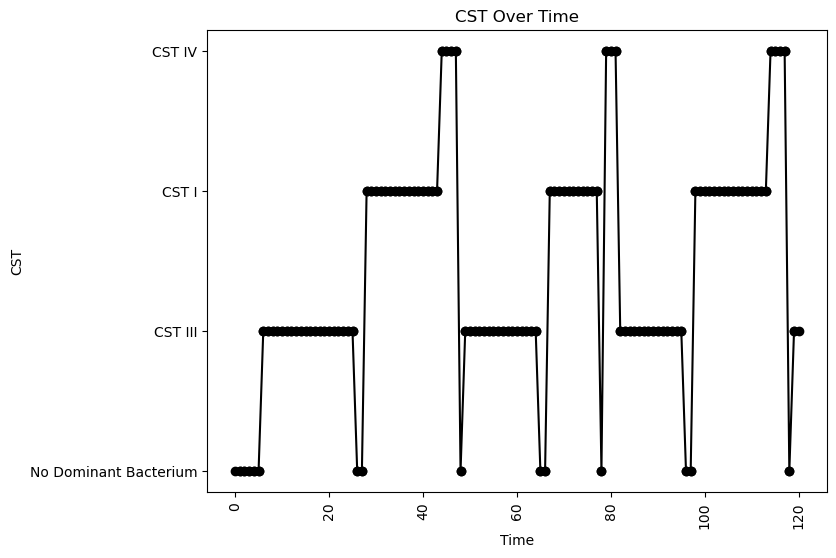


Interaction Parameters:
nAB Growth: 2.292952252819776
Li Growth: 0.3811093372528236
oLB Growth: 0.25066683866219575
nAB Self: -0.09622228212025287
nAB->Li: -0.12753640018357526
nAB->oLB: -0.1616605512507968
Li->nAB: 0.21957812750252204
Li Self: -0.03427288555568461
Li->oLB: -0.11976263855704233
oLB->nAB: -0.20137485801309285
oLB->Li: 0.005977442142561795
oLB Self: -0.07557518341140482

Simulation 9220 follows a valid CST progression:


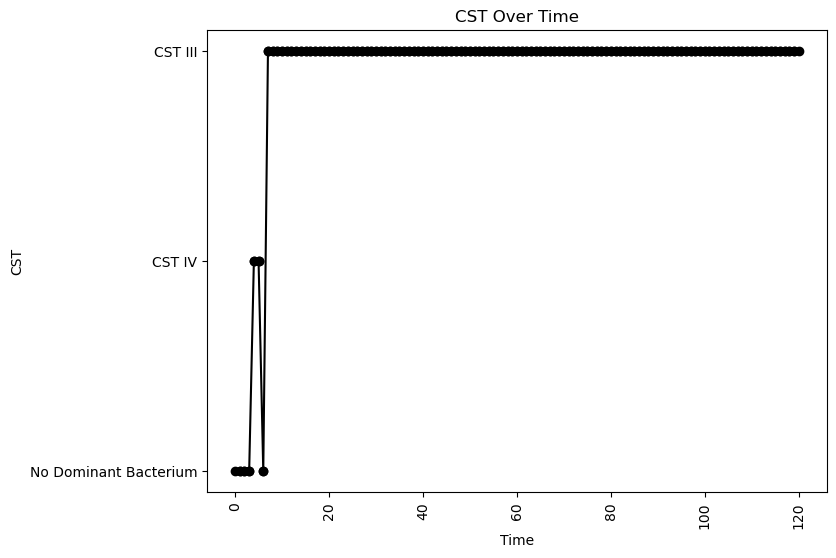


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.08025736792386925
nAB->Li: -0.19349381697136392
nAB->oLB: -0.4338566938894039
Li->nAB: 0.4489034314756776
Li Self: -0.09911085977847353
Li->oLB: 0.21047000075126443
oLB->nAB: -0.2329611352856149
oLB->Li: -0.2892873975778938
oLB Self: -0.06438476504548353

Simulation 9222 follows a valid CST progression:


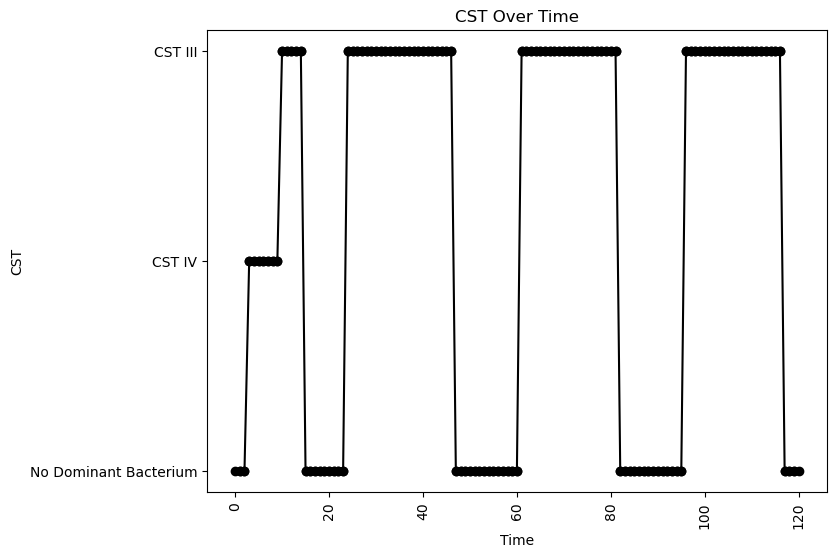


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.00417375509129575
nAB->Li: -0.04474726637498433
nAB->oLB: -0.06992610290573203
Li->nAB: 0.017285053627058122
Li Self: -0.013956299683983
Li->oLB: 0.0920635498866531
oLB->nAB: -0.3140292162658919
oLB->Li: -0.06058172302852194
oLB Self: -0.06746365932778252

Simulation 9223 follows a valid CST progression:


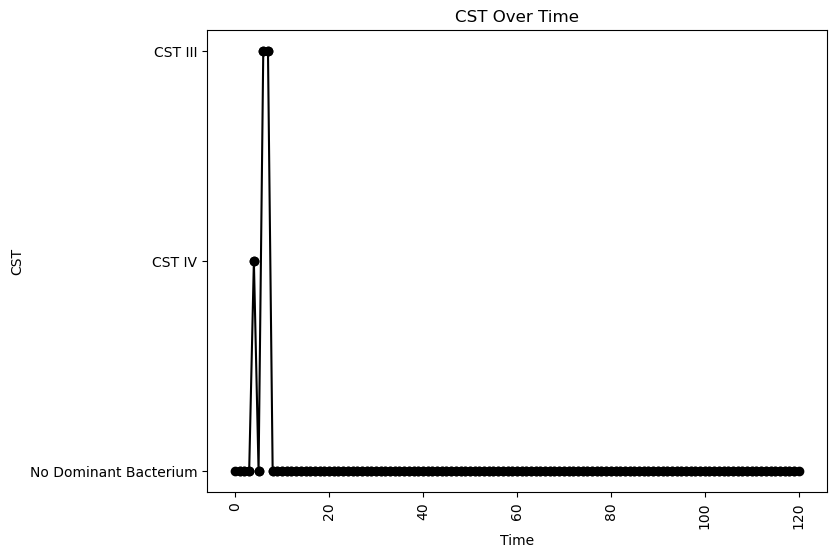


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.06395284075479375
nAB->Li: -0.08149809444493711
nAB->oLB: -0.18148285807433928
Li->nAB: 0.4622958814477395
Li Self: -0.0982742127056321
Li->oLB: 0.26782374960188793
oLB->nAB: -0.10768786216656195
oLB->Li: 0.17940670042760465
oLB Self: -0.07680766946295327

Simulation 9233 follows a valid CST progression:


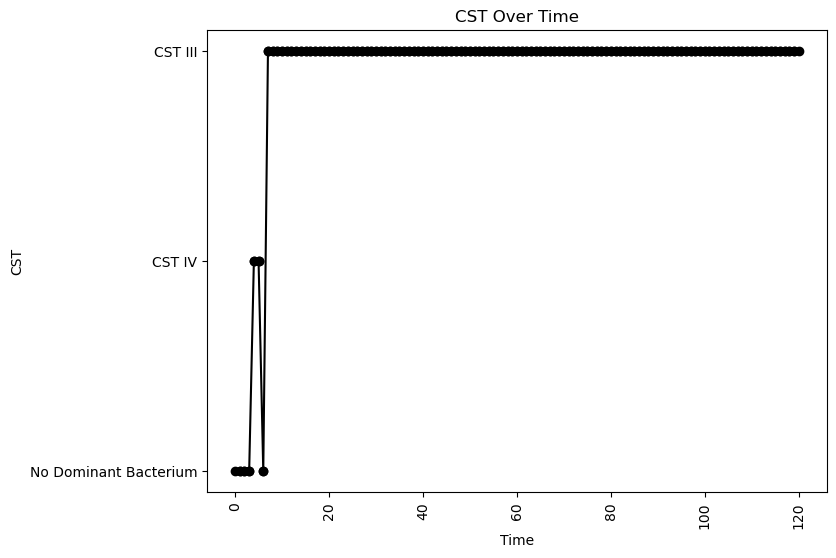


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.08116103653382951
nAB->Li: -0.22660045392940803
nAB->oLB: -0.4045158388057652
Li->nAB: 0.35351265340413973
Li Self: -0.09953365786163977
Li->oLB: -0.0807767108465593
oLB->nAB: -0.1658337695227488
oLB->Li: -0.45759393864512815
oLB Self: -0.09880485548794751

Simulation 9246 follows a valid CST progression:


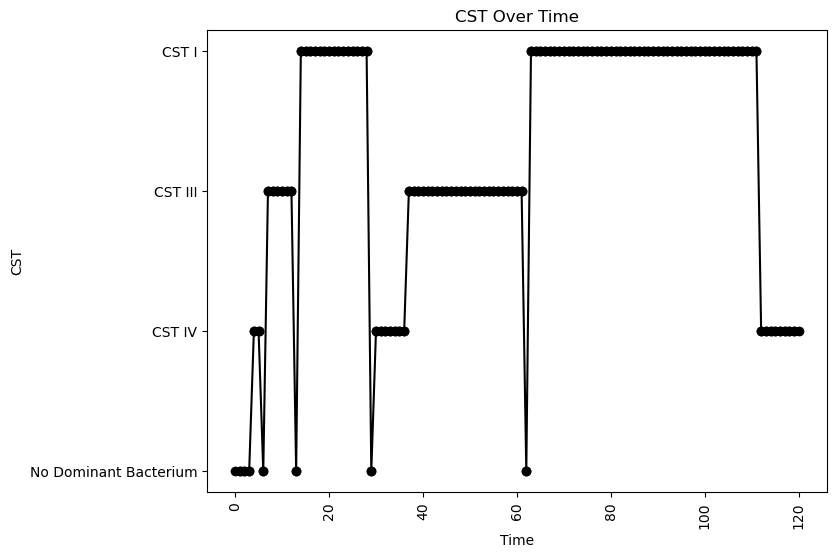


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.06664492138468138
oLB Growth: 0.6588037441195057
nAB Self: -0.07231758846590951
nAB->Li: -0.32355799873473057
nAB->oLB: -0.04644515572056934
Li->nAB: 0.2471468605648276
Li Self: -0.02296882282354558
Li->oLB: -0.16388481138538769
oLB->nAB: -0.37988190959298995
oLB->Li: 0.1275753027765375
oLB Self: -0.0383070687779616

Simulation 9248 follows a valid CST progression:


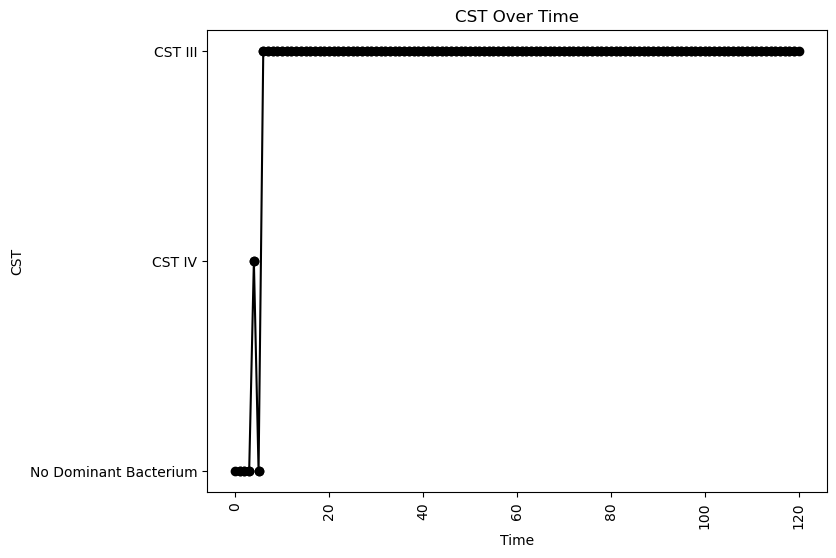


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.07857263743921178
nAB->Li: -0.004758525335624708
nAB->oLB: -0.22010193287096208
Li->nAB: 0.44865806226827976
Li Self: -0.028148931183963888
Li->oLB: -0.19366716050130356
oLB->nAB: -0.034964765498986305
oLB->Li: -0.10012450031818615
oLB Self: -0.015183882789666647

Simulation 9249 follows a valid CST progression:


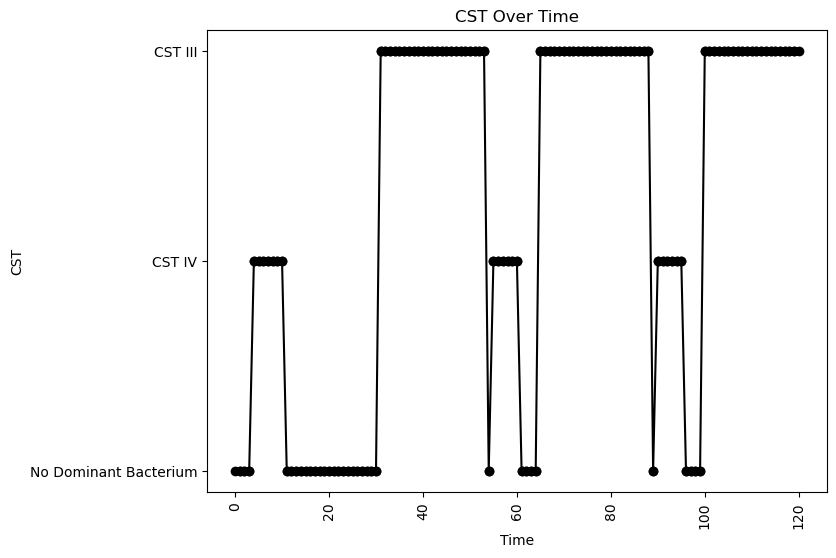


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.09495322135056958
nAB->Li: -0.4529731166565256
nAB->oLB: -0.46364549225439233
Li->nAB: 0.07340214237139031
Li Self: -0.08656584564766952
Li->oLB: -0.06559762145306086
oLB->nAB: -0.37075167038084644
oLB->Li: -0.3115674629101195
oLB Self: -0.01974087043524826

Simulation 9257 follows a valid CST progression:


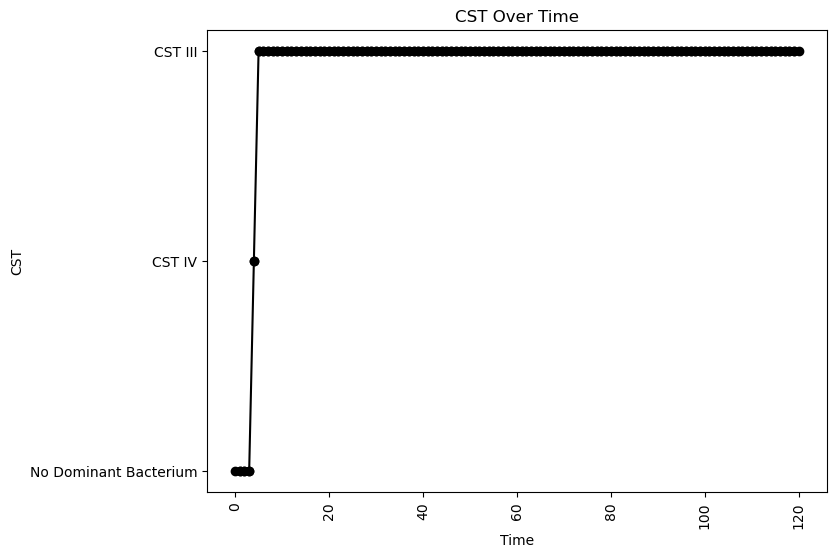


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.06806014290478743
oLB Growth: 0.20414555748463747
nAB Self: -0.06595513919775967
nAB->Li: 0.19716337646564952
nAB->oLB: -0.17119991864636858
Li->nAB: 0.4902218357038357
Li Self: -0.0719151128925322
Li->oLB: 0.08315298695976225
oLB->nAB: -0.4605238849152994
oLB->Li: -0.08597025313232387
oLB Self: -0.05884876615310326

Simulation 9261 follows a valid CST progression:


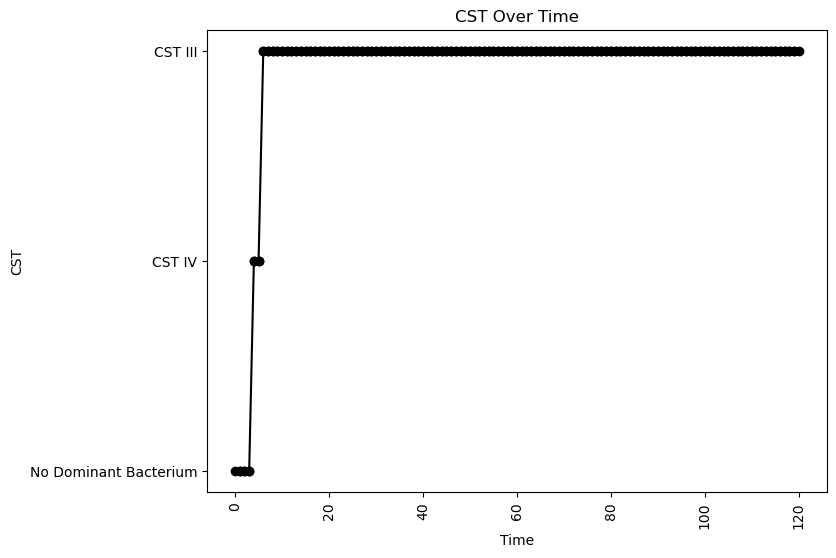


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.08706921631452555
nAB->Li: -0.24492394258208122
nAB->oLB: -0.45623256049168015
Li->nAB: 0.3187854186694623
Li Self: -0.003514240543273775
Li->oLB: -0.1216930587947519
oLB->nAB: -0.38270218173670645
oLB->Li: -0.22060830287339833
oLB Self: -0.08153854621709603

Simulation 9266 follows a valid CST progression:


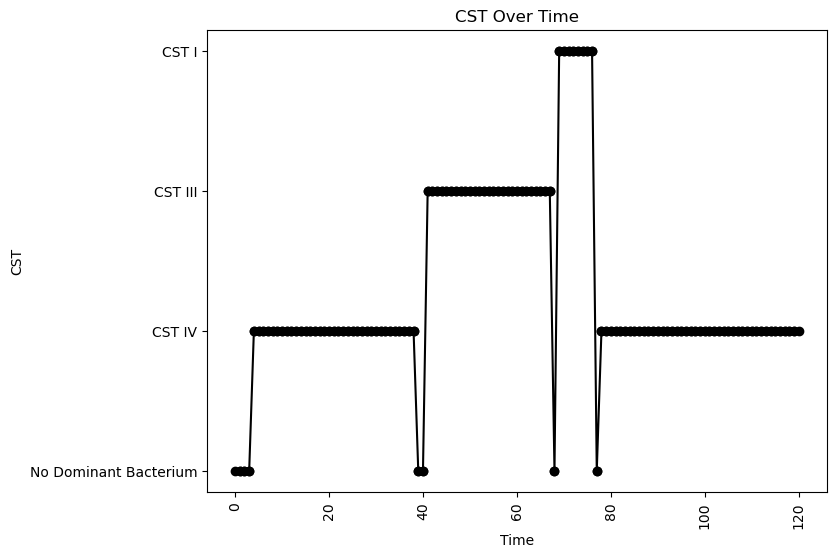


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.06999681049097056
nAB->Li: -0.48872383996622115
nAB->oLB: -0.15188114474822534
Li->nAB: -0.006068342057736098
Li Self: -0.03704322769025255
Li->oLB: -0.2882854503651683
oLB->nAB: -0.12999730572248464
oLB->Li: 0.08283438846896807
oLB Self: -0.08027279151873379

Simulation 9274 follows a valid CST progression:


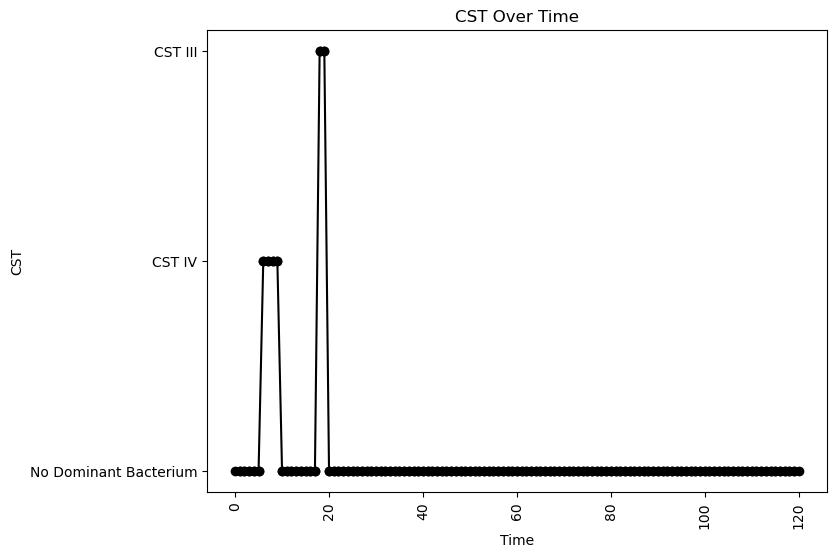


Interaction Parameters:
nAB Growth: 2.273308423784788
Li Growth: 0.21379365303203854
oLB Growth: 0.4879467602516997
nAB Self: -0.061112479312392325
nAB->Li: -0.21692374467209052
nAB->oLB: -0.36984015939066556
Li->nAB: 0.015940485966459472
Li Self: -0.043339139185630586
Li->oLB: 0.3965868125512011
oLB->nAB: -0.26053229450736937
oLB->Li: 0.28780257546174115
oLB Self: -0.026191469748576016

Simulation 9275 follows a valid CST progression:


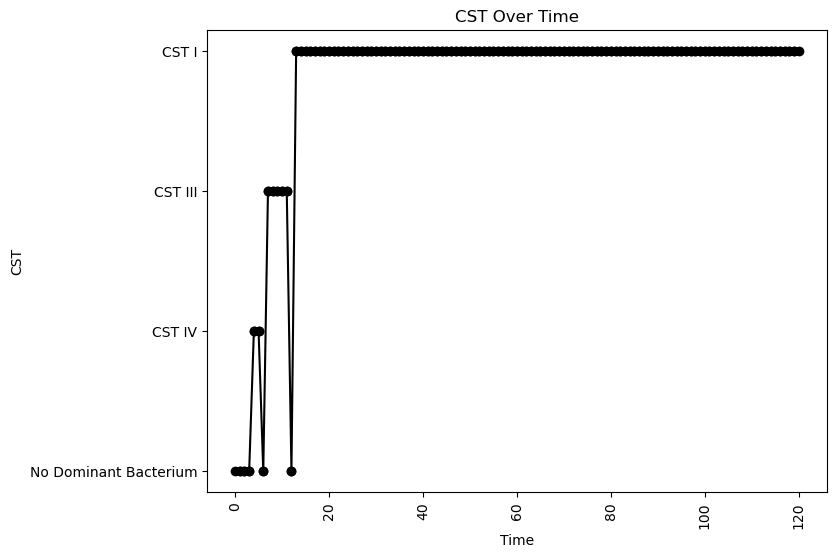


Interaction Parameters:
nAB Growth: 2.2563448832512942
Li Growth: 0.18581463105996995
oLB Growth: 0.40127498600949585
nAB Self: -0.08611184187079775
nAB->Li: -0.4082556303554873
nAB->oLB: -0.2360019052133338
Li->nAB: 0.1964861619009074
Li Self: -0.06452493641188012
Li->oLB: -0.22121450904006568
oLB->nAB: -0.12447415620039148
oLB->Li: 0.1496398811642874
oLB Self: -0.06140809636828716

Simulation 9276 follows a valid CST progression:


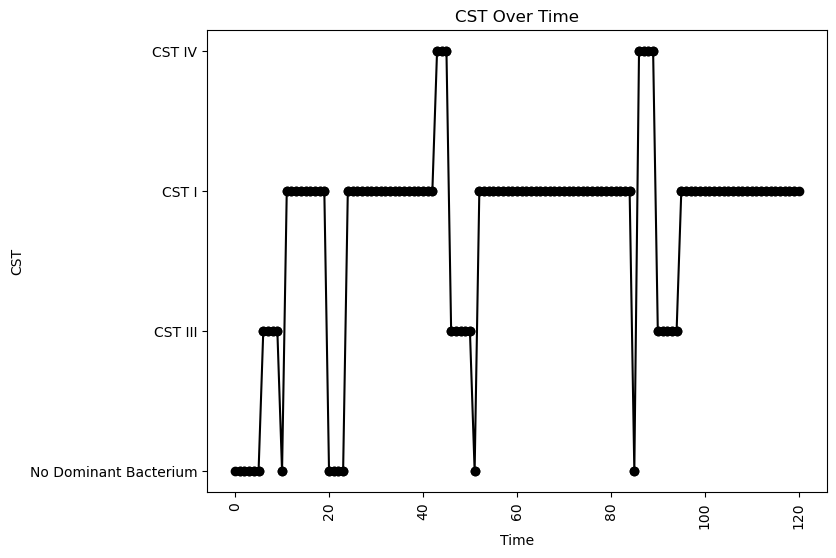


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.17610330069069868
oLB Growth: 0.3756702562538966
nAB Self: -0.010244871642402523
nAB->Li: -0.44927614507785824
nAB->oLB: -0.18038720866412578
Li->nAB: 0.44593210594683064
Li Self: -0.07465805875359549
Li->oLB: -0.1602828081655645
oLB->nAB: -0.2189022253465447
oLB->Li: 0.18503052675689524
oLB Self: -0.09784227233887052

Simulation 9278 follows a valid CST progression:


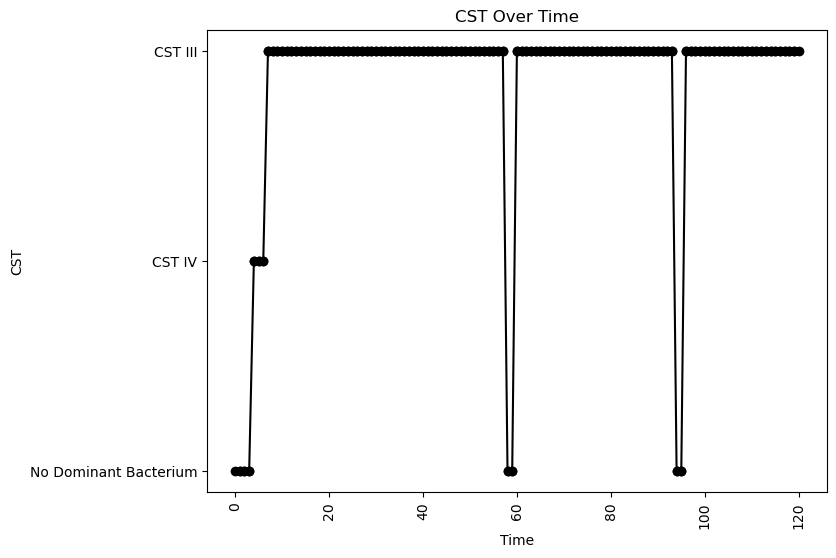


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.03837725110012093
oLB Growth: 1.155917868199191
nAB Self: -0.008600384738984057
nAB->Li: -0.41534562599805336
nAB->oLB: -0.020284903433109902
Li->nAB: 0.3332564278402096
Li Self: -0.08552312060776271
Li->oLB: 0.37984025079580475
oLB->nAB: -0.4697633760591114
oLB->Li: -0.2967062516070329
oLB Self: -0.05633875325296229

Simulation 9287 follows a valid CST progression:


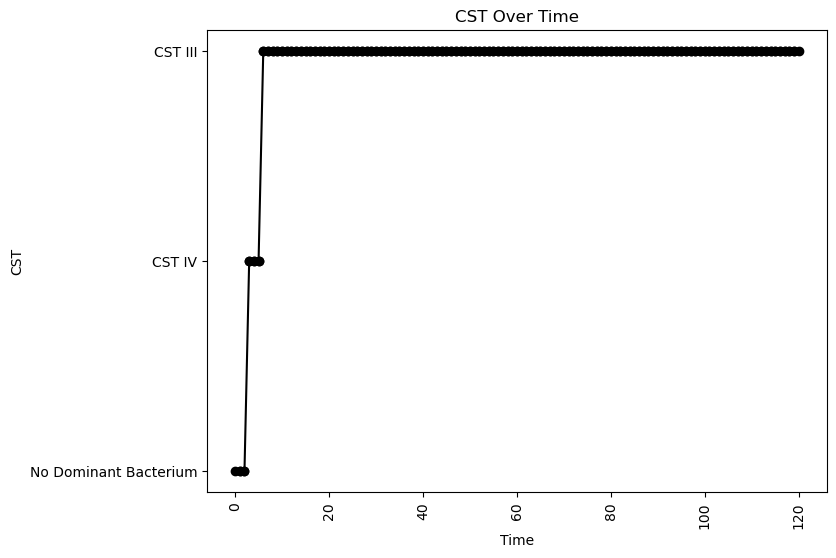


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.06806014290478743
oLB Growth: 0.20414555748463747
nAB Self: -0.007476433336703531
nAB->Li: -0.026070930040924645
nAB->oLB: -0.09218722271176816
Li->nAB: 0.4004486237573973
Li Self: -0.07110627525841526
Li->oLB: 0.27194876080050356
oLB->nAB: -0.2076779934378818
oLB->Li: -0.02142159585052894
oLB Self: -0.053652038315660414

Simulation 9288 follows a valid CST progression:


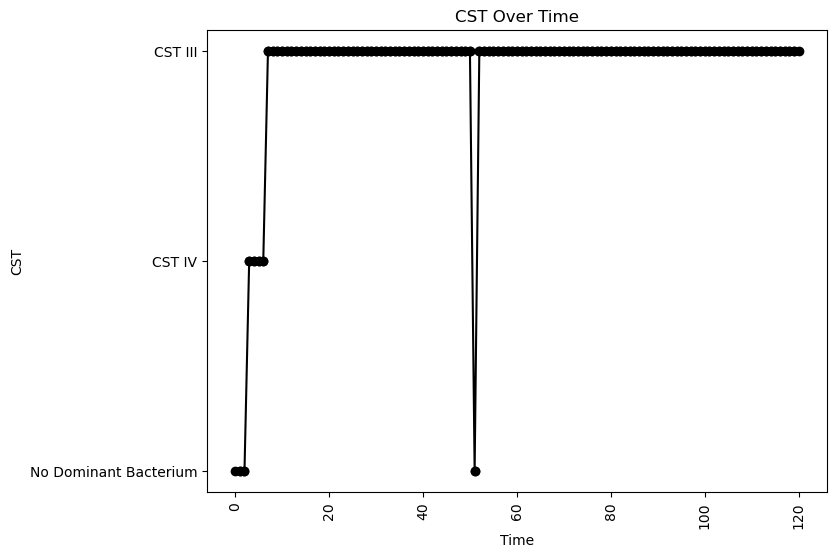


Interaction Parameters:
nAB Growth: 2.2088016144568243
Li Growth: 0.05268768924856952
oLB Growth: 1.1274304047774089
nAB Self: -0.02219476416017367
nAB->Li: -0.2497539088274509
nAB->oLB: -0.07355459739644676
Li->nAB: 0.15620608338891195
Li Self: -0.06813350108829208
Li->oLB: -0.3867802756780851
oLB->nAB: -0.41333351950800334
oLB->Li: -0.00493733905109589
oLB Self: -0.06427315964162013

Simulation 9295 follows a valid CST progression:


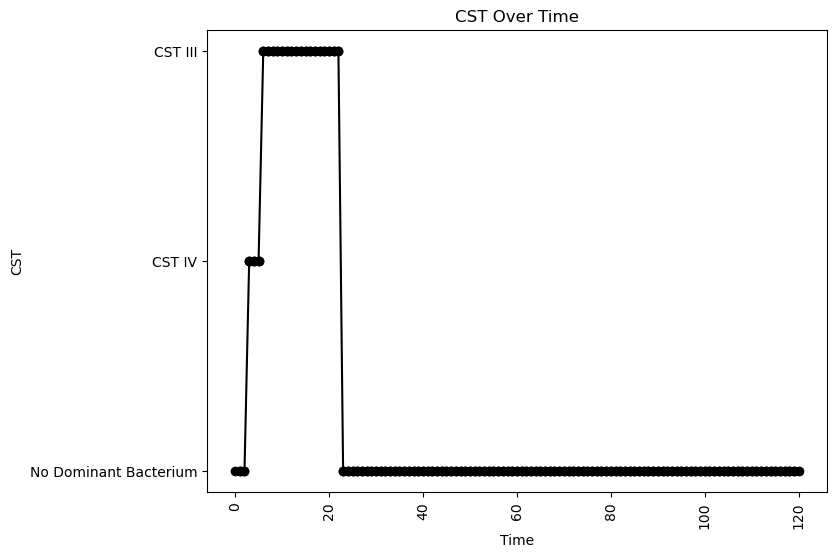


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.030165680365134714
nAB->Li: 0.072035928206025
nAB->oLB: -0.06617369111418947
Li->nAB: 0.35148316281125924
Li Self: -0.05733328403121177
Li->oLB: -0.47539006210113555
oLB->nAB: -0.48750807249787426
oLB->Li: -0.4484617716706968
oLB Self: -0.08755683983194892

Simulation 9297 follows a valid CST progression:


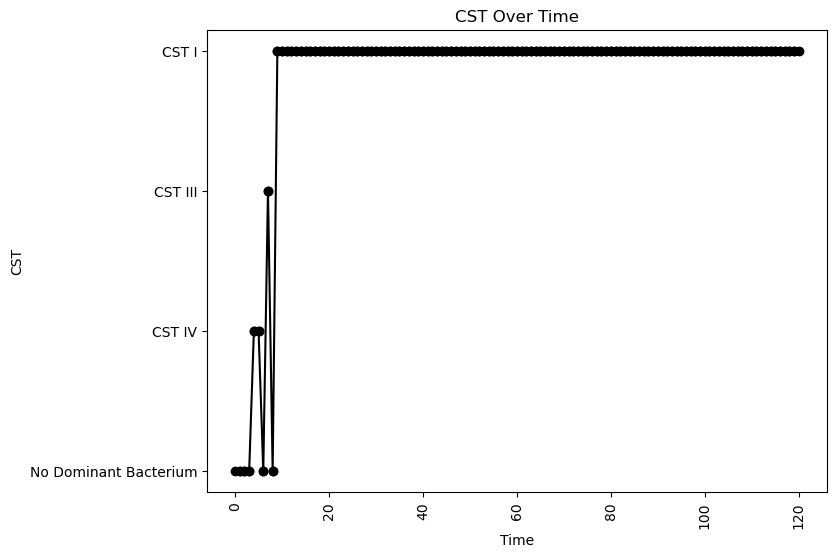


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.20038347347767843
oLB Growth: 0.058910478352813524
nAB Self: -0.0568338053857769
nAB->Li: -0.13458480653006427
nAB->oLB: -0.34814436416647165
Li->nAB: 0.18970671419081753
Li Self: -0.02564658214569604
Li->oLB: -0.01659004491078253
oLB->nAB: -0.38307245176103244
oLB->Li: 0.28034573271311003
oLB Self: -0.03770799075347651

Simulation 9299 follows a valid CST progression:


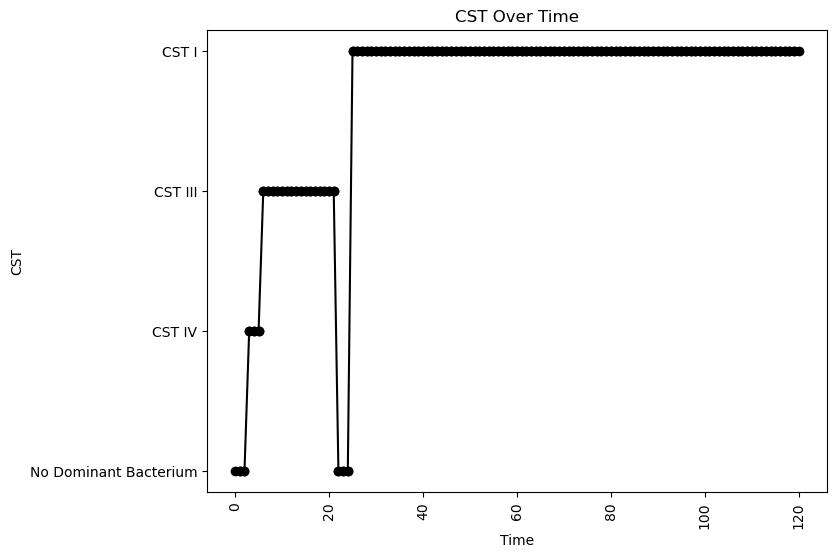


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.032848134952031385
nAB->Li: -0.40162690244937804
nAB->oLB: -0.38725518609811205
Li->nAB: 0.3009363268224632
Li Self: -0.048855926070336134
Li->oLB: 0.019502490224254987
oLB->nAB: -0.3657880673319824
oLB->Li: 0.07006334316978258
oLB Self: -0.010578720547746487

Simulation 9307 follows a valid CST progression:


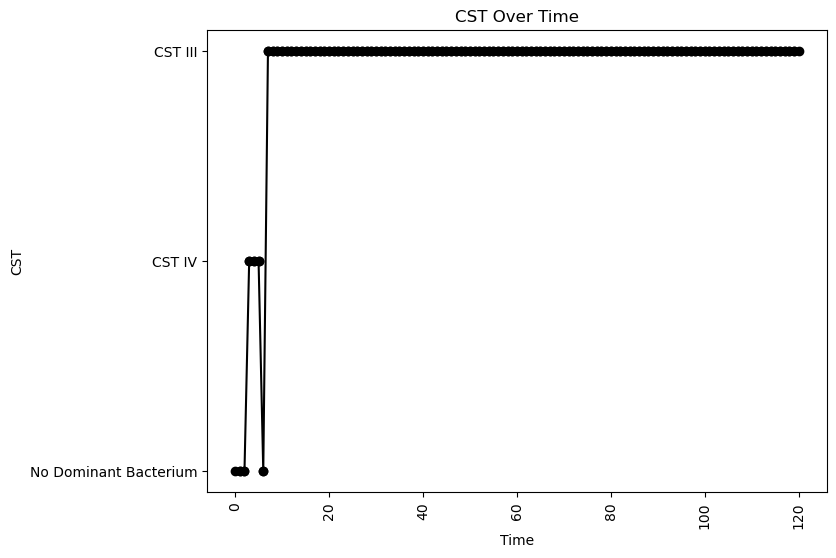


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.20702482041869727
oLB Growth: 0.2578671787060779
nAB Self: -0.061368361126558794
nAB->Li: 0.0635992987304721
nAB->oLB: -0.43321160746639203
Li->nAB: 0.13041283341358634
Li Self: -0.03105591120726066
Li->oLB: -0.3864146063923258
oLB->nAB: -0.417721000605038
oLB->Li: -0.4340007619426923
oLB Self: -0.012703112905074365

Simulation 9311 follows a valid CST progression:


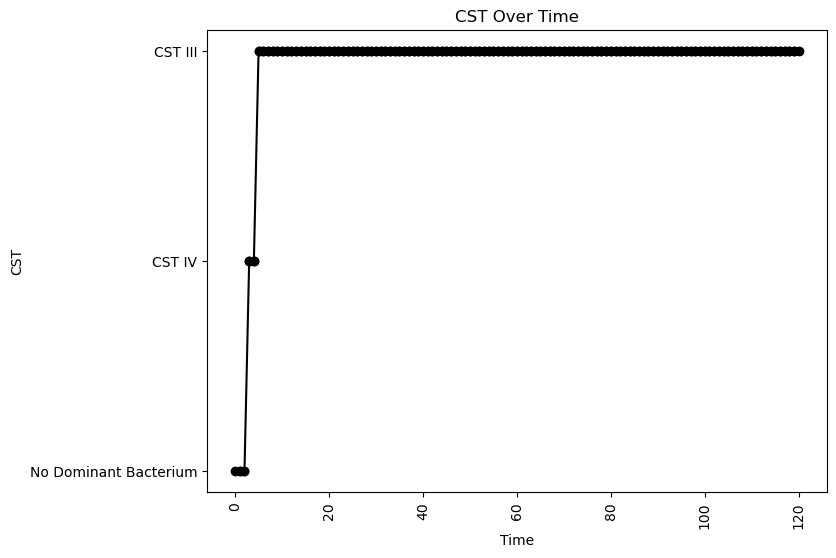


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.009045102440471811
nAB->Li: -0.1121171822813054
nAB->oLB: -0.2345749609566149
Li->nAB: 0.43651891342054716
Li Self: -0.03487087188035709
Li->oLB: 0.316603526841034
oLB->nAB: -0.31997103810690786
oLB->Li: 0.20451719323406548
oLB Self: -0.051456534447772366

Simulation 9313 follows a valid CST progression:


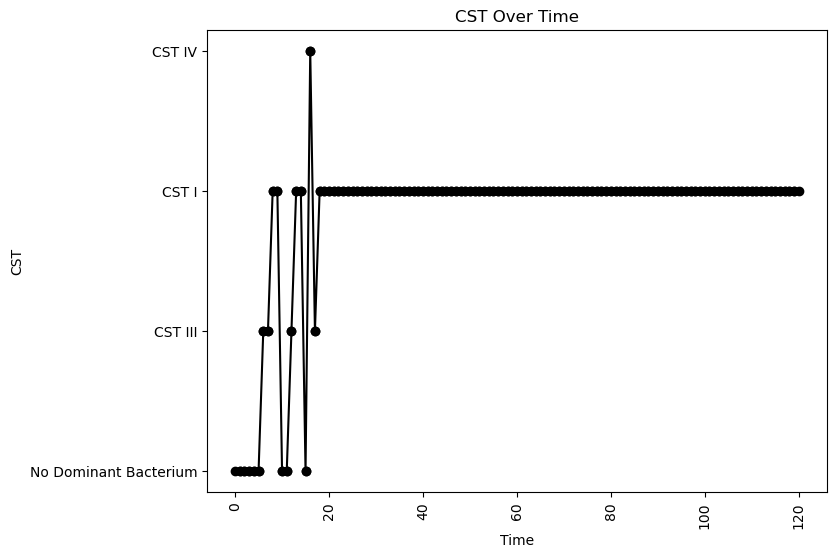


Interaction Parameters:
nAB Growth: 2.2657644953374403
Li Growth: 0.33971199375194217
oLB Growth: 0.2949021384914317
nAB Self: -0.0014887756819737807
nAB->Li: -0.1339317200608654
nAB->oLB: -0.05793215027573245
Li->nAB: 0.46890257289042525
Li Self: -0.09097859182601808
Li->oLB: -0.2707409269366842
oLB->nAB: -0.2809035671108602
oLB->Li: 0.26393338339923067
oLB Self: -0.015955042953605156

Simulation 9316 follows a valid CST progression:


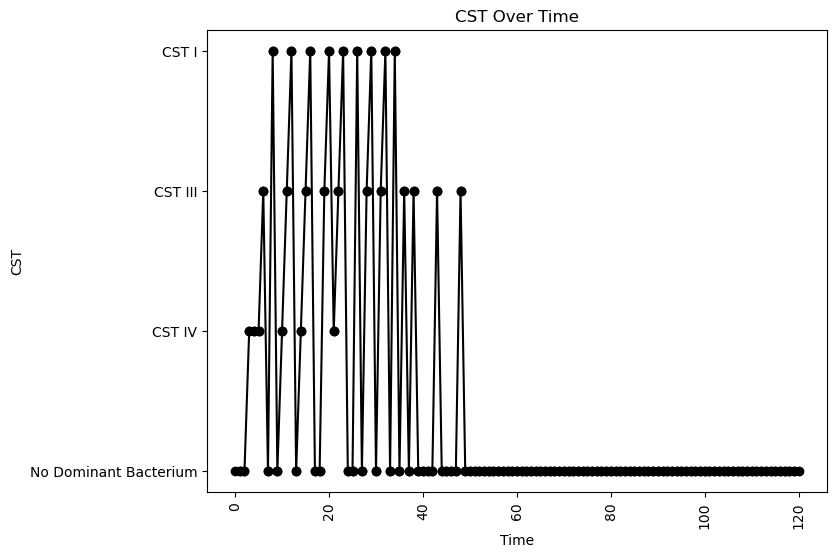


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.036881505175393486
nAB->Li: -0.06687843412116806
nAB->oLB: -0.012047260704603602
Li->nAB: 0.3792853661048533
Li Self: -0.005342122019690254
Li->oLB: -0.21419248016551673
oLB->nAB: -0.4833575723390178
oLB->Li: 0.2065996654944533
oLB Self: -0.0975415017260548

Simulation 9321 follows a valid CST progression:


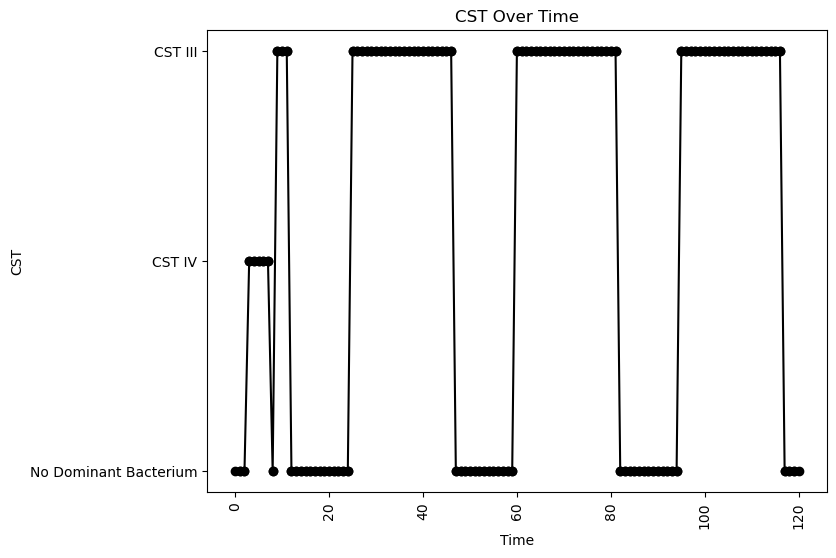


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.05375661565136554
nAB->Li: -0.16198361034023506
nAB->oLB: -0.21235057682958014
Li->nAB: 0.08927703437148249
Li Self: -0.07238651076442226
Li->oLB: 0.43538724267930484
oLB->nAB: -0.18035870154714784
oLB->Li: -0.4727928109096283
oLB Self: -0.07625279497385465

Simulation 9326 follows a valid CST progression:


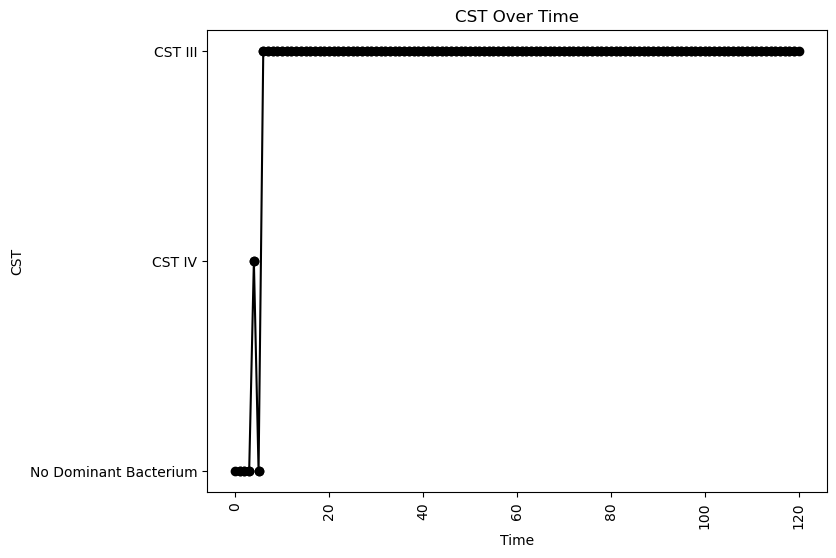


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.3086922313371324
oLB Growth: 0.31765248508565325
nAB Self: -0.06399163502763416
nAB->Li: 0.040540985762601456
nAB->oLB: -0.14907317269362624
Li->nAB: 0.2995049333459816
Li Self: -0.022544791654994706
Li->oLB: -0.3372209871030045
oLB->nAB: -0.3421312630839844
oLB->Li: -0.4122635689468187
oLB Self: -0.06178919890471816

Simulation 9328 follows a valid CST progression:


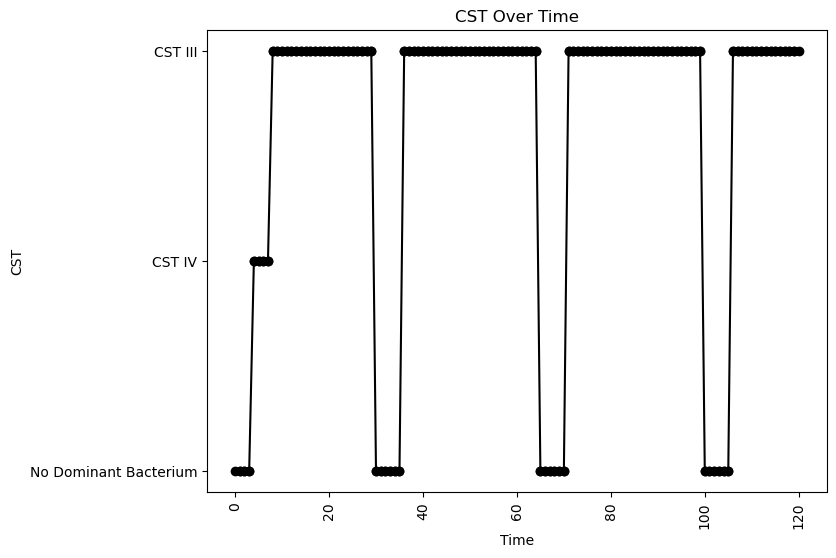


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.05438757679249977
nAB->Li: -0.040319018205514146
nAB->oLB: -0.010952130633847756
Li->nAB: 0.2059425379086094
Li Self: -0.06091208566503555
Li->oLB: -0.2954668012792664
oLB->nAB: -0.36754045447710904
oLB->Li: 0.1462521437473805
oLB Self: -0.08589320407966981

Simulation 9334 follows a valid CST progression:


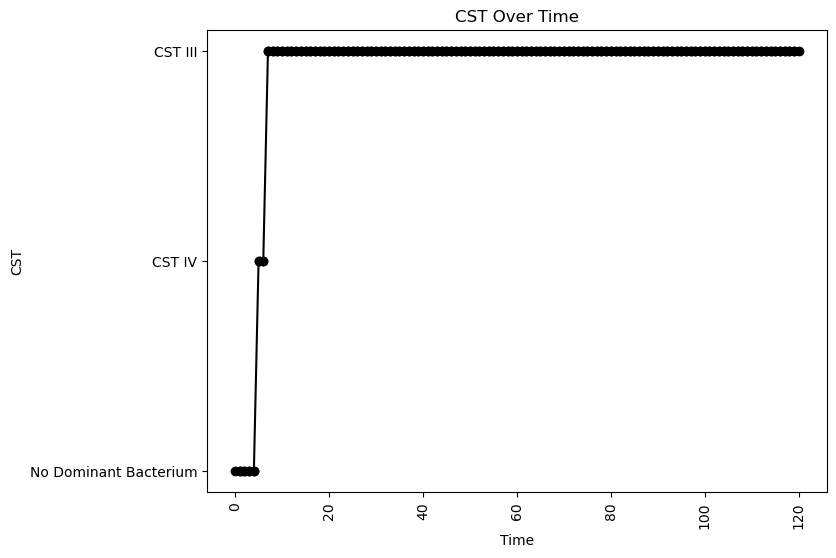


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.06281194853188597
nAB->Li: -0.3294624294968279
nAB->oLB: -0.32329444322973144
Li->nAB: 0.2074803539256016
Li Self: -0.04573078413452684
Li->oLB: 0.4414224811354416
oLB->nAB: -0.27432835074196565
oLB->Li: 0.11987381957144483
oLB Self: -0.024154684549511682

Simulation 9336 follows a valid CST progression:


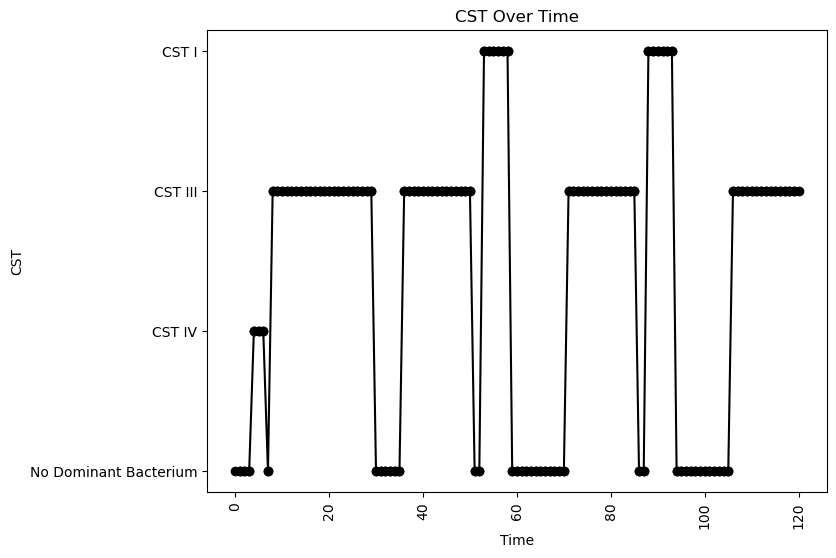


Interaction Parameters:
nAB Growth: 2.1964345031105657
Li Growth: 0.04025066595693835
oLB Growth: 1.2138354993931422
nAB Self: -0.02491056176623893
nAB->Li: -0.30157687329436156
nAB->oLB: -0.38624990445836593
Li->nAB: 0.3025237783934689
Li Self: -0.08161362854420527
Li->oLB: 0.05985842509232986
oLB->nAB: -0.2190756136662782
oLB->Li: -0.04308704763488791
oLB Self: -0.04176084983118098

Simulation 9351 follows a valid CST progression:


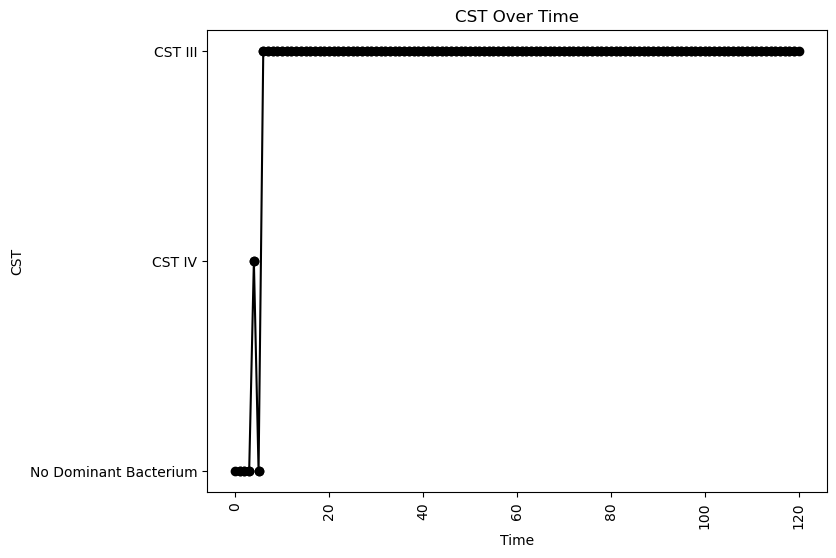


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.05739994626081137
oLB Growth: 0.11031283255203692
nAB Self: -0.08354526630115237
nAB->Li: -0.45412573170769177
nAB->oLB: -0.14633294913632733
Li->nAB: 0.41560293071154153
Li Self: -0.043795397158550485
Li->oLB: 0.13570885410977662
oLB->nAB: -0.4513206346010185
oLB->Li: -0.2311425916567088
oLB Self: -0.059279478872262224

Simulation 9352 follows a valid CST progression:


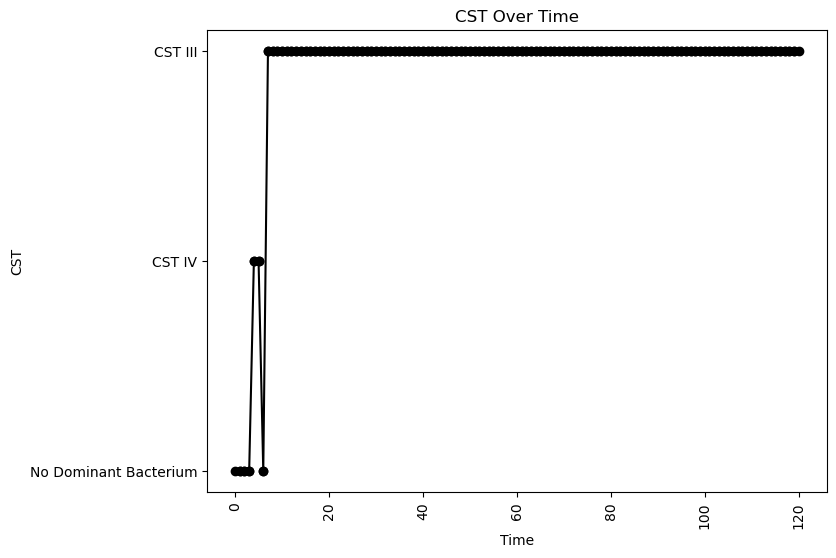


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.030791433601219026
nAB->Li: 0.09759709508130443
nAB->oLB: -0.25239204119307057
Li->nAB: 0.3247904940407672
Li Self: -0.06054776138814268
Li->oLB: 0.47259239472460257
oLB->nAB: -0.2177946209023377
oLB->Li: -0.04951808778487515
oLB Self: -0.0966488251718374

Simulation 9354 follows a valid CST progression:


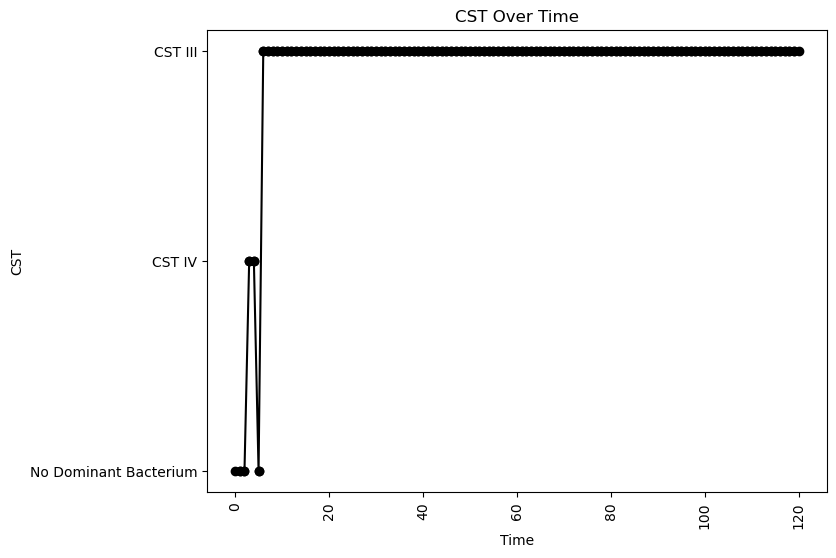


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.2000069967392168
oLB Growth: 0.1731103059651596
nAB Self: -0.02162987738130065
nAB->Li: 0.06273737084486064
nAB->oLB: -0.0014714032971142044
Li->nAB: 0.21194942273929762
Li Self: -0.008493671614771686
Li->oLB: -0.27980504730055555
oLB->nAB: -0.2964789704385762
oLB->Li: -0.09777489254229399
oLB Self: -0.05651296986651581

Simulation 9360 follows a valid CST progression:


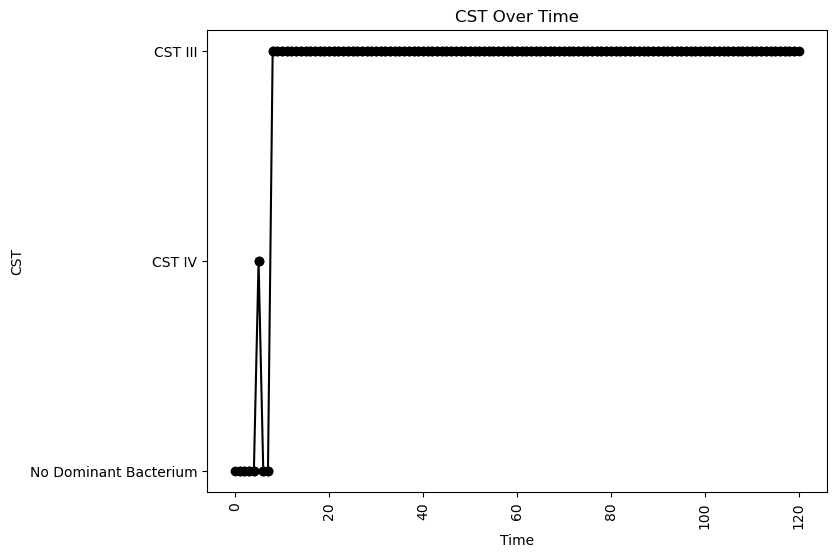


Interaction Parameters:
nAB Growth: 2.226251684223429
Li Growth: 0.18306540981481267
oLB Growth: 0.4505921706771102
nAB Self: -0.016444187210417488
nAB->Li: -0.03338524812575672
nAB->oLB: -0.13692846356225008
Li->nAB: 0.13474387144596478
Li Self: -0.055662480257252095
Li->oLB: 0.3653310812081182
oLB->nAB: -0.05254089346376245
oLB->Li: -0.21112115861084246
oLB Self: -0.07853906286133693

Simulation 9363 follows a valid CST progression:


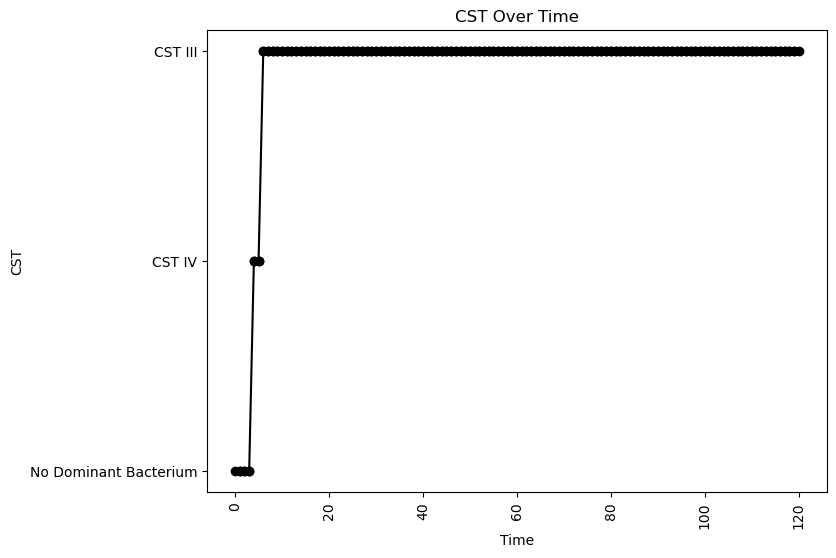


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.1410207484940009
oLB Growth: 0.03504834427483494
nAB Self: -0.03262792236863664
nAB->Li: 0.025340356958495902
nAB->oLB: -0.12413797041742336
Li->nAB: 0.2450151191629808
Li Self: -0.009415496125538991
Li->oLB: -0.06492552984899197
oLB->nAB: -0.14017038971353785
oLB->Li: -0.3491897409259051
oLB Self: -0.0990519615869976

Simulation 9364 follows a valid CST progression:


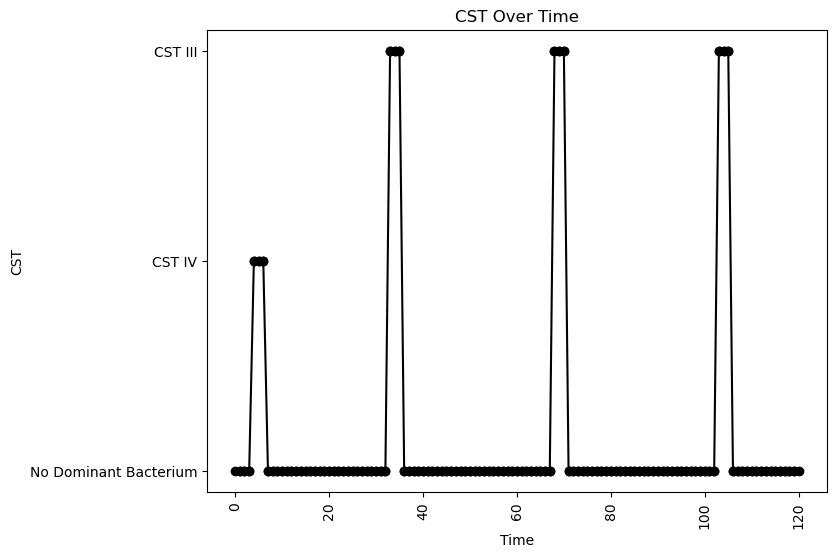


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.0784158944997972
nAB->Li: 0.029083965954086022
nAB->oLB: -0.14558145126057587
Li->nAB: 0.09140880002989438
Li Self: -0.06745182229421348
Li->oLB: 0.472655089350974
oLB->nAB: -0.08776672399590973
oLB->Li: -0.13696316526838298
oLB Self: -0.011886405492470595

Simulation 9366 follows a valid CST progression:


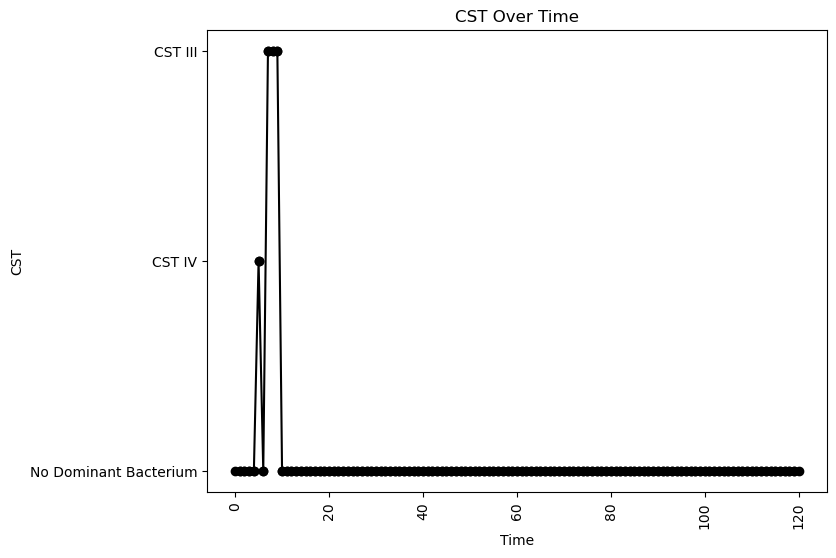


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.06309763455319839
oLB Growth: 0.9128027925042091
nAB Self: -0.04183235840518737
nAB->Li: -0.38488466834799795
nAB->oLB: -0.055177771494064554
Li->nAB: 0.38429961542738844
Li Self: -0.04857953442727851
Li->oLB: 0.2946899680100534
oLB->nAB: -0.11829346416444209
oLB->Li: 0.24990458630981882
oLB Self: -0.05191974842451089

Simulation 9368 follows a valid CST progression:


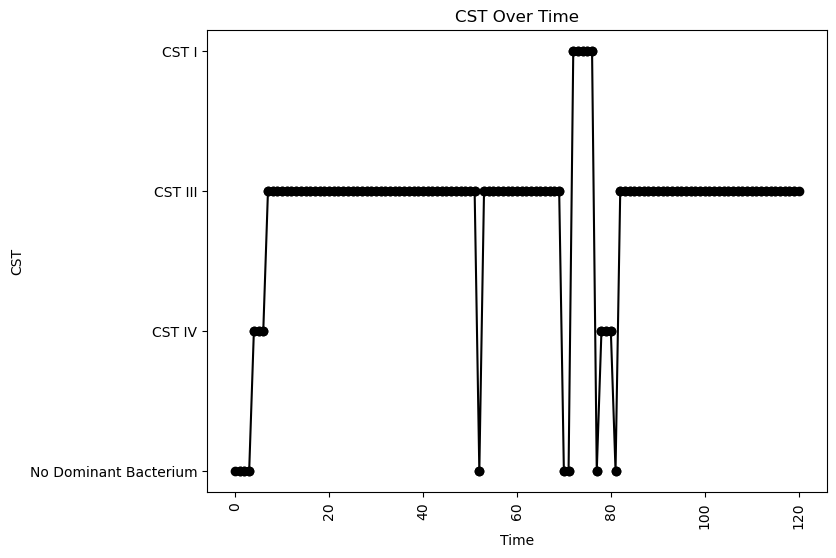


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06585771742084753
oLB Growth: 0.3756702562538966
nAB Self: -0.026337647348140633
nAB->Li: -0.4026145947624734
nAB->oLB: -0.34549964328667143
Li->nAB: 0.24985541524763877
Li Self: -0.09828343219111248
Li->oLB: -0.31026348013766525
oLB->nAB: -0.318932789742991
oLB->Li: -0.05718559808900431
oLB Self: -0.056430820048049654

Simulation 9369 follows a valid CST progression:


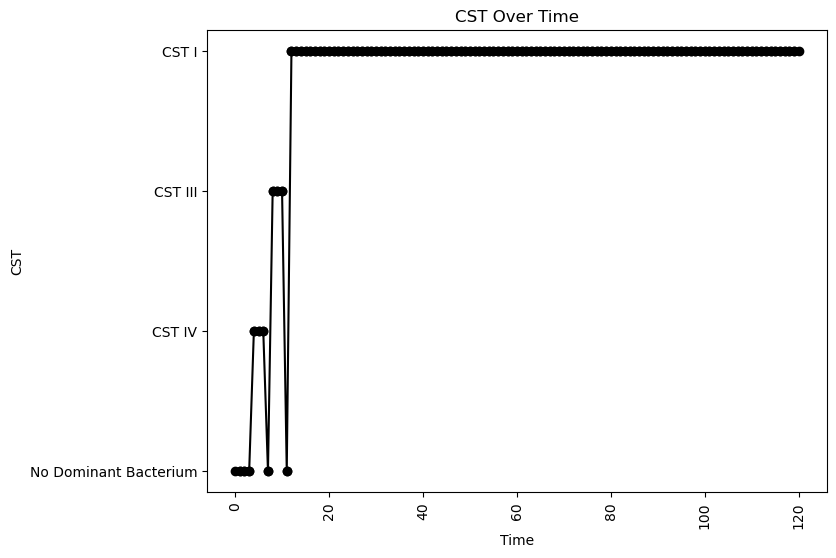


Interaction Parameters:
nAB Growth: 2.237390108639889
Li Growth: 0.07509700685781084
oLB Growth: 0.33048149496262014
nAB Self: -0.09601555371997743
nAB->Li: -0.11605304434757202
nAB->oLB: -0.43017128779795233
Li->nAB: 0.2525162529652021
Li Self: -0.06401107839751834
Li->oLB: -0.45583785353553846
oLB->nAB: -0.4365427316953214
oLB->Li: 0.3784414735578645
oLB Self: -0.09365367506886257

Simulation 9380 follows a valid CST progression:


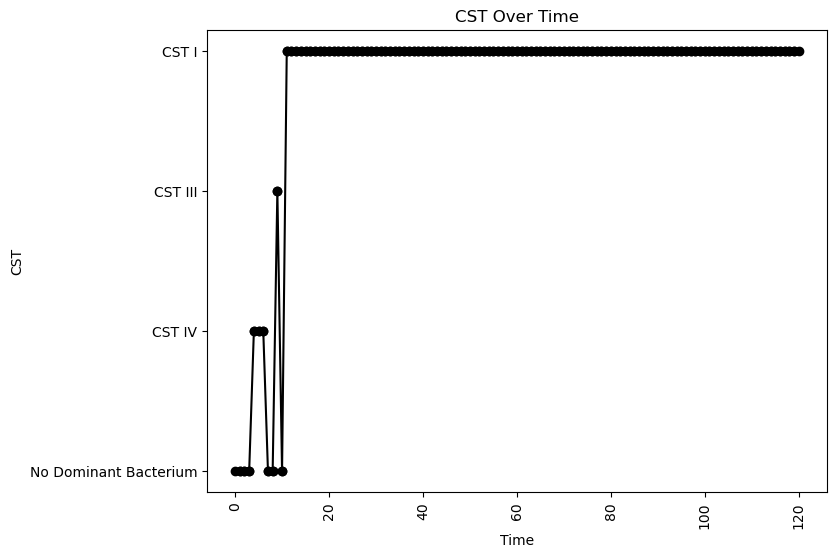


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.05867200423948303
nAB->Li: -0.37040818158866917
nAB->oLB: -0.24346331642978042
Li->nAB: 0.425667977322591
Li Self: -0.06121031733390527
Li->oLB: -0.4460070740623391
oLB->nAB: -0.08843096137035372
oLB->Li: 0.3256294114450148
oLB Self: -0.08250145137424661

Simulation 9384 follows a valid CST progression:


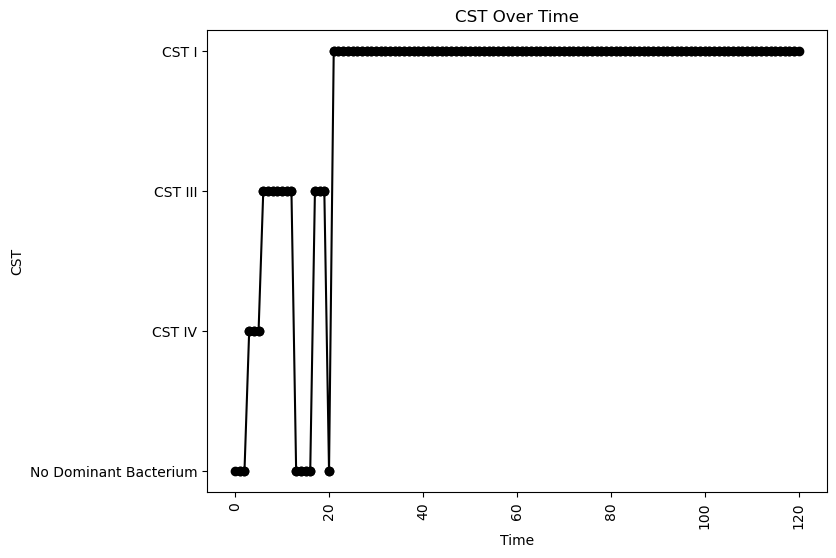


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.05739994626081137
oLB Growth: 0.11031283255203692
nAB Self: -0.004961061217911039
nAB->Li: -0.327243066449246
nAB->oLB: -0.26117571937760087
Li->nAB: 0.44993598482207275
Li Self: -0.08109270781460358
Li->oLB: -0.2741327613084306
oLB->nAB: -0.3723871082759608
oLB->Li: 0.16752535271917146
oLB Self: -0.04559543285572853

Simulation 9389 follows a valid CST progression:


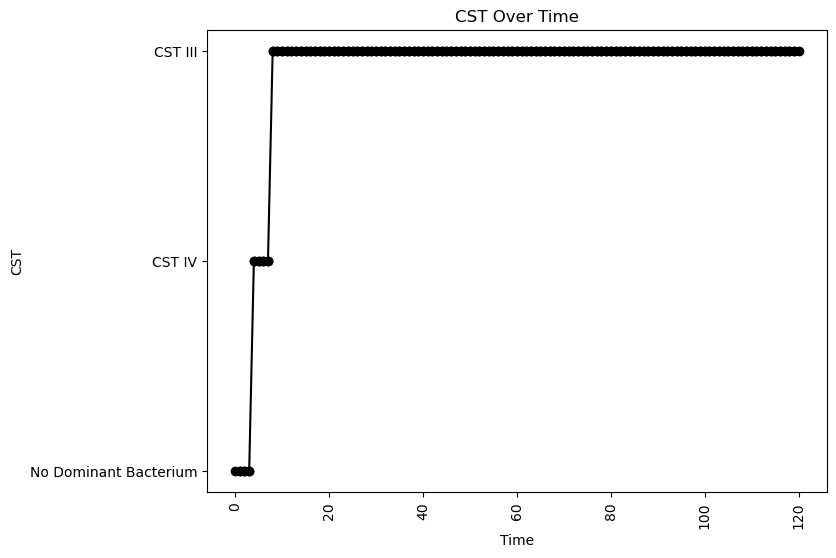


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.030113947469346466
nAB->Li: -0.13249222240683695
nAB->oLB: -0.49761156548842617
Li->nAB: 0.1665764404372776
Li Self: -0.04875185113557142
Li->oLB: -0.03017661621016754
oLB->nAB: -0.4168058877070167
oLB->Li: -0.4746993074162115
oLB Self: -0.06011560308720119

Simulation 9391 follows a valid CST progression:


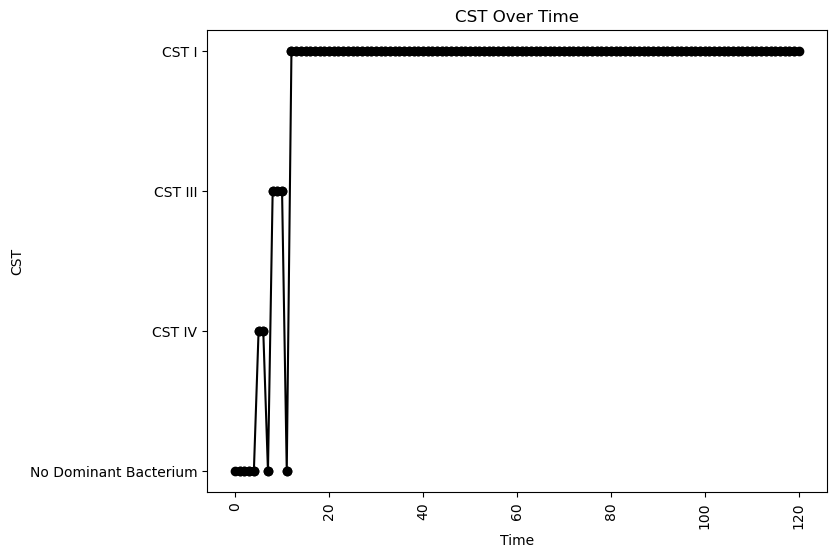


Interaction Parameters:
nAB Growth: 2.2142045310429657
Li Growth: 0.07620814051067723
oLB Growth: 0.5869968137568807
nAB Self: -0.00952055760501945
nAB->Li: -0.151498974937263
nAB->oLB: -0.4210750591849358
Li->nAB: 0.3155560405810587
Li Self: -0.02338426658495492
Li->oLB: -0.48834454356814716
oLB->nAB: -0.2935345888111827
oLB->Li: 0.15648589672567215
oLB Self: -0.04702342767025906

Simulation 9392 follows a valid CST progression:


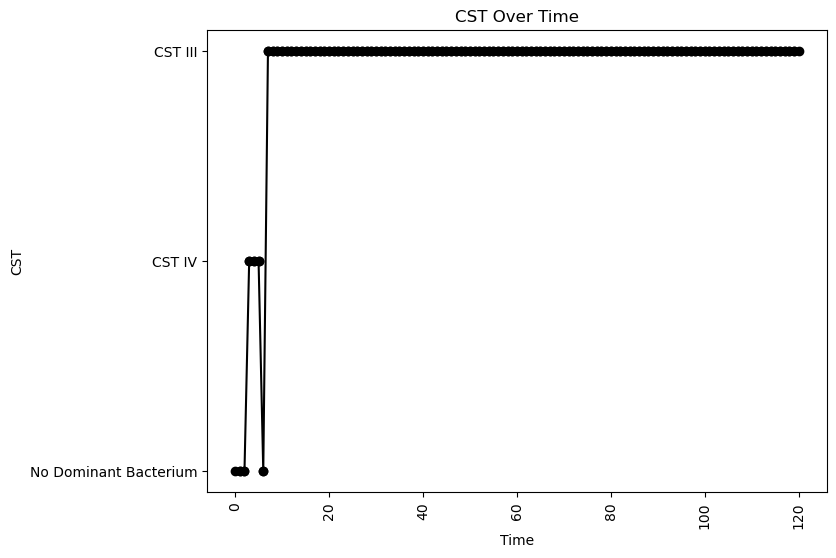


Interaction Parameters:
nAB Growth: 2.186256611128965
Li Growth: 0.06569643521101441
oLB Growth: 0.9552867864056962
nAB Self: -0.07562549533737276
nAB->Li: -0.131324238330283
nAB->oLB: -0.2784451323400289
Li->nAB: 0.39953117935995197
Li Self: -0.04037334750175768
Li->oLB: -0.3398561868033171
oLB->nAB: -0.20983853969209665
oLB->Li: -0.1892258104733604
oLB Self: -0.05873621317253664

Simulation 9394 follows a valid CST progression:


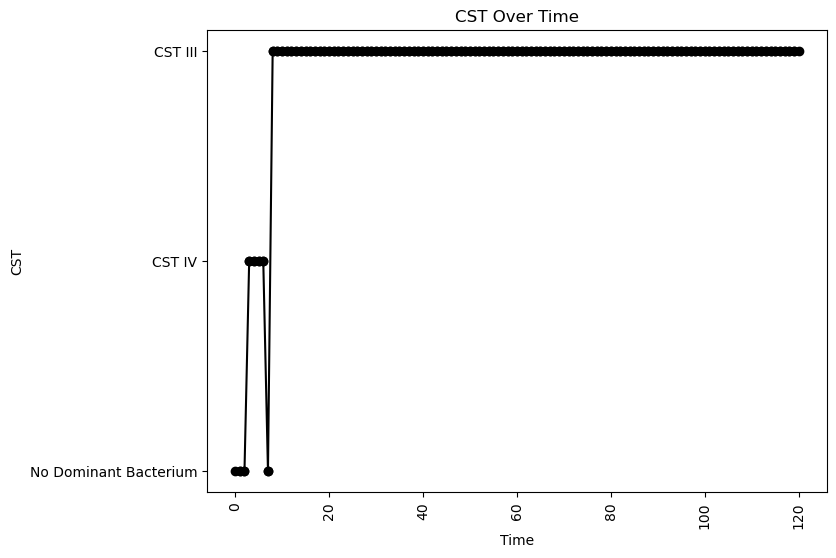


Interaction Parameters:
nAB Growth: 2.2446146183745257
Li Growth: 0.13098120497052443
oLB Growth: 0.5438660619757455
nAB Self: -0.0787284991437297
nAB->Li: -0.25039506124992694
nAB->oLB: -0.20369514930557558
Li->nAB: 0.13923275989338235
Li Self: -0.08072734561397094
Li->oLB: -0.3902414798864963
oLB->nAB: -0.31537186009646234
oLB->Li: -0.4885154622060383
oLB Self: -0.04928685097445057

Simulation 9399 follows a valid CST progression:


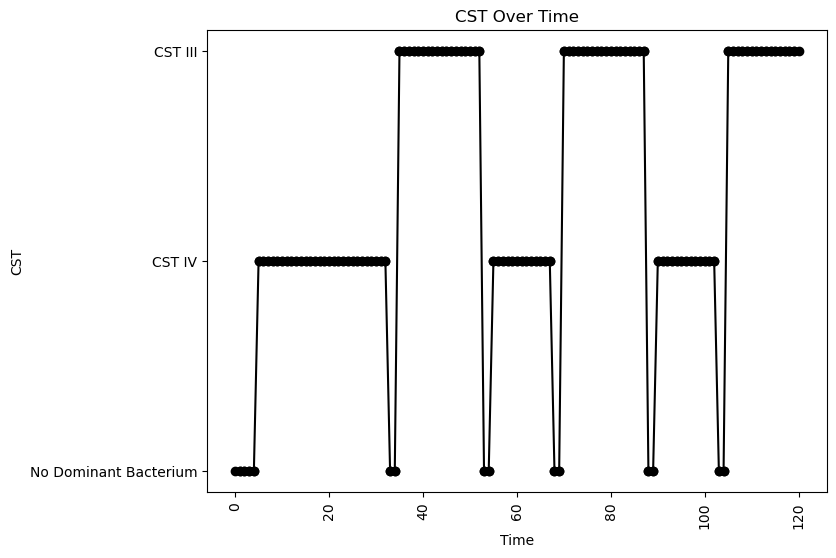


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.30303095807788255
oLB Growth: 0.20431222189445272
nAB Self: -0.021157707440056614
nAB->Li: -0.15624139694469918
nAB->oLB: -0.16796510432799072
Li->nAB: -0.00024331768039398405
Li Self: -0.04199817250300334
Li->oLB: 0.017198895127720326
oLB->nAB: -0.16767120477745479
oLB->Li: 0.2028895886311457
oLB Self: -0.08972010490137161

Simulation 9400 follows a valid CST progression:


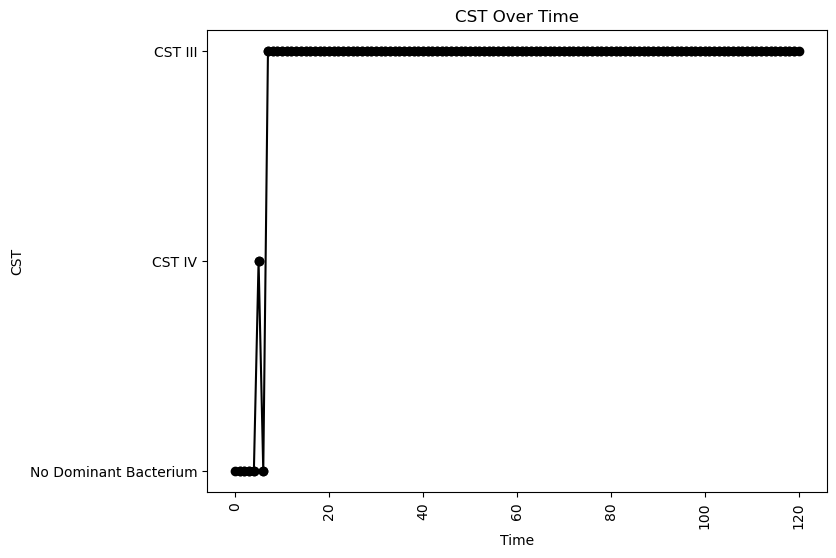


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.06664492138468138
oLB Growth: 0.6588037441195057
nAB Self: -0.038042514920163716
nAB->Li: -0.3814270365758771
nAB->oLB: -0.14361669184843734
Li->nAB: 0.3379783959364877
Li Self: -0.023679282052728803
Li->oLB: 0.2802219642212437
oLB->nAB: -0.05787522866122635
oLB->Li: -0.015490144596148059
oLB Self: -0.05494977578703095

Simulation 9409 follows a valid CST progression:


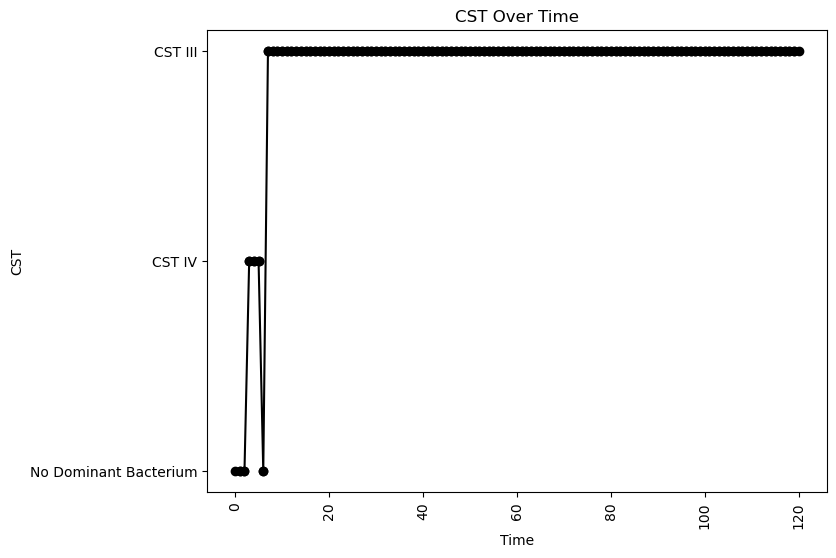


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.06595109952851387
nAB->Li: -0.24518019138791475
nAB->oLB: -0.03964423009312029
Li->nAB: 0.21300401379784206
Li Self: -0.08434471503446678
Li->oLB: 0.4618019907777271
oLB->nAB: -0.15903931840114904
oLB->Li: -0.25230289767993364
oLB Self: -0.07234576799522027

Simulation 9411 follows a valid CST progression:


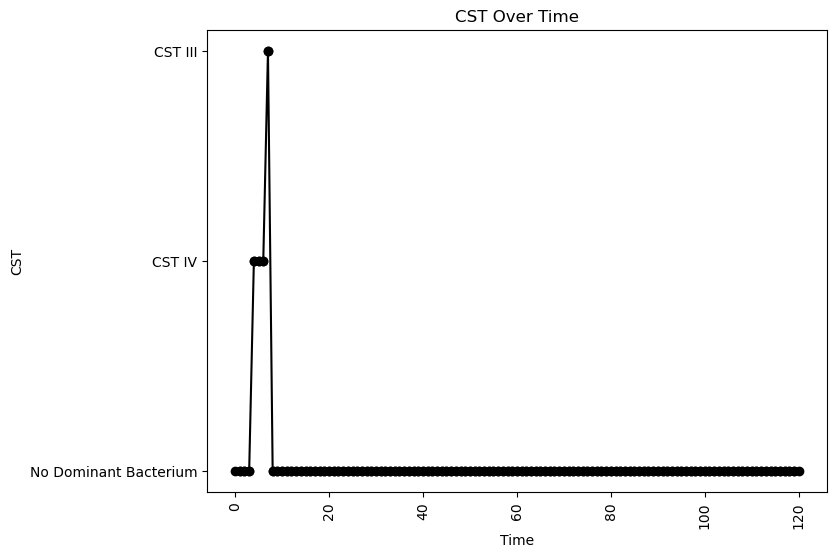


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.03354417680476955
nAB->Li: -0.15701074238082302
nAB->oLB: -0.12165670173730353
Li->nAB: 0.3371540720903182
Li Self: -0.03115693625978372
Li->oLB: 0.19844252994346934
oLB->nAB: -0.39537653308036724
oLB->Li: 0.33813242577771097
oLB Self: -0.07795494490612939

Simulation 9412 follows a valid CST progression:


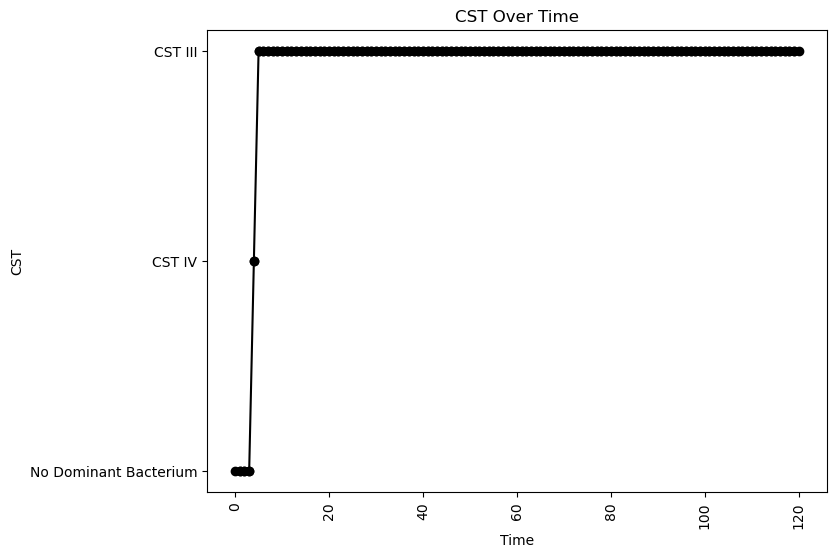


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.08886591212338006
oLB Growth: 1.0858755226067296
nAB Self: -0.09609447065927433
nAB->Li: 0.1893290872037673
nAB->oLB: -0.3399648125181219
Li->nAB: 0.38138582656476316
Li Self: -0.003519204802453338
Li->oLB: -0.062140629992332275
oLB->nAB: -0.30602375716902763
oLB->Li: -0.1413016094812048
oLB Self: -0.01706360229871269

Simulation 9421 follows a valid CST progression:


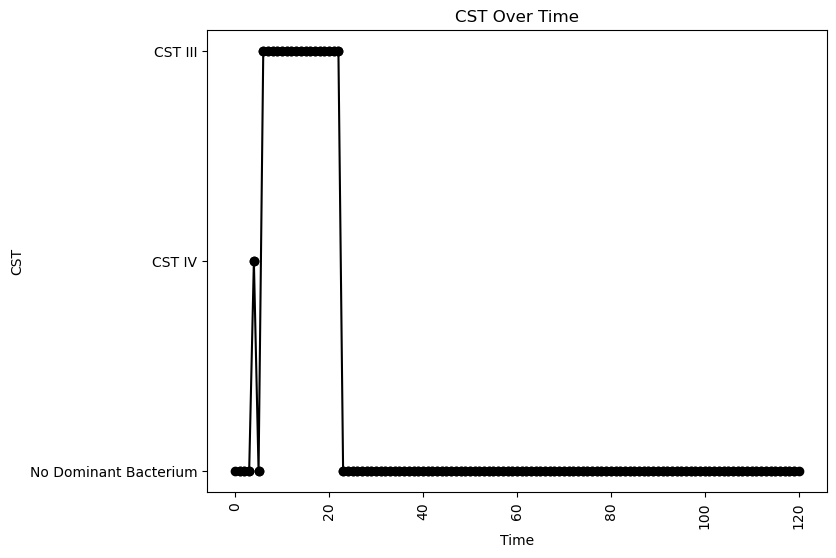


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.09779077136570642
oLB Growth: 0.16744057753178704
nAB Self: -0.08119983049116683
nAB->Li: 0.05807927845427696
nAB->oLB: -0.08857813560862832
Li->nAB: 0.331506544945548
Li Self: -0.025819691645353485
Li->oLB: 0.3620784693267387
oLB->nAB: -0.3047110061466239
oLB->Li: -0.19884814071637041
oLB Self: -0.060255984975994645

Simulation 9423 follows a valid CST progression:


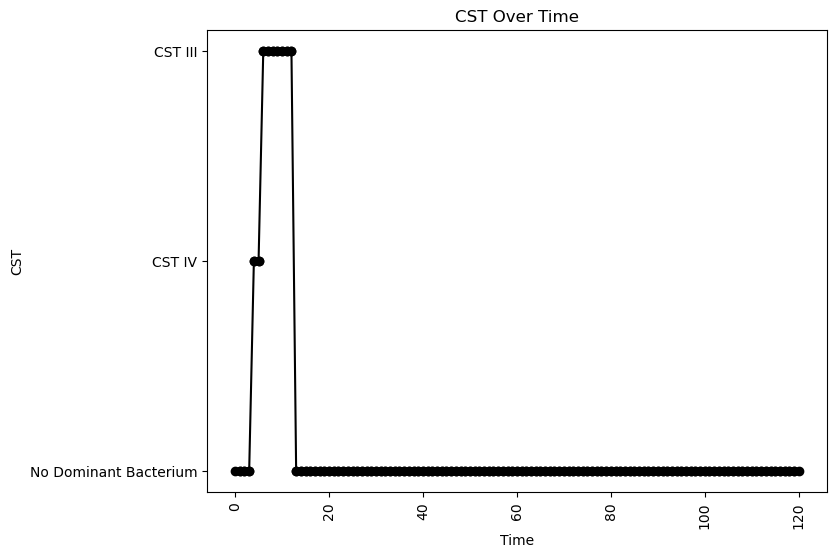


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.04709762013865475
nAB->Li: 0.11804303642452563
nAB->oLB: -0.435733794027069
Li->nAB: 0.3977632617516932
Li Self: -0.03729982116236083
Li->oLB: 0.35666628406152756
oLB->nAB: -0.4635909145415866
oLB->Li: 0.2667508815691725
oLB Self: -0.08331498368182297

Simulation 9430 follows a valid CST progression:


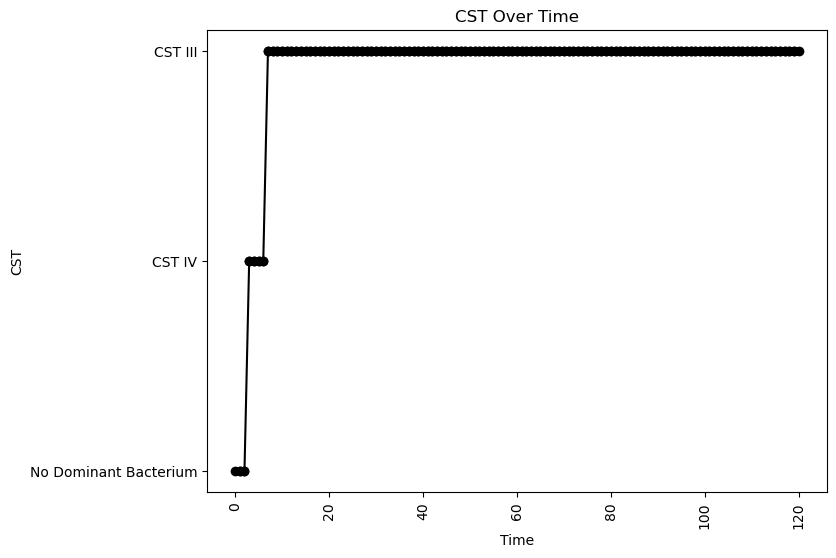


Interaction Parameters:
nAB Growth: 2.1964345031105657
Li Growth: 0.04025066595693835
oLB Growth: 1.2138354993931422
nAB Self: -0.09765453656671616
nAB->Li: -0.022743312211479627
nAB->oLB: -0.3210874692151291
Li->nAB: 0.3519964789754999
Li Self: -0.07596923729323161
Li->oLB: -0.31408537638035083
oLB->nAB: -0.3615778929194141
oLB->Li: -0.4928593439113413
oLB Self: -0.05662583997289076

Simulation 9435 follows a valid CST progression:


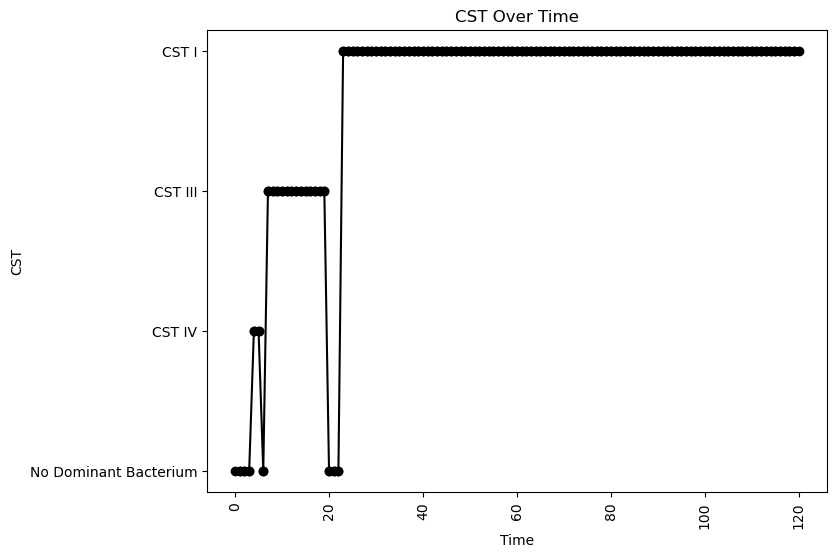


Interaction Parameters:
nAB Growth: 2.1964345031105657
Li Growth: 0.04025066595693835
oLB Growth: 1.2138354993931422
nAB Self: -0.09463759275243659
nAB->Li: -0.41501929913537433
nAB->oLB: -0.3493416766139061
Li->nAB: 0.3210535585634344
Li Self: -0.070376384966492
Li->oLB: -0.15938764213816192
oLB->nAB: -0.16858019594144769
oLB->Li: -0.024560620558323254
oLB Self: -0.06458018170828628

Simulation 9439 follows a valid CST progression:


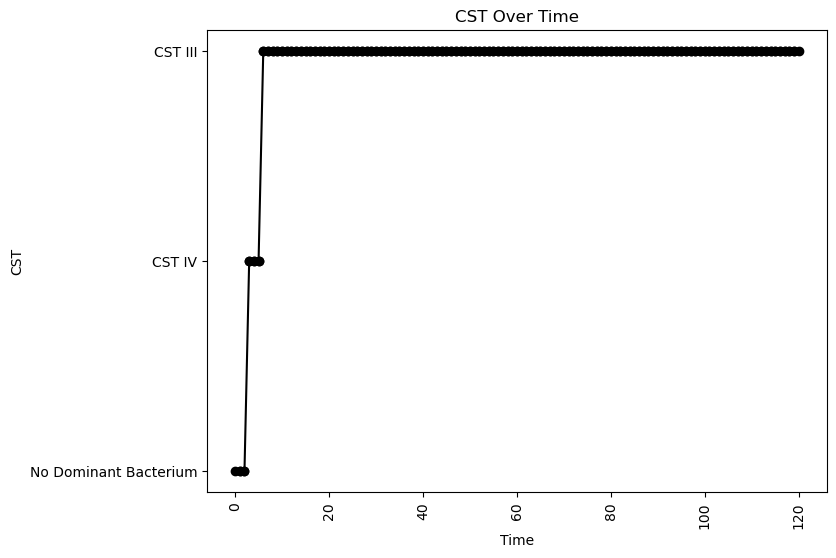


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.02538370365189488
nAB->Li: -0.2707020394923662
nAB->oLB: -0.21162927390383324
Li->nAB: 0.3780716606304484
Li Self: -0.0733820209181716
Li->oLB: -0.44827715801937595
oLB->nAB: -0.1590761222487138
oLB->Li: -0.38623526891106846
oLB Self: -0.03000740549189569

Simulation 9454 follows a valid CST progression:


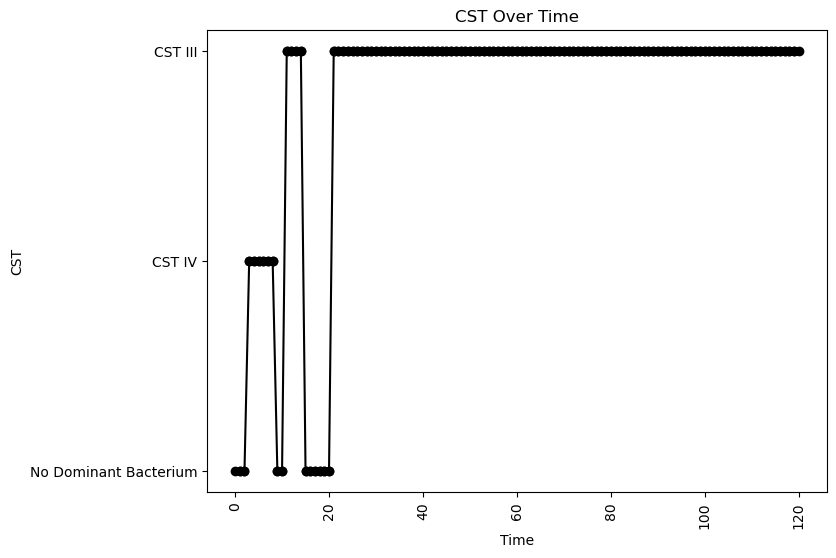


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.04068761293451392
nAB->Li: -0.04375270058482633
nAB->oLB: -0.16849384598312234
Li->nAB: 0.05996205516346076
Li Self: -0.04063216778657307
Li->oLB: 0.026989740784253646
oLB->nAB: -0.43543074317786
oLB->Li: -0.3739429754737286
oLB Self: -0.09976697362115683

Simulation 9458 follows a valid CST progression:


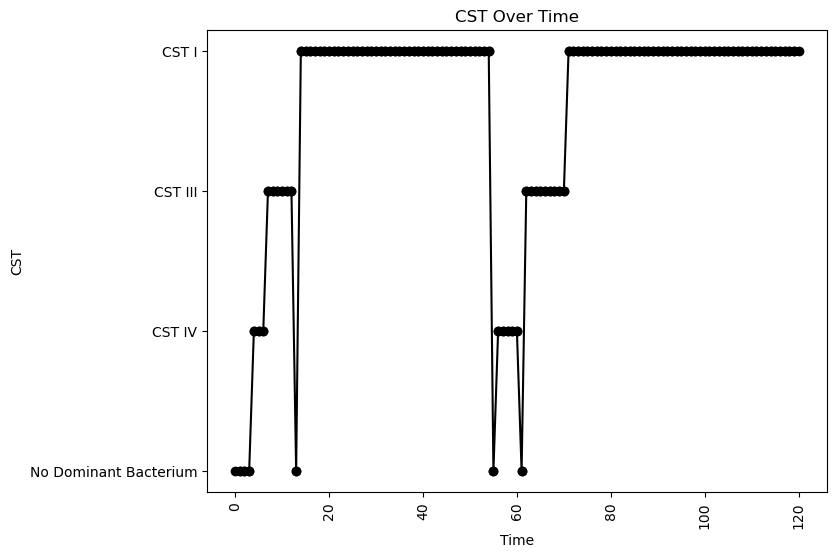


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.02682486065083603
nAB->Li: -0.4011017788118066
nAB->oLB: -0.18268604425758433
Li->nAB: 0.3478785114567734
Li Self: -0.020248685748923592
Li->oLB: -0.1549933431904693
oLB->nAB: -0.29809137020919685
oLB->Li: 0.13446481267161503
oLB Self: -0.06599856570180918

Simulation 9463 follows a valid CST progression:


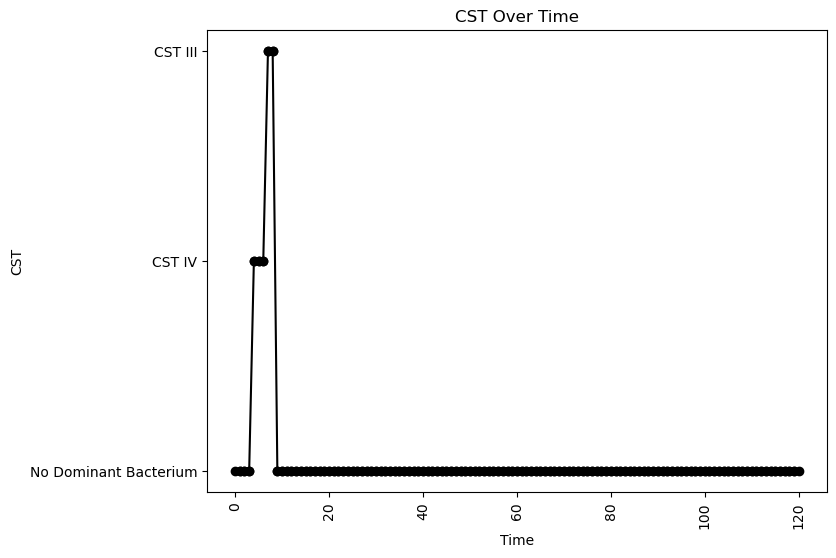


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.06329116159218223
nAB->Li: -0.08861215358763314
nAB->oLB: -0.20455756525410385
Li->nAB: 0.2518436441048424
Li Self: -0.0972680327788883
Li->oLB: 0.35512931919783874
oLB->nAB: -0.33163140440908456
oLB->Li: 0.4700652476026199
oLB Self: -0.08382543414692194

Simulation 9470 follows a valid CST progression:


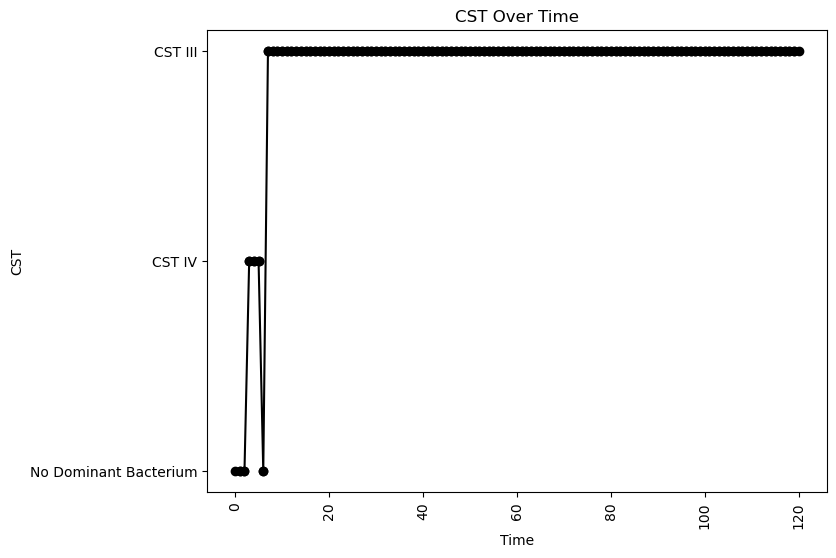


Interaction Parameters:
nAB Growth: 2.1573635369289432
Li Growth: 0.04215849674910016
oLB Growth: 1.2503024394854367
nAB Self: -0.06709933706105065
nAB->Li: -0.20557280036972125
nAB->oLB: -0.3863242784466559
Li->nAB: 0.46027732634701646
Li Self: -0.08172676959276369
Li->oLB: 0.4556722537501179
oLB->nAB: -0.4539977933137184
oLB->Li: -0.34180743797453705
oLB Self: -0.05597073043625405

Simulation 9471 follows a valid CST progression:


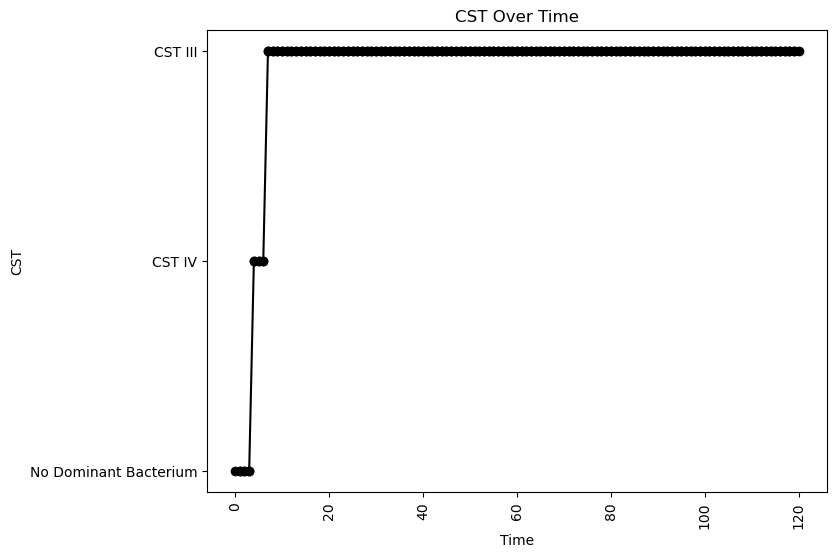


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.054923436860343545
nAB->Li: -0.2724030570923521
nAB->oLB: -0.4867719479462548
Li->nAB: 0.3624317483369087
Li Self: -0.06943688935934011
Li->oLB: -0.334954531546128
oLB->nAB: -0.37021244069164533
oLB->Li: -0.22374702850649547
oLB Self: -0.05321830829258213

Simulation 9474 follows a valid CST progression:


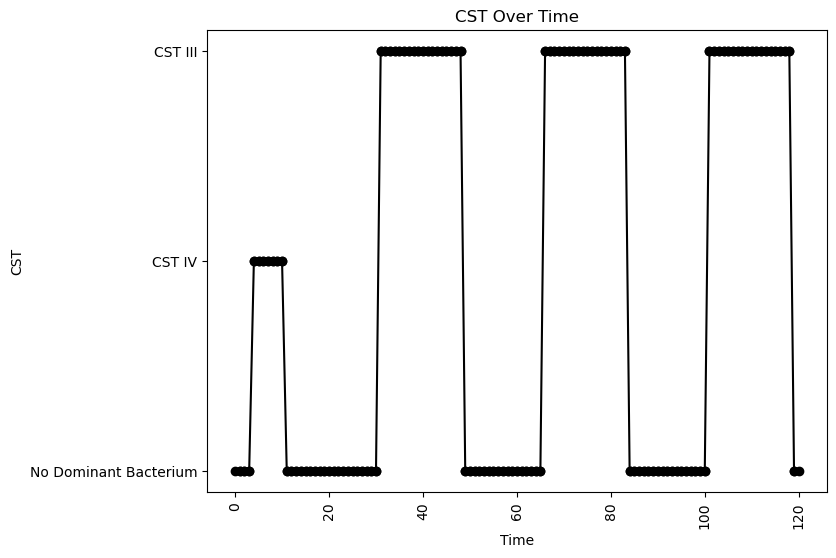


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.07276686194932734
nAB->Li: -0.34863785613806053
nAB->oLB: -0.16061052943480936
Li->nAB: 0.07764703176237375
Li Self: -0.08582336511107692
Li->oLB: -0.1823486091937735
oLB->nAB: -0.03250209259204584
oLB->Li: -0.4179272684811945
oLB Self: -0.04889891586815855

Simulation 9476 follows a valid CST progression:


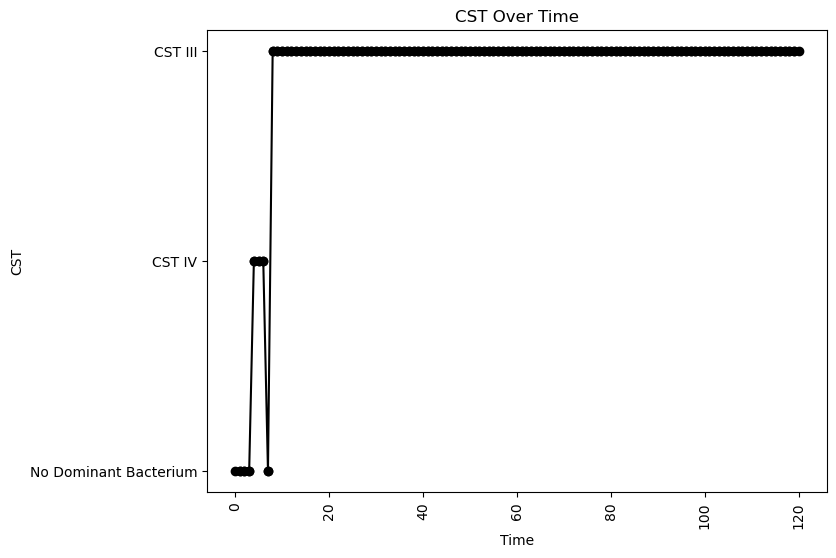


Interaction Parameters:
nAB Growth: 2.2446146183745257
Li Growth: 0.07278030322941353
oLB Growth: 0.5438660619757455
nAB Self: -0.00851894029245523
nAB->Li: -0.19396550994773842
nAB->oLB: -0.19378395188705771
Li->nAB: 0.303369854010652
Li Self: -0.061791674073679886
Li->oLB: -0.28161577876081845
oLB->nAB: -0.3678067118658958
oLB->Li: -0.19449888351972966
oLB Self: -0.042395558331156845

Simulation 9478 follows a valid CST progression:


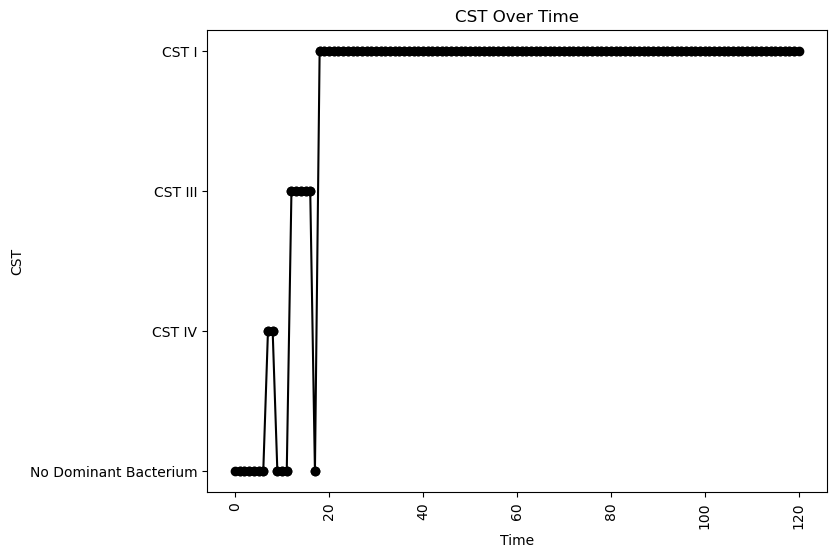


Interaction Parameters:
nAB Growth: 2.226251684223429
Li Growth: 0.0760937960697033
oLB Growth: 0.4505921706771102
nAB Self: -0.06189565328786746
nAB->Li: -0.3789512887836291
nAB->oLB: -0.3454162048801739
Li->nAB: 0.16021094825069548
Li Self: -0.02671966159970579
Li->oLB: 0.18847003177901367
oLB->nAB: -0.3929525107104419
oLB->Li: 0.311496072227629
oLB Self: -0.0034147389202549283

Simulation 9479 follows a valid CST progression:


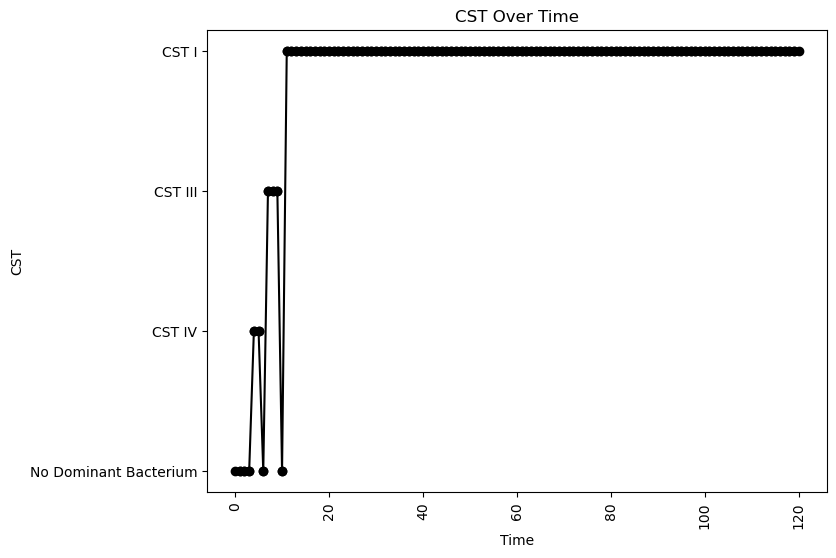


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.03837725110012093
oLB Growth: 1.155917868199191
nAB Self: -0.008608800959964788
nAB->Li: -0.2899149414899502
nAB->oLB: -0.30642472202976706
Li->nAB: 0.2135220296939364
Li Self: -0.040344382388962284
Li->oLB: 0.04471600463072545
oLB->nAB: -0.23341072346964636
oLB->Li: 0.18867881188059688
oLB Self: -0.05085355832730659

Simulation 9481 follows a valid CST progression:


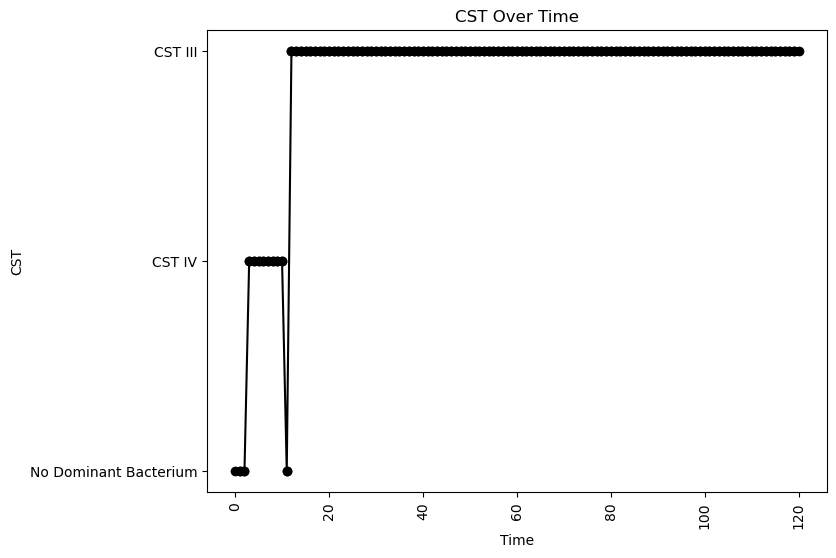


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.0345127460556192
nAB->Li: -0.23935676484608032
nAB->oLB: -0.39123973737887213
Li->nAB: 0.029265795327471866
Li Self: -0.01615193143820537
Li->oLB: -0.17970935384438286
oLB->nAB: -0.4196321648003157
oLB->Li: -0.16016350974468385
oLB Self: -0.050064383941430986

Simulation 9486 follows a valid CST progression:


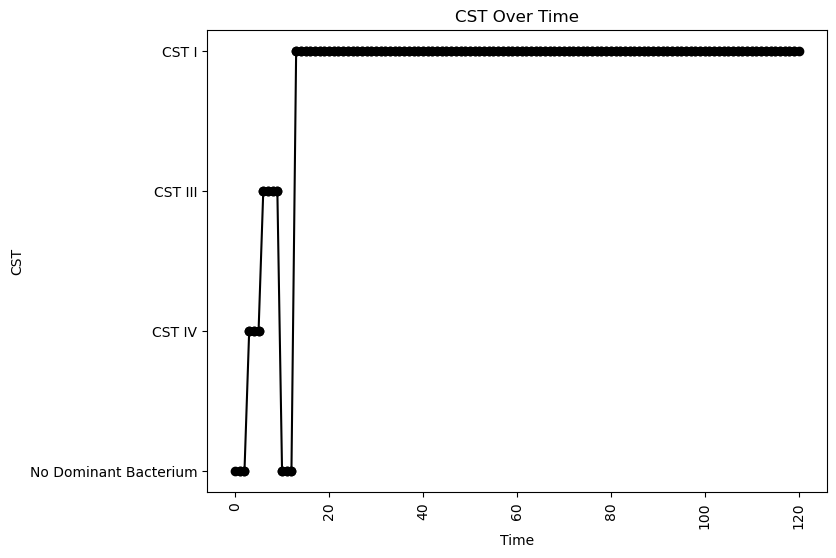


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.022275009098572857
nAB->Li: -0.3565439797163539
nAB->oLB: -0.20542444721580355
Li->nAB: 0.3575922451595748
Li Self: -0.08968197684205652
Li->oLB: 0.013810103979785993
oLB->nAB: -0.07997584181410339
oLB->Li: 0.13849124193638562
oLB Self: -0.05434900145641321

Simulation 9497 follows a valid CST progression:


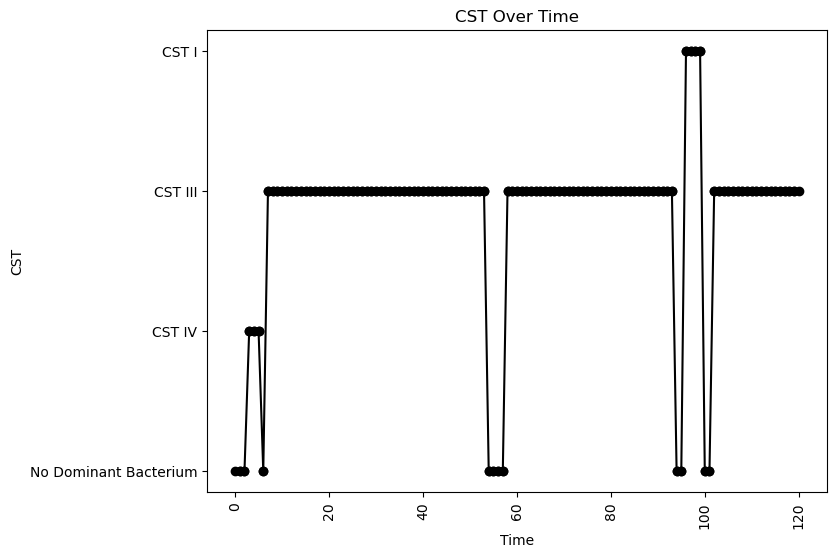


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.06108785727853854
nAB->Li: -0.4358431590920931
nAB->oLB: -0.36228356528161165
Li->nAB: 0.24578551914556956
Li Self: -0.09853978602327258
Li->oLB: 0.10347422630961
oLB->nAB: -0.08528520429129383
oLB->Li: -0.1052964439402772
oLB Self: -0.014495129077498697

Simulation 9501 follows a valid CST progression:


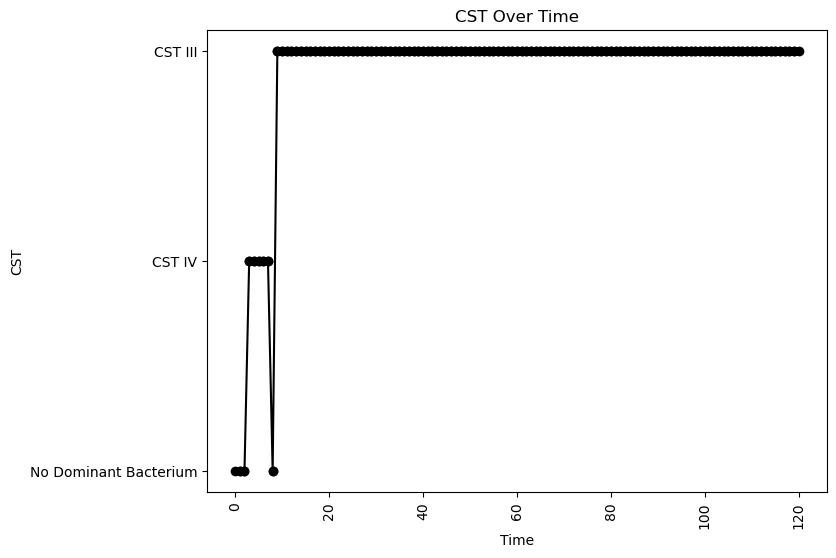


Interaction Parameters:
nAB Growth: 2.172057972480792
Li Growth: 0.05464936187495586
oLB Growth: 1.1816194682992254
nAB Self: -0.04038199874712135
nAB->Li: 0.022871345772035423
nAB->oLB: -0.22146778962679015
Li->nAB: 0.07881158524363274
Li Self: -0.010601327336168823
Li->oLB: 0.22225338256545724
oLB->nAB: -0.2783195225329068
oLB->Li: -0.14754935156322402
oLB Self: -0.09006000533828284

Simulation 9508 follows a valid CST progression:


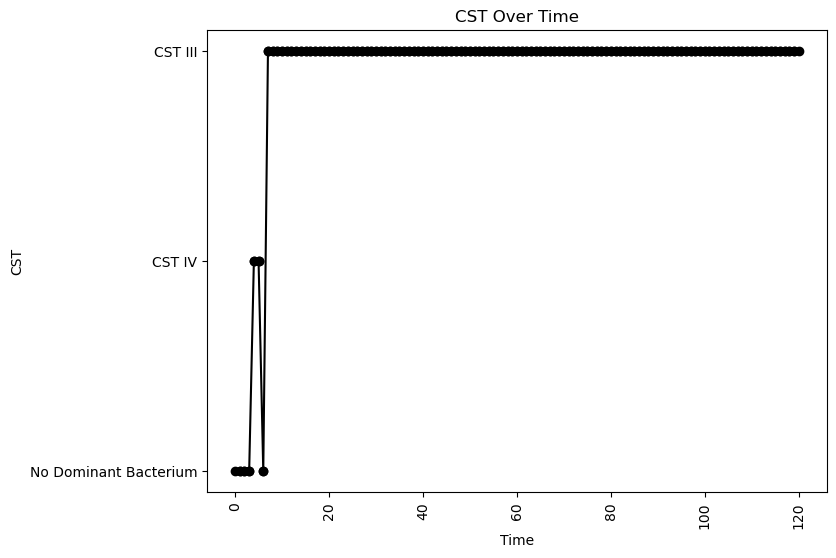


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.06495430992206574
oLB Growth: 0.1731103059651596
nAB Self: -0.018118742291216322
nAB->Li: -0.24866914744078417
nAB->oLB: -0.4657263347973136
Li->nAB: 0.21028155296595996
Li Self: -0.06357257152774048
Li->oLB: -0.41323324843760667
oLB->nAB: -0.4638948322863318
oLB->Li: -0.14642982903243174
oLB Self: -0.0758075451073032

Simulation 9510 follows a valid CST progression:


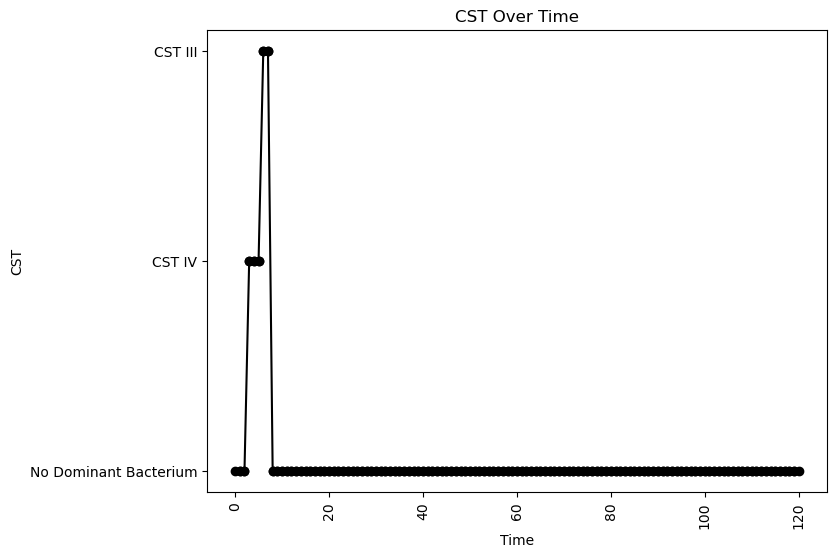


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.04480151722635231
nAB->Li: -0.21481950613312883
nAB->oLB: -0.3709312136311818
Li->nAB: 0.285841120561093
Li Self: -0.06494785276541712
Li->oLB: 0.37021788922647547
oLB->nAB: -0.1871388173707002
oLB->Li: 0.2879936680538189
oLB Self: -0.019203827381781308

Simulation 9514 follows a valid CST progression:


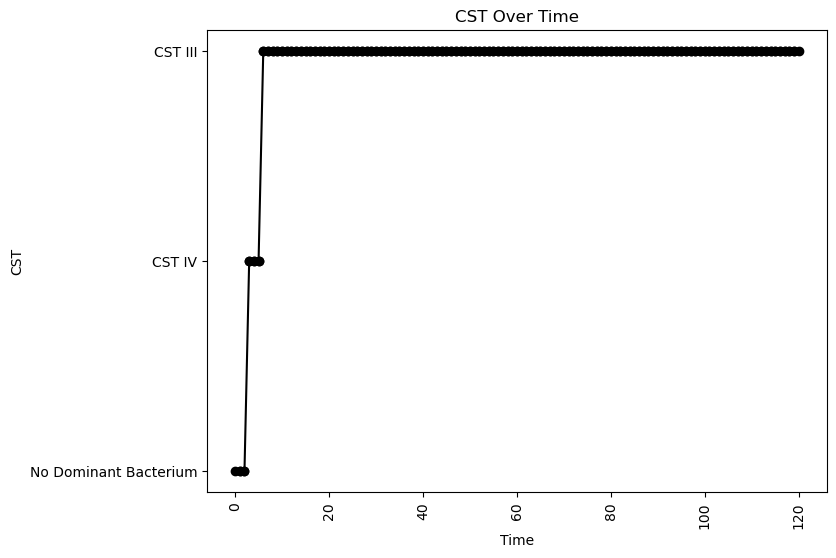


Interaction Parameters:
nAB Growth: 2.292952252819776
Li Growth: 0.06862578763464611
oLB Growth: 0.25066683866219575
nAB Self: -0.08058346570252116
nAB->Li: 0.016644151098821336
nAB->oLB: -0.26164037138169655
Li->nAB: 0.3116256908240962
Li Self: -0.019504961117097666
Li->oLB: -0.4520817622502451
oLB->nAB: -0.03841679524952096
oLB->Li: -0.20328737951346598
oLB Self: -0.06375505005498111

Simulation 9516 follows a valid CST progression:


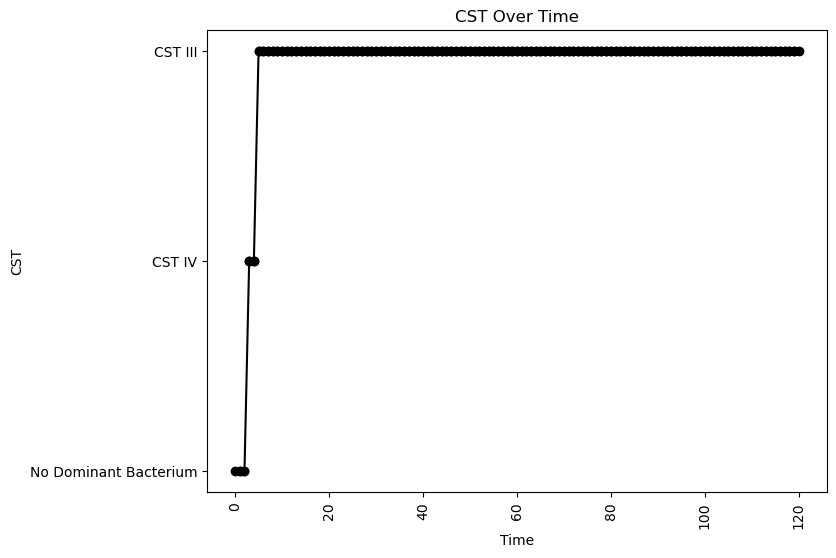


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.010382009269569517
nAB->Li: 0.13615464184919468
nAB->oLB: -0.3867708669373528
Li->nAB: 0.360662682740317
Li Self: -0.0032997254009249494
Li->oLB: -0.15702841365622444
oLB->nAB: -0.42181495891847265
oLB->Li: 0.17710232834474682
oLB Self: -0.07545131950262693

Simulation 9523 follows a valid CST progression:


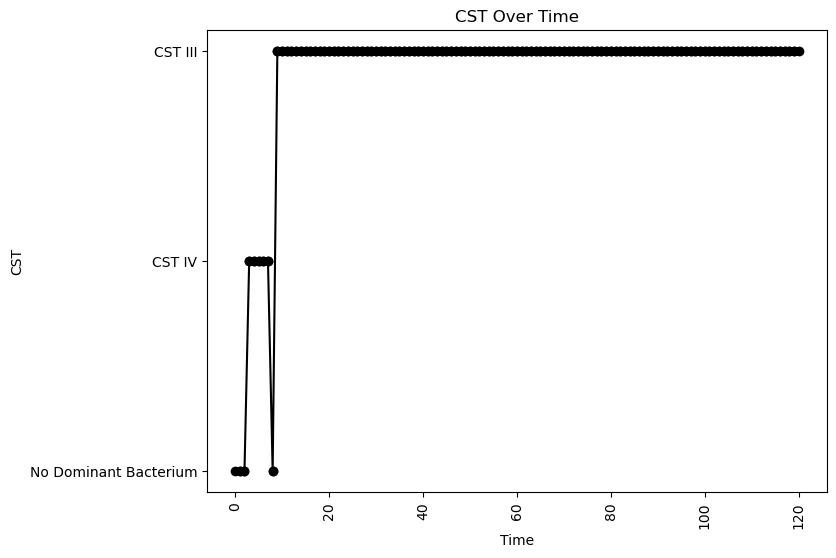


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.08990750575048446
nAB->Li: -0.22792185080194738
nAB->oLB: -0.3215663134661682
Li->nAB: 0.13761614716078407
Li Self: -0.06956529214412269
Li->oLB: -0.3590511273393898
oLB->nAB: -0.46738846541810314
oLB->Li: -0.3655048691455142
oLB Self: -0.06698569108568775

Simulation 9525 follows a valid CST progression:


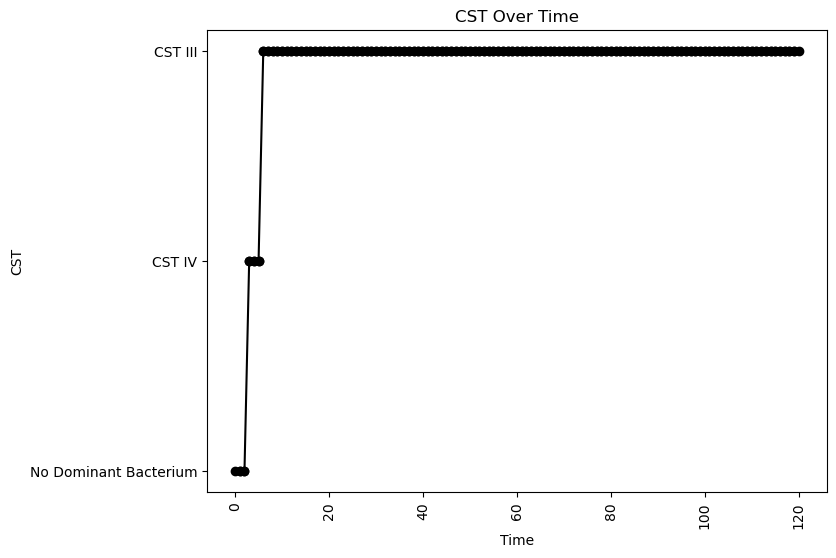


Interaction Parameters:
nAB Growth: 2.2630123135236015
Li Growth: 0.06664492138468138
oLB Growth: 0.6588037441195057
nAB Self: -0.036694876733431595
nAB->Li: -0.28300079765887787
nAB->oLB: -0.05642354821864504
Li->nAB: 0.3018026839620602
Li Self: -0.01079868137033059
Li->oLB: 0.1874764571474532
oLB->nAB: -0.27930919082222305
oLB->Li: -0.2142183920243647
oLB Self: -0.04472248224101793

Simulation 9531 follows a valid CST progression:


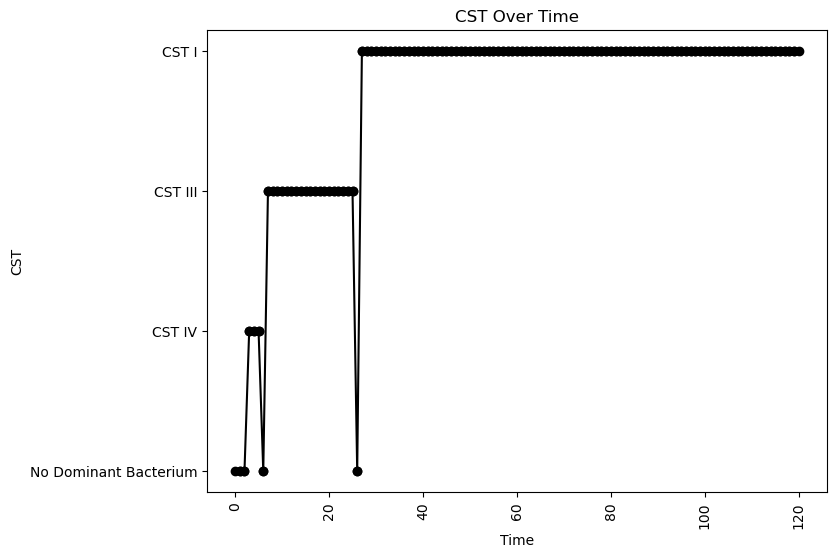


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.009940064986982897
nAB->Li: -0.3989124174941795
nAB->oLB: -0.48329040975182824
Li->nAB: 0.24226747021951145
Li Self: -0.06875974699924245
Li->oLB: 0.04792897830466081
oLB->nAB: -0.1726262183346643
oLB->Li: 0.03221502831629919
oLB Self: -0.009227532378417183

Simulation 9536 follows a valid CST progression:


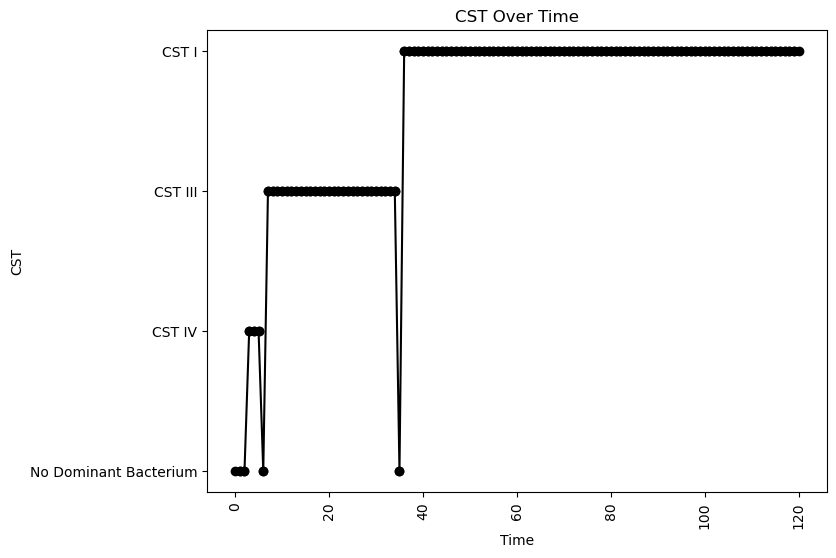


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.05739994626081137
oLB Growth: 0.11031283255203692
nAB Self: -0.08648825650019415
nAB->Li: -0.15525887047696296
nAB->oLB: -0.47678120512949385
Li->nAB: 0.28660082138886045
Li Self: -0.004622789381326889
Li->oLB: -0.36855337775653163
oLB->nAB: -0.037262355999133745
oLB->Li: -0.02507212223424654
oLB Self: -0.030558692738426624

Simulation 9540 follows a valid CST progression:


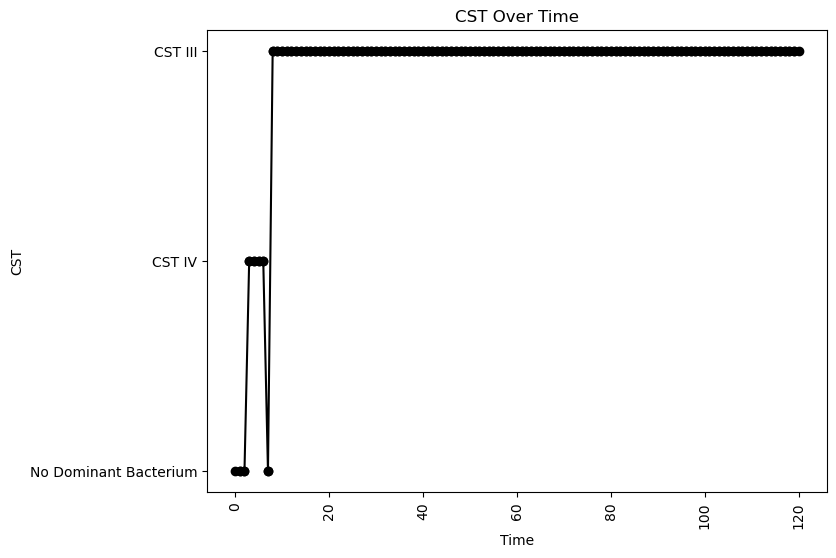


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.04755614433209017
nAB->Li: -0.008943021249106675
nAB->oLB: -0.02899856932957301
Li->nAB: 0.16529205346809162
Li Self: -0.07707457535330964
Li->oLB: 0.210091230541949
oLB->nAB: -0.42350151246890344
oLB->Li: -0.04612035571464146
oLB Self: -0.09938489347158166

Simulation 9567 follows a valid CST progression:


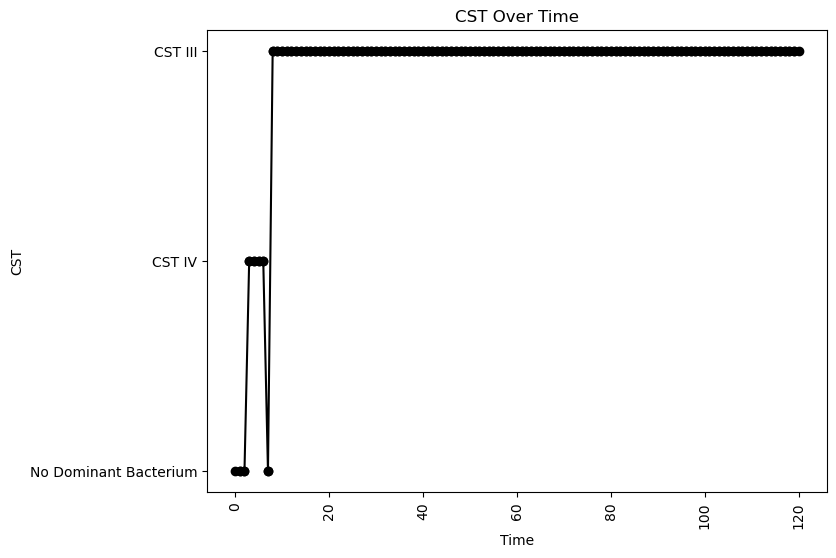


Interaction Parameters:
nAB Growth: 2.284416841880324
Li Growth: 0.06886020002136616
oLB Growth: 0.35838896078112936
nAB Self: -0.006014797707303829
nAB->Li: -0.23200791825288453
nAB->oLB: -0.4622114639920751
Li->nAB: 0.09035101609136476
Li Self: -0.011524294449825778
Li->oLB: -0.46699325913399603
oLB->nAB: -0.4407998510557427
oLB->Li: -0.2753758417031356
oLB Self: -0.08252352660515785

Simulation 9571 follows a valid CST progression:


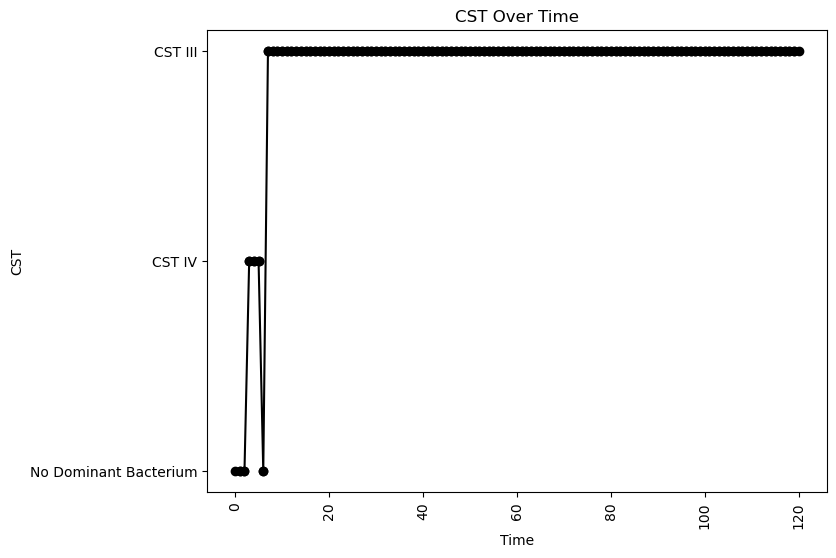


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.05739994626081137
oLB Growth: 0.11031283255203692
nAB Self: -0.041805621347390395
nAB->Li: -0.0029423800257913357
nAB->oLB: -0.22720308485085272
Li->nAB: 0.2938111452379062
Li Self: -0.041677554742157195
Li->oLB: -0.24398155554765316
oLB->nAB: -0.02978319680349939
oLB->Li: -0.1038187758075168
oLB Self: -0.03918588127216057

Simulation 9573 follows a valid CST progression:


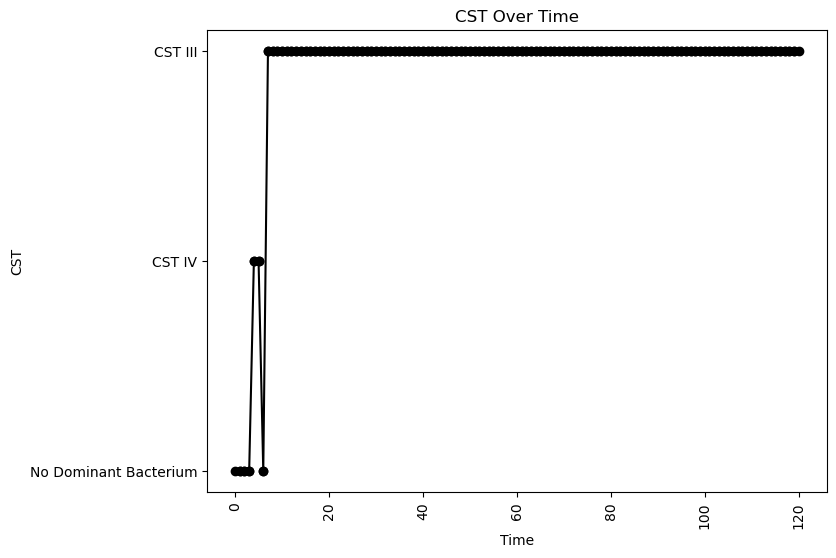


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.06588260315658048
oLB Growth: 0.21113539622386296
nAB Self: -0.04201615747070621
nAB->Li: -0.09976854592420037
nAB->oLB: -0.37550179348381246
Li->nAB: 0.49795231936371587
Li Self: -0.08670487145999486
Li->oLB: 0.05144179675486116
oLB->nAB: -0.34756628026115766
oLB->Li: -0.17228943074513609
oLB Self: -0.08636924512843583

Simulation 9574 follows a valid CST progression:


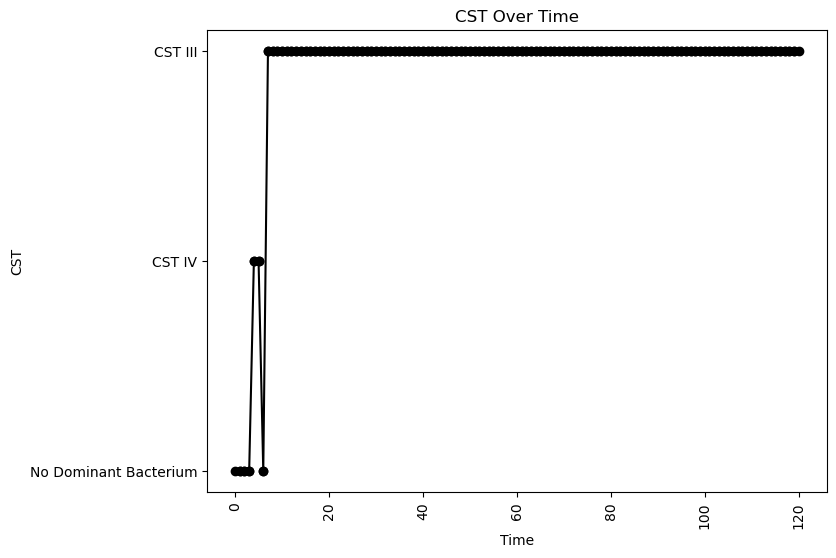


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.06588260315658048
oLB Growth: 0.21113539622386296
nAB Self: -0.0018153200537271846
nAB->Li: -0.03557411342014488
nAB->oLB: -0.45728086269202584
Li->nAB: 0.3551940595042591
Li Self: -0.04031717694407797
Li->oLB: -0.3965473959162271
oLB->nAB: -0.20965775239903195
oLB->Li: -0.47824114696209785
oLB Self: -0.07714644839075124

Simulation 9575 follows a valid CST progression:


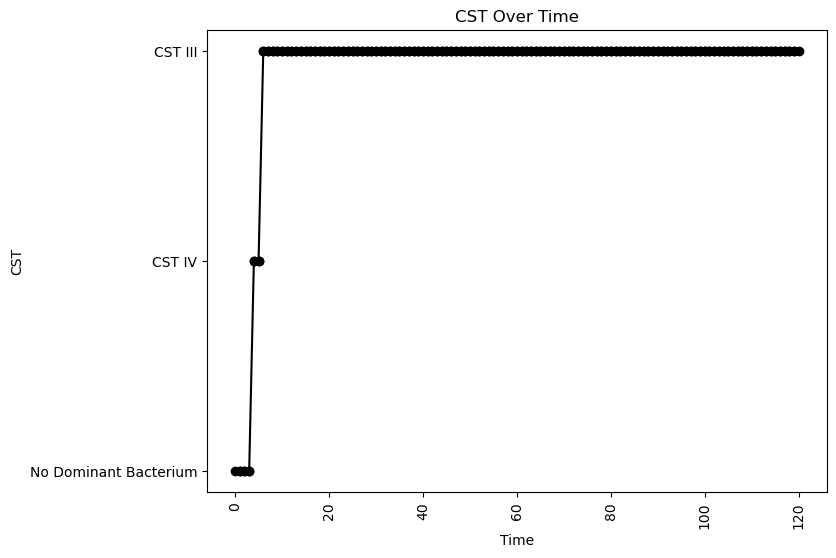


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.020089022342526075
nAB->Li: -0.4871391928819343
nAB->oLB: -0.48837503028712564
Li->nAB: 0.4145940157837126
Li Self: -0.07268278509061771
Li->oLB: -0.3268408065858056
oLB->nAB: -0.13059304892064777
oLB->Li: -0.42479251748811764
oLB Self: -0.019482283464156133

Simulation 9580 follows a valid CST progression:


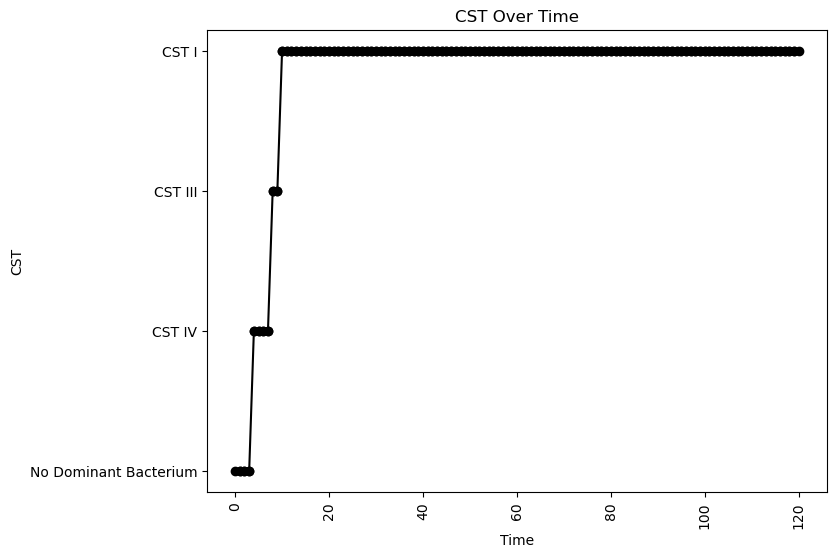


Interaction Parameters:
nAB Growth: 2.2609282147211935
Li Growth: 0.06381435834914458
oLB Growth: 0.1660151901294062
nAB Self: -0.014857244328782951
nAB->Li: -0.2282129201011009
nAB->oLB: -0.44754818168445254
Li->nAB: 0.2058782163534265
Li Self: -0.014299322720377206
Li->oLB: -0.2878659984451755
oLB->nAB: -0.2727725564334954
oLB->Li: 0.43793296954050065
oLB Self: -0.037774907115175574

Simulation 9582 follows a valid CST progression:


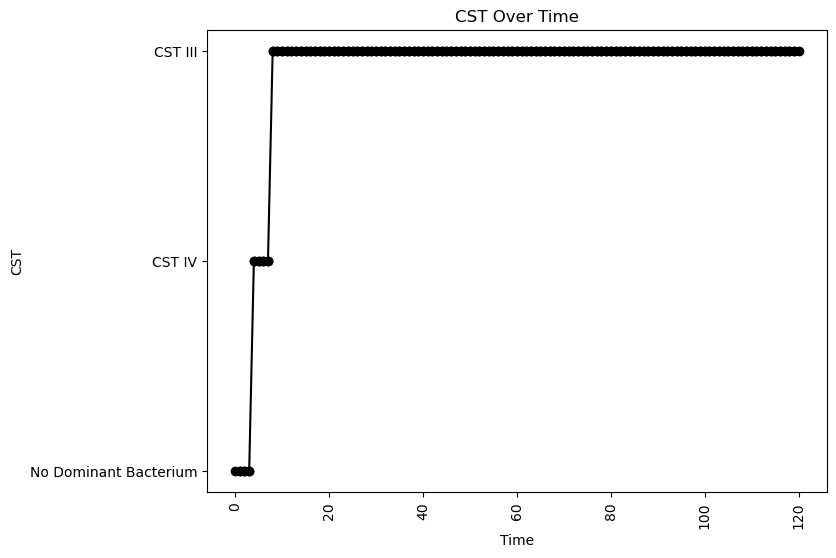


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.06806014290478743
oLB Growth: 0.20414555748463747
nAB Self: -0.05733411532916648
nAB->Li: -0.3215234227100803
nAB->oLB: -0.3700519615131981
Li->nAB: 0.2188469104560512
Li Self: -0.04686331020676459
Li->oLB: -0.18724841731165165
oLB->nAB: -0.48098631130617375
oLB->Li: -0.2304598294727655
oLB Self: -0.0025670390586375325

Simulation 9584 follows a valid CST progression:


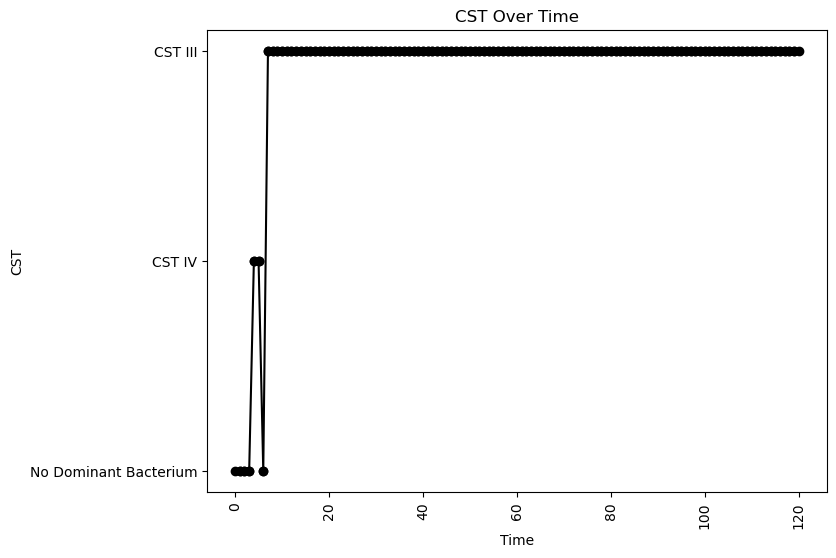


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.06675897467530419
nAB->Li: 0.049673656142345424
nAB->oLB: -0.42970215604023476
Li->nAB: 0.42221226884474583
Li Self: -0.09821435642432372
Li->oLB: 0.3782932307208078
oLB->nAB: -0.481916640755184
oLB->Li: -0.43614460753474626
oLB Self: -0.014599342891392822

Simulation 9585 follows a valid CST progression:


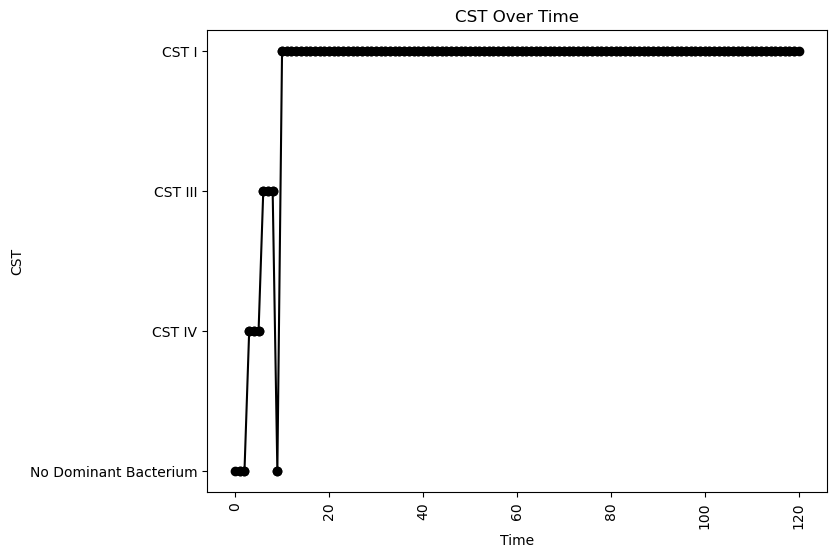


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.051914801085014874
nAB->Li: -0.10598357652502621
nAB->oLB: -0.25764173992634765
Li->nAB: 0.4028085629711118
Li Self: -0.07864646081228446
Li->oLB: -0.006467462370825461
oLB->nAB: -0.44967032447180166
oLB->Li: 0.2335244399926094
oLB Self: -0.09178689345851103

Simulation 9592 follows a valid CST progression:


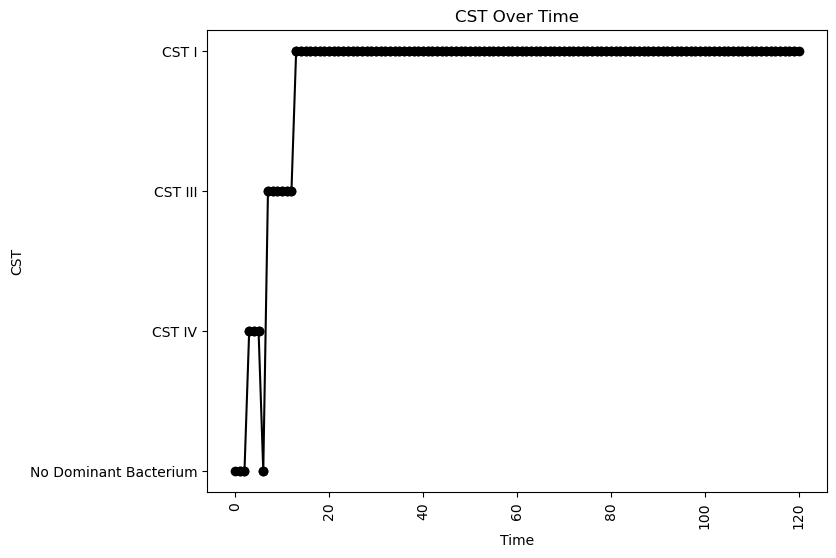


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.09854825174863419
nAB->Li: -0.27417825397157414
nAB->oLB: -0.1789338480104536
Li->nAB: 0.20353054587270691
Li Self: -0.011230944031914561
Li->oLB: -0.20219458817556923
oLB->nAB: -0.48809540981343025
oLB->Li: 0.16510142494454183
oLB Self: -0.007426038546277644

Simulation 9594 follows a valid CST progression:


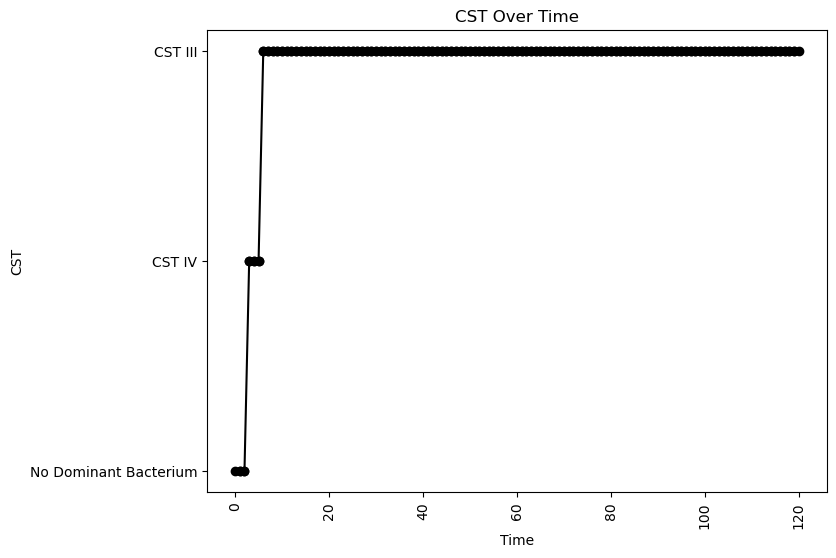


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.03837725110012093
oLB Growth: 1.155917868199191
nAB Self: -0.021926485140044333
nAB->Li: -0.3037317985744795
nAB->oLB: -0.0654428725981469
Li->nAB: 0.34058175489386966
Li Self: -0.054692562239964604
Li->oLB: -0.2797233900423114
oLB->nAB: -0.3650313453806007
oLB->Li: -0.41373242725232884
oLB Self: -0.06461029495635451

Simulation 9603 follows a valid CST progression:


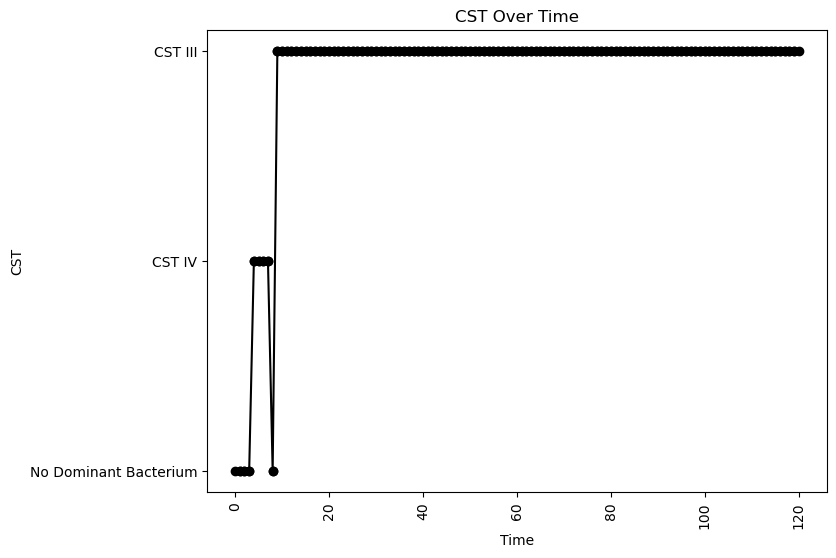


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.05941564289984073
nAB->Li: -0.024231665138181868
nAB->oLB: -0.41042511254319164
Li->nAB: 0.15091146444404235
Li Self: -0.09569710862188532
Li->oLB: -0.07450639643281487
oLB->nAB: -0.10475602577836879
oLB->Li: 0.03540271410109175
oLB Self: -0.06883346376105519

Simulation 9605 follows a valid CST progression:


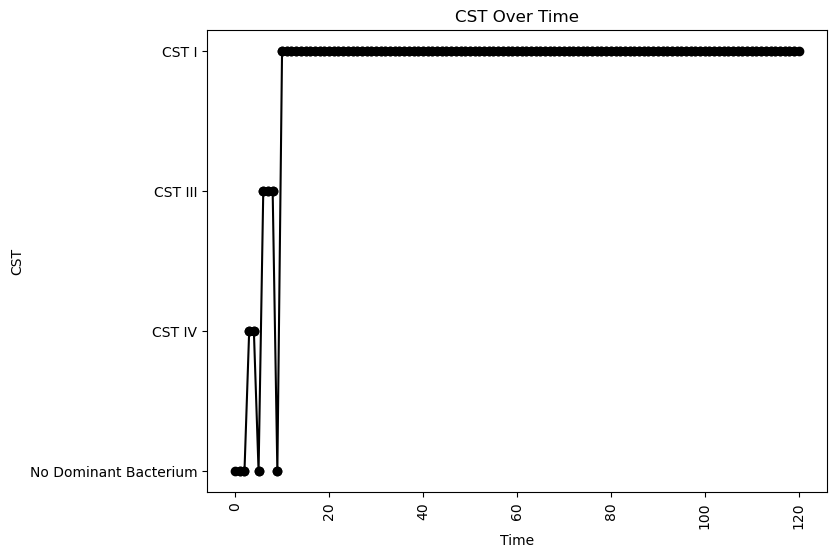


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.02955006291592248
nAB->Li: -0.2511834599566951
nAB->oLB: -0.3575747020639388
Li->nAB: 0.49675736003938153
Li Self: -0.027940359075190796
Li->oLB: -0.14093146869324513
oLB->nAB: -0.499708434817221
oLB->Li: 0.1914640182088252
oLB Self: -0.09897465388382093

Simulation 9606 follows a valid CST progression:


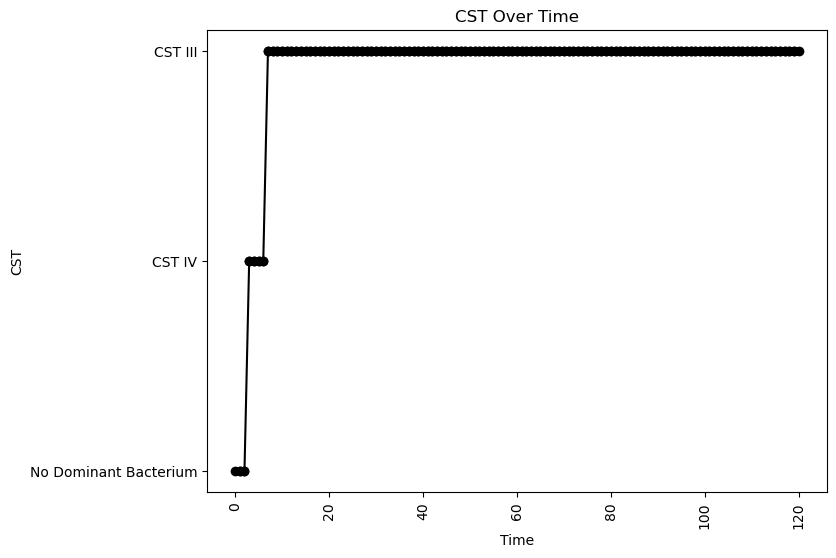


Interaction Parameters:
nAB Growth: 2.292952252819776
Li Growth: 0.06862578763464611
oLB Growth: 0.25066683866219575
nAB Self: -0.011135259211782558
nAB->Li: -0.1877108637522441
nAB->oLB: -0.4646966684531102
Li->nAB: 0.15199972633320213
Li Self: -0.05930500640970251
Li->oLB: -0.25531035710553995
oLB->nAB: -0.2649341410803193
oLB->Li: 0.004017837598430107
oLB Self: -0.014070039268285761

Simulation 9608 follows a valid CST progression:


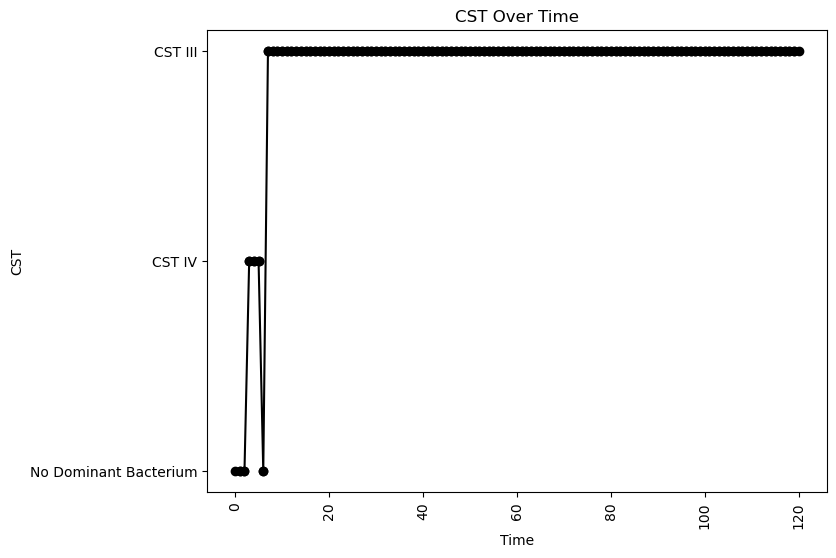


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.04152025410505557
nAB->Li: -0.05384625079915151
nAB->oLB: -0.4268218873775649
Li->nAB: 0.21842503288370785
Li Self: -0.04260845113559962
Li->oLB: -0.0948672891585034
oLB->nAB: -0.3234048255633548
oLB->Li: -0.10695295269781047
oLB Self: -0.047840133251067764

Simulation 9609 follows a valid CST progression:


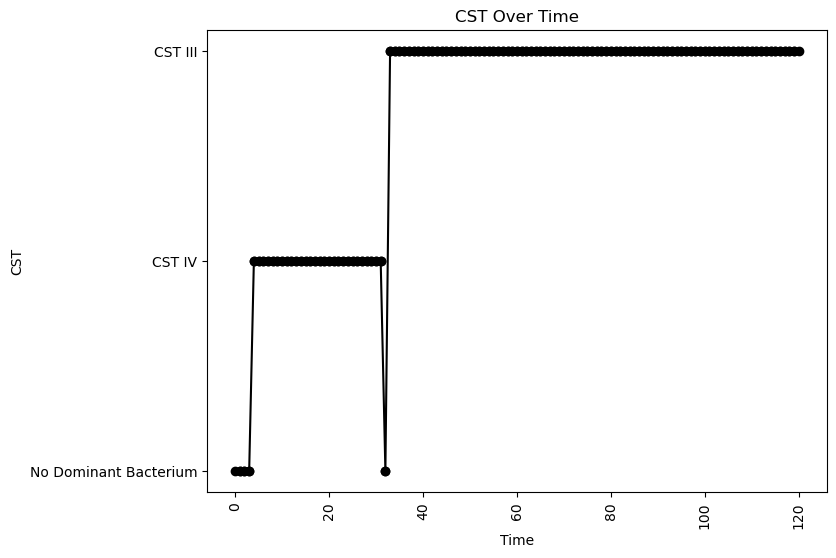


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.07799295372330314
nAB->Li: -0.4805605838334639
nAB->oLB: -0.05248481361361046
Li->nAB: 0.0035195319202997455
Li Self: -0.015679629152691846
Li->oLB: -0.36637721705947157
oLB->nAB: -0.4993974997674706
oLB->Li: -0.27076602092052054
oLB Self: -0.07041790617626818

Simulation 9611 follows a valid CST progression:


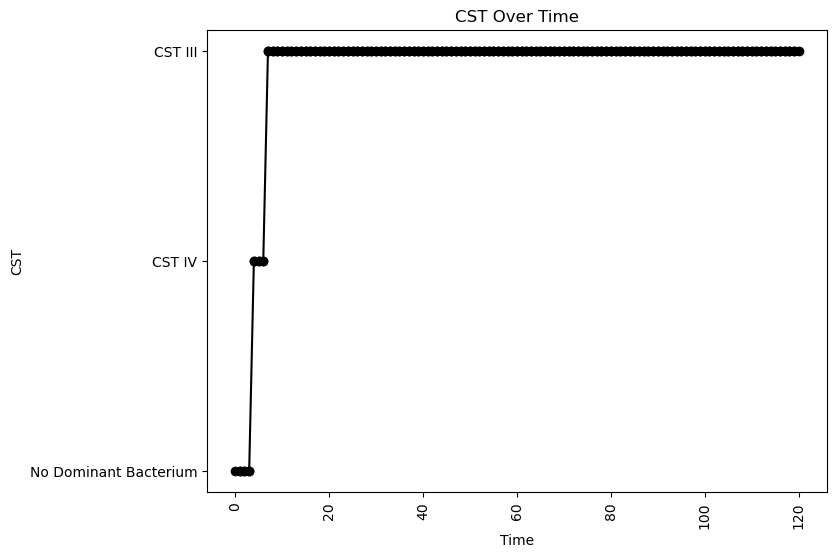


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.06966732695823108
nAB->Li: -0.42716279968866183
nAB->oLB: -0.10951046955751187
Li->nAB: 0.24549613916172086
Li Self: -0.0032252957600358567
Li->oLB: 0.19320286390949637
oLB->nAB: -0.10194852235828711
oLB->Li: -0.1513825318467958
oLB Self: -0.03631895497043043

Simulation 9613 follows a valid CST progression:


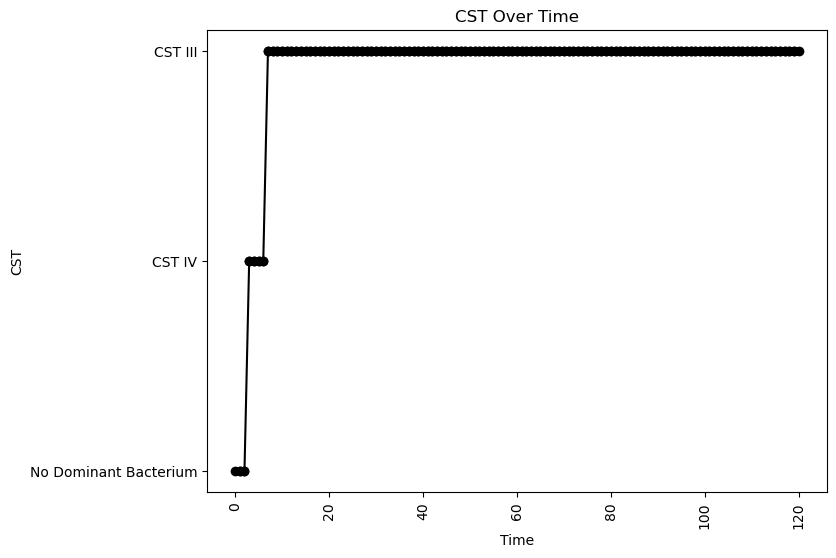


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.03796839878025046
nAB->Li: -0.11628887640372604
nAB->oLB: -0.12382541109535666
Li->nAB: 0.31965354916431943
Li Self: -0.035497719048535326
Li->oLB: -0.311112640655418
oLB->nAB: -0.2981520698091708
oLB->Li: -0.43100022032145574
oLB Self: -0.09113676211710087

Simulation 9615 follows a valid CST progression:


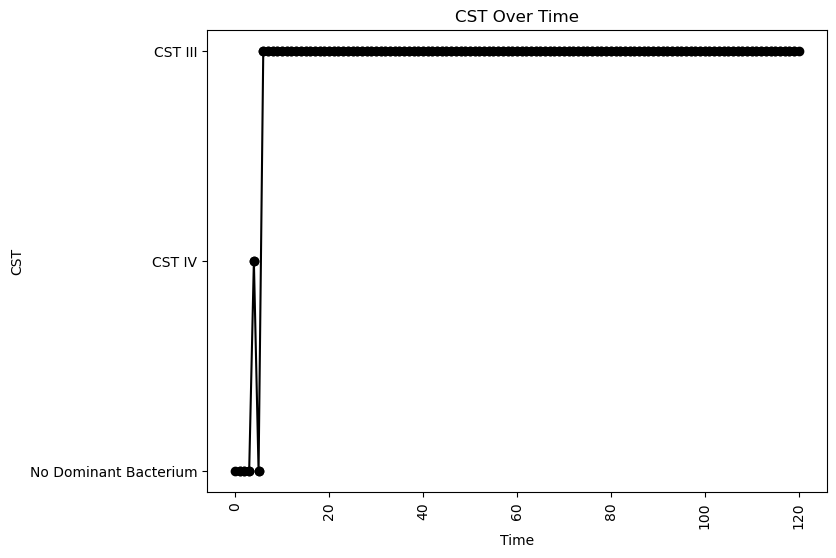


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.21406941694026504
oLB Growth: 0.7070472171500886
nAB Self: -0.07268123132344824
nAB->Li: -0.035733677347235704
nAB->oLB: -0.28728662711269976
Li->nAB: 0.23194346879897898
Li Self: -0.09297381677565154
Li->oLB: 0.12369027696309731
oLB->nAB: -0.3751691219788536
oLB->Li: -0.21193400529184803
oLB Self: -0.06313641533124004

Simulation 9623 follows a valid CST progression:


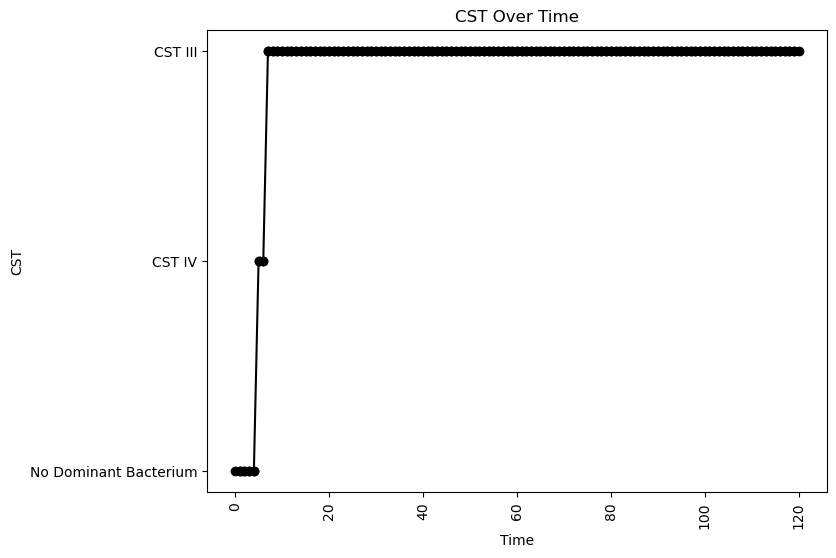


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.07062163979758648
nAB->Li: 0.00218965467667509
nAB->oLB: -0.3699899990643175
Li->nAB: 0.23327605200765378
Li Self: -0.06429740734749523
Li->oLB: 0.43820741667781726
oLB->nAB: -0.4371852123363052
oLB->Li: 0.20854917693134822
oLB Self: -0.028105360294220824

Simulation 9626 follows a valid CST progression:


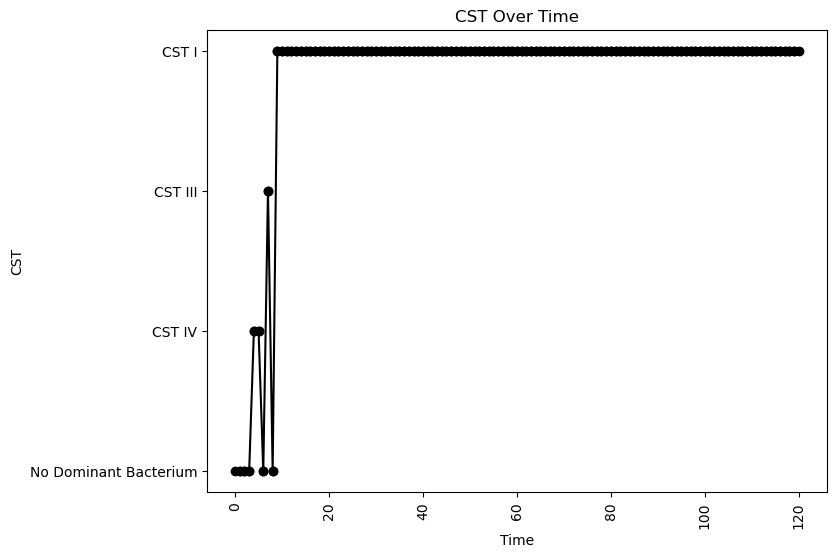


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.11832208945772521
oLB Growth: 0.1039349296945926
nAB Self: -0.02669409393081168
nAB->Li: -0.33499034615547707
nAB->oLB: -0.34636482712874184
Li->nAB: 0.21074932351750497
Li Self: -0.05630661094334768
Li->oLB: -0.4570949726791692
oLB->nAB: -0.14547403236039996
oLB->Li: 0.3060366433167533
oLB Self: -0.026440418128677104

Simulation 9628 follows a valid CST progression:


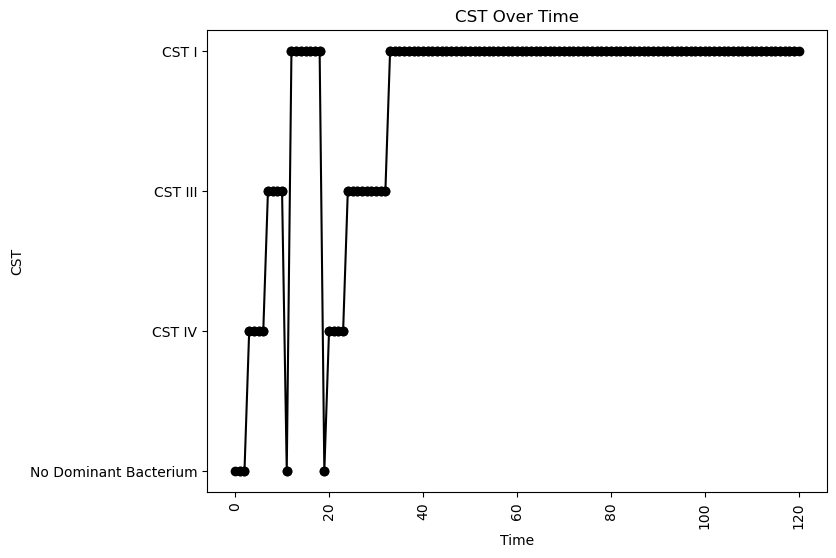


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.0347407020827159
nAB->Li: -0.4959563192840244
nAB->oLB: -0.1757666406184028
Li->nAB: 0.1721970077105066
Li Self: -0.04742624970157266
Li->oLB: -0.33893014888342826
oLB->nAB: -0.4201266306965083
oLB->Li: 0.3847859283070104
oLB Self: -0.018101181513304934

Simulation 9636 follows a valid CST progression:


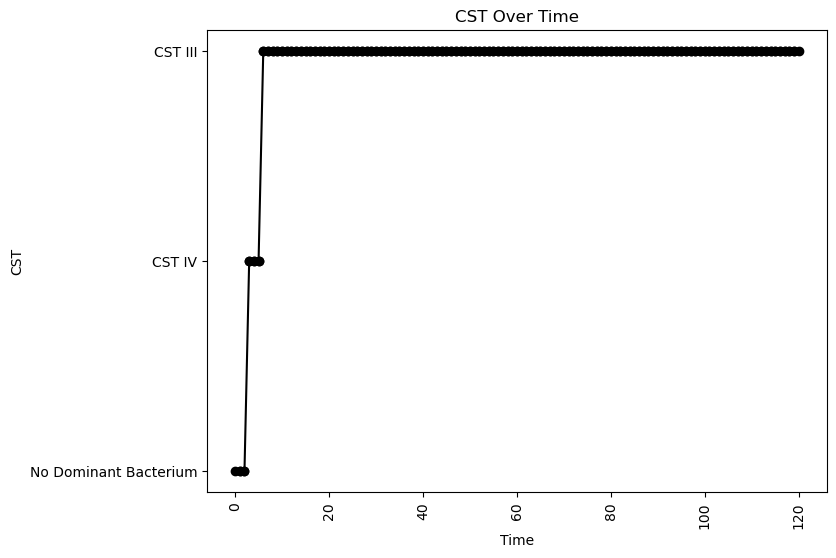


Interaction Parameters:
nAB Growth: 2.2563448832512942
Li Growth: 0.07234741829114298
oLB Growth: 0.40127498600949585
nAB Self: -0.04071375819214135
nAB->Li: 0.041395632057660725
nAB->oLB: -0.39379271178589165
Li->nAB: 0.3931429656925558
Li Self: -0.03432820981734401
Li->oLB: 0.1455446349356604
oLB->nAB: -0.21258051101335967
oLB->Li: 0.07259141720856088
oLB Self: -0.06894919367433722

Simulation 9638 follows a valid CST progression:


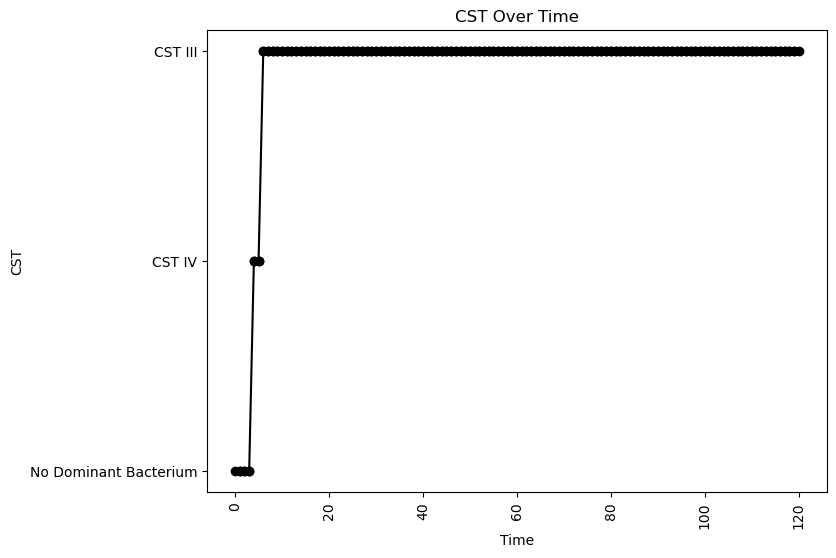


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.06316031791055562
oLB Growth: 0.3756702562538966
nAB Self: -0.060826187867663264
nAB->Li: 0.08365561493396678
nAB->oLB: -0.42957863054355105
Li->nAB: 0.4001700547091669
Li Self: -0.012679075540134088
Li->oLB: 0.4107542964119737
oLB->nAB: -0.39997188654186805
oLB->Li: -0.3633707227343176
oLB Self: -0.004776515687195462

Simulation 9641 follows a valid CST progression:


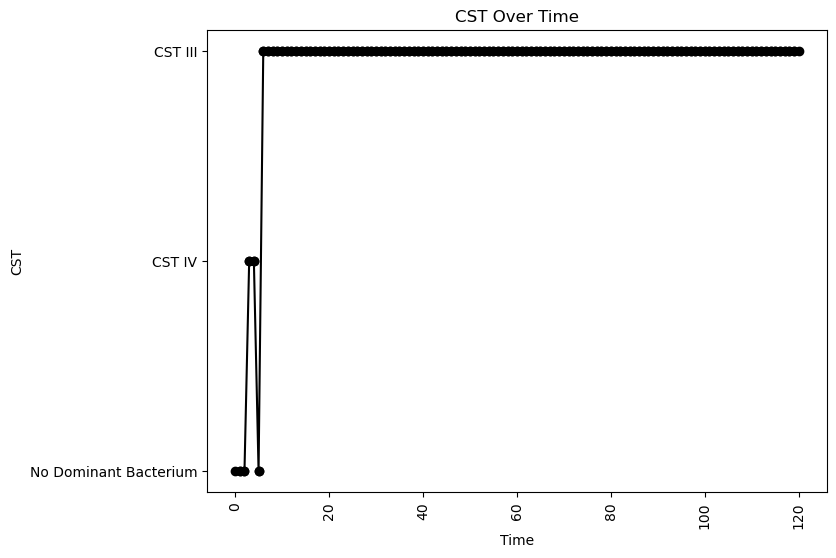


Interaction Parameters:
nAB Growth: 2.292952252819776
Li Growth: 0.06862578763464611
oLB Growth: 0.25066683866219575
nAB Self: -0.08374907237929405
nAB->Li: -0.3094415249300938
nAB->oLB: -0.4898497485293125
Li->nAB: 0.4548705265671581
Li Self: -0.0017485083912389399
Li->oLB: 0.4392718677276939
oLB->nAB: -0.2925335874093926
oLB->Li: -0.2882844438716925
oLB Self: -0.057232574401889606

Simulation 9643 follows a valid CST progression:


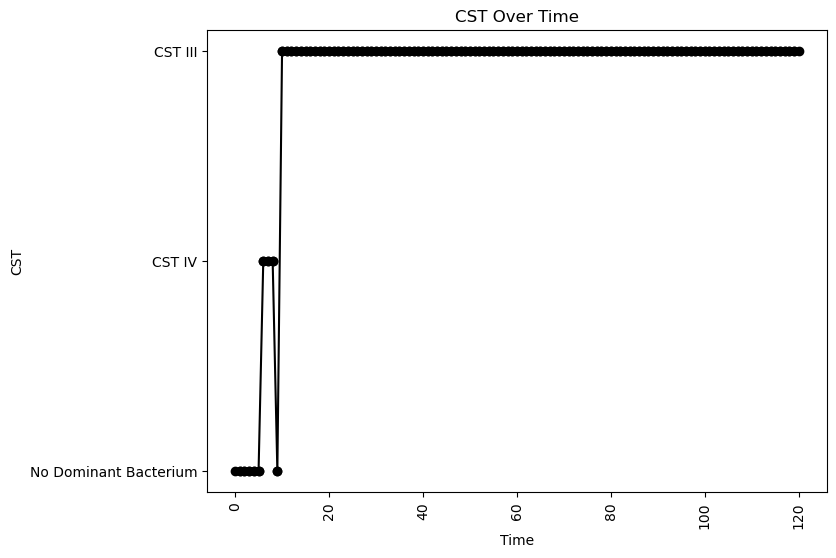


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.29660475325200986
oLB Growth: 0.31765248508565325
nAB Self: -0.04630867190136954
nAB->Li: -0.3474617236698438
nAB->oLB: -0.3898785460769143
Li->nAB: 0.060861265248195906
Li Self: -0.07558448459673911
Li->oLB: -0.34003242825851826
oLB->nAB: -0.3256724755114572
oLB->Li: -0.4352673310102976
oLB Self: -0.03256366409834961

Simulation 9644 follows a valid CST progression:


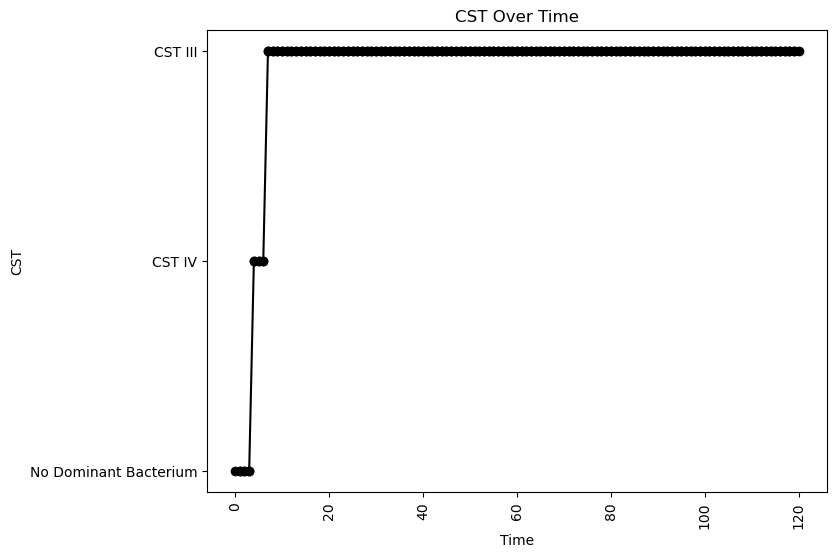


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.03284889248224808
nAB->Li: -0.17492441259330538
nAB->oLB: -0.49936586832111557
Li->nAB: 0.37558578689830746
Li Self: -0.09402241990853918
Li->oLB: 0.04437676101163612
oLB->nAB: -0.2616493207096497
oLB->Li: -0.08631338847689074
oLB Self: -0.08066856295542692

Simulation 9652 follows a valid CST progression:


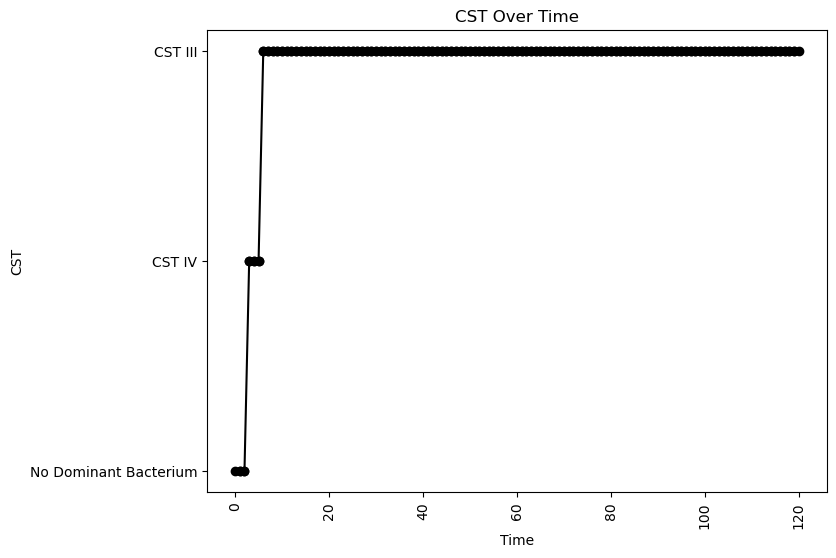


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.06362797867818959
nAB->Li: -0.08467075770456006
nAB->oLB: -0.12710661039172427
Li->nAB: 0.3649615313835681
Li Self: -0.08312130883558905
Li->oLB: 0.14264756515295773
oLB->nAB: -0.4456259670275712
oLB->Li: -0.4667702012272057
oLB Self: -0.08649891300669077

Simulation 9653 follows a valid CST progression:


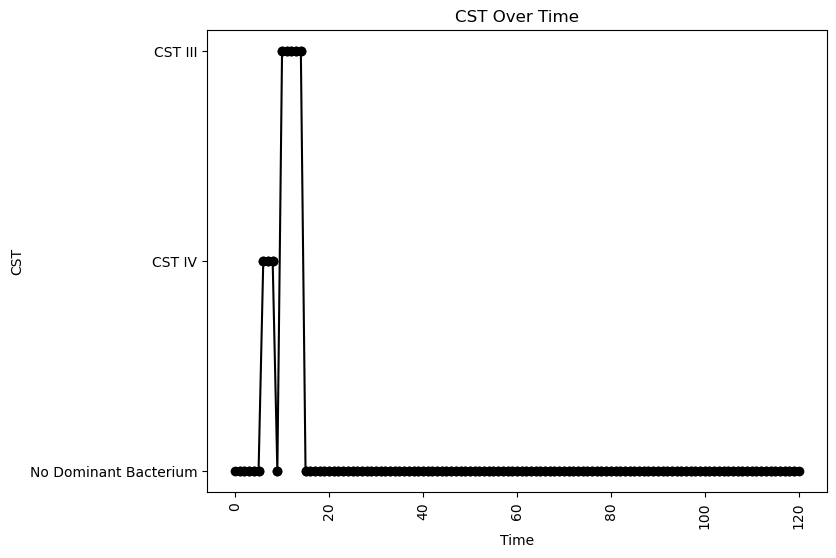


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.05739994626081137
oLB Growth: 0.11031283255203692
nAB Self: -0.02591768569210233
nAB->Li: -0.4326423179182867
nAB->oLB: -0.44102450636308715
Li->nAB: 0.12176741516482192
Li Self: -0.05271985340599214
Li->oLB: 0.28764222106487125
oLB->nAB: -0.27423261893813794
oLB->Li: 0.23951757745847557
oLB Self: -0.021163150465430824

Simulation 9663 follows a valid CST progression:


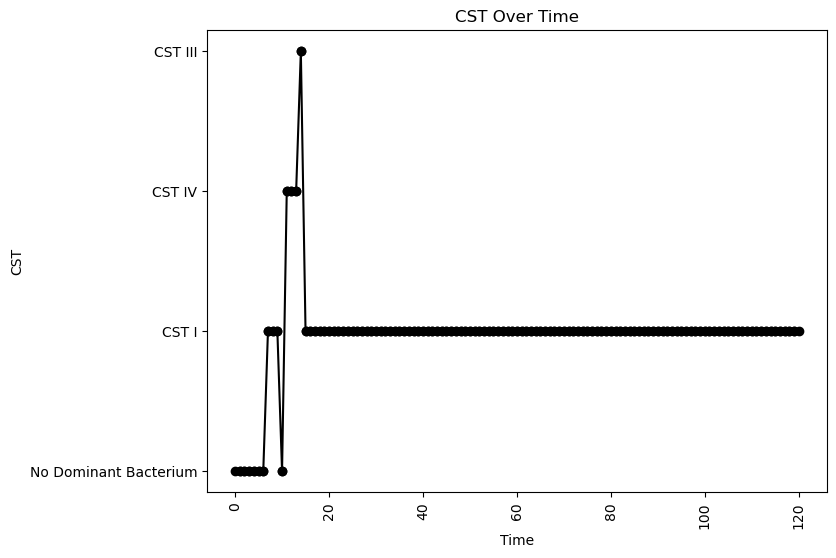


Interaction Parameters:
nAB Growth: 2.1964345031105657
Li Growth: 0.2231379850639547
oLB Growth: 1.2138354993931422
nAB Self: -0.09708758196122673
nAB->Li: -0.1624770018370657
nAB->oLB: -0.17352762694056278
Li->nAB: 0.4414044933972794
Li Self: -0.07091613549349596
Li->oLB: -0.3997102607507183
oLB->nAB: -0.2532418688041772
oLB->Li: 0.4749831736943705
oLB Self: -0.03763682493565428

Simulation 9675 follows a valid CST progression:


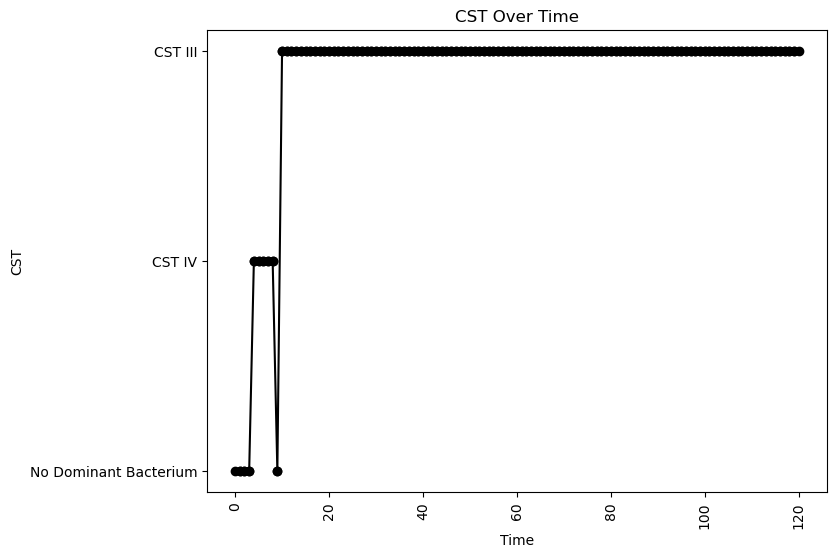


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.005727896042342931
nAB->Li: -0.39106716978641476
nAB->oLB: -0.26328900331324434
Li->nAB: 0.05302020150290143
Li Self: -0.03133235342652818
Li->oLB: 0.3568233519624472
oLB->nAB: -0.4681725870243224
oLB->Li: -0.4998715861650187
oLB Self: -0.0809809393552513

Simulation 9685 follows a valid CST progression:


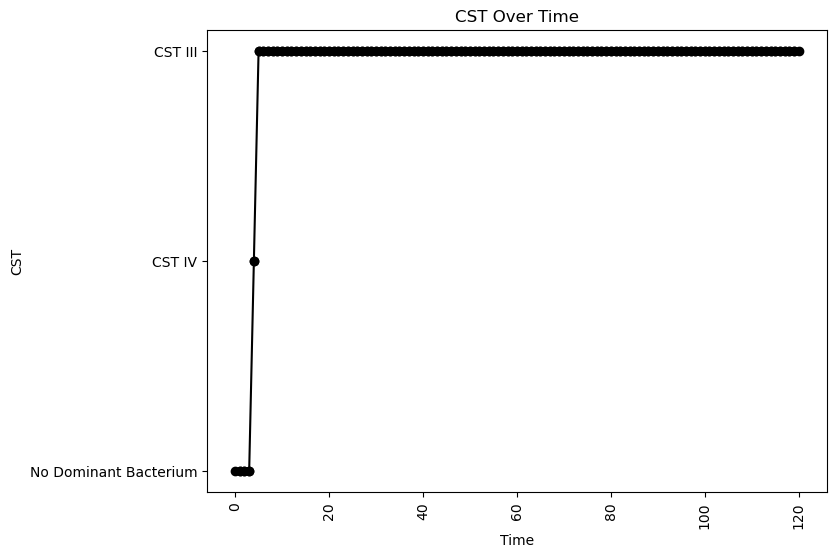


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.030381810632615497
nAB->Li: -0.2045102547176082
nAB->oLB: -0.13638938501353698
Li->nAB: 0.46558407660796186
Li Self: -0.07878687063948392
Li->oLB: 0.15056555065830024
oLB->nAB: -0.4323100815298623
oLB->Li: -0.28905634491756904
oLB Self: -0.034308145957499606

Simulation 9687 follows a valid CST progression:


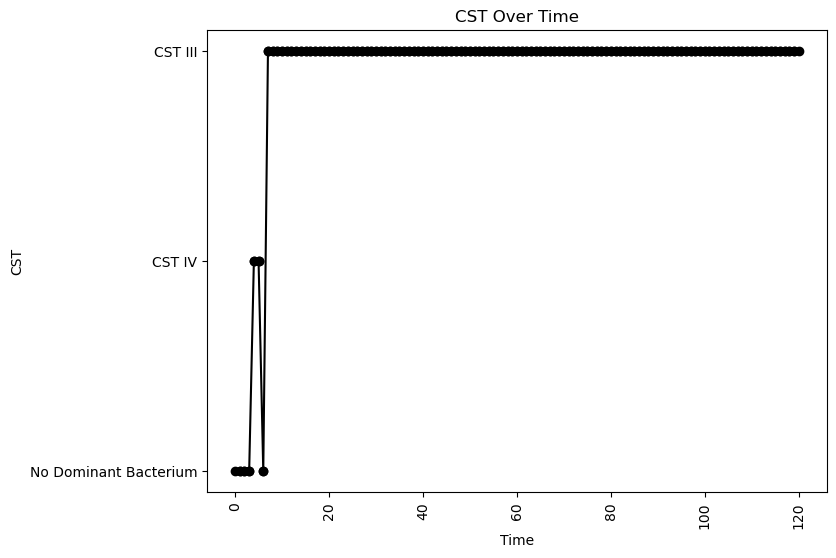


Interaction Parameters:
nAB Growth: 2.3015659627957117
Li Growth: 0.13327925572427224
oLB Growth: 0.1731103059651596
nAB Self: -0.030729741904426774
nAB->Li: -0.19165374081755382
nAB->oLB: -0.3941963114024287
Li->nAB: 0.14678339332923063
Li Self: -0.03764087759645298
Li->oLB: 0.10090345768642939
oLB->nAB: -0.29927628248282945
oLB->Li: -0.48931674318488316
oLB Self: -0.04148231250069522

Simulation 9692 follows a valid CST progression:


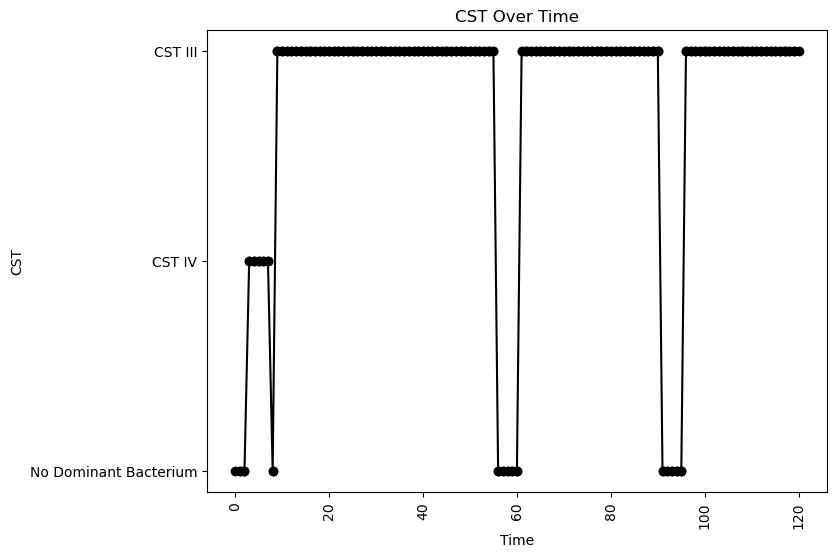


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.06120488150847537
oLB Growth: 0.20431222189445272
nAB Self: -0.07298098906776135
nAB->Li: -0.35355500000726403
nAB->oLB: -0.46063996270923835
Li->nAB: 0.1368220307100776
Li Self: -0.07147801208695342
Li->oLB: -0.13254655700021273
oLB->nAB: -0.3046956140751712
oLB->Li: -0.44503060060009614
oLB Self: -0.08386269735516369

Simulation 9693 follows a valid CST progression:


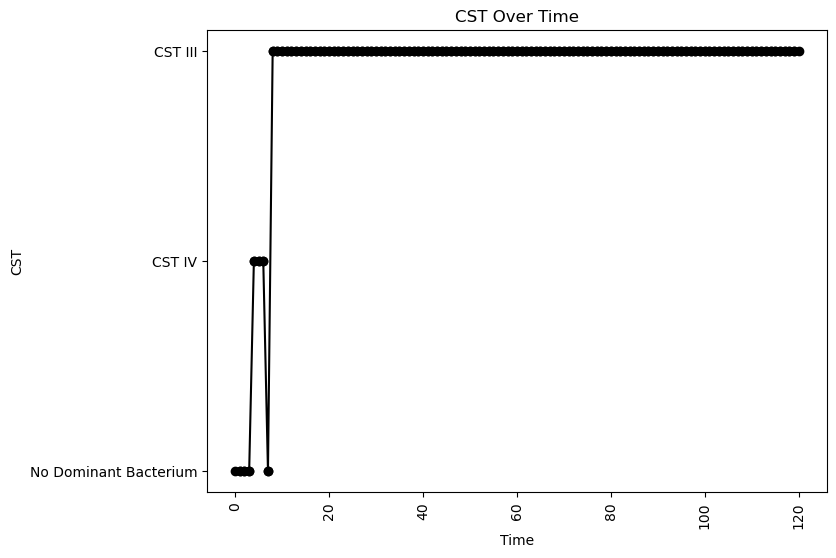


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.2263455253882643
oLB Growth: 1.155917868199191
nAB Self: -0.0664721965961835
nAB->Li: -0.16692624320985255
nAB->oLB: -0.4375932819426293
Li->nAB: 0.14149527533695183
Li Self: -0.09525036917914385
Li->oLB: -0.34845507374937035
oLB->nAB: -0.20389246564127939
oLB->Li: -0.0964641006083809
oLB Self: -0.010441395885606622

Simulation 9694 follows a valid CST progression:


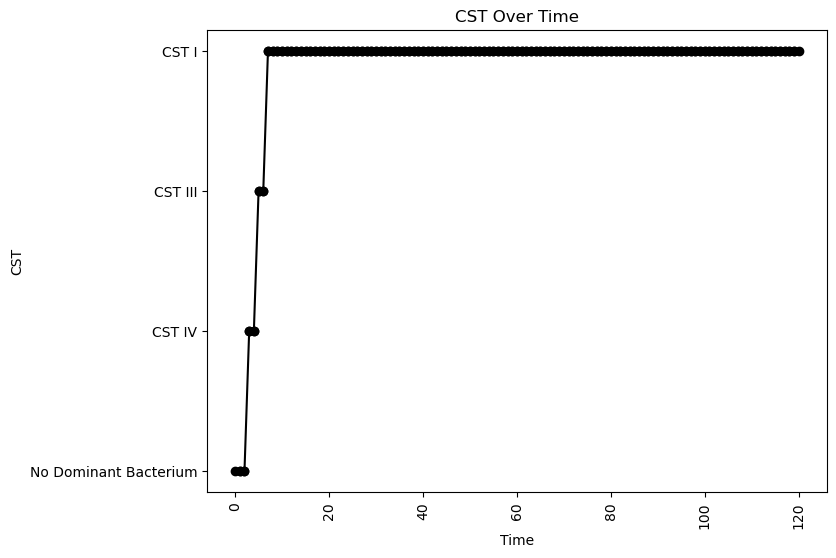


Interaction Parameters:
nAB Growth: 2.1964345031105657
Li Growth: 0.04025066595693835
oLB Growth: 1.2138354993931422
nAB Self: -0.02242808575856825
nAB->Li: -0.04919745666701919
nAB->oLB: -0.40183727223125754
Li->nAB: 0.39421296406581896
Li Self: -0.0011849856800960068
Li->oLB: -0.17969839808026628
oLB->nAB: -0.30930163392357196
oLB->Li: 0.10704884842989859
oLB Self: -0.062240093838455746

Simulation 9695 follows a valid CST progression:


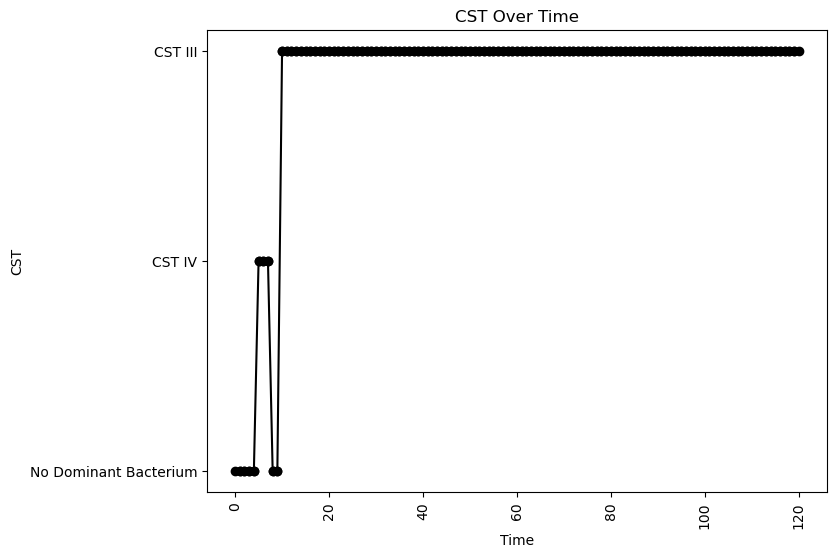


Interaction Parameters:
nAB Growth: 2.1573635369289432
Li Growth: 0.16279996413081485
oLB Growth: 1.2503024394854367
nAB Self: -0.0010561052707396962
nAB->Li: -0.26224591092796423
nAB->oLB: -0.1576637050046858
Li->nAB: 0.0701697256564
Li Self: -0.0607146747803473
Li->oLB: 0.273669998333244
oLB->nAB: -0.2830084579826069
oLB->Li: 0.021245387906486668
oLB Self: -0.06258844113329853

Simulation 9696 follows a valid CST progression:


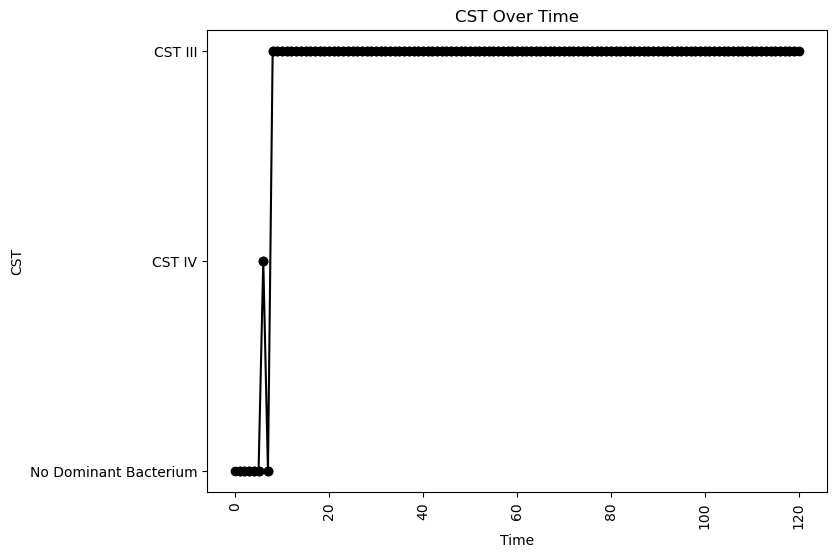


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.33508670147397335
oLB Growth: 0.21113539622386296
nAB Self: -0.03521433607548634
nAB->Li: -0.1937506503200832
nAB->oLB: -0.010690473742427153
Li->nAB: 0.06726247129520924
Li Self: -0.03740920484363193
Li->oLB: 0.46972246730846723
oLB->nAB: -0.3839513492087638
oLB->Li: -0.450118848898746
oLB Self: -0.04763457738848902

Simulation 9700 follows a valid CST progression:


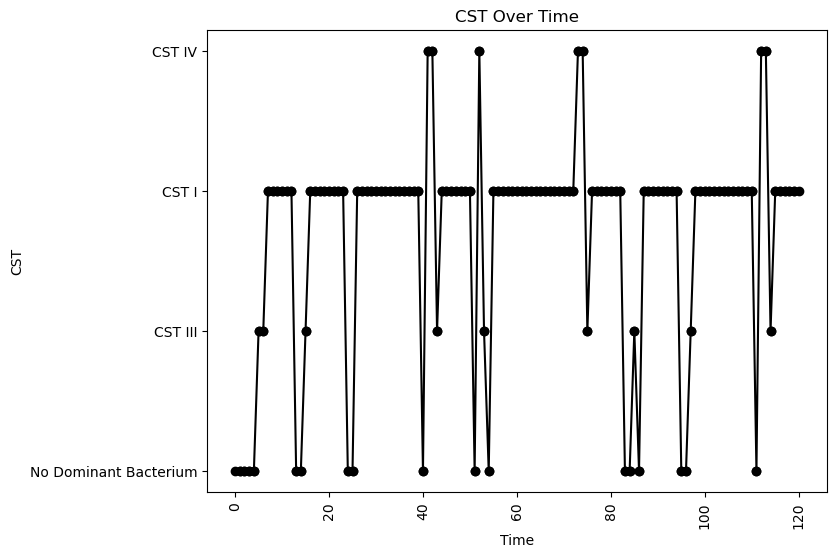


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.15924307748978148
oLB Growth: 0.03504834427483494
nAB Self: -0.03794561501816004
nAB->Li: -0.10227694313934221
nAB->oLB: -0.10597295967052717
Li->nAB: 0.4850218604703832
Li Self: -0.044665562197684014
Li->oLB: -0.0882851281128213
oLB->nAB: -0.30327445355190064
oLB->Li: 0.21978055790180695
oLB Self: -0.07271730689831182

Simulation 9701 follows a valid CST progression:


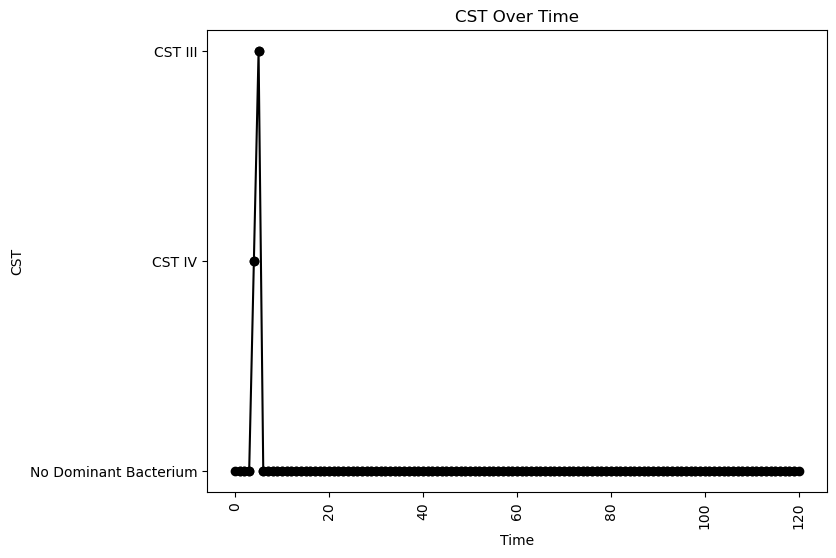


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.07326541353834837
oLB Growth: 1.155917868199191
nAB Self: -0.03403283738969466
nAB->Li: 0.1004511422704325
nAB->oLB: -0.24103055994558603
Li->nAB: 0.3016591408375199
Li Self: -0.07227494809715584
Li->oLB: 0.34048446051510806
oLB->nAB: -0.46713806491632975
oLB->Li: 0.35150652276808525
oLB Self: -0.0013638552846759328

Simulation 9712 follows a valid CST progression:


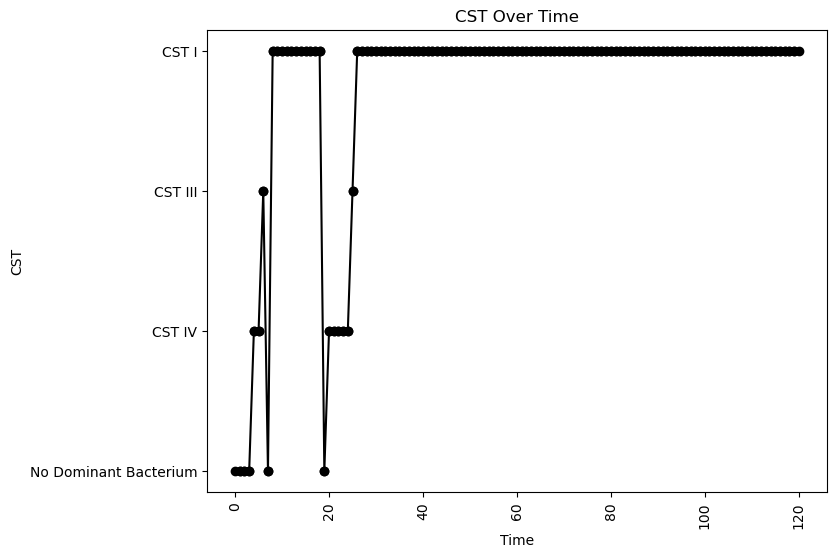


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.2512947757817121
oLB Growth: 0.5382103117959565
nAB Self: -0.01859391413528072
nAB->Li: -0.23010835271250385
nAB->oLB: -0.20854792423771035
Li->nAB: 0.20869342375515132
Li Self: -0.003848355331858261
Li->oLB: -0.3980878669431872
oLB->nAB: -0.24084773763147288
oLB->Li: 0.3482482348827993
oLB Self: -0.03368589529507984

Simulation 9713 follows a valid CST progression:


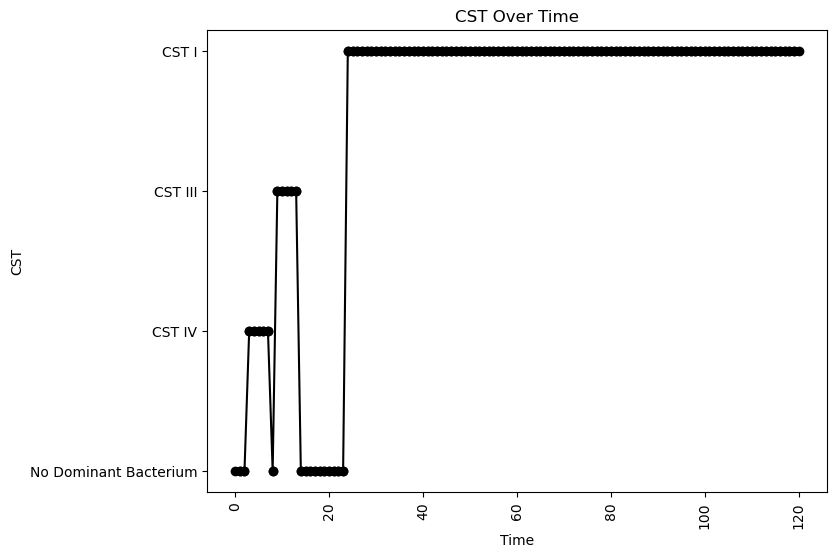


Interaction Parameters:
nAB Growth: 2.3262791639920875
Li Growth: 0.06223092634538751
oLB Growth: 0.1368234058063315
nAB Self: -0.04643361517574009
nAB->Li: -0.2849732678429754
nAB->oLB: -0.3363196607368113
Li->nAB: 0.1146926769671881
Li Self: -0.08515952877692877
Li->oLB: -0.18599417410787306
oLB->nAB: -0.09040854096400636
oLB->Li: 0.09973662875700817
oLB Self: -0.06873508699249069

Simulation 9714 follows a valid CST progression:


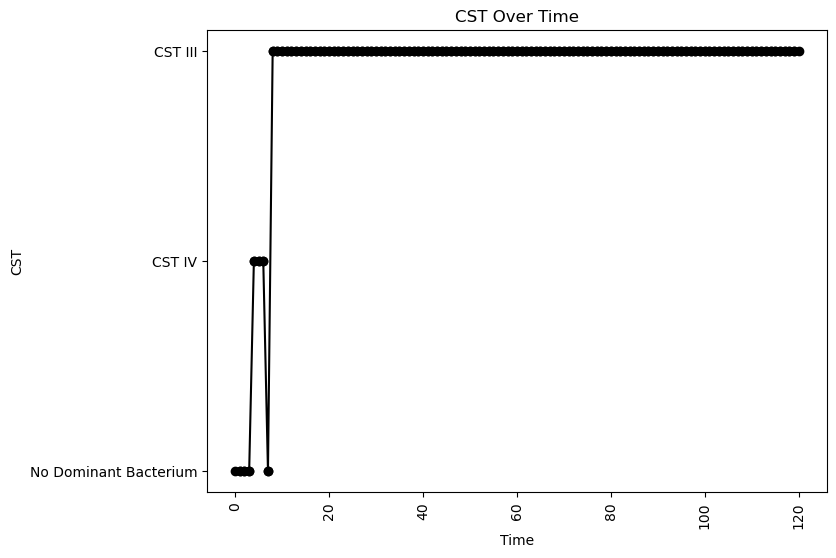


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.017206626124743593
nAB->Li: 0.028214162019063238
nAB->oLB: -0.014399095332890244
Li->nAB: 0.15650362264777706
Li Self: -0.06571268126628893
Li->oLB: 0.31359428328684646
oLB->nAB: -0.3940278404994556
oLB->Li: -0.18398318442732753
oLB Self: -0.031042527235383408

Simulation 9719 follows a valid CST progression:


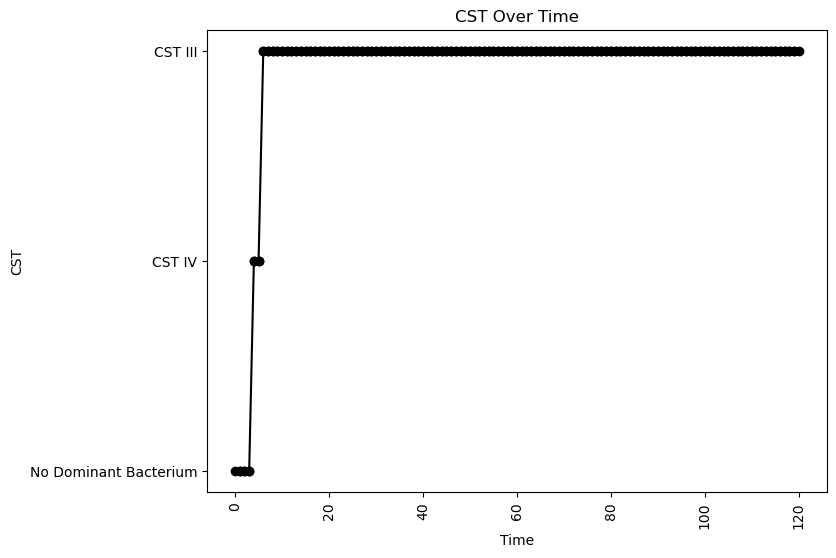


Interaction Parameters:
nAB Growth: 2.2323960114325287
Li Growth: 0.06967846000948563
oLB Growth: 0.7070472171500886
nAB Self: -0.019732057394397998
nAB->Li: -0.40028613476949704
nAB->oLB: -0.42593432429523437
Li->nAB: 0.23201727222302226
Li Self: -0.03858726754390964
Li->oLB: 0.03811380937753728
oLB->nAB: -0.34771180465035073
oLB->Li: -0.4292896265822977
oLB Self: -0.004353270019148536

Simulation 9727 follows a valid CST progression:


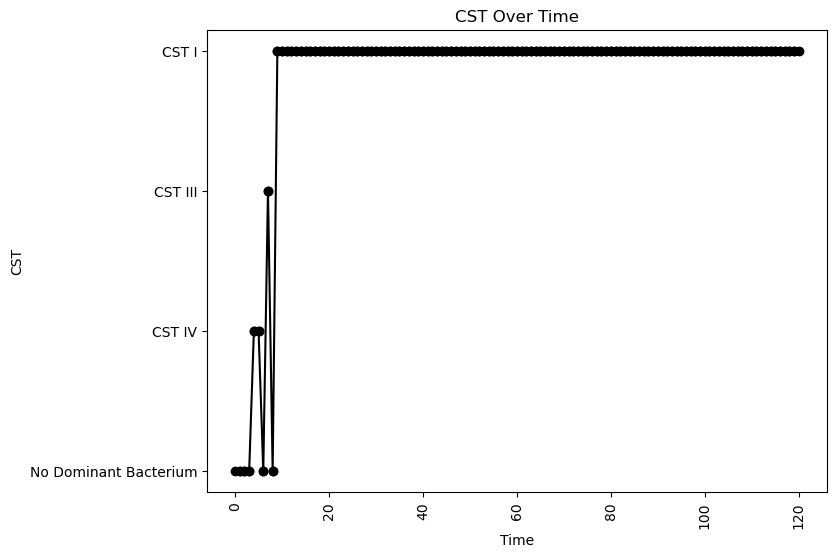


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.07161581394779
nAB->Li: -0.032205297462925886
nAB->oLB: -0.37316321771997774
Li->nAB: 0.3391764777255074
Li Self: -0.0591765738843797
Li->oLB: -0.3476592591201114
oLB->nAB: -0.3235209047684923
oLB->Li: 0.21871435258150473
oLB Self: -0.02082933473778298

Simulation 9734 follows a valid CST progression:


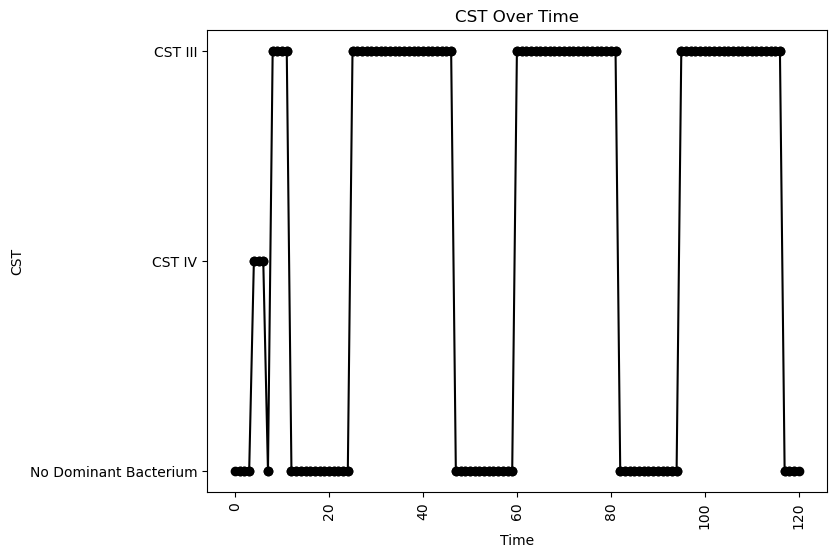


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.20255537098446888
oLB Growth: 0.8534408763679777
nAB Self: -0.04657040594169828
nAB->Li: -0.052779729246496376
nAB->oLB: -0.28956436788192075
Li->nAB: 0.12607611795774376
Li Self: -0.09574987976533454
Li->oLB: -0.16145749306807938
oLB->nAB: -0.14761837691749918
oLB->Li: -0.044429279487188
oLB Self: -0.040391616069692854

Simulation 9759 follows a valid CST progression:


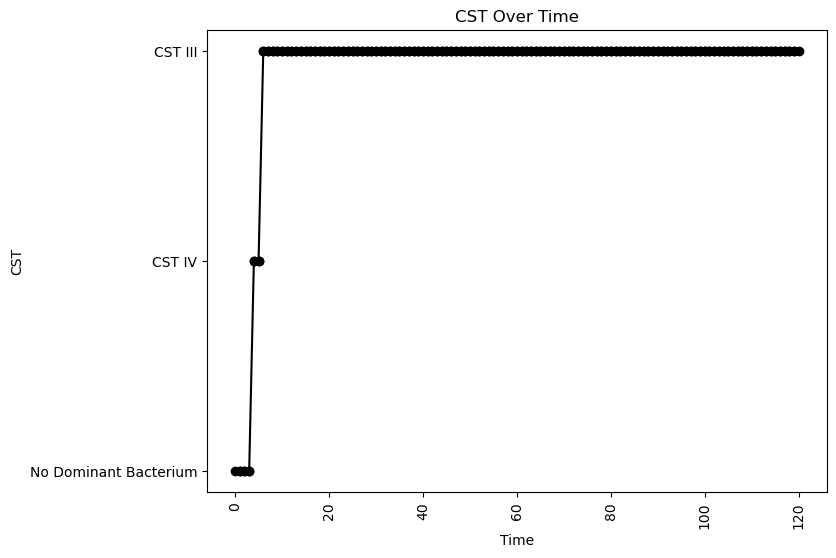


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.025092144618062806
nAB->Li: -0.25171405243411216
nAB->oLB: -0.28241323465635426
Li->nAB: 0.418534505252813
Li Self: -0.018564504310803642
Li->oLB: 0.17517074169657287
oLB->nAB: -0.17487877080921127
oLB->Li: -0.38819199177681546
oLB Self: -0.02130730965387144

Simulation 9763 follows a valid CST progression:


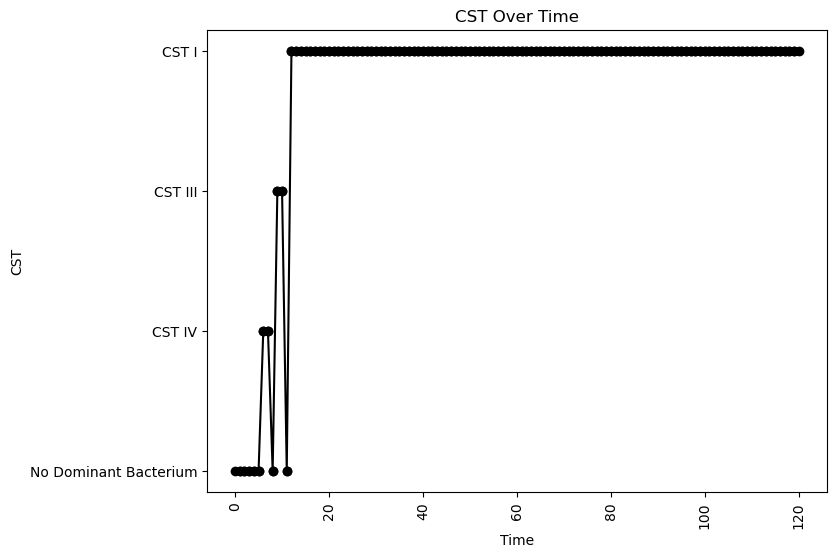


Interaction Parameters:
nAB Growth: 2.300652803872004
Li Growth: 0.21667974975514015
oLB Growth: 0.4369767544558836
nAB Self: -0.06999301731220246
nAB->Li: -0.4294113581151909
nAB->oLB: -0.2774107885029575
Li->nAB: 0.12404247430280846
Li Self: -0.040820830084130476
Li->oLB: -0.46913195192282275
oLB->nAB: -0.312992162036698
oLB->Li: 0.3675629845531089
oLB Self: -0.022457926555028374

Simulation 9764 follows a valid CST progression:


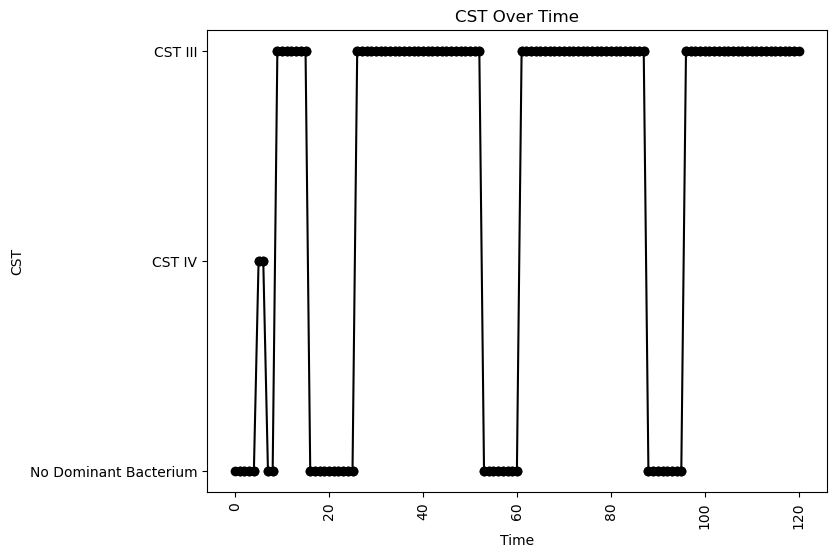


Interaction Parameters:
nAB Growth: 2.3584021841164176
Li Growth: 0.16844417682542012
oLB Growth: 0.20431222189445272
nAB Self: -0.058334042348911146
nAB->Li: -0.18843695123185045
nAB->oLB: -0.17103609350640936
Li->nAB: 0.10228747558706464
Li Self: -0.08394741518310285
Li->oLB: 0.20838561575923542
oLB->nAB: -0.030207776070635406
oLB->Li: -0.46105449161293177
oLB Self: -0.03990365699913769

Simulation 9767 follows a valid CST progression:


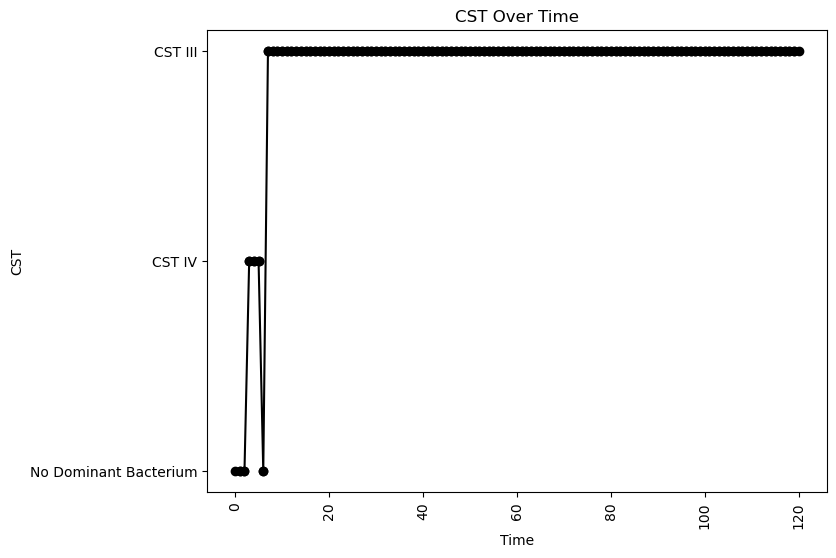


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.021903764405345083
nAB->Li: -0.17662623728506843
nAB->oLB: -0.22635503726108086
Li->nAB: 0.21317700545213947
Li Self: -0.050628633136326054
Li->oLB: 0.3884886564761795
oLB->nAB: -0.15469443182465853
oLB->Li: -0.39286063285373496
oLB Self: -0.09058100342539048

Simulation 9769 follows a valid CST progression:


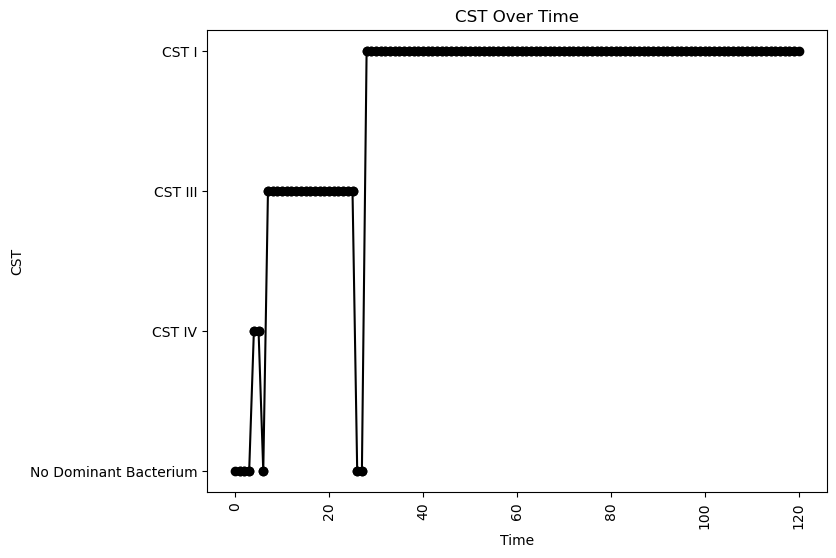


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.058089995197407034
oLB Growth: 0.8024693458968353
nAB Self: -0.05627338276451194
nAB->Li: -0.21352761987783975
nAB->oLB: -0.33161479549606376
Li->nAB: 0.48343493637943813
Li Self: -0.053558916034429055
Li->oLB: -0.29631126232661675
oLB->nAB: -0.08440654634344491
oLB->Li: -0.027997974882840948
oLB Self: -0.06602787695999254

Simulation 9770 follows a valid CST progression:


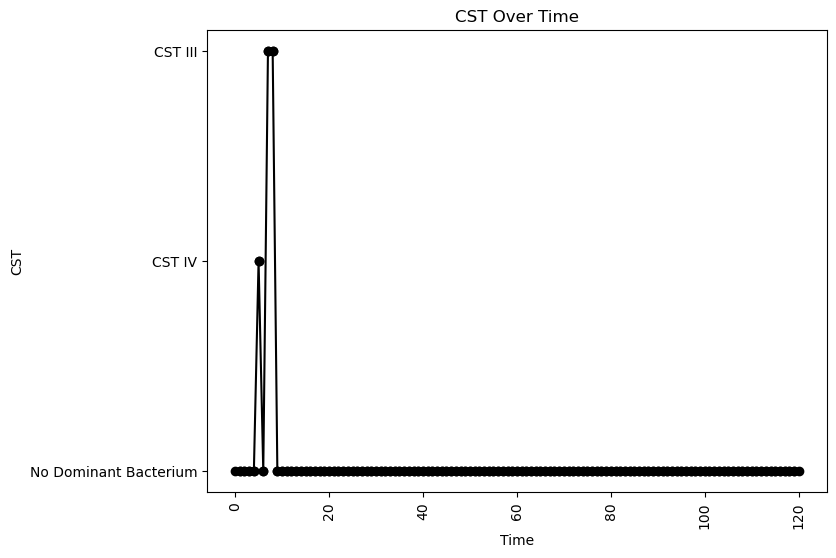


Interaction Parameters:
nAB Growth: 2.2534445110264323
Li Growth: 0.06059901297310884
oLB Growth: 0.8534408763679777
nAB Self: -0.058059471399643306
nAB->Li: -0.2797869209116083
nAB->oLB: -0.3043903744804587
Li->nAB: 0.3450400735084611
Li Self: -0.09242404104233995
Li->oLB: 0.38253545985138093
oLB->nAB: -0.10433733476710233
oLB->Li: 0.21757963410913583
oLB Self: -0.027645902077977444

Simulation 9772 follows a valid CST progression:


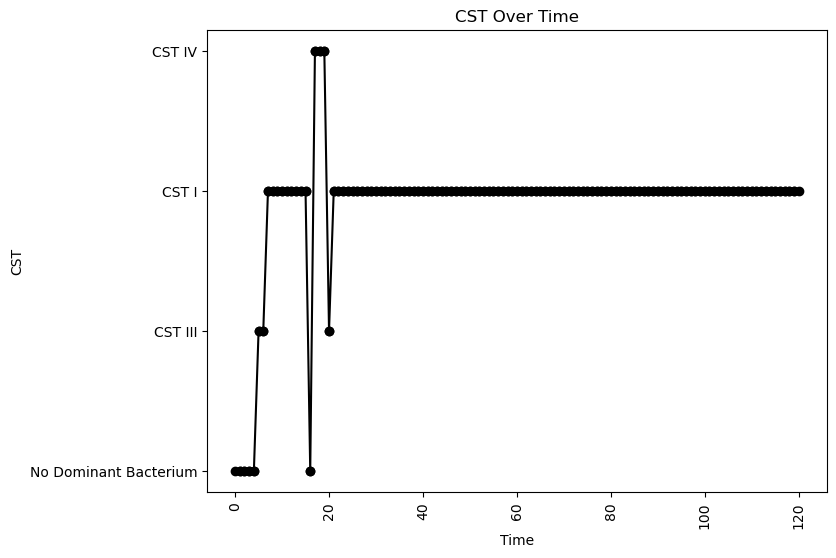


Interaction Parameters:
nAB Growth: 2.3193543466936215
Li Growth: 0.32373956904642753
oLB Growth: 0.21113539622386296
nAB Self: -0.019987454221444642
nAB->Li: -0.22378887959820182
nAB->oLB: -0.35958030507430655
Li->nAB: 0.4374681670420202
Li Self: -0.07736288615973985
Li->oLB: -0.4002286565423593
oLB->nAB: -0.3901521641782368
oLB->Li: 0.33030341425458243
oLB Self: -0.06596261586915672

Simulation 9774 follows a valid CST progression:


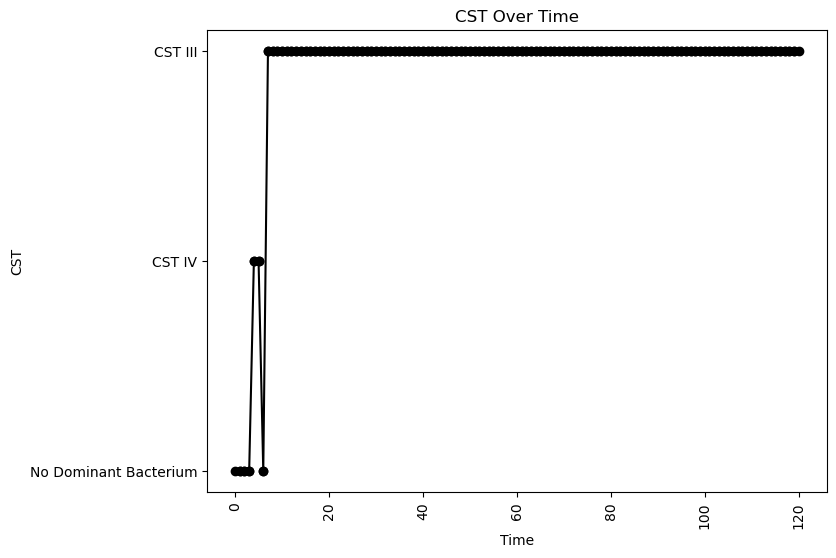


Interaction Parameters:
nAB Growth: 2.2758712096200564
Li Growth: 0.06806014290478743
oLB Growth: 0.20414555748463747
nAB Self: -0.06406895673384108
nAB->Li: -0.24247144107172125
nAB->oLB: -0.3845791399679972
Li->nAB: 0.2670807548807137
Li Self: -0.08108207068502561
Li->oLB: -0.26784508312684996
oLB->nAB: -0.060254642608336295
oLB->Li: -0.2568865404713886
oLB Self: -0.07378268352337694

Simulation 9777 follows a valid CST progression:


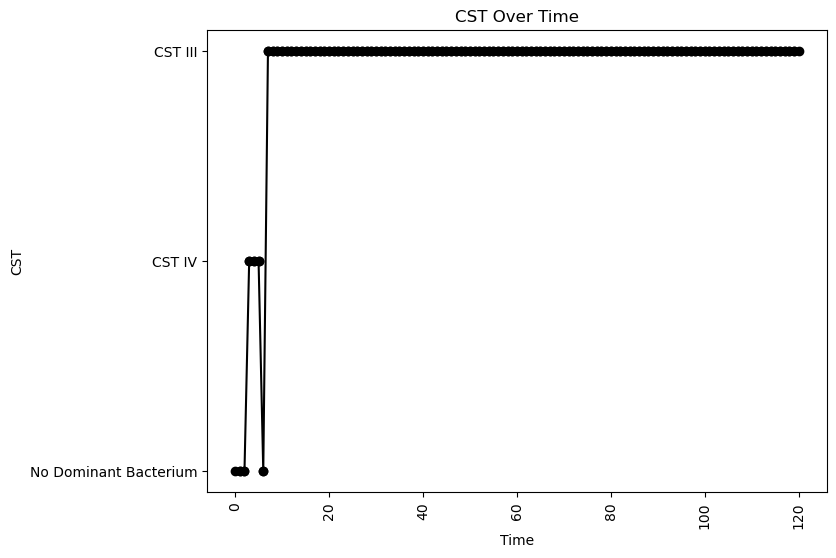


Interaction Parameters:
nAB Growth: 2.2338481754972297
Li Growth: 0.03837725110012093
oLB Growth: 1.155917868199191
nAB Self: -0.012860663267404537
nAB->Li: 0.05994103575745202
nAB->oLB: -0.4240520331156217
Li->nAB: 0.19998780021375573
Li Self: -0.010972288555451862
Li->oLB: -0.21527690793037813
oLB->nAB: -0.04346267531691678
oLB->Li: -0.19143983444180424
oLB Self: -0.05437218747589195

Simulation 9786 follows a valid CST progression:


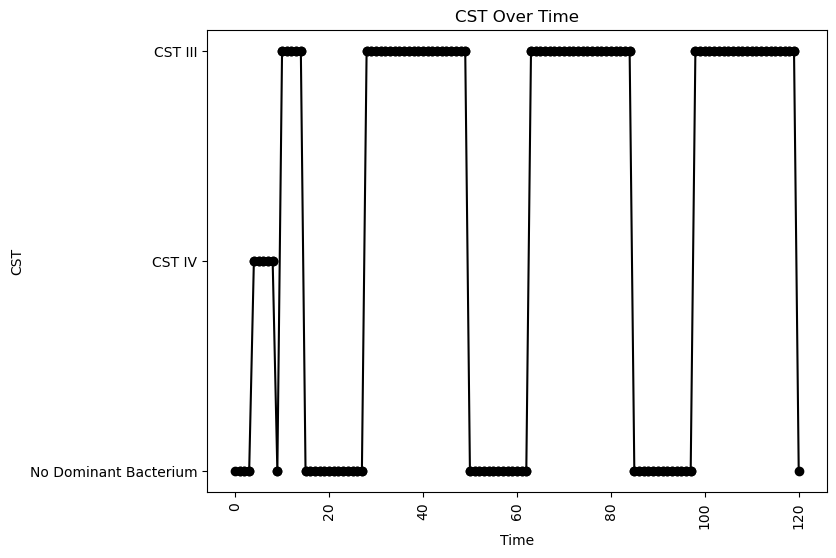


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.0495479427169623
nAB->Li: -0.3566075317075641
nAB->oLB: -0.22033799061126713
Li->nAB: 0.10045092264279964
Li Self: -0.08589991393817437
Li->oLB: -0.23165592550512765
oLB->nAB: -0.08022174186889658
oLB->Li: -0.35175616582079255
oLB Self: -0.010463103812281951

Simulation 9788 follows a valid CST progression:


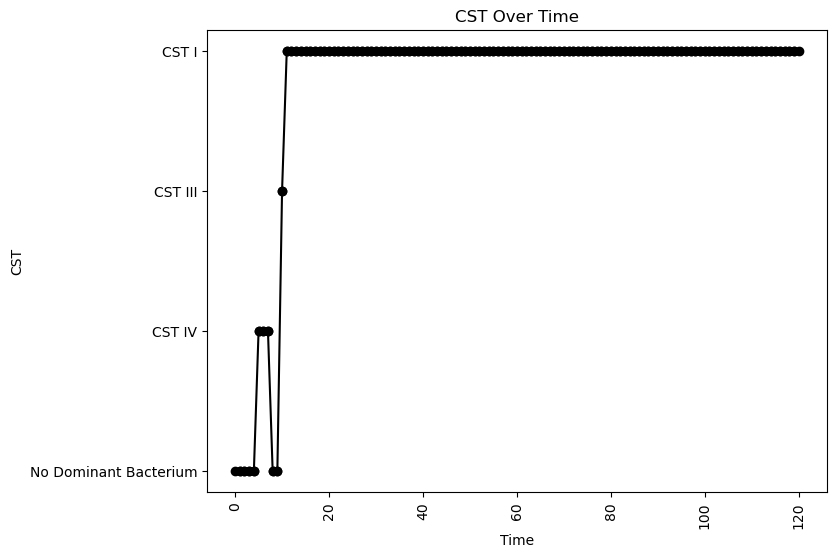


Interaction Parameters:
nAB Growth: 2.2489702826927647
Li Growth: 0.07143879299629578
oLB Growth: 0.24213610993368434
nAB Self: -0.05974032987172041
nAB->Li: 0.050125488356298264
nAB->oLB: -0.2056412186725266
Li->nAB: 0.20557877264748659
Li Self: -0.050526700238484386
Li->oLB: -0.2208330953252925
oLB->nAB: -0.44379127353360004
oLB->Li: 0.25173303075891695
oLB Self: -0.027531732011048415

Simulation 9790 follows a valid CST progression:


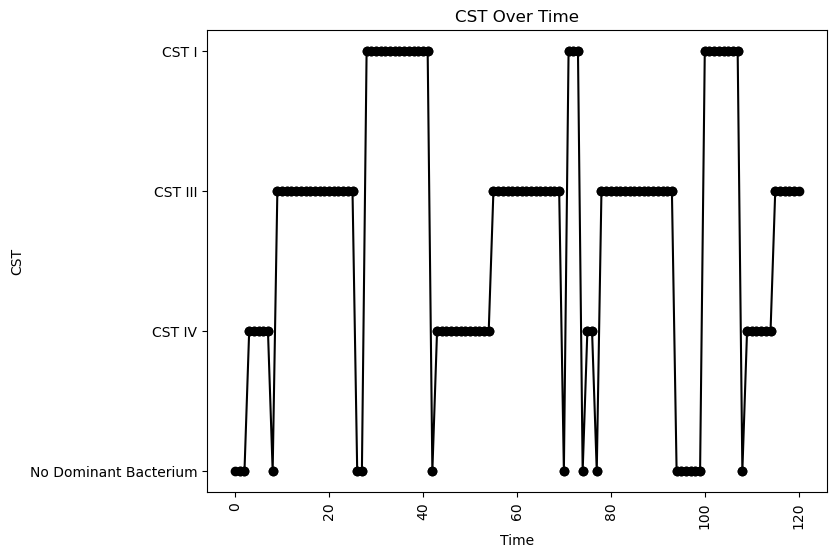


Interaction Parameters:
nAB Growth: 2.2609282147211935
Li Growth: 0.06381435834914458
oLB Growth: 0.1660151901294062
nAB Self: -0.09915591893091487
nAB->Li: -0.26140619824536976
nAB->oLB: -0.11937821603197446
Li->nAB: 0.23561649246665284
Li Self: -0.03454186390641195
Li->oLB: -0.31052689654315146
oLB->nAB: -0.06609334187191662
oLB->Li: -0.03865007140401594
oLB Self: -0.06590333109897811

Simulation 9800 follows a valid CST progression:


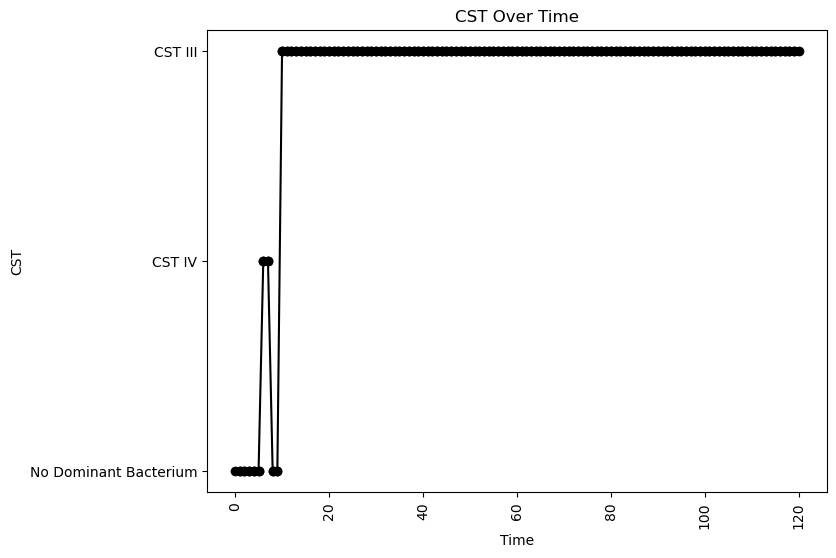


Interaction Parameters:
nAB Growth: 2.172057972480792
Li Growth: 0.05464936187495586
oLB Growth: 1.1816194682992254
nAB Self: -0.002640397648822887
nAB->Li: -0.1252486434021245
nAB->oLB: -0.22190081546277257
Li->nAB: 0.26216043070286965
Li Self: -0.01596397346287924
Li->oLB: 0.3865745210282915
oLB->nAB: -0.3801783510098119
oLB->Li: -0.3193664557044341
oLB Self: -0.04646519296844147

Simulation 9804 follows a valid CST progression:


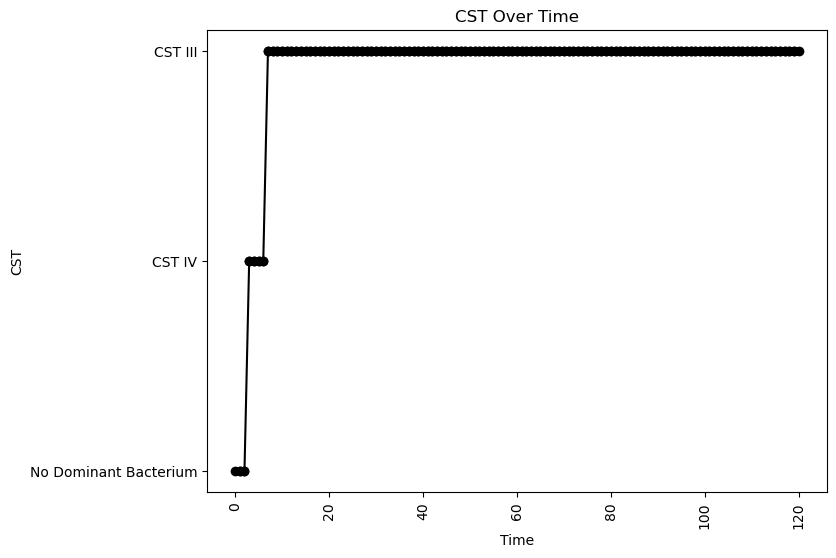


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.060060035707071746
oLB Growth: 0.1039349296945926
nAB Self: -0.0281773755878532
nAB->Li: 0.04638721188103767
nAB->oLB: -0.13131506140122978
Li->nAB: 0.25196105259407064
Li Self: -0.08893361867029928
Li->oLB: 0.05283296470829546
oLB->nAB: -0.4910952731139225
oLB->Li: -0.16606820864490618
oLB Self: -0.04209767321343059

Simulation 9809 follows a valid CST progression:


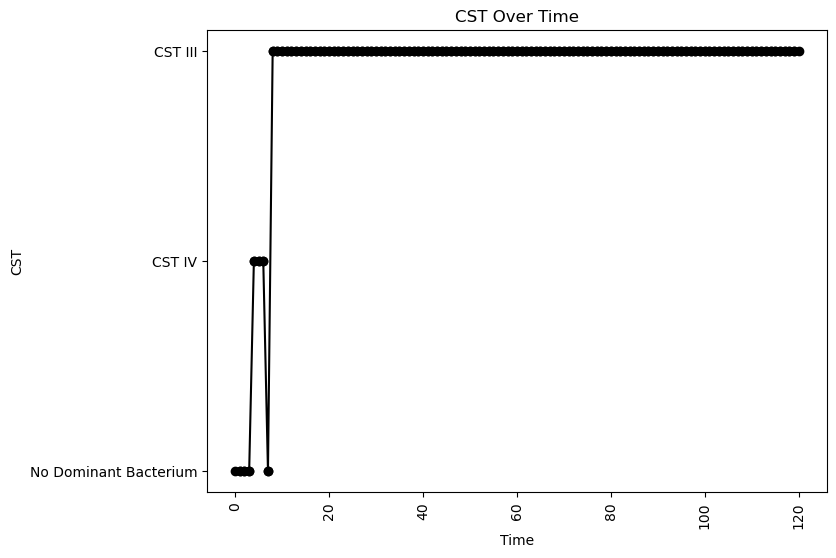


Interaction Parameters:
nAB Growth: 2.172057972480792
Li Growth: 0.05464936187495586
oLB Growth: 1.1816194682992254
nAB Self: -0.07683460069721053
nAB->Li: 0.14788431111397482
nAB->oLB: -0.16169881006367798
Li->nAB: 0.1696604902349269
Li Self: -0.00432694136271751
Li->oLB: 0.3853480791836078
oLB->nAB: -0.07739798282858917
oLB->Li: -0.4299453821098376
oLB Self: -0.03347052420519596

Simulation 9811 follows a valid CST progression:


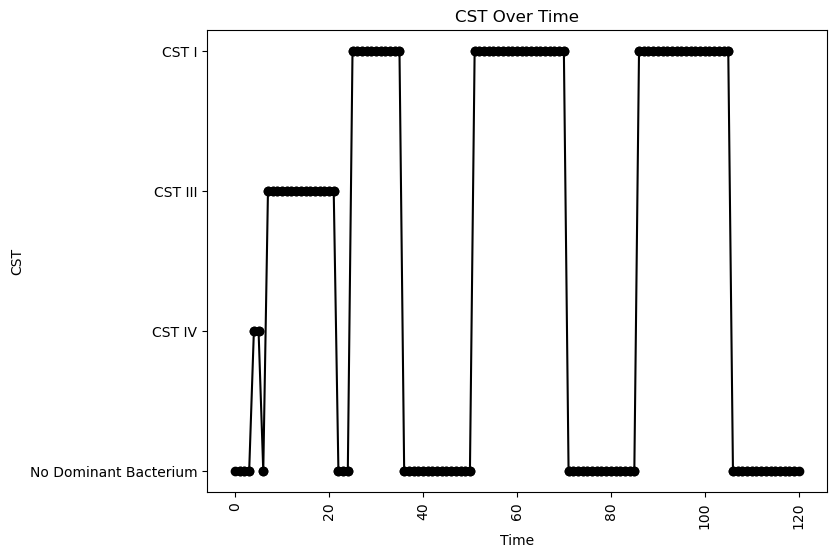


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.29163963640204543
oLB Growth: 0.9128027925042091
nAB Self: -0.09317250229668883
nAB->Li: -0.2632330042638295
nAB->oLB: -0.339635042145239
Li->nAB: 0.14310663044600191
Li Self: -0.09630556328547565
Li->oLB: 0.0453949975799427
oLB->nAB: -0.06980708435984123
oLB->Li: -0.012918472099535505
oLB Self: -0.01239013219828268

Simulation 9813 follows a valid CST progression:


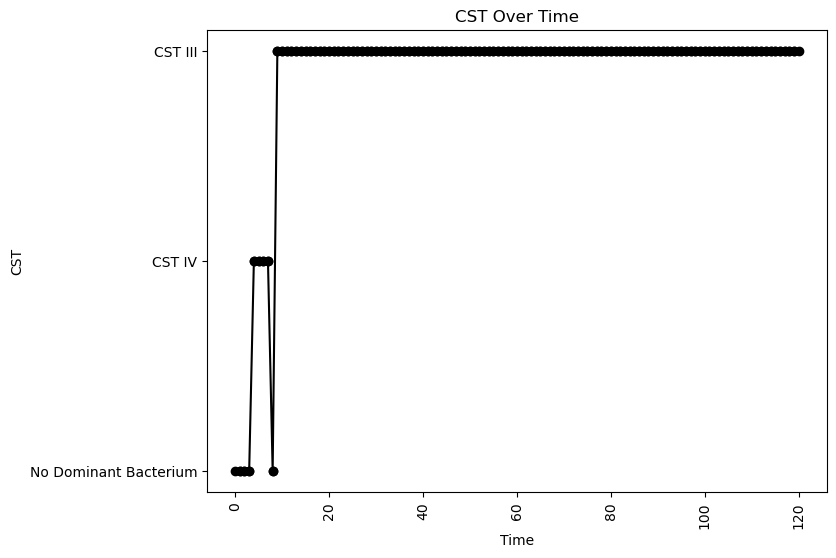


Interaction Parameters:
nAB Growth: 2.243820240102052
Li Growth: 0.05072073600009906
oLB Growth: 1.0858755226067296
nAB Self: -0.02547005780425217
nAB->Li: -0.4409563284185054
nAB->oLB: -0.05920004211238
Li->nAB: 0.07944159560810238
Li Self: -0.0047499620933419
Li->oLB: 0.33775448612631154
oLB->nAB: -0.3094862324162584
oLB->Li: -0.05523776171331568
oLB Self: -0.044692845594095504

Simulation 9818 follows a valid CST progression:


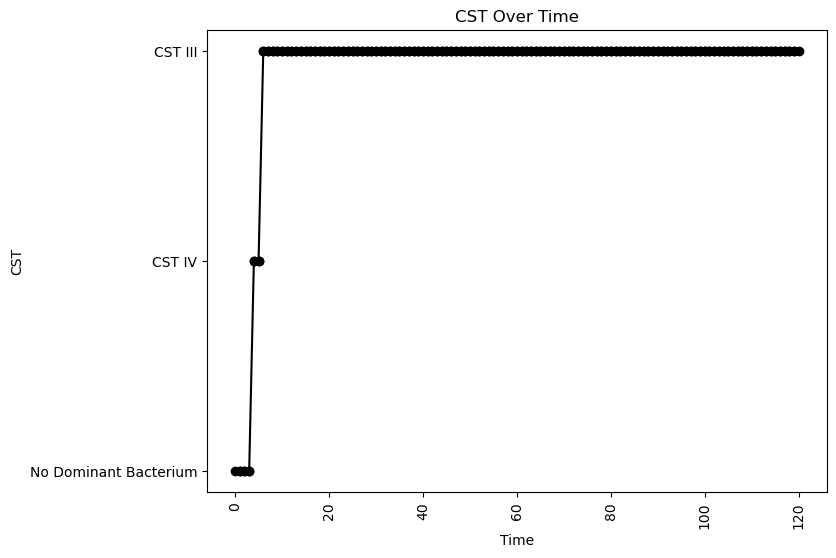


Interaction Parameters:
nAB Growth: 2.351778922152592
Li Growth: 0.06027184408871397
oLB Growth: 0.31765248508565325
nAB Self: -0.06713453744383759
nAB->Li: -0.21362943447898286
nAB->oLB: -0.046096325539909166
Li->nAB: 0.32739327763200876
Li Self: -0.0027888274006267894
Li->oLB: 0.2850238106037105
oLB->nAB: -0.014745899425914477
oLB->Li: -0.4975765341514118
oLB Self: -0.08426232194886932

Simulation 9820 follows a valid CST progression:


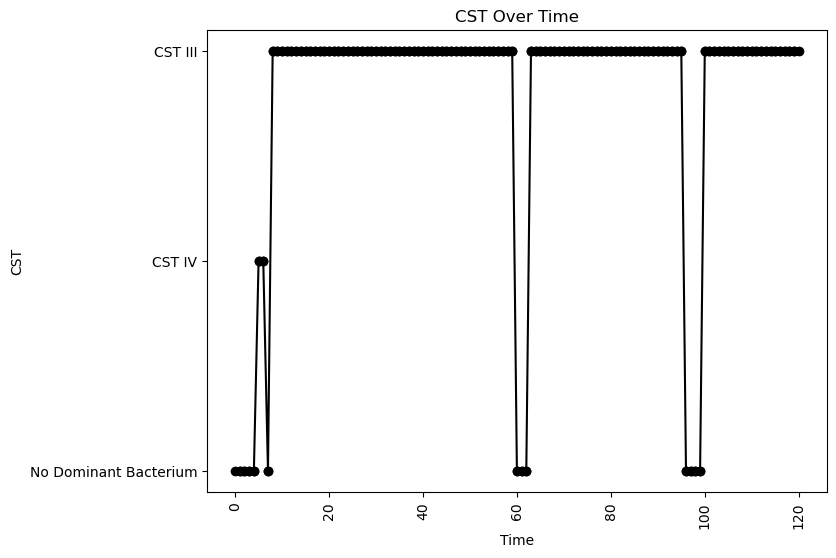


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.033441708939263806
nAB->Li: -0.41345099712087063
nAB->oLB: -0.41802783332981575
Li->nAB: 0.2555389894769555
Li Self: -0.06918265884905832
Li->oLB: 0.18237879349710218
oLB->nAB: -0.27382232858491706
oLB->Li: -0.3391253465116729
oLB Self: -0.008244553417247835

Simulation 9821 follows a valid CST progression:


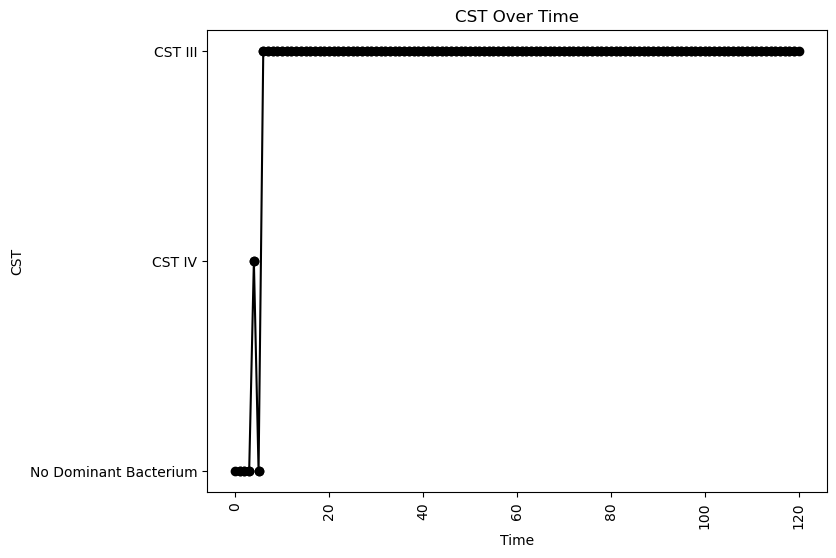


Interaction Parameters:
nAB Growth: 2.2846830407598557
Li Growth: 0.2061594611476181
oLB Growth: 0.8024693458968353
nAB Self: -0.06474708946928129
nAB->Li: -0.10385279898140254
nAB->oLB: -0.3062283427264091
Li->nAB: 0.30681686802128894
Li Self: -0.047269229797367654
Li->oLB: -0.27750934275753847
oLB->nAB: -0.300137136355626
oLB->Li: -0.26165708773826324
oLB Self: -0.040818963825762215

Simulation 9825 follows a valid CST progression:


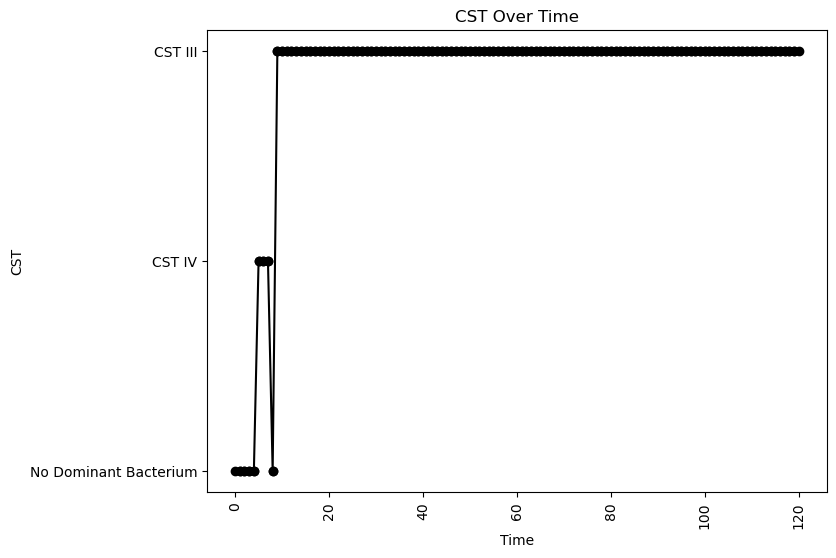


Interaction Parameters:
nAB Growth: 2.3662042066378244
Li Growth: 0.06140906874125794
oLB Growth: 0.1263134331844771
nAB Self: -0.03809807730394028
nAB->Li: -0.12392243710482498
nAB->oLB: -0.3210463934432717
Li->nAB: 0.0894963454054497
Li Self: -0.01513742326360168
Li->oLB: 0.34891237878529313
oLB->nAB: -0.3664202894002988
oLB->Li: 0.15462507819284577
oLB Self: -0.0915105184968523

Simulation 9832 follows a valid CST progression:


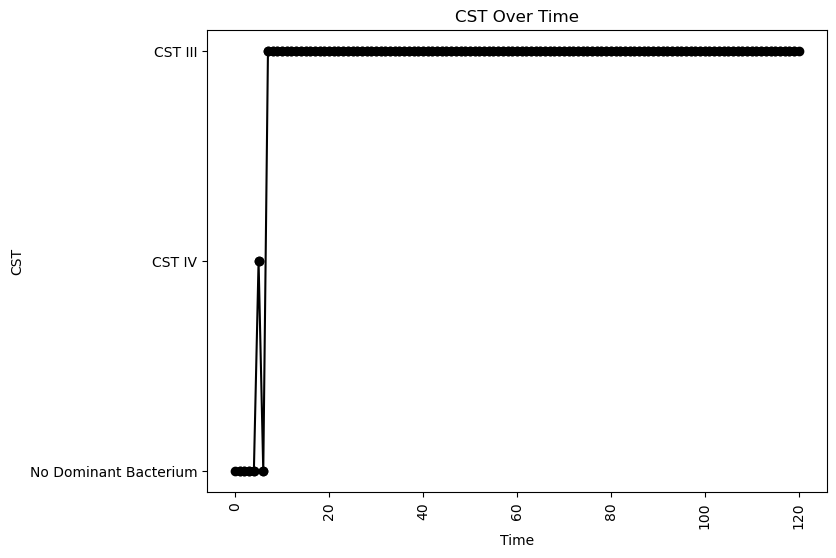


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.055620594884146904
oLB Growth: 0.7334429546888279
nAB Self: -0.09839275810358725
nAB->Li: -0.381692525440533
nAB->oLB: -0.391656538454462
Li->nAB: 0.3459935864472762
Li Self: -0.07329056379150026
Li->oLB: 0.4546494944081374
oLB->nAB: -0.16159182424174107
oLB->Li: 0.12519415976069348
oLB Self: -0.07583833168151172

Simulation 9835 follows a valid CST progression:


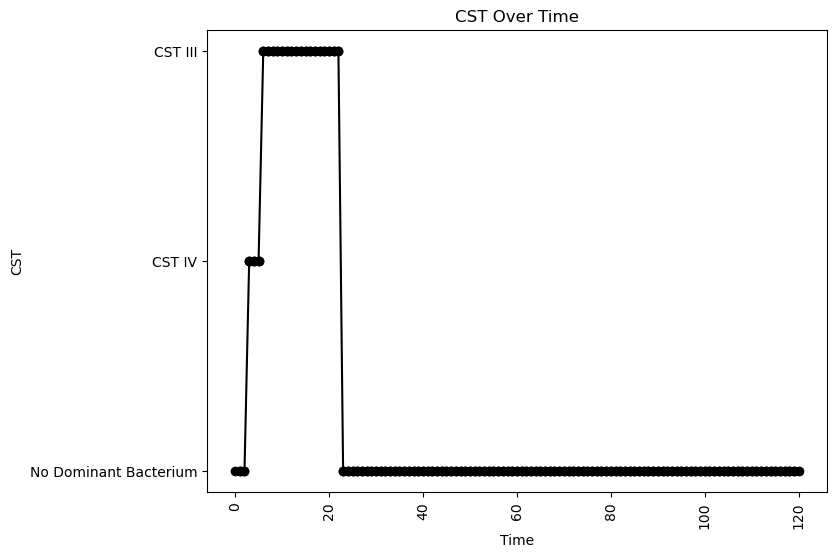


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.07472786334770633
nAB->Li: 0.10079845028698509
nAB->oLB: -0.12395207168271072
Li->nAB: 0.2101668386384784
Li Self: -0.0064114523204315405
Li->oLB: 0.2522831874417777
oLB->nAB: -0.38556161156816904
oLB->Li: -0.4238649769269351
oLB Self: -0.009743690158788385

Simulation 9836 follows a valid CST progression:


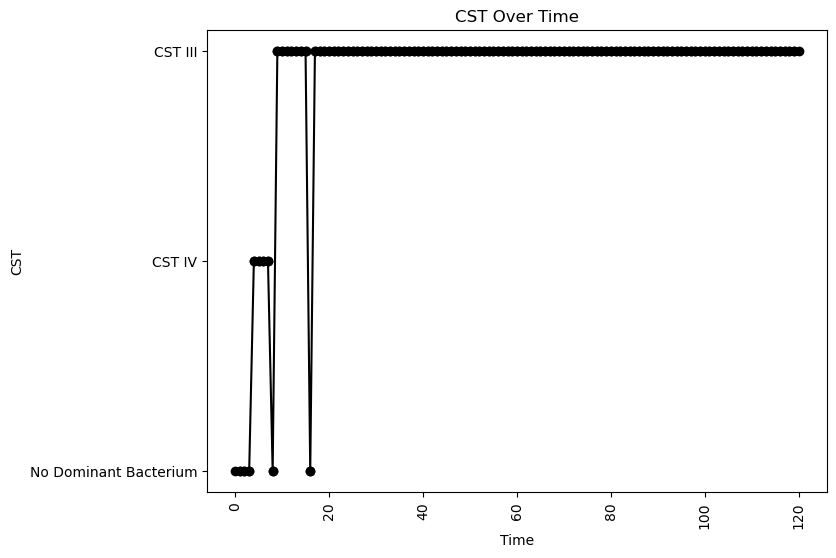


Interaction Parameters:
nAB Growth: 2.3346875129122853
Li Growth: 0.06338598661382545
oLB Growth: 0.2578671787060779
nAB Self: -0.04367448322698792
nAB->Li: -0.25642554410704455
nAB->oLB: -0.34208239259059714
Li->nAB: 0.14077589838592064
Li Self: -0.07857957489271478
Li->oLB: -0.01632995222883865
oLB->nAB: -0.17854754263849915
oLB->Li: -0.41434439167575443
oLB Self: -0.04919216799944681

Simulation 9837 follows a valid CST progression:


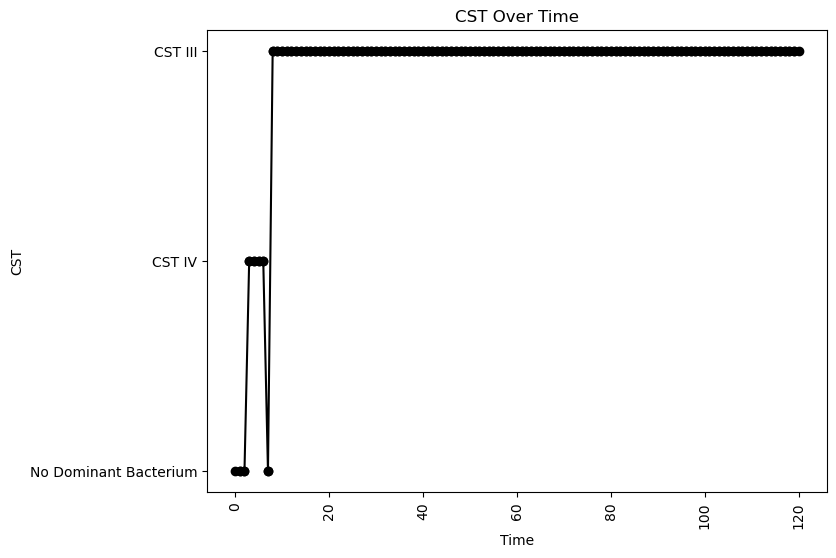


Interaction Parameters:
nAB Growth: 2.29233021825398
Li Growth: 0.06374654684319765
oLB Growth: 0.595997418302585
nAB Self: -0.014971697281329022
nAB->Li: -0.3171685673128002
nAB->oLB: -0.4699670347790874
Li->nAB: 0.1377763463151459
Li Self: -0.03450341031867049
Li->oLB: 0.3949294437841159
oLB->nAB: -0.49396994453377685
oLB->Li: 0.14410251457177237
oLB Self: -0.011373258753819615

Simulation 9843 follows a valid CST progression:


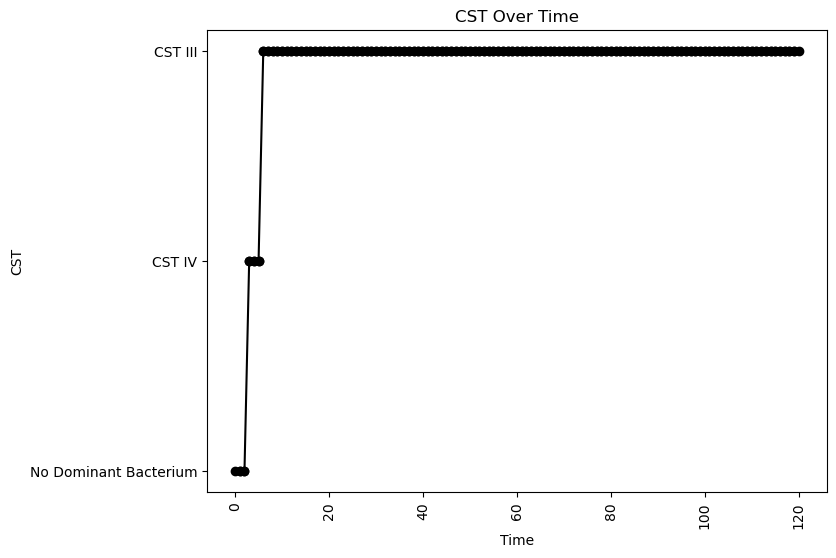


Interaction Parameters:
nAB Growth: 2.379351977340751
Li Growth: 0.05166516463472805
oLB Growth: 0.03504834427483494
nAB Self: -0.011423453416054344
nAB->Li: 0.12899284479033302
nAB->oLB: -0.47490584021267745
Li->nAB: 0.3028796074644111
Li Self: -0.04543361128722944
Li->oLB: 0.21504431707290128
oLB->nAB: -0.4253795663108836
oLB->Li: -0.07434982701481108
oLB Self: -0.015445560201345201

Simulation 9846 follows a valid CST progression:


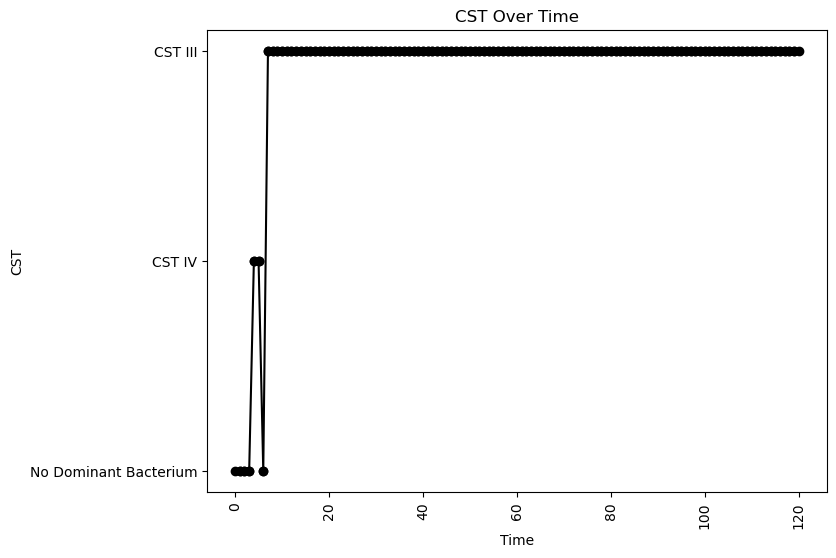


Interaction Parameters:
nAB Growth: 2.1573635369289432
Li Growth: 0.04215849674910016
oLB Growth: 1.2503024394854367
nAB Self: -0.006535141974812156
nAB->Li: 0.08222594414799966
nAB->oLB: -0.39107779623953975
Li->nAB: 0.34615551151922763
Li Self: -0.0015352573695997934
Li->oLB: 0.1842065167855511
oLB->nAB: -0.0270455475514067
oLB->Li: 0.010488034572741611
oLB Self: -0.0671568493432029

Simulation 9847 follows a valid CST progression:


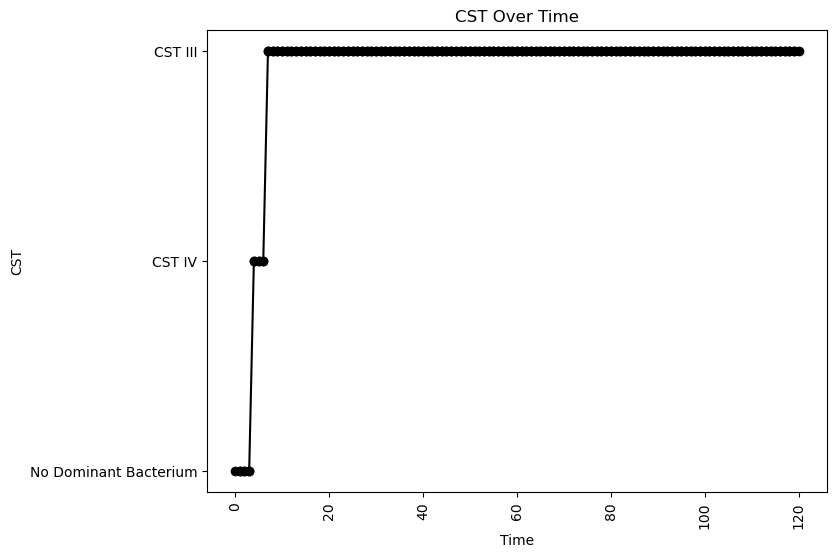


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.07402699334889884
nAB->Li: -0.4087330913612818
nAB->oLB: -0.28150673101432033
Li->nAB: 0.3119990090396102
Li Self: -0.09281627287403821
Li->oLB: -0.23033816047263062
oLB->nAB: -0.172118184650854
oLB->Li: -0.15900824105138012
oLB Self: -0.035037796881539324

Simulation 9852 follows a valid CST progression:


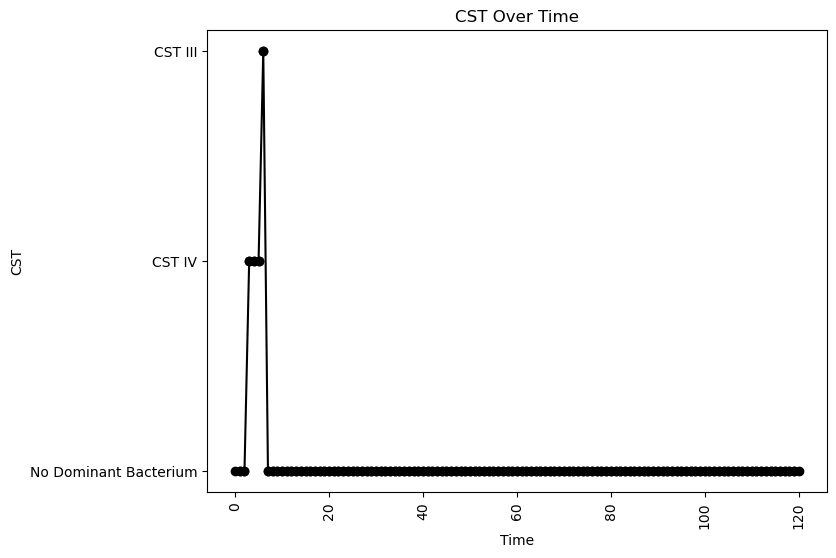


Interaction Parameters:
nAB Growth: 2.277319983482233
Li Growth: 0.04878853629351932
oLB Growth: 1.0236307631980681
nAB Self: -0.08393939826167604
nAB->Li: -0.09267777973516733
nAB->oLB: -0.37563370916404176
Li->nAB: 0.33124904328231086
Li Self: -0.0462511631749866
Li->oLB: 0.3084810076172181
oLB->nAB: -0.11572541859338925
oLB->Li: 0.33286301813619645
oLB Self: -0.09555095881601842

Simulation 9855 follows a valid CST progression:


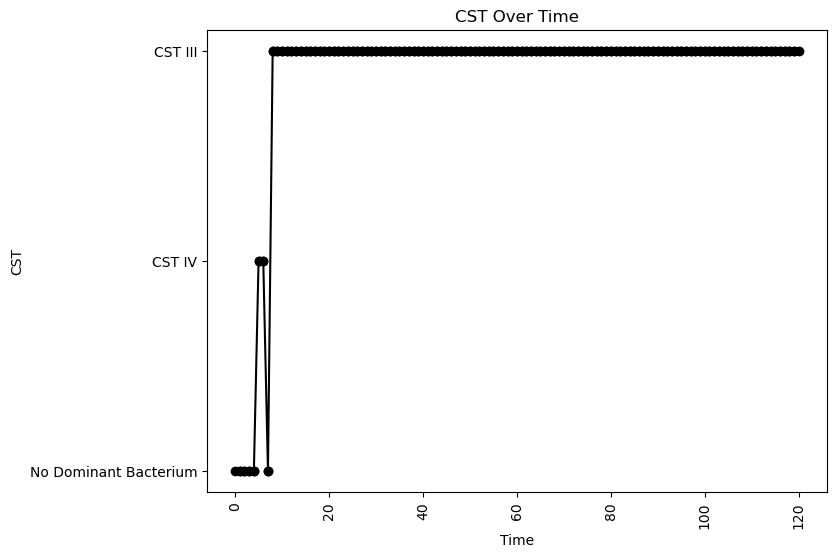


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.05108850319083919
nAB->Li: -0.36582581035897666
nAB->oLB: -0.2524695692851052
Li->nAB: 0.2436213836076785
Li Self: -0.03502316565540399
Li->oLB: 0.42708367276278325
oLB->nAB: -0.471252929156898
oLB->Li: -0.023450119469276554
oLB Self: -0.09867902757782737

Simulation 9863 follows a valid CST progression:


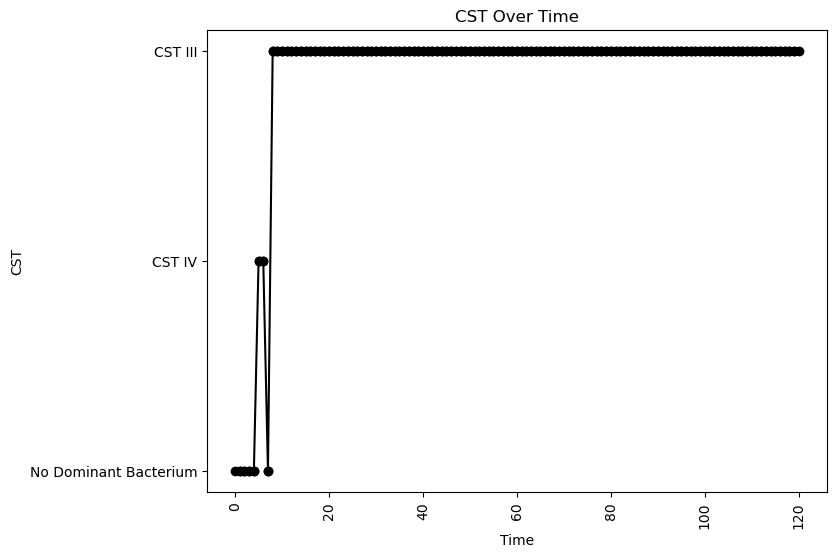


Interaction Parameters:
nAB Growth: 2.350462177624851
Li Growth: 0.26473921160779307
oLB Growth: 0.1039349296945926
nAB Self: -0.08718007664051881
nAB->Li: -0.06086477318424921
nAB->oLB: -0.06586436194907702
Li->nAB: 0.09418242637029206
Li Self: -0.029238471488845647
Li->oLB: -0.3375379410344296
oLB->nAB: -0.15697190509149728
oLB->Li: -0.11025608008954729
oLB Self: -0.05315630071195936

Simulation 9872 follows a valid CST progression:


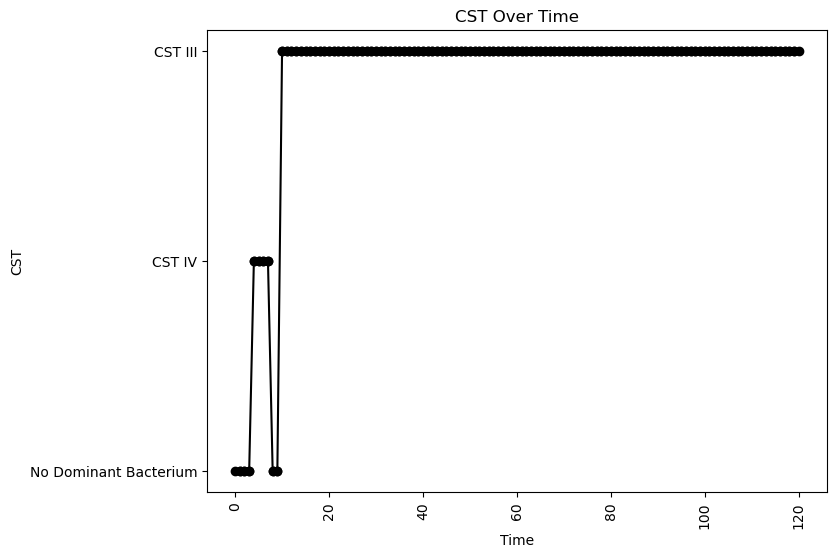


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.06340985427306736
oLB Growth: 0.16744057753178704
nAB Self: -0.04786447946573844
nAB->Li: 0.012809284592311232
nAB->oLB: -0.060536046650271846
Li->nAB: 0.07210585705711747
Li Self: -0.04295153725920397
Li->oLB: -0.1889271454815239
oLB->nAB: -0.10580221637017628
oLB->Li: -0.4126441146083418
oLB Self: -0.04670071016860348

Simulation 9873 follows a valid CST progression:


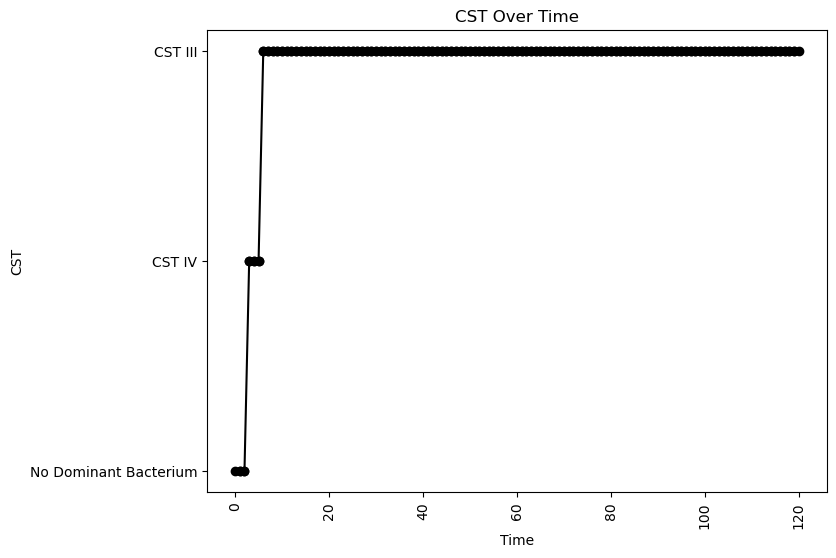


Interaction Parameters:
nAB Growth: 2.3201289694053955
Li Growth: 0.0608618180187166
oLB Growth: 0.5382103117959565
nAB Self: -0.012974084220542817
nAB->Li: 0.036170953633398284
nAB->oLB: -0.40546715864104005
Li->nAB: 0.29426351337240264
Li Self: -0.07018618360358289
Li->oLB: 0.14384142508135656
oLB->nAB: -0.33773935161310237
oLB->Li: -0.40558208312593896
oLB Self: -0.04428701772362194

Simulation 9885 follows a valid CST progression:


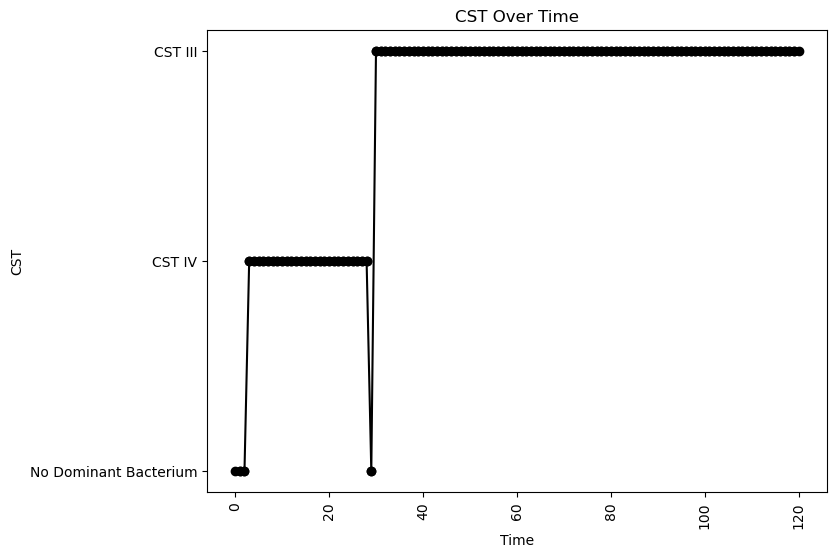


Interaction Parameters:
nAB Growth: 2.1564114827386844
Li Growth: 0.024863513952703756
oLB Growth: 1.156385115447748
nAB Self: -0.05977782854981529
nAB->Li: -0.4995112928824302
nAB->oLB: -0.48760339274905984
Li->nAB: 0.00894419045320538
Li Self: -0.07081306444803248
Li->oLB: -0.46414546290405206
oLB->nAB: -0.37974389601212655
oLB->Li: -0.2819411910894412
oLB Self: -0.021169808947584814

Simulation 9922 follows a valid CST progression:


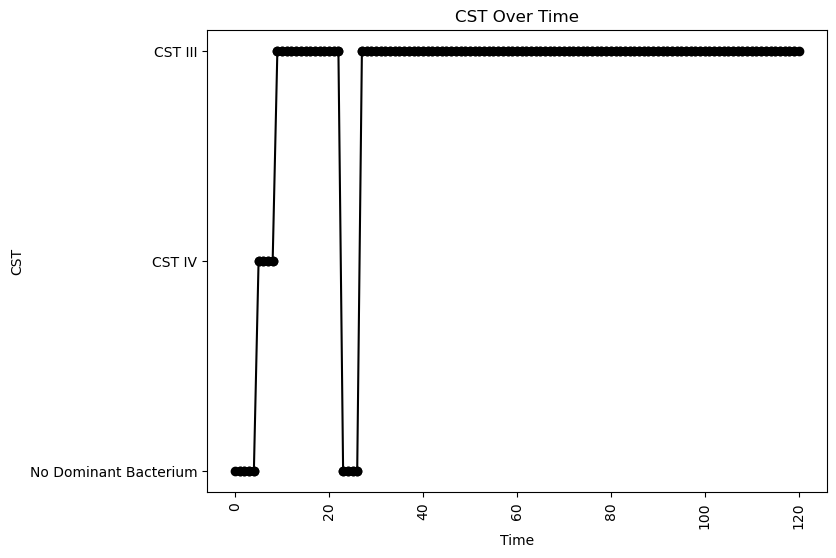


Interaction Parameters:
nAB Growth: 2.3341958895583277
Li Growth: 0.05484238764663231
oLB Growth: 0.08496126009849418
nAB Self: -0.09440557805308479
nAB->Li: -0.4987150150071602
nAB->oLB: -0.19500492946242637
Li->nAB: 0.1346309770686187
Li Self: -0.05903611391904604
Li->oLB: -0.46197544052385897
oLB->nAB: -0.19172271030504268
oLB->Li: -0.34010930125981703
oLB Self: -0.07777476497974115

Simulation 9924 follows a valid CST progression:


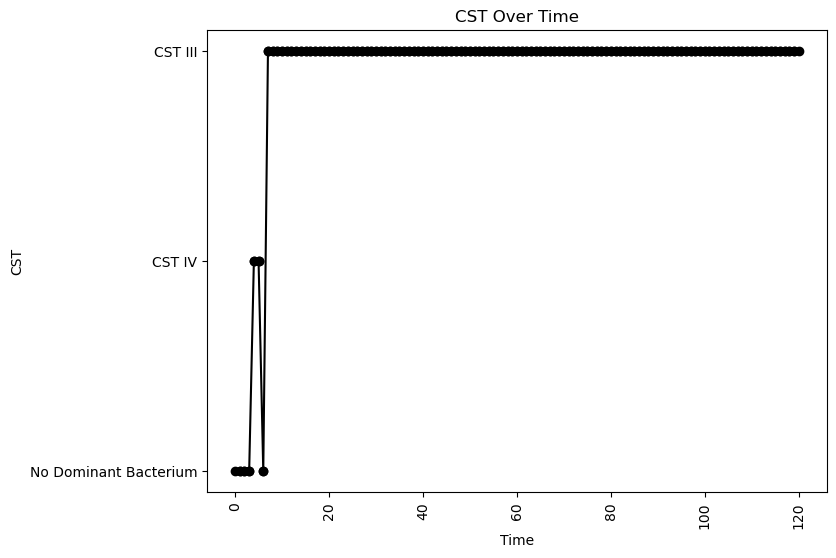


Interaction Parameters:
nAB Growth: 2.286323001067126
Li Growth: 0.060377934648291574
oLB Growth: 0.14091260068383374
nAB Self: -0.07731581823440427
nAB->Li: -0.15294557703258016
nAB->oLB: -0.35986965836226703
Li->nAB: 0.442497623011748
Li Self: -0.03174057697791617
Li->oLB: 0.06542074295473699
oLB->nAB: -0.07641074054735064
oLB->Li: -0.07554727104581016
oLB Self: -0.07223512007525201

Simulation 9925 follows a valid CST progression:


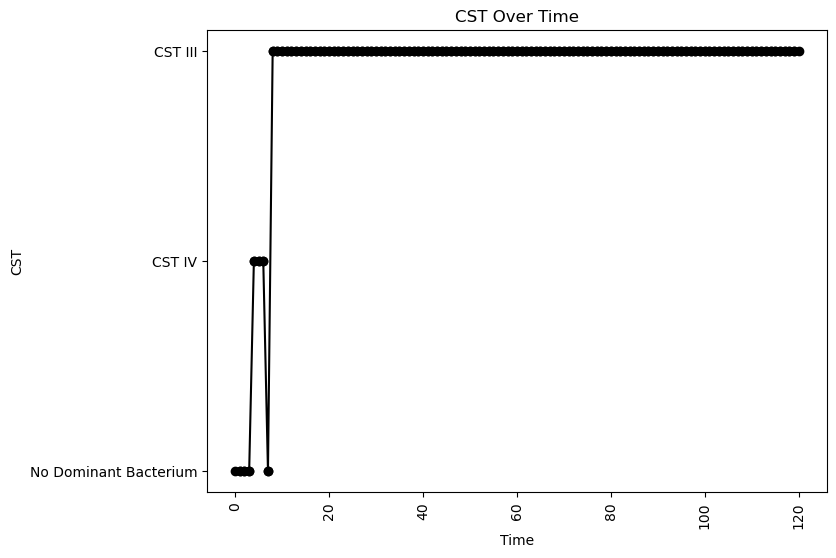


Interaction Parameters:
nAB Growth: 2.3107640864120973
Li Growth: 0.3015866297192862
oLB Growth: 0.11031283255203692
nAB Self: -0.0769287587634665
nAB->Li: -0.11253266215803936
nAB->oLB: -0.4316597442356649
Li->nAB: 0.06515865465561732
Li Self: -0.0401933137920709
Li->oLB: 0.22729863464485567
oLB->nAB: -0.11512862630179527
oLB->Li: -0.48698307989170775
oLB Self: -0.03420218575363326

Simulation 9932 follows a valid CST progression:


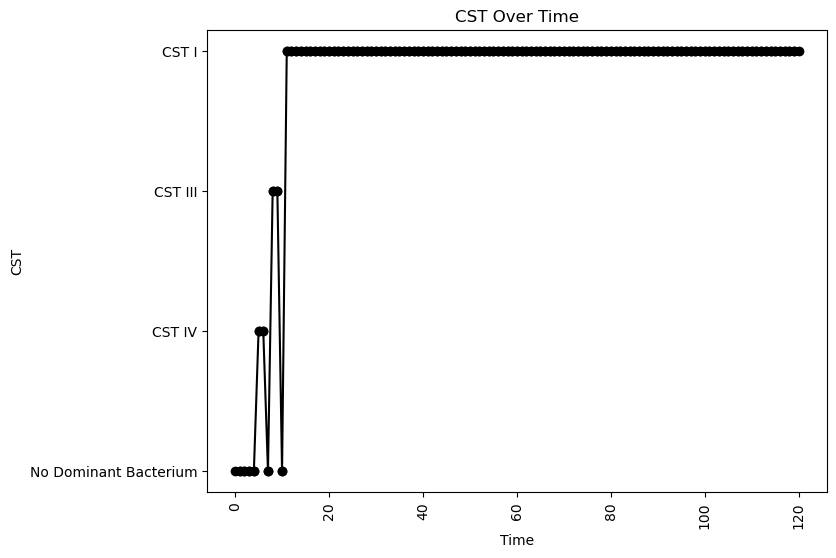


Interaction Parameters:
nAB Growth: 2.326889681819224
Li Growth: 0.07463842689981062
oLB Growth: 0.3756702562538966
nAB Self: -0.05771873106908542
nAB->Li: -0.44159277465599994
nAB->oLB: -0.24753348012849197
Li->nAB: 0.17512169071766104
Li Self: -0.07057985522485974
Li->oLB: -0.1618275136744709
oLB->nAB: -0.15500099174456494
oLB->Li: 0.30069915338252917
oLB Self: -0.06864196857968928

Simulation 9935 follows a valid CST progression:


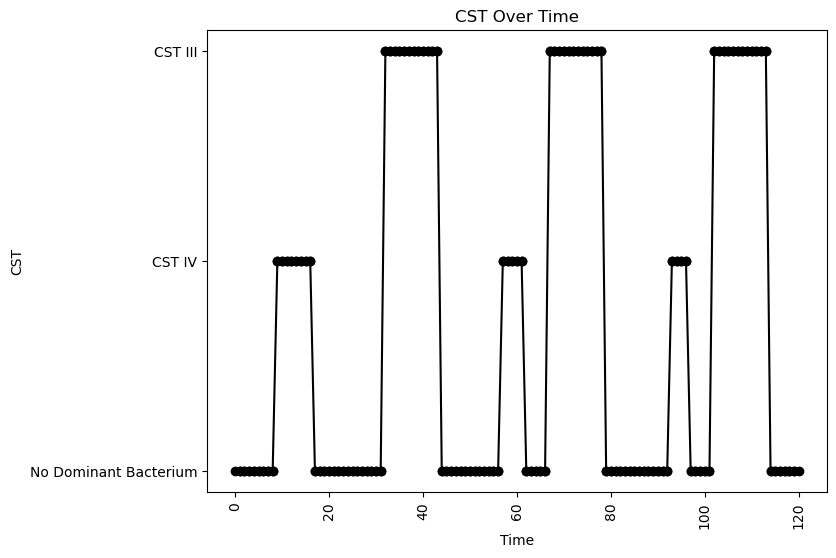


Interaction Parameters:
nAB Growth: 2.2609282147211935
Li Growth: 0.06381435834914458
oLB Growth: 0.1660151901294062
nAB Self: -0.03021079053521343
nAB->Li: -0.28275185696681393
nAB->oLB: -0.4627449078104159
Li->nAB: 0.054852894955781495
Li Self: -0.08587664613779844
Li->oLB: 0.06501840736731301
oLB->nAB: -0.17856002779390773
oLB->Li: -0.36343806927382794
oLB Self: -0.04242166958150787

Simulation 9939 follows a valid CST progression:


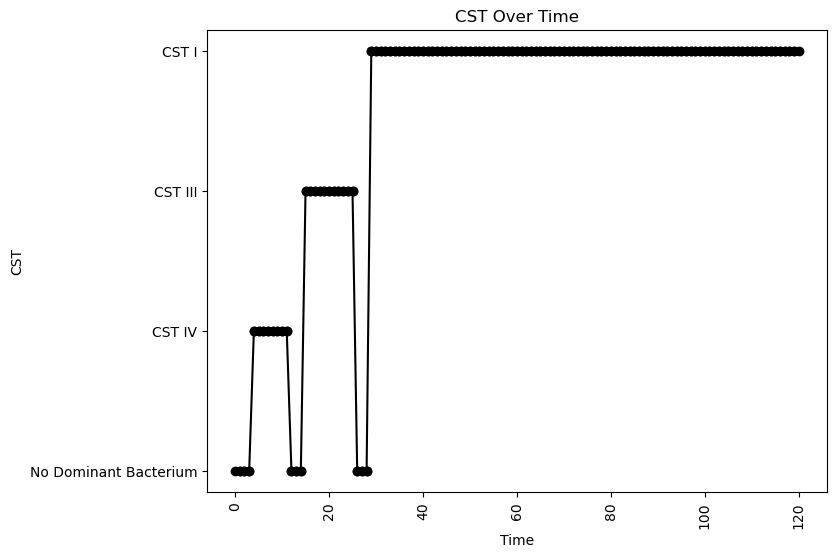


Interaction Parameters:
nAB Growth: 2.2205773702969314
Li Growth: 0.1680986438794434
oLB Growth: 0.9128027925042091
nAB Self: -0.08239532575201491
nAB->Li: -0.074977543196391
nAB->oLB: -0.33282717429837183
Li->nAB: 0.03369030901377912
Li Self: -0.03209910811929875
Li->oLB: -0.45489497229942094
oLB->nAB: -0.20514078877274944
oLB->Li: 0.139304992564647
oLB Self: -0.061060365336461385

Simulation 9959 follows a valid CST progression:


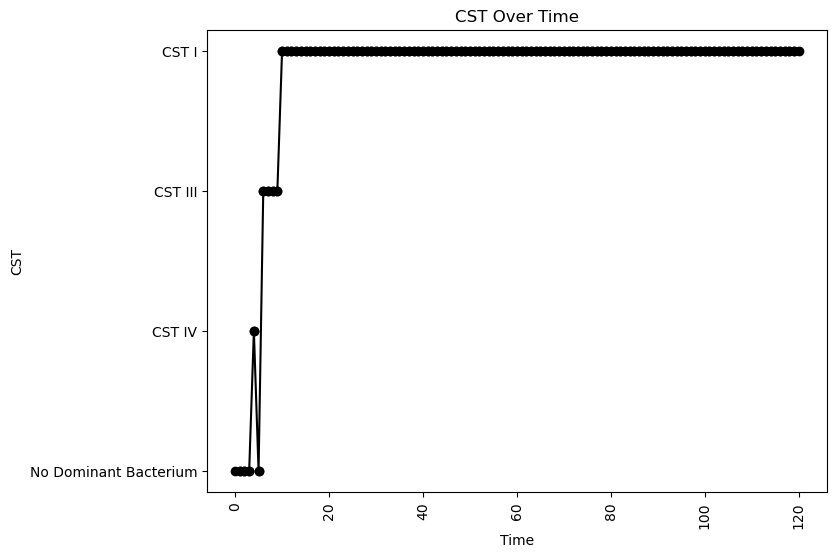


Interaction Parameters:
nAB Growth: 2.3145169459317763
Li Growth: 0.3509074787675815
oLB Growth: 0.7334429546888279
nAB Self: -0.09226302577283868
nAB->Li: -0.1677068314858322
nAB->oLB: -0.41483629088637364
Li->nAB: 0.1813841103528555
Li Self: -0.012283770475965794
Li->oLB: -0.3493646792917404
oLB->nAB: -0.172841983498067
oLB->Li: 0.10813077968937002
oLB Self: -0.004175643859524333

Simulation 9962 follows a valid CST progression:


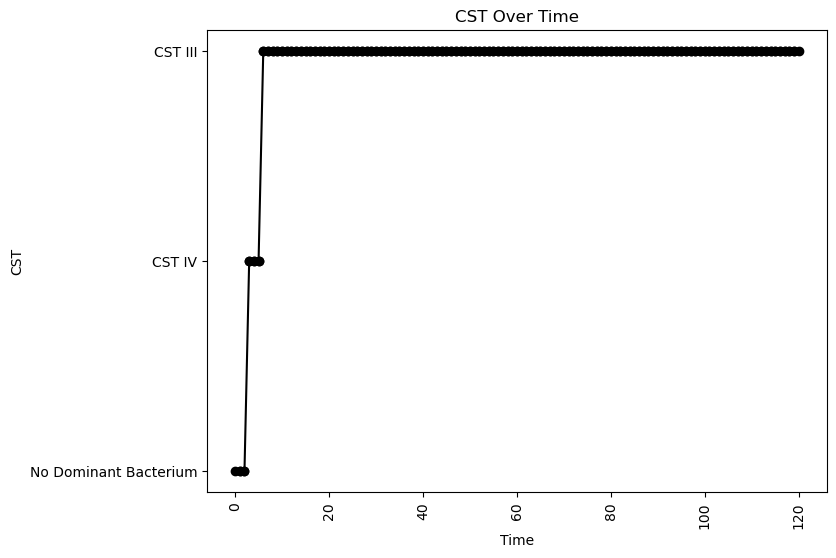


Interaction Parameters:
nAB Growth: 2.310122621547837
Li Growth: 0.06594850425774106
oLB Growth: 0.30646751991446597
nAB Self: -0.03933036829460652
nAB->Li: -0.261740739659294
nAB->oLB: -0.3963935704737202
Li->nAB: 0.2927208159001059
Li Self: -0.019977649575572826
Li->oLB: -0.11878307366376584
oLB->nAB: -0.017656935789074457
oLB->Li: -0.17917274945060319
oLB Self: -0.09287382099933289

Simulation 9967 follows a valid CST progression:


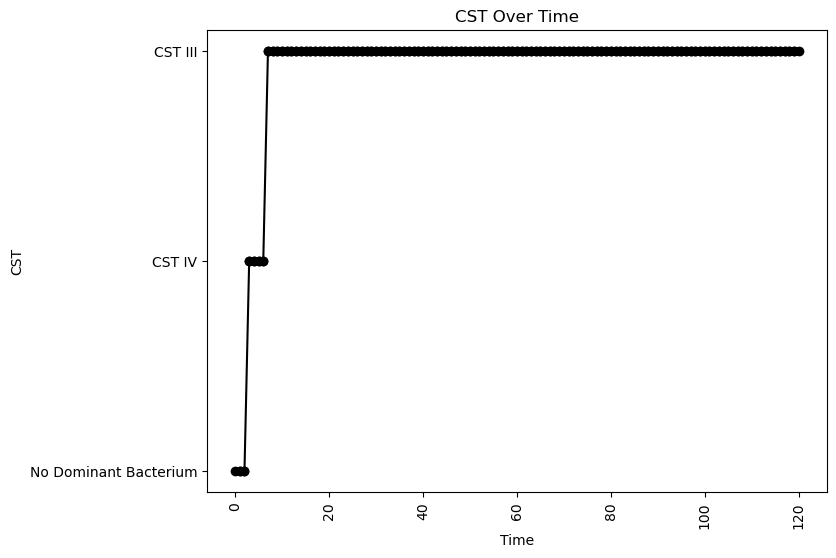


Interaction Parameters:
nAB Growth: 2.3738120660535387
Li Growth: 0.058369851943161175
oLB Growth: 0.07204856104631488
nAB Self: -0.0868142440672065
nAB->Li: -0.35637400533997565
nAB->oLB: -0.030825308764828974
Li->nAB: 0.2820435501966049
Li Self: -0.07429903841574326
Li->oLB: -0.23077139202557578
oLB->nAB: -0.18416804179052537
oLB->Li: -0.49306705417772556
oLB Self: -0.07823627898456981

Simulation 9973 follows a valid CST progression:


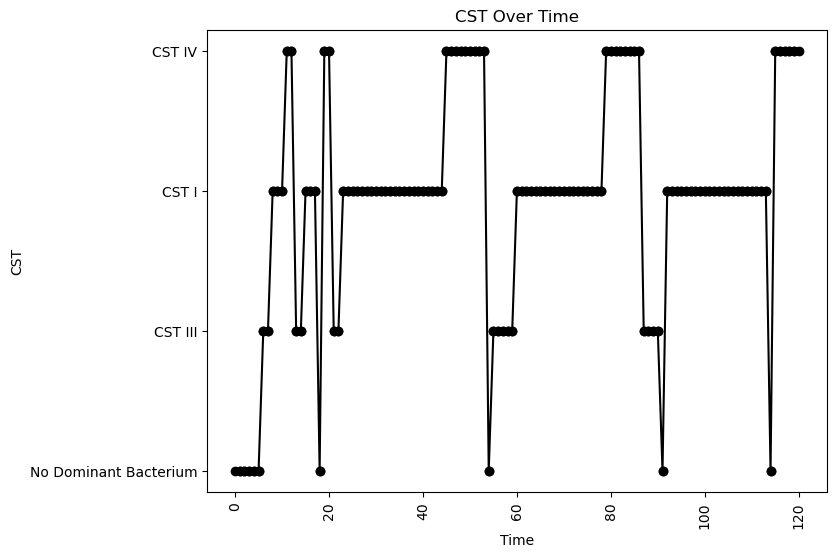


Interaction Parameters:
nAB Growth: 2.34388642439852
Li Growth: 0.3080454394201832
oLB Growth: 0.16744057753178704
nAB Self: -0.080192156865157
nAB->Li: -0.011515622163848271
nAB->oLB: -0.2008500060971472
Li->nAB: 0.352131891476276
Li Self: -0.02698769344466309
Li->oLB: -0.3138021294487059
oLB->nAB: -0.47930296006461115
oLB->Li: 0.14985805105225325
oLB Self: -0.09904731564744161

Simulation 9986 follows a valid CST progression:


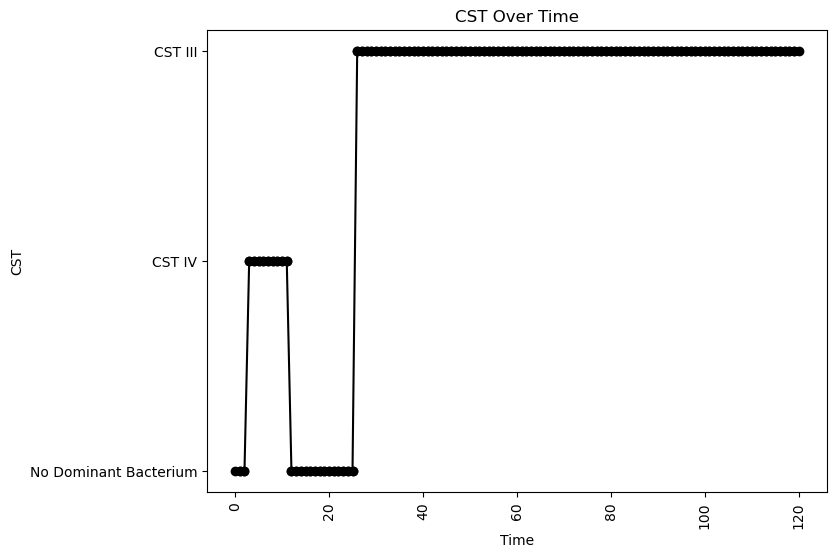


Interaction Parameters:
nAB Growth: 2.346663204456138
Li Growth: 0.05806339928301336
oLB Growth: 0.46591620920123267
nAB Self: -0.08051027765849625
nAB->Li: -0.22698265589399885
nAB->oLB: -0.3131630928303925
Li->nAB: 0.03707171780936058
Li Self: -0.033209336852504975
Li->oLB: -0.06737284995945358
oLB->nAB: -0.37931337930018955
oLB->Li: -0.007940751698527704
oLB Self: -0.08484133990828407

Simulation 10000 follows a valid CST progression:


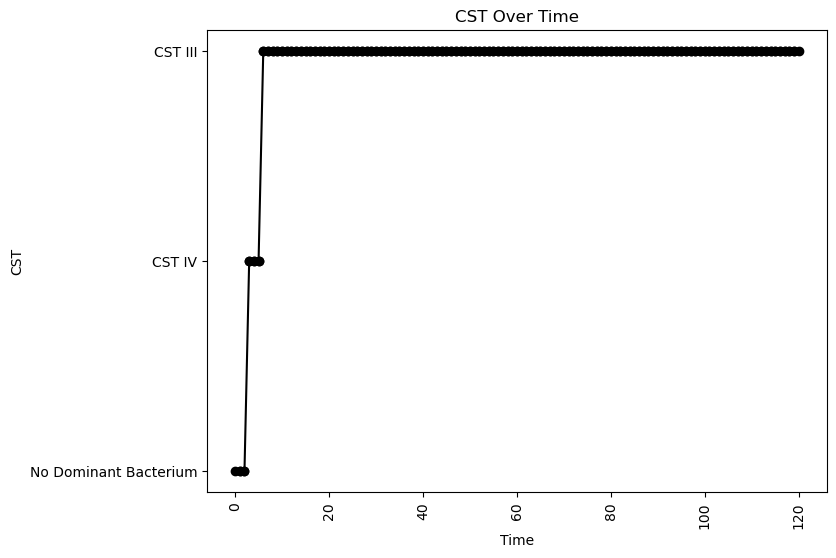


Interaction Parameters:
nAB Growth: 2.356886978320617
Li Growth: 0.052855137907374734
oLB Growth: 0.058910478352813524
nAB Self: -0.07927858357897123
nAB->Li: 0.07745760661319012
nAB->oLB: -0.19141138052221923
Li->nAB: 0.3723039691163449
Li Self: -0.06651553809348745
Li->oLB: 0.06270007369566355
oLB->nAB: -0.10038352085205426
oLB->Li: -0.11173082652859312
oLB Self: -0.06278673893647078


In [73]:
# Loop through each simulation result
for i, (times, abundances, params) in enumerate(simulation_results):
    # Assign CSTs based on relative abundance and thresholds
    csts = assign_cst(times, abundances, thresholds)
    
    # Check if at least CST IV and CST III are present
    if has_required_csts(csts):    
        #Then check if the CST changes matches one of the required sequences
        if check_cst_progression(csts):
            print(f"\nSimulation {i+1} follows a valid CST progression:")
            # Step 3: Plot CSTs and print interaction parameters
            plot_cst_and_print_interaction_params(times, csts, params)